<a href="https://colab.research.google.com/github/nmonson1/mnist_exploration/blob/main/smallMNIST_for_liam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tensorboard

In [ ]:
# Import necessary modules
import torch
import os
import matplotlib.pyplot as plt
import pandas as pd
import time
from tqdm import tqdm
import numpy as np

from torch.utils.tensorboard import SummaryWriter
from torch import nn, optim
from torchvision import datasets, transforms
from torch.utils.data import Dataset
from torchvision.io import read_image
from torchvision.transforms import ToTensor
import torch.nn.functional as F

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
writer = SummaryWriter('runs/experiment_1')


In [ ]:
training_data = datasets.MNIST(
    root="data",
    train=True,
    download=True,
    transform=transforms.Compose(
        [transforms.Resize([32,32]),
         transforms.RandomRotation(5),
         transforms.RandomCrop(28),
         transforms.ToTensor()]
    )
)

test_data = datasets.MNIST(
    root="data",
    train=False,
    download=True,
    transform=transforms.Compose(
        [transforms.Resize([32,32]),
         transforms.CenterCrop(28),
         transforms.ToTensor()]
    )
)

n_epochs = 20
batch_size_train = 16
batch_size_test = 1000
learning_rate = 0.0001
log_interval = 100000

train_loader = torch.utils.data.DataLoader(
    training_data,
    batch_size=batch_size_train,
    num_workers=2,
    shuffle=True)

test_loader = torch.utils.data.DataLoader(
    test_data,
    batch_size=batch_size_test,
    num_workers=2,
    shuffle=False)

In [ ]:
# Define the architecture of the network
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        # Input is 1 channel (grayscale), output 10 channels, 3x3 square convolution
        self.conv1 = nn.Conv2d(1, 32, 3)
        self.bn1 = nn.BatchNorm2d(32)
        self.conv2 = nn.Conv2d(32, 14, 3)
        self.bn2 = nn.BatchNorm2d(14)
        self.fc1 = nn.Linear(350, 10) # Output layer, 10 classes


    def forward(self, x):
        x = self.conv1(x)
        x = torch.nn.functional.leaky_relu(x)
        x = self.bn1(x)
        x = torch.nn.functional.max_pool2d(x, 2)
        x = self.conv2(x)
        x = torch.nn.functional.leaky_relu(x)
        x = self.bn2(x)
        x = torch.nn.functional.max_pool2d(x, 2)
        x = x.view(-1, 14 * 5 * 5) # Flatten the tensor
        x = torch.nn.functional.dropout(x, p=0.5)
        x = self.fc1(x)
        x = torch.nn.functional.leaky_relu(x)
        return x

In [ ]:
# Initialize the model
model = Net().to(device)

total_params = 0
for p in model.parameters():
    total_params += p.numel()
    print(f"Number of parameters: ", p.shape)
print(total_params)

Number of parameters:  torch.Size([32, 1, 3, 3])
Number of parameters:  torch.Size([32])
Number of parameters:  torch.Size([32])
Number of parameters:  torch.Size([32])
Number of parameters:  torch.Size([14, 32, 3, 3])
Number of parameters:  torch.Size([14])
Number of parameters:  torch.Size([14])
Number of parameters:  torch.Size([14])
Number of parameters:  torch.Size([10, 350])
Number of parameters:  torch.Size([10])
7968


In [ ]:
# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=learning_rate)

# Define the directory to save the model parameters
save_dir = 'model_params'
os.makedirs(save_dir, exist_ok=True)


In [ ]:
def train(epoch, model, optimizer, criterion, trainloader, device, save_dir, log_interval):
    start = time.time()
    model.train()
    train_loss = []

    for i, (inputs, labels) in enumerate(tqdm(trainloader, desc=f"Epoch {epoch}")):
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        train_loss.append(loss.item())
        loss.backward()
        optimizer.step()
        torch.save(model.state_dict(), f'{save_dir}/params_{i}.pth')

        if i % log_interval == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, i * len(inputs), len(trainloader.dataset),
                100. * i / len(trainloader), loss.item()))



    avg_loss = np.mean(train_loss)
    tot_time = time.time()-start
    print('\nTrain set: Avg. loss: {:.4f}, Time: {:.1f} secs \n'.format(avg_loss, tot_time))
    # Log the loss to tensorboard
    writer.add_scalar('Training Loss', avg_loss, epoch)

    return avg_loss


In [ ]:
def test(epoch, model, criterion, test_loader, device):
    model.eval()
    test_loss = []
    correct = 0
    with torch.no_grad():
        for data, target in tqdm(test_loader, desc=f"Test Epoch {epoch}"):
            data, target = data.to(device), target.to(device)
            output = model(data)
            loss = criterion(output, target).item()
            test_loss.append(loss)
            pred = output.argmax(dim=1, keepdim=True)  # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()

    avg_loss = np.mean(test_loss)
    accuracy = 100. * correct / len(test_loader.dataset)
    print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        avg_loss, correct, len(test_loader.dataset), accuracy))

    # Record loss and accuracy into tensorboard
    writer.add_scalar('Test Loss', avg_loss, epoch)
    writer.add_scalar('Test Accuracy', accuracy, epoch)

    return avg_loss, accuracy

In [ ]:
train_losses = []
test_losses = []

# Initialize containers to store the gradient magnitudes
grad_magnitudes = []

for epoch in range(n_epochs):
    # Train for one epoch
    avg_train_loss = train(epoch, model, optimizer, criterion, train_loader, device, save_dir, log_interval)
    train_losses.append(avg_train_loss)

    # Test on the validation set
    avg_test_loss, accuracy = test(epoch, model, criterion, test_loader, device)
    test_losses.append(avg_test_loss)

    # Log the average test loss and accuracy to tensorboard
    writer.add_scalar('Test Loss', avg_test_loss, epoch)
    writer.add_scalar('Test Accuracy', accuracy, epoch)

    # Compute and log the gradient magnitudes
    for i in range(epoch):
        prev_params = torch.load(f'{save_dir}/params_{i}.pth')
        curr_params = torch.load(f'{save_dir}/params_{i+1}.pth')
        for (key, curr_param), prev_param in zip(curr_params.items(), prev_params.values()):
            if 'weight' in key:
                grad_magnitude = F.mse_loss(curr_param, prev_param).sqrt().item()
                grad_magnitudes.append(grad_magnitude)
                writer.add_scalar(f'Grad magnitude/{key}', grad_magnitude, i)

# Close the tensorboard writer
writer.close()

Epoch 0:   0%|          | 6/3750 [00:00<02:39, 23.50it/s]

Train Epoch: 0 [0/60000 (0%)]	Loss: 2.541814


Epoch 0: 100%|██████████| 3750/3750 [00:38<00:00, 97.18it/s] 



Train set: Avg. loss: 2.0272, Time: 38.6 secs 



Test Epoch 0: 100%|██████████| 10/10 [00:01<00:00,  5.09it/s]



Test set: Average loss: 1.2656, Accuracy: 6165/10000 (62%)



Epoch 1:   0%|          | 1/3750 [00:00<08:03,  7.76it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 1.248338


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 98.50it/s]



Train set: Avg. loss: 1.1563, Time: 38.1 secs 



Test Epoch 1: 100%|██████████| 10/10 [00:01<00:00,  5.13it/s]



Test set: Average loss: 0.5929, Accuracy: 8407/10000 (84%)



Epoch 2:   0%|          | 1/3750 [00:00<08:24,  7.43it/s]

Train Epoch: 2 [0/60000 (0%)]	Loss: 1.389891


Epoch 2: 100%|██████████| 3750/3750 [00:37<00:00, 101.32it/s]



Train set: Avg. loss: 0.7808, Time: 37.0 secs 



Test Epoch 2: 100%|██████████| 10/10 [00:03<00:00,  3.23it/s]



Test set: Average loss: 0.4134, Accuracy: 8907/10000 (89%)



Epoch 3:   0%|          | 1/3750 [00:00<08:19,  7.50it/s]

Train Epoch: 3 [0/60000 (0%)]	Loss: 0.543514


Epoch 3: 100%|██████████| 3750/3750 [00:37<00:00, 100.48it/s]



Train set: Avg. loss: 0.6255, Time: 37.3 secs 



Test Epoch 3: 100%|██████████| 10/10 [00:02<00:00,  3.47it/s]



Test set: Average loss: 0.3262, Accuracy: 9152/10000 (92%)



Epoch 4:   0%|          | 8/3750 [00:00<01:55, 32.41it/s]

Train Epoch: 4 [0/60000 (0%)]	Loss: 0.405261


Epoch 4: 100%|██████████| 3750/3750 [00:37<00:00, 100.84it/s]



Train set: Avg. loss: 0.5373, Time: 37.2 secs 



Test Epoch 4: 100%|██████████| 10/10 [00:01<00:00,  5.10it/s]



Test set: Average loss: 0.2662, Accuracy: 9325/10000 (93%)



Epoch 5:   0%|          | 8/3750 [00:00<01:54, 32.70it/s]

Train Epoch: 5 [0/60000 (0%)]	Loss: 0.450672


Epoch 5: 100%|██████████| 3750/3750 [00:38<00:00, 98.30it/s] 



Train set: Avg. loss: 0.4800, Time: 38.2 secs 



Test Epoch 5: 100%|██████████| 10/10 [00:01<00:00,  5.31it/s]



Test set: Average loss: 0.2453, Accuracy: 9387/10000 (94%)



Epoch 6:   0%|          | 1/3750 [00:00<07:49,  7.98it/s]

Train Epoch: 6 [0/60000 (0%)]	Loss: 0.744811


Epoch 6: 100%|██████████| 3750/3750 [00:38<00:00, 97.80it/s] 



Train set: Avg. loss: 0.4428, Time: 38.4 secs 



Test Epoch 6: 100%|██████████| 10/10 [00:01<00:00,  5.24it/s]



Test set: Average loss: 0.2302, Accuracy: 9380/10000 (94%)



Epoch 7:   0%|          | 1/3750 [00:00<08:14,  7.57it/s]

Train Epoch: 7 [0/60000 (0%)]	Loss: 0.412264


Epoch 7: 100%|██████████| 3750/3750 [00:38<00:00, 98.01it/s] 



Train set: Avg. loss: 0.4128, Time: 38.3 secs 



Test Epoch 7: 100%|██████████| 10/10 [00:01<00:00,  5.14it/s]



Test set: Average loss: 0.2046, Accuracy: 9456/10000 (95%)



Epoch 8:   0%|          | 1/3750 [00:00<07:59,  7.82it/s]

Train Epoch: 8 [0/60000 (0%)]	Loss: 0.190207


Epoch 8: 100%|██████████| 3750/3750 [00:38<00:00, 97.83it/s] 



Train set: Avg. loss: 0.3874, Time: 38.3 secs 



Test Epoch 8: 100%|██████████| 10/10 [00:01<00:00,  5.26it/s]



Test set: Average loss: 0.1969, Accuracy: 9458/10000 (95%)



Epoch 9:   0%|          | 1/3750 [00:00<09:01,  6.92it/s]

Train Epoch: 9 [0/60000 (0%)]	Loss: 0.484347


Epoch 9: 100%|██████████| 3750/3750 [00:37<00:00, 98.90it/s]



Train set: Avg. loss: 0.3693, Time: 37.9 secs 



Test Epoch 9: 100%|██████████| 10/10 [00:02<00:00,  4.55it/s]



Test set: Average loss: 0.1804, Accuracy: 9518/10000 (95%)



Epoch 10:   0%|          | 1/3750 [00:00<07:33,  8.27it/s]

Train Epoch: 10 [0/60000 (0%)]	Loss: 0.275176


Epoch 10: 100%|██████████| 3750/3750 [00:36<00:00, 101.97it/s]



Train set: Avg. loss: 0.3537, Time: 36.8 secs 



Test Epoch 10: 100%|██████████| 10/10 [00:03<00:00,  3.19it/s]



Test set: Average loss: 0.1765, Accuracy: 9508/10000 (95%)



Epoch 11:   0%|          | 11/3750 [00:00<01:21, 45.85it/s]

Train Epoch: 11 [0/60000 (0%)]	Loss: 0.180227


Epoch 11: 100%|██████████| 3750/3750 [00:36<00:00, 101.36it/s]



Train set: Avg. loss: 0.3388, Time: 37.0 secs 



Test Epoch 11: 100%|██████████| 10/10 [00:02<00:00,  4.17it/s]



Test set: Average loss: 0.1695, Accuracy: 9511/10000 (95%)



Epoch 12:   0%|          | 8/3750 [00:00<01:55, 32.38it/s]

Train Epoch: 12 [0/60000 (0%)]	Loss: 0.207245


Epoch 12: 100%|██████████| 3750/3750 [00:37<00:00, 99.38it/s] 



Train set: Avg. loss: 0.3226, Time: 37.7 secs 



Test Epoch 12: 100%|██████████| 10/10 [00:01<00:00,  5.22it/s]



Test set: Average loss: 0.1630, Accuracy: 9547/10000 (95%)



Epoch 13:   0%|          | 12/3750 [00:00<01:05, 57.28it/s]

Train Epoch: 13 [0/60000 (0%)]	Loss: 0.421691


Epoch 13: 100%|██████████| 3750/3750 [00:38<00:00, 96.98it/s] 



Train set: Avg. loss: 0.3156, Time: 38.7 secs 



Test Epoch 13: 100%|██████████| 10/10 [00:01<00:00,  5.24it/s]



Test set: Average loss: 0.1580, Accuracy: 9539/10000 (95%)



Epoch 14:   0%|          | 12/3750 [00:00<01:02, 59.90it/s]

Train Epoch: 14 [0/60000 (0%)]	Loss: 0.347080


Epoch 14: 100%|██████████| 3750/3750 [00:38<00:00, 96.31it/s] 



Train set: Avg. loss: 0.3061, Time: 38.9 secs 



Test Epoch 14: 100%|██████████| 10/10 [00:01<00:00,  5.19it/s]



Test set: Average loss: 0.1492, Accuracy: 9580/10000 (96%)



Epoch 15:   0%|          | 13/3750 [00:00<00:58, 64.10it/s]

Train Epoch: 15 [0/60000 (0%)]	Loss: 0.354902


Epoch 15: 100%|██████████| 3750/3750 [00:38<00:00, 96.27it/s] 



Train set: Avg. loss: 0.2966, Time: 39.0 secs 



Test Epoch 15: 100%|██████████| 10/10 [00:01<00:00,  5.27it/s]



Test set: Average loss: 0.1394, Accuracy: 9611/10000 (96%)



Epoch 16:   0%|          | 12/3750 [00:00<01:01, 60.47it/s]

Train Epoch: 16 [0/60000 (0%)]	Loss: 0.139407


Epoch 16: 100%|██████████| 3750/3750 [00:38<00:00, 98.05it/s] 



Train set: Avg. loss: 0.2961, Time: 38.3 secs 



Test Epoch 16: 100%|██████████| 10/10 [00:01<00:00,  5.16it/s]



Test set: Average loss: 0.1397, Accuracy: 9597/10000 (96%)



Epoch 17:   0%|          | 13/3750 [00:00<00:57, 65.41it/s]

Train Epoch: 17 [0/60000 (0%)]	Loss: 0.413612


Epoch 17: 100%|██████████| 3750/3750 [00:38<00:00, 97.46it/s] 



Train set: Avg. loss: 0.2840, Time: 38.5 secs 



Test Epoch 17: 100%|██████████| 10/10 [00:01<00:00,  5.13it/s]



Test set: Average loss: 0.1373, Accuracy: 9626/10000 (96%)



Epoch 18:   0%|          | 12/3750 [00:00<01:02, 59.68it/s]

Train Epoch: 18 [0/60000 (0%)]	Loss: 0.213773


Epoch 18: 100%|██████████| 3750/3750 [00:37<00:00, 98.98it/s]



Train set: Avg. loss: 0.2760, Time: 37.9 secs 



Test Epoch 18: 100%|██████████| 10/10 [00:02<00:00,  4.24it/s]



Test set: Average loss: 0.1303, Accuracy: 9655/10000 (97%)



Epoch 19:   0%|          | 13/3750 [00:00<00:57, 65.54it/s]

Train Epoch: 19 [0/60000 (0%)]	Loss: 0.290443


Epoch 19: 100%|██████████| 3750/3750 [00:36<00:00, 101.42it/s]



Train set: Avg. loss: 0.2745, Time: 37.0 secs 



Test Epoch 19: 100%|██████████| 10/10 [00:02<00:00,  3.35it/s]



Test set: Average loss: 0.1278, Accuracy: 9645/10000 (96%)



Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=1


Epoch 1:   0%|          | 4/3750 [00:00<01:41, 37.06it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.663297


Epoch 1:   3%|▎         | 118/3750 [00:01<00:33, 107.95it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.229776


Epoch 1:   6%|▌         | 216/3750 [00:02<00:32, 109.68it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.884203


Epoch 1:   9%|▊         | 322/3750 [00:03<00:31, 109.80it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.824058


Epoch 1:  11%|█         | 414/3750 [00:03<00:30, 109.91it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.572772


Epoch 1:  14%|█▍        | 517/3750 [00:04<00:32, 100.68it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.575280


Epoch 1:  16%|█▋        | 611/3750 [00:06<00:36, 85.75it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.583363


Epoch 1:  19%|█▉        | 710/3750 [00:07<00:35, 85.56it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.315219


Epoch 1:  22%|██▏       | 809/3750 [00:08<00:36, 79.78it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.281344


Epoch 1:  24%|██▍       | 917/3750 [00:09<00:25, 110.70it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.161173


Epoch 1:  27%|██▋       | 1011/3750 [00:10<00:24, 111.19it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.417894


Epoch 1:  30%|██▉       | 1117/3750 [00:11<00:23, 109.93it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.471798


Epoch 1:  32%|███▏      | 1212/3750 [00:12<00:22, 110.57it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.321567


Epoch 1:  35%|███▌      | 1320/3750 [00:13<00:21, 113.32it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.161829


Epoch 1:  38%|███▊      | 1416/3750 [00:13<00:20, 112.91it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.156389


Epoch 1:  41%|████      | 1523/3750 [00:14<00:19, 112.73it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.329584


Epoch 1:  43%|████▎     | 1619/3750 [00:15<00:19, 110.66it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.641280


Epoch 1:  46%|████▌     | 1715/3750 [00:16<00:18, 107.75it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.789892


Epoch 1:  49%|████▊     | 1821/3750 [00:17<00:17, 107.62it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.326442


Epoch 1:  51%|█████     | 1914/3750 [00:18<00:16, 111.72it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.141117


Epoch 1:  54%|█████▎    | 2012/3750 [00:19<00:19, 90.09it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.371116


Epoch 1:  56%|█████▋    | 2117/3750 [00:20<00:19, 84.14it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.086154


Epoch 1:  59%|█████▉    | 2216/3750 [00:21<00:17, 85.52it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.212904


Epoch 1:  62%|██████▏   | 2308/3750 [00:23<00:25, 57.14it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.311517


Epoch 1:  64%|██████▍   | 2409/3750 [00:24<00:18, 71.64it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.256131


Epoch 1:  67%|██████▋   | 2507/3750 [00:26<00:22, 55.80it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.688481


Epoch 1:  70%|██████▉   | 2614/3750 [00:28<00:16, 67.48it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.409018


Epoch 1:  73%|███████▎  | 2719/3750 [00:29<00:10, 96.36it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.037072


Epoch 1:  75%|███████▌  | 2813/3750 [00:30<00:08, 110.83it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.103499


Epoch 1:  78%|███████▊  | 2920/3750 [00:31<00:07, 110.34it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.083000


Epoch 1:  80%|████████  | 3016/3750 [00:32<00:06, 108.89it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.239974


Epoch 1:  83%|████████▎ | 3117/3750 [00:33<00:07, 89.01it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.038434


Epoch 1:  86%|████████▌ | 3216/3750 [00:34<00:06, 84.38it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.257819


Epoch 1:  88%|████████▊ | 3315/3750 [00:36<00:05, 84.24it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.211531


Epoch 1:  91%|█████████ | 3419/3750 [00:37<00:03, 95.44it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.299194


Epoch 1:  94%|█████████▎| 3513/3750 [00:38<00:02, 110.48it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.355615


Epoch 1:  96%|█████████▋| 3618/3750 [00:39<00:01, 109.35it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.658061


Epoch 1:  99%|█████████▉| 3713/3750 [00:39<00:00, 112.88it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.035234


Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 93.05it/s] 


Train set: Avg. loss: 0.3525, Time: 40.3 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.35245691250512995, Test loss: 0.00023829224165529013, Test accuracy: 96.07, Train time: 40.310102462768555, Test time: 2.1401467323303223


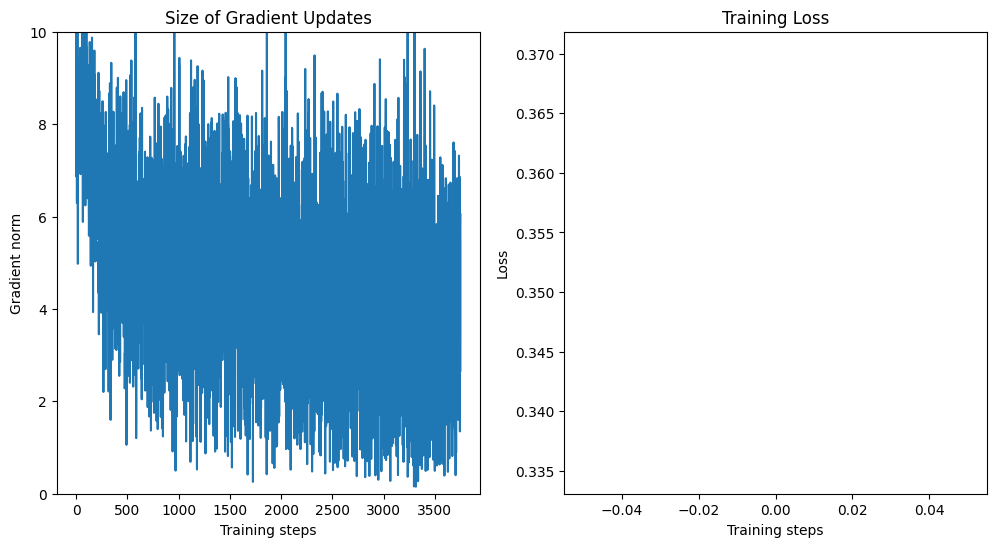

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<08:03,  7.76it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.485194


Epoch 1:   3%|▎         | 121/3750 [00:01<00:29, 123.72it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.326504


Epoch 1:   6%|▌         | 215/3750 [00:01<00:28, 123.67it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.498718


Epoch 1:   9%|▊         | 322/3750 [00:02<00:27, 123.54it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.284290


Epoch 1:  11%|█         | 416/3750 [00:03<00:26, 126.45it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.343381


Epoch 1:  14%|█▎        | 511/3750 [00:04<00:25, 125.24it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.295672


Epoch 1:  16%|█▋        | 618/3750 [00:05<00:35, 88.94it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.348833


Epoch 1:  19%|█▉        | 720/3750 [00:06<00:36, 82.76it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.429881


Epoch 1:  22%|██▏       | 814/3750 [00:07<00:34, 85.41it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.099774


Epoch 1:  25%|██▍       | 922/3750 [00:08<00:25, 112.77it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.394965


Epoch 1:  27%|██▋       | 1017/3750 [00:09<00:20, 130.22it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.086548


Epoch 1:  30%|██▉       | 1117/3750 [00:10<00:20, 130.31it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.657173


Epoch 1:  32%|███▏      | 1216/3750 [00:11<00:19, 128.57it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.102595


Epoch 1:  35%|███▌      | 1314/3750 [00:11<00:18, 131.80it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.074193


Epoch 1:  38%|███▊      | 1427/3750 [00:12<00:17, 132.28it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.336633


Epoch 1:  41%|████      | 1522/3750 [00:13<00:17, 124.94it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.137059


Epoch 1:  43%|████▎     | 1617/3750 [00:14<00:16, 128.11it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.193611


Epoch 1:  46%|████▌     | 1727/3750 [00:15<00:15, 129.65it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.500957


Epoch 1:  49%|████▊     | 1826/3750 [00:15<00:14, 130.06it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.104082


Epoch 1:  51%|█████     | 1921/3750 [00:16<00:14, 130.59it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.238708


Epoch 1:  54%|█████▎    | 2015/3750 [00:17<00:14, 123.46it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.322588


Epoch 1:  56%|█████▋    | 2113/3750 [00:18<00:13, 124.60it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.446140


Epoch 1:  59%|█████▉    | 2211/3750 [00:19<00:17, 89.57it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.285164


Epoch 1:  62%|██████▏   | 2317/3750 [00:20<00:17, 83.04it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.184347


Epoch 1:  64%|██████▍   | 2409/3750 [00:21<00:15, 84.86it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.031931


Epoch 1:  67%|██████▋   | 2515/3750 [00:22<00:14, 84.77it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.264535


Epoch 1:  70%|██████▉   | 2615/3750 [00:23<00:09, 120.55it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.541973


Epoch 1:  73%|███████▎  | 2723/3750 [00:24<00:08, 125.82it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.078655


Epoch 1:  75%|███████▌  | 2821/3750 [00:25<00:07, 127.20it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.104623


Epoch 1:  78%|███████▊  | 2914/3750 [00:26<00:06, 124.13it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.088354


Epoch 1:  80%|████████  | 3017/3750 [00:26<00:05, 123.31it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.454092


Epoch 1:  83%|████████▎ | 3122/3750 [00:27<00:05, 123.42it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.216436


Epoch 1:  86%|████████▌ | 3223/3750 [00:28<00:04, 114.04it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.326550


Epoch 1:  88%|████████▊ | 3316/3750 [00:29<00:03, 118.77it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.050998


Epoch 1:  91%|█████████ | 3419/3750 [00:30<00:02, 125.35it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.175686


Epoch 1:  94%|█████████▍| 3525/3750 [00:31<00:01, 126.83it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.016409


Epoch 1:  97%|█████████▋| 3620/3750 [00:31<00:01, 127.98it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.185463


Epoch 1:  99%|█████████▉| 3716/3750 [00:32<00:00, 129.12it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.325955


Epoch 1: 100%|██████████| 3750/3750 [00:32<00:00, 113.88it/s]


Train set: Avg. loss: 0.3513, Time: 32.9 secs 




Test set: Avg. loss: 0.0002, Accuracy: 97%, Time: 3.2 secs

Train loss: 0.35133563535499074, Test loss: 0.00021273231208324432, Test accuracy: 96.7, Train time: 32.93422842025757, Test time: 3.181765556335449


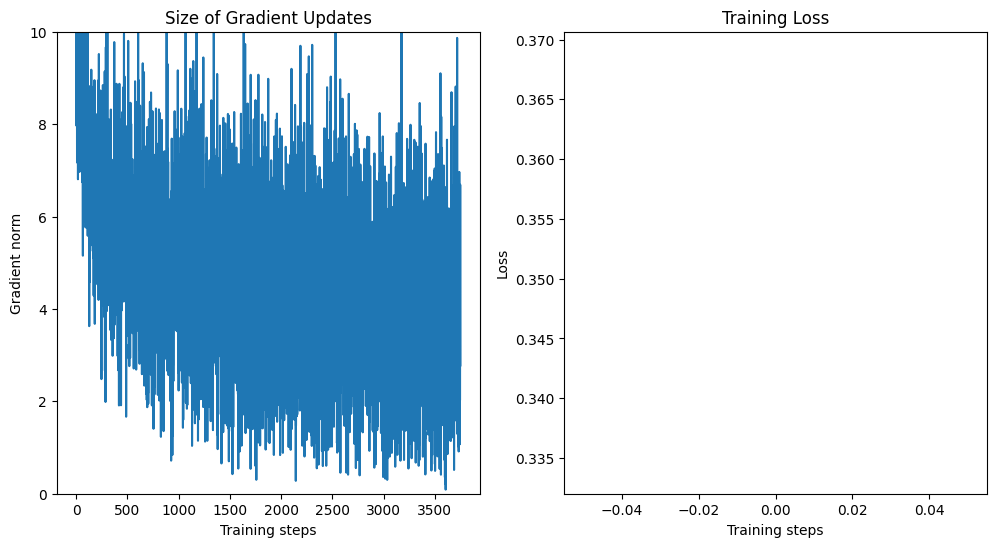

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=4


Epoch 1:   0%|          | 13/3750 [00:00<01:17, 48.02it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.930998


Epoch 1:   3%|▎         | 122/3750 [00:01<00:28, 125.65it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.086111


Epoch 1:   6%|▌         | 217/3750 [00:01<00:26, 133.06it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.555082


Epoch 1:   9%|▊         | 327/3750 [00:02<00:26, 128.88it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.582427


Epoch 1:  11%|█         | 420/3750 [00:03<00:25, 129.34it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.642693


Epoch 1:  14%|█▎        | 513/3750 [00:04<00:26, 119.92it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.769379


Epoch 1:  16%|█▋        | 618/3750 [00:05<00:24, 126.82it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.283121


Epoch 1:  19%|█▉        | 726/3750 [00:05<00:23, 128.78it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.239306


Epoch 1:  22%|██▏       | 824/3750 [00:06<00:22, 131.17it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.299683


Epoch 1:  25%|██▍       | 921/3750 [00:07<00:22, 128.12it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.603046


Epoch 1:  27%|██▋       | 1016/3750 [00:08<00:20, 130.54it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.254187


Epoch 1:  30%|███       | 1126/3750 [00:09<00:20, 127.14it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.360010


Epoch 1:  33%|███▎      | 1221/3750 [00:09<00:19, 130.62it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.149561


Epoch 1:  35%|███▍      | 1310/3750 [00:10<00:27, 87.55it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.407120


Epoch 1:  38%|███▊      | 1412/3750 [00:12<00:29, 80.04it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.307273


Epoch 1:  40%|████      | 1513/3750 [00:13<00:28, 79.63it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.130208


Epoch 1:  43%|████▎     | 1617/3750 [00:14<00:21, 98.06it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.113483


Epoch 1:  46%|████▌     | 1722/3750 [00:15<00:16, 126.61it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.439350


Epoch 1:  48%|████▊     | 1814/3750 [00:16<00:15, 124.11it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.016940


Epoch 1:  51%|█████▏    | 1923/3750 [00:16<00:14, 125.51it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.275876


Epoch 1:  54%|█████▎    | 2015/3750 [00:17<00:13, 124.92it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.099437


Epoch 1:  57%|█████▋    | 2125/3750 [00:18<00:12, 131.56it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.312443


Epoch 1:  59%|█████▉    | 2219/3750 [00:19<00:11, 128.35it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.517869


Epoch 1:  62%|██████▏   | 2314/3750 [00:20<00:11, 126.33it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.199602


Epoch 1:  65%|██████▍   | 2425/3750 [00:20<00:10, 127.92it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.376478


Epoch 1:  67%|██████▋   | 2518/3750 [00:21<00:09, 129.07it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.214862


Epoch 1:  69%|██████▉   | 2604/3750 [00:22<00:16, 71.30it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.160197


Epoch 1:  72%|███████▏  | 2712/3750 [00:24<00:14, 70.06it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.306363


Epoch 1:  75%|███████▌  | 2817/3750 [00:25<00:11, 83.09it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.258430


Epoch 1:  78%|███████▊  | 2910/3750 [00:26<00:10, 82.57it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.080615


Epoch 1:  80%|████████  | 3010/3750 [00:27<00:08, 82.77it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.281340


Epoch 1:  83%|████████▎ | 3119/3750 [00:28<00:07, 88.12it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.699403


Epoch 1:  86%|████████▌ | 3227/3750 [00:29<00:04, 126.52it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.147184


Epoch 1:  89%|████████▊ | 3319/3750 [00:30<00:03, 125.87it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.171478


Epoch 1:  91%|█████████ | 3403/3750 [00:31<00:02, 126.25it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.067848


Epoch 1:  94%|█████████▍| 3525/3750 [00:32<00:01, 114.93it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.265608


Epoch 1:  97%|█████████▋| 3619/3750 [00:33<00:01, 127.71it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.129212


Epoch 1:  99%|█████████▉| 3727/3750 [00:34<00:00, 127.76it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.162458


Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 107.54it/s]


Train set: Avg. loss: 0.3453, Time: 34.9 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 2.0 secs

Train loss: 0.34534935572917264, Test loss: 0.00023856015391647816, Test accuracy: 96.3, Train time: 34.87727880477905, Test time: 2.0375726222991943


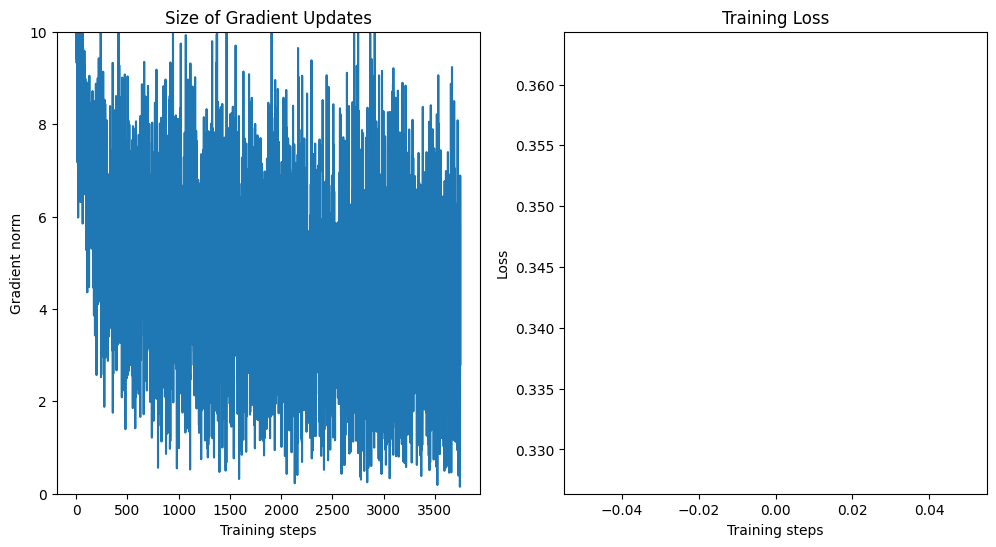

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=1


Epoch 1:   0%|          | 13/3750 [00:00<01:53, 32.98it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.601192


Epoch 1:   6%|▌         | 211/3750 [00:02<00:39, 89.69it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.813224


Epoch 1:  11%|█         | 410/3750 [00:04<00:40, 81.75it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.380963


Epoch 1:  16%|█▋        | 618/3750 [00:07<00:29, 107.70it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.802243


Epoch 1:  22%|██▏       | 821/3750 [00:08<00:25, 112.86it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.329311


Epoch 1:  27%|██▋       | 1021/3750 [00:10<00:24, 109.69it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.374072


Epoch 1:  33%|███▎      | 1223/3750 [00:12<00:22, 111.90it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.486268


Epoch 1:  38%|███▊      | 1415/3750 [00:14<00:20, 111.20it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.560830


Epoch 1:  43%|████▎     | 1616/3750 [00:16<00:23, 89.67it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.264642


Epoch 1:  48%|████▊     | 1816/3750 [00:18<00:23, 82.83it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.238619


Epoch 1:  54%|█████▍    | 2021/3750 [00:20<00:15, 110.62it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.043661


Epoch 1:  59%|█████▉    | 2224/3750 [00:22<00:13, 113.75it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.645139


Epoch 1:  64%|██████▍   | 2418/3750 [00:24<00:11, 114.41it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.163625


Epoch 1:  70%|██████▉   | 2613/3750 [00:26<00:09, 114.34it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.494470


Epoch 1:  75%|███████▌  | 2818/3750 [00:27<00:08, 112.51it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.092834


Epoch 1:  81%|████████  | 3022/3750 [00:29<00:06, 111.17it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.121685


Epoch 1:  86%|████████▌ | 3212/3750 [00:31<00:06, 87.93it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.124610


Epoch 1:  91%|█████████ | 3417/3750 [00:34<00:03, 93.73it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.049962


Epoch 1:  97%|█████████▋| 3619/3750 [00:36<00:01, 110.35it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.863370


Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 100.49it/s]


Train set: Avg. loss: 0.3490, Time: 37.3 secs 




Test set: Avg. loss: 0.0003, Accuracy: 95%, Time: 2.4 secs

Train loss: 0.34901170864365993, Test loss: 0.00033714824728667736, Test accuracy: 94.78, Train time: 37.32538628578186, Test time: 2.393172025680542


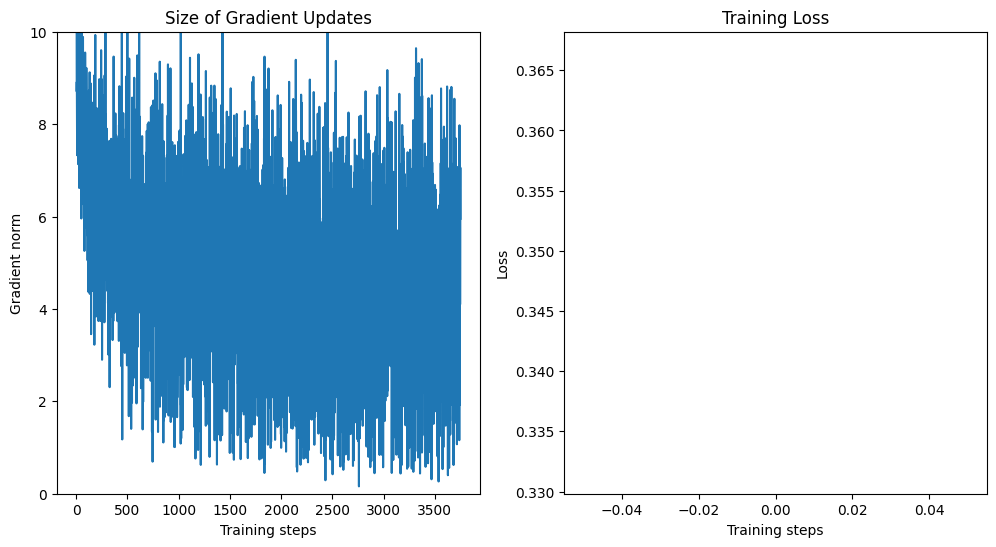

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<08:16,  7.54it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.680074


Epoch 1:   6%|▌         | 220/3750 [00:01<00:29, 120.83it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.746389


Epoch 1:  11%|█▏        | 424/3750 [00:03<00:26, 127.73it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.339256


Epoch 1:  16%|█▋        | 612/3750 [00:05<00:39, 79.87it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.236100


Epoch 1:  22%|██▏       | 810/3750 [00:08<00:34, 85.54it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.739371


Epoch 1:  27%|██▋       | 1027/3750 [00:09<00:21, 128.16it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.205370


Epoch 1:  33%|███▎      | 1225/3750 [00:11<00:20, 122.69it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.040640


Epoch 1:  38%|███▊      | 1421/3750 [00:13<00:18, 123.53it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.156790


Epoch 1:  43%|████▎     | 1626/3750 [00:14<00:16, 125.44it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.119391


Epoch 1:  49%|████▊     | 1827/3750 [00:16<00:14, 129.59it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.396883


Epoch 1:  54%|█████▍    | 2023/3750 [00:17<00:13, 123.74it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.366044


Epoch 1:  59%|█████▉    | 2216/3750 [00:19<00:17, 85.69it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.286837


Epoch 1:  64%|██████▍   | 2414/3750 [00:22<00:15, 84.22it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.048051


Epoch 1:  70%|██████▉   | 2617/3750 [00:23<00:08, 126.30it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.040653


Epoch 1:  75%|███████▌  | 2815/3750 [00:25<00:07, 118.31it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.247248


Epoch 1:  81%|████████  | 3023/3750 [00:27<00:05, 129.56it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.142420


Epoch 1:  86%|████████▌ | 3226/3750 [00:28<00:04, 125.75it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.398617


Epoch 1:  91%|█████████ | 3415/3750 [00:30<00:02, 127.80it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.056610


Epoch 1:  96%|█████████▋| 3618/3750 [00:32<00:01, 126.04it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.195028


Epoch 1: 100%|██████████| 3750/3750 [00:33<00:00, 112.08it/s]


Train set: Avg. loss: 0.3546, Time: 33.5 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.1 secs

Train loss: 0.35463776119425894, Test loss: 0.0002537877522408962, Test accuracy: 95.73, Train time: 33.47204899787903, Test time: 3.0849902629852295


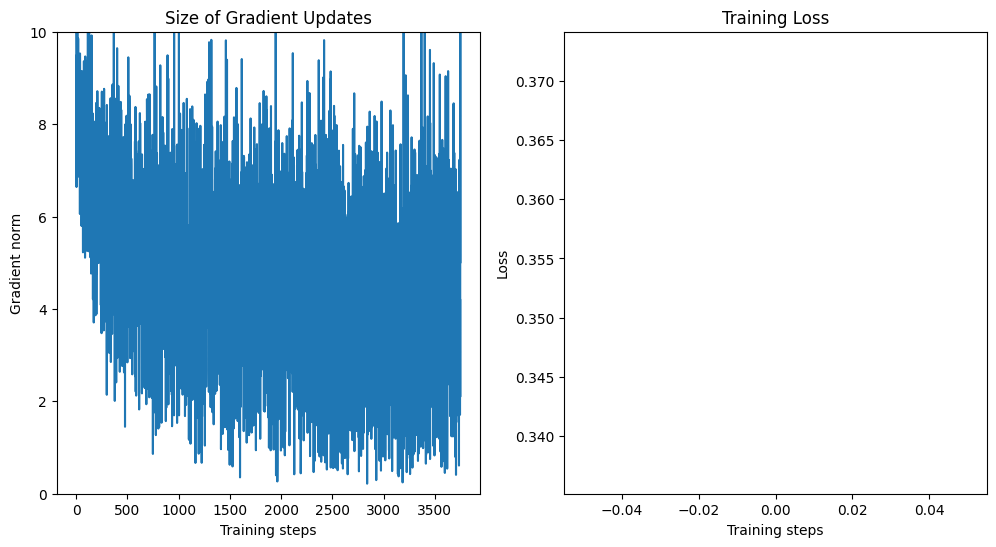

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=4


Epoch 1:   0%|          | 14/3750 [00:00<01:18, 47.69it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.884245


Epoch 1:   6%|▌         | 220/3750 [00:02<00:29, 120.15it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.768216


Epoch 1:  11%|█         | 415/3750 [00:03<00:27, 120.68it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.338532


Epoch 1:  17%|█▋        | 624/3750 [00:05<00:25, 122.18it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.222193


Epoch 1:  22%|██▏       | 826/3750 [00:07<00:23, 126.60it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.210270


Epoch 1:  27%|██▋       | 1021/3750 [00:08<00:20, 130.62it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.274239


Epoch 1:  32%|███▏      | 1213/3750 [00:10<00:30, 84.31it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.231914


Epoch 1:  38%|███▊      | 1413/3750 [00:12<00:28, 81.72it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.126739


Epoch 1:  43%|████▎     | 1624/3750 [00:14<00:16, 126.59it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.211047


Epoch 1:  49%|████▊     | 1824/3750 [00:16<00:15, 123.77it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.857940


Epoch 1:  54%|█████▍    | 2022/3750 [00:18<00:13, 124.78it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.271161


Epoch 1:  59%|█████▉    | 2226/3750 [00:19<00:11, 127.91it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.407075


Epoch 1:  64%|██████▍   | 2414/3750 [00:21<00:10, 123.59it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.404437


Epoch 1:  70%|██████▉   | 2624/3750 [00:22<00:09, 123.05it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.313986


Epoch 1:  75%|███████▍  | 2810/3750 [00:24<00:10, 86.14it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.081342


Epoch 1:  80%|████████  | 3011/3750 [00:27<00:09, 79.54it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.094597


Epoch 1:  86%|████████▌ | 3216/3750 [00:29<00:04, 119.81it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.343874


Epoch 1:  91%|█████████ | 3417/3750 [00:30<00:02, 123.83it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.421351


Epoch 1:  96%|█████████▋| 3615/3750 [00:32<00:01, 120.82it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.212260


Epoch 1: 100%|██████████| 3750/3750 [00:33<00:00, 111.34it/s]


Train set: Avg. loss: 0.3396, Time: 33.7 secs 




Test set: Avg. loss: 0.0002, Accuracy: 97%, Time: 2.0 secs

Train loss: 0.3395860705428446, Test loss: 0.0002129124764353037, Test accuracy: 96.61, Train time: 33.6883704662323, Test time: 2.039828300476074


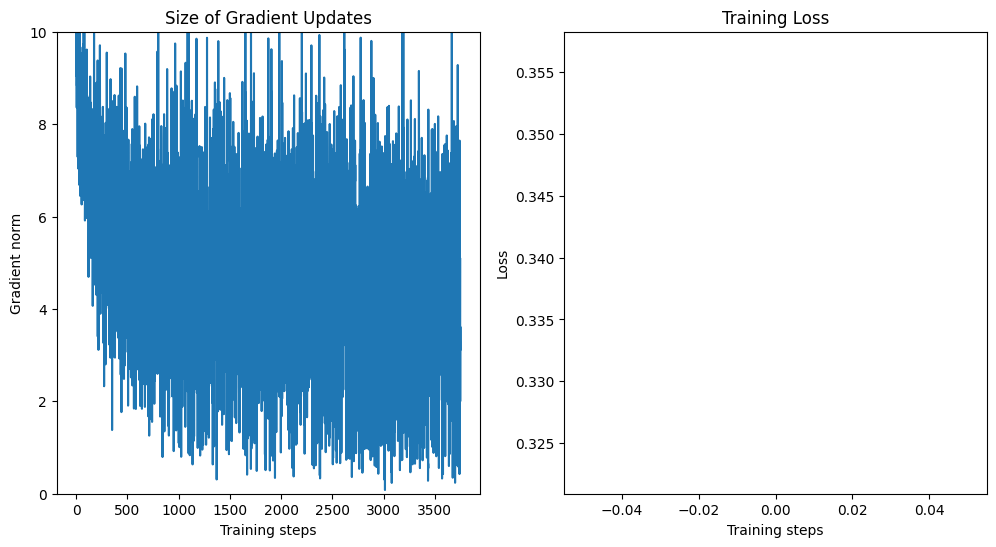

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=1


Epoch 1:   0%|          | 2/3750 [00:00<03:23, 18.42it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.619215


Epoch 1:  14%|█▍        | 518/3750 [00:05<00:38, 83.49it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.462769


Epoch 1:  27%|██▋       | 1019/3750 [00:10<00:25, 107.30it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.389089


Epoch 1:  40%|████      | 1517/3750 [00:15<00:20, 108.46it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.151781


Epoch 1:  54%|█████▎    | 2010/3750 [00:20<00:20, 83.11it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.317715


Epoch 1:  67%|██████▋   | 2517/3750 [00:25<00:11, 109.13it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.525969


Epoch 1:  80%|████████  | 3018/3750 [00:29<00:07, 103.72it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.028138


Epoch 1:  94%|█████████▎| 3513/3750 [00:35<00:02, 96.18it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.068084


Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 99.48it/s] 


Train set: Avg. loss: 0.3812, Time: 37.7 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.3812130673758686, Test loss: 0.0002473746821284294, Test accuracy: 96.0, Train time: 37.711687088012695, Test time: 2.117577314376831


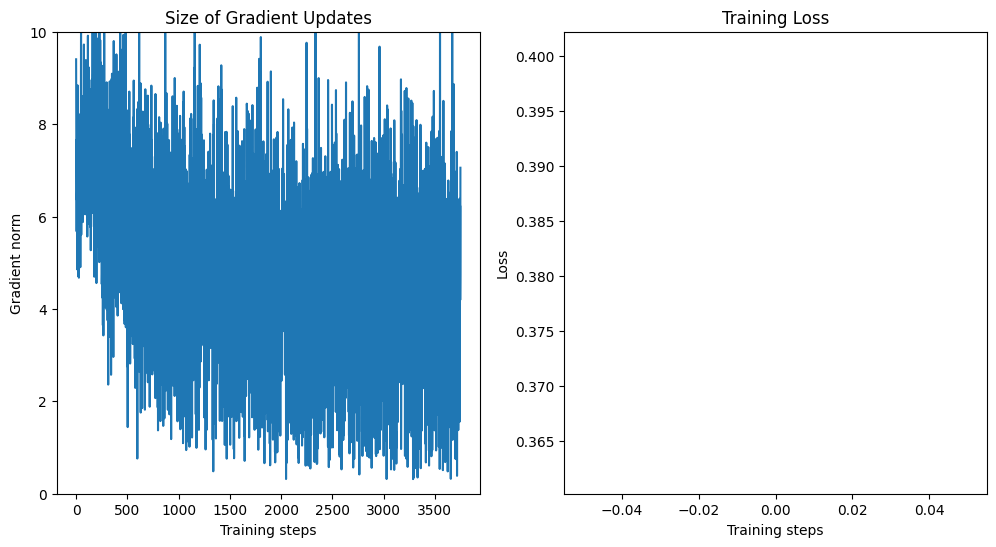

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<08:29,  7.35it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.512863


Epoch 1:  14%|█▍        | 525/3750 [00:04<00:26, 122.31it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.138058


Epoch 1:  27%|██▋       | 1016/3750 [00:09<00:27, 98.32it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.311171


Epoch 1:  41%|████      | 1520/3750 [00:14<00:18, 122.25it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.182024


Epoch 1:  54%|█████▎    | 2015/3750 [00:18<00:14, 122.76it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.202502


Epoch 1:  67%|██████▋   | 2516/3750 [00:23<00:14, 86.12it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.100050


Epoch 1:  81%|████████  | 3025/3750 [00:27<00:05, 125.85it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.105587


Epoch 1:  94%|█████████▎| 3513/3750 [00:31<00:01, 120.92it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.158718


Epoch 1: 100%|██████████| 3750/3750 [00:33<00:00, 111.21it/s]


Train set: Avg. loss: 0.3398, Time: 33.7 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 2.8 secs

Train loss: 0.3397995525198678, Test loss: 0.0002161876954138279, Test accuracy: 96.39, Train time: 33.737874031066895, Test time: 2.7568154335021973


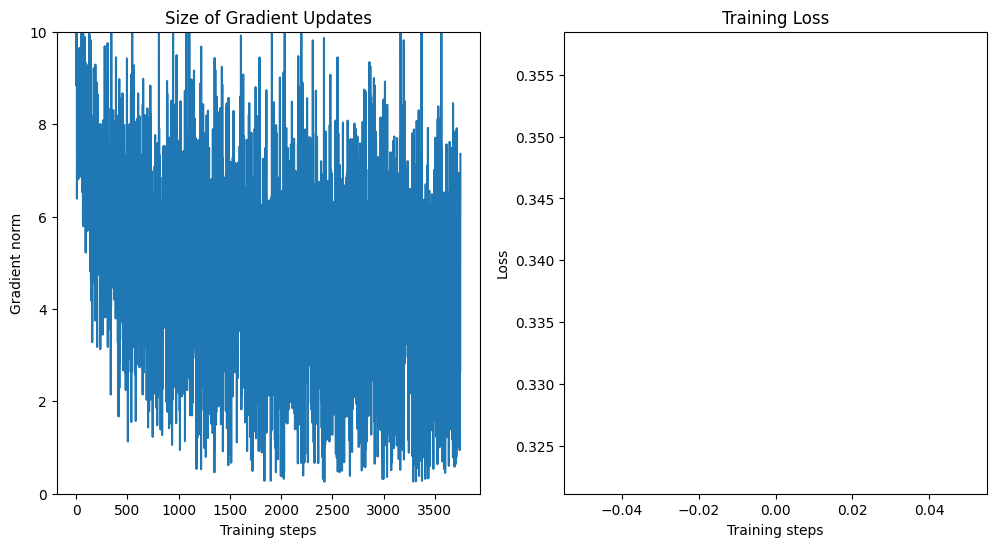

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=4


Epoch 1:   0%|          | 8/3750 [00:00<02:50, 22.00it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.370220


Epoch 1:  14%|█▎        | 514/3750 [00:04<00:26, 121.08it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.236066


Epoch 1:  27%|██▋       | 1024/3750 [00:09<00:21, 126.73it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.338836


Epoch 1:  40%|████      | 1511/3750 [00:13<00:27, 81.86it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.064349


Epoch 1:  54%|█████▎    | 2013/3750 [00:18<00:13, 131.77it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.306605


Epoch 1:  67%|██████▋   | 2514/3750 [00:22<00:09, 127.26it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.129566


Epoch 1:  80%|████████  | 3013/3750 [00:27<00:08, 82.85it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.177062


Epoch 1:  94%|█████████▍| 3523/3750 [00:32<00:01, 120.84it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.264552


Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 108.68it/s]


Train set: Avg. loss: 0.3563, Time: 34.5 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.3562797672374795, Test loss: 0.0002552940722554922, Test accuracy: 95.71, Train time: 34.51377296447754, Test time: 2.0843470096588135


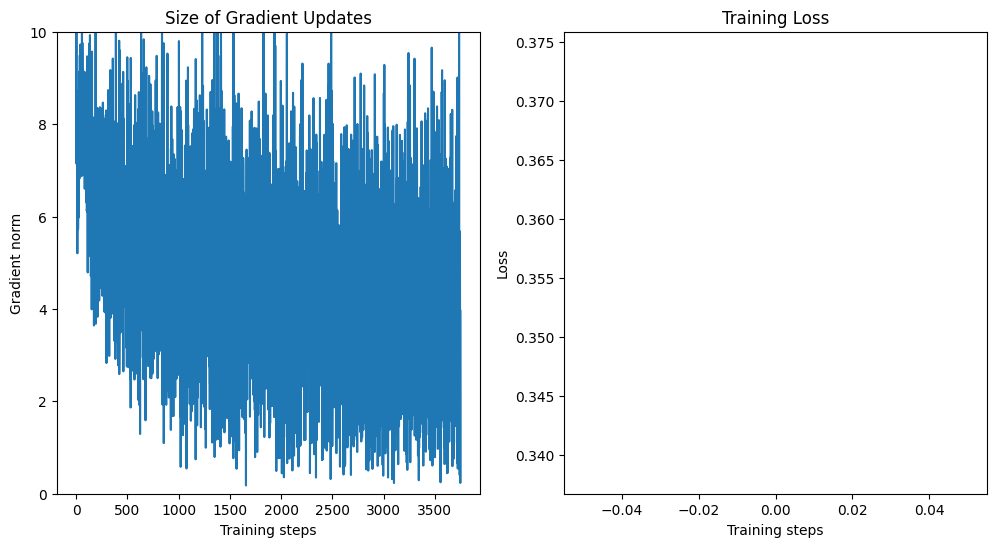

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 2/3750 [00:00<03:13, 19.33it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.483961


Epoch 1:   3%|▎         | 119/3750 [00:01<00:33, 110.02it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.114208


Epoch 1:   6%|▌         | 222/3750 [00:02<00:32, 108.81it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.082412


Epoch 1:   9%|▊         | 322/3750 [00:03<00:32, 104.76it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.618963


Epoch 1:  11%|█         | 411/3750 [00:03<00:34, 96.48it/s] 

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.359521


Epoch 1:  14%|█▎        | 513/3750 [00:05<00:39, 82.34it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.341024


Epoch 1:  16%|█▋        | 612/3750 [00:06<00:38, 80.64it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.311580


Epoch 1:  19%|█▉        | 711/3750 [00:07<00:35, 85.22it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 1.404948


Epoch 1:  22%|██▏       | 819/3750 [00:08<00:26, 110.77it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.025524


Epoch 1:  24%|██▍       | 915/3750 [00:09<00:25, 109.83it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.143917


Epoch 1:  27%|██▋       | 1021/3750 [00:10<00:24, 111.66it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.805304


Epoch 1:  30%|██▉       | 1112/3750 [00:11<00:24, 106.35it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 1.343286


Epoch 1:  33%|███▎      | 1220/3750 [00:12<00:21, 117.35it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.134964


Epoch 1:  35%|███▌      | 1314/3750 [00:13<00:22, 108.71it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.753859


Epoch 1:  38%|███▊      | 1420/3750 [00:14<00:21, 108.42it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.289870


Epoch 1:  41%|████      | 1521/3750 [00:15<00:21, 105.77it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.721872


Epoch 1:  43%|████▎     | 1621/3750 [00:16<00:20, 103.01it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.860375


Epoch 1:  46%|████▌     | 1723/3750 [00:17<00:19, 105.55it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.753509


Epoch 1:  48%|████▊     | 1814/3750 [00:17<00:17, 108.23it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.609825


Epoch 1:  51%|█████     | 1913/3750 [00:19<00:22, 80.28it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.646569


Epoch 1:  54%|█████▎    | 2013/3750 [00:20<00:21, 80.48it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.737652


Epoch 1:  56%|█████▋    | 2116/3750 [00:21<00:18, 89.54it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.582892


Epoch 1:  59%|█████▉    | 2213/3750 [00:22<00:16, 91.47it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.546653


Epoch 1:  62%|██████▏   | 2315/3750 [00:23<00:13, 109.43it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.280394


Epoch 1:  65%|██████▍   | 2420/3750 [00:24<00:12, 105.78it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.743076


Epoch 1:  67%|██████▋   | 2522/3750 [00:25<00:11, 107.47it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.721470


Epoch 1:  70%|██████▉   | 2612/3750 [00:26<00:10, 108.49it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.602006


Epoch 1:  72%|███████▏  | 2718/3750 [00:27<00:09, 111.10it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.379717


Epoch 1:  75%|███████▌  | 2821/3750 [00:28<00:08, 112.92it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.418742


Epoch 1:  78%|███████▊  | 2912/3750 [00:29<00:07, 105.06it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.446321


Epoch 1:  80%|████████  | 3015/3750 [00:30<00:06, 107.81it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.328265


Epoch 1:  83%|████████▎ | 3118/3750 [00:31<00:05, 109.09it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.304679


Epoch 1:  86%|████████▌ | 3220/3750 [00:32<00:04, 107.40it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.653035


Epoch 1:  88%|████████▊ | 3315/3750 [00:33<00:04, 87.93it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.630781


Epoch 1:  91%|█████████ | 3418/3750 [00:34<00:03, 85.61it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.486985


Epoch 1:  94%|█████████▍| 3518/3750 [00:35<00:02, 85.10it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.734029


Epoch 1:  96%|█████████▋| 3616/3750 [00:36<00:01, 77.37it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.676040


Epoch 1:  99%|█████████▉| 3714/3750 [00:37<00:00, 101.53it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.617341


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 98.22it/s] 


Train set: Avg. loss: 0.8436, Time: 38.2 secs 




Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.8436357641319434, Test loss: 0.00042385098934173584, Test accuracy: 94.16, Train time: 38.186933279037476, Test time: 2.140373945236206


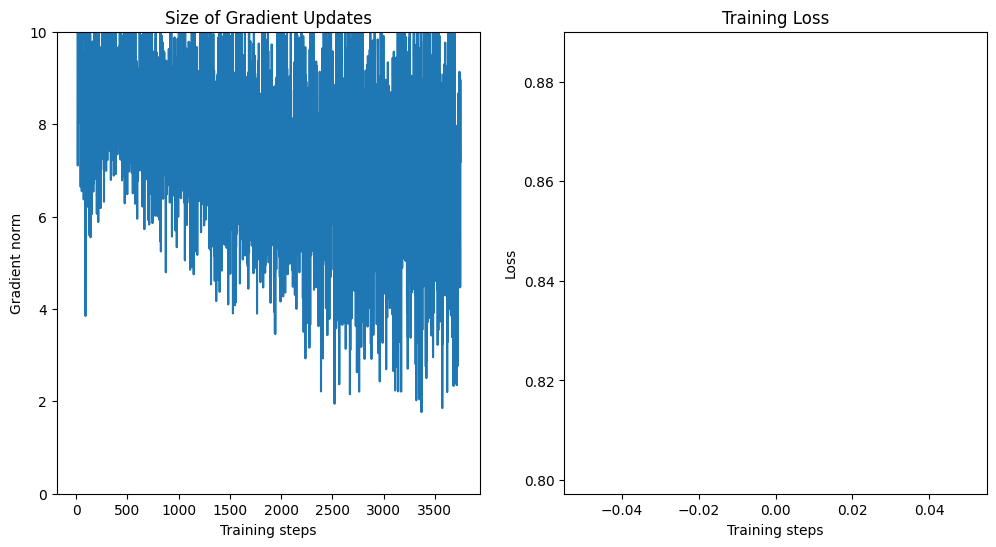

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<08:51,  7.06it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.870080


Epoch 1:   3%|▎         | 114/3750 [00:01<00:30, 119.65it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.183432


Epoch 1:   6%|▌         | 222/3750 [00:01<00:27, 127.61it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.298484


Epoch 1:   8%|▊         | 315/3750 [00:02<00:27, 126.34it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.343827


Epoch 1:  11%|█         | 420/3750 [00:03<00:27, 122.25it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.592534


Epoch 1:  14%|█▎        | 512/3750 [00:04<00:26, 120.20it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.326325


Epoch 1:  16%|█▋        | 616/3750 [00:05<00:25, 122.73it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.034423


Epoch 1:  19%|█▉        | 720/3750 [00:06<00:25, 120.17it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 1.284014


Epoch 1:  22%|██▏       | 818/3750 [00:07<00:31, 93.42it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.355978


Epoch 1:  24%|██▍       | 918/3750 [00:08<00:32, 86.38it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.022869


Epoch 1:  27%|██▋       | 1014/3750 [00:09<00:32, 84.72it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.640296


Epoch 1:  30%|██▉       | 1111/3750 [00:10<00:30, 85.53it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.697838


Epoch 1:  33%|███▎      | 1224/3750 [00:11<00:23, 106.54it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.464824


Epoch 1:  35%|███▌      | 1314/3750 [00:12<00:20, 118.90it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.778469


Epoch 1:  38%|███▊      | 1421/3750 [00:13<00:19, 122.24it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.082200


Epoch 1:  41%|████      | 1523/3750 [00:14<00:17, 123.78it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.747195


Epoch 1:  43%|████▎     | 1616/3750 [00:14<00:16, 126.47it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.920966


Epoch 1:  46%|████▌     | 1720/3750 [00:15<00:16, 119.63it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 1.234448


Epoch 1:  49%|████▊     | 1824/3750 [00:16<00:15, 123.46it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.388573


Epoch 1:  51%|█████     | 1913/3750 [00:17<00:15, 118.95it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.563016


Epoch 1:  54%|█████▎    | 2015/3750 [00:18<00:14, 117.73it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.382388


Epoch 1:  56%|█████▋    | 2117/3750 [00:19<00:13, 119.22it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.318984


Epoch 1:  59%|█████▉    | 2222/3750 [00:19<00:12, 122.97it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.245098


Epoch 1:  62%|██████▏   | 2327/3750 [00:20<00:11, 128.23it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.432124


Epoch 1:  64%|██████▍   | 2417/3750 [00:21<00:13, 102.29it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.314036


Epoch 1:  67%|██████▋   | 2515/3750 [00:22<00:14, 84.90it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.502020


Epoch 1:  70%|██████▉   | 2617/3750 [00:24<00:13, 82.83it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.587575


Epoch 1:  72%|███████▏  | 2715/3750 [00:25<00:12, 84.98it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.620953


Epoch 1:  75%|███████▌  | 2820/3750 [00:26<00:10, 91.75it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.389571


Epoch 1:  78%|███████▊  | 2922/3750 [00:27<00:06, 119.76it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.689102


Epoch 1:  80%|████████  | 3014/3750 [00:27<00:05, 123.39it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.459928


Epoch 1:  83%|████████▎ | 3119/3750 [00:28<00:05, 124.79it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.400400


Epoch 1:  86%|████████▌ | 3224/3750 [00:29<00:04, 123.53it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.578022


Epoch 1:  88%|████████▊ | 3315/3750 [00:30<00:03, 121.40it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.330190


Epoch 1:  91%|█████████ | 3415/3750 [00:31<00:02, 117.73it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.423990


Epoch 1:  94%|█████████▍| 3520/3750 [00:32<00:01, 119.43it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.398444


Epoch 1:  97%|█████████▋| 3622/3750 [00:33<00:01, 124.67it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.542533


Epoch 1:  99%|█████████▉| 3719/3750 [00:33<00:00, 125.99it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.627700


Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 109.96it/s]


Train set: Avg. loss: 0.8317, Time: 34.1 secs 




Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 1.8 secs

Train loss: 0.8316761865536372, Test loss: 0.00040769455395638944, Test accuracy: 94.31, Train time: 34.10998034477234, Test time: 1.8465027809143066


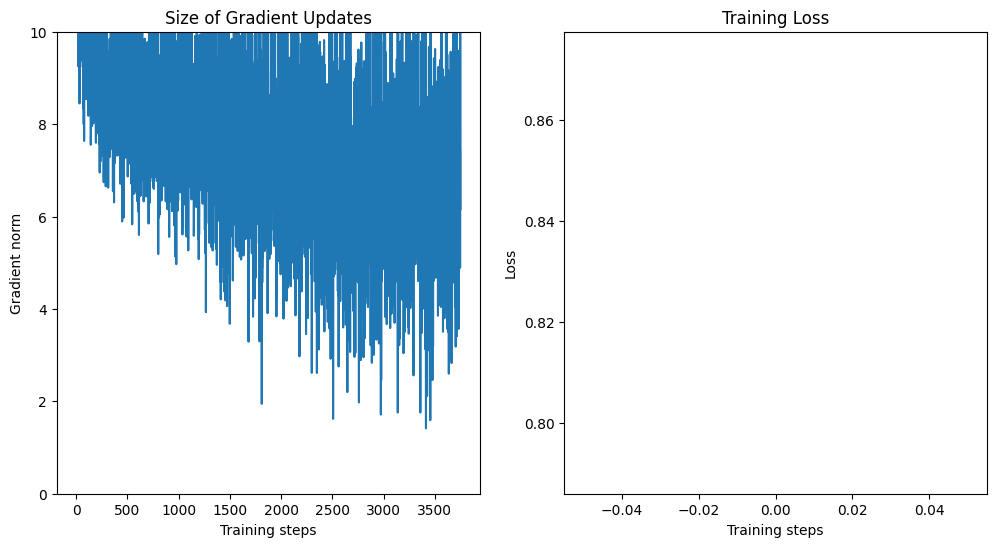

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 9/3750 [00:00<02:46, 22.53it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.720917


Epoch 1:   3%|▎         | 114/3750 [00:01<00:48, 74.77it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.886253


Epoch 1:   6%|▌         | 213/3750 [00:03<00:46, 76.58it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.863443


Epoch 1:   8%|▊         | 315/3750 [00:04<00:35, 97.64it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.717459


Epoch 1:  11%|█         | 417/3750 [00:05<00:27, 121.94it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.629660


Epoch 1:  14%|█▍        | 523/3750 [00:06<00:26, 122.49it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.436257


Epoch 1:  16%|█▋        | 614/3750 [00:06<00:25, 121.98it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.121618


Epoch 1:  19%|█▉        | 718/3750 [00:07<00:24, 121.85it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.579863


Epoch 1:  22%|██▏       | 821/3750 [00:08<00:25, 114.78it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.974695


Epoch 1:  25%|██▍       | 920/3750 [00:09<00:24, 114.55it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.754270


Epoch 1:  27%|██▋       | 1021/3750 [00:10<00:22, 123.06it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.511251


Epoch 1:  30%|██▉       | 1124/3750 [00:11<00:21, 121.73it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.425189


Epoch 1:  33%|███▎      | 1226/3750 [00:12<00:21, 119.99it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.925156


Epoch 1:  35%|███▌      | 1319/3750 [00:12<00:19, 122.31it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.422004


Epoch 1:  38%|███▊      | 1413/3750 [00:13<00:19, 120.58it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.757598


Epoch 1:  40%|████      | 1512/3750 [00:14<00:25, 86.88it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.299963


Epoch 1:  43%|████▎     | 1609/3750 [00:15<00:26, 79.93it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.672191


Epoch 1:  46%|████▌     | 1711/3750 [00:17<00:25, 80.94it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.404939


Epoch 1:  48%|████▊     | 1809/3750 [00:18<00:23, 81.26it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.560557


Epoch 1:  51%|█████▏    | 1922/3750 [00:19<00:16, 112.45it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.818763


Epoch 1:  54%|█████▍    | 2018/3750 [00:20<00:15, 114.88it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.342099


Epoch 1:  57%|█████▋    | 2121/3750 [00:21<00:13, 122.15it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.365764


Epoch 1:  59%|█████▉    | 2213/3750 [00:22<00:12, 118.84it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.243215


Epoch 1:  62%|██████▏   | 2313/3750 [00:22<00:12, 116.99it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.273100


Epoch 1:  64%|██████▍   | 2415/3750 [00:23<00:11, 121.20it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.934987


Epoch 1:  67%|██████▋   | 2515/3750 [00:24<00:10, 118.39it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.346536


Epoch 1:  70%|██████▉   | 2622/3750 [00:25<00:09, 123.81it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.288122


Epoch 1:  72%|███████▏  | 2715/3750 [00:26<00:08, 122.86it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.344063


Epoch 1:  75%|███████▌  | 2822/3750 [00:27<00:07, 121.56it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.870879


Epoch 1:  78%|███████▊  | 2925/3750 [00:27<00:06, 123.52it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.414798


Epoch 1:  80%|████████  | 3017/3750 [00:28<00:06, 120.09it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.642304


Epoch 1:  83%|████████▎ | 3110/3750 [00:29<00:07, 86.54it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.278292


Epoch 1:  86%|████████▌ | 3211/3750 [00:30<00:06, 79.74it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.703769


Epoch 1:  88%|████████▊ | 3311/3750 [00:32<00:05, 74.20it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.262869


Epoch 1:  91%|█████████ | 3409/3750 [00:33<00:04, 78.95it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.135485


Epoch 1:  94%|█████████▍| 3516/3750 [00:34<00:02, 115.89it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.474330


Epoch 1:  97%|█████████▋| 3620/3750 [00:35<00:01, 124.21it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.686053


Epoch 1:  99%|█████████▉| 3714/3750 [00:36<00:00, 122.24it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.093480


Epoch 1: 100%|██████████| 3750/3750 [00:36<00:00, 102.42it/s]



Train set: Avg. loss: 0.7382, Time: 36.6 secs 


Test set: Avg. loss: 0.0004, Accuracy: 95%, Time: 2.0 secs

Train loss: 0.7382244996349017, Test loss: 0.000387113980203867, Test accuracy: 94.66, Train time: 36.62178134918213, Test time: 2.0255985260009766


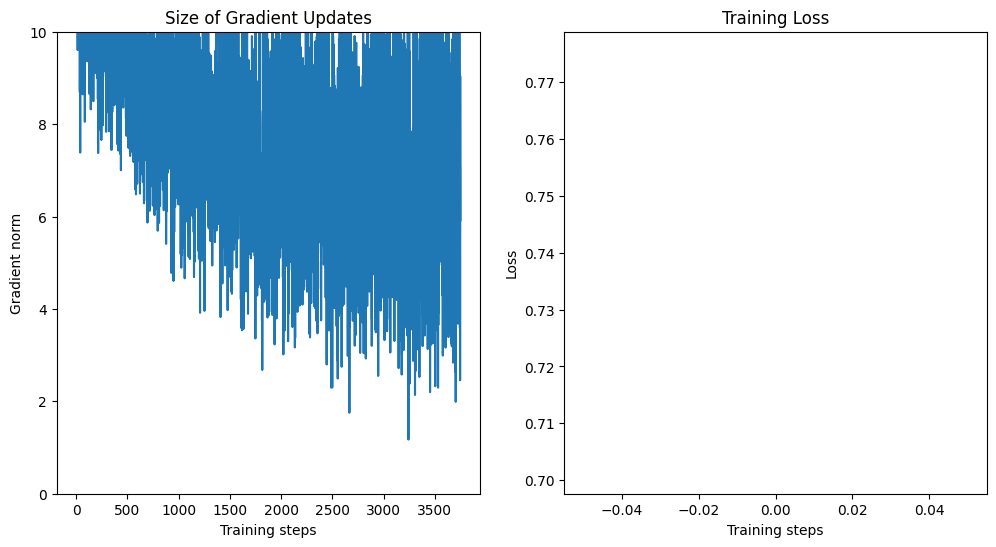

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 2/3750 [00:00<03:09, 19.82it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.500921


Epoch 1:   6%|▌         | 215/3750 [00:02<00:32, 108.16it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.198678


Epoch 1:  11%|█         | 417/3750 [00:04<00:32, 103.52it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.609672


Epoch 1:  16%|█▋        | 612/3750 [00:06<00:36, 85.84it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.018682


Epoch 1:  22%|██▏       | 811/3750 [00:08<00:36, 81.35it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.617899


Epoch 1:  27%|██▋       | 1016/3750 [00:10<00:25, 106.66it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.513768


Epoch 1:  33%|███▎      | 1219/3750 [00:12<00:24, 105.46it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.938875


Epoch 1:  38%|███▊      | 1422/3750 [00:14<00:21, 109.14it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.787253


Epoch 1:  43%|████▎     | 1613/3750 [00:16<00:20, 102.86it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.502760


Epoch 1:  48%|████▊     | 1817/3750 [00:18<00:18, 102.49it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.752652


Epoch 1:  54%|█████▎    | 2012/3750 [00:20<00:20, 84.29it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.366860


Epoch 1:  59%|█████▉    | 2214/3750 [00:22<00:18, 82.10it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.320614


Epoch 1:  65%|██████▍   | 2422/3750 [00:24<00:12, 103.75it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.785209


Epoch 1:  70%|██████▉   | 2621/3750 [00:26<00:10, 110.47it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.447504


Epoch 1:  75%|███████▍  | 2812/3750 [00:28<00:08, 104.55it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.315963


Epoch 1:  80%|████████  | 3017/3750 [00:30<00:06, 109.45it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.142511


Epoch 1:  86%|████████▌ | 3219/3750 [00:32<00:05, 101.87it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.654167


Epoch 1:  91%|█████████ | 3411/3750 [00:34<00:03, 100.86it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.208714


Epoch 1:  96%|█████████▋| 3617/3750 [00:36<00:01, 77.86it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.729013


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.64it/s]


Train set: Avg. loss: 0.7833, Time: 38.4 secs 




Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.2 secs

Train loss: 0.7832699210782846, Test loss: 0.00043315651267766955, Test accuracy: 93.91, Train time: 38.41891932487488, Test time: 2.1739766597747803


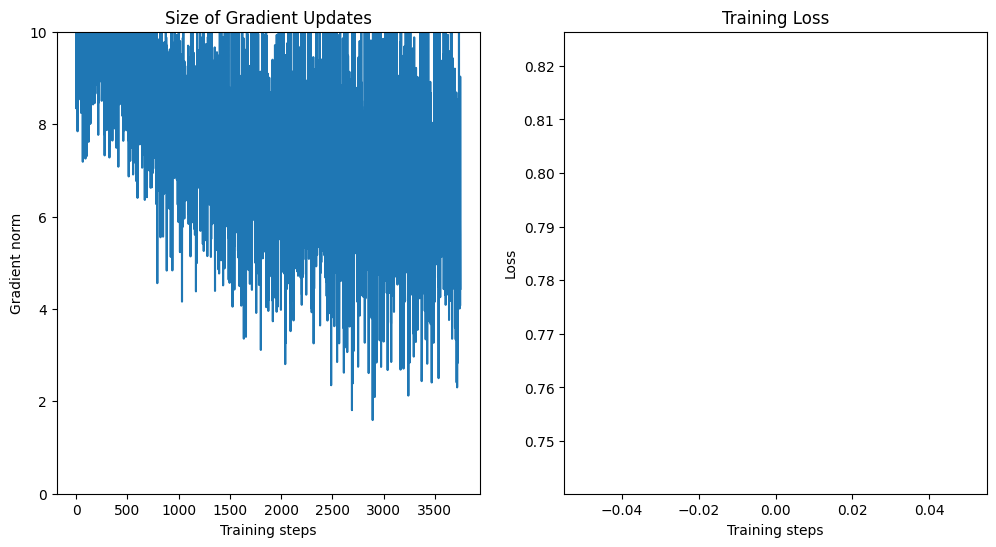

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<08:43,  7.17it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.651886


Epoch 1:   6%|▌         | 215/3750 [00:01<00:28, 123.76it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.692690


Epoch 1:  11%|█         | 421/3750 [00:03<00:27, 121.70it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.966655


Epoch 1:  17%|█▋        | 620/3750 [00:05<00:27, 113.86it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.923589


Epoch 1:  22%|██▏       | 824/3750 [00:07<00:24, 120.46it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.233480


Epoch 1:  27%|██▋       | 1016/3750 [00:09<00:31, 85.73it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.883025


Epoch 1:  32%|███▏      | 1211/3750 [00:11<00:29, 86.93it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.346795


Epoch 1:  38%|███▊      | 1421/3750 [00:13<00:20, 115.13it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.703061


Epoch 1:  43%|████▎     | 1623/3750 [00:15<00:17, 118.89it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.512924


Epoch 1:  48%|████▊     | 1815/3750 [00:16<00:15, 122.97it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.454699


Epoch 1:  54%|█████▍    | 2019/3750 [00:18<00:14, 121.51it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.565649


Epoch 1:  59%|█████▉    | 2225/3750 [00:20<00:13, 116.81it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.612661


Epoch 1:  64%|██████▍   | 2418/3750 [00:21<00:12, 108.19it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.199050


Epoch 1:  70%|██████▉   | 2616/3750 [00:24<00:14, 80.54it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.381188


Epoch 1:  75%|███████▌  | 2814/3750 [00:26<00:10, 87.41it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.319889


Epoch 1:  81%|████████  | 3020/3750 [00:28<00:06, 120.87it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.134142


Epoch 1:  86%|████████▌ | 3215/3750 [00:30<00:04, 118.43it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.093504


Epoch 1:  91%|█████████ | 3419/3750 [00:31<00:02, 119.87it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.121420


Epoch 1:  96%|█████████▋| 3613/3750 [00:33<00:01, 121.89it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.634895


Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 108.01it/s]


Train set: Avg. loss: 0.7044, Time: 34.7 secs 




Test set: Avg. loss: 0.0004, Accuracy: 95%, Time: 1.9 secs

Train loss: 0.7044472305665413, Test loss: 0.0003816934559494257, Test accuracy: 94.98, Train time: 34.728872299194336, Test time: 1.8575012683868408


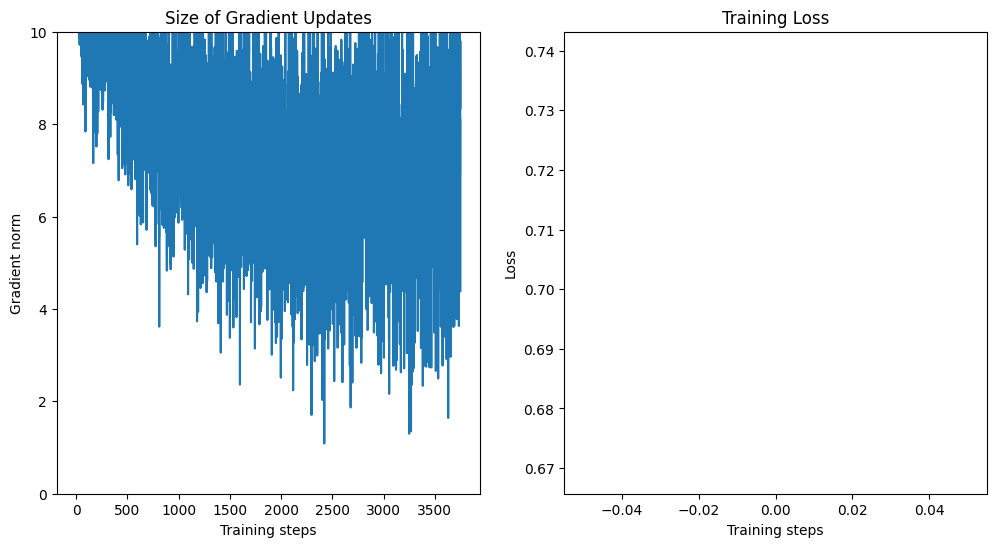

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=4


Epoch 1:   1%|          | 23/3750 [00:00<00:55, 66.57it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.086923


Epoch 1:   6%|▌         | 211/3750 [00:02<00:46, 76.60it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.994663


Epoch 1:  11%|█         | 413/3750 [00:05<00:44, 75.80it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.204261


Epoch 1:  17%|█▋        | 622/3750 [00:07<00:26, 118.13it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.199444


Epoch 1:  22%|██▏       | 816/3750 [00:08<00:24, 120.93it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.866703


Epoch 1:  27%|██▋       | 1025/3750 [00:10<00:22, 120.79it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.352807


Epoch 1:  33%|███▎      | 1221/3750 [00:12<00:20, 122.60it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.071430


Epoch 1:  38%|███▊      | 1425/3750 [00:13<00:19, 117.65it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.455135


Epoch 1:  43%|████▎     | 1614/3750 [00:15<00:19, 111.82it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.815586


Epoch 1:  48%|████▊     | 1817/3750 [00:18<00:24, 80.14it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.610320


Epoch 1:  54%|█████▎    | 2014/3750 [00:20<00:22, 77.25it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.415050


Epoch 1:  59%|█████▉    | 2216/3750 [00:22<00:12, 119.82it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.505082


Epoch 1:  65%|██████▍   | 2421/3750 [00:23<00:10, 121.37it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.578468


Epoch 1:  70%|██████▉   | 2618/3750 [00:25<00:10, 109.87it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.302515


Epoch 1:  75%|███████▌  | 2820/3750 [00:27<00:07, 120.12it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.462386


Epoch 1:  81%|████████  | 3025/3750 [00:29<00:05, 121.59it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.335955


Epoch 1:  86%|████████▌ | 3216/3750 [00:30<00:05, 98.67it/s] 

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.084743


Epoch 1:  91%|█████████ | 3412/3750 [00:33<00:04, 75.33it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.149485


Epoch 1:  96%|█████████▋| 3613/3750 [00:35<00:01, 97.72it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.540594


Epoch 1: 100%|██████████| 3750/3750 [00:36<00:00, 101.51it/s]


Train set: Avg. loss: 0.7199, Time: 37.0 secs 




Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.7199366642951965, Test loss: 0.00039820634573698046, Test accuracy: 94.42, Train time: 36.96329069137573, Test time: 2.0542232990264893


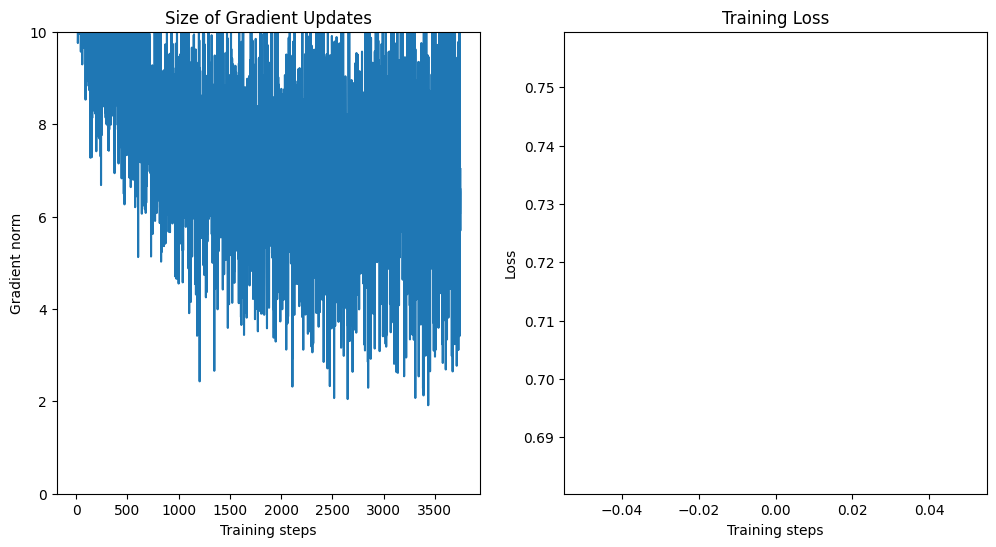

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 2/3750 [00:00<03:09, 19.78it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.688381


Epoch 1:  14%|█▍        | 516/3750 [00:04<00:29, 109.33it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.367869


Epoch 1:  27%|██▋       | 1017/3750 [00:10<00:30, 91.09it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.799745


Epoch 1:  40%|████      | 1512/3750 [00:15<00:21, 105.14it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.409739


Epoch 1:  54%|█████▎    | 2011/3750 [00:20<00:16, 104.25it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.490953


Epoch 1:  67%|██████▋   | 2521/3750 [00:26<00:11, 103.17it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.723234


Epoch 1:  80%|████████  | 3013/3750 [00:30<00:07, 105.20it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.244235


Epoch 1:  94%|█████████▍| 3519/3750 [00:35<00:02, 103.78it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.495362


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.97it/s]


Train set: Avg. loss: 0.7440, Time: 38.3 secs 




Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.6 secs

Train loss: 0.7440009018143018, Test loss: 0.0003912960834801197, Test accuracy: 94.4, Train time: 38.29272770881653, Test time: 2.584474563598633


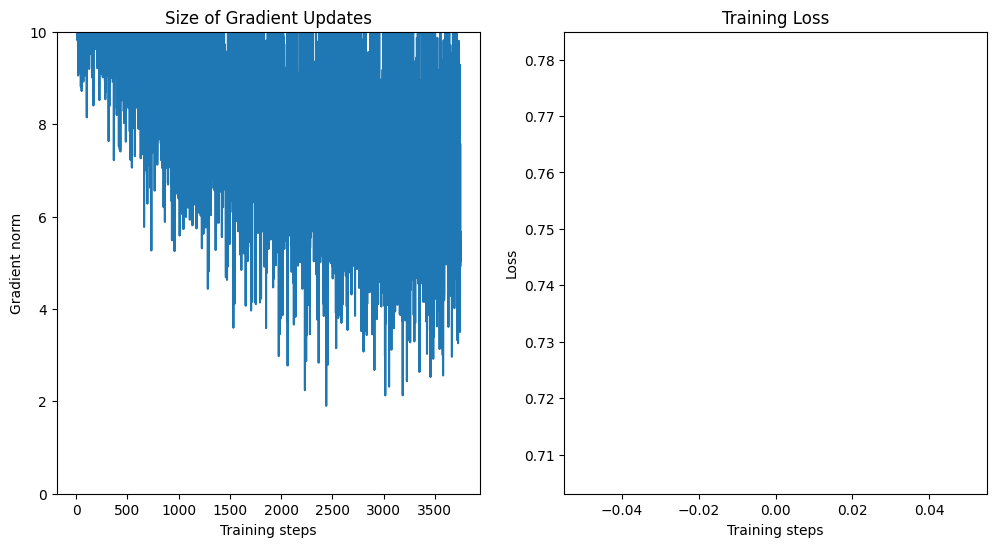

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<09:45,  6.41it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.686370


Epoch 1:  14%|█▎        | 513/3750 [00:04<00:26, 121.32it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.564243


Epoch 1:  27%|██▋       | 1018/3750 [00:08<00:26, 103.01it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.906027


Epoch 1:  41%|████      | 1520/3750 [00:14<00:19, 115.58it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.113715


Epoch 1:  54%|█████▍    | 2022/3750 [00:18<00:14, 118.54it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.403066


Epoch 1:  67%|██████▋   | 2517/3750 [00:22<00:10, 118.92it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.398861


Epoch 1:  80%|████████  | 3017/3750 [00:28<00:08, 88.24it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.306951


Epoch 1:  94%|█████████▍| 3516/3750 [00:32<00:02, 114.45it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.145863


Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 107.38it/s]


Train set: Avg. loss: 0.8854, Time: 34.9 secs 




Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 1.9 secs

Train loss: 0.8853979244063298, Test loss: 0.0004226377539336681, Test accuracy: 93.96, Train time: 34.937774419784546, Test time: 1.894848346710205


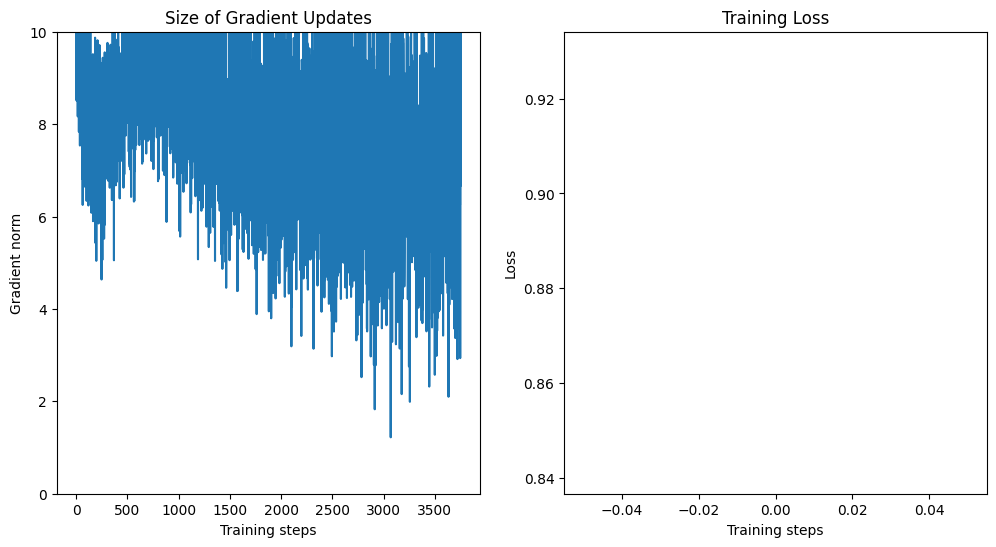

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 11/3750 [00:00<01:38, 38.05it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.763473


Epoch 1:  14%|█▎        | 510/3750 [00:06<00:40, 79.49it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.484239


Epoch 1:  27%|██▋       | 1022/3750 [00:11<00:25, 106.83it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.275812


Epoch 1:  40%|████      | 1514/3750 [00:15<00:21, 102.44it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.771045


Epoch 1:  54%|█████▍    | 2016/3750 [00:21<00:22, 78.56it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.623970


Epoch 1:  67%|██████▋   | 2522/3750 [00:26<00:09, 123.52it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.661370


Epoch 1:  81%|████████  | 3020/3750 [00:30<00:05, 122.39it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.568435


Epoch 1:  94%|█████████▎| 3509/3750 [00:35<00:03, 79.61it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.306835


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.66it/s] 


Train set: Avg. loss: 0.8944, Time: 38.4 secs 




Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.8944009809573491, Test loss: 0.00039429943561553954, Test accuracy: 94.44, Train time: 38.41457986831665, Test time: 2.0524818897247314


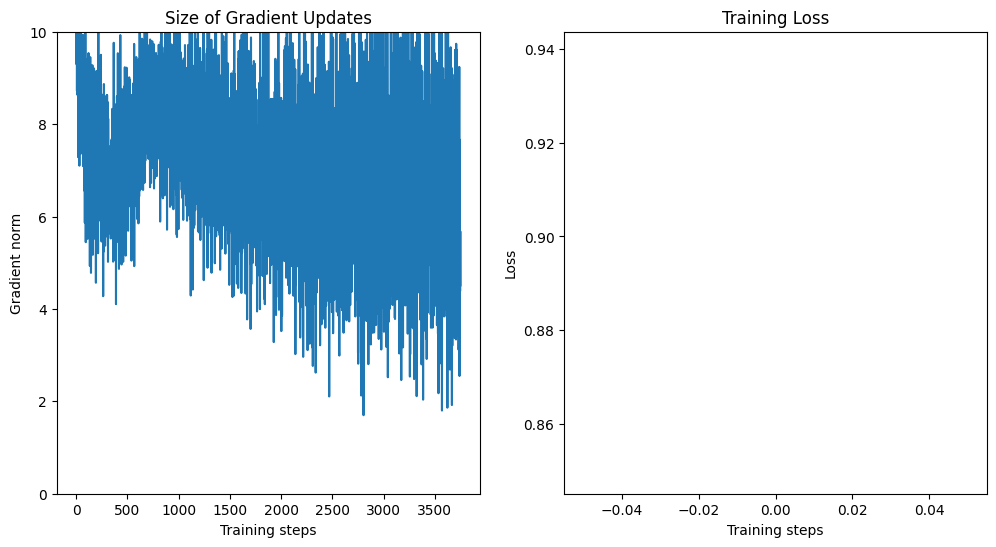

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<06:49,  9.15it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.675458


Epoch 1:   3%|▎         | 113/3750 [00:01<00:33, 108.99it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.642499


Epoch 1:   6%|▌         | 214/3750 [00:02<00:32, 109.08it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.628704


Epoch 1:   8%|▊         | 316/3750 [00:03<00:31, 108.67it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.512603


Epoch 1:  11%|█         | 416/3750 [00:04<00:32, 102.48it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.345606


Epoch 1:  14%|█▎        | 515/3750 [00:05<00:31, 103.60it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.293892


Epoch 1:  16%|█▋        | 616/3750 [00:05<00:29, 106.65it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.336807


Epoch 1:  19%|█▉        | 714/3750 [00:06<00:33, 91.50it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.318760


Epoch 1:  22%|██▏       | 818/3750 [00:08<00:35, 82.55it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.383059


Epoch 1:  24%|██▍       | 911/3750 [00:09<00:33, 83.50it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.033560


Epoch 1:  27%|██▋       | 1011/3750 [00:10<00:33, 82.93it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.374469


Epoch 1:  30%|██▉       | 1110/3750 [00:11<00:32, 82.21it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.111354


Epoch 1:  33%|███▎      | 1220/3750 [00:12<00:24, 103.86it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.049674


Epoch 1:  35%|███▌      | 1320/3750 [00:13<00:22, 106.35it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.127389


Epoch 1:  38%|███▊      | 1419/3750 [00:14<00:22, 105.39it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.417903


Epoch 1:  41%|████      | 1521/3750 [00:15<00:20, 108.39it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.248004


Epoch 1:  43%|████▎     | 1613/3750 [00:16<00:19, 107.11it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.053552


Epoch 1:  46%|████▌     | 1713/3750 [00:17<00:19, 104.78it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.422484


Epoch 1:  48%|████▊     | 1813/3750 [00:18<00:18, 106.58it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.432045


Epoch 1:  51%|█████     | 1912/3750 [00:19<00:17, 104.79it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.774822


Epoch 1:  54%|█████▎    | 2012/3750 [00:20<00:16, 107.18it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.131714


Epoch 1:  56%|█████▋    | 2113/3750 [00:21<00:15, 105.31it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 2.093330


Epoch 1:  59%|█████▉    | 2213/3750 [00:22<00:18, 84.54it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.878351


Epoch 1:  62%|██████▏   | 2312/3750 [00:23<00:16, 85.41it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 2.068399


Epoch 1:  64%|██████▍   | 2411/3750 [00:24<00:16, 83.04it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.789053


Epoch 1:  67%|██████▋   | 2510/3750 [00:26<00:15, 81.62it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.821198


Epoch 1:  70%|██████▉   | 2614/3750 [00:27<00:10, 104.15it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.967295


Epoch 1:  72%|███████▏  | 2713/3750 [00:28<00:09, 105.34it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.517709


Epoch 1:  75%|███████▌  | 2813/3750 [00:28<00:08, 106.50it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.233362


Epoch 1:  78%|███████▊  | 2916/3750 [00:29<00:07, 109.09it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 2.154316


Epoch 1:  80%|████████  | 3017/3750 [00:30<00:06, 105.42it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.460912


Epoch 1:  83%|████████▎ | 3118/3750 [00:31<00:06, 103.53it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.838681


Epoch 1:  86%|████████▌ | 3220/3750 [00:32<00:04, 108.56it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.886343


Epoch 1:  89%|████████▊ | 3321/3750 [00:33<00:04, 106.52it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.593320


Epoch 1:  91%|█████████▏| 3422/3750 [00:34<00:03, 105.28it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.620054


Epoch 1:  94%|█████████▍| 3523/3750 [00:35<00:02, 107.67it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 2.000994


Epoch 1:  96%|█████████▋| 3612/3750 [00:36<00:01, 94.68it/s] 

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.795788


Epoch 1:  99%|█████████▉| 3714/3750 [00:37<00:00, 86.65it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.525581


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.91it/s]


Train set: Avg. loss: 2.0857, Time: 38.3 secs 




Test set: Avg. loss: 0.0032, Accuracy: 49%, Time: 2.8 secs

Train loss: 2.085664600499471, Test loss: 0.0032069629669189454, Test accuracy: 49.17, Train time: 38.31454873085022, Test time: 2.8222544193267822


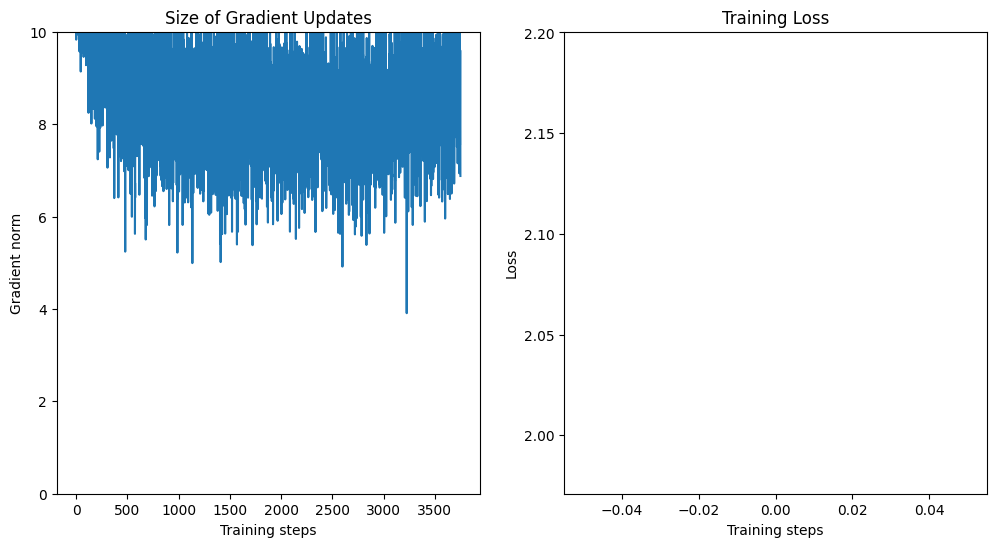

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<10:48,  5.78it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.433814


Epoch 1:   3%|▎         | 113/3750 [00:01<00:30, 117.50it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.286956


Epoch 1:   6%|▌         | 214/3750 [00:01<00:29, 121.30it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.975263


Epoch 1:   8%|▊         | 315/3750 [00:02<00:29, 116.63it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.439688


Epoch 1:  11%|█▏        | 424/3750 [00:03<00:28, 115.94it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.233254


Epoch 1:  14%|█▍        | 522/3750 [00:04<00:28, 115.09it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.273465


Epoch 1:  17%|█▋        | 620/3750 [00:05<00:26, 117.19it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.182884


Epoch 1:  19%|█▉        | 720/3750 [00:06<00:27, 110.95it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.001975


Epoch 1:  22%|██▏       | 819/3750 [00:07<00:25, 115.57it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.178151


Epoch 1:  25%|██▍       | 920/3750 [00:08<00:24, 117.68it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.136504


Epoch 1:  27%|██▋       | 1019/3750 [00:08<00:23, 118.45it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.981422


Epoch 1:  30%|██▉       | 1118/3750 [00:10<00:31, 84.76it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 1.964936


Epoch 1:  32%|███▏      | 1213/3750 [00:11<00:29, 85.56it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.777993


Epoch 1:  35%|███▌      | 1316/3750 [00:12<00:29, 83.12it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 1.929559


Epoch 1:  38%|███▊      | 1411/3750 [00:13<00:28, 81.95it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.265078


Epoch 1:  41%|████      | 1520/3750 [00:14<00:20, 107.84it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.269439


Epoch 1:  43%|████▎     | 1616/3750 [00:15<00:19, 111.23it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.935899


Epoch 1:  46%|████▌     | 1717/3750 [00:16<00:17, 117.30it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.077252


Epoch 1:  48%|████▊     | 1814/3750 [00:17<00:16, 115.54it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.040560


Epoch 1:  51%|█████     | 1913/3750 [00:18<00:15, 118.43it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.544166


Epoch 1:  54%|█████▎    | 2015/3750 [00:19<00:14, 122.66it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.473890


Epoch 1:  56%|█████▋    | 2115/3750 [00:19<00:14, 116.13it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.709489


Epoch 1:  59%|█████▉    | 2214/3750 [00:20<00:13, 116.29it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.731608


Epoch 1:  62%|██████▏   | 2313/3750 [00:21<00:11, 120.40it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 2.081062


Epoch 1:  64%|██████▍   | 2417/3750 [00:22<00:11, 118.41it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.832727


Epoch 1:  67%|██████▋   | 2516/3750 [00:23<00:10, 116.78it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.581225


Epoch 1:  70%|██████▉   | 2615/3750 [00:24<00:09, 117.67it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.802730


Epoch 1:  72%|███████▏  | 2708/3750 [00:25<00:11, 87.28it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.949798


Epoch 1:  75%|███████▌  | 2816/3750 [00:26<00:11, 80.02it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.959409


Epoch 1:  78%|███████▊  | 2908/3750 [00:27<00:09, 85.16it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.886183


Epoch 1:  80%|████████  | 3009/3750 [00:29<00:09, 79.22it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.515922


Epoch 1:  83%|████████▎ | 3122/3750 [00:30<00:05, 109.32it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.794315


Epoch 1:  86%|████████▌ | 3223/3750 [00:31<00:04, 119.67it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.566014


Epoch 1:  88%|████████▊ | 3314/3750 [00:31<00:03, 120.21it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.898610


Epoch 1:  91%|█████████ | 3417/3750 [00:32<00:02, 120.68it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 2.086110


Epoch 1:  94%|█████████▍| 3520/3750 [00:33<00:01, 118.03it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.455205


Epoch 1:  97%|█████████▋| 3622/3750 [00:34<00:01, 119.88it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.681709


Epoch 1:  99%|█████████▉| 3712/3750 [00:35<00:00, 120.25it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.202868


Epoch 1: 100%|██████████| 3750/3750 [00:35<00:00, 105.07it/s]


Train set: Avg. loss: 1.9615, Time: 35.7 secs 




Test set: Avg. loss: 0.0025, Accuracy: 63%, Time: 1.9 secs

Train loss: 1.9614789430618287, Test loss: 0.002507980650663376, Test accuracy: 63.41, Train time: 35.69862461090088, Test time: 1.8768446445465088


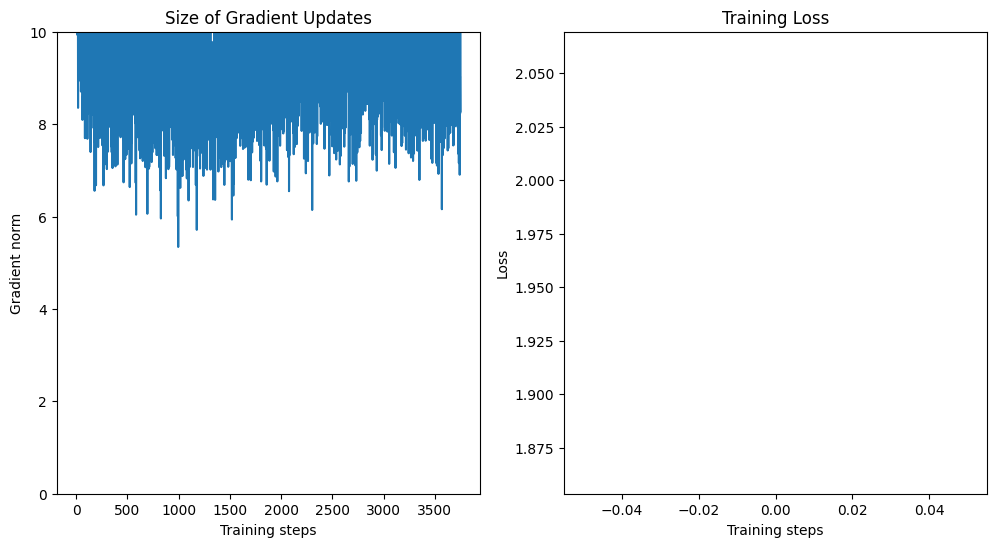

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 11/3750 [00:00<01:42, 36.65it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.677117


Epoch 1:   3%|▎         | 120/3750 [00:01<00:31, 116.50it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.590371


Epoch 1:   6%|▌         | 211/3750 [00:02<00:43, 81.05it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.341425


Epoch 1:   8%|▊         | 314/3750 [00:03<00:42, 80.29it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.342540


Epoch 1:  11%|█         | 413/3750 [00:04<00:43, 76.09it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.511870


Epoch 1:  14%|█▍        | 516/3750 [00:06<00:40, 79.89it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.322492


Epoch 1:  17%|█▋        | 619/3750 [00:07<00:30, 103.35it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.208078


Epoch 1:  19%|█▉        | 718/3750 [00:08<00:25, 118.28it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.297755


Epoch 1:  22%|██▏       | 816/3750 [00:09<00:25, 114.47it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.114735


Epoch 1:  24%|██▍       | 916/3750 [00:10<00:24, 116.27it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.321837


Epoch 1:  27%|██▋       | 1014/3750 [00:10<00:23, 117.21it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.341514


Epoch 1:  30%|██▉       | 1118/3750 [00:11<00:21, 122.45it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 1.988140


Epoch 1:  33%|███▎      | 1220/3750 [00:12<00:21, 117.95it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.025535


Epoch 1:  35%|███▌      | 1321/3750 [00:13<00:20, 118.23it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.140928


Epoch 1:  38%|███▊      | 1417/3750 [00:14<00:20, 113.59it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.214323


Epoch 1:  41%|████      | 1520/3750 [00:15<00:18, 121.51it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.858700


Epoch 1:  43%|████▎     | 1619/3750 [00:16<00:17, 119.85it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.016618


Epoch 1:  46%|████▌     | 1718/3750 [00:16<00:17, 117.19it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.339412


Epoch 1:  48%|████▊     | 1815/3750 [00:17<00:22, 85.14it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.006790


Epoch 1:  51%|█████     | 1910/3750 [00:19<00:24, 76.62it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.627588


Epoch 1:  54%|█████▎    | 2013/3750 [00:20<00:20, 82.92it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.754884


Epoch 1:  56%|█████▋    | 2115/3750 [00:21<00:19, 82.00it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 2.210288


Epoch 1:  59%|█████▉    | 2221/3750 [00:23<00:16, 91.60it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.924714


Epoch 1:  62%|██████▏   | 2322/3750 [00:23<00:11, 122.83it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.875803


Epoch 1:  65%|██████▍   | 2420/3750 [00:24<00:11, 116.05it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.907111


Epoch 1:  67%|██████▋   | 2520/3750 [00:25<00:10, 116.81it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.906828


Epoch 1:  70%|██████▉   | 2620/3750 [00:26<00:09, 118.04it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.988934


Epoch 1:  73%|███████▎  | 2724/3750 [00:27<00:08, 122.41it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.650066


Epoch 1:  75%|███████▌  | 2822/3750 [00:28<00:07, 117.94it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.012250


Epoch 1:  78%|███████▊  | 2923/3750 [00:29<00:06, 118.31it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.665841


Epoch 1:  81%|████████  | 3022/3750 [00:29<00:06, 116.91it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.797622


Epoch 1:  83%|████████▎ | 3122/3750 [00:30<00:05, 117.44it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.628120


Epoch 1:  86%|████████▌ | 3222/3750 [00:31<00:04, 117.78it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.709534


Epoch 1:  89%|████████▊ | 3320/3750 [00:32<00:03, 111.83it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.778840


Epoch 1:  91%|█████████ | 3408/3750 [00:33<00:04, 81.94it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.912508


Epoch 1:  94%|█████████▎| 3515/3750 [00:34<00:02, 80.66it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.790950


Epoch 1:  96%|█████████▋| 3613/3750 [00:36<00:01, 79.27it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.549199


Epoch 1:  99%|█████████▉| 3713/3750 [00:37<00:00, 74.53it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.555740


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 98.54it/s]


Train set: Avg. loss: 2.0126, Time: 38.1 secs 




Test set: Avg. loss: 0.0028, Accuracy: 56%, Time: 2.1 secs

Train loss: 2.012558595784505, Test loss: 0.0028462942361831664, Test accuracy: 56.21, Train time: 38.0627076625824, Test time: 2.0836973190307617


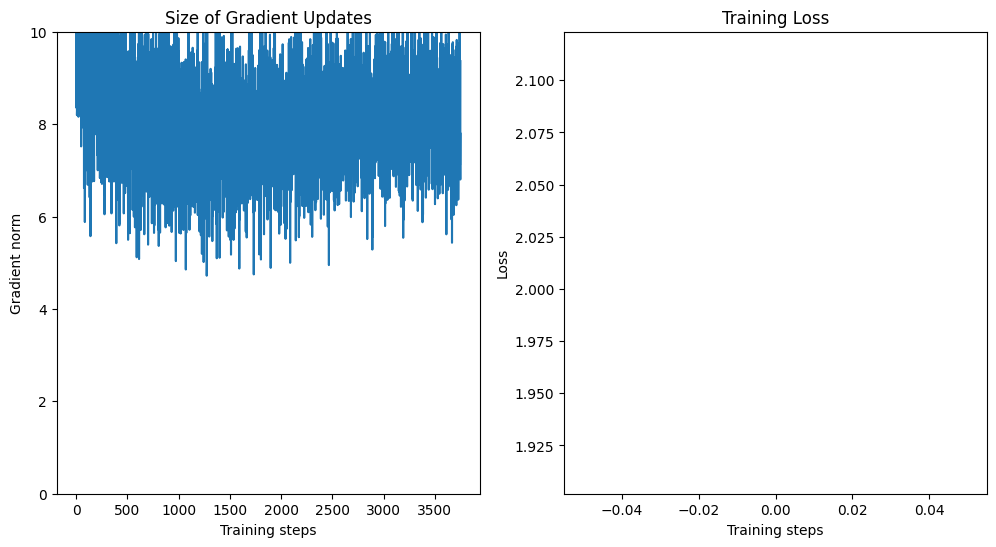

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<07:04,  8.84it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.589436


Epoch 1:   6%|▌         | 213/3750 [00:02<00:34, 103.63it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.306976


Epoch 1:  11%|█         | 414/3750 [00:04<00:32, 104.14it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.491798


Epoch 1:  16%|█▋        | 617/3750 [00:05<00:29, 105.86it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.477562


Epoch 1:  22%|██▏       | 815/3750 [00:07<00:33, 88.40it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.206011


Epoch 1:  27%|██▋       | 1017/3750 [00:10<00:32, 84.77it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.083815


Epoch 1:  33%|███▎      | 1219/3750 [00:12<00:29, 86.90it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.244183


Epoch 1:  38%|███▊      | 1416/3750 [00:14<00:21, 108.21it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.056684


Epoch 1:  43%|████▎     | 1619/3750 [00:16<00:20, 104.08it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.882177


Epoch 1:  48%|████▊     | 1818/3750 [00:18<00:18, 103.44it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.262495


Epoch 1:  54%|█████▍    | 2017/3750 [00:20<00:16, 105.56it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.074967


Epoch 1:  59%|█████▉    | 2216/3750 [00:22<00:15, 99.58it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.837045


Epoch 1:  64%|██████▍   | 2410/3750 [00:24<00:16, 83.09it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.251903


Epoch 1:  70%|██████▉   | 2615/3750 [00:27<00:13, 81.30it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.447142


Epoch 1:  75%|███████▌  | 2815/3750 [00:29<00:08, 105.26it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.615319


Epoch 1:  80%|████████  | 3014/3750 [00:31<00:07, 101.78it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.834755


Epoch 1:  86%|████████▌ | 3213/3750 [00:33<00:05, 106.76it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.571623


Epoch 1:  91%|█████████ | 3415/3750 [00:35<00:03, 108.30it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.232848


Epoch 1:  96%|█████████▋| 3616/3750 [00:37<00:01, 105.51it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.334441


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 96.68it/s]


Train set: Avg. loss: 1.8794, Time: 38.8 secs 




Test set: Avg. loss: 0.0021, Accuracy: 69%, Time: 3.1 secs

Train loss: 1.8793912090460458, Test loss: 0.002144369715452194, Test accuracy: 68.89, Train time: 38.79922127723694, Test time: 3.088597536087036


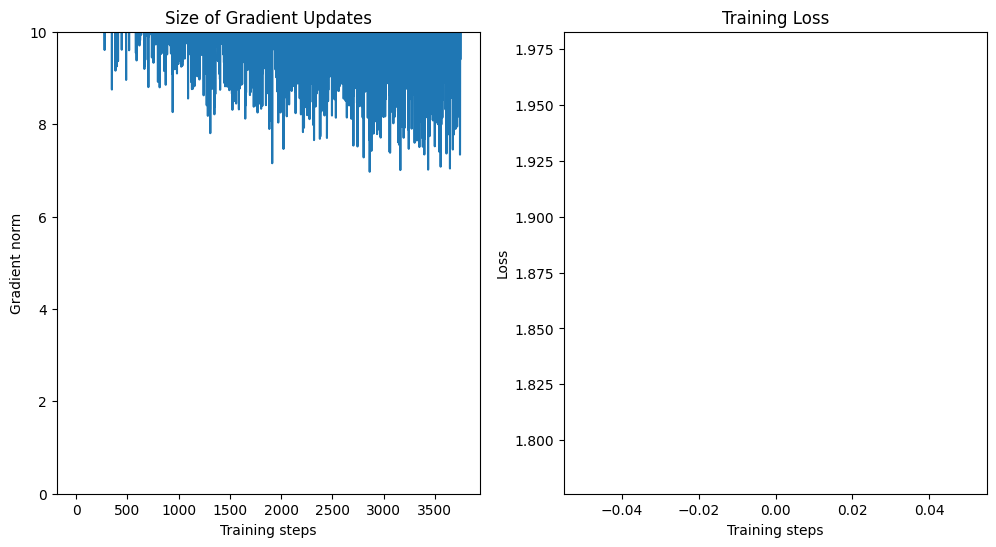

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<10:02,  6.22it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.614135


Epoch 1:   6%|▌         | 217/3750 [00:02<00:31, 112.29it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.172059


Epoch 1:  11%|█         | 419/3750 [00:03<00:27, 121.69it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.542915


Epoch 1:  17%|█▋        | 623/3750 [00:05<00:27, 115.53it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.189501


Epoch 1:  22%|██▏       | 820/3750 [00:07<00:25, 116.65it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.077659


Epoch 1:  27%|██▋       | 1016/3750 [00:08<00:23, 116.30it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.356355


Epoch 1:  32%|███▏      | 1215/3750 [00:12<00:31, 80.19it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.071936


Epoch 1:  38%|███▊      | 1414/3750 [00:14<00:23, 98.11it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.000852


Epoch 1:  43%|████▎     | 1623/3750 [00:16<00:18, 116.54it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.020199


Epoch 1:  48%|████▊     | 1813/3750 [00:18<00:17, 113.19it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.491632


Epoch 1:  54%|█████▎    | 2013/3750 [00:19<00:15, 114.58it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.833539


Epoch 1:  59%|█████▉    | 2216/3750 [00:21<00:12, 118.77it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.797083


Epoch 1:  65%|██████▍   | 2423/3750 [00:23<00:11, 114.78it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.657825


Epoch 1:  70%|██████▉   | 2614/3750 [00:25<00:13, 86.71it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.345663


Epoch 1:  75%|███████▌  | 2814/3750 [00:27<00:11, 80.07it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.650462


Epoch 1:  81%|████████  | 3022/3750 [00:30<00:07, 103.18it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.388025


Epoch 1:  86%|████████▌ | 3218/3750 [00:31<00:04, 114.32it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.560696


Epoch 1:  91%|█████████ | 3416/3750 [00:33<00:02, 114.00it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.457763


Epoch 1:  96%|█████████▋| 3614/3750 [00:35<00:01, 119.78it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.369540


Epoch 1: 100%|██████████| 3750/3750 [00:36<00:00, 102.45it/s]


Train set: Avg. loss: 1.8034, Time: 36.6 secs 




Test set: Avg. loss: 0.0020, Accuracy: 72%, Time: 2.5 secs

Train loss: 1.8034327587604522, Test loss: 0.0019757813811302183, Test accuracy: 72.25, Train time: 36.61570930480957, Test time: 2.4675445556640625


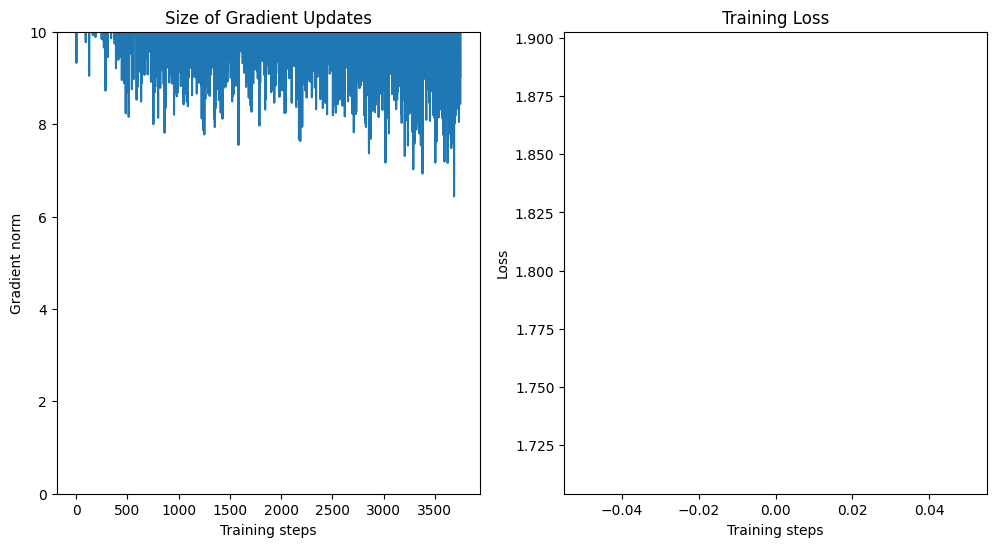

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 6/3750 [00:00<04:14, 14.71it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.668626


Epoch 1:   6%|▌         | 211/3750 [00:03<00:48, 73.22it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.613402


Epoch 1:  11%|█         | 420/3750 [00:05<00:31, 106.35it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.335161


Epoch 1:  16%|█▋        | 615/3750 [00:07<00:27, 114.64it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.247816


Epoch 1:  22%|██▏       | 813/3750 [00:09<00:25, 114.47it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.095283


Epoch 1:  27%|██▋       | 1016/3750 [00:11<00:26, 105.14it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.061431


Epoch 1:  33%|███▎      | 1225/3750 [00:12<00:21, 119.27it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.877516


Epoch 1:  38%|███▊      | 1421/3750 [00:14<00:19, 117.60it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.689459


Epoch 1:  43%|████▎     | 1613/3750 [00:16<00:27, 78.81it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.014033


Epoch 1:  48%|████▊     | 1815/3750 [00:19<00:24, 78.28it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.881135


Epoch 1:  54%|█████▍    | 2017/3750 [00:21<00:15, 114.05it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.950317


Epoch 1:  59%|█████▉    | 2213/3750 [00:23<00:13, 114.02it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.442861


Epoch 1:  65%|██████▍   | 2422/3750 [00:25<00:11, 113.36it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.947204


Epoch 1:  70%|██████▉   | 2620/3750 [00:26<00:09, 117.74it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.529439


Epoch 1:  75%|███████▌  | 2818/3750 [00:28<00:08, 115.28it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.404885


Epoch 1:  80%|████████  | 3013/3750 [00:30<00:06, 114.21it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.667876


Epoch 1:  86%|████████▌ | 3213/3750 [00:32<00:07, 75.85it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.625595


Epoch 1:  91%|█████████ | 3413/3750 [00:35<00:04, 77.08it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.460589


Epoch 1:  96%|█████████▋| 3618/3750 [00:37<00:01, 118.99it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.529180


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.15it/s] 



Train set: Avg. loss: 1.8574, Time: 38.6 secs 


Test set: Avg. loss: 0.0024, Accuracy: 64%, Time: 2.1 secs

Train loss: 1.8574244635264079, Test loss: 0.0024084674894809723, Test accuracy: 64.22, Train time: 38.61165428161621, Test time: 2.0509033203125


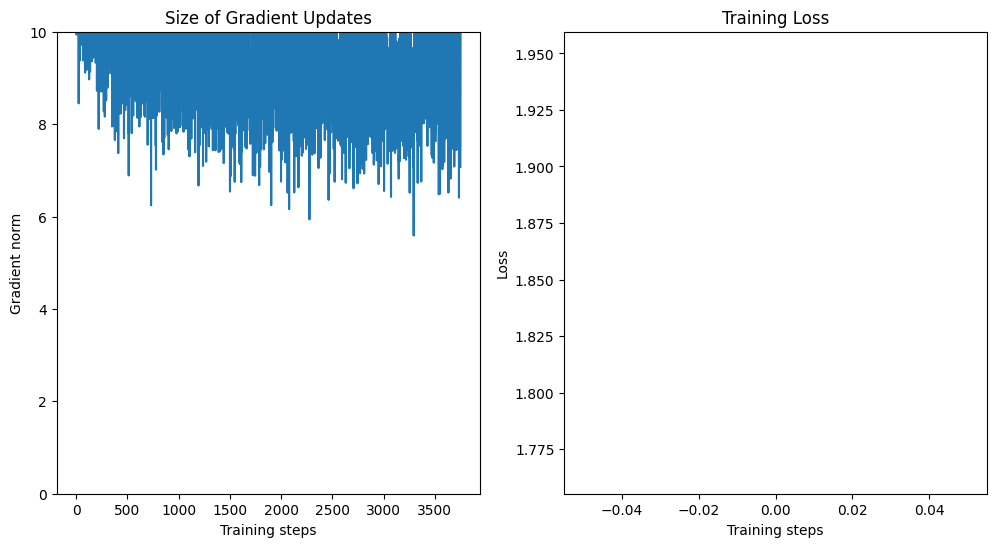

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<06:51,  9.11it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.546412


Epoch 1:  14%|█▍        | 516/3750 [00:05<00:36, 88.29it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.473891


Epoch 1:  27%|██▋       | 1015/3750 [00:10<00:26, 103.46it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.466746


Epoch 1:  41%|████      | 1519/3750 [00:15<00:22, 99.65it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.194532


Epoch 1:  54%|█████▎    | 2009/3750 [00:20<00:20, 84.41it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.036049


Epoch 1:  67%|██████▋   | 2523/3750 [00:26<00:11, 105.51it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.178094


Epoch 1:  80%|████████  | 3014/3750 [00:31<00:06, 106.59it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.567942


Epoch 1:  94%|█████████▎| 3513/3750 [00:35<00:02, 89.86it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.304883


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 96.88it/s]


Train set: Avg. loss: 1.8617, Time: 38.7 secs 




Test set: Avg. loss: 0.0023, Accuracy: 65%, Time: 2.6 secs

Train loss: 1.8616508987267812, Test loss: 0.0022749872267246248, Test accuracy: 64.93, Train time: 38.71527671813965, Test time: 2.586465835571289


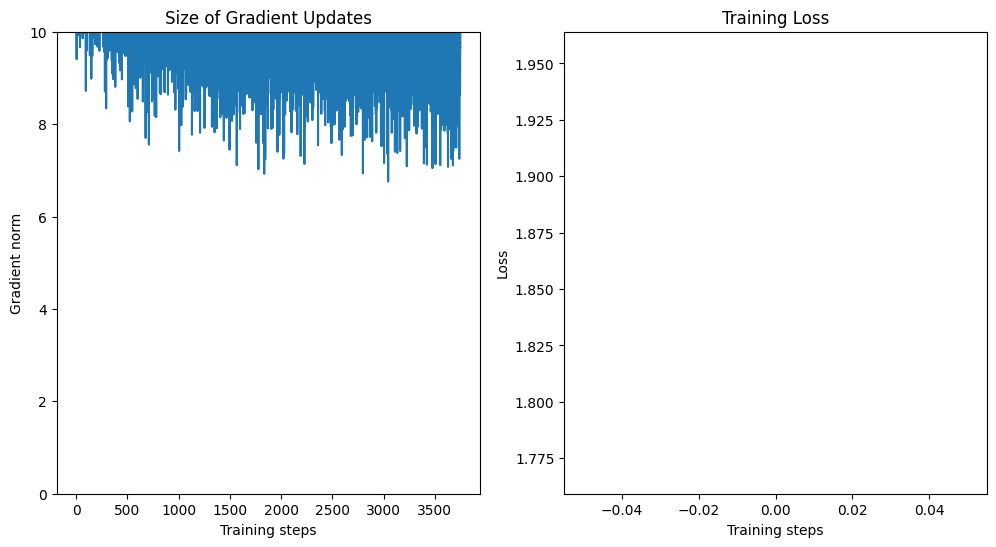

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<10:25,  6.00it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.495291


Epoch 1:  14%|█▍        | 521/3750 [00:04<00:27, 117.21it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.030925


Epoch 1:  27%|██▋       | 1013/3750 [00:09<00:34, 79.02it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.100833


Epoch 1:  41%|████      | 1519/3750 [00:14<00:19, 116.42it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.754784


Epoch 1:  54%|█████▎    | 2013/3750 [00:19<00:15, 113.24it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.018741


Epoch 1:  67%|██████▋   | 2516/3750 [00:23<00:10, 113.57it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.803468


Epoch 1:  80%|████████  | 3017/3750 [00:29<00:08, 87.27it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.563979


Epoch 1:  94%|█████████▍| 3519/3750 [00:33<00:01, 116.32it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.621358


Epoch 1: 100%|██████████| 3750/3750 [00:35<00:00, 104.40it/s]


Train set: Avg. loss: 1.9149, Time: 35.9 secs 




Test set: Avg. loss: 0.0023, Accuracy: 67%, Time: 1.9 secs

Train loss: 1.914864319594701, Test loss: 0.0022572863698005676, Test accuracy: 66.93, Train time: 35.927836179733276, Test time: 1.8830759525299072


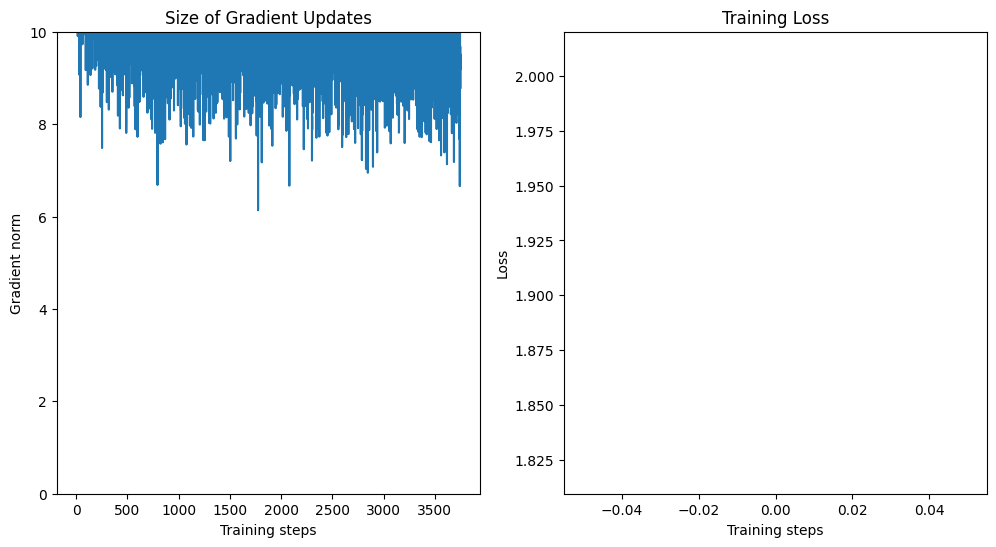

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 14/3750 [00:00<01:25, 43.44it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.565651


Epoch 1:  14%|█▎        | 510/3750 [00:06<00:44, 73.34it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.419044


Epoch 1:  27%|██▋       | 1014/3750 [00:10<00:22, 121.69it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.977902


Epoch 1:  41%|████      | 1520/3750 [00:15<00:19, 114.93it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.209162


Epoch 1:  54%|█████▎    | 2013/3750 [00:21<00:23, 73.49it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.679820


Epoch 1:  67%|██████▋   | 2523/3750 [00:26<00:10, 114.00it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.744591


Epoch 1:  80%|████████  | 3016/3750 [00:30<00:06, 115.84it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.744663


Epoch 1:  94%|█████████▎| 3513/3750 [00:36<00:03, 74.72it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.427461


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 96.52it/s] 


Train set: Avg. loss: 2.0100, Time: 38.9 secs 




Test set: Avg. loss: 0.0027, Accuracy: 58%, Time: 2.1 secs

Train loss: 2.0099859293778737, Test loss: 0.002733997106552124, Test accuracy: 57.5, Train time: 38.86090803146362, Test time: 2.0678043365478516


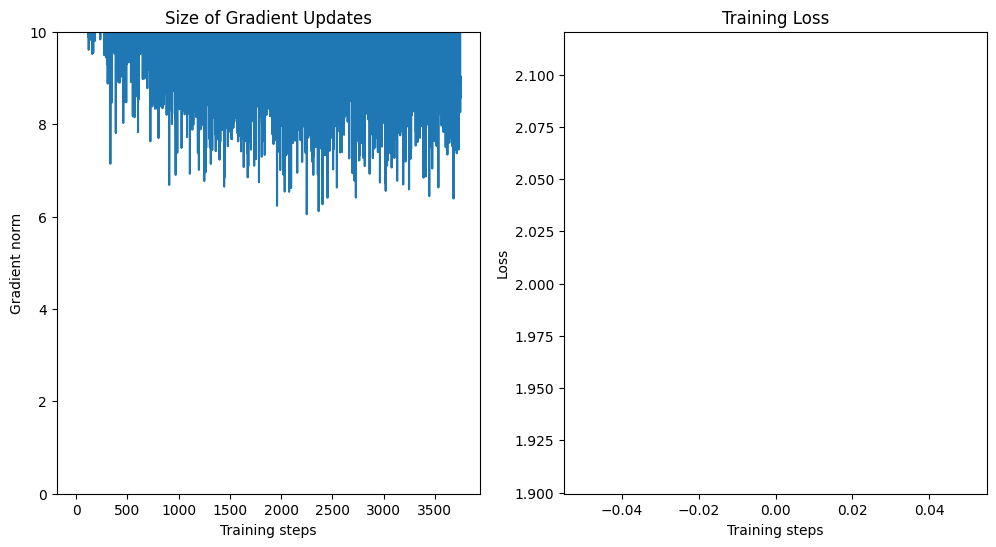

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<08:39,  7.22it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.557910


Epoch 1:   3%|▎         | 122/3750 [00:01<00:34, 103.72it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.687552


Epoch 1:   6%|▌         | 211/3750 [00:02<00:34, 101.41it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.575103


Epoch 1:   8%|▊         | 310/3750 [00:03<00:34, 100.13it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.434325


Epoch 1:  11%|█         | 418/3750 [00:04<00:32, 101.23it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.440458


Epoch 1:  14%|█▍        | 518/3750 [00:05<00:31, 101.12it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.235329


Epoch 1:  16%|█▌        | 608/3750 [00:06<00:29, 106.37it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.598811


Epoch 1:  19%|█▉        | 710/3750 [00:07<00:34, 88.82it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.160637


Epoch 1:  22%|██▏       | 812/3750 [00:08<00:33, 88.54it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.500831


Epoch 1:  24%|██▍       | 913/3750 [00:09<00:34, 83.09it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.185100


Epoch 1:  27%|██▋       | 1018/3750 [00:10<00:33, 81.81it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.433278


Epoch 1:  30%|██▉       | 1109/3750 [00:11<00:31, 83.34it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.453593


Epoch 1:  33%|███▎      | 1224/3750 [00:13<00:23, 106.71it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.129289


Epoch 1:  35%|███▍      | 1312/3750 [00:13<00:23, 102.02it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.214879


Epoch 1:  38%|███▊      | 1411/3750 [00:14<00:23, 98.57it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.241770


Epoch 1:  41%|████      | 1522/3750 [00:15<00:21, 104.30it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.052524


Epoch 1:  43%|████▎     | 1622/3750 [00:16<00:20, 102.87it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.225936


Epoch 1:  46%|████▌     | 1712/3750 [00:17<00:20, 99.67it/s] 

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.429870


Epoch 1:  49%|████▊     | 1821/3750 [00:18<00:18, 102.44it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.213359


Epoch 1:  51%|█████▏    | 1922/3750 [00:19<00:17, 106.79it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.185503


Epoch 1:  54%|█████▎    | 2011/3750 [00:20<00:17, 100.05it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.135962


Epoch 1:  57%|█████▋    | 2122/3750 [00:21<00:15, 103.66it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.185249


Epoch 1:  59%|█████▉    | 2213/3750 [00:22<00:19, 79.06it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.057083


Epoch 1:  62%|██████▏   | 2311/3750 [00:24<00:17, 83.54it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.112571


Epoch 1:  64%|██████▍   | 2410/3750 [00:25<00:16, 82.33it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.099000


Epoch 1:  67%|██████▋   | 2509/3750 [00:26<00:15, 79.03it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.065561


Epoch 1:  70%|██████▉   | 2615/3750 [00:27<00:14, 77.65it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.150811


Epoch 1:  72%|███████▏  | 2713/3750 [00:28<00:09, 105.04it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.164426


Epoch 1:  75%|███████▌  | 2814/3750 [00:29<00:09, 102.95it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.079239


Epoch 1:  78%|███████▊  | 2914/3750 [00:30<00:08, 103.12it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.201761


Epoch 1:  80%|████████  | 3014/3750 [00:31<00:07, 101.41it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.183971


Epoch 1:  83%|████████▎ | 3113/3750 [00:32<00:06, 102.20it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.541320


Epoch 1:  86%|████████▌ | 3213/3750 [00:33<00:05, 103.17it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.079620


Epoch 1:  88%|████████▊ | 3313/3750 [00:34<00:04, 100.82it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.078867


Epoch 1:  91%|█████████ | 3412/3750 [00:35<00:03, 99.82it/s] 

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.527735


Epoch 1:  94%|█████████▎| 3512/3750 [00:36<00:02, 100.43it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.379734


Epoch 1:  96%|█████████▋| 3612/3750 [00:37<00:01, 102.24it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.274976


Epoch 1:  99%|█████████▉| 3709/3750 [00:38<00:00, 83.91it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.046523


Epoch 1: 100%|██████████| 3750/3750 [00:39<00:00, 95.46it/s]


Train set: Avg. loss: 0.3435, Time: 39.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.9 secs

Train loss: 0.34354732110699016, Test loss: 0.00011565036401152611, Test accuracy: 96.65, Train time: 39.29342555999756, Test time: 2.880915880203247


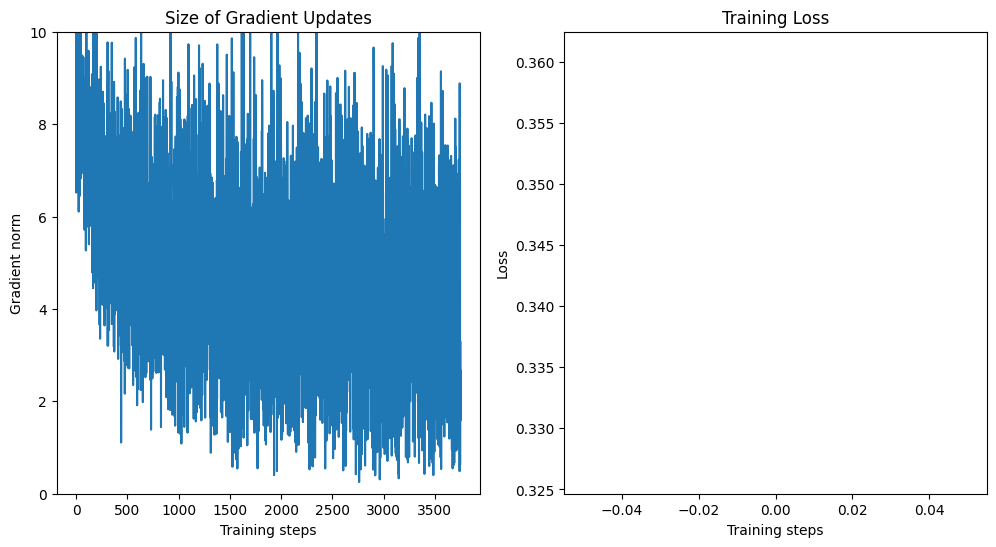

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<10:26,  5.98it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.904395


Epoch 1:   3%|▎         | 118/3750 [00:01<00:34, 106.13it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 0.854215


Epoch 1:   6%|▌         | 214/3750 [00:02<00:31, 110.72it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.795952


Epoch 1:   9%|▊         | 325/3750 [00:03<00:29, 114.88it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.271239


Epoch 1:  11%|█▏        | 422/3750 [00:03<00:29, 111.27it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.235734


Epoch 1:  14%|█▍        | 519/3750 [00:04<00:28, 113.08it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.150178


Epoch 1:  16%|█▋        | 616/3750 [00:05<00:27, 113.86it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.346770


Epoch 1:  19%|█▉        | 724/3750 [00:06<00:27, 112.06it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.573314


Epoch 1:  22%|██▏       | 820/3750 [00:07<00:26, 109.80it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.395589


Epoch 1:  24%|██▍       | 918/3750 [00:08<00:23, 118.53it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.176315


Epoch 1:  27%|██▋       | 1012/3750 [00:09<00:28, 96.20it/s] 

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.397976


Epoch 1:  30%|██▉       | 1118/3750 [00:10<00:30, 87.35it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.149170


Epoch 1:  32%|███▏      | 1214/3750 [00:11<00:32, 78.12it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.619735


Epoch 1:  35%|███▌      | 1316/3750 [00:12<00:29, 82.90it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.532648


Epoch 1:  38%|███▊      | 1410/3750 [00:14<00:28, 81.65it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.410664


Epoch 1:  40%|████      | 1510/3750 [00:15<00:27, 81.76it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.442462


Epoch 1:  43%|████▎     | 1621/3750 [00:16<00:18, 112.70it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.189049


Epoch 1:  46%|████▌     | 1719/3750 [00:17<00:17, 118.65it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.187773


Epoch 1:  48%|████▊     | 1815/3750 [00:18<00:17, 110.84it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.190924


Epoch 1:  51%|█████     | 1912/3750 [00:18<00:16, 113.73it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.226045


Epoch 1:  54%|█████▍    | 2023/3750 [00:19<00:15, 114.96it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.668995


Epoch 1:  57%|█████▋    | 2120/3750 [00:20<00:14, 114.90it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.096206


Epoch 1:  59%|█████▉    | 2219/3750 [00:21<00:13, 111.30it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.075593


Epoch 1:  62%|██████▏   | 2318/3750 [00:22<00:12, 117.01it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.044327


Epoch 1:  64%|██████▍   | 2415/3750 [00:23<00:11, 111.44it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.070744


Epoch 1:  67%|██████▋   | 2519/3750 [00:24<00:11, 108.55it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.246006


Epoch 1:  70%|██████▉   | 2615/3750 [00:25<00:10, 109.68it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.206553


Epoch 1:  72%|███████▏  | 2711/3750 [00:26<00:12, 84.78it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.141423


Epoch 1:  75%|███████▍  | 2812/3750 [00:27<00:12, 77.67it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.072324


Epoch 1:  78%|███████▊  | 2909/3750 [00:28<00:10, 83.00it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.144094


Epoch 1:  80%|████████  | 3017/3750 [00:30<00:08, 82.59it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.065529


Epoch 1:  83%|████████▎ | 3112/3750 [00:31<00:07, 82.38it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.439840


Epoch 1:  86%|████████▌ | 3218/3750 [00:32<00:04, 112.19it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.080565


Epoch 1:  88%|████████▊ | 3313/3750 [00:33<00:03, 111.24it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.252690


Epoch 1:  91%|█████████ | 3413/3750 [00:33<00:02, 115.86it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.240232


Epoch 1:  94%|█████████▍| 3523/3750 [00:34<00:01, 116.35it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.181415


Epoch 1:  97%|█████████▋| 3620/3750 [00:35<00:01, 112.83it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.938222


Epoch 1:  99%|█████████▉| 3718/3750 [00:36<00:00, 113.79it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.175542


Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 101.12it/s]


Train set: Avg. loss: 0.3474, Time: 37.1 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 1.9 secs

Train loss: 0.3473685530126095, Test loss: 0.00011788108721375466, Test accuracy: 96.35, Train time: 37.090497732162476, Test time: 1.9121248722076416


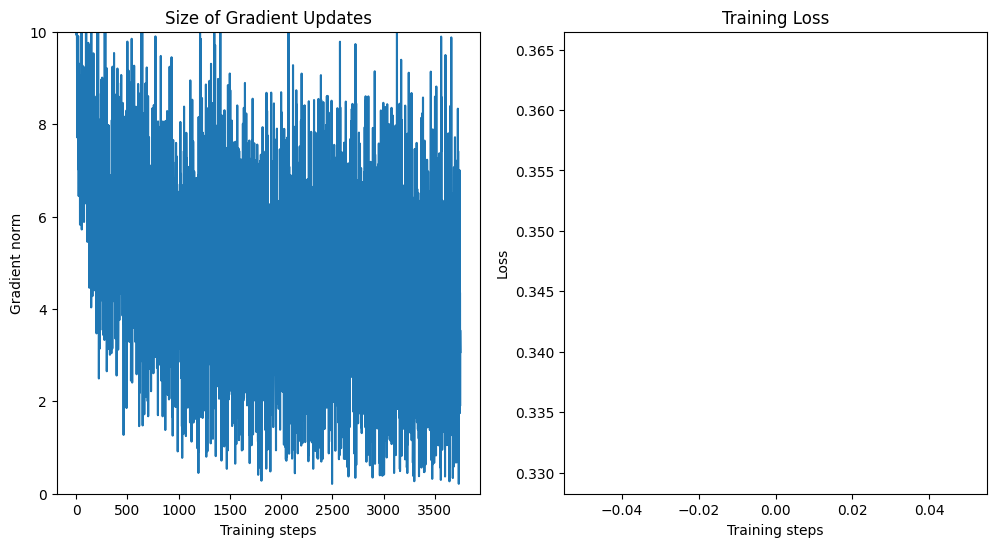

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=4


Epoch 1:   0%|          | 13/3750 [00:00<01:32, 40.44it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.580973


Epoch 1:   3%|▎         | 115/3750 [00:01<00:34, 106.61it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 0.813008


Epoch 1:   6%|▌         | 212/3750 [00:02<00:44, 79.73it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.723314


Epoch 1:   8%|▊         | 310/3750 [00:03<00:47, 72.18it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.504648


Epoch 1:  11%|█         | 417/3750 [00:05<00:43, 77.44it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.221226


Epoch 1:  14%|█▎        | 514/3750 [00:06<00:44, 73.37it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.116592


Epoch 1:  17%|█▋        | 621/3750 [00:07<00:31, 98.10it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.766559


Epoch 1:  19%|█▉        | 719/3750 [00:08<00:26, 113.49it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.285718


Epoch 1:  22%|██▏       | 817/3750 [00:09<00:25, 114.94it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.187042


Epoch 1:  24%|██▍       | 913/3750 [00:10<00:24, 114.10it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.297035


Epoch 1:  27%|██▋       | 1024/3750 [00:11<00:24, 112.64it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.244892


Epoch 1:  30%|██▉       | 1123/3750 [00:12<00:22, 117.00it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.081482


Epoch 1:  33%|███▎      | 1220/3750 [00:13<00:22, 111.94it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.278285


Epoch 1:  35%|███▌      | 1316/3750 [00:14<00:21, 113.09it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.053222


Epoch 1:  38%|███▊      | 1422/3750 [00:15<00:22, 105.55it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.473285


Epoch 1:  41%|████      | 1519/3750 [00:15<00:20, 111.36it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.155198


Epoch 1:  43%|████▎     | 1616/3750 [00:16<00:18, 114.34it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.505934


Epoch 1:  46%|████▌     | 1709/3750 [00:17<00:21, 96.17it/s] 

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.313685


Epoch 1:  48%|████▊     | 1812/3750 [00:19<00:23, 81.10it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.326444


Epoch 1:  51%|█████     | 1910/3750 [00:20<00:24, 74.17it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.454312


Epoch 1:  54%|█████▎    | 2015/3750 [00:21<00:23, 74.35it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.514461


Epoch 1:  56%|█████▋    | 2116/3750 [00:23<00:20, 78.38it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.133097


Epoch 1:  59%|█████▉    | 2220/3750 [00:24<00:13, 110.06it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.277506


Epoch 1:  62%|██████▏   | 2314/3750 [00:25<00:12, 110.84it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.342785


Epoch 1:  65%|██████▍   | 2425/3750 [00:26<00:11, 117.39it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.100260


Epoch 1:  67%|██████▋   | 2521/3750 [00:26<00:11, 111.23it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.088045


Epoch 1:  70%|██████▉   | 2618/3750 [00:27<00:10, 107.91it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.116601


Epoch 1:  73%|███████▎  | 2722/3750 [00:28<00:09, 110.44it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.204918


Epoch 1:  75%|███████▌  | 2819/3750 [00:29<00:08, 110.85it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.112507


Epoch 1:  78%|███████▊  | 2916/3750 [00:30<00:07, 110.39it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.348581


Epoch 1:  80%|████████  | 3015/3750 [00:31<00:06, 113.26it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.116075


Epoch 1:  83%|████████▎ | 3113/3750 [00:32<00:05, 115.50it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.105046


Epoch 1:  86%|████████▌ | 3222/3750 [00:33<00:04, 110.11it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.352776


Epoch 1:  88%|████████▊ | 3312/3750 [00:34<00:05, 75.51it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.057949


Epoch 1:  91%|█████████ | 3413/3750 [00:35<00:04, 76.65it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.048895


Epoch 1:  94%|█████████▎| 3511/3750 [00:37<00:03, 77.96it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.023470


Epoch 1:  96%|█████████▋| 3612/3750 [00:38<00:01, 76.91it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.181061


Epoch 1:  99%|█████████▉| 3716/3750 [00:39<00:00, 101.05it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.279501


Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 93.66it/s] 


Train set: Avg. loss: 0.3593, Time: 40.0 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.35931742232826847, Test loss: 0.00011833921149373055, Test accuracy: 96.21, Train time: 40.04896593093872, Test time: 2.0577824115753174


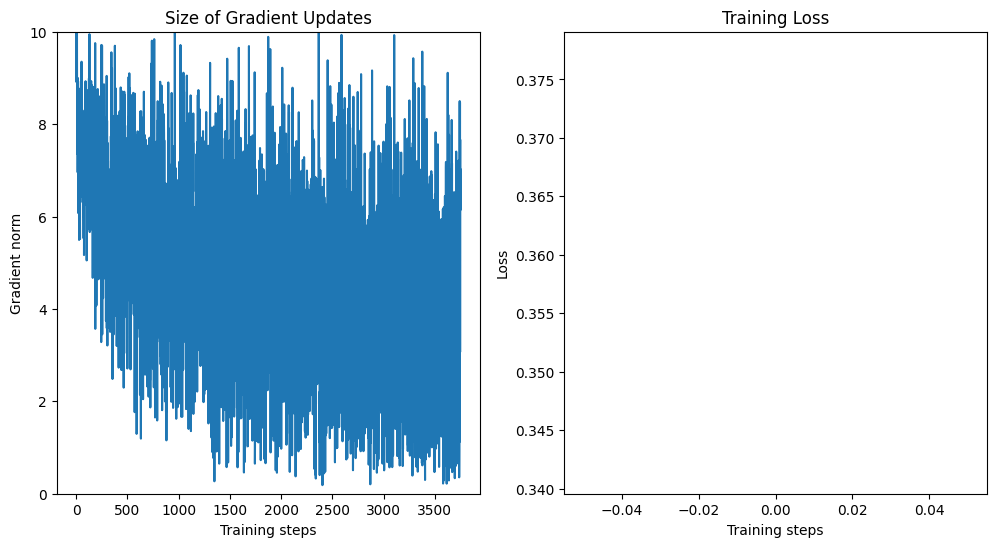

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<07:32,  8.29it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.687541


Epoch 1:   6%|▌         | 220/3750 [00:02<00:35, 100.38it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.684709


Epoch 1:  11%|█         | 418/3750 [00:04<00:32, 103.80it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.424305


Epoch 1:  16%|█▋        | 615/3750 [00:06<00:32, 96.90it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.185781


Epoch 1:  22%|██▏       | 812/3750 [00:08<00:35, 83.51it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.329428


Epoch 1:  27%|██▋       | 1019/3750 [00:11<00:31, 85.80it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.215882


Epoch 1:  32%|███▏      | 1214/3750 [00:13<00:25, 99.42it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.227360


Epoch 1:  38%|███▊      | 1412/3750 [00:15<00:23, 100.24it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.189718


Epoch 1:  43%|████▎     | 1613/3750 [00:17<00:21, 100.91it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.388324


Epoch 1:  48%|████▊     | 1811/3750 [00:19<00:18, 103.71it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.618149


Epoch 1:  54%|█████▍    | 2021/3750 [00:21<00:17, 101.70it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.561678


Epoch 1:  59%|█████▉    | 2212/3750 [00:23<00:18, 83.49it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.104700


Epoch 1:  64%|██████▍   | 2411/3750 [00:25<00:15, 84.85it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.149703


Epoch 1:  70%|██████▉   | 2618/3750 [00:28<00:13, 85.66it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.371836


Epoch 1:  75%|███████▌  | 2813/3750 [00:30<00:09, 104.03it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.056654


Epoch 1:  80%|████████  | 3012/3750 [00:31<00:07, 103.73it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.342783


Epoch 1:  86%|████████▌ | 3220/3750 [00:34<00:05, 101.19it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.387118


Epoch 1:  91%|█████████ | 3419/3750 [00:35<00:03, 102.01it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.190137


Epoch 1:  96%|█████████▋| 3618/3750 [00:37<00:01, 103.36it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.178253


Epoch 1: 100%|██████████| 3750/3750 [00:39<00:00, 94.74it/s]


Train set: Avg. loss: 0.3516, Time: 39.6 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.9 secs

Train loss: 0.351556941098844, Test loss: 0.00011350119113922119, Test accuracy: 96.24, Train time: 39.59481739997864, Test time: 2.944133758544922


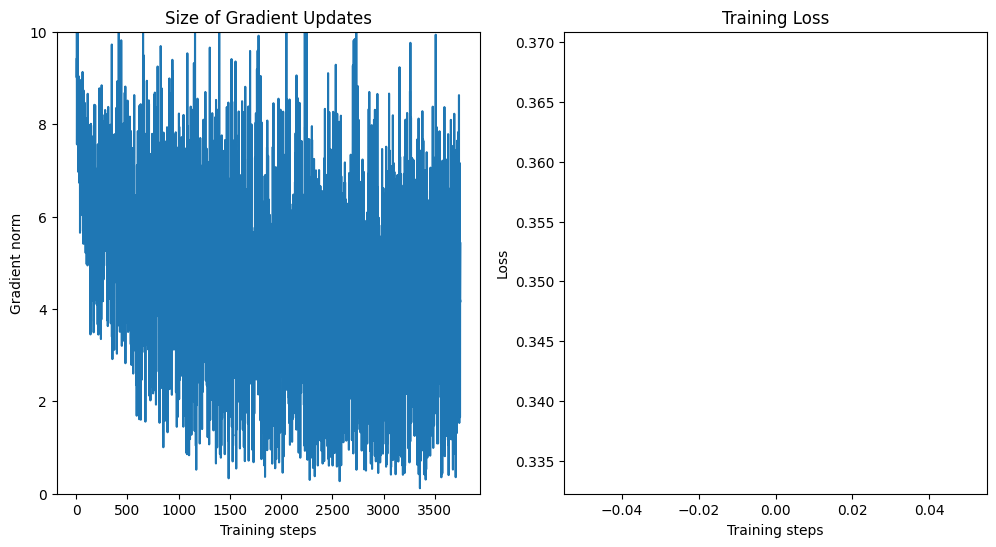

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<11:32,  5.41it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.539336


Epoch 1:   6%|▌         | 219/3750 [00:02<00:31, 110.69it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.566463


Epoch 1:  11%|█         | 413/3750 [00:03<00:30, 109.23it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.253534


Epoch 1:  17%|█▋        | 624/3750 [00:05<00:27, 113.95it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.430486


Epoch 1:  22%|██▏       | 818/3750 [00:07<00:27, 107.95it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.221904


Epoch 1:  27%|██▋       | 1012/3750 [00:09<00:31, 87.17it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.169314


Epoch 1:  32%|███▏      | 1216/3750 [00:12<00:30, 82.42it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.215801


Epoch 1:  38%|███▊      | 1417/3750 [00:14<00:27, 84.64it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.747181


Epoch 1:  43%|████▎     | 1620/3750 [00:16<00:18, 114.15it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.212423


Epoch 1:  48%|████▊     | 1812/3750 [00:18<00:17, 111.12it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.133693


Epoch 1:  54%|█████▍    | 2021/3750 [00:20<00:16, 107.74it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.195561


Epoch 1:  59%|█████▉    | 2212/3750 [00:21<00:13, 112.41it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.109814


Epoch 1:  64%|██████▍   | 2418/3750 [00:23<00:11, 118.53it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.105303


Epoch 1:  70%|██████▉   | 2615/3750 [00:25<00:13, 85.96it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.416926


Epoch 1:  75%|███████▌  | 2816/3750 [00:28<00:10, 85.44it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.360532


Epoch 1:  80%|████████  | 3009/3750 [00:30<00:08, 83.10it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.191408


Epoch 1:  86%|████████▌ | 3216/3750 [00:32<00:04, 113.15it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.182683


Epoch 1:  91%|█████████▏| 3425/3750 [00:34<00:02, 114.86it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.098123


Epoch 1:  97%|█████████▋| 3620/3750 [00:36<00:01, 115.30it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.453278


Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 100.37it/s]


Train set: Avg. loss: 0.3441, Time: 37.4 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 1.9 secs

Train loss: 0.3440967279250423, Test loss: 0.00011052732095122337, Test accuracy: 96.64, Train time: 37.37169170379639, Test time: 1.9334368705749512


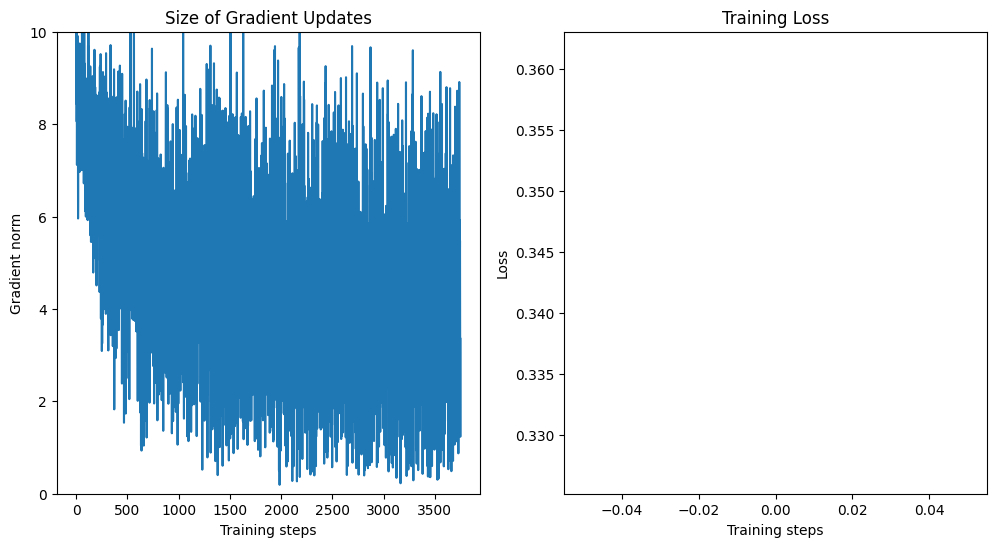

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=4


Epoch 1:   0%|          | 8/3750 [00:00<02:27, 25.32it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.608488


Epoch 1:   6%|▌         | 209/3750 [00:02<00:53, 66.77it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.080747


Epoch 1:  11%|█         | 414/3750 [00:05<00:45, 72.53it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.558243


Epoch 1:  16%|█▋        | 614/3750 [00:07<00:28, 108.75it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.189506


Epoch 1:  22%|██▏       | 814/3750 [00:09<00:26, 108.79it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.489966


Epoch 1:  27%|██▋       | 1023/3750 [00:11<00:24, 113.38it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.252705


Epoch 1:  32%|███▏      | 1217/3750 [00:13<00:22, 111.91it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.361052


Epoch 1:  38%|███▊      | 1424/3750 [00:15<00:20, 113.53it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.375382


Epoch 1:  43%|████▎     | 1614/3750 [00:17<00:19, 111.13it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.103480


Epoch 1:  48%|████▊     | 1809/3750 [00:19<00:25, 76.50it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.472761


Epoch 1:  54%|█████▎    | 2007/3750 [00:22<00:23, 73.77it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.060951


Epoch 1:  59%|█████▉    | 2215/3750 [00:24<00:14, 106.86it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.051367


Epoch 1:  64%|██████▍   | 2413/3750 [00:26<00:12, 111.25it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.299382


Epoch 1:  70%|██████▉   | 2617/3750 [00:28<00:10, 109.97it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.139493


Epoch 1:  75%|███████▌  | 2817/3750 [00:29<00:08, 111.29it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.049138


Epoch 1:  81%|████████  | 3020/3750 [00:31<00:06, 112.04it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.025169


Epoch 1:  86%|████████▌ | 3212/3750 [00:33<00:06, 86.77it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.096830


Epoch 1:  91%|█████████ | 3415/3750 [00:36<00:04, 74.21it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.329851


Epoch 1:  96%|█████████▋| 3614/3750 [00:39<00:01, 88.39it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.225392


Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 92.64it/s] 


Train set: Avg. loss: 0.3771, Time: 40.5 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.0 secs

Train loss: 0.3771021220306555, Test loss: 0.00011798320189118385, Test accuracy: 96.36, Train time: 40.487550258636475, Test time: 2.047170877456665


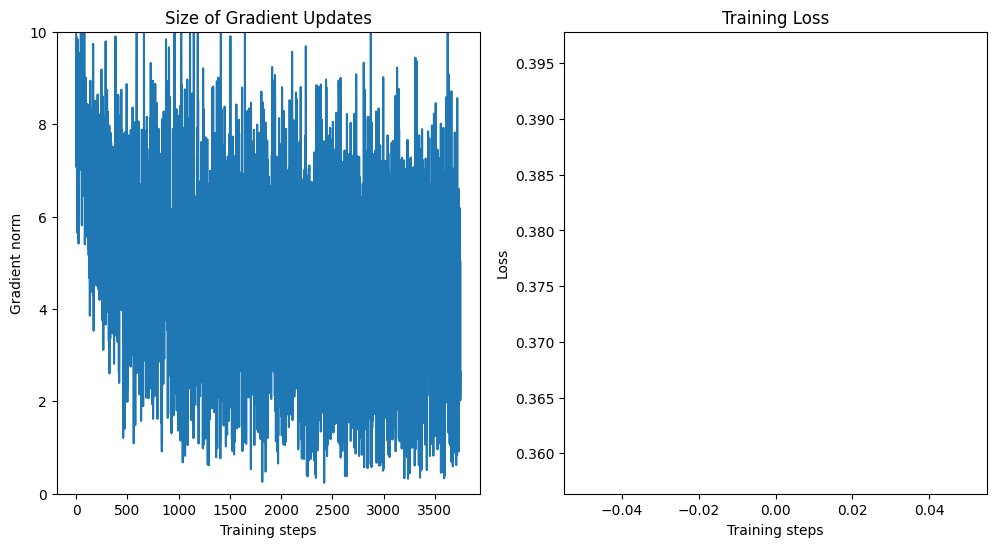

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<07:30,  8.32it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.639452


Epoch 1:  14%|█▍        | 518/3750 [00:05<00:31, 102.40it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.261740


Epoch 1:  27%|██▋       | 1015/3750 [00:11<00:33, 82.50it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.352057


Epoch 1:  40%|████      | 1512/3750 [00:16<00:22, 98.99it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.060216


Epoch 1:  54%|█████▎    | 2015/3750 [00:21<00:17, 100.62it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.244848


Epoch 1:  67%|██████▋   | 2518/3750 [00:26<00:14, 85.98it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.098024


Epoch 1:  80%|████████  | 3013/3750 [00:32<00:07, 103.22it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.300112


Epoch 1:  94%|█████████▎| 3510/3750 [00:36<00:02, 100.52it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.212363


Epoch 1: 100%|██████████| 3750/3750 [00:39<00:00, 94.79it/s]


Train set: Avg. loss: 0.3562, Time: 39.6 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.0 secs

Train loss: 0.35623939424877366, Test loss: 0.00010066891945898533, Test accuracy: 97.01, Train time: 39.57828879356384, Test time: 3.0372068881988525


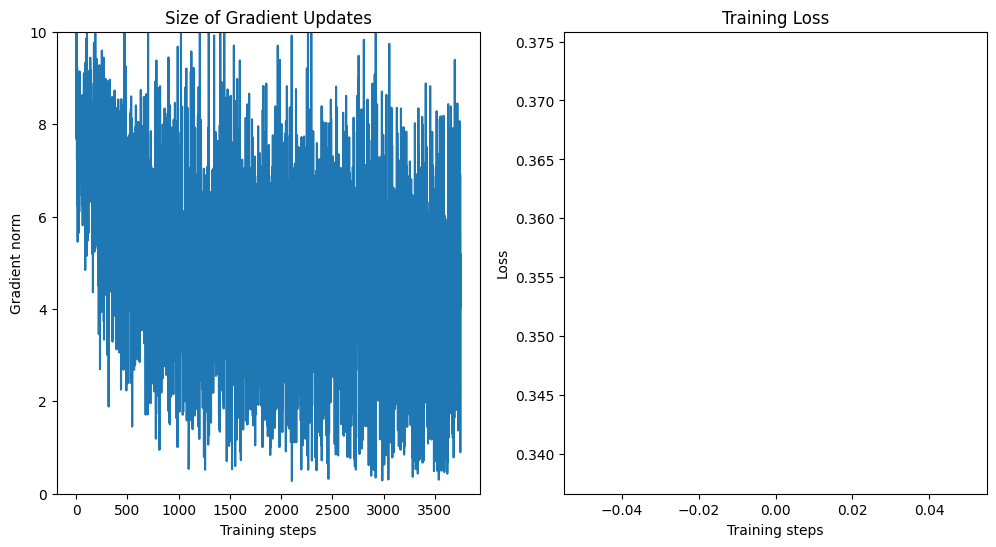

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<11:40,  5.35it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.650115


Epoch 1:  14%|█▍        | 519/3750 [00:04<00:28, 114.33it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.605192


Epoch 1:  27%|██▋       | 1018/3750 [00:09<00:23, 114.85it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.476239


Epoch 1:  40%|████      | 1514/3750 [00:15<00:27, 80.74it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.383321


Epoch 1:  54%|█████▍    | 2021/3750 [00:20<00:16, 106.00it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.675276


Epoch 1:  67%|██████▋   | 2514/3750 [00:24<00:11, 112.15it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.081841


Epoch 1:  80%|████████  | 3017/3750 [00:30<00:08, 83.88it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.387045


Epoch 1:  94%|█████████▎| 3513/3750 [00:35<00:02, 110.68it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.624157


Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 99.78it/s] 


Train set: Avg. loss: 0.3631, Time: 37.6 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 1.9 secs

Train loss: 0.36310083049262565, Test loss: 0.00011400108709931373, Test accuracy: 96.54, Train time: 37.59265661239624, Test time: 1.8638725280761719


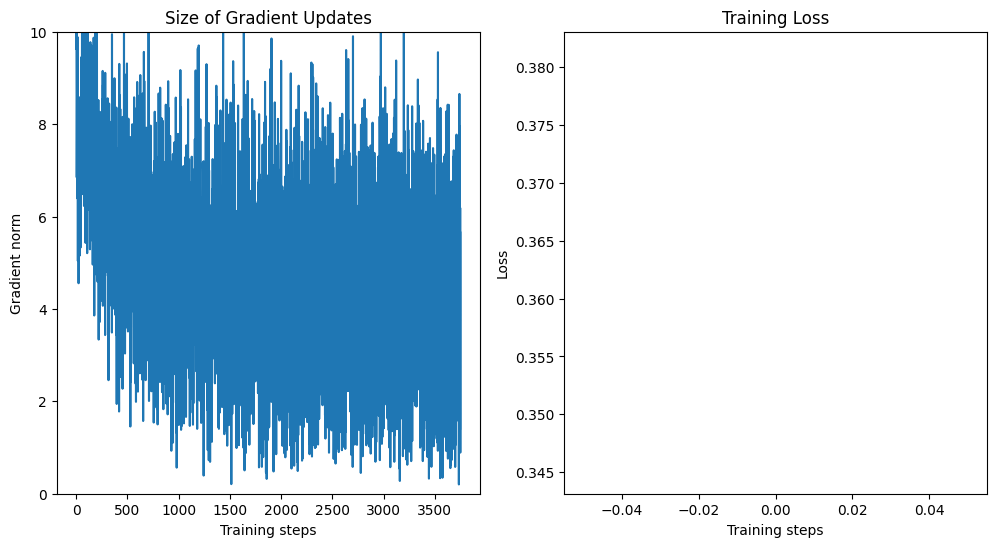

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=4


Epoch 1:   0%|          | 13/3750 [00:00<01:34, 39.53it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.661048


Epoch 1:  14%|█▎        | 513/3750 [00:06<00:47, 67.59it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.358353


Epoch 1:  27%|██▋       | 1018/3750 [00:11<00:25, 106.75it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.145560


Epoch 1:  40%|████      | 1516/3750 [00:16<00:20, 106.67it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.284630


Epoch 1:  54%|█████▎    | 2010/3750 [00:22<00:23, 72.64it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.229255


Epoch 1:  67%|██████▋   | 2516/3750 [00:27<00:10, 112.58it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.337326


Epoch 1:  80%|████████  | 3017/3750 [00:32<00:06, 107.34it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.018522


Epoch 1:  94%|█████████▎| 3512/3750 [00:37<00:03, 70.70it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.073883


Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 91.69it/s] 


Train set: Avg. loss: 0.3708, Time: 40.9 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.3708047294069082, Test loss: 0.00012322799563407898, Test accuracy: 96.14, Train time: 40.902639389038086, Test time: 2.102748394012451


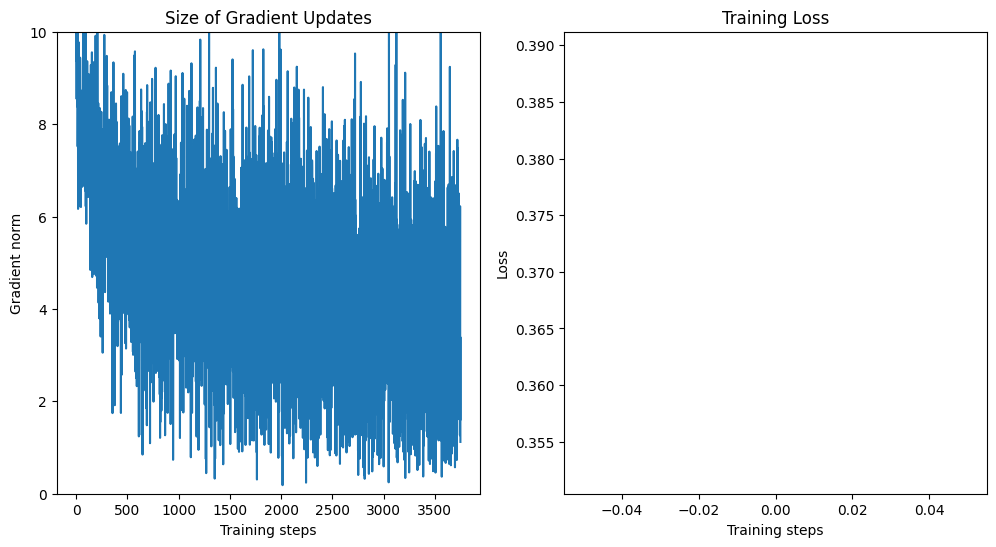

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<08:27,  7.38it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.394316


Epoch 1:   3%|▎         | 118/3750 [00:01<00:36, 100.27it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.088770


Epoch 1:   6%|▌         | 216/3750 [00:02<00:35, 99.98it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.884792


Epoch 1:   8%|▊         | 315/3750 [00:03<00:33, 102.72it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.730971


Epoch 1:  11%|█         | 415/3750 [00:04<00:32, 103.14it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.455644


Epoch 1:  14%|█▎        | 514/3750 [00:05<00:31, 101.82it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.342418


Epoch 1:  16%|█▋        | 611/3750 [00:06<00:31, 99.82it/s] 

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.349854


Epoch 1:  19%|█▉        | 715/3750 [00:07<00:35, 84.64it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.785042


Epoch 1:  22%|██▏       | 817/3750 [00:08<00:33, 88.65it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.660094


Epoch 1:  25%|██▍       | 919/3750 [00:09<00:31, 89.41it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.866301


Epoch 1:  27%|██▋       | 1010/3750 [00:10<00:33, 81.49it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.734885


Epoch 1:  30%|██▉       | 1110/3750 [00:12<00:33, 79.76it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.731882


Epoch 1:  32%|███▏      | 1211/3750 [00:13<00:26, 94.85it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.751119


Epoch 1:  35%|███▌      | 1319/3750 [00:14<00:23, 104.38it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.936251


Epoch 1:  38%|███▊      | 1418/3750 [00:15<00:22, 102.76it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.727478


Epoch 1:  40%|████      | 1516/3750 [00:16<00:21, 104.57it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.033334


Epoch 1:  43%|████▎     | 1616/3750 [00:17<00:20, 102.16it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.218746


Epoch 1:  46%|████▌     | 1720/3750 [00:18<00:19, 101.98it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.195132


Epoch 1:  49%|████▊     | 1820/3750 [00:19<00:18, 102.58it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.487822


Epoch 1:  51%|█████     | 1919/3750 [00:20<00:17, 101.93it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.574766


Epoch 1:  54%|█████▍    | 2018/3750 [00:21<00:17, 101.12it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.673211


Epoch 1:  56%|█████▋    | 2116/3750 [00:22<00:16, 99.77it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.375382


Epoch 1:  59%|█████▉    | 2208/3750 [00:23<00:18, 84.02it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.568759


Epoch 1:  62%|██████▏   | 2317/3750 [00:24<00:16, 85.21it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.521621


Epoch 1:  64%|██████▍   | 2417/3750 [00:25<00:15, 84.38it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.301552


Epoch 1:  67%|██████▋   | 2516/3750 [00:27<00:15, 81.18it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.540867


Epoch 1:  70%|██████▉   | 2615/3750 [00:28<00:13, 82.65it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.507513


Epoch 1:  72%|███████▏  | 2715/3750 [00:29<00:10, 100.34it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.413972


Epoch 1:  75%|███████▌  | 2814/3750 [00:30<00:09, 100.96it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.424196


Epoch 1:  78%|███████▊  | 2914/3750 [00:31<00:08, 102.11it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.196447


Epoch 1:  80%|████████  | 3012/3750 [00:32<00:07, 100.50it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.389716


Epoch 1:  83%|████████▎ | 3119/3750 [00:33<00:06, 99.47it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.289402


Epoch 1:  86%|████████▌ | 3215/3750 [00:34<00:05, 99.04it/s] 

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.547320


Epoch 1:  88%|████████▊ | 3312/3750 [00:35<00:04, 101.92it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.670250


Epoch 1:  91%|█████████ | 3411/3750 [00:36<00:03, 103.91it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.496708


Epoch 1:  94%|█████████▍| 3521/3750 [00:37<00:02, 100.37it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.182063


Epoch 1:  96%|█████████▋| 3618/3750 [00:38<00:01, 99.61it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.332542


Epoch 1:  99%|█████████▉| 3715/3750 [00:39<00:00, 85.15it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.054770


Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 93.68it/s]


Train set: Avg. loss: 0.7430, Time: 40.0 secs 




Test set: Avg. loss: 0.0002, Accuracy: 95%, Time: 3.1 secs

Train loss: 0.743037388630708, Test loss: 0.00019456670805811883, Test accuracy: 94.52, Train time: 40.03794622421265, Test time: 3.0757243633270264


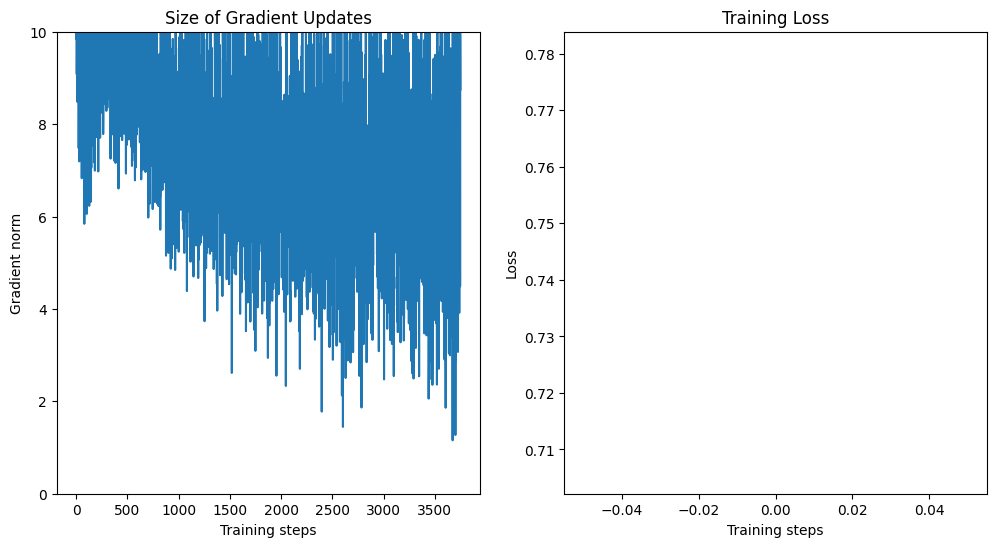

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<10:44,  5.82it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.664154


Epoch 1:   3%|▎         | 112/3750 [00:01<00:32, 110.30it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.206700


Epoch 1:   6%|▌         | 217/3750 [00:02<00:31, 110.79it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.572609


Epoch 1:   9%|▊         | 323/3750 [00:03<00:31, 107.85it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.091708


Epoch 1:  11%|█         | 415/3750 [00:04<00:30, 109.96it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.757510


Epoch 1:  14%|█▍        | 517/3750 [00:04<00:29, 107.99it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.337504


Epoch 1:  17%|█▋        | 619/3750 [00:05<00:28, 108.28it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.828209


Epoch 1:  19%|█▉        | 722/3750 [00:06<00:28, 107.03it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 1.250178


Epoch 1:  22%|██▏       | 813/3750 [00:07<00:27, 107.28it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.979398


Epoch 1:  24%|██▍       | 915/3750 [00:08<00:30, 93.97it/s] 

Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.024134


Epoch 1:  27%|██▋       | 1011/3750 [00:09<00:33, 82.76it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.956153


Epoch 1:  30%|██▉       | 1114/3750 [00:11<00:32, 80.86it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.690266


Epoch 1:  32%|███▏      | 1214/3750 [00:12<00:31, 80.49it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.797200


Epoch 1:  35%|███▌      | 1316/3750 [00:13<00:29, 82.47it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.839011


Epoch 1:  38%|███▊      | 1416/3750 [00:14<00:28, 82.62it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.632752


Epoch 1:  40%|████      | 1514/3750 [00:16<00:28, 78.14it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.780954


Epoch 1:  43%|████▎     | 1616/3750 [00:17<00:20, 103.43it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.663991


Epoch 1:  46%|████▌     | 1720/3750 [00:18<00:19, 106.23it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.421279


Epoch 1:  48%|████▊     | 1811/3750 [00:18<00:18, 102.57it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.475064


Epoch 1:  51%|█████     | 1915/3750 [00:19<00:16, 110.13it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.751914


Epoch 1:  54%|█████▍    | 2021/3750 [00:20<00:15, 109.97it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.780693


Epoch 1:  56%|█████▋    | 2113/3750 [00:21<00:15, 106.51it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.966483


Epoch 1:  59%|█████▉    | 2218/3750 [00:22<00:13, 114.40it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.719925


Epoch 1:  62%|██████▏   | 2314/3750 [00:23<00:13, 108.61it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.728723


Epoch 1:  65%|██████▍   | 2419/3750 [00:24<00:12, 107.23it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.261688


Epoch 1:  67%|██████▋   | 2514/3750 [00:25<00:11, 112.22it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.617189


Epoch 1:  70%|██████▉   | 2607/3750 [00:26<00:11, 102.37it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.302249


Epoch 1:  72%|███████▏  | 2716/3750 [00:27<00:12, 83.45it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.584806


Epoch 1:  75%|███████▍  | 2810/3750 [00:28<00:11, 80.90it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.520039


Epoch 1:  78%|███████▊  | 2918/3750 [00:30<00:10, 77.05it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.242580


Epoch 1:  80%|████████  | 3017/3750 [00:31<00:08, 83.50it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.357992


Epoch 1:  83%|████████▎ | 3111/3750 [00:32<00:08, 77.00it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.430750


Epoch 1:  86%|████████▌ | 3220/3750 [00:33<00:05, 100.84it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.364365


Epoch 1:  88%|████████▊ | 3317/3750 [00:34<00:03, 108.40it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.670816


Epoch 1:  91%|█████████ | 3412/3750 [00:35<00:03, 111.27it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.314773


Epoch 1:  94%|█████████▍| 3521/3750 [00:36<00:02, 109.67it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.644167


Epoch 1:  96%|█████████▋| 3617/3750 [00:37<00:01, 112.60it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.534933


Epoch 1:  99%|█████████▉| 3722/3750 [00:38<00:00, 108.14it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.478726


Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 96.59it/s] 


Train set: Avg. loss: 0.8096, Time: 38.8 secs 




Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 2.0 secs

Train loss: 0.8095641559958457, Test loss: 0.00020123684257268906, Test accuracy: 94.42, Train time: 38.839056968688965, Test time: 1.9649009704589844


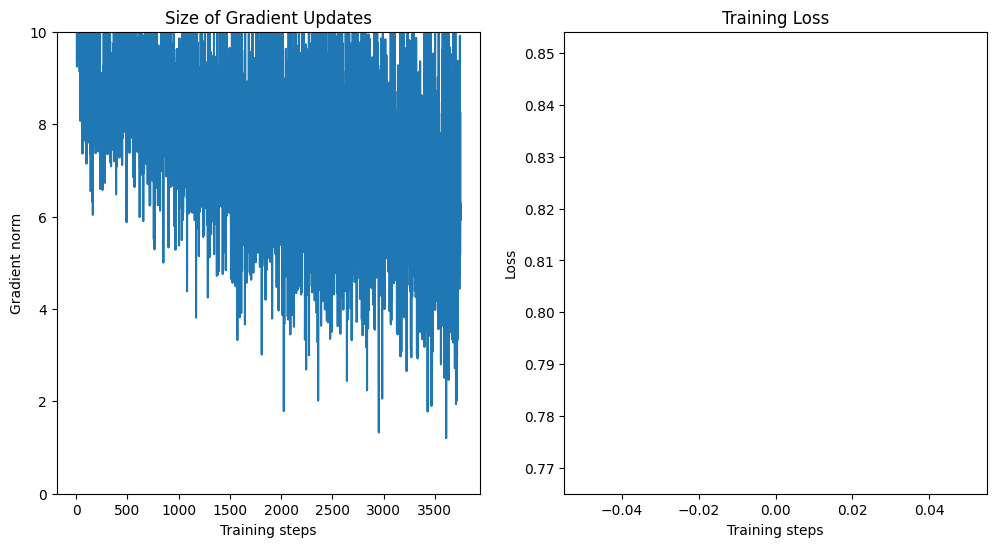

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 10/3750 [00:00<01:58, 31.56it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.856321


Epoch 1:   3%|▎         | 118/3750 [00:01<00:34, 103.98it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.735746


Epoch 1:   6%|▌         | 214/3750 [00:02<00:46, 76.42it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.438429


Epoch 1:   8%|▊         | 312/3750 [00:04<00:50, 68.01it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.428324


Epoch 1:  11%|█         | 414/3750 [00:05<00:45, 73.47it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.044404


Epoch 1:  14%|█▎        | 510/3750 [00:06<00:45, 71.79it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.931158


Epoch 1:  16%|█▌        | 609/3750 [00:08<00:48, 65.02it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.230373


Epoch 1:  19%|█▉        | 717/3750 [00:09<00:28, 106.74it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.856718


Epoch 1:  22%|██▏       | 812/3750 [00:10<00:27, 106.35it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.032690


Epoch 1:  24%|██▍       | 917/3750 [00:11<00:26, 107.51it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.797083


Epoch 1:  27%|██▋       | 1024/3750 [00:12<00:23, 113.83it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.621525


Epoch 1:  30%|██▉       | 1121/3750 [00:13<00:24, 109.47it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 1.138528


Epoch 1:  32%|███▏      | 1213/3750 [00:13<00:23, 108.17it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.614395


Epoch 1:  35%|███▌      | 1319/3750 [00:14<00:21, 110.70it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.508627


Epoch 1:  38%|███▊      | 1415/3750 [00:15<00:21, 108.54it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.210649


Epoch 1:  41%|████      | 1524/3750 [00:16<00:19, 113.32it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.517739


Epoch 1:  43%|████▎     | 1617/3750 [00:17<00:20, 102.15it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.041803


Epoch 1:  46%|████▌     | 1713/3750 [00:18<00:25, 80.26it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.564033


Epoch 1:  48%|████▊     | 1809/3750 [00:20<00:29, 65.81it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.392352


Epoch 1:  51%|█████     | 1910/3750 [00:21<00:21, 83.89it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.551783


Epoch 1:  54%|█████▎    | 2013/3750 [00:22<00:23, 73.80it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.373377


Epoch 1:  56%|█████▋    | 2112/3750 [00:24<00:21, 75.02it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.670684


Epoch 1:  59%|█████▉    | 2214/3750 [00:25<00:14, 104.13it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.482298


Epoch 1:  62%|██████▏   | 2318/3750 [00:26<00:13, 107.56it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.258450


Epoch 1:  64%|██████▍   | 2418/3750 [00:27<00:12, 106.75it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.630663


Epoch 1:  67%|██████▋   | 2510/3750 [00:28<00:13, 94.44it/s] 

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.092434


Epoch 1:  70%|██████▉   | 2613/3750 [00:29<00:10, 108.43it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.262307


Epoch 1:  72%|███████▏  | 2717/3750 [00:30<00:09, 108.95it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.775013


Epoch 1:  75%|███████▌  | 2820/3750 [00:31<00:08, 104.82it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.511639


Epoch 1:  78%|███████▊  | 2922/3750 [00:32<00:07, 105.82it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.279734


Epoch 1:  80%|████████  | 3015/3750 [00:32<00:06, 112.50it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.633895


Epoch 1:  83%|████████▎ | 3117/3750 [00:33<00:06, 102.24it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.320164


Epoch 1:  86%|████████▌ | 3215/3750 [00:34<00:05, 92.86it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.240046


Epoch 1:  88%|████████▊ | 3313/3750 [00:36<00:06, 68.24it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.332075


Epoch 1:  91%|█████████ | 3408/3750 [00:37<00:04, 70.15it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.436696


Epoch 1:  94%|█████████▎| 3512/3750 [00:39<00:03, 72.00it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.439201


Epoch 1:  96%|█████████▋| 3611/3750 [00:40<00:01, 73.82it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.145646


Epoch 1:  99%|█████████▉| 3715/3750 [00:41<00:00, 105.95it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.227202


Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 89.12it/s] 


Train set: Avg. loss: 0.7380, Time: 42.1 secs 




Test set: Avg. loss: 0.0002, Accuracy: 95%, Time: 2.1 secs

Train loss: 0.738005565310518, Test loss: 0.00019332194104790688, Test accuracy: 94.95, Train time: 42.08278679847717, Test time: 2.0644052028656006


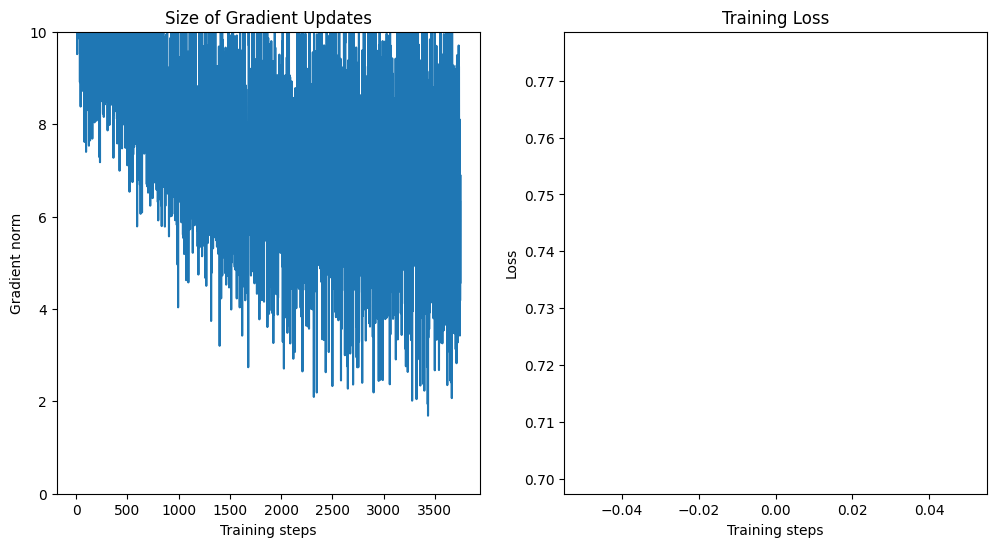

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<07:52,  7.94it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.515693


Epoch 1:   6%|▌         | 217/3750 [00:02<00:34, 101.40it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.911164


Epoch 1:  11%|█         | 415/3750 [00:04<00:33, 99.19it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.936871


Epoch 1:  17%|█▋        | 620/3750 [00:06<00:31, 100.92it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.010529


Epoch 1:  22%|██▏       | 814/3750 [00:08<00:34, 84.15it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.052253


Epoch 1:  27%|██▋       | 1013/3750 [00:11<00:31, 85.88it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.664491


Epoch 1:  32%|███▏      | 1217/3750 [00:13<00:26, 95.13it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.988168


Epoch 1:  38%|███▊      | 1420/3750 [00:15<00:23, 98.83it/s] 

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.712015


Epoch 1:  43%|████▎     | 1616/3750 [00:17<00:21, 99.58it/s] 

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.467448


Epoch 1:  49%|████▊     | 1819/3750 [00:19<00:19, 99.02it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.729880


Epoch 1:  54%|█████▍    | 2021/3750 [00:21<00:16, 102.58it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.487310


Epoch 1:  59%|█████▉    | 2214/3750 [00:23<00:17, 85.78it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.248784


Epoch 1:  64%|██████▍   | 2410/3750 [00:26<00:16, 81.52it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.614463


Epoch 1:  70%|██████▉   | 2617/3750 [00:28<00:14, 77.06it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.292800


Epoch 1:  75%|███████▌  | 2820/3750 [00:30<00:09, 100.60it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.897085


Epoch 1:  80%|████████  | 3016/3750 [00:32<00:07, 100.72it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.260355


Epoch 1:  86%|████████▌ | 3214/3750 [00:34<00:05, 98.19it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.803086


Epoch 1:  91%|█████████ | 3419/3750 [00:36<00:03, 99.78it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.458517


Epoch 1:  96%|█████████▋| 3615/3750 [00:38<00:01, 99.31it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.377774


Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 92.79it/s]


Train set: Avg. loss: 0.8186, Time: 40.4 secs 




Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 3.1 secs

Train loss: 0.8186256546258927, Test loss: 0.00021563982218503953, Test accuracy: 93.98, Train time: 40.42097187042236, Test time: 3.090980052947998


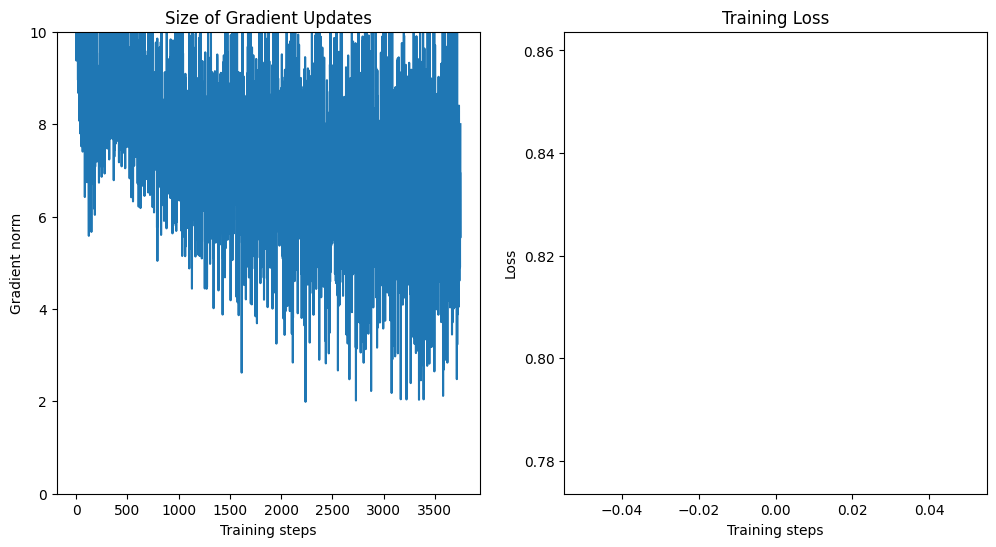

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<11:57,  5.22it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.793684


Epoch 1:   6%|▌         | 218/3750 [00:02<00:32, 107.30it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.968898


Epoch 1:  11%|█         | 414/3750 [00:04<00:31, 105.79it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.260021


Epoch 1:  17%|█▋        | 620/3750 [00:05<00:28, 108.66it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.291557


Epoch 1:  22%|██▏       | 822/3750 [00:07<00:27, 106.08it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.348703


Epoch 1:  27%|██▋       | 1007/3750 [00:09<00:27, 100.86it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.658610


Epoch 1:  32%|███▏      | 1213/3750 [00:12<00:34, 73.22it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.224420


Epoch 1:  38%|███▊      | 1415/3750 [00:14<00:32, 72.67it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.845167


Epoch 1:  43%|████▎     | 1622/3750 [00:17<00:19, 108.03it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.448530


Epoch 1:  49%|████▊     | 1821/3750 [00:19<00:17, 110.69it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.395281


Epoch 1:  54%|█████▎    | 2013/3750 [00:20<00:16, 102.58it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.852612


Epoch 1:  59%|█████▉    | 2215/3750 [00:22<00:14, 106.92it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.455029


Epoch 1:  64%|██████▍   | 2415/3750 [00:24<00:12, 108.71it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.502540


Epoch 1:  70%|██████▉   | 2618/3750 [00:26<00:13, 85.82it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.534143


Epoch 1:  75%|███████▍  | 2810/3750 [00:29<00:12, 76.81it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.221076


Epoch 1:  80%|████████  | 3016/3750 [00:31<00:09, 80.94it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.186010


Epoch 1:  86%|████████▌ | 3225/3750 [00:34<00:04, 112.34it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.330323


Epoch 1:  91%|█████████ | 3415/3750 [00:35<00:03, 111.12it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.449366


Epoch 1:  96%|█████████▋| 3614/3750 [00:37<00:01, 106.46it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.499289


Epoch 1: 100%|██████████| 3750/3750 [00:39<00:00, 95.89it/s] 


Train set: Avg. loss: 0.7895, Time: 39.1 secs 




Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 1.9 secs

Train loss: 0.7895371802786986, Test loss: 0.00020774333477020264, Test accuracy: 94.23, Train time: 39.113221645355225, Test time: 1.9166548252105713


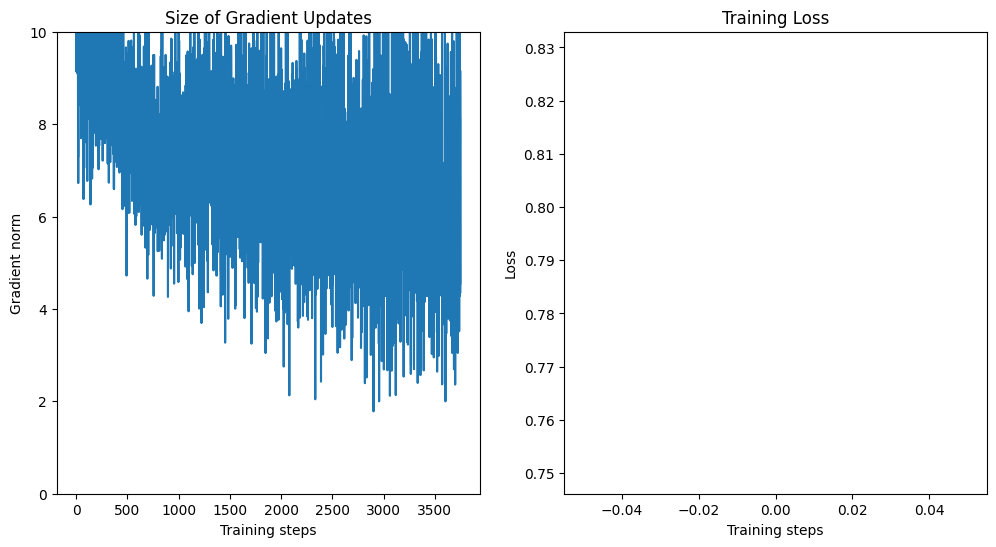

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 8/3750 [00:00<02:34, 24.17it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.745238


Epoch 1:   6%|▌         | 216/3750 [00:02<00:49, 71.89it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.934543


Epoch 1:  11%|█         | 413/3750 [00:05<00:48, 68.95it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.019525


Epoch 1:  16%|█▋        | 618/3750 [00:08<00:31, 98.45it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.074227


Epoch 1:  22%|██▏       | 820/3750 [00:10<00:28, 103.03it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.095336


Epoch 1:  27%|██▋       | 1020/3750 [00:12<00:24, 109.31it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.248920


Epoch 1:  32%|███▏      | 1216/3750 [00:14<00:22, 112.15it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.806550


Epoch 1:  38%|███▊      | 1420/3750 [00:16<00:21, 106.29it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.721156


Epoch 1:  43%|████▎     | 1610/3750 [00:17<00:21, 101.49it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.029579


Epoch 1:  48%|████▊     | 1816/3750 [00:20<00:27, 71.36it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.367317


Epoch 1:  54%|█████▎    | 2013/3750 [00:23<00:26, 66.58it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.446879


Epoch 1:  59%|█████▉    | 2215/3750 [00:25<00:14, 103.41it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.469223


Epoch 1:  64%|██████▍   | 2418/3750 [00:27<00:12, 105.23it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.576723


Epoch 1:  70%|██████▉   | 2612/3750 [00:29<00:11, 103.00it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.238233


Epoch 1:  75%|███████▌  | 2821/3750 [00:31<00:08, 108.30it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.642099


Epoch 1:  80%|████████  | 3013/3750 [00:33<00:07, 102.82it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.315174


Epoch 1:  86%|████████▌ | 3211/3750 [00:35<00:07, 73.70it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.384571


Epoch 1:  91%|█████████ | 3408/3750 [00:38<00:05, 65.59it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.339710


Epoch 1:  96%|█████████▋| 3616/3750 [00:41<00:01, 98.00it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.350155


Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 87.30it/s] 



Train set: Avg. loss: 0.8037, Time: 43.0 secs 


Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.8037262928247452, Test loss: 0.00021041148528456687, Test accuracy: 94.25, Train time: 42.9660325050354, Test time: 2.089329481124878


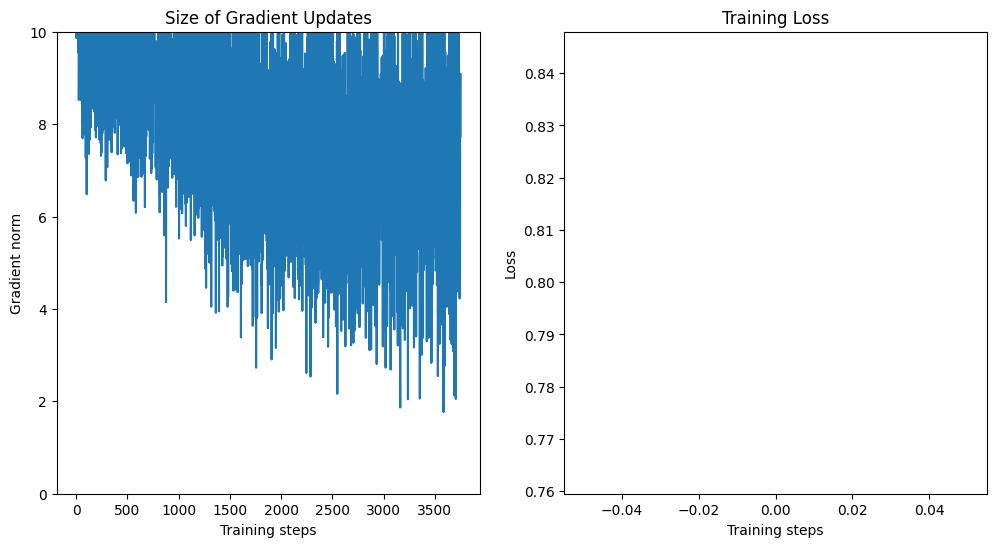

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<08:08,  7.68it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.638962


Epoch 1:  14%|█▎        | 514/3750 [00:05<00:37, 85.88it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.258761


Epoch 1:  27%|██▋       | 1015/3750 [00:11<00:30, 89.25it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.882979


Epoch 1:  41%|████      | 1519/3750 [00:17<00:22, 98.84it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.544358


Epoch 1:  54%|█████▍    | 2020/3750 [00:22<00:17, 97.56it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.510346


Epoch 1:  67%|██████▋   | 2516/3750 [00:28<00:15, 82.17it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.293497


Epoch 1:  81%|████████  | 3020/3750 [00:33<00:07, 94.54it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.274278


Epoch 1:  94%|█████████▍| 3517/3750 [00:39<00:02, 98.89it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.286363


Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 89.07it/s]



Train set: Avg. loss: 0.7451, Time: 42.1 secs 


Test set: Avg. loss: 0.0002, Accuracy: 95%, Time: 3.1 secs

Train loss: 0.7451091031501691, Test loss: 0.00018977051302790642, Test accuracy: 94.67, Train time: 42.11035943031311, Test time: 3.1481173038482666


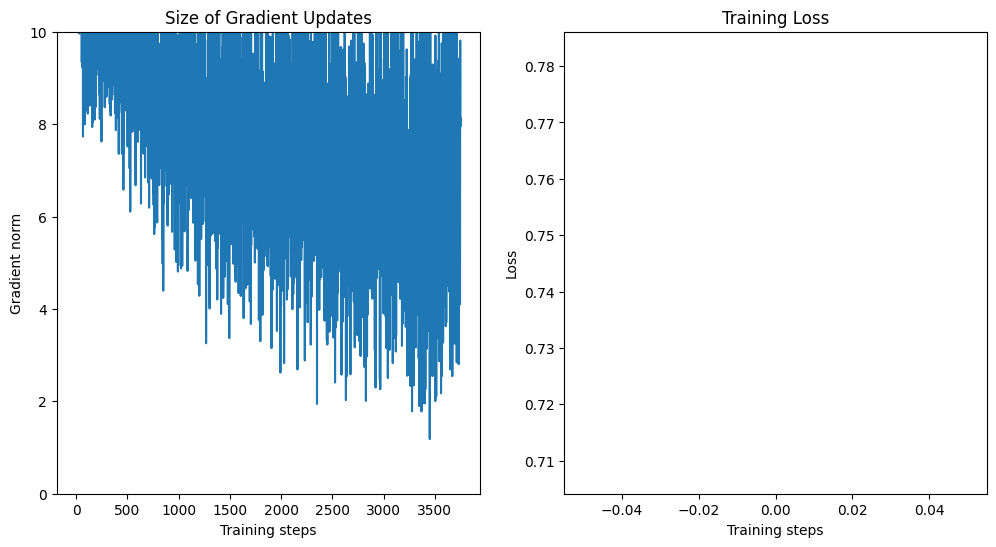

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<11:27,  5.45it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.492072


Epoch 1:  14%|█▍        | 521/3750 [00:05<00:31, 104.10it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.063431


Epoch 1:  27%|██▋       | 1014/3750 [00:10<00:33, 82.34it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.915193


Epoch 1:  41%|████      | 1520/3750 [00:16<00:21, 101.40it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.550308


Epoch 1:  54%|█████▍    | 2019/3750 [00:21<00:16, 102.08it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.241438


Epoch 1:  67%|██████▋   | 2517/3750 [00:26<00:15, 82.08it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.603026


Epoch 1:  81%|████████  | 3022/3750 [00:33<00:06, 106.91it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.722065


Epoch 1:  94%|█████████▎| 3512/3750 [00:38<00:02, 100.35it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.218706


Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 92.53it/s] 


Train set: Avg. loss: 0.7197, Time: 40.5 secs 




Test set: Avg. loss: 0.0002, Accuracy: 95%, Time: 2.1 secs

Train loss: 0.7196542503078779, Test loss: 0.00018875963911414145, Test accuracy: 94.78, Train time: 40.54085850715637, Test time: 2.142841339111328


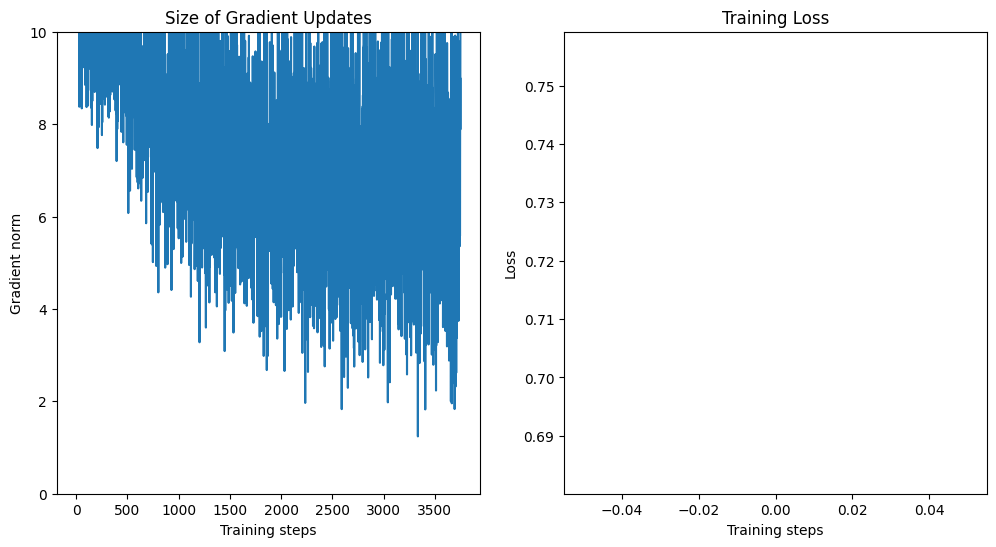

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 8/3750 [00:00<03:40, 16.96it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.567152


Epoch 1:  14%|█▎        | 512/3750 [00:06<00:32, 99.88it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.321479


Epoch 1:  27%|██▋       | 1016/3750 [00:11<00:28, 97.60it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.917527


Epoch 1:  40%|████      | 1507/3750 [00:17<00:35, 62.54it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.540414


Epoch 1:  54%|█████▎    | 2014/3750 [00:24<00:17, 100.28it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.414472


Epoch 1:  67%|██████▋   | 2513/3750 [00:28<00:12, 100.20it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.278263


Epoch 1:  80%|████████  | 3008/3750 [00:35<00:11, 67.04it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.350011


Epoch 1:  94%|█████████▎| 3515/3750 [00:41<00:02, 99.86it/s] 

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.439017


Epoch 1: 100%|██████████| 3750/3750 [00:43<00:00, 86.13it/s]


Train set: Avg. loss: 0.8502, Time: 43.5 secs 




Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.8502328088899453, Test loss: 0.00022772450894117355, Test accuracy: 93.73, Train time: 43.54993677139282, Test time: 2.1073222160339355


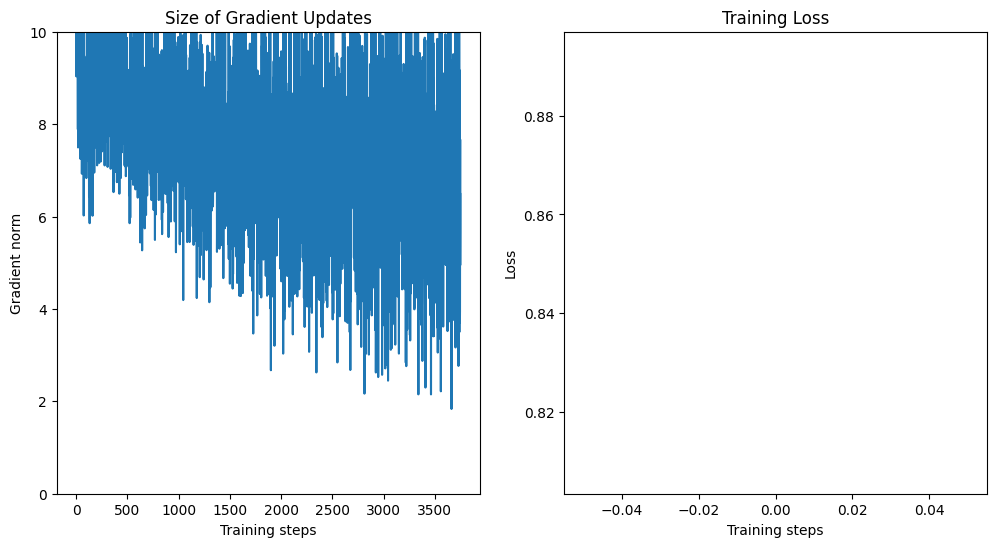

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<07:47,  8.02it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.312942


Epoch 1:   3%|▎         | 112/3750 [00:01<00:37, 96.55it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.608399


Epoch 1:   6%|▌         | 211/3750 [00:02<00:47, 74.65it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.597097


Epoch 1:   8%|▊         | 318/3750 [00:03<00:40, 84.41it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.995246


Epoch 1:  11%|█         | 410/3750 [00:04<00:40, 82.45it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.251654


Epoch 1:  14%|█▎        | 512/3750 [00:06<00:36, 88.14it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.277895


Epoch 1:  16%|█▋        | 612/3750 [00:07<00:36, 85.34it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.424325


Epoch 1:  19%|█▉        | 711/3750 [00:08<00:37, 81.76it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.328515


Epoch 1:  22%|██▏       | 812/3750 [00:09<00:35, 82.54it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.349002


Epoch 1:  25%|██▍       | 921/3750 [00:10<00:28, 97.61it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.221811


Epoch 1:  27%|██▋       | 1013/3750 [00:11<00:27, 99.07it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.084101


Epoch 1:  30%|██▉       | 1113/3750 [00:12<00:27, 95.18it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.385219


Epoch 1:  32%|███▏      | 1213/3750 [00:14<00:27, 93.40it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.032689


Epoch 1:  35%|███▌      | 1313/3750 [00:15<00:25, 94.28it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 1.940242


Epoch 1:  38%|███▊      | 1417/3750 [00:16<00:24, 94.96it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.254346


Epoch 1:  41%|████      | 1520/3750 [00:17<00:22, 98.08it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.083231


Epoch 1:  43%|████▎     | 1611/3750 [00:18<00:22, 94.01it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.087110


Epoch 1:  46%|████▌     | 1713/3750 [00:19<00:21, 95.04it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.095001


Epoch 1:  48%|████▊     | 1815/3750 [00:20<00:23, 82.19it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.038474


Epoch 1:  51%|█████     | 1914/3750 [00:21<00:21, 84.55it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 2.082758


Epoch 1:  54%|█████▎    | 2011/3750 [00:22<00:21, 79.07it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.550759


Epoch 1:  56%|█████▌    | 2109/3750 [00:24<00:19, 82.12it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.522938


Epoch 1:  59%|█████▉    | 2215/3750 [00:25<00:19, 79.87it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.928742


Epoch 1:  62%|██████▏   | 2315/3750 [00:26<00:16, 87.85it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.589397


Epoch 1:  64%|██████▍   | 2415/3750 [00:27<00:14, 95.23it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.790565


Epoch 1:  67%|██████▋   | 2509/3750 [00:28<00:13, 93.83it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.283740


Epoch 1:  70%|██████▉   | 2611/3750 [00:29<00:11, 95.74it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.836698


Epoch 1:  72%|███████▏  | 2713/3750 [00:30<00:10, 95.95it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.745455


Epoch 1:  75%|███████▌  | 2815/3750 [00:31<00:09, 95.99it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.910477


Epoch 1:  78%|███████▊  | 2920/3750 [00:33<00:08, 95.26it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 2.022380


Epoch 1:  80%|████████  | 3012/3750 [00:34<00:07, 94.83it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.647819


Epoch 1:  83%|████████▎ | 3115/3750 [00:35<00:06, 99.63it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.831784


Epoch 1:  86%|████████▌ | 3218/3750 [00:36<00:05, 97.18it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.489329


Epoch 1:  88%|████████▊ | 3312/3750 [00:37<00:05, 82.22it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.566768


Epoch 1:  91%|█████████ | 3413/3750 [00:38<00:03, 84.40it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.311510


Epoch 1:  94%|█████████▍| 3517/3750 [00:39<00:02, 84.57it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 2.202284


Epoch 1:  96%|█████████▋| 3612/3750 [00:40<00:01, 89.03it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.289764


Epoch 1:  99%|█████████▉| 3713/3750 [00:41<00:00, 85.23it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.589393


Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 88.46it/s]


Train set: Avg. loss: 1.9887, Time: 42.4 secs 




Test set: Avg. loss: 0.0013, Accuracy: 63%, Time: 2.6 secs

Train loss: 1.9887210983435313, Test loss: 0.0012609117269515992, Test accuracy: 62.52, Train time: 42.402485609054565, Test time: 2.5695033073425293


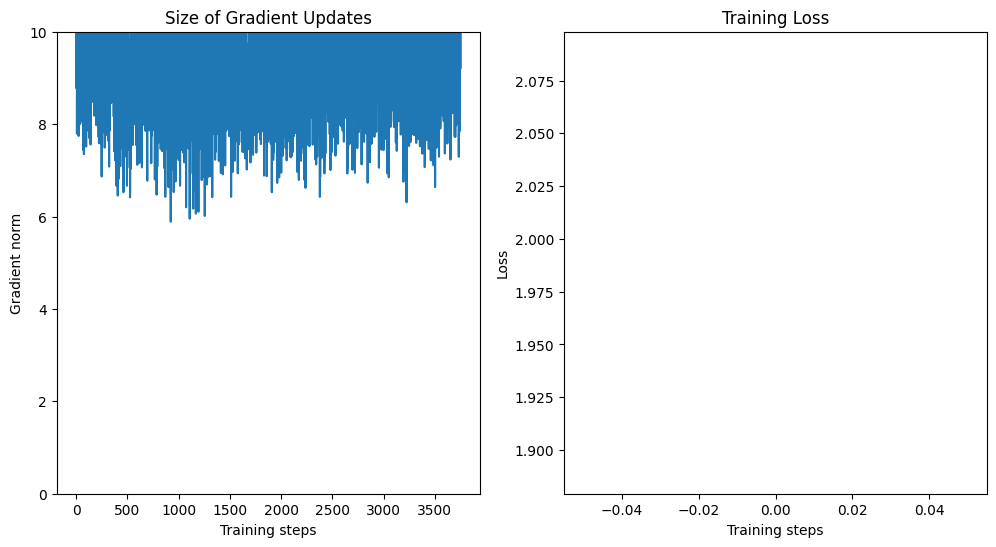

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 11/3750 [00:00<01:26, 43.16it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.641403


Epoch 1:   3%|▎         | 119/3750 [00:01<00:36, 100.75it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.269247


Epoch 1:   6%|▌         | 218/3750 [00:02<00:34, 101.99it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.537497


Epoch 1:   8%|▊         | 318/3750 [00:03<00:33, 102.55it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.154986


Epoch 1:  11%|█         | 418/3750 [00:04<00:32, 102.42it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.094089


Epoch 1:  14%|█▍        | 517/3750 [00:05<00:32, 99.77it/s] 

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.679410


Epoch 1:  17%|█▋        | 619/3750 [00:06<00:29, 106.18it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.320870


Epoch 1:  19%|█▉        | 718/3750 [00:07<00:29, 102.74it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.285990


Epoch 1:  22%|██▏       | 816/3750 [00:08<00:31, 93.01it/s] 

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.273737


Epoch 1:  24%|██▍       | 917/3750 [00:09<00:37, 75.12it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.346677


Epoch 1:  27%|██▋       | 1016/3750 [00:11<00:34, 79.11it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.089499


Epoch 1:  30%|██▉       | 1115/3750 [00:12<00:32, 81.34it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.332573


Epoch 1:  32%|███▏      | 1214/3750 [00:13<00:32, 78.31it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.086253


Epoch 1:  35%|███▌      | 1317/3750 [00:14<00:32, 75.01it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.155304


Epoch 1:  38%|███▊      | 1412/3750 [00:15<00:24, 96.90it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.491691


Epoch 1:  40%|████      | 1513/3750 [00:16<00:22, 99.46it/s] 

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.077202


Epoch 1:  43%|████▎     | 1620/3750 [00:18<00:21, 98.56it/s] 

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.191460


Epoch 1:  46%|████▌     | 1720/3750 [00:19<00:20, 100.35it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.316999


Epoch 1:  48%|████▊     | 1818/3750 [00:20<00:20, 96.19it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.346002


Epoch 1:  51%|█████     | 1915/3750 [00:21<00:17, 103.26it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.824178


Epoch 1:  54%|█████▍    | 2019/3750 [00:22<00:15, 109.29it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.778944


Epoch 1:  57%|█████▋    | 2119/3750 [00:22<00:15, 104.04it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.829661


Epoch 1:  59%|█████▉    | 2219/3750 [00:23<00:14, 105.46it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.618520


Epoch 1:  62%|██████▏   | 2319/3750 [00:24<00:13, 103.91it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.953349


Epoch 1:  64%|██████▍   | 2412/3750 [00:25<00:15, 87.64it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.729252


Epoch 1:  67%|██████▋   | 2509/3750 [00:27<00:14, 85.63it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.034787


Epoch 1:  70%|██████▉   | 2610/3750 [00:28<00:13, 85.95it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.907859


Epoch 1:  72%|███████▏  | 2708/3750 [00:29<00:14, 71.27it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.585661


Epoch 1:  75%|███████▍  | 2810/3750 [00:31<00:11, 79.61it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.630769


Epoch 1:  78%|███████▊  | 2911/3750 [00:32<00:10, 81.96it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.597191


Epoch 1:  81%|████████  | 3020/3750 [00:33<00:07, 96.72it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.716771


Epoch 1:  83%|████████▎ | 3121/3750 [00:34<00:05, 111.38it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.832087


Epoch 1:  86%|████████▌ | 3213/3750 [00:35<00:04, 107.59it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.665239


Epoch 1:  88%|████████▊ | 3315/3750 [00:36<00:04, 104.03it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.316951


Epoch 1:  91%|█████████ | 3412/3750 [00:37<00:03, 102.95it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.322806


Epoch 1:  94%|█████████▍| 3516/3750 [00:38<00:02, 105.95it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.483437


Epoch 1:  96%|█████████▋| 3617/3750 [00:39<00:01, 107.15it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.372022


Epoch 1:  99%|█████████▉| 3717/3750 [00:40<00:00, 104.07it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.510610


Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 91.85it/s] 


Train set: Avg. loss: 2.0108, Time: 40.8 secs 




Test set: Avg. loss: 0.0013, Accuracy: 64%, Time: 1.9 secs

Train loss: 2.010834616978963, Test loss: 0.0012516428589820863, Test accuracy: 64.36, Train time: 40.8402373790741, Test time: 1.9326999187469482


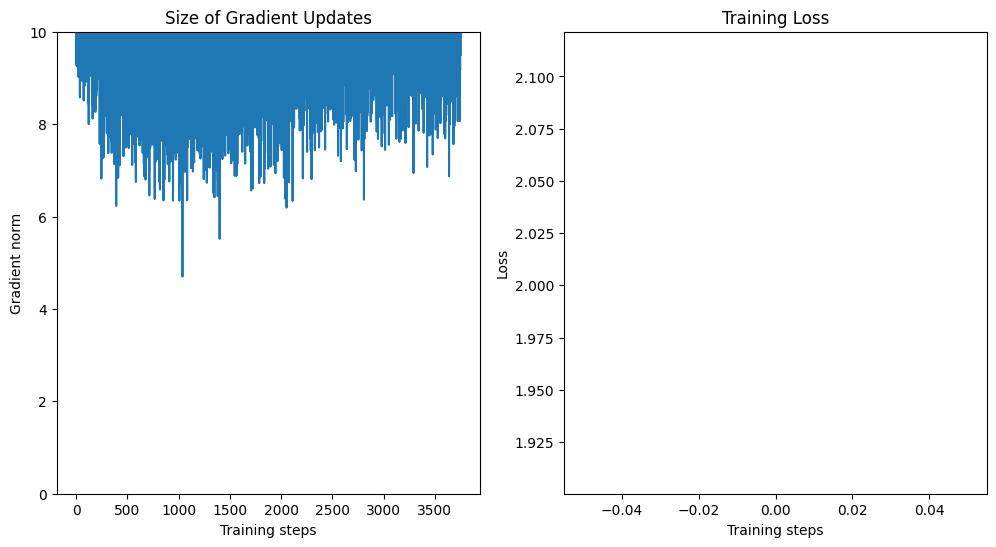

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 5/3750 [00:00<05:08, 12.15it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.899214


Epoch 1:   3%|▎         | 111/3750 [00:02<00:54, 66.49it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.709246


Epoch 1:   6%|▌         | 212/3750 [00:03<00:55, 63.94it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.332029


Epoch 1:   8%|▊         | 313/3750 [00:05<00:51, 66.54it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.609584


Epoch 1:  11%|█         | 408/3750 [00:06<00:52, 63.87it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.413885


Epoch 1:  14%|█▎        | 512/3750 [00:07<00:34, 94.29it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.151599


Epoch 1:  17%|█▋        | 621/3750 [00:08<00:30, 103.91it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.421604


Epoch 1:  19%|█▉        | 721/3750 [00:09<00:28, 106.34it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.213844


Epoch 1:  22%|██▏       | 824/3750 [00:10<00:26, 110.63it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.202529


Epoch 1:  24%|██▍       | 917/3750 [00:11<00:26, 107.89it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.266189


Epoch 1:  27%|██▋       | 1018/3750 [00:12<00:27, 101.00it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.583985


Epoch 1:  30%|██▉       | 1120/3750 [00:13<00:26, 99.47it/s] 

Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.090797


Epoch 1:  32%|███▏      | 1218/3750 [00:14<00:25, 99.59it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.299869


Epoch 1:  35%|███▌      | 1313/3750 [00:15<00:26, 93.22it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.369367


Epoch 1:  38%|███▊      | 1415/3750 [00:16<00:24, 94.13it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.131461


Epoch 1:  40%|████      | 1513/3750 [00:17<00:31, 69.98it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.795273


Epoch 1:  43%|████▎     | 1611/3750 [00:19<00:32, 66.80it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.850903


Epoch 1:  46%|████▌     | 1712/3750 [00:20<00:28, 70.65it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 1.957237


Epoch 1:  48%|████▊     | 1808/3750 [00:22<00:27, 70.72it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.152383


Epoch 1:  51%|█████     | 1913/3750 [00:23<00:25, 70.69it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 2.137399


Epoch 1:  54%|█████▎    | 2013/3750 [00:25<00:19, 86.89it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.576847


Epoch 1:  56%|█████▋    | 2112/3750 [00:26<00:15, 104.21it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 2.119138


Epoch 1:  59%|█████▉    | 2213/3750 [00:27<00:14, 102.97it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.869114


Epoch 1:  62%|██████▏   | 2313/3750 [00:28<00:13, 107.05it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.724031


Epoch 1:  64%|██████▍   | 2412/3750 [00:29<00:12, 105.35it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.911799


Epoch 1:  67%|██████▋   | 2511/3750 [00:30<00:12, 102.10it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.063066


Epoch 1:  70%|██████▉   | 2620/3750 [00:31<00:11, 100.99it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.956362


Epoch 1:  72%|███████▏  | 2717/3750 [00:32<00:09, 104.28it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.758368


Epoch 1:  75%|███████▌  | 2813/3750 [00:33<00:09, 99.03it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.701273


Epoch 1:  78%|███████▊  | 2922/3750 [00:34<00:08, 101.90it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 2.265881


Epoch 1:  80%|████████  | 3011/3750 [00:35<00:10, 71.20it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.017810


Epoch 1:  83%|████████▎ | 3110/3750 [00:36<00:10, 62.04it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.650469


Epoch 1:  86%|████████▌ | 3210/3750 [00:38<00:07, 68.89it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.853157


Epoch 1:  88%|████████▊ | 3309/3750 [00:39<00:06, 71.08it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.651989


Epoch 1:  91%|█████████ | 3412/3750 [00:41<00:05, 66.65it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.687406


Epoch 1:  94%|█████████▎| 3512/3750 [00:42<00:02, 100.18it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.514000


Epoch 1:  96%|█████████▋| 3614/3750 [00:43<00:01, 105.61it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.230953


Epoch 1:  99%|█████████▉| 3716/3750 [00:44<00:00, 104.32it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.361944


Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 83.88it/s]


Train set: Avg. loss: 2.0437, Time: 44.7 secs 




Test set: Avg. loss: 0.0013, Accuracy: 60%, Time: 2.2 secs

Train loss: 2.043662423658371, Test loss: 0.0013122064828872682, Test accuracy: 59.97, Train time: 44.71365475654602, Test time: 2.169133424758911


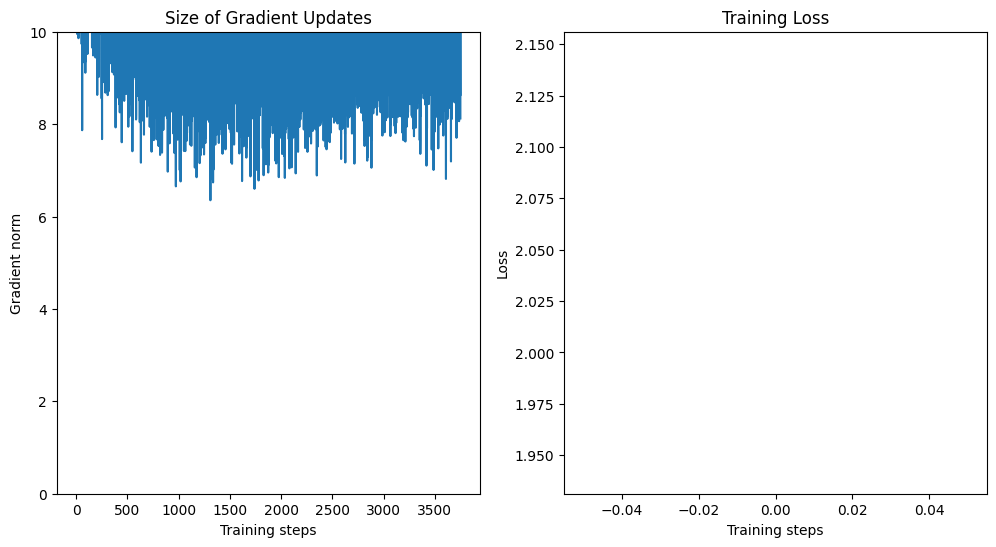

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<07:53,  7.92it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.801111


Epoch 1:   6%|▌         | 219/3750 [00:02<00:36, 96.28it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.526746


Epoch 1:  11%|█         | 409/3750 [00:04<00:43, 76.07it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.397810


Epoch 1:  16%|█▋        | 616/3750 [00:07<00:40, 78.24it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.309990


Epoch 1:  22%|██▏       | 808/3750 [00:09<00:40, 73.45it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.455287


Epoch 1:  27%|██▋       | 1017/3750 [00:12<00:35, 76.66it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.196077


Epoch 1:  32%|███▏      | 1213/3750 [00:15<00:30, 82.28it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.263722


Epoch 1:  38%|███▊      | 1410/3750 [00:17<00:27, 83.63it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.238699


Epoch 1:  43%|████▎     | 1617/3750 [00:19<00:25, 83.23it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.655531


Epoch 1:  48%|████▊     | 1816/3750 [00:22<00:23, 80.82it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.690822


Epoch 1:  54%|█████▎    | 2011/3750 [00:24<00:18, 92.07it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.641694


Epoch 1:  59%|█████▉    | 2212/3750 [00:26<00:16, 92.69it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.653743


Epoch 1:  64%|██████▍   | 2415/3750 [00:29<00:16, 79.22it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.862688


Epoch 1:  70%|██████▉   | 2612/3750 [00:31<00:13, 82.57it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.959537


Epoch 1:  75%|███████▍  | 2807/3750 [00:34<00:13, 71.91it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.850838


Epoch 1:  80%|████████  | 3011/3750 [00:36<00:07, 94.65it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.771712


Epoch 1:  86%|████████▌ | 3211/3750 [00:38<00:05, 92.51it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.944906


Epoch 1:  91%|█████████ | 3415/3750 [00:40<00:03, 96.65it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.023970


Epoch 1:  96%|█████████▋| 3617/3750 [00:42<00:01, 96.13it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.792832


Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 84.58it/s]


Train set: Avg. loss: 2.0199, Time: 44.3 secs 




Test set: Avg. loss: 0.0015, Accuracy: 54%, Time: 3.1 secs

Train loss: 2.019925307369232, Test loss: 0.0014863478183746337, Test accuracy: 53.65, Train time: 44.341269731521606, Test time: 3.109800338745117


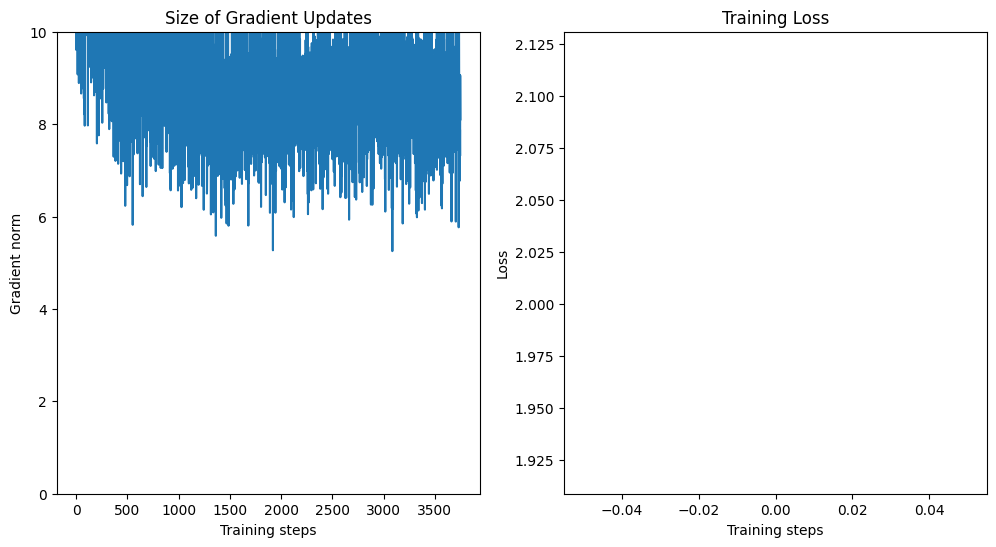

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 9/3750 [00:00<02:08, 29.00it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.809660


Epoch 1:   6%|▌         | 209/3750 [00:02<00:35, 100.60it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.519078


Epoch 1:  11%|█         | 418/3750 [00:04<00:32, 103.46it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.427377


Epoch 1:  16%|█▋        | 613/3750 [00:06<00:31, 100.93it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.292321


Epoch 1:  22%|██▏       | 813/3750 [00:08<00:27, 105.57it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.122469


Epoch 1:  27%|██▋       | 1013/3750 [00:10<00:26, 103.39it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.883765


Epoch 1:  32%|███▏      | 1213/3750 [00:13<00:33, 75.50it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.079957


Epoch 1:  38%|███▊      | 1408/3750 [00:15<00:28, 81.41it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.897774


Epoch 1:  43%|████▎     | 1614/3750 [00:18<00:27, 76.34it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.838788


Epoch 1:  48%|████▊     | 1811/3750 [00:20<00:19, 98.81it/s] 

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.459650


Epoch 1:  54%|█████▍    | 2016/3750 [00:22<00:17, 98.60it/s] 

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.884206


Epoch 1:  59%|█████▉    | 2215/3750 [00:24<00:15, 97.89it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.875270


Epoch 1:  64%|██████▍   | 2413/3750 [00:26<00:13, 101.81it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.180164


Epoch 1:  70%|██████▉   | 2613/3750 [00:28<00:10, 103.50it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.726553


Epoch 1:  75%|███████▍  | 2808/3750 [00:30<00:12, 74.45it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.716548


Epoch 1:  80%|████████  | 3010/3750 [00:33<00:10, 72.99it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.912323


Epoch 1:  86%|████████▌ | 3217/3750 [00:36<00:05, 93.18it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.771610


Epoch 1:  91%|█████████ | 3418/3750 [00:38<00:03, 101.49it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.661495


Epoch 1:  96%|█████████▋| 3616/3750 [00:40<00:01, 97.65it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.761290


Epoch 1: 100%|██████████| 3750/3750 [00:41<00:00, 89.41it/s]


Train set: Avg. loss: 2.0081, Time: 41.9 secs 




Test set: Avg. loss: 0.0014, Accuracy: 59%, Time: 2.0 secs

Train loss: 2.008146701447169, Test loss: 0.001364392077922821, Test accuracy: 58.74, Train time: 41.94680142402649, Test time: 1.979065179824829


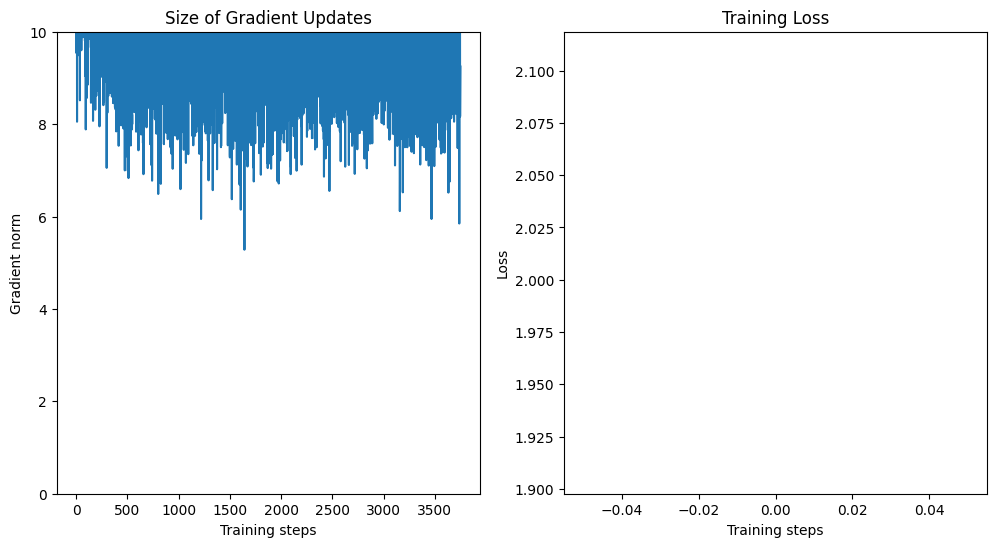

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 9/3750 [00:00<02:24, 25.97it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.391233


Epoch 1:   6%|▌         | 212/3750 [00:03<00:53, 66.15it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.389787


Epoch 1:  11%|█         | 408/3750 [00:06<00:47, 69.65it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.417739


Epoch 1:  16%|█▋        | 613/3750 [00:09<00:36, 85.51it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.393810


Epoch 1:  22%|██▏       | 820/3750 [00:11<00:30, 97.30it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.346580


Epoch 1:  27%|██▋       | 1020/3750 [00:13<00:27, 98.68it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.269880


Epoch 1:  32%|███▏      | 1210/3750 [00:15<00:26, 95.85it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.485904


Epoch 1:  38%|███▊      | 1413/3750 [00:17<00:24, 94.33it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.191159


Epoch 1:  43%|████▎     | 1615/3750 [00:19<00:29, 73.14it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.858303


Epoch 1:  48%|████▊     | 1813/3750 [00:22<00:29, 65.93it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.831951


Epoch 1:  54%|█████▎    | 2013/3750 [00:26<00:27, 63.25it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.116533


Epoch 1:  59%|█████▉    | 2216/3750 [00:28<00:16, 92.95it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.615716


Epoch 1:  64%|██████▍   | 2417/3750 [00:30<00:13, 96.59it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.967334


Epoch 1:  70%|██████▉   | 2612/3750 [00:32<00:12, 94.32it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.668530


Epoch 1:  75%|███████▌  | 2817/3750 [00:34<00:10, 88.12it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.040820


Epoch 1:  80%|████████  | 3010/3750 [00:36<00:10, 70.11it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.809852


Epoch 1:  86%|████████▌ | 3207/3750 [00:39<00:08, 64.38it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.334708


Epoch 1:  91%|█████████ | 3408/3750 [00:43<00:05, 66.42it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.043965


Epoch 1:  96%|█████████▋| 3618/3750 [00:45<00:01, 95.29it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.673178


Epoch 1: 100%|██████████| 3750/3750 [00:46<00:00, 80.17it/s]


Train set: Avg. loss: 2.0006, Time: 46.8 secs 




Test set: Avg. loss: 0.0012, Accuracy: 63%, Time: 2.2 secs

Train loss: 2.0005937994480134, Test loss: 0.001242785680294037, Test accuracy: 63.38, Train time: 46.785146951675415, Test time: 2.1912686824798584


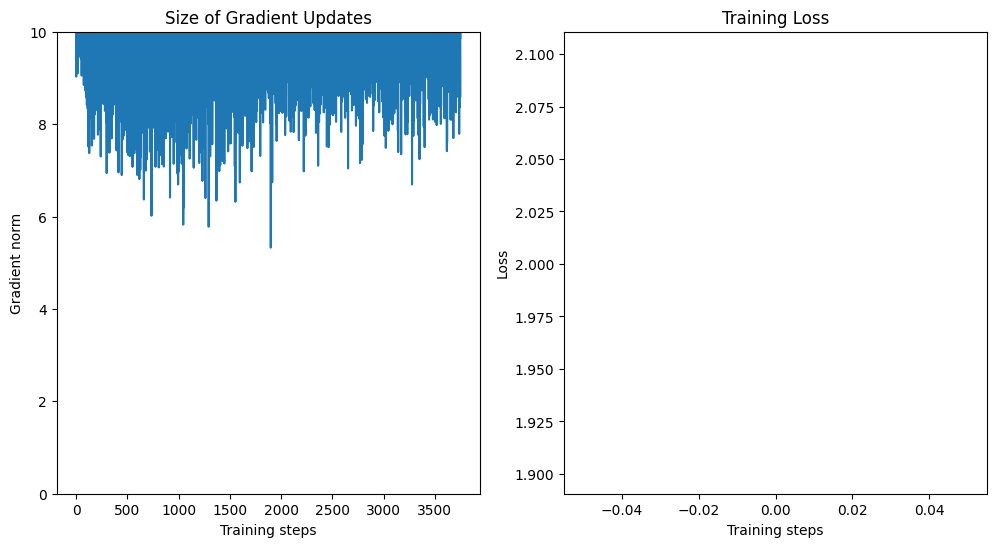

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<08:14,  7.59it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.552683


Epoch 1:  14%|█▎        | 512/3750 [00:05<00:37, 85.23it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.302856


Epoch 1:  27%|██▋       | 1016/3750 [00:12<00:31, 86.23it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.296336


Epoch 1:  40%|████      | 1511/3750 [00:17<00:24, 92.10it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.913113


Epoch 1:  54%|█████▎    | 2009/3750 [00:23<00:24, 70.43it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.021716


Epoch 1:  67%|██████▋   | 2515/3750 [00:30<00:13, 91.77it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.114035


Epoch 1:  81%|████████  | 3019/3750 [00:35<00:07, 95.27it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.620985


Epoch 1:  94%|█████████▎| 3515/3750 [00:40<00:02, 78.82it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.265833


Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 84.99it/s]


Train set: Avg. loss: 1.9941, Time: 44.1 secs 




Test set: Avg. loss: 0.0013, Accuracy: 62%, Time: 2.8 secs

Train loss: 1.9940990041097004, Test loss: 0.00129345782995224, Test accuracy: 62.18, Train time: 44.13057351112366, Test time: 2.7571396827697754


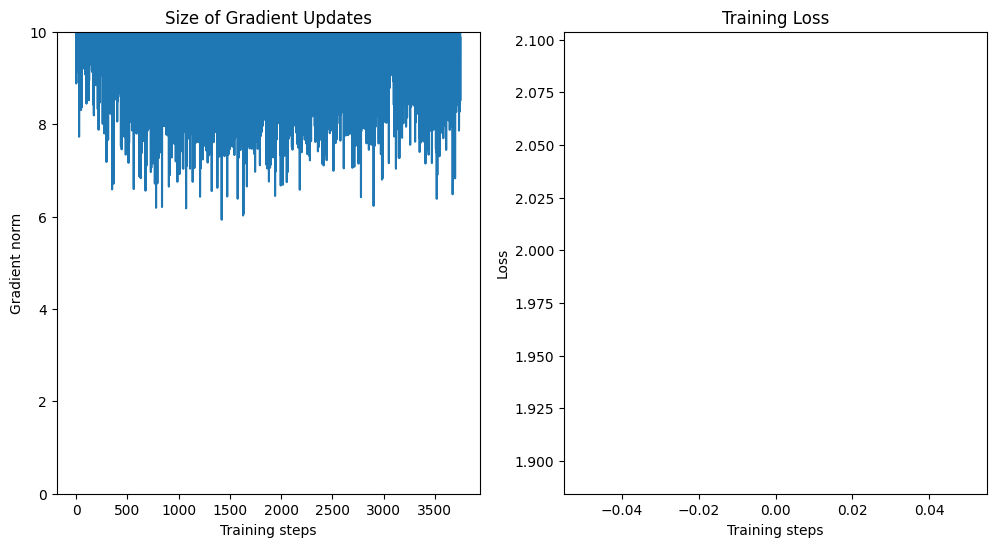

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 1/3750 [00:00<11:29,  5.44it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.539587


Epoch 1:  14%|█▎        | 512/3750 [00:05<00:33, 97.28it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.225381


Epoch 1:  27%|██▋       | 1008/3750 [00:11<00:39, 69.61it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.035467


Epoch 1:  40%|████      | 1515/3750 [00:17<00:23, 96.70it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.988549


Epoch 1:  54%|█████▎    | 2011/3750 [00:22<00:17, 97.84it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.758244


Epoch 1:  67%|██████▋   | 2510/3750 [00:28<00:16, 75.43it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.667342


Epoch 1:  80%|████████  | 3010/3750 [00:34<00:08, 86.69it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.420529


Epoch 1:  94%|█████████▍| 3519/3750 [00:40<00:02, 101.58it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.007387


Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 88.51it/s] 


Train set: Avg. loss: 1.8446, Time: 42.4 secs 




Test set: Avg. loss: 0.0010, Accuracy: 71%, Time: 2.0 secs

Train loss: 1.8446490888436635, Test loss: 0.000984362781047821, Test accuracy: 71.27, Train time: 42.38208198547363, Test time: 1.9524827003479004


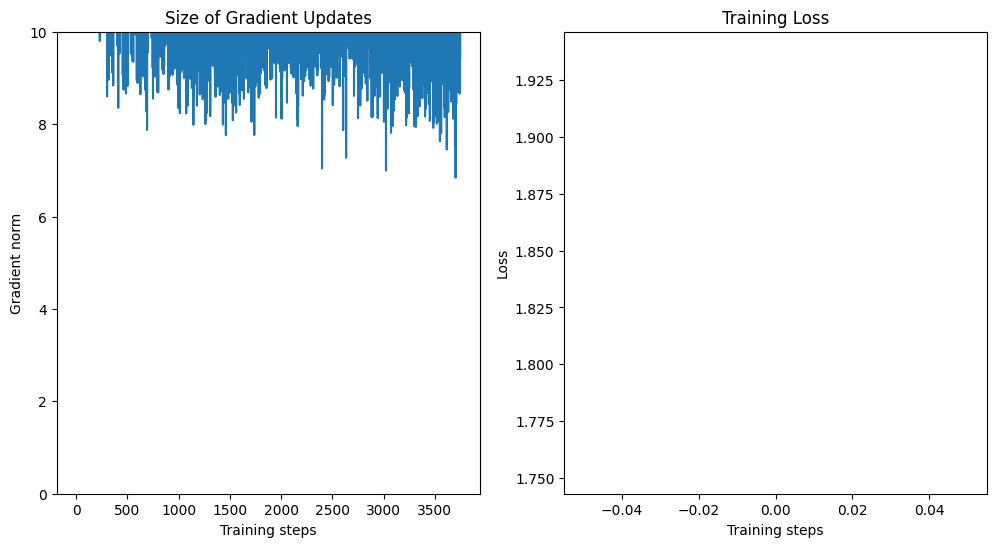

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 3/3750 [00:00<09:27,  6.61it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.933728


Epoch 1:  14%|█▍        | 516/3750 [00:07<00:32, 99.01it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.441582


Epoch 1:  27%|██▋       | 1019/3750 [00:12<00:28, 94.60it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.311564


Epoch 1:  40%|████      | 1508/3750 [00:18<00:32, 69.31it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.237568


Epoch 1:  54%|█████▎    | 2008/3750 [00:25<00:24, 69.98it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.266584


Epoch 1:  67%|██████▋   | 2514/3750 [00:31<00:14, 83.84it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.955193


Epoch 1:  80%|████████  | 3014/3750 [00:37<00:09, 79.49it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.743551


Epoch 1:  94%|█████████▍| 3517/3750 [00:44<00:02, 86.24it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.891076


Epoch 1: 100%|██████████| 3750/3750 [00:47<00:00, 79.46it/s]


Train set: Avg. loss: 2.0410, Time: 47.2 secs 




Test set: Avg. loss: 0.0014, Accuracy: 56%, Time: 2.2 secs

Train loss: 2.0409845738093058, Test loss: 0.0014461090564727784, Test accuracy: 55.98, Train time: 47.204848527908325, Test time: 2.1674184799194336


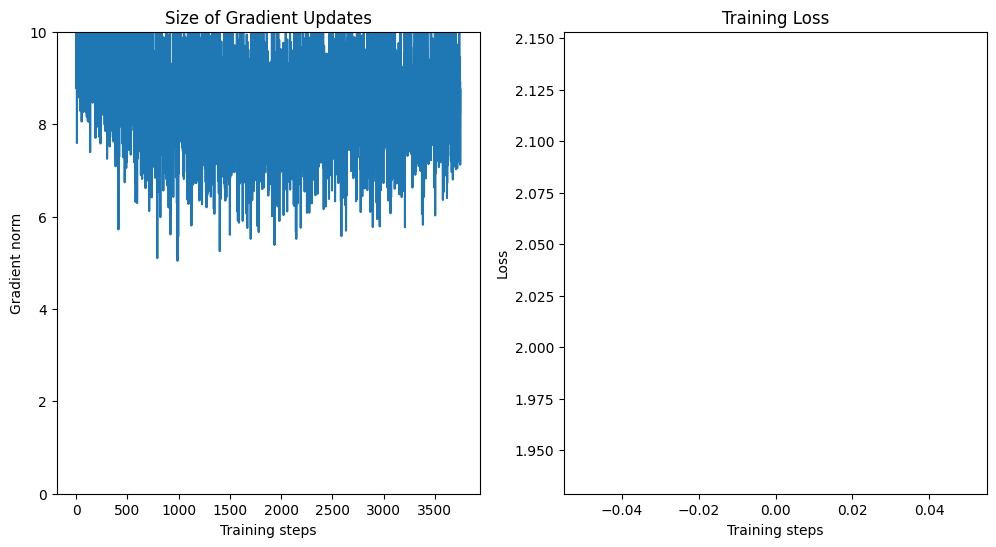

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<07:52,  7.93it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.580969


Epoch 1:   3%|▎         | 116/3750 [00:01<00:40, 90.69it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.092896


Epoch 1:   6%|▌         | 216/3750 [00:02<00:37, 94.27it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.612000


Epoch 1:   8%|▊         | 318/3750 [00:03<00:36, 95.06it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.854154


Epoch 1:  11%|█         | 413/3750 [00:04<00:40, 82.97it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.252383


Epoch 1:  14%|█▎        | 512/3750 [00:05<00:38, 85.09it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.110084


Epoch 1:  16%|█▋        | 611/3750 [00:07<00:38, 81.37it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.560593


Epoch 1:  19%|█▉        | 716/3750 [00:08<00:36, 82.21it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.134966


Epoch 1:  22%|██▏       | 815/3750 [00:09<00:37, 78.68it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.579135


Epoch 1:  24%|██▍       | 909/3750 [00:11<00:40, 69.64it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.048279


Epoch 1:  27%|██▋       | 1018/3750 [00:12<00:33, 80.96it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.497838


Epoch 1:  30%|██▉       | 1113/3750 [00:13<00:30, 87.81it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.440197


Epoch 1:  32%|███▏      | 1210/3750 [00:14<00:27, 92.22it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.414474


Epoch 1:  35%|███▍      | 1311/3750 [00:15<00:25, 93.87it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.144835


Epoch 1:  38%|███▊      | 1411/3750 [00:16<00:25, 93.28it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.073777


Epoch 1:  40%|████      | 1512/3750 [00:17<00:24, 92.60it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.119573


Epoch 1:  43%|████▎     | 1610/3750 [00:18<00:24, 86.60it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.427016


Epoch 1:  46%|████▌     | 1712/3750 [00:20<00:22, 89.48it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.121656


Epoch 1:  48%|████▊     | 1810/3750 [00:21<00:21, 91.37it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.205884


Epoch 1:  51%|█████     | 1909/3750 [00:22<00:21, 85.41it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.504543


Epoch 1:  54%|█████▎    | 2011/3750 [00:23<00:24, 71.96it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.220912


Epoch 1:  56%|█████▋    | 2113/3750 [00:24<00:19, 82.25it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.148921


Epoch 1:  59%|█████▉    | 2212/3750 [00:26<00:19, 78.63it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.128848


Epoch 1:  62%|██████▏   | 2310/3750 [00:27<00:17, 80.67it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.409821


Epoch 1:  64%|██████▍   | 2408/3750 [00:28<00:18, 71.71it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.308841


Epoch 1:  67%|██████▋   | 2517/3750 [00:30<00:15, 79.35it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.633118


Epoch 1:  70%|██████▉   | 2613/3750 [00:31<00:13, 81.89it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.021903


Epoch 1:  72%|███████▏  | 2713/3750 [00:32<00:11, 87.06it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.352854


Epoch 1:  75%|███████▍  | 2812/3750 [00:33<00:10, 91.40it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.141081


Epoch 1:  78%|███████▊  | 2912/3750 [00:34<00:09, 91.75it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.039841


Epoch 1:  80%|████████  | 3013/3750 [00:35<00:07, 94.05it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.340413


Epoch 1:  83%|████████▎ | 3114/3750 [00:36<00:06, 94.17it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.038942


Epoch 1:  86%|████████▌ | 3215/3750 [00:37<00:05, 93.13it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.043601


Epoch 1:  88%|████████▊ | 3315/3750 [00:39<00:04, 94.04it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.217203


Epoch 1:  91%|█████████ | 3417/3750 [00:40<00:03, 94.97it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.053180


Epoch 1:  94%|█████████▎| 3511/3750 [00:41<00:02, 81.24it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.203235


Epoch 1:  96%|█████████▋| 3610/3750 [00:42<00:01, 82.79it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.469975


Epoch 1:  99%|█████████▉| 3709/3750 [00:43<00:00, 82.39it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.080458


Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 84.72it/s]


Train set: Avg. loss: 0.3456, Time: 44.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.8 secs

Train loss: 0.3455825866664449, Test loss: 5.408424027264118e-05, Test accuracy: 96.69, Train time: 44.27691602706909, Test time: 2.8241350650787354


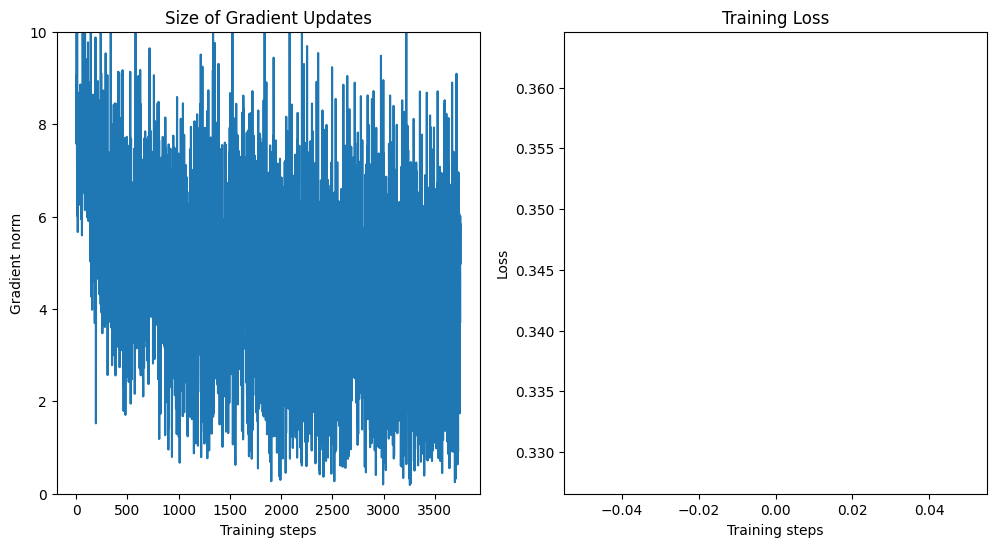

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=2


Epoch 1:   0%|          | 10/3750 [00:00<01:31, 40.72it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.490667


Epoch 1:   3%|▎         | 111/3750 [00:01<00:38, 95.42it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.323822


Epoch 1:   6%|▌         | 214/3750 [00:02<00:35, 99.39it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.434144


Epoch 1:   8%|▊         | 318/3750 [00:03<00:34, 98.12it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.294492


Epoch 1:  11%|█         | 415/3750 [00:04<00:32, 102.95it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.228391


Epoch 1:  14%|█▍        | 521/3750 [00:05<00:33, 95.80it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.599811


Epoch 1:  16%|█▋        | 615/3750 [00:06<00:32, 96.71it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.664336


Epoch 1:  19%|█▉        | 716/3750 [00:07<00:31, 96.80it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.730161


Epoch 1:  22%|██▏       | 816/3750 [00:08<00:28, 101.20it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.331247


Epoch 1:  24%|██▍       | 914/3750 [00:10<00:40, 70.79it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.178933


Epoch 1:  27%|██▋       | 1013/3750 [00:11<00:35, 76.55it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.387231


Epoch 1:  30%|██▉       | 1109/3750 [00:12<00:39, 66.49it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.389843


Epoch 1:  32%|███▏      | 1212/3750 [00:14<00:33, 74.99it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.264225


Epoch 1:  35%|███▌      | 1313/3750 [00:15<00:36, 67.62it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.954014


Epoch 1:  38%|███▊      | 1412/3750 [00:16<00:28, 82.16it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.190586


Epoch 1:  40%|████      | 1511/3750 [00:18<00:24, 90.04it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.203055


Epoch 1:  43%|████▎     | 1612/3750 [00:19<00:22, 94.09it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.243704


Epoch 1:  46%|████▌     | 1721/3750 [00:20<00:19, 102.31it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.083010


Epoch 1:  48%|████▊     | 1816/3750 [00:21<00:19, 99.47it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.290520


Epoch 1:  51%|█████     | 1913/3750 [00:22<00:18, 99.81it/s] 

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.113844


Epoch 1:  54%|█████▎    | 2011/3750 [00:23<00:17, 101.12it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.126607


Epoch 1:  56%|█████▋    | 2118/3750 [00:24<00:16, 101.66it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.151425


Epoch 1:  59%|█████▉    | 2215/3750 [00:25<00:15, 97.81it/s] 

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.458277


Epoch 1:  62%|██████▏   | 2313/3750 [00:26<00:13, 103.85it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.220731


Epoch 1:  64%|██████▍   | 2413/3750 [00:27<00:19, 69.98it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.081575


Epoch 1:  67%|██████▋   | 2513/3750 [00:29<00:18, 65.70it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.115471


Epoch 1:  70%|██████▉   | 2618/3750 [00:30<00:13, 83.05it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.124643


Epoch 1:  72%|███████▏  | 2716/3750 [00:31<00:12, 80.21it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.419255


Epoch 1:  75%|███████▍  | 2811/3750 [00:32<00:11, 81.87it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.295127


Epoch 1:  78%|███████▊  | 2912/3750 [00:34<00:09, 86.50it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.319946


Epoch 1:  80%|████████  | 3013/3750 [00:35<00:08, 91.08it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.140011


Epoch 1:  83%|████████▎ | 3123/3750 [00:36<00:05, 107.01it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.343510


Epoch 1:  86%|████████▌ | 3217/3750 [00:37<00:05, 92.08it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.034276


Epoch 1:  89%|████████▊ | 3321/3750 [00:38<00:04, 100.65it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.668044


Epoch 1:  91%|█████████ | 3420/3750 [00:39<00:03, 106.89it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.051282


Epoch 1:  94%|█████████▍| 3519/3750 [00:40<00:02, 101.63it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.471048


Epoch 1:  96%|█████████▋| 3616/3750 [00:41<00:01, 102.75it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.523384


Epoch 1:  99%|█████████▉| 3714/3750 [00:42<00:00, 106.10it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.074502


Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 87.67it/s]


Train set: Avg. loss: 0.3740, Time: 42.8 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.5 secs

Train loss: 0.37402050178522867, Test loss: 5.554632693529129e-05, Test accuracy: 96.69, Train time: 42.79004907608032, Test time: 2.457214117050171


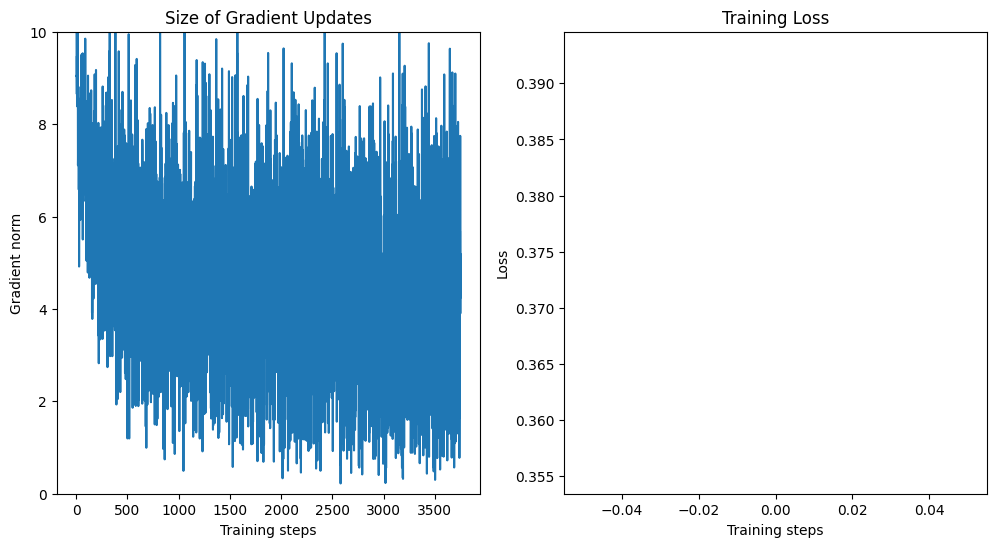

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=4


Epoch 1:   0%|          | 8/3750 [00:00<03:17, 18.95it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.292674


Epoch 1:   3%|▎         | 111/3750 [00:02<00:53, 68.34it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 0.690573


Epoch 1:   6%|▌         | 213/3750 [00:03<00:47, 75.24it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.573176


Epoch 1:   9%|▊         | 322/3750 [00:04<00:33, 100.87it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.773387


Epoch 1:  11%|█         | 416/3750 [00:05<00:33, 99.01it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.685103


Epoch 1:  14%|█▍        | 519/3750 [00:06<00:33, 96.53it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.816626


Epoch 1:  16%|█▋        | 611/3750 [00:07<00:32, 97.15it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.453489


Epoch 1:  19%|█▉        | 711/3750 [00:08<00:32, 93.44it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.439088


Epoch 1:  22%|██▏       | 813/3750 [00:09<00:30, 96.50it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.259308


Epoch 1:  25%|██▍       | 920/3750 [00:10<00:27, 102.93it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.476234


Epoch 1:  27%|██▋       | 1017/3750 [00:11<00:27, 98.36it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.503627


Epoch 1:  30%|██▉       | 1119/3750 [00:13<00:27, 95.90it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.414388


Epoch 1:  32%|███▏      | 1210/3750 [00:14<00:38, 65.66it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.296092


Epoch 1:  35%|███▌      | 1314/3750 [00:16<00:37, 64.87it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.500404


Epoch 1:  38%|███▊      | 1410/3750 [00:17<00:32, 72.47it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.202420


Epoch 1:  40%|████      | 1506/3750 [00:18<00:34, 64.49it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.065468


Epoch 1:  43%|████▎     | 1607/3750 [00:20<00:30, 69.58it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.352643


Epoch 1:  46%|████▌     | 1715/3750 [00:21<00:26, 77.95it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.039033


Epoch 1:  48%|████▊     | 1811/3750 [00:22<00:20, 93.62it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.339446


Epoch 1:  51%|█████     | 1911/3750 [00:24<00:22, 82.14it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.289782


Epoch 1:  54%|█████▎    | 2013/3750 [00:25<00:18, 95.22it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.130662


Epoch 1:  57%|█████▋    | 2119/3750 [00:26<00:16, 97.86it/s] 

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.190888


Epoch 1:  59%|█████▉    | 2220/3750 [00:27<00:16, 92.63it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.512447


Epoch 1:  62%|██████▏   | 2313/3750 [00:28<00:15, 93.02it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.173901


Epoch 1:  64%|██████▍   | 2414/3750 [00:29<00:13, 95.53it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.340742


Epoch 1:  67%|██████▋   | 2517/3750 [00:30<00:12, 99.44it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.189596


Epoch 1:  70%|██████▉   | 2612/3750 [00:31<00:17, 64.56it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.642860


Epoch 1:  72%|███████▏  | 2712/3750 [00:33<00:14, 71.37it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.115255


Epoch 1:  75%|███████▍  | 2809/3750 [00:34<00:14, 64.08it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.109544


Epoch 1:  78%|███████▊  | 2913/3750 [00:36<00:13, 64.26it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.473155


Epoch 1:  80%|████████  | 3013/3750 [00:37<00:11, 65.01it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.429985


Epoch 1:  83%|████████▎ | 3116/3750 [00:39<00:07, 81.66it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.723481


Epoch 1:  86%|████████▌ | 3220/3750 [00:40<00:05, 93.53it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.195522


Epoch 1:  89%|████████▊ | 3320/3750 [00:41<00:04, 95.50it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.214474


Epoch 1:  91%|█████████ | 3420/3750 [00:42<00:03, 95.16it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.032900


Epoch 1:  94%|█████████▎| 3512/3750 [00:43<00:02, 93.73it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.226183


Epoch 1:  96%|█████████▋| 3617/3750 [00:44<00:01, 104.55it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.285207


Epoch 1:  99%|█████████▉| 3711/3750 [00:45<00:00, 95.97it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.116448


Epoch 1: 100%|██████████| 3750/3750 [00:46<00:00, 81.13it/s]


Train set: Avg. loss: 0.3536, Time: 46.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.4 secs

Train loss: 0.35357487980177005, Test loss: 6.108258664608002e-05, Test accuracy: 96.24, Train time: 46.22881627082825, Test time: 2.3998260498046875


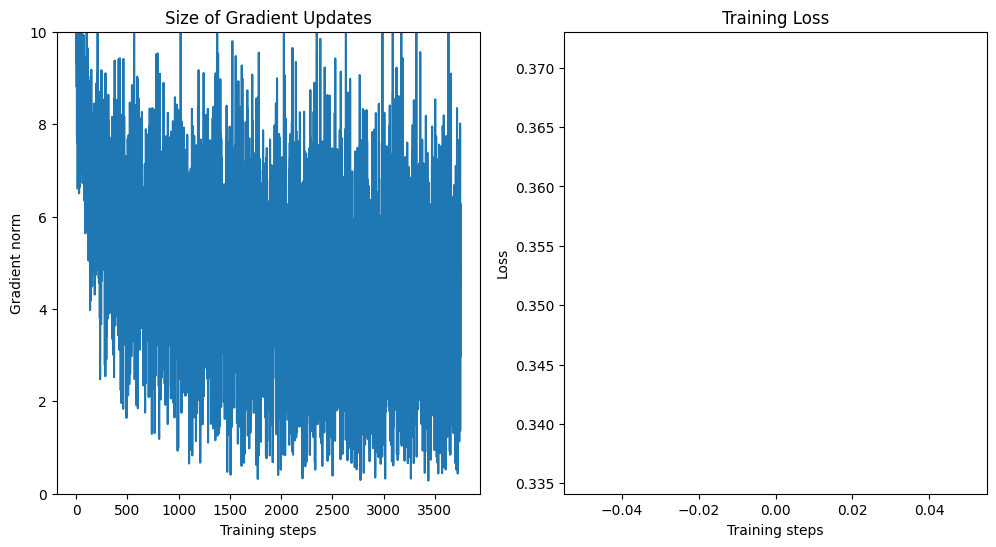

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<09:39,  6.47it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.695149


Epoch 1:   6%|▌         | 216/3750 [00:02<00:41, 85.89it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.235647


Epoch 1:  11%|█         | 417/3750 [00:05<00:42, 78.54it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.668793


Epoch 1:  16%|█▋        | 618/3750 [00:07<00:35, 89.22it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.128695


Epoch 1:  22%|██▏       | 817/3750 [00:09<00:31, 94.38it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.418643


Epoch 1:  27%|██▋       | 1011/3750 [00:11<00:28, 95.34it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.147567


Epoch 1:  32%|███▏      | 1211/3750 [00:14<00:27, 92.23it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.783064


Epoch 1:  38%|███▊      | 1410/3750 [00:16<00:27, 83.61it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.241851


Epoch 1:  43%|████▎     | 1612/3750 [00:18<00:28, 75.10it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.241759


Epoch 1:  48%|████▊     | 1812/3750 [00:21<00:21, 90.73it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.161263


Epoch 1:  54%|█████▎    | 2011/3750 [00:23<00:20, 83.41it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.057871


Epoch 1:  59%|█████▉    | 2218/3750 [00:26<00:17, 89.51it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.072497


Epoch 1:  64%|██████▍   | 2415/3750 [00:28<00:14, 94.40it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.139409


Epoch 1:  70%|██████▉   | 2616/3750 [00:30<00:12, 92.09it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.195511


Epoch 1:  75%|███████▌  | 2815/3750 [00:32<00:10, 92.49it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.159060


Epoch 1:  80%|████████  | 3010/3750 [00:34<00:09, 82.16it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.187745


Epoch 1:  86%|████████▌ | 3210/3750 [00:37<00:06, 87.01it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.416944


Epoch 1:  91%|█████████ | 3414/3750 [00:39<00:04, 74.98it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.118136


Epoch 1:  96%|█████████▋| 3613/3750 [00:42<00:01, 88.86it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.267688


Epoch 1: 100%|██████████| 3750/3750 [00:43<00:00, 85.27it/s]


Train set: Avg. loss: 0.3354, Time: 44.0 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.2 secs

Train loss: 0.3353965878687799, Test loss: 5.1325297355651855e-05, Test accuracy: 96.75, Train time: 43.98232078552246, Test time: 2.2065680027008057


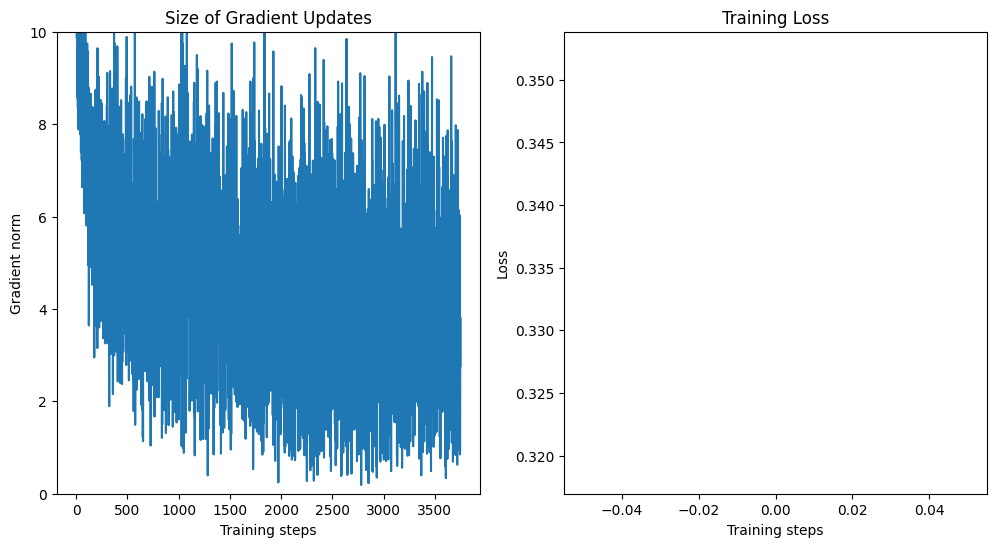

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=2


Epoch 1:   0%|          | 12/3750 [00:00<01:20, 46.39it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.549190


Epoch 1:   6%|▌         | 218/3750 [00:02<00:34, 101.78it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.367920


Epoch 1:  11%|█         | 414/3750 [00:04<00:40, 82.39it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.403597


Epoch 1:  16%|█▋        | 612/3750 [00:07<00:45, 69.45it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.099988


Epoch 1:  22%|██▏       | 816/3750 [00:10<00:40, 72.69it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.538752


Epoch 1:  27%|██▋       | 1018/3750 [00:13<00:32, 85.13it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.786833


Epoch 1:  32%|███▏      | 1218/3750 [00:15<00:25, 97.97it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.246523


Epoch 1:  38%|███▊      | 1419/3750 [00:17<00:22, 104.52it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.732145


Epoch 1:  43%|████▎     | 1619/3750 [00:19<00:21, 101.25it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.121179


Epoch 1:  48%|████▊     | 1814/3750 [00:21<00:19, 100.39it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.098584


Epoch 1:  54%|█████▎    | 2011/3750 [00:23<00:23, 74.12it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.507512


Epoch 1:  59%|█████▉    | 2214/3750 [00:26<00:21, 72.02it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.465077


Epoch 1:  64%|██████▍   | 2411/3750 [00:29<00:20, 64.97it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.329394


Epoch 1:  70%|██████▉   | 2611/3750 [00:31<00:14, 77.43it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.016262


Epoch 1:  75%|███████▌  | 2815/3750 [00:34<00:13, 70.35it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.302550


Epoch 1:  80%|████████  | 3013/3750 [00:37<00:10, 67.75it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.028237


Epoch 1:  86%|████████▌ | 3211/3750 [00:39<00:06, 88.40it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.148734


Epoch 1:  91%|█████████ | 3413/3750 [00:42<00:04, 71.13it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.053500


Epoch 1:  96%|█████████▋| 3610/3750 [00:45<00:01, 73.29it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.395534


Epoch 1: 100%|██████████| 3750/3750 [00:47<00:00, 79.57it/s]


Train set: Avg. loss: 0.3591, Time: 47.1 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.9 secs

Train loss: 0.35909013024220865, Test loss: 5.194399654865265e-05, Test accuracy: 96.78, Train time: 47.1341187953949, Test time: 2.8577005863189697


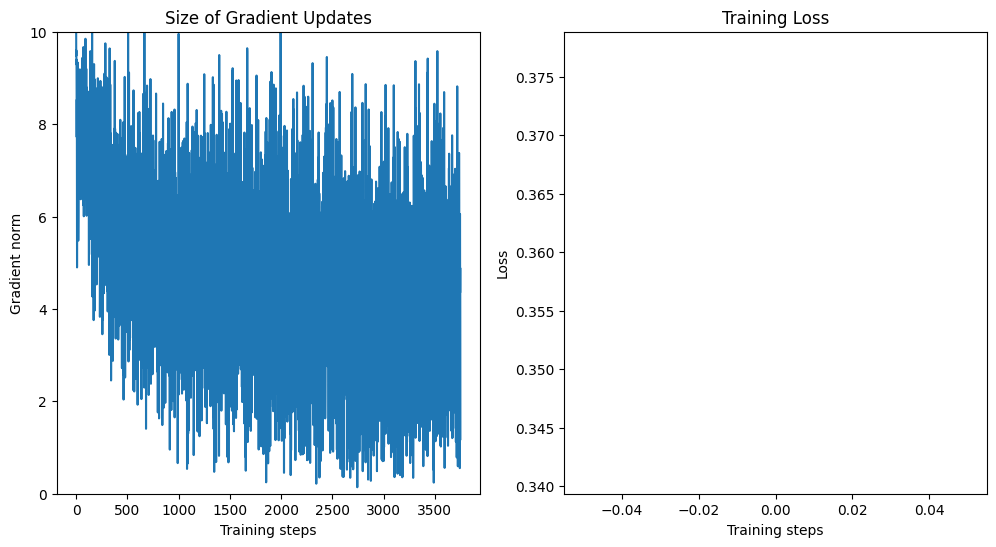

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=4


Epoch 1:   0%|          | 11/3750 [00:00<02:01, 30.87it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.073269


Epoch 1:   6%|▌         | 212/3750 [00:02<00:36, 97.67it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.488700


Epoch 1:  11%|█         | 417/3750 [00:04<00:34, 97.96it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.278774


Epoch 1:  16%|█▋        | 617/3750 [00:06<00:31, 99.09it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.322369


Epoch 1:  22%|██▏       | 810/3750 [00:09<00:44, 66.62it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.604442


Epoch 1:  27%|██▋       | 1009/3750 [00:12<00:37, 72.61it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.169727


Epoch 1:  32%|███▏      | 1211/3750 [00:15<00:31, 80.57it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.162058


Epoch 1:  38%|███▊      | 1418/3750 [00:17<00:24, 95.02it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.289701


Epoch 1:  43%|████▎     | 1613/3750 [00:19<00:21, 100.46it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.098594


Epoch 1:  48%|████▊     | 1811/3750 [00:21<00:18, 102.48it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.840925


Epoch 1:  54%|█████▍    | 2019/3750 [00:23<00:17, 100.06it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.097215


Epoch 1:  59%|█████▉    | 2208/3750 [00:26<00:21, 70.33it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.167575


Epoch 1:  64%|██████▍   | 2409/3750 [00:29<00:19, 68.98it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.792523


Epoch 1:  70%|██████▉   | 2609/3750 [00:32<00:14, 80.06it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.145141


Epoch 1:  75%|███████▌  | 2820/3750 [00:34<00:10, 92.35it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.387815


Epoch 1:  80%|████████  | 3014/3750 [00:36<00:07, 95.05it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.332545


Epoch 1:  86%|████████▌ | 3220/3750 [00:38<00:05, 94.41it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.496724


Epoch 1:  91%|█████████ | 3419/3750 [00:40<00:03, 99.95it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.098204


Epoch 1:  96%|█████████▋| 3613/3750 [00:43<00:02, 63.70it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.378570


Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 81.80it/s]


Train set: Avg. loss: 0.3522, Time: 45.9 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.9 secs

Train loss: 0.35218355312819283, Test loss: 5.887151174247265e-05, Test accuracy: 96.22, Train time: 45.85080909729004, Test time: 2.906501293182373


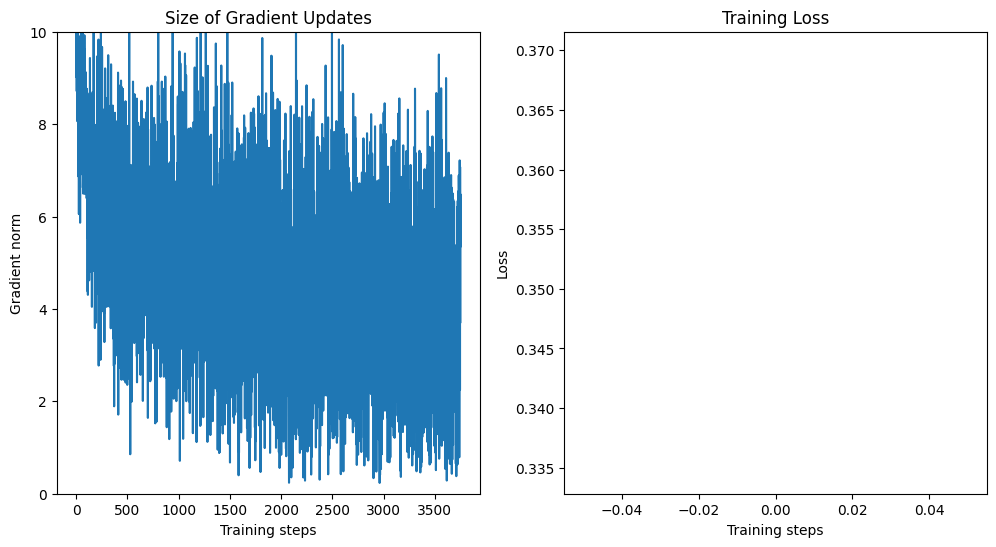

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<09:11,  6.80it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.549166


Epoch 1:  14%|█▍        | 519/3750 [00:05<00:36, 89.65it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.919605


Epoch 1:  27%|██▋       | 1011/3750 [00:11<00:33, 80.82it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.353084


Epoch 1:  40%|████      | 1515/3750 [00:17<00:26, 85.69it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.143316


Epoch 1:  54%|█████▍    | 2019/3750 [00:22<00:18, 95.01it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.234418


Epoch 1:  67%|██████▋   | 2511/3750 [00:28<00:14, 87.04it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.341541


Epoch 1:  80%|████████  | 3011/3750 [00:35<00:08, 91.01it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.084459


Epoch 1:  94%|█████████▍| 3516/3750 [00:40<00:02, 93.10it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.138129


Epoch 1: 100%|██████████| 3750/3750 [00:43<00:00, 86.81it/s]


Train set: Avg. loss: 0.3564, Time: 43.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.6 secs

Train loss: 0.35641730435726543, Test loss: 5.392843633890152e-05, Test accuracy: 96.5, Train time: 43.20448184013367, Test time: 3.568516492843628


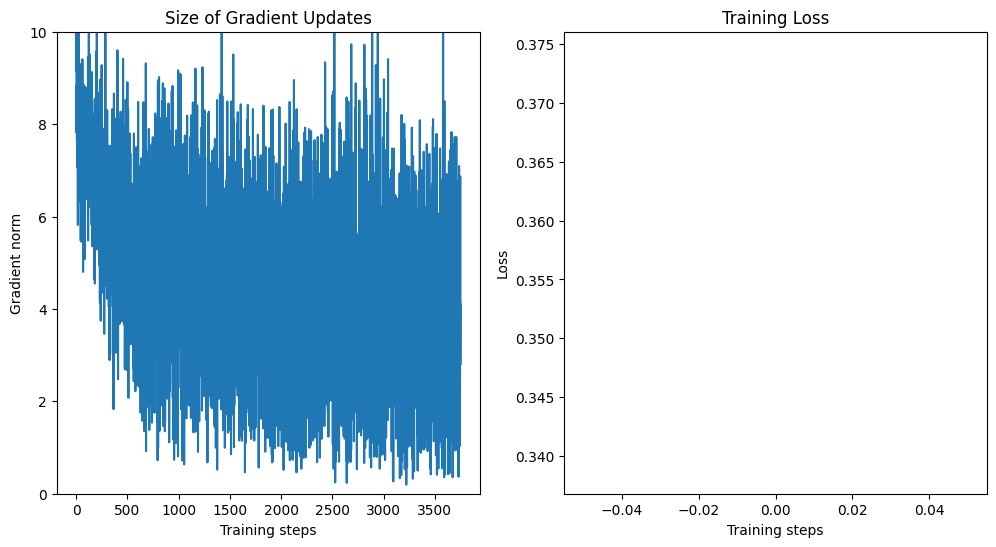

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=2


Epoch 1:   0%|          | 12/3750 [00:00<01:22, 45.49it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.913732


Epoch 1:  14%|█▎        | 513/3750 [00:05<00:32, 98.20it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.811339


Epoch 1:  27%|██▋       | 1012/3750 [00:10<00:36, 74.67it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.476747


Epoch 1:  40%|████      | 1516/3750 [00:17<00:30, 74.09it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.711612


Epoch 1:  54%|█████▎    | 2012/3750 [00:23<00:17, 97.44it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.772259


Epoch 1:  67%|██████▋   | 2513/3750 [00:29<00:16, 77.03it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.627531


Epoch 1:  80%|████████  | 3017/3750 [00:35<00:08, 90.93it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.380136


Epoch 1:  94%|█████████▎| 3515/3750 [00:41<00:02, 99.27it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.084228


Epoch 1: 100%|██████████| 3750/3750 [00:43<00:00, 85.96it/s] 


Train set: Avg. loss: 0.3462, Time: 43.6 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.3461797965073337, Test loss: 6.47648587822914e-05, Test accuracy: 96.11, Train time: 43.634578227996826, Test time: 3.2107412815093994


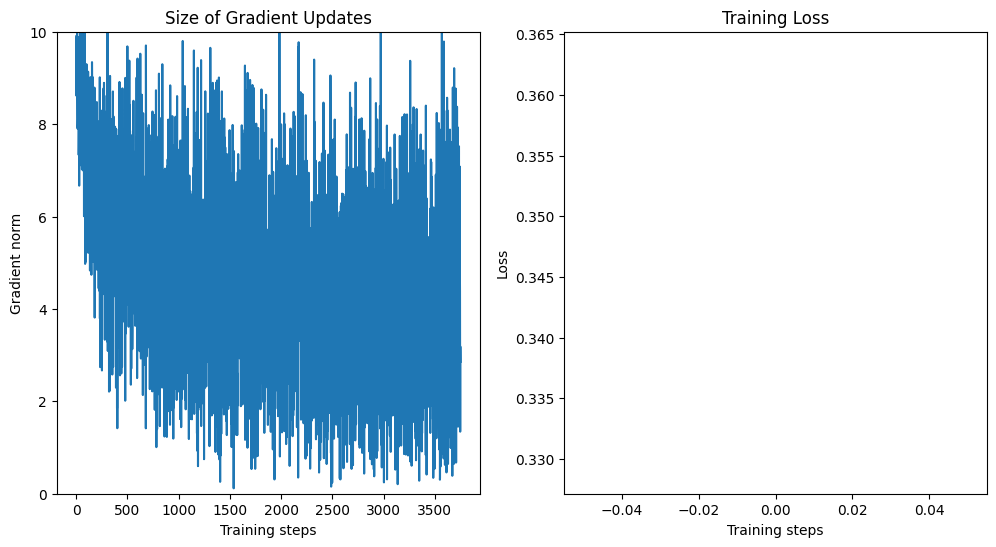

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=4


Epoch 1:   0%|          | 7/3750 [00:00<04:15, 14.68it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.291275


Epoch 1:  14%|█▍        | 519/3750 [00:06<00:32, 98.03it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.947389


Epoch 1:  27%|██▋       | 1012/3750 [00:11<00:27, 99.43it/s] 

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.534494


Epoch 1:  40%|████      | 1511/3750 [00:19<00:34, 64.80it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.042337


Epoch 1:  54%|█████▎    | 2013/3750 [00:24<00:18, 94.92it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.075322


Epoch 1:  67%|██████▋   | 2508/3750 [00:29<00:17, 71.36it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.234143


Epoch 1:  80%|████████  | 3014/3750 [00:37<00:08, 83.13it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.083851


Epoch 1:  94%|█████████▍| 3519/3750 [00:42<00:02, 96.89it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.127014


Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 82.84it/s]


Train set: Avg. loss: 0.3627, Time: 45.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.6 secs

Train loss: 0.36265091376006603, Test loss: 6.390104293823242e-05, Test accuracy: 96.01, Train time: 45.2783203125, Test time: 2.644317626953125


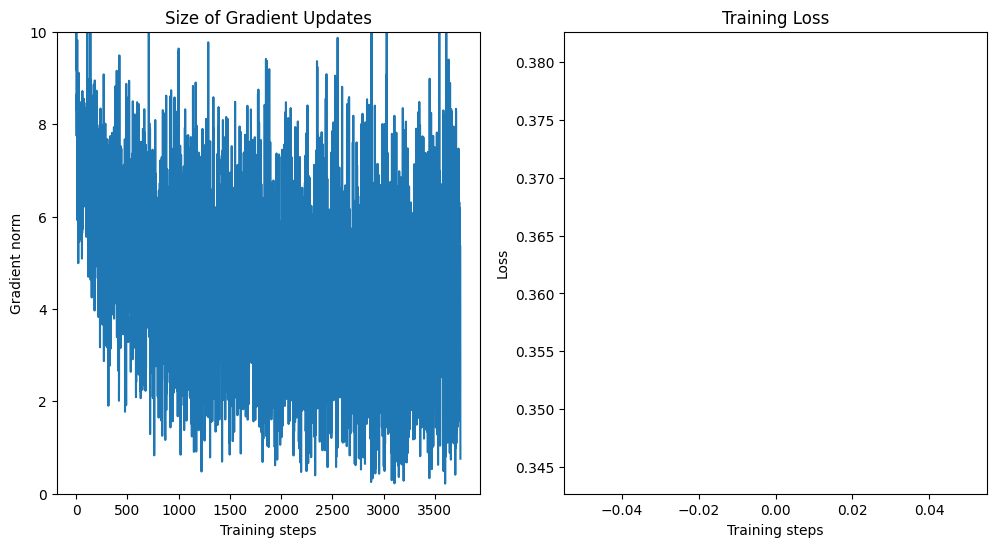

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<10:00,  6.24it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.640776


Epoch 1:   3%|▎         | 114/3750 [00:01<00:45, 79.39it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.056517


Epoch 1:   6%|▌         | 211/3750 [00:02<00:42, 83.98it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.172606


Epoch 1:   8%|▊         | 313/3750 [00:04<00:42, 81.10it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.921723


Epoch 1:  11%|█         | 412/3750 [00:05<00:38, 85.92it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.353752


Epoch 1:  14%|█▎        | 513/3750 [00:06<00:37, 85.63it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.588184


Epoch 1:  16%|█▋        | 611/3750 [00:07<00:34, 90.75it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.963807


Epoch 1:  19%|█▉        | 720/3750 [00:08<00:32, 92.53it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 1.149678


Epoch 1:  22%|██▏       | 820/3750 [00:09<00:31, 92.54it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.139826


Epoch 1:  24%|██▍       | 911/3750 [00:10<00:30, 91.92it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.530511


Epoch 1:  27%|██▋       | 1011/3750 [00:11<00:29, 91.51it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.723714


Epoch 1:  30%|██▉       | 1118/3750 [00:13<00:28, 92.73it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.529050


Epoch 1:  32%|███▏      | 1214/3750 [00:14<00:30, 82.65it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.684621


Epoch 1:  35%|███▌      | 1317/3750 [00:15<00:27, 89.59it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.569021


Epoch 1:  38%|███▊      | 1411/3750 [00:16<00:26, 87.41it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.409344


Epoch 1:  40%|████      | 1510/3750 [00:17<00:26, 85.06it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.794760


Epoch 1:  43%|████▎     | 1611/3750 [00:18<00:24, 85.77it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.858182


Epoch 1:  46%|████▌     | 1716/3750 [00:20<00:24, 81.72it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.743041


Epoch 1:  48%|████▊     | 1814/3750 [00:21<00:24, 79.24it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.372922


Epoch 1:  51%|█████     | 1913/3750 [00:22<00:21, 85.13it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.504156


Epoch 1:  54%|█████▎    | 2013/3750 [00:23<00:19, 86.88it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.464099


Epoch 1:  56%|█████▋    | 2114/3750 [00:24<00:19, 85.47it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.723096


Epoch 1:  59%|█████▉    | 2218/3750 [00:26<00:17, 88.88it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.288692


Epoch 1:  62%|██████▏   | 2317/3750 [00:27<00:16, 87.22it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.449540


Epoch 1:  65%|██████▍   | 2419/3750 [00:28<00:14, 91.46it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.337927


Epoch 1:  67%|██████▋   | 2509/3750 [00:29<00:13, 94.77it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.574790


Epoch 1:  70%|██████▉   | 2619/3750 [00:30<00:11, 95.16it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.573197


Epoch 1:  73%|███████▎  | 2719/3750 [00:31<00:11, 89.20it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.507530


Epoch 1:  75%|███████▌  | 2815/3750 [00:32<00:11, 78.92it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.302490


Epoch 1:  78%|███████▊  | 2917/3750 [00:34<00:10, 83.14it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.301706


Epoch 1:  80%|████████  | 3016/3750 [00:35<00:08, 83.32it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.593533


Epoch 1:  83%|████████▎ | 3115/3750 [00:36<00:08, 79.16it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.297281


Epoch 1:  86%|████████▌ | 3210/3750 [00:37<00:06, 80.43it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.425824


Epoch 1:  88%|████████▊ | 3307/3750 [00:39<00:05, 76.83it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.793546


Epoch 1:  91%|█████████ | 3417/3750 [00:40<00:04, 82.34it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.116353


Epoch 1:  94%|█████████▎| 3512/3750 [00:41<00:03, 75.73it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.341996


Epoch 1:  96%|█████████▋| 3618/3750 [00:42<00:01, 83.26it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.773157


Epoch 1:  99%|█████████▉| 3709/3750 [00:44<00:00, 86.34it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.379702


Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 83.93it/s]


Train set: Avg. loss: 0.7843, Time: 44.7 secs 




Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.784264899707834, Test loss: 0.00010663571357727051, Test accuracy: 94.04, Train time: 44.69112753868103, Test time: 3.184109926223755


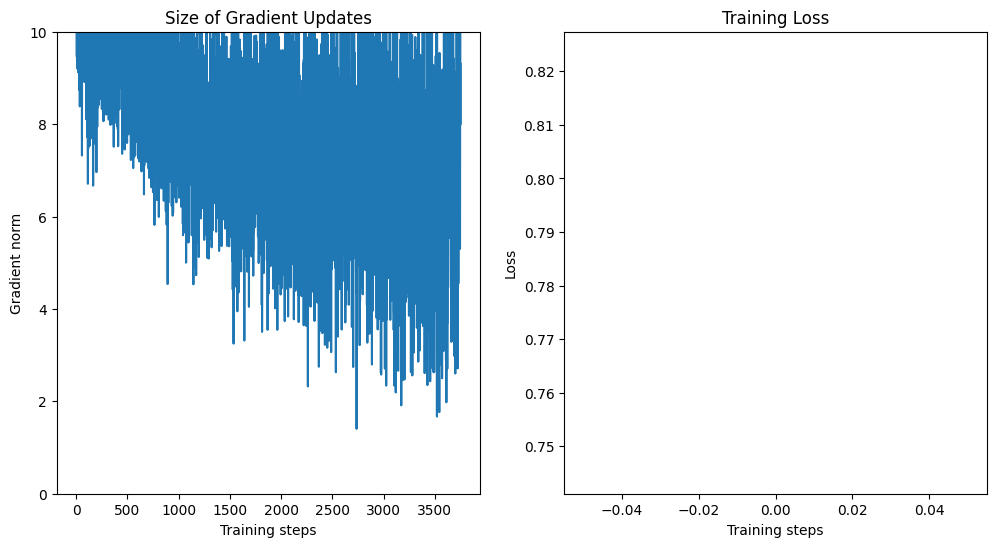

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 9/3750 [00:00<01:45, 35.39it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.432774


Epoch 1:   3%|▎         | 117/3750 [00:01<00:39, 91.65it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.183745


Epoch 1:   6%|▌         | 212/3750 [00:02<00:51, 68.75it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.578558


Epoch 1:   8%|▊         | 312/3750 [00:04<00:48, 70.30it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.197096


Epoch 1:  11%|█         | 412/3750 [00:05<00:52, 64.01it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.532267


Epoch 1:  14%|█▎        | 511/3750 [00:07<00:45, 70.65it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.427748


Epoch 1:  16%|█▋        | 612/3750 [00:08<00:44, 70.48it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.953012


Epoch 1:  19%|█▉        | 715/3750 [00:09<00:34, 87.45it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.637203


Epoch 1:  22%|██▏       | 811/3750 [00:11<00:32, 91.78it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.999387


Epoch 1:  24%|██▍       | 914/3750 [00:12<00:33, 85.53it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.007046


Epoch 1:  27%|██▋       | 1015/3750 [00:13<00:33, 81.05it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.819233


Epoch 1:  30%|██▉       | 1111/3750 [00:14<00:29, 90.28it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.890872


Epoch 1:  32%|███▏      | 1209/3750 [00:15<00:27, 92.31it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.875967


Epoch 1:  35%|███▌      | 1314/3750 [00:16<00:24, 98.95it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.470225


Epoch 1:  38%|███▊      | 1420/3750 [00:17<00:24, 96.10it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.307284


Epoch 1:  40%|████      | 1514/3750 [00:18<00:23, 93.96it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.659799


Epoch 1:  43%|████▎     | 1613/3750 [00:20<00:32, 65.20it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.581932


Epoch 1:  46%|████▌     | 1712/3750 [00:21<00:28, 71.61it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.601648


Epoch 1:  48%|████▊     | 1809/3750 [00:23<00:28, 68.16it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.585193


Epoch 1:  51%|█████     | 1913/3750 [00:24<00:23, 78.23it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.487727


Epoch 1:  54%|█████▎    | 2008/3750 [00:25<00:24, 71.80it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.954236


Epoch 1:  56%|█████▋    | 2115/3750 [00:27<00:20, 80.11it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.304755


Epoch 1:  59%|█████▉    | 2217/3750 [00:28<00:18, 83.96it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.579814


Epoch 1:  62%|██████▏   | 2314/3750 [00:29<00:16, 88.32it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.414288


Epoch 1:  64%|██████▍   | 2415/3750 [00:30<00:15, 85.88it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.371157


Epoch 1:  67%|██████▋   | 2512/3750 [00:31<00:14, 83.51it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.544659


Epoch 1:  70%|██████▉   | 2616/3750 [00:33<00:12, 92.71it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.536527


Epoch 1:  73%|███████▎  | 2719/3750 [00:34<00:11, 91.89it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.432110


Epoch 1:  75%|███████▍  | 2811/3750 [00:35<00:09, 96.46it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.382395


Epoch 1:  78%|███████▊  | 2915/3750 [00:36<00:08, 94.12it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.160440


Epoch 1:  80%|████████  | 3013/3750 [00:37<00:09, 74.44it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.483033


Epoch 1:  83%|████████▎ | 3111/3750 [00:38<00:08, 76.14it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.345349


Epoch 1:  86%|████████▌ | 3214/3750 [00:40<00:07, 73.52it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.340120


Epoch 1:  88%|████████▊ | 3314/3750 [00:41<00:05, 77.21it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.496680


Epoch 1:  91%|█████████ | 3417/3750 [00:43<00:04, 76.88it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.600363


Epoch 1:  94%|█████████▎| 3508/3750 [00:44<00:02, 84.79it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.183133


Epoch 1:  96%|█████████▋| 3612/3750 [00:45<00:01, 90.00it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.661664


Epoch 1:  99%|█████████▉| 3715/3750 [00:46<00:00, 85.78it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.136887


Epoch 1: 100%|██████████| 3750/3750 [00:47<00:00, 79.56it/s]



Train set: Avg. loss: 0.7600, Time: 47.2 secs 


Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 2.5 secs

Train loss: 0.7599857047587633, Test loss: 0.00010069326311349869, Test accuracy: 94.42, Train time: 47.153807640075684, Test time: 2.490145206451416


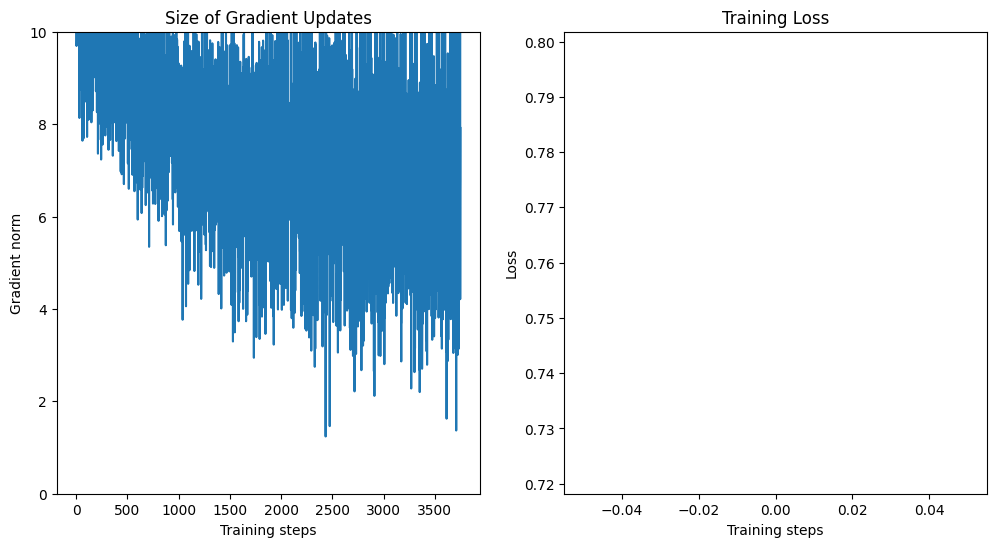

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 11/3750 [00:00<02:03, 30.25it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.862990


Epoch 1:   3%|▎         | 117/3750 [00:01<00:40, 90.40it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.282659


Epoch 1:   6%|▌         | 214/3750 [00:02<00:38, 92.28it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.843843


Epoch 1:   8%|▊         | 313/3750 [00:03<00:36, 92.99it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.815089


Epoch 1:  11%|█         | 410/3750 [00:04<00:39, 84.32it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.169375


Epoch 1:  14%|█▎        | 512/3750 [00:06<00:46, 69.47it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.159249


Epoch 1:  16%|█▋        | 611/3750 [00:08<00:51, 60.60it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.169823


Epoch 1:  19%|█▉        | 714/3750 [00:09<00:46, 65.52it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.708284


Epoch 1:  22%|██▏       | 809/3750 [00:11<00:42, 69.48it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.125588


Epoch 1:  24%|██▍       | 913/3750 [00:12<00:39, 71.45it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.152711


Epoch 1:  27%|██▋       | 1015/3750 [00:13<00:34, 80.05it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.509111


Epoch 1:  30%|██▉       | 1118/3750 [00:15<00:30, 86.67it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.824339


Epoch 1:  32%|███▏      | 1216/3750 [00:16<00:27, 92.31it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.912832


Epoch 1:  35%|███▌      | 1317/3750 [00:17<00:28, 84.25it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.836888


Epoch 1:  38%|███▊      | 1413/3750 [00:18<00:24, 95.59it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.769329


Epoch 1:  40%|████      | 1513/3750 [00:19<00:23, 94.14it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.057018


Epoch 1:  43%|████▎     | 1615/3750 [00:20<00:22, 92.95it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.280112


Epoch 1:  46%|████▌     | 1716/3750 [00:21<00:21, 92.94it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.799704


Epoch 1:  48%|████▊     | 1810/3750 [00:22<00:26, 72.26it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.667938


Epoch 1:  51%|█████     | 1915/3750 [00:24<00:25, 73.24it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.449708


Epoch 1:  54%|█████▎    | 2012/3750 [00:25<00:27, 63.15it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.531565


Epoch 1:  56%|█████▌    | 2107/3750 [00:27<00:27, 60.53it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.455596


Epoch 1:  59%|█████▉    | 2210/3750 [00:29<00:23, 65.42it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.313293


Epoch 1:  62%|██████▏   | 2314/3750 [00:30<00:17, 81.99it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.568231


Epoch 1:  64%|██████▍   | 2418/3750 [00:31<00:15, 87.00it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.371962


Epoch 1:  67%|██████▋   | 2511/3750 [00:32<00:15, 82.01it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.253523


Epoch 1:  70%|██████▉   | 2615/3750 [00:33<00:13, 86.78it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.258396


Epoch 1:  72%|███████▏  | 2717/3750 [00:35<00:12, 85.49it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.494877


Epoch 1:  75%|███████▌  | 2819/3750 [00:36<00:10, 86.97it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.262759


Epoch 1:  78%|███████▊  | 2909/3750 [00:37<00:09, 86.76it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.050084


Epoch 1:  80%|████████  | 3013/3750 [00:38<00:07, 95.08it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.252051


Epoch 1:  83%|████████▎ | 3114/3750 [00:39<00:06, 91.84it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.824525


Epoch 1:  86%|████████▌ | 3211/3750 [00:40<00:07, 72.29it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.636664


Epoch 1:  88%|████████▊ | 3311/3750 [00:42<00:06, 69.29it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.579431


Epoch 1:  91%|█████████ | 3412/3750 [00:43<00:05, 65.21it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.505654


Epoch 1:  94%|█████████▎| 3512/3750 [00:45<00:03, 62.88it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.260390


Epoch 1:  96%|█████████▋| 3613/3750 [00:47<00:02, 65.77it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.490673


Epoch 1:  99%|█████████▉| 3717/3750 [00:48<00:00, 82.15it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.316045


Epoch 1: 100%|██████████| 3750/3750 [00:48<00:00, 76.53it/s]


Train set: Avg. loss: 0.7799, Time: 49.0 secs 




Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 2.6 secs

Train loss: 0.7798928762396177, Test loss: 0.00010920145213603974, Test accuracy: 93.98, Train time: 49.01453423500061, Test time: 2.6151010990142822


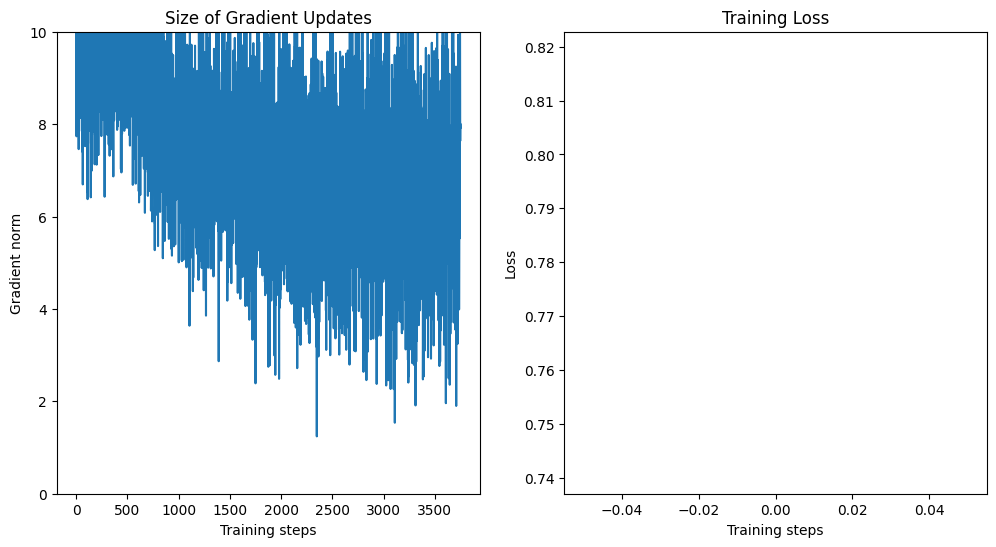

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<07:55,  7.88it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.183796


Epoch 1:   6%|▌         | 213/3750 [00:02<00:39, 89.20it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.913276


Epoch 1:  11%|█         | 418/3750 [00:04<00:36, 92.32it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.970195


Epoch 1:  16%|█▋        | 617/3750 [00:07<00:38, 82.27it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.144192


Epoch 1:  22%|██▏       | 814/3750 [00:09<00:40, 72.58it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.014026


Epoch 1:  27%|██▋       | 1010/3750 [00:12<00:37, 73.38it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.746681


Epoch 1:  32%|███▏      | 1211/3750 [00:14<00:29, 87.26it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.825022


Epoch 1:  38%|███▊      | 1420/3750 [00:17<00:25, 90.26it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.739389


Epoch 1:  43%|████▎     | 1614/3750 [00:19<00:23, 90.05it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.363297


Epoch 1:  48%|████▊     | 1818/3750 [00:21<00:21, 90.73it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.659362


Epoch 1:  54%|█████▎    | 2012/3750 [00:24<00:21, 80.61it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.527261


Epoch 1:  59%|█████▉    | 2216/3750 [00:26<00:18, 83.21it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.406409


Epoch 1:  64%|██████▍   | 2415/3750 [00:28<00:15, 85.48it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.483356


Epoch 1:  70%|██████▉   | 2611/3750 [00:31<00:14, 78.62it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.350223


Epoch 1:  75%|███████▌  | 2815/3750 [00:33<00:11, 84.15it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.244678


Epoch 1:  80%|████████  | 3015/3750 [00:36<00:08, 82.77it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.912992


Epoch 1:  86%|████████▌ | 3213/3750 [00:38<00:06, 81.43it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.703747


Epoch 1:  91%|█████████ | 3416/3750 [00:40<00:03, 89.24it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.434673


Epoch 1:  96%|█████████▋| 3616/3750 [00:43<00:01, 87.74it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.404514


Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 82.83it/s]


Train set: Avg. loss: 0.8341, Time: 45.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.8340550131519635, Test loss: 0.00010132695734500885, Test accuracy: 94.14, Train time: 45.28291416168213, Test time: 3.163618564605713


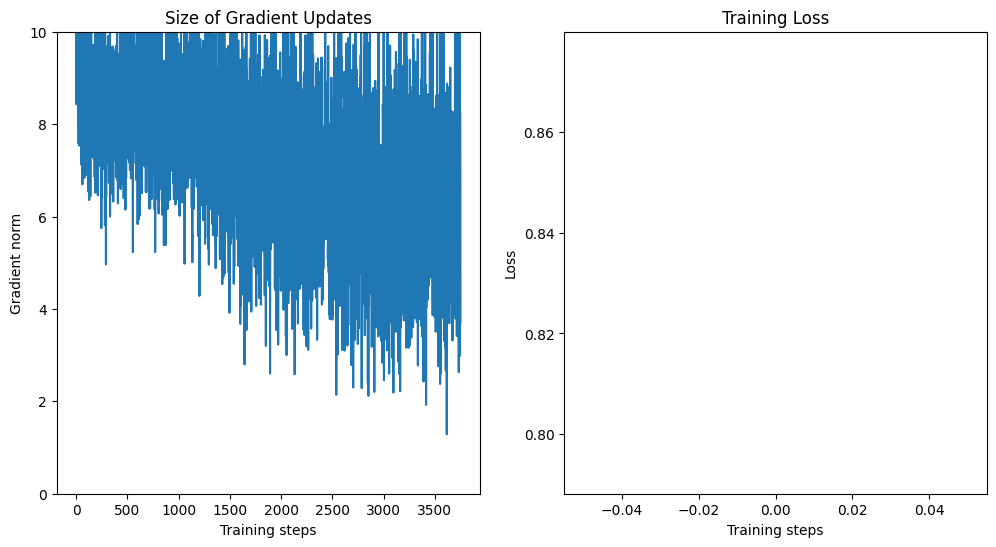

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 8/3750 [00:00<02:05, 29.83it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.211083


Epoch 1:   6%|▌         | 219/3750 [00:02<00:37, 95.06it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.849010


Epoch 1:  11%|█         | 412/3750 [00:04<00:34, 97.50it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.905103


Epoch 1:  16%|█▋        | 617/3750 [00:06<00:34, 91.78it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.209355


Epoch 1:  22%|██▏       | 811/3750 [00:09<00:31, 93.22it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.391353


Epoch 1:  27%|██▋       | 1013/3750 [00:11<00:36, 75.93it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.857492


Epoch 1:  32%|███▏      | 1211/3750 [00:14<00:37, 67.46it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.634832


Epoch 1:  38%|███▊      | 1413/3750 [00:17<00:30, 76.67it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.450087


Epoch 1:  43%|████▎     | 1609/3750 [00:19<00:24, 86.99it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.182250


Epoch 1:  48%|████▊     | 1810/3750 [00:21<00:22, 85.21it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.476741


Epoch 1:  54%|█████▎    | 2010/3750 [00:24<00:19, 87.59it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.672956


Epoch 1:  59%|█████▉    | 2212/3750 [00:26<00:16, 94.00it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.589193


Epoch 1:  64%|██████▍   | 2409/3750 [00:29<00:18, 71.64it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.432715


Epoch 1:  70%|██████▉   | 2610/3750 [00:32<00:16, 68.52it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.677497


Epoch 1:  75%|███████▌  | 2816/3750 [00:34<00:11, 80.58it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.563036


Epoch 1:  80%|████████  | 3012/3750 [00:37<00:08, 83.00it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.380621


Epoch 1:  86%|████████▌ | 3218/3750 [00:39<00:05, 88.71it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.448014


Epoch 1:  91%|█████████ | 3415/3750 [00:41<00:03, 93.03it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.610281


Epoch 1:  96%|█████████▋| 3617/3750 [00:44<00:01, 87.71it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.474971


Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 81.65it/s]


Train set: Avg. loss: 0.7832, Time: 45.9 secs 




Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.7831777816454569, Test loss: 0.00010774737298488616, Test accuracy: 93.9, Train time: 45.939956188201904, Test time: 3.245856285095215


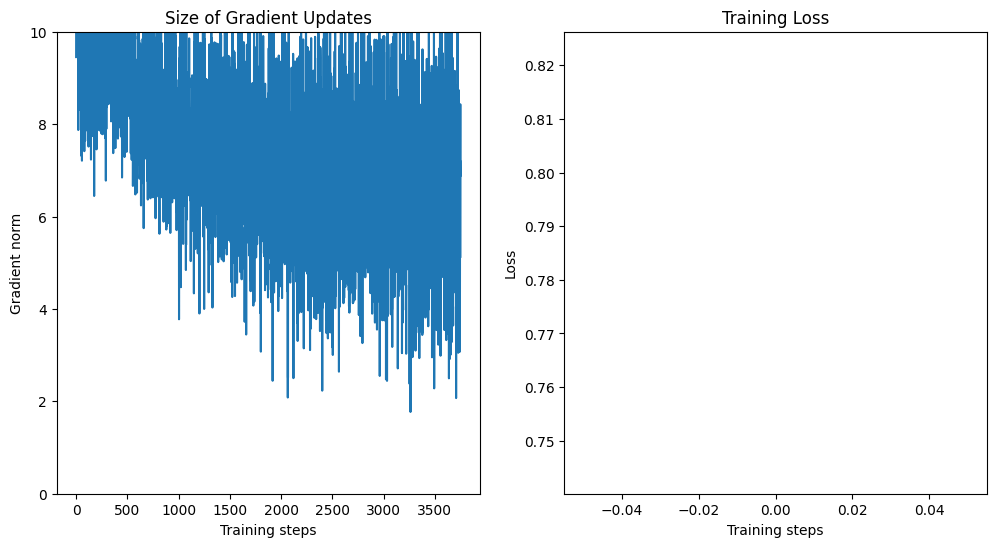

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 9/3750 [00:00<02:32, 24.52it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.575524


Epoch 1:   6%|▌         | 218/3750 [00:02<00:40, 87.33it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.929527


Epoch 1:  11%|█         | 417/3750 [00:05<00:37, 89.70it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.609307


Epoch 1:  16%|█▋        | 615/3750 [00:07<00:35, 89.08it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.529090


Epoch 1:  22%|██▏       | 811/3750 [00:09<00:36, 81.45it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.536270


Epoch 1:  27%|██▋       | 1010/3750 [00:12<00:41, 66.04it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.718903


Epoch 1:  32%|███▏      | 1211/3750 [00:15<00:40, 63.26it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.634858


Epoch 1:  38%|███▊      | 1410/3750 [00:18<00:29, 78.73it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.637441


Epoch 1:  43%|████▎     | 1610/3750 [00:21<00:25, 83.26it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.373184


Epoch 1:  48%|████▊     | 1813/3750 [00:23<00:22, 86.26it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.268348


Epoch 1:  54%|█████▍    | 2018/3750 [00:25<00:18, 92.46it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.240868


Epoch 1:  59%|█████▉    | 2208/3750 [00:28<00:18, 85.28it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.864483


Epoch 1:  64%|██████▍   | 2409/3750 [00:31<00:19, 67.47it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.515516


Epoch 1:  70%|██████▉   | 2609/3750 [00:34<00:17, 65.98it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.118182


Epoch 1:  75%|███████▍  | 2809/3750 [00:36<00:11, 82.06it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.963487


Epoch 1:  80%|████████  | 3006/3750 [00:39<00:11, 62.73it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.686568


Epoch 1:  85%|████████▌ | 3206/3750 [00:42<00:08, 65.35it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.239766


Epoch 1:  91%|█████████ | 3416/3750 [00:45<00:04, 75.74it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.132841


Epoch 1:  96%|█████████▋| 3612/3750 [00:48<00:02, 67.45it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.317390


Epoch 1: 100%|██████████| 3750/3750 [00:51<00:00, 73.09it/s]


Train set: Avg. loss: 0.7085, Time: 51.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 95%, Time: 3.8 secs

Train loss: 0.7085316610097885, Test loss: 9.415629953145981e-05, Test accuracy: 94.76, Train time: 51.31846880912781, Test time: 3.8067500591278076


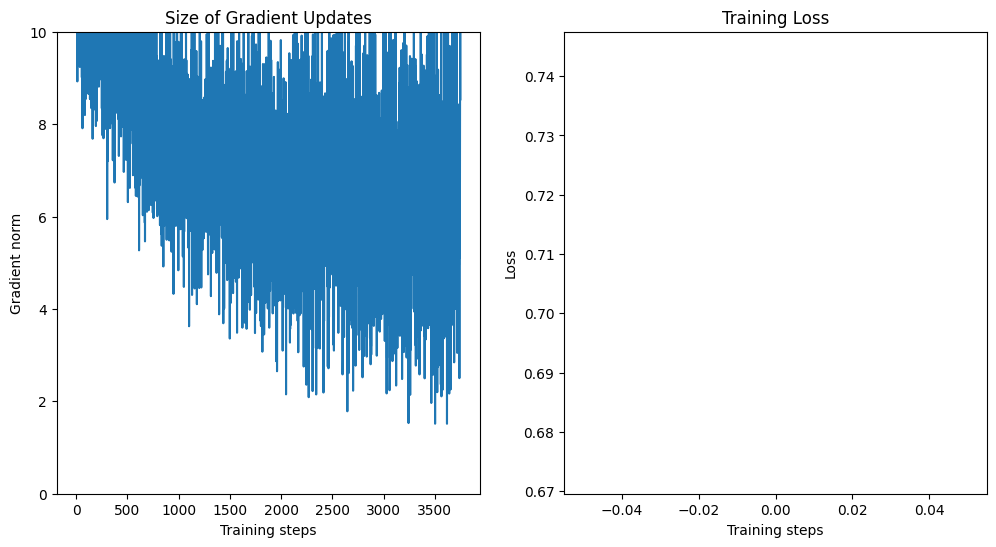

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<09:24,  6.64it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.038565


Epoch 1:  14%|█▎        | 512/3750 [00:05<00:34, 92.77it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.359539


Epoch 1:  27%|██▋       | 1015/3750 [00:12<00:32, 83.65it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.608230


Epoch 1:  40%|████      | 1515/3750 [00:18<00:26, 85.41it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.695969


Epoch 1:  54%|█████▍    | 2018/3750 [00:24<00:18, 92.11it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.405255


Epoch 1:  67%|██████▋   | 2513/3750 [00:30<00:16, 73.46it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.623481


Epoch 1:  80%|████████  | 3014/3750 [00:36<00:08, 83.67it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.472364


Epoch 1:  94%|█████████▎| 3512/3750 [00:42<00:02, 91.60it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.406221


Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 83.08it/s]


Train set: Avg. loss: 0.7830, Time: 45.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.782998846206069, Test loss: 0.00010699976980686187, Test accuracy: 93.98, Train time: 45.150246381759644, Test time: 3.2099809646606445


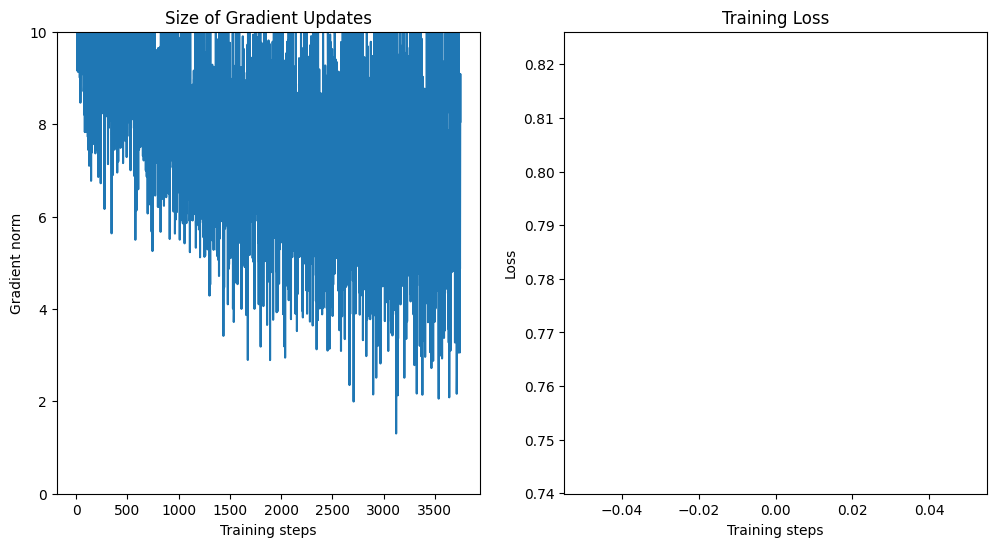

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 17/3750 [00:00<01:11, 52.41it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.427909


Epoch 1:  14%|█▎        | 513/3750 [00:05<00:35, 92.44it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.323260


Epoch 1:  27%|██▋       | 1008/3750 [00:11<00:38, 70.81it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.294713


Epoch 1:  40%|████      | 1517/3750 [00:18<00:26, 82.78it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.410448


Epoch 1:  54%|█████▍    | 2018/3750 [00:24<00:19, 90.83it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.546784


Epoch 1:  67%|██████▋   | 2509/3750 [00:30<00:17, 72.90it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.407112


Epoch 1:  80%|████████  | 3017/3750 [00:37<00:08, 86.92it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.314467


Epoch 1:  94%|█████████▍| 3516/3750 [00:42<00:02, 84.30it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.069312


Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 82.18it/s]


Train set: Avg. loss: 0.7166, Time: 45.6 secs 




Test set: Avg. loss: 0.0001, Accuracy: 95%, Time: 3.3 secs

Train loss: 0.7166032838026682, Test loss: 9.666913896799087e-05, Test accuracy: 94.57, Train time: 45.64493155479431, Test time: 3.302941083908081


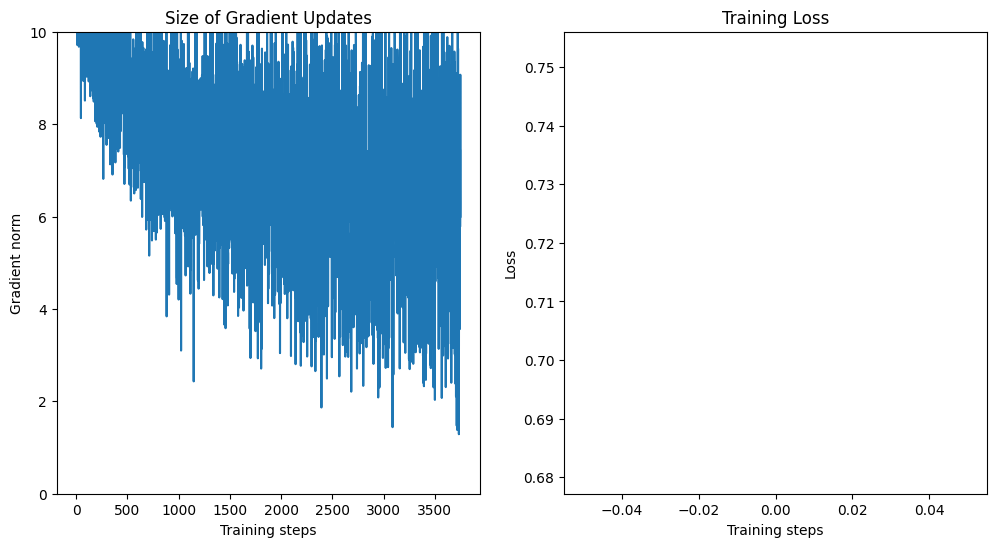

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 11/3750 [00:00<02:08, 29.11it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.252754


Epoch 1:  14%|█▎        | 508/3750 [00:06<00:38, 84.55it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.566283


Epoch 1:  27%|██▋       | 1006/3750 [00:12<00:43, 62.54it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.944368


Epoch 1:  40%|████      | 1511/3750 [00:20<00:27, 81.16it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.465505


Epoch 1:  54%|█████▍    | 2016/3750 [00:25<00:18, 91.71it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.377839


Epoch 1:  67%|██████▋   | 2508/3750 [00:32<00:17, 69.40it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.333335


Epoch 1:  80%|████████  | 3010/3750 [00:39<00:09, 76.96it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.789217


Epoch 1:  94%|█████████▎| 3514/3750 [00:45<00:03, 72.56it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.283600


Epoch 1: 100%|██████████| 3750/3750 [00:49<00:00, 76.19it/s]


Train set: Avg. loss: 0.7965, Time: 49.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.7965280178894599, Test loss: 0.00010703759044408798, Test accuracy: 93.95, Train time: 49.228102684020996, Test time: 3.216836929321289


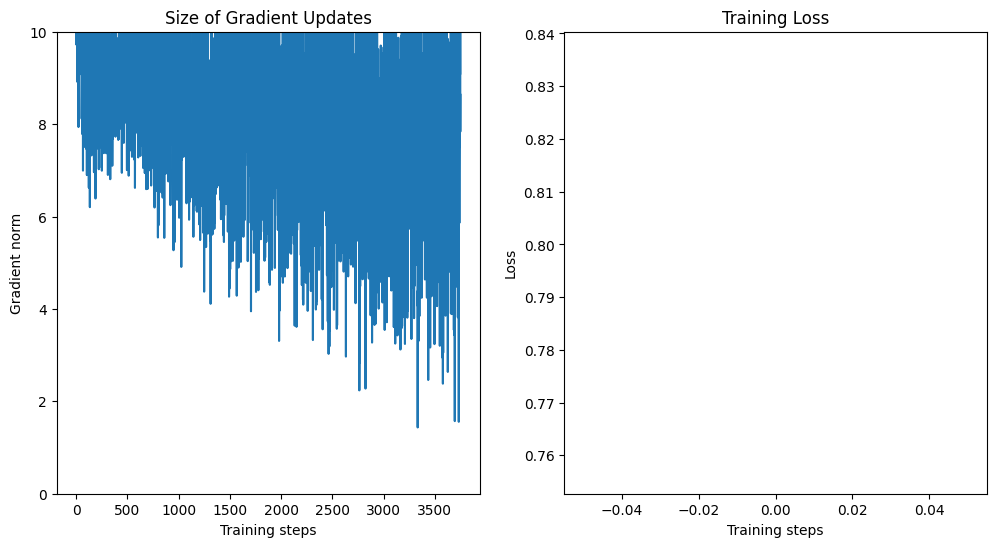

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<08:59,  6.95it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.632798


Epoch 1:   3%|▎         | 114/3750 [00:01<00:41, 86.65it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.654079


Epoch 1:   6%|▌         | 216/3750 [00:02<00:40, 88.16it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.635979


Epoch 1:   8%|▊         | 312/3750 [00:03<00:39, 86.40it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.539674


Epoch 1:  11%|█         | 413/3750 [00:04<00:39, 84.27it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.356336


Epoch 1:  14%|█▍        | 516/3750 [00:06<00:36, 89.12it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.130945


Epoch 1:  16%|█▋        | 618/3750 [00:07<00:36, 86.81it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.250979


Epoch 1:  19%|█▉        | 713/3750 [00:08<00:32, 92.75it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.151265


Epoch 1:  22%|██▏       | 813/3750 [00:09<00:36, 79.84it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.198962


Epoch 1:  24%|██▍       | 912/3750 [00:10<00:37, 75.15it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.421937


Epoch 1:  27%|██▋       | 1011/3750 [00:12<00:34, 78.99it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.353613


Epoch 1:  30%|██▉       | 1110/3750 [00:13<00:30, 85.37it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.044241


Epoch 1:  32%|███▏      | 1218/3750 [00:14<00:30, 83.01it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.736209


Epoch 1:  35%|███▍      | 1309/3750 [00:15<00:28, 84.31it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.043679


Epoch 1:  38%|███▊      | 1412/3750 [00:17<00:30, 77.20it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.059883


Epoch 1:  40%|████      | 1511/3750 [00:18<00:26, 83.43it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.021134


Epoch 1:  43%|████▎     | 1610/3750 [00:19<00:25, 84.76it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.812004


Epoch 1:  46%|████▌     | 1709/3750 [00:20<00:24, 83.89it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.131481


Epoch 1:  48%|████▊     | 1817/3750 [00:22<00:23, 83.87it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.126993


Epoch 1:  51%|█████     | 1916/3750 [00:23<00:22, 81.43it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.856941


Epoch 1:  54%|█████▎    | 2015/3750 [00:24<00:21, 81.49it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.958755


Epoch 1:  56%|█████▋    | 2114/3750 [00:25<00:20, 80.03it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.659798


Epoch 1:  59%|█████▉    | 2215/3750 [00:26<00:17, 86.02it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.717641


Epoch 1:  62%|██████▏   | 2310/3750 [00:28<00:17, 83.65it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 2.081288


Epoch 1:  64%|██████▍   | 2418/3750 [00:29<00:15, 85.74it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.615340


Epoch 1:  67%|██████▋   | 2508/3750 [00:30<00:16, 75.50it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.880656


Epoch 1:  70%|██████▉   | 2610/3750 [00:31<00:15, 72.98it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.579297


Epoch 1:  72%|███████▏  | 2716/3750 [00:33<00:11, 86.68it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.667525


Epoch 1:  75%|███████▍  | 2808/3750 [00:34<00:11, 80.76it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.855836


Epoch 1:  78%|███████▊  | 2914/3750 [00:35<00:10, 81.60it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.801315


Epoch 1:  80%|████████  | 3015/3750 [00:36<00:08, 86.54it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.497157


Epoch 1:  83%|████████▎ | 3115/3750 [00:37<00:07, 88.15it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.564851


Epoch 1:  86%|████████▌ | 3216/3750 [00:39<00:06, 82.36it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.583275


Epoch 1:  88%|████████▊ | 3316/3750 [00:40<00:05, 80.18it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 2.086020


Epoch 1:  91%|█████████ | 3415/3750 [00:41<00:04, 81.84it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.727050


Epoch 1:  94%|█████████▎| 3514/3750 [00:42<00:02, 84.51it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.314459


Epoch 1:  96%|█████████▋| 3613/3750 [00:43<00:01, 80.50it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.418481


Epoch 1:  99%|█████████▉| 3713/3750 [00:45<00:00, 84.87it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.765454


Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 81.92it/s]


Train set: Avg. loss: 2.0111, Time: 45.8 secs 




Test set: Avg. loss: 0.0007, Accuracy: 60%, Time: 3.6 secs

Train loss: 2.0110711855093637, Test loss: 0.0006501040458679199, Test accuracy: 60.31, Train time: 45.79369878768921, Test time: 3.582636594772339


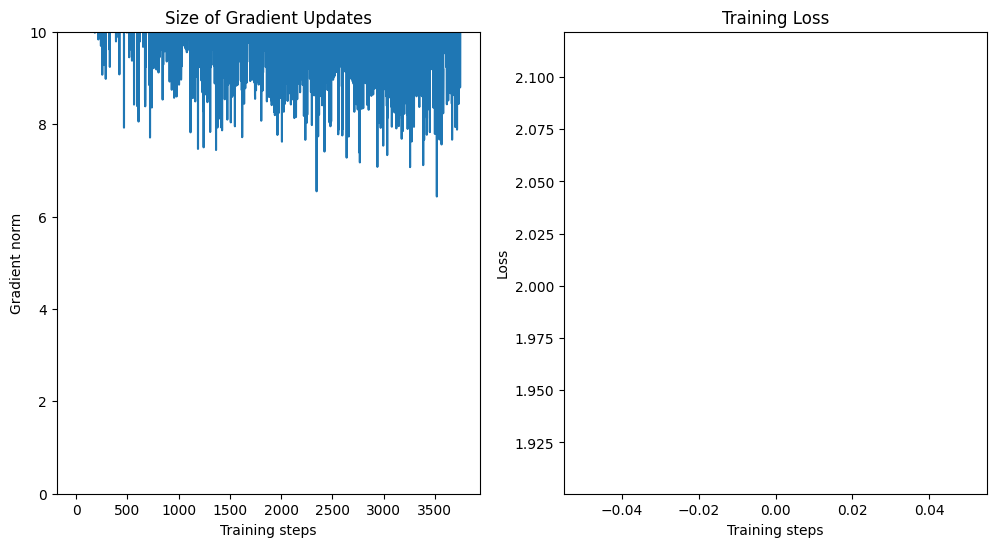

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 6/3750 [00:00<02:52, 21.70it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.857183


Epoch 1:   3%|▎         | 109/3750 [00:01<00:52, 69.64it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.833416


Epoch 1:   6%|▌         | 214/3750 [00:03<00:40, 86.73it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.396137


Epoch 1:   8%|▊         | 313/3750 [00:04<00:42, 81.04it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.528658


Epoch 1:  11%|█         | 414/3750 [00:05<00:39, 83.55it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.316753


Epoch 1:  14%|█▎        | 510/3750 [00:06<00:36, 88.55it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.608676


Epoch 1:  16%|█▋        | 615/3750 [00:07<00:36, 85.18it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.302611


Epoch 1:  19%|█▉        | 717/3750 [00:09<00:35, 86.56it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.209777


Epoch 1:  22%|██▏       | 810/3750 [00:10<00:33, 87.90it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.294041


Epoch 1:  24%|██▍       | 909/3750 [00:11<00:42, 66.26it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.461550


Epoch 1:  27%|██▋       | 1011/3750 [00:12<00:36, 74.14it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.360221


Epoch 1:  30%|██▉       | 1108/3750 [00:14<00:35, 73.68it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.358776


Epoch 1:  32%|███▏      | 1213/3750 [00:15<00:34, 72.61it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.213245


Epoch 1:  35%|███▍      | 1309/3750 [00:17<00:34, 71.63it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.441953


Epoch 1:  38%|███▊      | 1416/3750 [00:18<00:29, 79.61it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.137712


Epoch 1:  40%|████      | 1512/3750 [00:19<00:32, 69.59it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.115382


Epoch 1:  43%|████▎     | 1612/3750 [00:21<00:29, 72.71it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.373067


Epoch 1:  46%|████▌     | 1712/3750 [00:22<00:29, 69.15it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.170192


Epoch 1:  48%|████▊     | 1814/3750 [00:24<00:23, 82.51it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.207439


Epoch 1:  51%|█████     | 1916/3750 [00:25<00:22, 82.73it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.744274


Epoch 1:  54%|█████▍    | 2016/3750 [00:26<00:21, 82.31it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.964412


Epoch 1:  56%|█████▋    | 2113/3750 [00:27<00:21, 77.15it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.853703


Epoch 1:  59%|█████▉    | 2212/3750 [00:28<00:18, 85.04it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.881709


Epoch 1:  62%|██████▏   | 2316/3750 [00:30<00:16, 84.85it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 2.060585


Epoch 1:  64%|██████▍   | 2417/3750 [00:31<00:15, 86.40it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.087327


Epoch 1:  67%|██████▋   | 2519/3750 [00:32<00:14, 86.86it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.549438


Epoch 1:  70%|██████▉   | 2609/3750 [00:33<00:14, 81.38it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.028100


Epoch 1:  72%|███████▏  | 2715/3750 [00:34<00:13, 78.36it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.446468


Epoch 1:  75%|███████▍  | 2810/3750 [00:36<00:14, 64.91it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.782155


Epoch 1:  78%|███████▊  | 2913/3750 [00:37<00:12, 69.58it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.760202


Epoch 1:  80%|████████  | 3011/3750 [00:39<00:10, 69.98it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.084657


Epoch 1:  83%|████████▎ | 3113/3750 [00:40<00:09, 65.62it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 2.163342


Epoch 1:  86%|████████▌ | 3215/3750 [00:42<00:06, 81.97it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.599063


Epoch 1:  88%|████████▊ | 3316/3750 [00:43<00:05, 81.58it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.418859


Epoch 1:  91%|█████████ | 3411/3750 [00:44<00:04, 80.07it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.237462


Epoch 1:  94%|█████████▍| 3516/3750 [00:45<00:02, 79.97it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.906545


Epoch 1:  96%|█████████▋| 3617/3750 [00:47<00:01, 81.98it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.377136


Epoch 1:  99%|█████████▉| 3711/3750 [00:48<00:00, 85.97it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.434677


Epoch 1: 100%|██████████| 3750/3750 [00:48<00:00, 76.88it/s]


Train set: Avg. loss: 2.0624, Time: 48.8 secs 




Test set: Avg. loss: 0.0007, Accuracy: 61%, Time: 3.4 secs

Train loss: 2.062391135342916, Test loss: 0.0006646194338798523, Test accuracy: 61.28, Train time: 48.784661054611206, Test time: 3.355966329574585


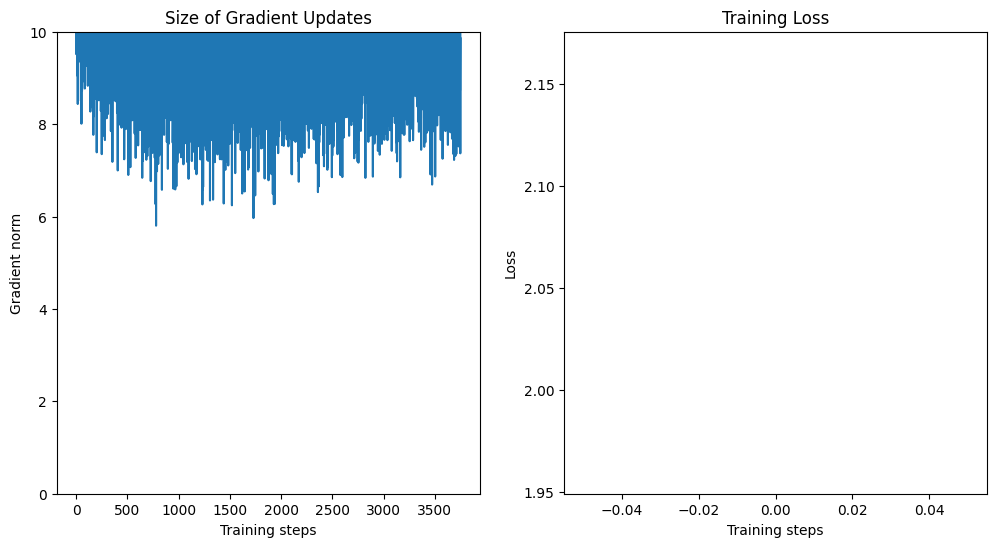

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 4/3750 [00:00<08:16,  7.55it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.570218


Epoch 1:   3%|▎         | 114/3750 [00:02<00:51, 71.12it/s]

Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.516469


Epoch 1:   6%|▌         | 215/3750 [00:03<00:47, 74.35it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.427234


Epoch 1:   8%|▊         | 314/3750 [00:04<00:41, 82.31it/s]

Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.326654


Epoch 1:  11%|█         | 414/3750 [00:06<00:41, 79.75it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.112738


Epoch 1:  14%|█▍        | 516/3750 [00:07<00:40, 80.39it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.355648


Epoch 1:  16%|█▋        | 614/3750 [00:08<00:39, 79.03it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.427719


Epoch 1:  19%|█▉        | 711/3750 [00:09<00:38, 78.04it/s]

Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.483440


Epoch 1:  22%|██▏       | 817/3750 [00:11<00:35, 81.63it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.182439


Epoch 1:  24%|██▍       | 913/3750 [00:12<00:34, 82.31it/s]

Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.329429


Epoch 1:  27%|██▋       | 1009/3750 [00:13<00:35, 76.80it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.254363


Epoch 1:  30%|██▉       | 1108/3750 [00:14<00:31, 82.91it/s]

Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.321430


Epoch 1:  32%|███▏      | 1209/3750 [00:16<00:31, 79.95it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.309840


Epoch 1:  35%|███▍      | 1307/3750 [00:17<00:39, 61.51it/s]

Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.327812


Epoch 1:  38%|███▊      | 1411/3750 [00:19<00:36, 63.33it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.139713


Epoch 1:  40%|████      | 1511/3750 [00:20<00:35, 63.09it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.938682


Epoch 1:  43%|████▎     | 1613/3750 [00:22<00:32, 65.41it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.838564


Epoch 1:  46%|████▌     | 1712/3750 [00:23<00:32, 62.68it/s]

Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.010482


Epoch 1:  48%|████▊     | 1810/3750 [00:25<00:25, 77.30it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.837204


Epoch 1:  51%|█████     | 1914/3750 [00:26<00:23, 78.43it/s]

Train Epoch: 1 [30400/60000 (51%)]	Loss: 2.010993


Epoch 1:  54%|█████▎    | 2012/3750 [00:27<00:21, 80.70it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.810502


Epoch 1:  56%|█████▋    | 2118/3750 [00:29<00:20, 80.49it/s]

Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.708382


Epoch 1:  59%|█████▉    | 2213/3750 [00:30<00:18, 84.24it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.780077


Epoch 1:  62%|██████▏   | 2313/3750 [00:31<00:18, 76.01it/s]

Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.864373


Epoch 1:  64%|██████▍   | 2415/3750 [00:32<00:16, 80.97it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.745163


Epoch 1:  67%|██████▋   | 2509/3750 [00:33<00:15, 78.46it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.953022


Epoch 1:  70%|██████▉   | 2610/3750 [00:35<00:15, 74.79it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.202265


Epoch 1:  72%|███████▏  | 2707/3750 [00:36<00:16, 64.21it/s]

Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.417981


Epoch 1:  75%|███████▍  | 2807/3750 [00:38<00:14, 63.65it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.921150


Epoch 1:  78%|███████▊  | 2907/3750 [00:39<00:12, 65.69it/s]

Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.812846


Epoch 1:  80%|████████  | 3014/3750 [00:41<00:10, 69.77it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.809840


Epoch 1:  83%|████████▎ | 3112/3750 [00:42<00:08, 72.41it/s]

Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.577679


Epoch 1:  86%|████████▌ | 3214/3750 [00:44<00:06, 79.82it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.886412


Epoch 1:  88%|████████▊ | 3312/3750 [00:45<00:05, 79.78it/s]

Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.353618


Epoch 1:  91%|█████████ | 3411/3750 [00:46<00:04, 83.73it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.533410


Epoch 1:  94%|█████████▎| 3510/3750 [00:47<00:02, 82.30it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.594112


Epoch 1:  96%|█████████▋| 3612/3750 [00:49<00:01, 80.93it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.186415


Epoch 1:  99%|█████████▉| 3715/3750 [00:50<00:00, 82.20it/s]

Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.379941


Epoch 1: 100%|██████████| 3750/3750 [00:50<00:00, 73.56it/s]


Train set: Avg. loss: 1.9809, Time: 51.0 secs 




Test set: Avg. loss: 0.0006, Accuracy: 65%, Time: 3.9 secs

Train loss: 1.9809015777269998, Test loss: 0.0005943572521209717, Test accuracy: 64.8, Train time: 50.99139714241028, Test time: 3.9483754634857178


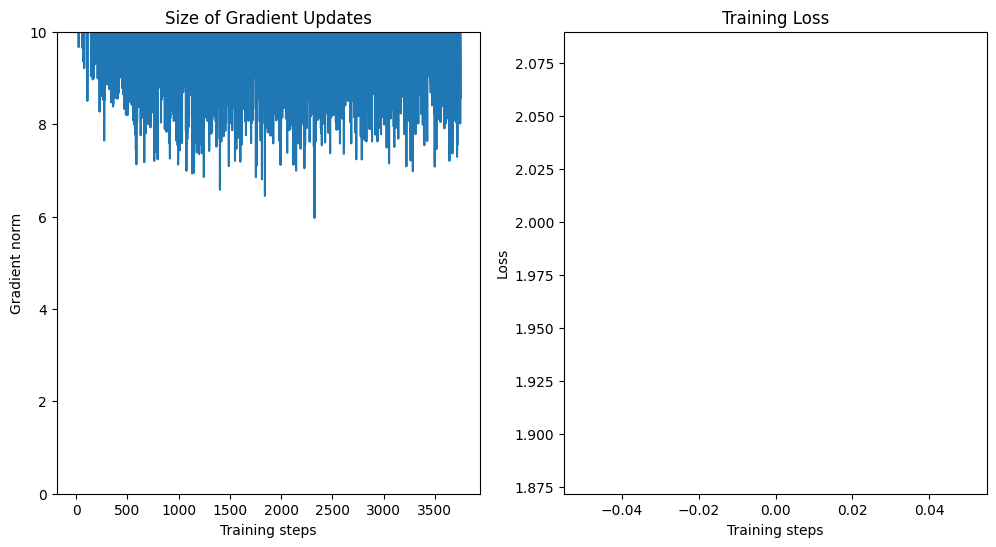

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<09:42,  6.44it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.258858


Epoch 1:   6%|▌         | 210/3750 [00:02<00:49, 70.86it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.436104


Epoch 1:  11%|█         | 417/3750 [00:05<00:39, 83.38it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.451537


Epoch 1:  16%|█▋        | 615/3750 [00:07<00:37, 83.18it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.304160


Epoch 1:  22%|██▏       | 813/3750 [00:10<00:35, 82.23it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.247191


Epoch 1:  27%|██▋       | 1012/3750 [00:12<00:33, 82.55it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.267472


Epoch 1:  32%|███▏      | 1214/3750 [00:15<00:29, 86.11it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.307743


Epoch 1:  38%|███▊      | 1412/3750 [00:17<00:29, 78.07it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.167434


Epoch 1:  43%|████▎     | 1611/3750 [00:20<00:29, 73.52it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.029506


Epoch 1:  48%|████▊     | 1812/3750 [00:22<00:24, 80.14it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.088098


Epoch 1:  54%|█████▎    | 2013/3750 [00:25<00:20, 83.48it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.928867


Epoch 1:  59%|█████▉    | 2212/3750 [00:27<00:18, 85.08it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.665787


Epoch 1:  64%|██████▍   | 2418/3750 [00:30<00:15, 88.23it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.004999


Epoch 1:  70%|██████▉   | 2616/3750 [00:32<00:12, 88.14it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.069331


Epoch 1:  75%|███████▌  | 2815/3750 [00:34<00:11, 80.06it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.796090


Epoch 1:  80%|████████  | 3009/3750 [00:37<00:08, 83.66it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.908131


Epoch 1:  86%|████████▌ | 3215/3750 [00:39<00:06, 81.86it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.711463


Epoch 1:  91%|█████████ | 3410/3750 [00:42<00:04, 81.86it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.688358


Epoch 1:  96%|█████████▋| 3617/3750 [00:44<00:01, 84.53it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.598944


Epoch 1: 100%|██████████| 3750/3750 [00:46<00:00, 80.62it/s]


Train set: Avg. loss: 2.0833, Time: 46.5 secs 




Test set: Avg. loss: 0.0007, Accuracy: 59%, Time: 3.2 secs

Train loss: 2.0833222698529563, Test loss: 0.0007084234356880188, Test accuracy: 58.7, Train time: 46.52357888221741, Test time: 3.2307729721069336


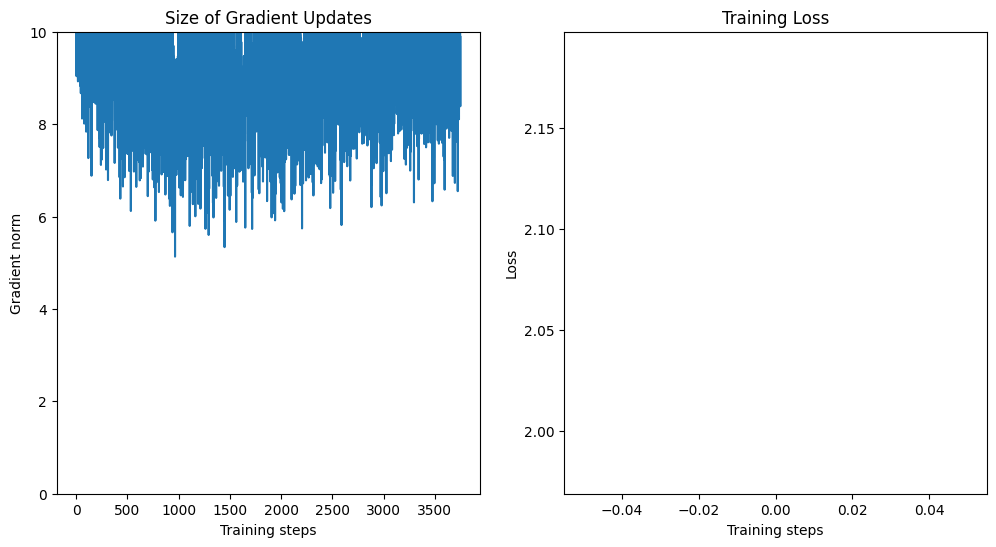

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 17/3750 [00:00<01:12, 51.36it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.669881


Epoch 1:   6%|▌         | 215/3750 [00:02<00:45, 78.48it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.255208


Epoch 1:  11%|█         | 409/3750 [00:05<00:45, 74.08it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.520474


Epoch 1:  16%|█▋        | 616/3750 [00:08<00:42, 74.09it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.271068


Epoch 1:  22%|██▏       | 815/3750 [00:11<00:34, 84.60it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.975666


Epoch 1:  27%|██▋       | 1010/3750 [00:13<00:34, 78.89it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.202569


Epoch 1:  32%|███▏      | 1209/3750 [00:15<00:32, 78.61it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.983107


Epoch 1:  38%|███▊      | 1416/3750 [00:18<00:27, 86.22it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.070459


Epoch 1:  43%|████▎     | 1613/3750 [00:21<00:30, 69.03it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.844107


Epoch 1:  48%|████▊     | 1809/3750 [00:24<00:27, 69.53it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.764874


Epoch 1:  54%|█████▎    | 2011/3750 [00:26<00:20, 86.75it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.910275


Epoch 1:  59%|█████▉    | 2217/3750 [00:29<00:19, 80.14it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.669203


Epoch 1:  64%|██████▍   | 2410/3750 [00:31<00:16, 81.07it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.947721


Epoch 1:  70%|██████▉   | 2611/3750 [00:33<00:14, 79.66it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.825246


Epoch 1:  75%|███████▌  | 2815/3750 [00:36<00:11, 80.07it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.475335


Epoch 1:  80%|████████  | 3015/3750 [00:38<00:09, 80.71it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.338294


Epoch 1:  86%|████████▌ | 3214/3750 [00:41<00:07, 71.69it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.485158


Epoch 1:  91%|█████████ | 3410/3750 [00:44<00:03, 85.35it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.361232


Epoch 1:  96%|█████████▋| 3610/3750 [00:46<00:01, 79.52it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.642108


Epoch 1: 100%|██████████| 3750/3750 [00:48<00:00, 77.29it/s]


Train set: Avg. loss: 1.8394, Time: 48.5 secs 




Test set: Avg. loss: 0.0005, Accuracy: 69%, Time: 3.2 secs

Train loss: 1.8394348449230193, Test loss: 0.0005358961641788483, Test accuracy: 68.56, Train time: 48.529751777648926, Test time: 3.2492573261260986


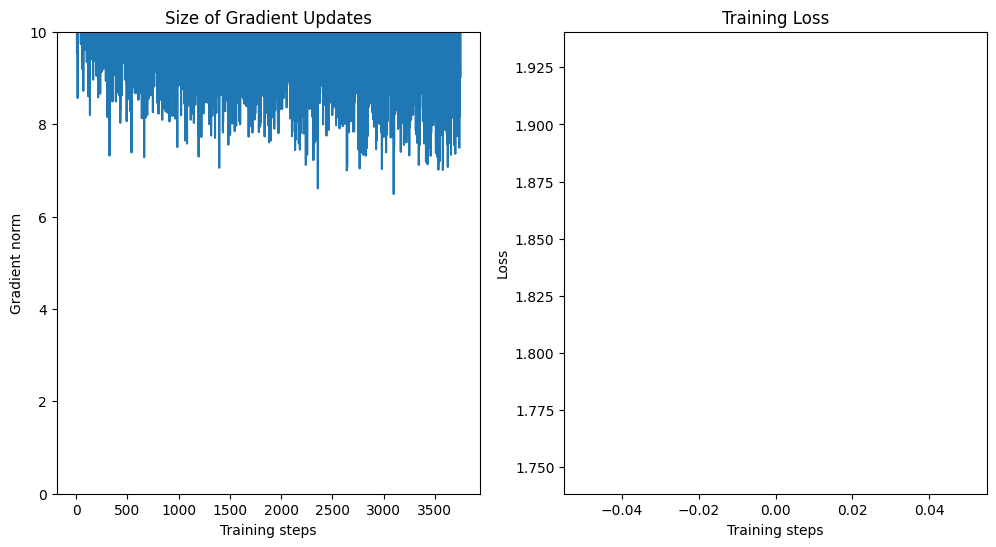

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 4/3750 [00:00<06:13, 10.04it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.772025


Epoch 1:   6%|▌         | 211/3750 [00:03<00:56, 62.38it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.608628


Epoch 1:  11%|█         | 411/3750 [00:06<00:53, 62.82it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.057133


Epoch 1:  16%|█▋        | 611/3750 [00:09<00:40, 76.80it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.104895


Epoch 1:  22%|██▏       | 811/3750 [00:12<00:37, 78.62it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.337275


Epoch 1:  27%|██▋       | 1014/3750 [00:14<00:34, 80.16it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.260940


Epoch 1:  32%|███▏      | 1208/3750 [00:17<00:31, 81.19it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.610988


Epoch 1:  38%|███▊      | 1412/3750 [00:19<00:33, 70.49it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.051309


Epoch 1:  43%|████▎     | 1607/3750 [00:22<00:31, 67.79it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.912406


Epoch 1:  48%|████▊     | 1807/3750 [00:25<00:27, 69.51it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.503421


Epoch 1:  54%|█████▎    | 2010/3750 [00:28<00:23, 74.94it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.055244


Epoch 1:  59%|█████▉    | 2210/3750 [00:31<00:19, 78.20it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.012113


Epoch 1:  64%|██████▍   | 2410/3750 [00:33<00:16, 82.46it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.458508


Epoch 1:  70%|██████▉   | 2612/3750 [00:36<00:13, 81.42it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.750134


Epoch 1:  75%|███████▍  | 2810/3750 [00:38<00:14, 64.22it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.692401


Epoch 1:  80%|████████  | 3010/3750 [00:42<00:11, 65.15it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.288639


Epoch 1:  86%|████████▌ | 3215/3750 [00:44<00:06, 81.60it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.314133


Epoch 1:  91%|█████████ | 3412/3750 [00:47<00:04, 82.18it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.752012


Epoch 1:  96%|█████████▋| 3611/3750 [00:49<00:01, 80.46it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.399932


Epoch 1: 100%|██████████| 3750/3750 [00:51<00:00, 72.58it/s]


Train set: Avg. loss: 1.9074, Time: 51.7 secs 




Test set: Avg. loss: 0.0006, Accuracy: 66%, Time: 3.9 secs

Train loss: 1.907412148698171, Test loss: 0.0005684208035469055, Test accuracy: 65.83, Train time: 51.67690134048462, Test time: 3.9092516899108887


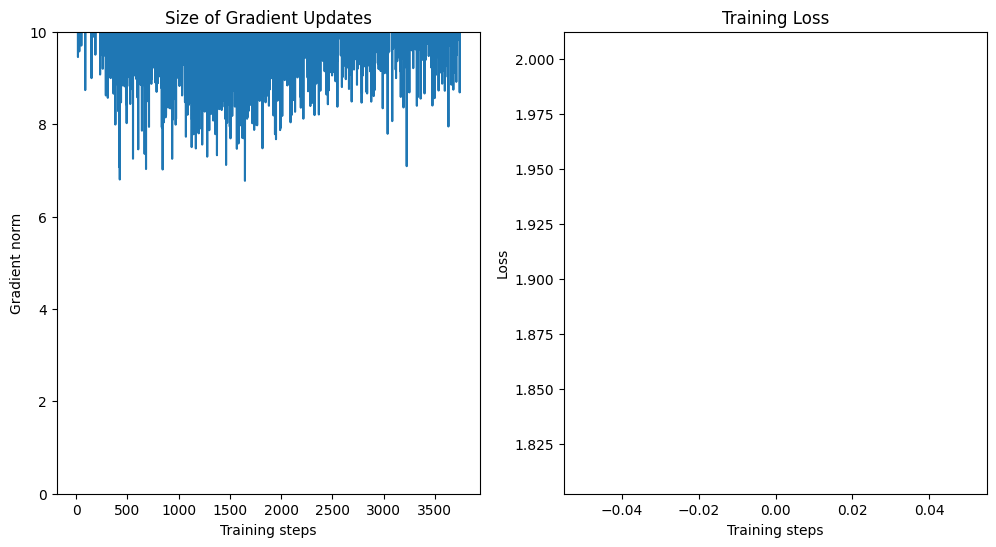

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/3750 [00:00<09:23,  6.65it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.554820


Epoch 1:  14%|█▍        | 516/3750 [00:06<00:36, 87.60it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.711498


Epoch 1:  27%|██▋       | 1018/3750 [00:12<00:30, 89.65it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.253139


Epoch 1:  40%|████      | 1513/3750 [00:18<00:32, 68.75it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.245847


Epoch 1:  54%|█████▍    | 2019/3750 [00:24<00:19, 90.39it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.314578


Epoch 1:  67%|██████▋   | 2508/3750 [00:30<00:15, 81.24it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.185926


Epoch 1:  80%|████████  | 3018/3750 [00:37<00:08, 84.71it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.847292


Epoch 1:  94%|█████████▎| 3511/3750 [00:43<00:02, 82.86it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.731570


Epoch 1: 100%|██████████| 3750/3750 [00:46<00:00, 80.42it/s]


Train set: Avg. loss: 2.1785, Time: 46.6 secs 




Test set: Avg. loss: 0.0008, Accuracy: 54%, Time: 3.3 secs

Train loss: 2.1784972814559938, Test loss: 0.0007743918180465699, Test accuracy: 53.5, Train time: 46.63755702972412, Test time: 3.2516019344329834


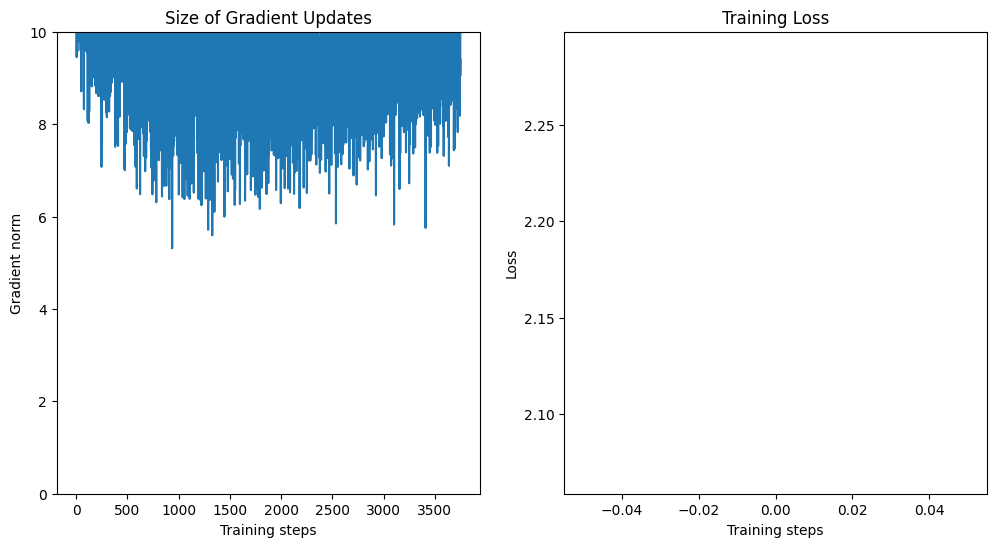

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 8/3750 [00:00<02:50, 21.97it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.479359


Epoch 1:  14%|█▎        | 509/3750 [00:07<00:44, 72.70it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.211432


Epoch 1:  27%|██▋       | 1017/3750 [00:13<00:31, 86.40it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.866753


Epoch 1:  40%|████      | 1513/3750 [00:19<00:31, 71.57it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.182490


Epoch 1:  54%|█████▎    | 2013/3750 [00:26<00:23, 75.42it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.180582


Epoch 1:  67%|██████▋   | 2517/3750 [00:32<00:15, 81.55it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.994541


Epoch 1:  80%|████████  | 3013/3750 [00:38<00:08, 86.50it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.033851


Epoch 1:  94%|█████████▎| 3510/3750 [00:44<00:03, 73.55it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.973197


Epoch 1: 100%|██████████| 3750/3750 [00:47<00:00, 78.48it/s]


Train set: Avg. loss: 2.0829, Time: 47.8 secs 




Test set: Avg. loss: 0.0007, Accuracy: 54%, Time: 3.4 secs

Train loss: 2.0829339347203573, Test loss: 0.000738734483718872, Test accuracy: 54.38, Train time: 47.793195962905884, Test time: 3.4259719848632812


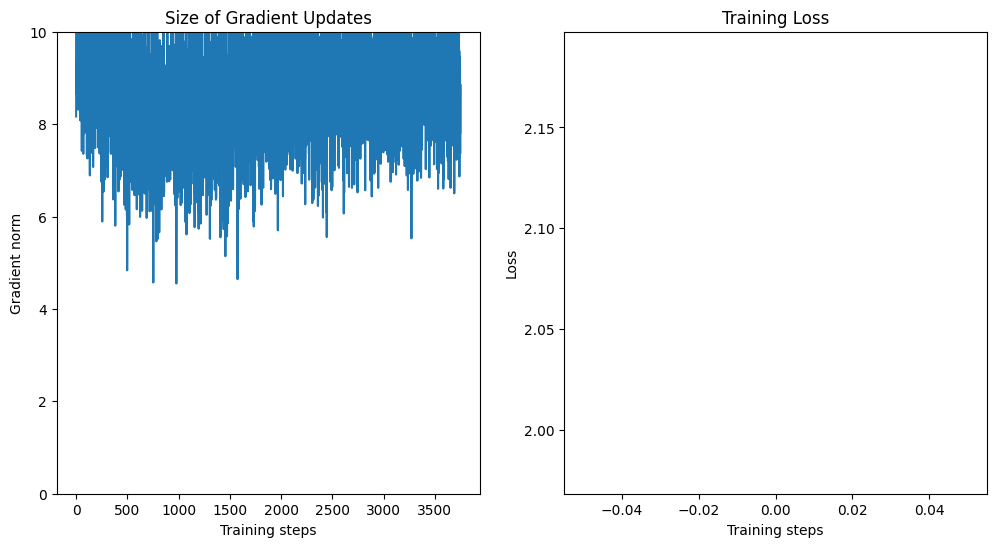

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 6/3750 [00:00<04:17, 14.55it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.583924


Epoch 1:  14%|█▎        | 508/3750 [00:07<00:49, 66.09it/s]

Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.268475


Epoch 1:  27%|██▋       | 1010/3750 [00:14<00:38, 71.76it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.188416


Epoch 1:  41%|████      | 1519/3750 [00:21<00:26, 85.53it/s]

Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.224654


Epoch 1:  54%|█████▎    | 2014/3750 [00:27<00:24, 69.79it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.000198


Epoch 1:  67%|██████▋   | 2508/3750 [00:34<00:15, 80.63it/s]

Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.503721


Epoch 1:  80%|████████  | 3009/3750 [00:40<00:08, 82.67it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.701803


Epoch 1:  94%|█████████▎| 3510/3750 [00:48<00:03, 65.11it/s]

Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.610604


Epoch 1: 100%|██████████| 3750/3750 [00:51<00:00, 72.60it/s]


Train set: Avg. loss: 1.9142, Time: 51.7 secs 




Test set: Avg. loss: 0.0005, Accuracy: 67%, Time: 3.6 secs

Train loss: 1.9142236124992371, Test loss: 0.0005495180487632751, Test accuracy: 66.58, Train time: 51.658764600753784, Test time: 3.639688014984131


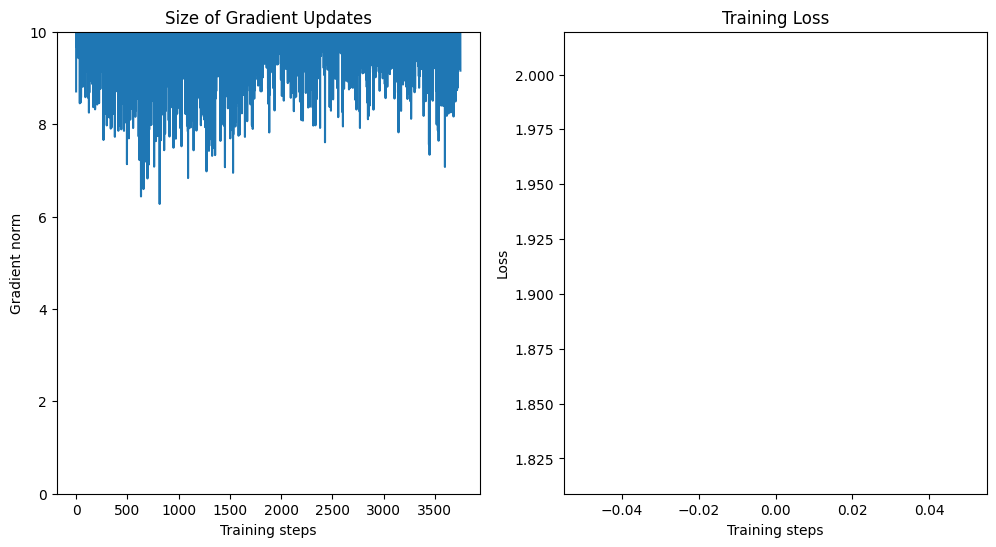

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:08,  6.07it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.539800


Epoch 1:   6%|▌         | 106/1875 [00:02<00:33, 52.30it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.939946


Epoch 1:  11%|█         | 208/1875 [00:04<00:32, 51.06it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.503870


Epoch 1:  17%|█▋        | 310/1875 [00:06<00:31, 49.40it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.540438


Epoch 1:  22%|██▏       | 405/1875 [00:08<00:28, 50.69it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.625703


Epoch 1:  27%|██▋       | 507/1875 [00:10<00:25, 54.35it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.357248


Epoch 1:  32%|███▏      | 606/1875 [00:12<00:27, 46.86it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.381884


Epoch 1:  38%|███▊      | 707/1875 [00:14<00:23, 50.27it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.161185


Epoch 1:  43%|████▎     | 809/1875 [00:16<00:19, 53.81it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.168239


Epoch 1:  48%|████▊     | 906/1875 [00:18<00:18, 52.77it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.187116


Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:16, 53.02it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.392612


Epoch 1:  59%|█████▉    | 1110/1875 [00:22<00:14, 52.57it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.374107


Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:14, 46.17it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.190807


Epoch 1:  70%|██████▉   | 1306/1875 [00:26<00:11, 51.44it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.101172


Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:09, 47.44it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.182578


Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 50.56it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.628316


Epoch 1:  86%|████████▌ | 1609/1875 [00:32<00:04, 53.34it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.208458


Epoch 1:  91%|█████████ | 1706/1875 [00:34<00:03, 53.21it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.293613


Epoch 1:  96%|█████████▋| 1808/1875 [00:36<00:01, 51.32it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.181830


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.94it/s]


Train set: Avg. loss: 0.3995, Time: 37.6 secs 




Test set: Avg. loss: 0.0002, Accuracy: 97%, Time: 4.0 secs

Train loss: 0.3995446160872777, Test loss: 0.00023300204314291478, Test accuracy: 96.67, Train time: 37.5553023815155, Test time: 4.038725852966309


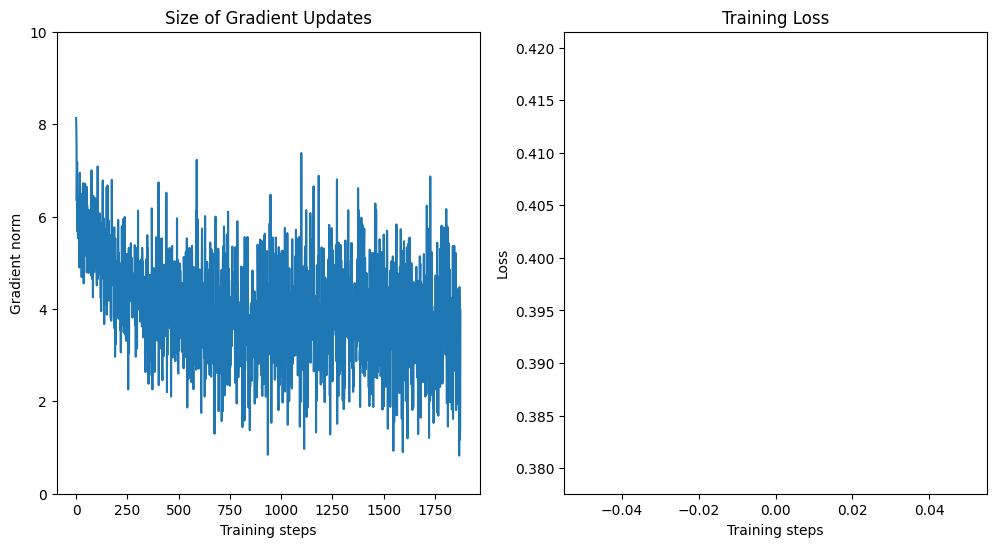

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=2


Epoch 1:   0%|          | 5/1875 [00:00<01:55, 16.15it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.829309


Epoch 1:   6%|▌         | 105/1875 [00:03<00:58, 30.45it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.627380


Epoch 1:  11%|█         | 206/1875 [00:05<00:32, 51.22it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.530484


Epoch 1:  16%|█▋        | 307/1875 [00:07<00:31, 49.84it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.559992


Epoch 1:  22%|██▏       | 409/1875 [00:09<00:29, 48.92it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.320250


Epoch 1:  27%|██▋       | 506/1875 [00:11<00:28, 47.61it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.379896


Epoch 1:  32%|███▏      | 606/1875 [00:13<00:24, 51.26it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.339243


Epoch 1:  38%|███▊      | 708/1875 [00:15<00:25, 46.49it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.308675


Epoch 1:  43%|████▎     | 811/1875 [00:17<00:21, 49.78it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.437777


Epoch 1:  48%|████▊     | 907/1875 [00:19<00:19, 48.65it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.332633


Epoch 1:  54%|█████▎    | 1007/1875 [00:22<00:18, 45.70it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.210510


Epoch 1:  59%|█████▉    | 1105/1875 [00:23<00:15, 50.54it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.126241


Epoch 1:  64%|██████▍   | 1207/1875 [00:25<00:12, 52.01it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.216397


Epoch 1:  70%|██████▉   | 1311/1875 [00:27<00:10, 54.67it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.095525


Epoch 1:  75%|███████▌  | 1407/1875 [00:29<00:09, 51.56it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.171265


Epoch 1:  81%|████████  | 1510/1875 [00:31<00:06, 52.90it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.471252


Epoch 1:  86%|████████▌ | 1607/1875 [00:33<00:05, 47.24it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.227116


Epoch 1:  91%|█████████ | 1706/1875 [00:35<00:03, 49.15it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.200587


Epoch 1:  96%|█████████▋| 1809/1875 [00:37<00:01, 46.87it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.358896


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.48it/s]


Train set: Avg. loss: 0.3946, Time: 39.5 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 4.6 secs

Train loss: 0.39459837884902954, Test loss: 0.00025295339412987234, Test accuracy: 95.96, Train time: 39.500487089157104, Test time: 4.6430535316467285


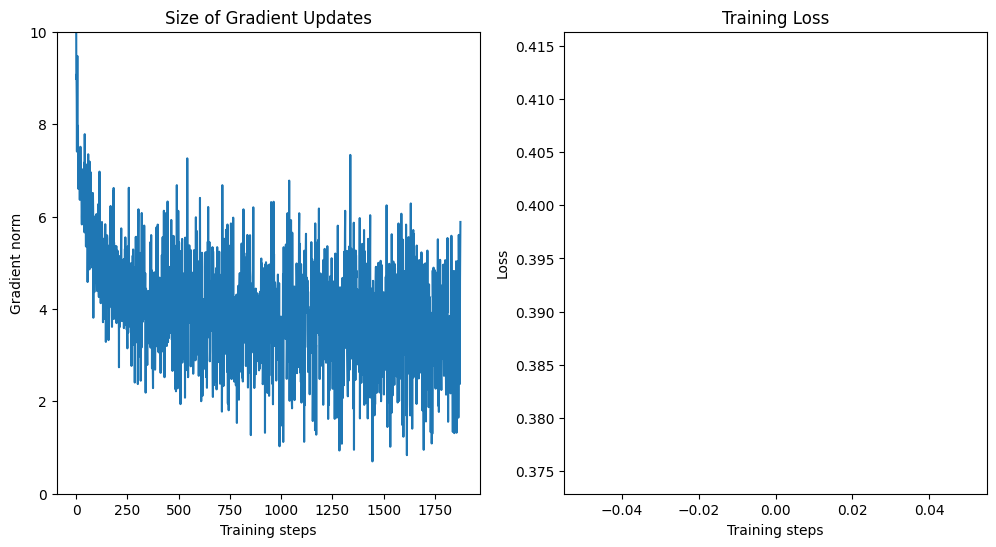

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=4


Epoch 1:   0%|          | 3/1875 [00:00<04:23,  7.12it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.588676


Epoch 1:   6%|▌         | 110/1875 [00:02<00:33, 52.72it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.945311


Epoch 1:  11%|█         | 209/1875 [00:04<00:31, 53.40it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.648163


Epoch 1:  16%|█▋        | 305/1875 [00:06<00:33, 46.79it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.232234


Epoch 1:  22%|██▏       | 412/1875 [00:08<00:28, 50.86it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.253645


Epoch 1:  27%|██▋       | 504/1875 [00:10<00:30, 45.25it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.266485


Epoch 1:  32%|███▏      | 608/1875 [00:12<00:28, 44.87it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.326419


Epoch 1:  38%|███▊      | 706/1875 [00:14<00:25, 46.00it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.278011


Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 52.40it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.366807


Epoch 1:  48%|████▊     | 907/1875 [00:18<00:19, 49.99it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.371958


Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:16, 51.62it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.233249


Epoch 1:  59%|█████▉    | 1113/1875 [00:22<00:14, 53.61it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.292534


Epoch 1:  65%|██████▍   | 1210/1875 [00:24<00:11, 55.45it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.428302


Epoch 1:  70%|██████▉   | 1308/1875 [00:26<00:11, 50.55it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.359206


Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:09, 47.26it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.065385


Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 49.23it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.192514


Epoch 1:  85%|████████▌ | 1602/1875 [00:32<00:05, 50.43it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.183577


Epoch 1:  91%|█████████ | 1705/1875 [00:34<00:03, 48.19it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.387573


Epoch 1:  97%|█████████▋| 1813/1875 [00:36<00:01, 53.63it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.108037


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.43it/s]


Train set: Avg. loss: 0.3988, Time: 37.9 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 3.8 secs

Train loss: 0.39876572716236114, Test loss: 0.00024011786356568338, Test accuracy: 96.44, Train time: 37.940125703811646, Test time: 3.7620632648468018


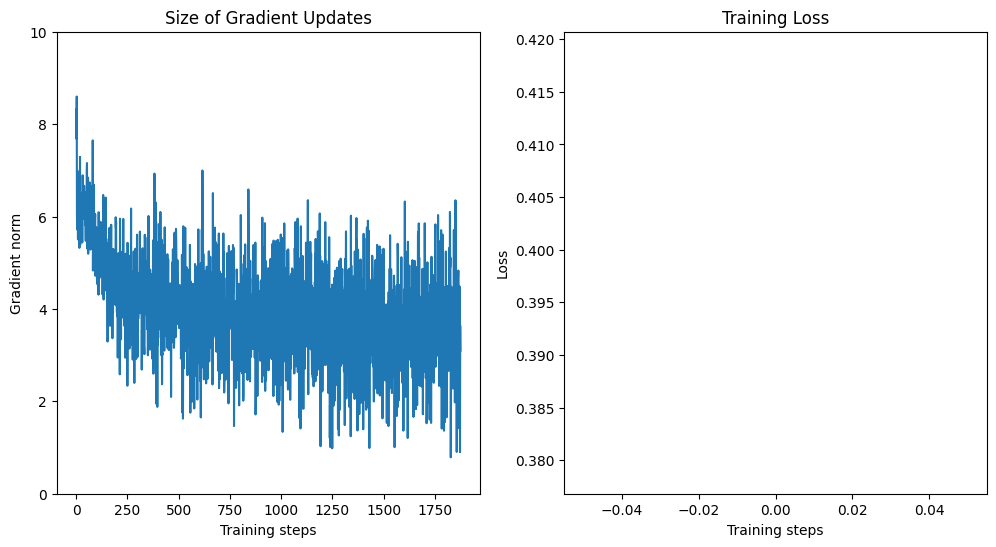

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<04:57,  6.30it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.346660


Epoch 1:  11%|█         | 206/1875 [00:04<00:39, 42.02it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.556969


Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 49.23it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.553696


Epoch 1:  32%|███▏      | 609/1875 [00:12<00:24, 52.07it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.552399


Epoch 1:  43%|████▎     | 807/1875 [00:15<00:20, 52.84it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.350918


Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:17, 48.30it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.252474


Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:12, 53.20it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.184976


Epoch 1:  75%|███████▌  | 1407/1875 [00:27<00:08, 52.10it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.216769


Epoch 1:  86%|████████▌ | 1606/1875 [00:31<00:05, 52.99it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.021982


Epoch 1:  97%|█████████▋| 1810/1875 [00:35<00:01, 52.53it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.263490


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.11it/s]


Train set: Avg. loss: 0.4273, Time: 36.7 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.4 secs

Train loss: 0.42734162061115105, Test loss: 0.00025110520962625744, Test accuracy: 96.16, Train time: 36.69316363334656, Test time: 3.3847780227661133


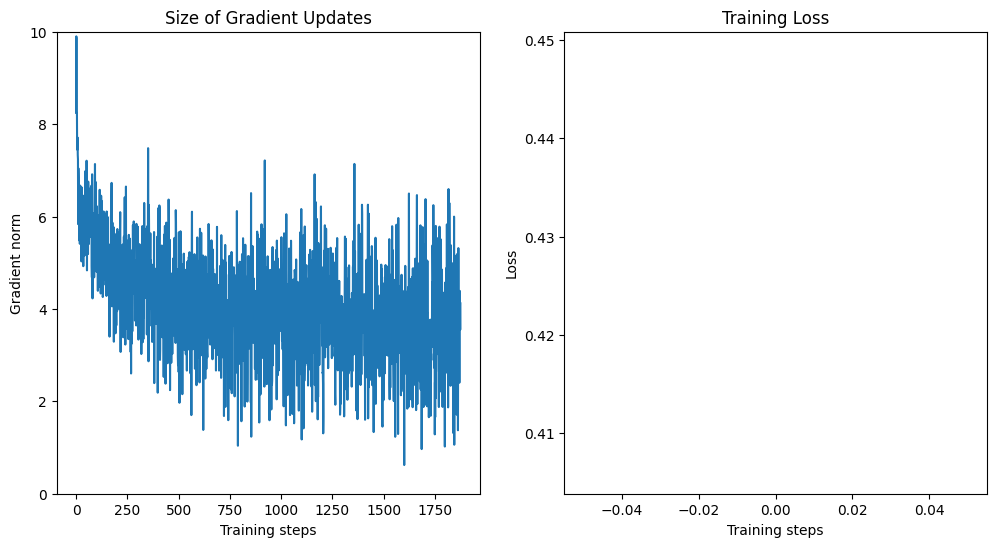

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=2


Epoch 1:   0%|          | 7/1875 [00:00<01:42, 18.20it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.653161


Epoch 1:  11%|█▏        | 211/1875 [00:04<00:29, 55.59it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.505836


Epoch 1:  22%|██▏       | 409/1875 [00:08<00:29, 50.44it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.501380


Epoch 1:  32%|███▏      | 606/1875 [00:12<00:23, 52.89it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.410862


Epoch 1:  43%|████▎     | 807/1875 [00:16<00:23, 44.87it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.144534


Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:17, 50.38it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.465053


Epoch 1:  64%|██████▍   | 1204/1875 [00:24<00:13, 50.42it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.219154


Epoch 1:  75%|███████▌  | 1412/1875 [00:28<00:08, 52.85it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.382699


Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 48.56it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.225812


Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 48.89it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.240088


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.16it/s]


Train set: Avg. loss: 0.4039, Time: 38.1 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 3.8 secs

Train loss: 0.40393245956699053, Test loss: 0.00024295001775026322, Test accuracy: 96.19, Train time: 38.14585590362549, Test time: 3.7678420543670654


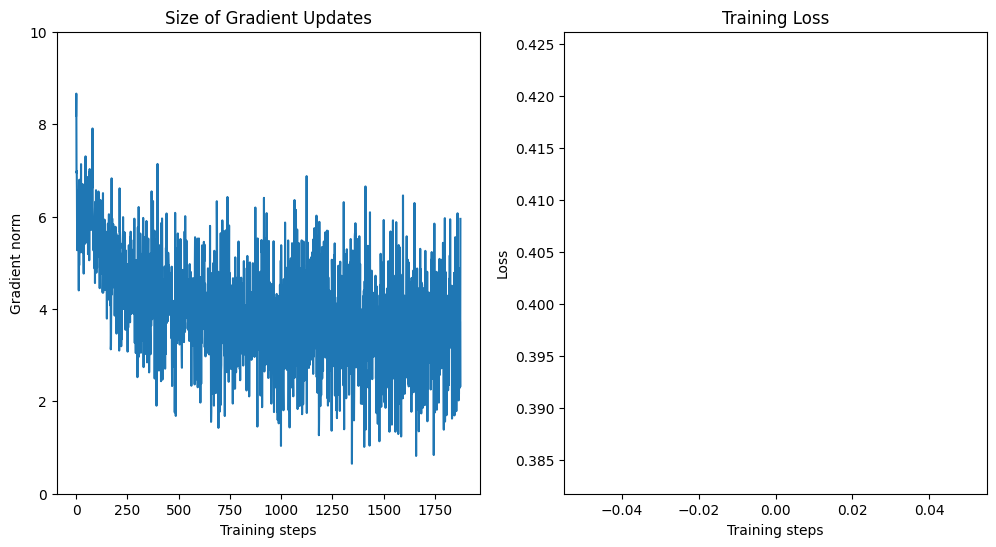

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=4


Epoch 1:   0%|          | 6/1875 [00:00<02:38, 11.82it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.496067


Epoch 1:  11%|█         | 208/1875 [00:04<00:31, 53.08it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.515306


Epoch 1:  22%|██▏       | 406/1875 [00:08<00:30, 48.94it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.391782


Epoch 1:  33%|███▎      | 610/1875 [00:12<00:28, 44.39it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.281400


Epoch 1:  43%|████▎     | 808/1875 [00:16<00:22, 47.56it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.090514


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:16, 51.55it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.133909


Epoch 1:  65%|██████▍   | 1212/1875 [00:24<00:12, 53.56it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.277422


Epoch 1:  75%|███████▌  | 1411/1875 [00:28<00:08, 53.90it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.310035


Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 47.46it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.192894


Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 50.97it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.330281


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.80it/s]


Train set: Avg. loss: 0.4048, Time: 38.4 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 3.7 secs

Train loss: 0.40475000959237417, Test loss: 0.00021911344658583401, Test accuracy: 96.47, Train time: 38.43127727508545, Test time: 3.6602234840393066


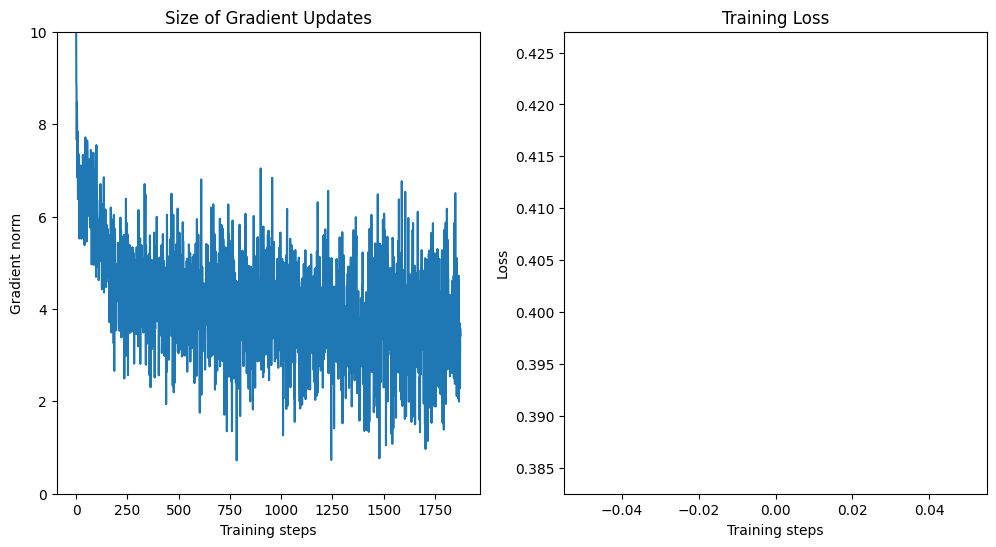

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:04,  6.16it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.525356


Epoch 1:  27%|██▋       | 507/1875 [00:09<00:32, 42.41it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.296717


Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:15, 54.78it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.127503


Epoch 1:  80%|████████  | 1505/1875 [00:29<00:08, 43.22it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.422945


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.59it/s]


Train set: Avg. loss: 0.4169, Time: 36.4 secs 




Test set: Avg. loss: 0.0002, Accuracy: 97%, Time: 3.3 secs

Train loss: 0.4168625992655754, Test loss: 0.000240361244417727, Test accuracy: 96.57, Train time: 36.35222506523132, Test time: 3.2856955528259277


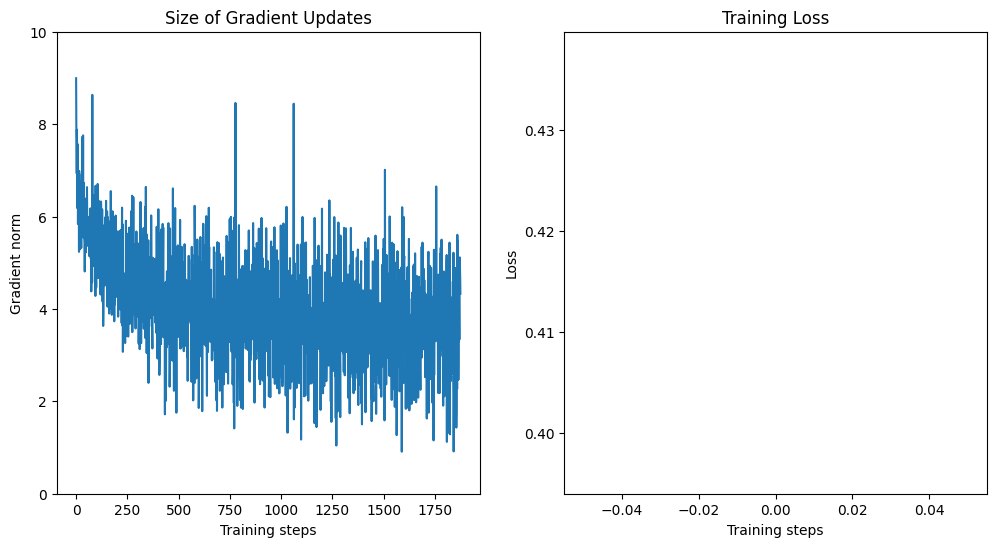

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=2


Epoch 1:   0%|          | 6/1875 [00:00<01:35, 19.56it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.405684


Epoch 1:  27%|██▋       | 506/1875 [00:10<00:25, 53.75it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.347876


Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:16, 51.89it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.115492


Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 50.24it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.290171


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.46it/s]


Train set: Avg. loss: 0.4090, Time: 37.2 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 3.6 secs

Train loss: 0.40895083504716556, Test loss: 0.00024370133318006994, Test accuracy: 96.39, Train time: 37.16677641868591, Test time: 3.57633376121521


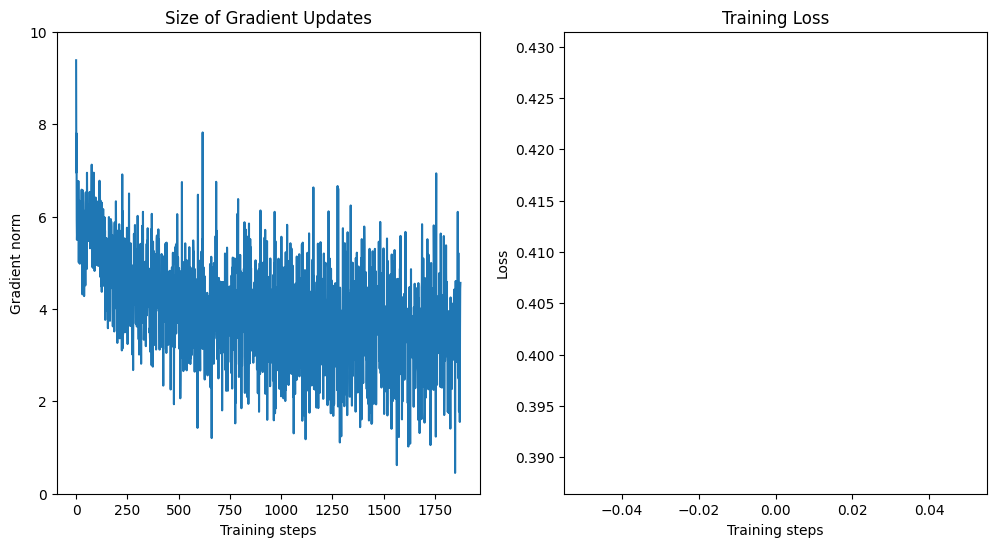

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=4


Epoch 1:   0%|          | 5/1875 [00:00<02:51, 10.89it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.536061


Epoch 1:  27%|██▋       | 509/1875 [00:10<00:25, 53.54it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.445036


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:18, 47.38it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.185804


Epoch 1:  80%|████████  | 1508/1875 [00:30<00:07, 51.98it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.440856


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.68it/s]


Train set: Avg. loss: 0.4107, Time: 37.8 secs 




Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 4.0 secs

Train loss: 0.41068513338565826, Test loss: 0.00022888417094945907, Test accuracy: 96.47, Train time: 37.75347566604614, Test time: 3.964473009109497


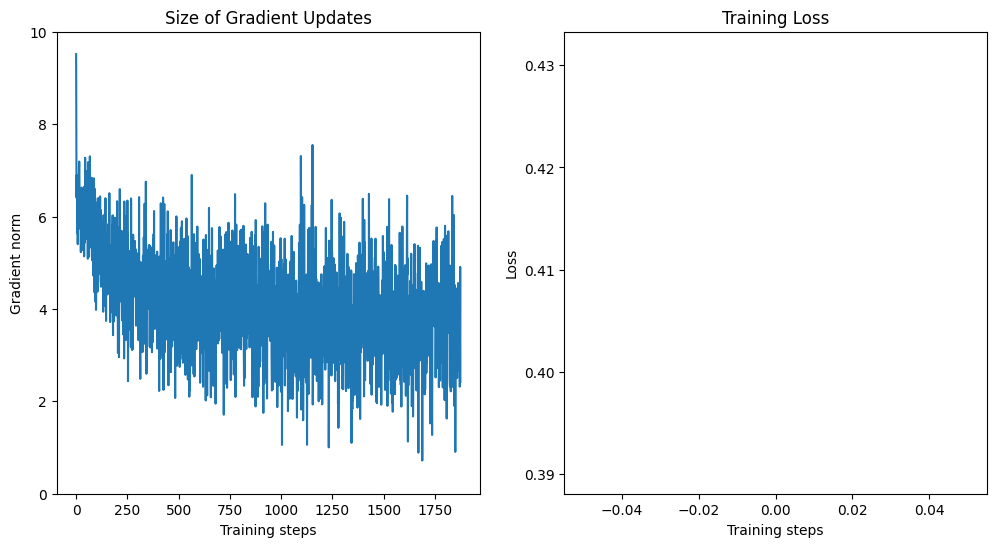

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<04:37,  6.76it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.547868


Epoch 1:   6%|▌         | 109/1875 [00:02<00:31, 55.50it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.107063


Epoch 1:  11%|█▏        | 212/1875 [00:04<00:30, 55.09it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.293360


Epoch 1:  16%|█▋        | 308/1875 [00:05<00:30, 52.10it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.548458


Epoch 1:  22%|██▏       | 410/1875 [00:07<00:27, 53.65it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.300251


Epoch 1:  27%|██▋       | 505/1875 [00:09<00:25, 54.51it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.944851


Epoch 1:  32%|███▏      | 607/1875 [00:11<00:25, 50.31it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.050904


Epoch 1:  38%|███▊      | 709/1875 [00:13<00:27, 42.57it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.395431


Epoch 1:  43%|████▎     | 808/1875 [00:15<00:21, 49.09it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.757149


Epoch 1:  49%|████▊     | 910/1875 [00:17<00:18, 53.13it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.659262


Epoch 1:  54%|█████▍    | 1012/1875 [00:19<00:16, 53.47it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.745091


Epoch 1:  59%|█████▉    | 1108/1875 [00:21<00:13, 55.68it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.806393


Epoch 1:  65%|██████▍   | 1210/1875 [00:23<00:11, 55.56it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.495510


Epoch 1:  70%|██████▉   | 1306/1875 [00:25<00:10, 53.19it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.601409


Epoch 1:  75%|███████▌  | 1411/1875 [00:27<00:08, 53.11it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.421531


Epoch 1:  80%|████████  | 1507/1875 [00:29<00:08, 43.85it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.624593


Epoch 1:  86%|████████▌ | 1607/1875 [00:31<00:05, 50.41it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.492103


Epoch 1:  91%|█████████ | 1709/1875 [00:33<00:03, 46.80it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.396369


Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 53.26it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.414661


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.45it/s]


Train set: Avg. loss: 1.0653, Time: 36.5 secs 




Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.0653160438696543, Test loss: 0.0006032624438405037, Test accuracy: 91.74, Train time: 36.455100774765015, Test time: 3.2013018131256104


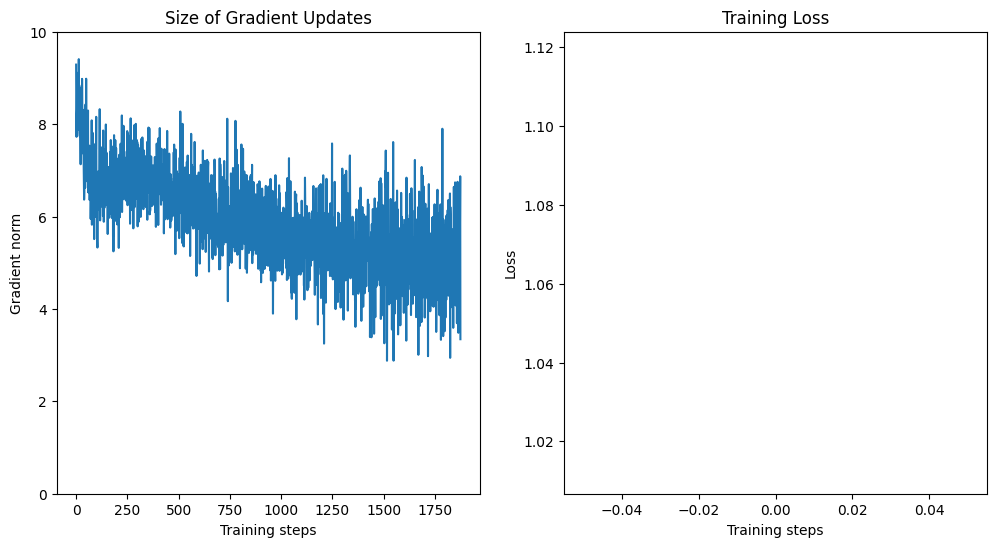

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 6/1875 [00:00<01:24, 22.11it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.510115


Epoch 1:   6%|▌         | 112/1875 [00:02<00:33, 53.07it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.089067


Epoch 1:  11%|█         | 209/1875 [00:04<00:30, 54.25it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.926293


Epoch 1:  16%|█▋        | 305/1875 [00:06<00:32, 48.28it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.546141


Epoch 1:  22%|██▏       | 410/1875 [00:08<00:28, 51.61it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.499730


Epoch 1:  27%|██▋       | 505/1875 [00:10<00:28, 48.62it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.235332


Epoch 1:  33%|███▎      | 613/1875 [00:12<00:21, 58.57it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.097206


Epoch 1:  38%|███▊      | 708/1875 [00:13<00:20, 57.19it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.964650


Epoch 1:  43%|████▎     | 810/1875 [00:15<00:19, 54.68it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.892838


Epoch 1:  48%|████▊     | 908/1875 [00:17<00:16, 58.21it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.623193


Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:16, 53.69it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.894105


Epoch 1:  59%|█████▉    | 1107/1875 [00:21<00:15, 50.59it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.692593


Epoch 1:  65%|██████▍   | 1211/1875 [00:23<00:12, 52.56it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.618909


Epoch 1:  70%|██████▉   | 1307/1875 [00:25<00:11, 50.09it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.531018


Epoch 1:  75%|███████▌  | 1408/1875 [00:27<00:09, 49.50it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.418036


Epoch 1:  81%|████████  | 1510/1875 [00:29<00:07, 49.50it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.688169


Epoch 1:  86%|████████▌ | 1607/1875 [00:31<00:05, 46.54it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.526910


Epoch 1:  91%|█████████ | 1706/1875 [00:33<00:03, 48.13it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.601601


Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 50.64it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.675251


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.62it/s]


Train set: Avg. loss: 1.0598, Time: 37.0 secs 




Test set: Avg. loss: 0.0006, Accuracy: 91%, Time: 3.4 secs

Train loss: 1.0597501487255097, Test loss: 0.0006436475768685341, Test accuracy: 91.17, Train time: 37.04481244087219, Test time: 3.4129905700683594


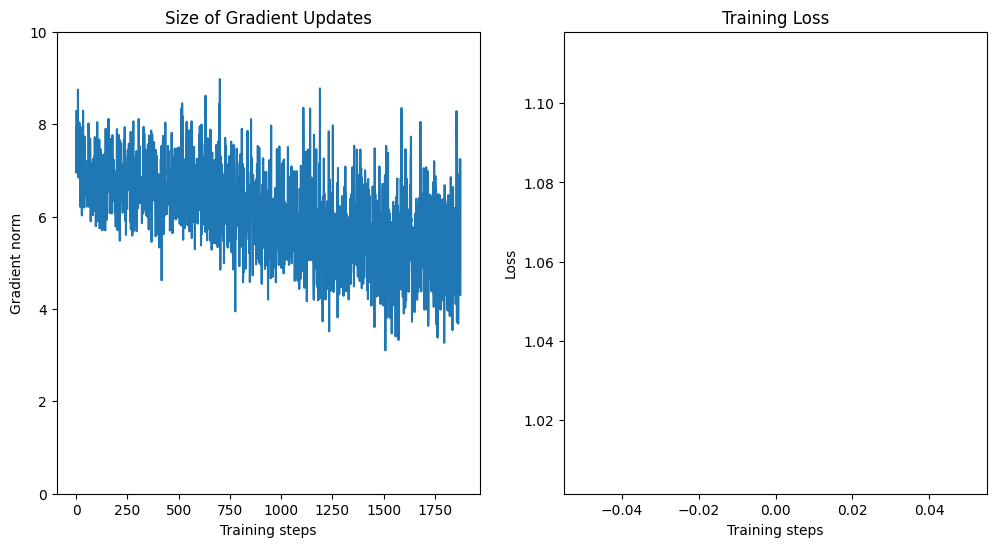

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 3/1875 [00:00<05:10,  6.03it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.692345


Epoch 1:   6%|▌         | 109/1875 [00:02<00:36, 48.65it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.034672


Epoch 1:  11%|█         | 207/1875 [00:04<00:34, 47.84it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.006224


Epoch 1:  17%|█▋        | 313/1875 [00:06<00:27, 56.63it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.756218


Epoch 1:  22%|██▏       | 410/1875 [00:08<00:25, 58.13it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.316827


Epoch 1:  27%|██▋       | 510/1875 [00:10<00:25, 52.75it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.063362


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:24, 51.43it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.603488


Epoch 1:  38%|███▊      | 712/1875 [00:14<00:21, 53.30it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.968850


Epoch 1:  43%|████▎     | 808/1875 [00:16<00:19, 54.02it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.915609


Epoch 1:  49%|████▊     | 910/1875 [00:18<00:19, 50.25it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.756593


Epoch 1:  54%|█████▍    | 1009/1875 [00:20<00:18, 46.64it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.907973


Epoch 1:  59%|█████▉    | 1107/1875 [00:22<00:15, 48.18it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.698911


Epoch 1:  64%|██████▍   | 1205/1875 [00:24<00:12, 51.96it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.758522


Epoch 1:  70%|██████▉   | 1309/1875 [00:26<00:10, 52.98it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.666400


Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:08, 54.74it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.618922


Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 57.24it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.693203


Epoch 1:  86%|████████▌ | 1610/1875 [00:31<00:04, 53.28it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.596930


Epoch 1:  91%|█████████ | 1708/1875 [00:33<00:03, 53.20it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.691291


Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 46.65it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.540052


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.24it/s]


Train set: Avg. loss: 1.0631, Time: 37.3 secs 




Test set: Avg. loss: 0.0006, Accuracy: 91%, Time: 4.0 secs

Train loss: 1.063120254802704, Test loss: 0.0006360577091574669, Test accuracy: 91.36, Train time: 37.3268358707428, Test time: 3.976437568664551


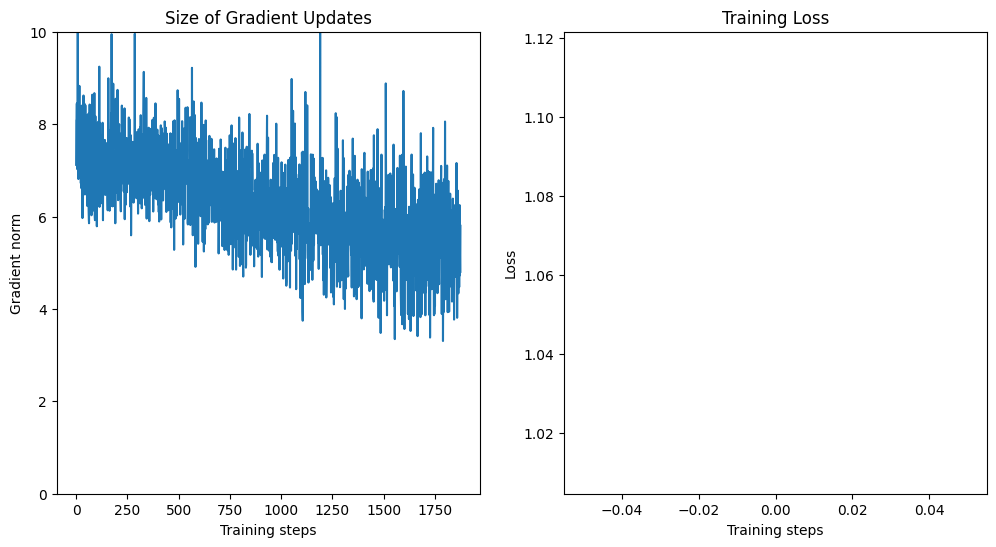

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:10,  6.03it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.878389


Epoch 1:  11%|█         | 208/1875 [00:04<00:30, 54.37it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.683772


Epoch 1:  22%|██▏       | 412/1875 [00:07<00:26, 55.68it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.415937


Epoch 1:  33%|███▎      | 610/1875 [00:11<00:24, 51.53it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.425254


Epoch 1:  43%|████▎     | 808/1875 [00:15<00:20, 52.63it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.871665


Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:16, 52.76it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.581574


Epoch 1:  64%|██████▍   | 1207/1875 [00:22<00:12, 54.16it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.587407


Epoch 1:  75%|███████▌  | 1411/1875 [00:26<00:08, 54.26it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.531020


Epoch 1:  86%|████████▌ | 1605/1875 [00:30<00:05, 49.75it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.636057


Epoch 1:  97%|█████████▋| 1811/1875 [00:34<00:01, 53.49it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.521267


Epoch 1: 100%|██████████| 1875/1875 [00:35<00:00, 52.21it/s]


Train set: Avg. loss: 1.0201, Time: 35.9 secs 




Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 3.3 secs

Train loss: 1.0200928649822871, Test loss: 0.0005682440109550953, Test accuracy: 92.5, Train time: 35.91869521141052, Test time: 3.256831645965576


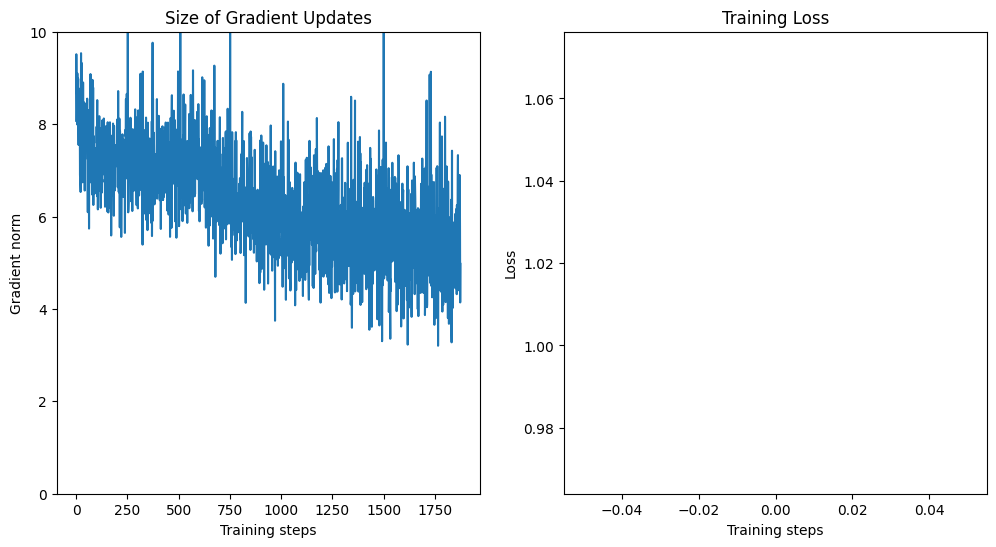

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 8/1875 [00:00<01:09, 26.98it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.802254


Epoch 1:  11%|█         | 207/1875 [00:04<00:30, 53.96it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.815273


Epoch 1:  22%|██▏       | 404/1875 [00:08<00:30, 47.77it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.581615


Epoch 1:  32%|███▏      | 606/1875 [00:12<00:25, 50.36it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.371632


Epoch 1:  43%|████▎     | 809/1875 [00:16<00:19, 54.31it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.276506


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:16, 51.16it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.243109


Epoch 1:  64%|██████▍   | 1208/1875 [00:24<00:15, 44.21it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.749544


Epoch 1:  75%|███████▌  | 1410/1875 [00:28<00:09, 48.34it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.504816


Epoch 1:  86%|████████▌ | 1608/1875 [00:32<00:05, 51.56it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.541812


Epoch 1:  96%|█████████▋| 1809/1875 [00:36<00:01, 49.88it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.419966


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.99it/s]


Train set: Avg. loss: 1.1819, Time: 37.5 secs 




Test set: Avg. loss: 0.0007, Accuracy: 90%, Time: 3.3 secs

Train loss: 1.1818528131484984, Test loss: 0.0007158809259533882, Test accuracy: 89.98, Train time: 37.51582193374634, Test time: 3.346426010131836


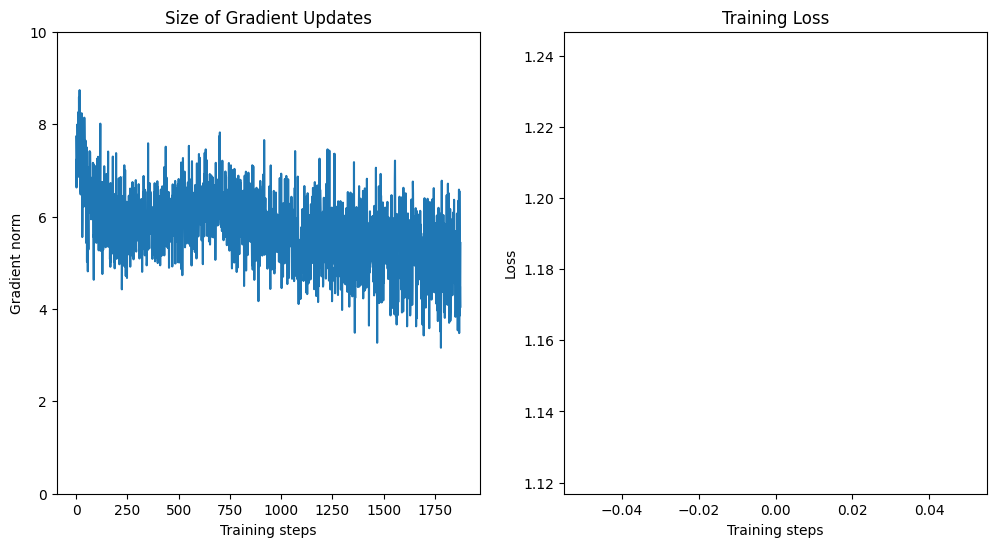

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 8/1875 [00:00<01:45, 17.62it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.703078


Epoch 1:  11%|█         | 207/1875 [00:04<00:33, 49.08it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.997273


Epoch 1:  22%|██▏       | 408/1875 [00:09<00:30, 47.95it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.374547


Epoch 1:  32%|███▏      | 608/1875 [00:12<00:25, 50.02it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.943304


Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 52.98it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.758428


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:18, 46.62it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.705786


Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:16, 41.73it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.871979


Epoch 1:  75%|███████▍  | 1405/1875 [00:28<00:09, 52.18it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.516315


Epoch 1:  86%|████████▌ | 1612/1875 [00:32<00:04, 53.73it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.592416


Epoch 1:  97%|█████████▋| 1811/1875 [00:36<00:01, 54.19it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.710104


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.44it/s]


Train set: Avg. loss: 1.0391, Time: 37.9 secs 




Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 4.0 secs

Train loss: 1.0390705921411514, Test loss: 0.0005913753539323807, Test accuracy: 92.15, Train time: 37.93394327163696, Test time: 4.02655029296875


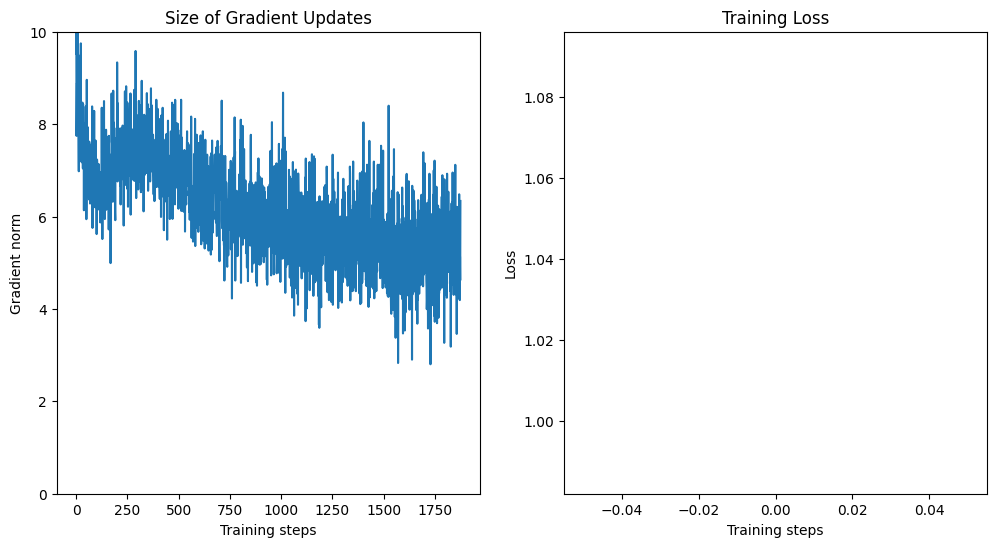

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:22,  5.81it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.527669


Epoch 1:  27%|██▋       | 506/1875 [00:09<00:26, 52.48it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.170750


Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:17, 50.12it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.698636


Epoch 1:  80%|████████  | 1507/1875 [00:29<00:07, 50.15it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.495577


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.74it/s]


Train set: Avg. loss: 1.0252, Time: 37.7 secs 




Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 3.7 secs

Train loss: 1.025236055223147, Test loss: 0.0005904116690158844, Test accuracy: 91.55, Train time: 37.70728325843811, Test time: 3.7429428100585938


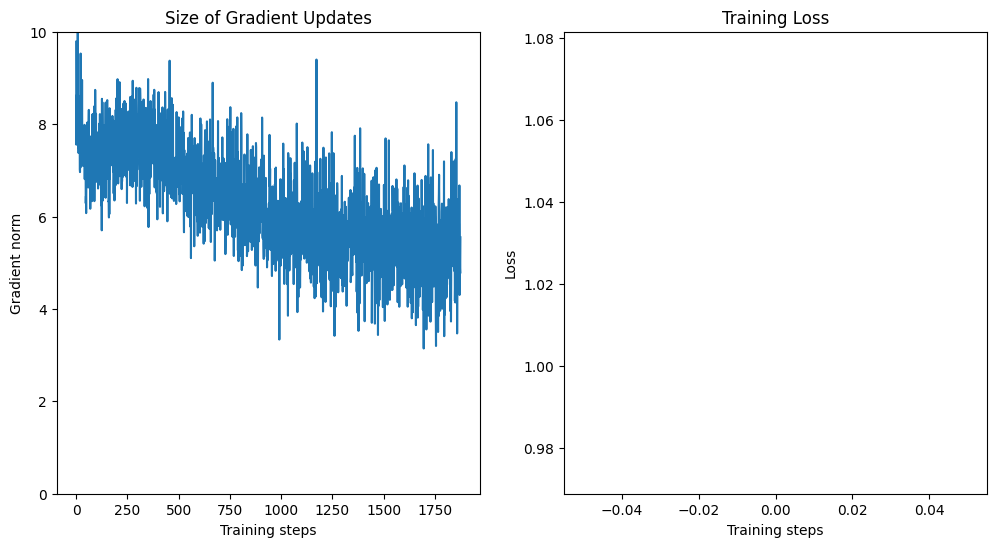

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 7/1875 [00:00<01:35, 19.55it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.852889


Epoch 1:  27%|██▋       | 508/1875 [00:10<00:25, 52.70it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.418549


Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:16, 52.27it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.028990


Epoch 1:  80%|████████  | 1507/1875 [00:29<00:07, 48.08it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.767550


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.97it/s]


Train set: Avg. loss: 1.0320, Time: 37.5 secs 




Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.0320273080190023, Test loss: 0.0006291444301605224, Test accuracy: 91.61, Train time: 37.530022382736206, Test time: 3.164947032928467


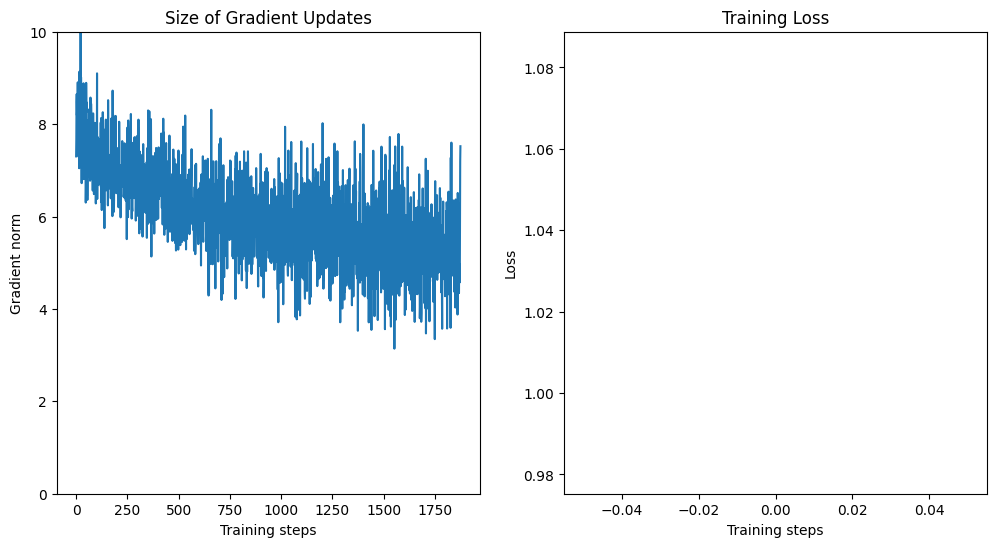

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 4/1875 [00:00<03:57,  7.88it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.754634


Epoch 1:  27%|██▋       | 505/1875 [00:11<00:32, 41.84it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.497503


Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:17, 49.19it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.786586


Epoch 1:  80%|████████  | 1507/1875 [00:32<00:07, 51.95it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.612285


Epoch 1: 100%|██████████| 1875/1875 [00:40<00:00, 46.82it/s]


Train set: Avg. loss: 0.9844, Time: 40.1 secs 




Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 4.0 secs

Train loss: 0.9843947212378183, Test loss: 0.0005937631279230118, Test accuracy: 91.8, Train time: 40.0522358417511, Test time: 3.9603538513183594


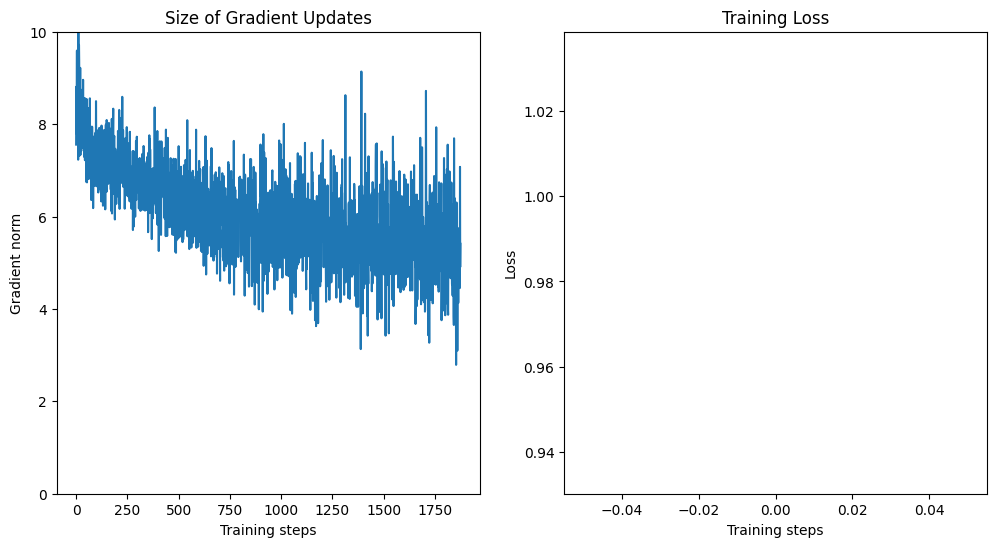

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<06:01,  5.18it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.652113


Epoch 1:   6%|▌         | 109/1875 [00:02<00:34, 50.89it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.420162


Epoch 1:  11%|█         | 210/1875 [00:04<00:32, 51.26it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.343449


Epoch 1:  16%|█▋        | 306/1875 [00:06<00:29, 52.52it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.425868


Epoch 1:  22%|██▏       | 408/1875 [00:08<00:29, 49.52it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.342305


Epoch 1:  27%|██▋       | 508/1875 [00:10<00:25, 53.23it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.219483


Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 51.86it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.193675


Epoch 1:  38%|███▊      | 706/1875 [00:14<00:24, 47.12it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.962922


Epoch 1:  43%|████▎     | 809/1875 [00:16<00:23, 44.53it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.093000


Epoch 1:  48%|████▊     | 906/1875 [00:18<00:19, 48.86it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.079286


Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:17, 49.80it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.219332


Epoch 1:  59%|█████▉    | 1107/1875 [00:22<00:13, 55.21it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.972764


Epoch 1:  64%|██████▍   | 1209/1875 [00:24<00:12, 52.91it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.003111


Epoch 1:  70%|██████▉   | 1311/1875 [00:26<00:10, 52.42it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.868857


Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:08, 52.49it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.264088


Epoch 1:  80%|████████  | 1508/1875 [00:30<00:06, 53.76it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.880906


Epoch 1:  86%|████████▌ | 1607/1875 [00:32<00:05, 52.95it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.835789


Epoch 1:  91%|█████████ | 1707/1875 [00:34<00:03, 51.13it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.942064


Epoch 1:  96%|█████████▋| 1809/1875 [00:36<00:01, 52.49it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.896179


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.82it/s]


Train set: Avg. loss: 2.1341, Time: 37.6 secs 




Test set: Avg. loss: 0.0033, Accuracy: 47%, Time: 3.3 secs

Train loss: 2.134062907218933, Test loss: 0.0032960811972618104, Test accuracy: 47.07, Train time: 37.63819909095764, Test time: 3.3210813999176025


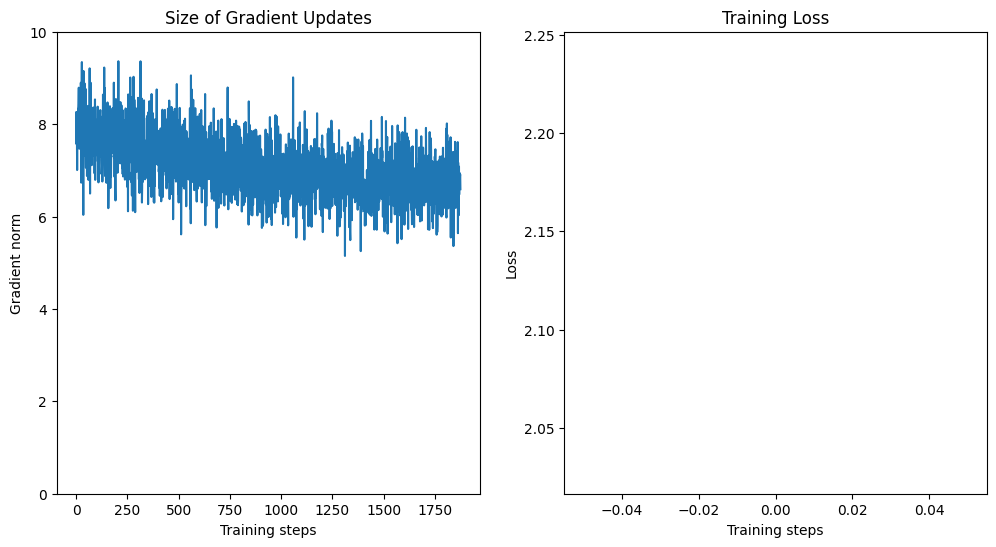

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 6/1875 [00:00<01:29, 20.83it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.558536


Epoch 1:   6%|▌         | 109/1875 [00:02<00:33, 52.12it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.489569


Epoch 1:  11%|█         | 206/1875 [00:04<00:32, 50.58it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.361669


Epoch 1:  16%|█▋        | 308/1875 [00:06<00:33, 47.37it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.373894


Epoch 1:  22%|██▏       | 408/1875 [00:08<00:31, 46.51it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.469313


Epoch 1:  27%|██▋       | 508/1875 [00:10<00:29, 46.78it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.215750


Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 51.37it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.204824


Epoch 1:  38%|███▊      | 706/1875 [00:14<00:21, 55.08it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.173918


Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 51.67it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.395472


Epoch 1:  49%|████▊     | 911/1875 [00:18<00:18, 51.29it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.189697


Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:15, 56.12it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.268512


Epoch 1:  59%|█████▉    | 1111/1875 [00:22<00:14, 51.60it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.009334


Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:13, 50.25it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.301685


Epoch 1:  70%|██████▉   | 1307/1875 [00:26<00:11, 48.68it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.306624


Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:09, 46.76it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.166478


Epoch 1:  81%|████████  | 1510/1875 [00:30<00:07, 47.80it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.178127


Epoch 1:  86%|████████▌ | 1607/1875 [00:32<00:05, 51.87it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.072289


Epoch 1:  91%|█████████▏| 1712/1875 [00:34<00:02, 58.37it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.898839


Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 51.45it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.035058


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.98it/s]


Train set: Avg. loss: 2.2282, Time: 37.5 secs 




Test set: Avg. loss: 0.0037, Accuracy: 40%, Time: 3.4 secs

Train loss: 2.2282359133402507, Test loss: 0.003703423643112183, Test accuracy: 40.41, Train time: 37.52583718299866, Test time: 3.3728525638580322


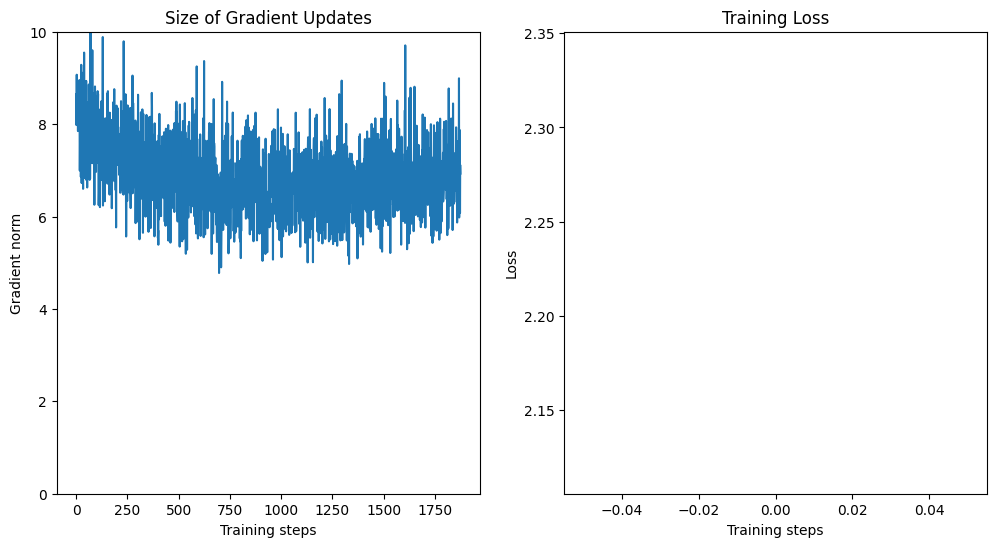

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=4


Epoch 1:   1%|          | 10/1875 [00:00<01:34, 19.73it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.390389


Epoch 1:   6%|▌         | 109/1875 [00:02<00:39, 44.28it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.258376


Epoch 1:  11%|█         | 205/1875 [00:05<00:40, 41.39it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.338693


Epoch 1:  16%|█▋        | 307/1875 [00:07<00:36, 42.87it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.285201


Epoch 1:  22%|██▏       | 408/1875 [00:09<00:29, 49.75it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.187119


Epoch 1:  27%|██▋       | 506/1875 [00:11<00:25, 52.88it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.276348


Epoch 1:  32%|███▏      | 608/1875 [00:13<00:25, 49.47it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.210264


Epoch 1:  38%|███▊      | 705/1875 [00:15<00:23, 50.84it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.084478


Epoch 1:  43%|████▎     | 808/1875 [00:17<00:22, 47.91it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.318616


Epoch 1:  48%|████▊     | 903/1875 [00:19<00:18, 51.45it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.002923


Epoch 1:  54%|█████▍    | 1009/1875 [00:21<00:18, 47.73it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.081828


Epoch 1:  59%|█████▉    | 1107/1875 [00:24<00:18, 41.39it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.840446


Epoch 1:  64%|██████▍   | 1207/1875 [00:26<00:12, 51.62it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.793674


Epoch 1:  70%|██████▉   | 1306/1875 [00:28<00:11, 48.49it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.779726


Epoch 1:  75%|███████▌  | 1412/1875 [00:30<00:08, 52.93it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.809054


Epoch 1:  80%|████████  | 1508/1875 [00:32<00:07, 48.39it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.970083


Epoch 1:  86%|████████▌ | 1610/1875 [00:34<00:05, 47.04it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.854801


Epoch 1:  91%|█████████ | 1710/1875 [00:36<00:03, 49.57it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.910616


Epoch 1:  97%|█████████▋| 1810/1875 [00:38<00:01, 50.88it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.003675


Epoch 1: 100%|██████████| 1875/1875 [00:40<00:00, 46.86it/s]


Train set: Avg. loss: 2.0644, Time: 40.0 secs 




Test set: Avg. loss: 0.0030, Accuracy: 53%, Time: 3.9 secs

Train loss: 2.0644123525619507, Test loss: 0.0030326696634292603, Test accuracy: 52.77, Train time: 40.015279054641724, Test time: 3.944563865661621


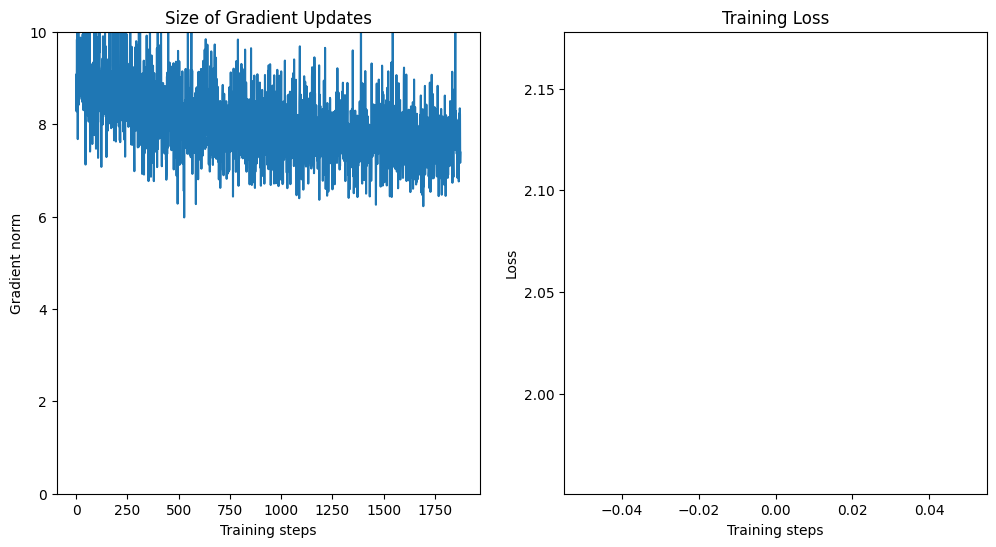

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:26,  5.74it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.420421


Epoch 1:  11%|█▏        | 211/1875 [00:04<00:33, 50.36it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.604576


Epoch 1:  22%|██▏       | 409/1875 [00:08<00:29, 49.60it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.385855


Epoch 1:  32%|███▏      | 609/1875 [00:12<00:25, 50.59it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.315995


Epoch 1:  43%|████▎     | 809/1875 [00:16<00:22, 48.37it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.286264


Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:16, 53.79it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.256309


Epoch 1:  64%|██████▍   | 1209/1875 [00:24<00:12, 52.40it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.037289


Epoch 1:  75%|███████▌  | 1410/1875 [00:28<00:09, 50.38it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.914854


Epoch 1:  86%|████████▌ | 1608/1875 [00:32<00:06, 43.52it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.152167


Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 46.70it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.066862


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.79it/s]


Train set: Avg. loss: 2.2045, Time: 37.7 secs 




Test set: Avg. loss: 0.0036, Accuracy: 42%, Time: 3.2 secs

Train loss: 2.2044547841389974, Test loss: 0.0035921247363090514, Test accuracy: 42.11, Train time: 37.66627788543701, Test time: 3.231071949005127


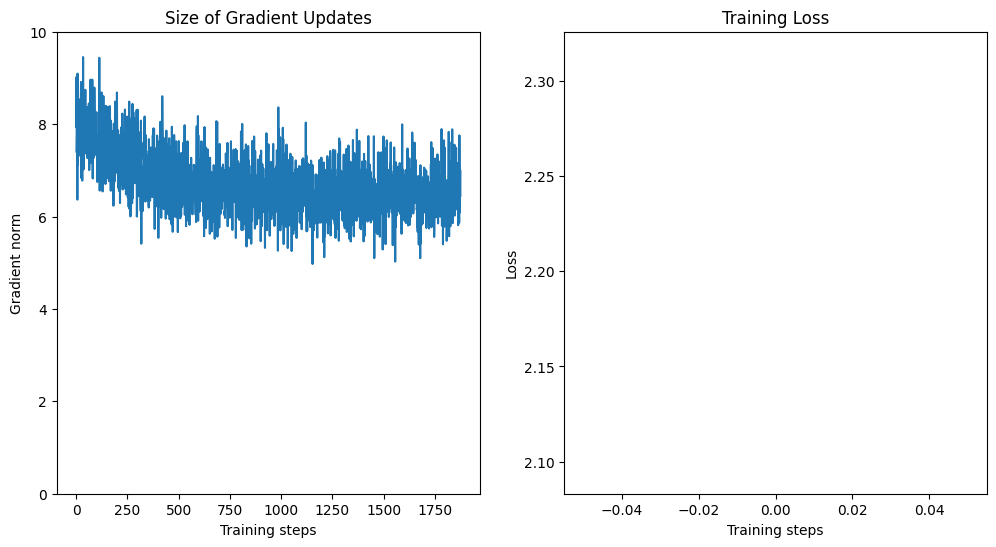

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 5/1875 [00:00<01:40, 18.57it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.662353


Epoch 1:  11%|█         | 207/1875 [00:04<00:33, 50.10it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.411962


Epoch 1:  22%|██▏       | 409/1875 [00:08<00:33, 44.31it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.236971


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:26, 47.30it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.047578


Epoch 1:  43%|████▎     | 806/1875 [00:16<00:20, 51.93it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.953628


Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:16, 51.96it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.143386


Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:13, 50.16it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.340720


Epoch 1:  75%|███████▌  | 1411/1875 [00:28<00:09, 49.42it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.229958


Epoch 1:  86%|████████▌ | 1611/1875 [00:32<00:05, 51.66it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.192319


Epoch 1:  97%|█████████▋| 1811/1875 [00:35<00:01, 51.51it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.791213


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.24it/s]


Train set: Avg. loss: 2.2324, Time: 37.3 secs 




Test set: Avg. loss: 0.0037, Accuracy: 40%, Time: 3.4 secs

Train loss: 2.2324405234654745, Test loss: 0.0036813396453857423, Test accuracy: 40.02, Train time: 37.331603050231934, Test time: 3.404789447784424


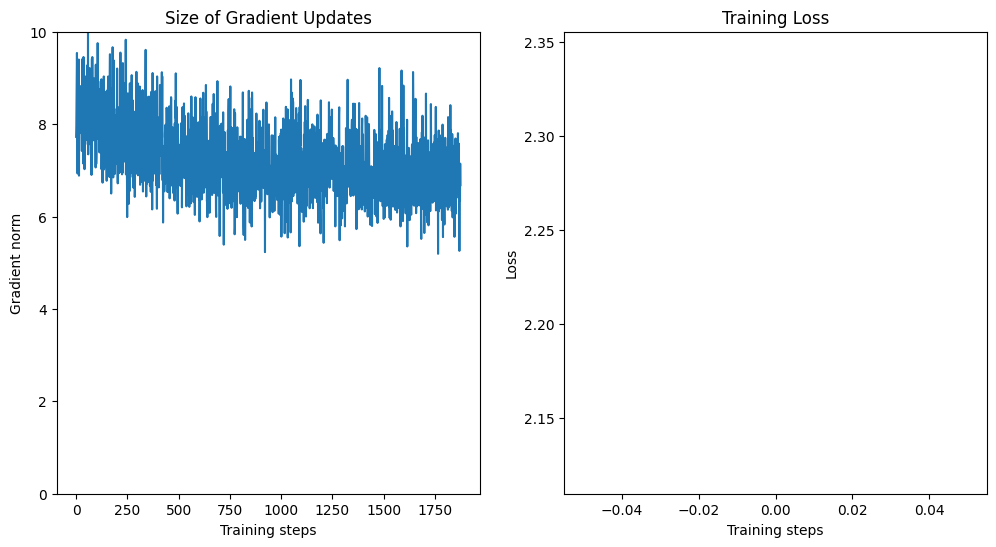

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 7/1875 [00:00<02:11, 14.21it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.610849


Epoch 1:  11%|█         | 208/1875 [00:04<00:36, 45.85it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.319841


Epoch 1:  22%|██▏       | 406/1875 [00:09<00:35, 41.25it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.355262


Epoch 1:  33%|███▎      | 610/1875 [00:13<00:24, 52.31it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.404060


Epoch 1:  43%|████▎     | 812/1875 [00:17<00:18, 58.04it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.355498


Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:20, 42.00it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.285634


Epoch 1:  64%|██████▍   | 1207/1875 [00:26<00:14, 46.35it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.283196


Epoch 1:  75%|███████▌  | 1409/1875 [00:29<00:08, 55.26it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.299311


Epoch 1:  86%|████████▌ | 1610/1875 [00:33<00:04, 53.55it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.139756


Epoch 1:  96%|█████████▋| 1807/1875 [00:37<00:01, 48.56it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.022864


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.75it/s]


Train set: Avg. loss: 2.2450, Time: 39.3 secs 




Test set: Avg. loss: 0.0038, Accuracy: 39%, Time: 4.1 secs

Train loss: 2.2449693047205606, Test loss: 0.0037853186726570127, Test accuracy: 39.09, Train time: 39.27518916130066, Test time: 4.08769416809082


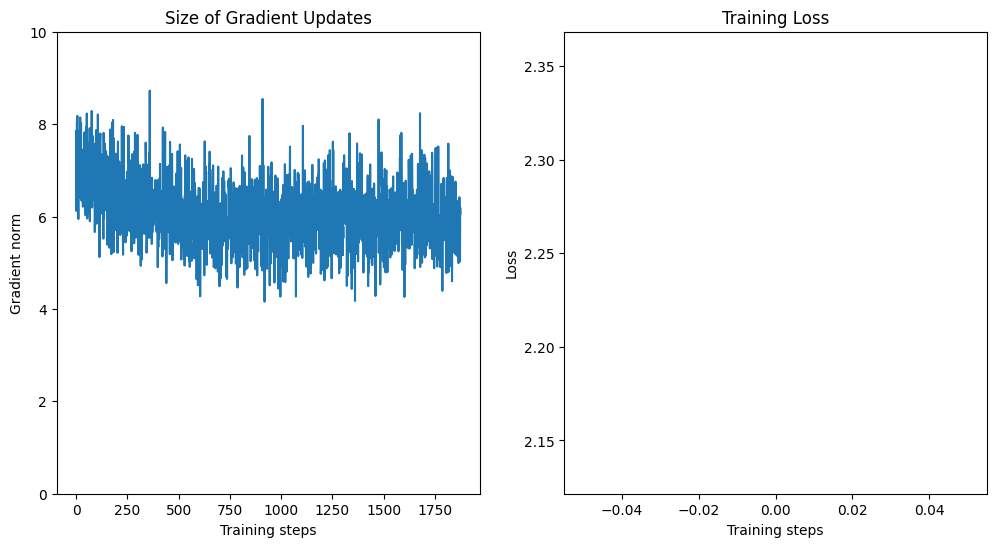

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<04:51,  6.43it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.616847


Epoch 1:  27%|██▋       | 506/1875 [00:10<00:26, 50.78it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.248332


Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:17, 50.93it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.251310


Epoch 1:  81%|████████  | 1511/1875 [00:31<00:06, 53.91it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.129451


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.80it/s]


Train set: Avg. loss: 2.2422, Time: 38.4 secs 




Test set: Avg. loss: 0.0037, Accuracy: 41%, Time: 3.8 secs

Train loss: 2.2421854311625165, Test loss: 0.0036556283831596374, Test accuracy: 41.34, Train time: 38.43025588989258, Test time: 3.8407883644104004


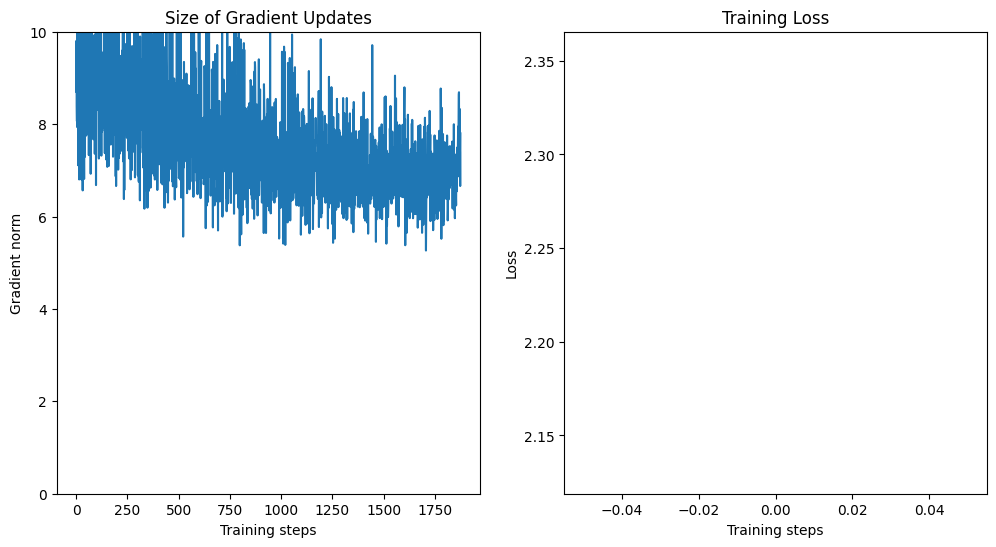

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 8/1875 [00:00<01:15, 24.78it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.495523


Epoch 1:  27%|██▋       | 507/1875 [00:10<00:27, 49.29it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.436388


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:19, 44.96it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.274538


Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 52.88it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.891148


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.10it/s]


Train set: Avg. loss: 2.1655, Time: 37.4 secs 




Test set: Avg. loss: 0.0034, Accuracy: 48%, Time: 3.4 secs

Train loss: 2.1655353494644167, Test loss: 0.0034040331959724426, Test accuracy: 48.29, Train time: 37.43558311462402, Test time: 3.3694801330566406


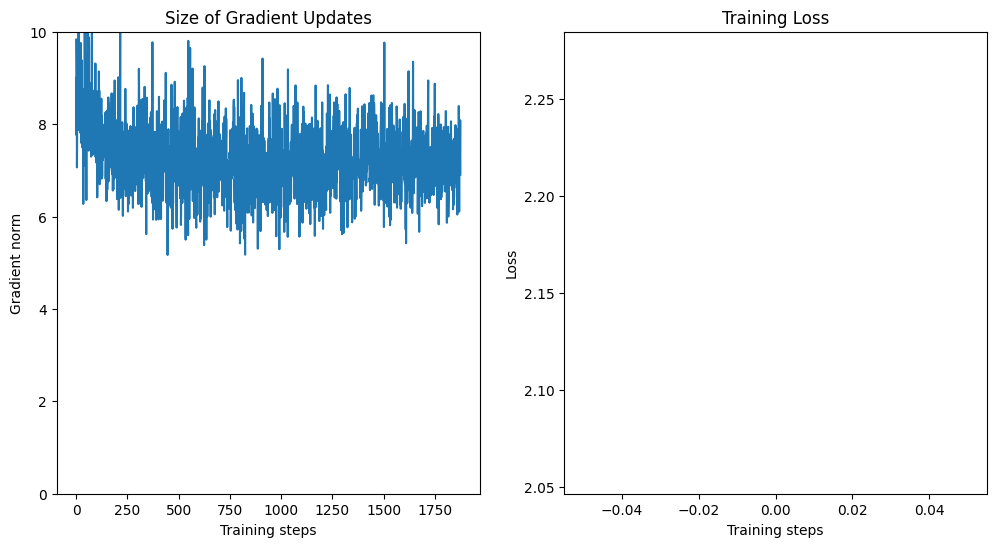

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 4/1875 [00:00<03:42,  8.42it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.414424


Epoch 1:  27%|██▋       | 511/1875 [00:10<00:27, 49.00it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.279756


Epoch 1:  54%|█████▍    | 1008/1875 [00:21<00:18, 45.69it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.969673


Epoch 1:  81%|████████  | 1511/1875 [00:31<00:06, 52.85it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.148554


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.37it/s]


Train set: Avg. loss: 2.1668, Time: 38.8 secs 




Test set: Avg. loss: 0.0033, Accuracy: 47%, Time: 3.9 secs

Train loss: 2.166819871711731, Test loss: 0.003336460256576538, Test accuracy: 47.02, Train time: 38.76820993423462, Test time: 3.9257700443267822


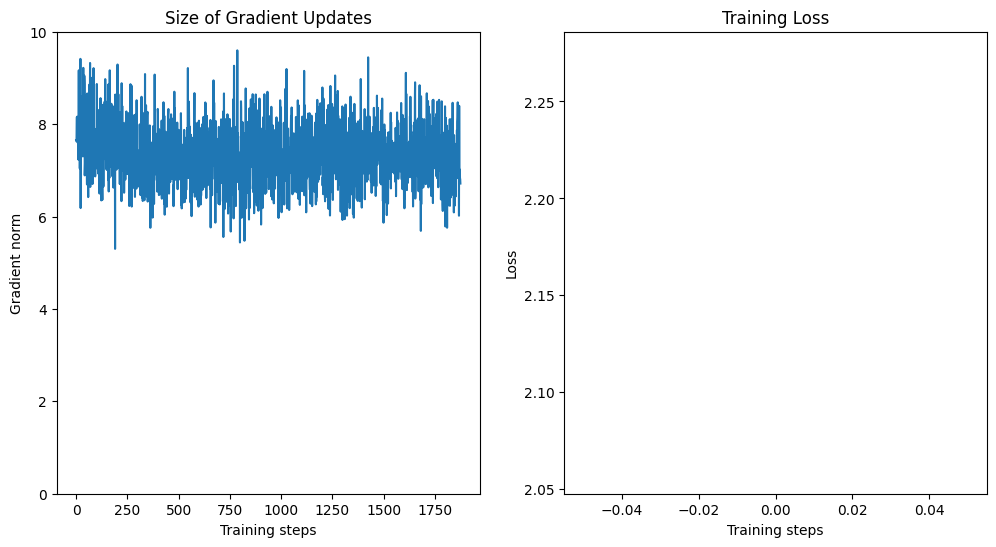

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<04:57,  6.29it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.727882


Epoch 1:   6%|▌         | 112/1875 [00:02<00:32, 54.82it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.352461


Epoch 1:  11%|█         | 208/1875 [00:04<00:31, 52.76it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.652748


Epoch 1:  17%|█▋        | 310/1875 [00:06<00:28, 54.47it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.414171


Epoch 1:  22%|██▏       | 406/1875 [00:07<00:27, 53.78it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.479473


Epoch 1:  27%|██▋       | 512/1875 [00:09<00:25, 54.44it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.254795


Epoch 1:  32%|███▏      | 608/1875 [00:11<00:23, 54.72it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.192118


Epoch 1:  38%|███▊      | 707/1875 [00:13<00:23, 48.97it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.545320


Epoch 1:  43%|████▎     | 807/1875 [00:15<00:19, 53.81it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.343864


Epoch 1:  49%|████▊     | 912/1875 [00:17<00:17, 55.17it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.210823


Epoch 1:  54%|█████▍    | 1008/1875 [00:19<00:16, 52.23it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.325623


Epoch 1:  59%|█████▉    | 1110/1875 [00:21<00:15, 50.18it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.237497


Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:12, 52.33it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.286860


Epoch 1:  70%|██████▉   | 1306/1875 [00:25<00:10, 52.82it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.109092


Epoch 1:  75%|███████▌  | 1410/1875 [00:27<00:08, 51.99it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.234272


Epoch 1:  80%|████████  | 1506/1875 [00:29<00:07, 52.09it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.101924


Epoch 1:  86%|████████▌ | 1605/1875 [00:31<00:06, 44.90it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.138426


Epoch 1:  91%|█████████ | 1709/1875 [00:33<00:03, 54.99it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.033528


Epoch 1:  97%|█████████▋| 1811/1875 [00:35<00:01, 54.40it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.182905


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.60it/s]


Train set: Avg. loss: 0.4243, Time: 36.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.42429641726613043, Test loss: 0.0001326009437441826, Test accuracy: 96.12, Train time: 36.34830021858215, Test time: 3.1730995178222656


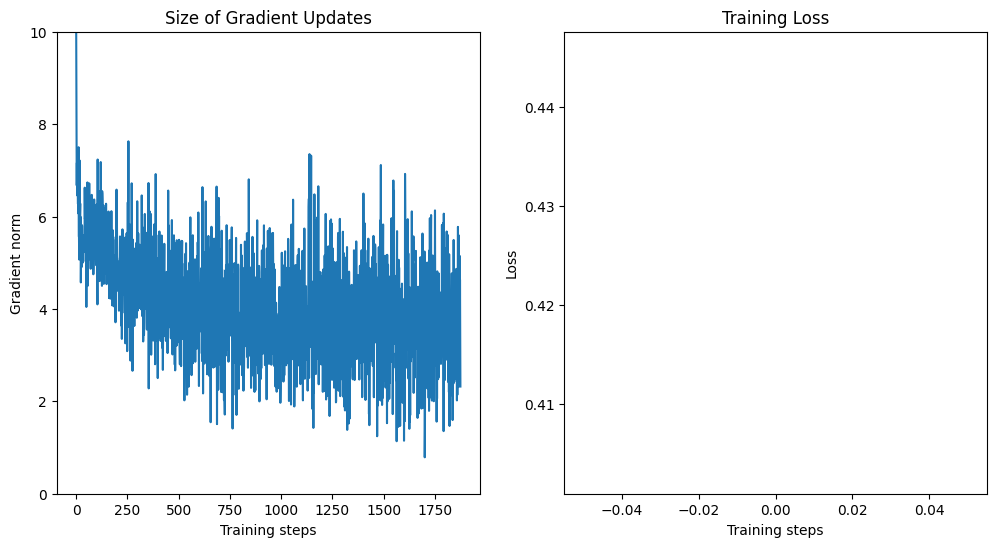

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=2


Epoch 1:   0%|          | 8/1875 [00:00<01:10, 26.63it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.582607


Epoch 1:   6%|▌         | 107/1875 [00:02<00:31, 55.26it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.709939


Epoch 1:  11%|█         | 208/1875 [00:04<00:33, 49.21it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.475340


Epoch 1:  16%|█▋        | 306/1875 [00:06<00:32, 48.06it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.386183


Epoch 1:  22%|██▏       | 408/1875 [00:08<00:28, 51.96it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.355073


Epoch 1:  27%|██▋       | 511/1875 [00:10<00:26, 52.32it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.318647


Epoch 1:  32%|███▏      | 608/1875 [00:12<00:22, 56.67it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.290281


Epoch 1:  38%|███▊      | 710/1875 [00:14<00:22, 52.24it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.219432


Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 50.88it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.220579


Epoch 1:  48%|████▊     | 909/1875 [00:18<00:20, 47.73it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.217002


Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:16, 53.28it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.130478


Epoch 1:  59%|█████▉    | 1106/1875 [00:22<00:15, 48.17it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.160476


Epoch 1:  64%|██████▍   | 1206/1875 [00:24<00:13, 48.06it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.297311


Epoch 1:  70%|██████▉   | 1310/1875 [00:26<00:11, 49.27it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.214818


Epoch 1:  75%|███████▍  | 1405/1875 [00:28<00:09, 47.47it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.218962


Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 52.40it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.273717


Epoch 1:  86%|████████▌ | 1606/1875 [00:32<00:05, 52.39it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.123674


Epoch 1:  91%|█████████ | 1708/1875 [00:34<00:03, 50.55it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.294288


Epoch 1:  97%|█████████▋| 1810/1875 [00:36<00:01, 54.20it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.619960


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.70it/s]


Train set: Avg. loss: 0.4295, Time: 37.7 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.4294880783935388, Test loss: 0.0001283596407622099, Test accuracy: 96.44, Train time: 37.73851418495178, Test time: 3.2902753353118896


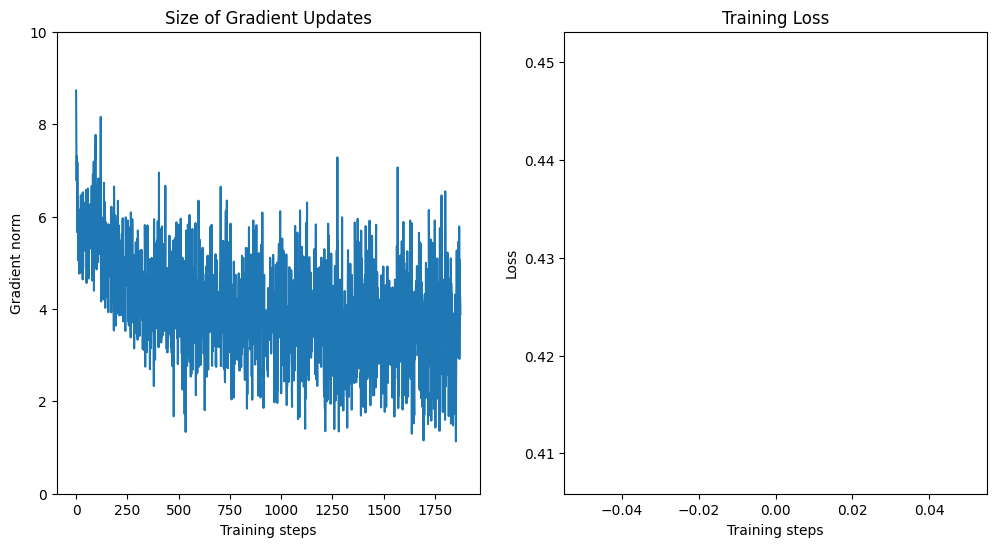

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=4


Epoch 1:   0%|          | 4/1875 [00:00<04:02,  7.72it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.398927


Epoch 1:   6%|▌         | 106/1875 [00:02<00:40, 43.86it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.152591


Epoch 1:  11%|█         | 208/1875 [00:05<00:36, 46.10it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.508443


Epoch 1:  17%|█▋        | 310/1875 [00:06<00:27, 56.07it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.818758


Epoch 1:  22%|██▏       | 406/1875 [00:08<00:26, 56.38it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.504041


Epoch 1:  27%|██▋       | 511/1875 [00:10<00:25, 53.68it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.512611


Epoch 1:  32%|███▏      | 609/1875 [00:12<00:24, 52.26it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.176641


Epoch 1:  38%|███▊      | 708/1875 [00:14<00:24, 48.26it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.375442


Epoch 1:  43%|████▎     | 807/1875 [00:16<00:22, 48.30it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.260739


Epoch 1:  48%|████▊     | 906/1875 [00:18<00:19, 49.56it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.389134


Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:17, 49.19it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.281418


Epoch 1:  59%|█████▉    | 1105/1875 [00:22<00:17, 45.26it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.140225


Epoch 1:  65%|██████▍   | 1210/1875 [00:24<00:12, 55.42it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.035585


Epoch 1:  70%|██████▉   | 1311/1875 [00:26<00:10, 52.85it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.128754


Epoch 1:  75%|███████▌  | 1409/1875 [00:28<00:09, 50.67it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.274674


Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 53.44it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.230596


Epoch 1:  86%|████████▌ | 1606/1875 [00:32<00:05, 50.64it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.186626


Epoch 1:  91%|█████████ | 1707/1875 [00:34<00:03, 48.55it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.598338


Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 46.88it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.314527


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.15it/s]


Train set: Avg. loss: 0.3951, Time: 38.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.9 secs

Train loss: 0.395095934677124, Test loss: 0.00011829955391585826, Test accuracy: 96.27, Train time: 38.1589834690094, Test time: 3.9457309246063232


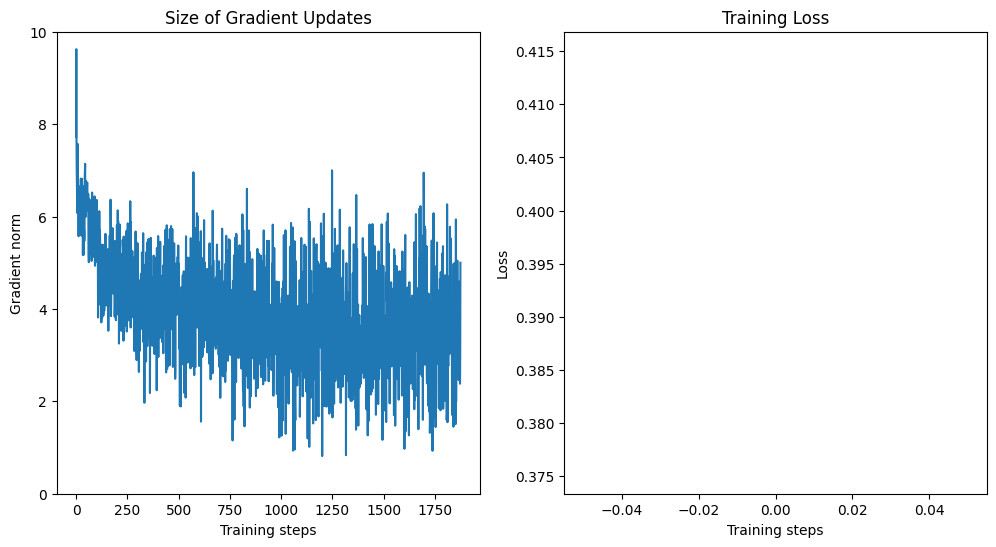

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:36,  5.57it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.317315


Epoch 1:  11%|█         | 209/1875 [00:04<00:30, 55.12it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.594372


Epoch 1:  22%|██▏       | 407/1875 [00:07<00:27, 52.78it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.328885


Epoch 1:  33%|███▎      | 612/1875 [00:11<00:23, 53.38it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.442438


Epoch 1:  43%|████▎     | 810/1875 [00:15<00:21, 50.24it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.365864


Epoch 1:  54%|█████▍    | 1011/1875 [00:19<00:16, 51.29it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.275402


Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:12, 54.02it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.215462


Epoch 1:  75%|███████▍  | 1406/1875 [00:27<00:09, 49.32it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.173673


Epoch 1:  86%|████████▌ | 1608/1875 [00:31<00:06, 41.27it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.028884


Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 49.08it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.428370


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.88it/s]


Train set: Avg. loss: 0.3882, Time: 37.6 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.38821861403783164, Test loss: 0.0001222544752061367, Test accuracy: 96.29, Train time: 37.60096096992493, Test time: 3.3324029445648193


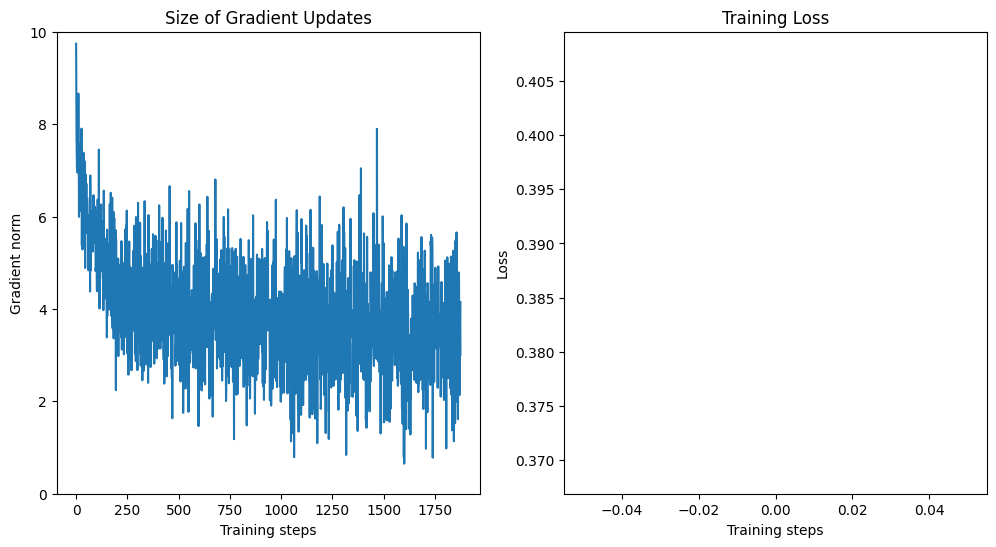

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=2


Epoch 1:   0%|          | 8/1875 [00:00<01:22, 22.63it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.639757


Epoch 1:  11%|█         | 210/1875 [00:04<00:35, 46.46it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.543418


Epoch 1:  22%|██▏       | 408/1875 [00:08<00:29, 49.45it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.524499


Epoch 1:  33%|███▎      | 611/1875 [00:13<00:25, 49.07it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.232526


Epoch 1:  43%|████▎     | 808/1875 [00:17<00:21, 49.28it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.346762


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:16, 51.66it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.432322


Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:13, 50.46it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.294601


Epoch 1:  75%|███████▌  | 1411/1875 [00:29<00:09, 47.57it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.571584


Epoch 1:  86%|████████▌ | 1608/1875 [00:33<00:05, 49.89it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.148187


Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 52.60it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.316262


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.99it/s]


Train set: Avg. loss: 0.4188, Time: 38.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.7 secs

Train loss: 0.41879977658092976, Test loss: 0.0001225011583417654, Test accuracy: 96.41, Train time: 38.285935163497925, Test time: 3.661198616027832


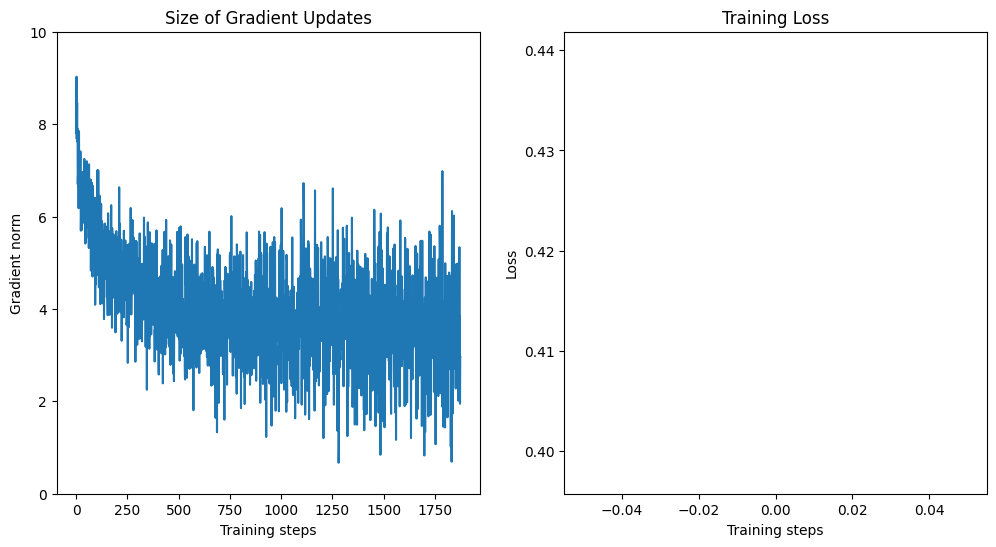

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=4


Epoch 1:   0%|          | 5/1875 [00:00<04:05,  7.62it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.819669


Epoch 1:  11%|█         | 208/1875 [00:05<00:34, 48.45it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.449809


Epoch 1:  22%|██▏       | 407/1875 [00:09<00:30, 48.52it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.274769


Epoch 1:  33%|███▎      | 611/1875 [00:13<00:23, 54.87it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.142197


Epoch 1:  43%|████▎     | 809/1875 [00:17<00:21, 50.11it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.127320


Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:18, 47.65it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.147269


Epoch 1:  64%|██████▍   | 1207/1875 [00:25<00:13, 50.45it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.132075


Epoch 1:  75%|███████▌  | 1411/1875 [00:29<00:09, 51.04it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.294538


Epoch 1:  86%|████████▌ | 1611/1875 [00:33<00:05, 51.52it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.285409


Epoch 1:  97%|█████████▋| 1810/1875 [00:37<00:01, 46.68it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.297154


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.82it/s]


Train set: Avg. loss: 0.3875, Time: 39.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.9 secs

Train loss: 0.3875239232301712, Test loss: 0.0001129004843533039, Test accuracy: 96.64, Train time: 39.22027564048767, Test time: 3.860179901123047


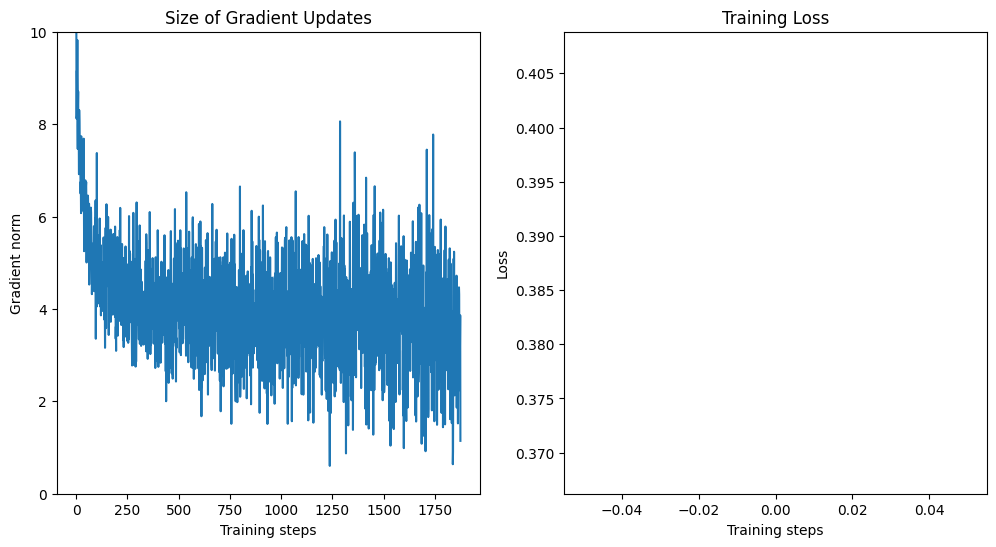

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<04:51,  6.42it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.822946


Epoch 1:  27%|██▋       | 509/1875 [00:09<00:27, 50.41it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.202709


Epoch 1:  54%|█████▍    | 1012/1875 [00:19<00:15, 54.77it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.124168


Epoch 1:  80%|████████  | 1505/1875 [00:29<00:07, 47.25it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.174144


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.14it/s]


Train set: Avg. loss: 0.3974, Time: 36.7 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.3 secs

Train loss: 0.39742201588948567, Test loss: 0.00011056481339037419, Test accuracy: 96.78, Train time: 36.6749804019928, Test time: 3.2787954807281494


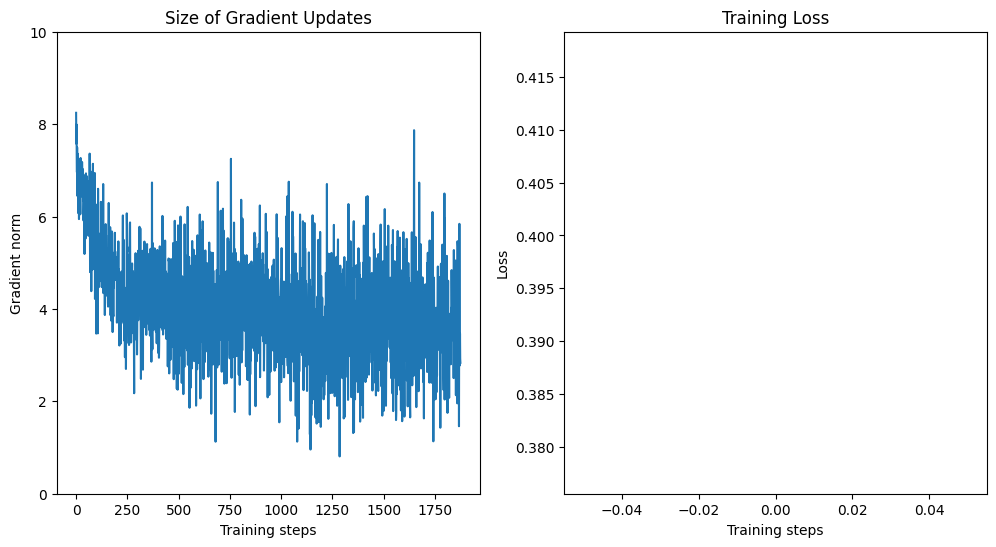

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=2


Epoch 1:   0%|          | 8/1875 [00:00<01:12, 25.63it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.873040


Epoch 1:  27%|██▋       | 506/1875 [00:10<00:27, 49.23it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.459187


Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:15, 54.30it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.348110


Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 48.90it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.200088


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.40it/s]


Train set: Avg. loss: 0.3850, Time: 38.0 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.38497444530924163, Test loss: 0.0001204740684479475, Test accuracy: 96.41, Train time: 37.96099019050598, Test time: 3.314237594604492


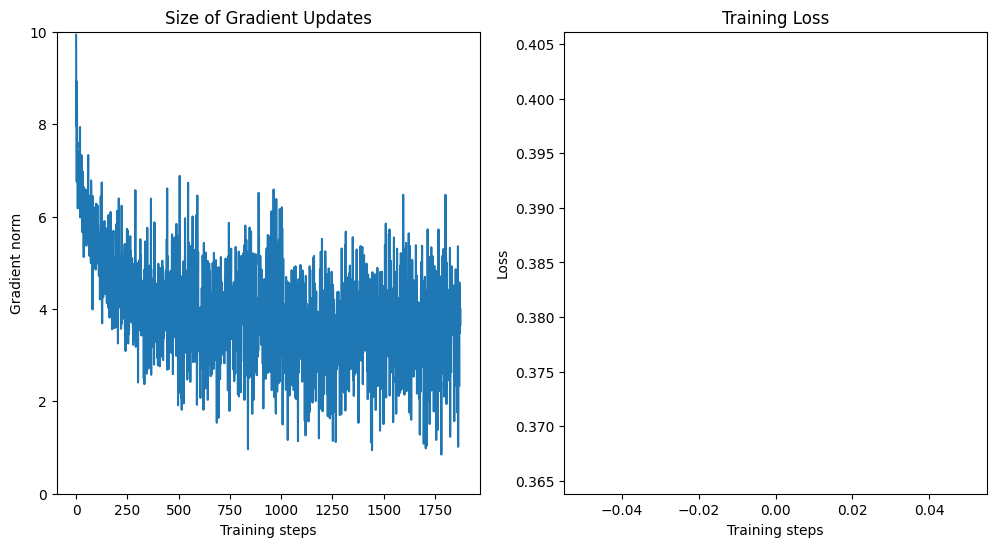

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=4


Epoch 1:   0%|          | 6/1875 [00:00<02:28, 12.54it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.918131


Epoch 1:  27%|██▋       | 506/1875 [00:11<00:27, 49.02it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.302444


Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:19, 44.31it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.229052


Epoch 1:  80%|████████  | 1507/1875 [00:31<00:06, 55.01it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.177550


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.13it/s]


Train set: Avg. loss: 0.3977, Time: 38.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 4.0 secs

Train loss: 0.3976549435337385, Test loss: 0.00012208965606987475, Test accuracy: 96.38, Train time: 38.17484426498413, Test time: 4.049440383911133


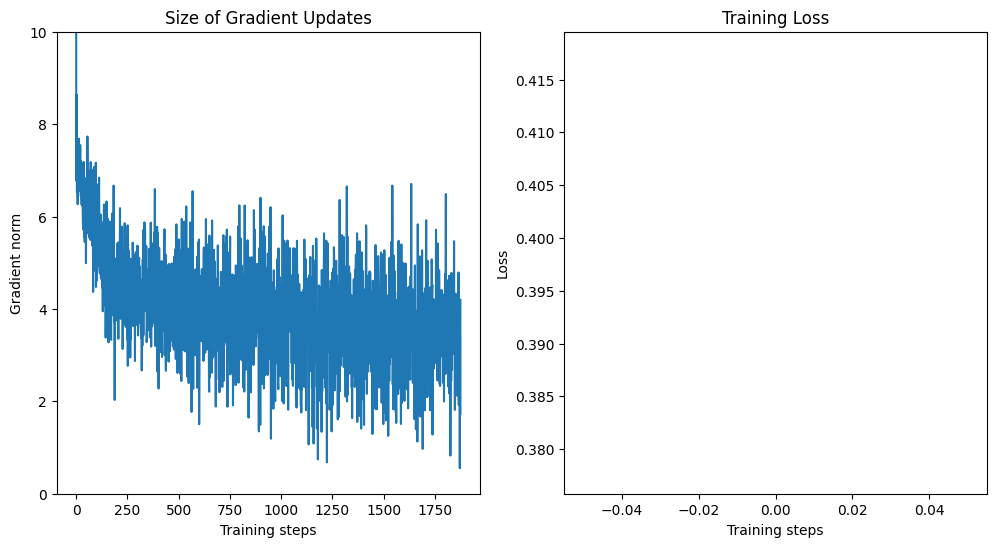

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:03,  6.18it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.487091


Epoch 1:   6%|▌         | 107/1875 [00:02<00:35, 49.38it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.301792


Epoch 1:  11%|█         | 209/1875 [00:04<00:31, 53.74it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.930330


Epoch 1:  17%|█▋        | 311/1875 [00:06<00:30, 50.53it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.450806


Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 49.55it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.646527


Epoch 1:  27%|██▋       | 510/1875 [00:10<00:27, 50.01it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.343240


Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 50.99it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.372964


Epoch 1:  38%|███▊      | 707/1875 [00:14<00:22, 51.89it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.970338


Epoch 1:  43%|████▎     | 811/1875 [00:16<00:21, 50.35it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.030713


Epoch 1:  48%|████▊     | 906/1875 [00:18<00:18, 53.38it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.586101


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:17, 50.33it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.566271


Epoch 1:  59%|█████▉    | 1111/1875 [00:22<00:15, 49.95it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.863115


Epoch 1:  65%|██████▍   | 1211/1875 [00:24<00:12, 51.47it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.841911


Epoch 1:  70%|██████▉   | 1307/1875 [00:26<00:11, 49.10it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.698522


Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:09, 50.75it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.272237


Epoch 1:  80%|████████  | 1509/1875 [00:30<00:07, 49.98it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.636201


Epoch 1:  86%|████████▌ | 1604/1875 [00:31<00:05, 46.75it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.928196


Epoch 1:  91%|█████████ | 1709/1875 [00:34<00:03, 52.52it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.543249


Epoch 1:  97%|█████████▋| 1811/1875 [00:36<00:01, 52.88it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.335001


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.75it/s]


Train set: Avg. loss: 1.0144, Time: 37.7 secs 




Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.0143692771673203, Test loss: 0.0002993794217705727, Test accuracy: 92.06, Train time: 37.69575119018555, Test time: 3.203197717666626


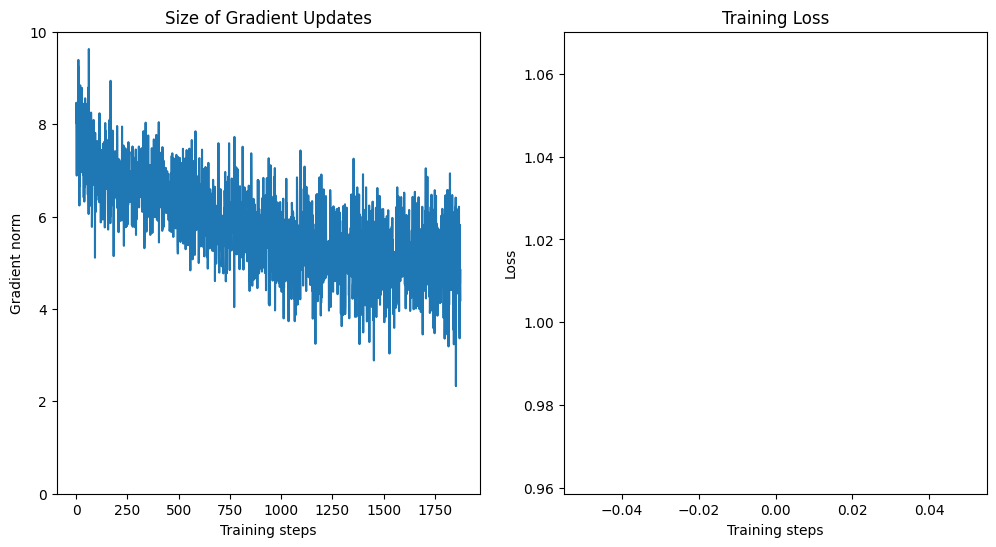

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 9/1875 [00:00<01:12, 25.69it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.527552


Epoch 1:   6%|▌         | 113/1875 [00:02<00:32, 53.43it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.365488


Epoch 1:  11%|█         | 210/1875 [00:04<00:31, 53.38it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.775885


Epoch 1:  16%|█▋        | 309/1875 [00:06<00:30, 50.75it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.629806


Epoch 1:  22%|██▏       | 411/1875 [00:08<00:28, 51.96it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.569783


Epoch 1:  27%|██▋       | 512/1875 [00:10<00:26, 51.04it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.396038


Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 51.07it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.216806


Epoch 1:  38%|███▊      | 706/1875 [00:14<00:22, 51.87it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.095078


Epoch 1:  43%|████▎     | 807/1875 [00:16<00:21, 49.28it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.239583


Epoch 1:  48%|████▊     | 909/1875 [00:18<00:19, 49.25it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.718891


Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:16, 52.55it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.434749


Epoch 1:  59%|█████▉    | 1112/1875 [00:22<00:14, 51.86it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.853759


Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:14, 45.18it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.622486


Epoch 1:  70%|██████▉   | 1308/1875 [00:26<00:11, 48.36it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.599603


Epoch 1:  75%|███████▍  | 1406/1875 [00:28<00:09, 46.92it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.608601


Epoch 1:  81%|████████  | 1510/1875 [00:30<00:07, 46.94it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.688576


Epoch 1:  86%|████████▌ | 1607/1875 [00:32<00:05, 47.23it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.472759


Epoch 1:  91%|█████████ | 1709/1875 [00:34<00:03, 52.03it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.753518


Epoch 1:  96%|█████████▌| 1804/1875 [00:36<00:01, 44.75it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.431474


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.72it/s]


Train set: Avg. loss: 1.0558, Time: 38.5 secs 




Test set: Avg. loss: 0.0003, Accuracy: 91%, Time: 3.5 secs

Train loss: 1.0557822888374329, Test loss: 0.0003182966455817223, Test accuracy: 91.27, Train time: 38.49687480926514, Test time: 3.5028176307678223


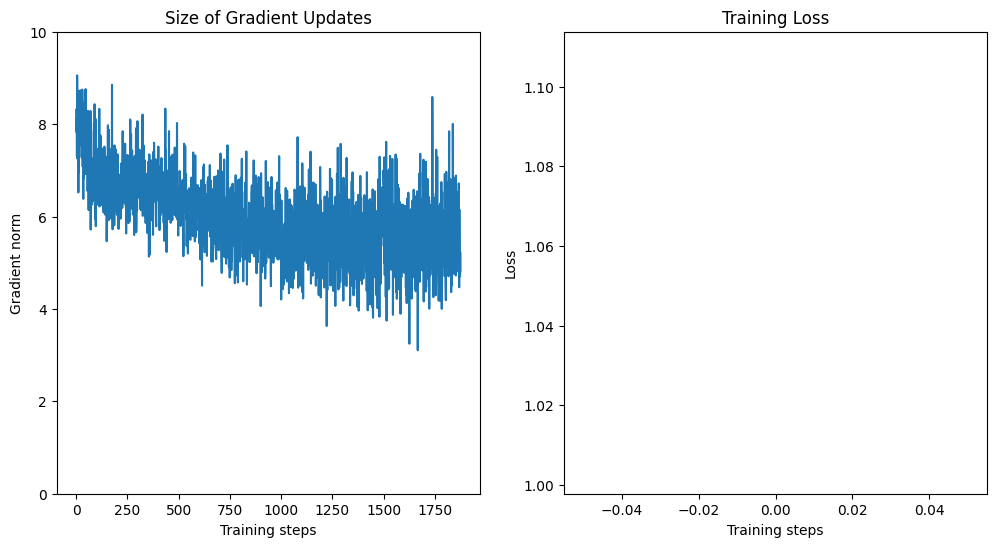

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 7/1875 [00:00<02:26, 12.76it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.612395


Epoch 1:   6%|▌         | 108/1875 [00:02<00:40, 43.85it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.282203


Epoch 1:  11%|█         | 210/1875 [00:05<00:35, 47.20it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.681498


Epoch 1:  17%|█▋        | 311/1875 [00:07<00:30, 51.80it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.693819


Epoch 1:  22%|██▏       | 409/1875 [00:09<00:29, 50.38it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.452917


Epoch 1:  27%|██▋       | 506/1875 [00:11<00:26, 51.83it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.112108


Epoch 1:  32%|███▏      | 605/1875 [00:12<00:24, 51.86it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.551516


Epoch 1:  38%|███▊      | 705/1875 [00:14<00:23, 50.58it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.190288


Epoch 1:  43%|████▎     | 810/1875 [00:17<00:20, 51.99it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.112527


Epoch 1:  48%|████▊     | 908/1875 [00:19<00:18, 53.28it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.895159


Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:19, 45.55it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.556565


Epoch 1:  59%|█████▉    | 1108/1875 [00:23<00:18, 42.43it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.557293


Epoch 1:  65%|██████▍   | 1212/1875 [00:25<00:13, 50.01it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.655341


Epoch 1:  70%|██████▉   | 1308/1875 [00:27<00:11, 51.17it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.582976


Epoch 1:  75%|███████▌  | 1409/1875 [00:29<00:08, 52.53it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.496308


Epoch 1:  81%|████████  | 1511/1875 [00:31<00:06, 55.02it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.509857


Epoch 1:  86%|████████▌ | 1605/1875 [00:33<00:05, 51.07it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.586146


Epoch 1:  91%|█████████ | 1706/1875 [00:35<00:04, 39.51it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.590281


Epoch 1:  97%|█████████▋| 1810/1875 [00:38<00:01, 48.77it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.421985


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.14it/s]


Train set: Avg. loss: 1.1244, Time: 39.8 secs 




Test set: Avg. loss: 0.0003, Accuracy: 91%, Time: 3.8 secs

Train loss: 1.1244468528827032, Test loss: 0.00033031054735183714, Test accuracy: 90.91, Train time: 39.78023552894592, Test time: 3.84381365776062


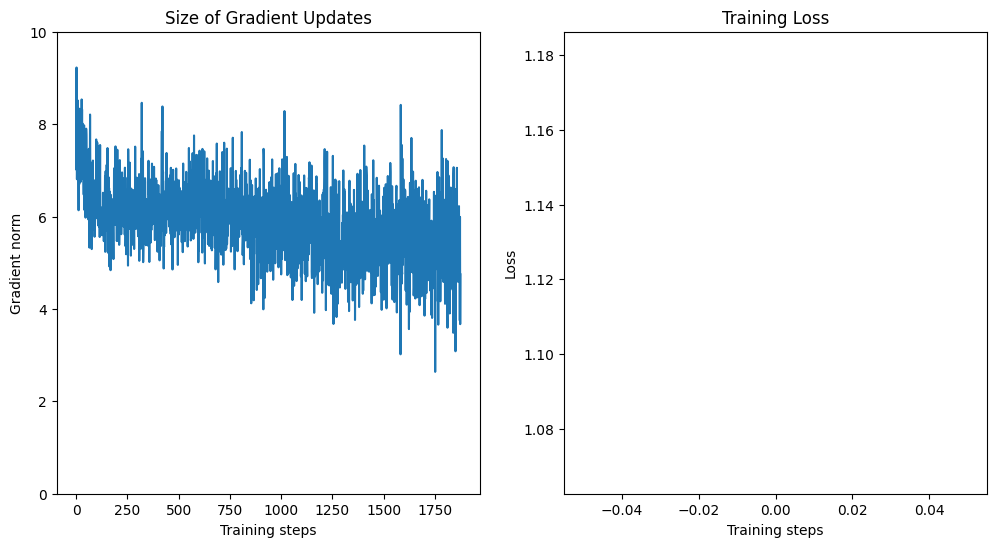

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<04:44,  6.58it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.654792


Epoch 1:  11%|█         | 206/1875 [00:04<00:34, 48.39it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.646814


Epoch 1:  22%|██▏       | 405/1875 [00:08<00:28, 50.84it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.529918


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:29, 42.94it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.300994


Epoch 1:  43%|████▎     | 810/1875 [00:16<00:21, 49.05it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.872366


Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:17, 50.78it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.817807


Epoch 1:  64%|██████▍   | 1208/1875 [00:24<00:13, 49.96it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.644659


Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:10, 42.95it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.715472


Epoch 1:  86%|████████▌ | 1610/1875 [00:33<00:05, 50.97it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.819908


Epoch 1:  96%|█████████▋| 1808/1875 [00:36<00:01, 53.76it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.487149


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.95it/s]


Train set: Avg. loss: 1.0513, Time: 38.3 secs 




Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.0513298472563426, Test loss: 0.00029861156791448595, Test accuracy: 91.95, Train time: 38.31051421165466, Test time: 3.2429256439208984


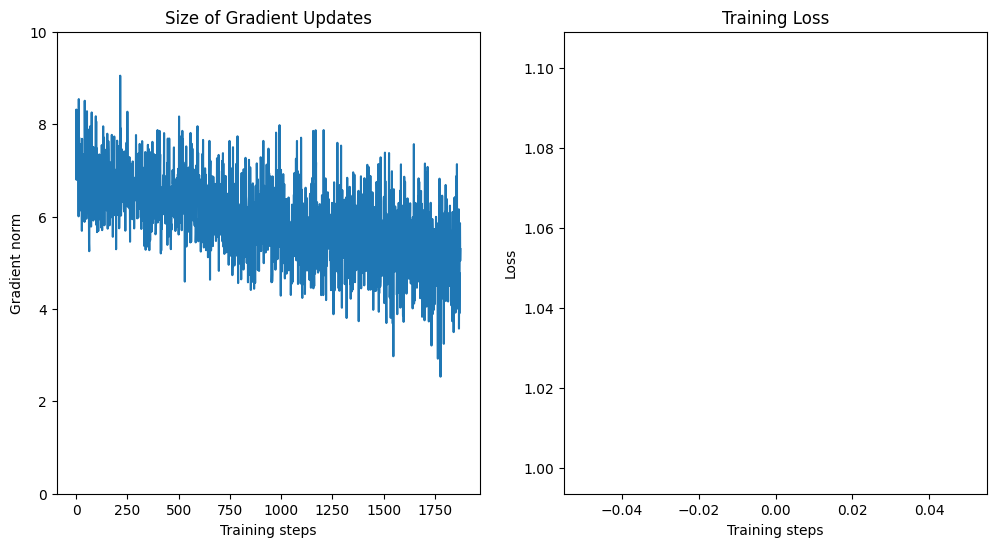

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 8/1875 [00:00<01:11, 26.03it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.635837


Epoch 1:  11%|█         | 207/1875 [00:04<00:35, 46.43it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.545948


Epoch 1:  22%|██▏       | 408/1875 [00:08<00:28, 50.75it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.347969


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:24, 51.16it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.254055


Epoch 1:  43%|████▎     | 809/1875 [00:16<00:20, 51.80it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.949168


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:17, 50.96it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.611979


Epoch 1:  64%|██████▍   | 1204/1875 [00:24<00:15, 43.70it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.811999


Epoch 1:  75%|███████▌  | 1411/1875 [00:28<00:08, 54.00it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.700166


Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:04, 54.34it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.584124


Epoch 1:  96%|█████████▌| 1804/1875 [00:36<00:01, 49.38it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.620028


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.85it/s]


Train set: Avg. loss: 1.0101, Time: 37.6 secs 




Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.7 secs

Train loss: 1.0100684847593306, Test loss: 0.00028820628374814987, Test accuracy: 92.02, Train time: 37.62492609024048, Test time: 3.666337251663208


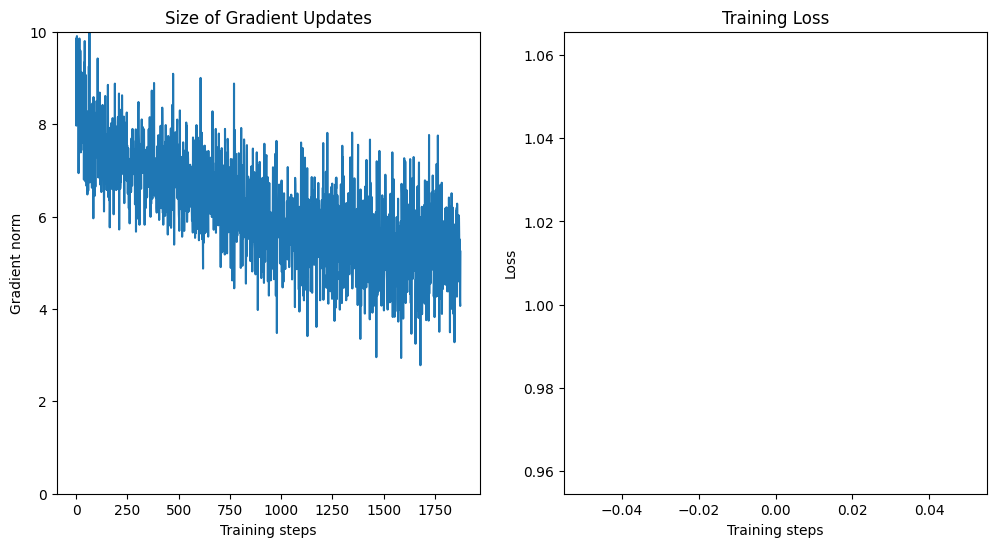

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 5/1875 [00:00<03:07,  9.98it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.728462


Epoch 1:  11%|█         | 205/1875 [00:04<00:34, 48.97it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.808287


Epoch 1:  22%|██▏       | 407/1875 [00:08<00:30, 48.76it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.332868


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:25, 50.69it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.861939


Epoch 1:  43%|████▎     | 802/1875 [00:16<00:25, 41.80it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.753653


Epoch 1:  54%|█████▎    | 1005/1875 [00:21<00:19, 44.74it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.686246


Epoch 1:  64%|██████▍   | 1206/1875 [00:25<00:12, 51.51it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.610902


Epoch 1:  75%|███████▌  | 1407/1875 [00:29<00:08, 54.31it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.753407


Epoch 1:  86%|████████▌ | 1606/1875 [00:33<00:05, 45.31it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.611375


Epoch 1:  96%|█████████▋| 1805/1875 [00:37<00:01, 50.03it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.384793


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.70it/s]


Train set: Avg. loss: 0.9944, Time: 39.3 secs 




Test set: Avg. loss: 0.0003, Accuracy: 93%, Time: 3.8 secs

Train loss: 0.9943850238084793, Test loss: 0.00027577724307775497, Test accuracy: 92.65, Train time: 39.31519651412964, Test time: 3.782594680786133


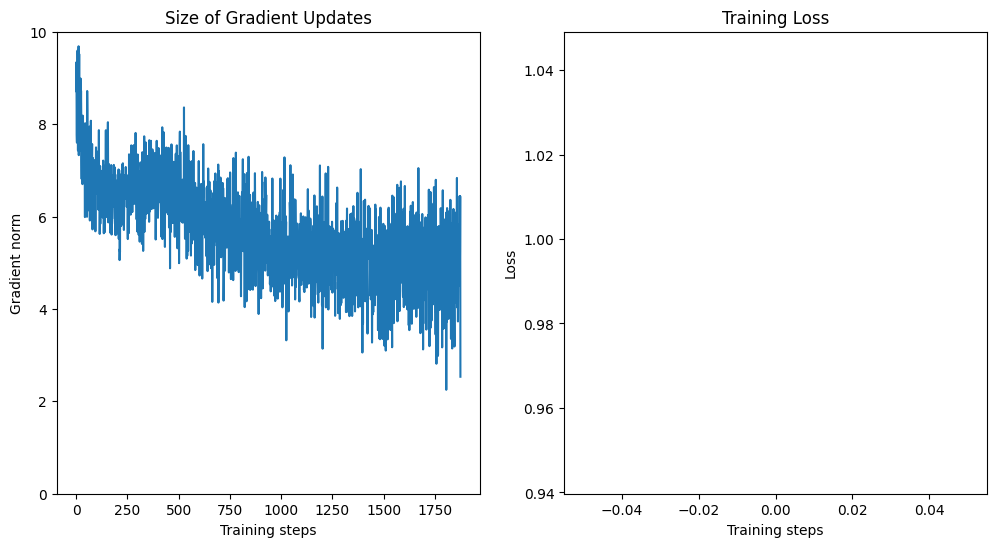

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<04:28,  6.97it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.496758


Epoch 1:  27%|██▋       | 507/1875 [00:09<00:26, 51.01it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.606407


Epoch 1:  54%|█████▎    | 1006/1875 [00:19<00:16, 51.24it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.808641


Epoch 1:  81%|████████  | 1511/1875 [00:29<00:07, 50.18it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.713960


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.70it/s]


Train set: Avg. loss: 1.1398, Time: 36.3 secs 




Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.1397505729198456, Test loss: 0.000311216039955616, Test accuracy: 91.82, Train time: 36.272754430770874, Test time: 3.1613354682922363


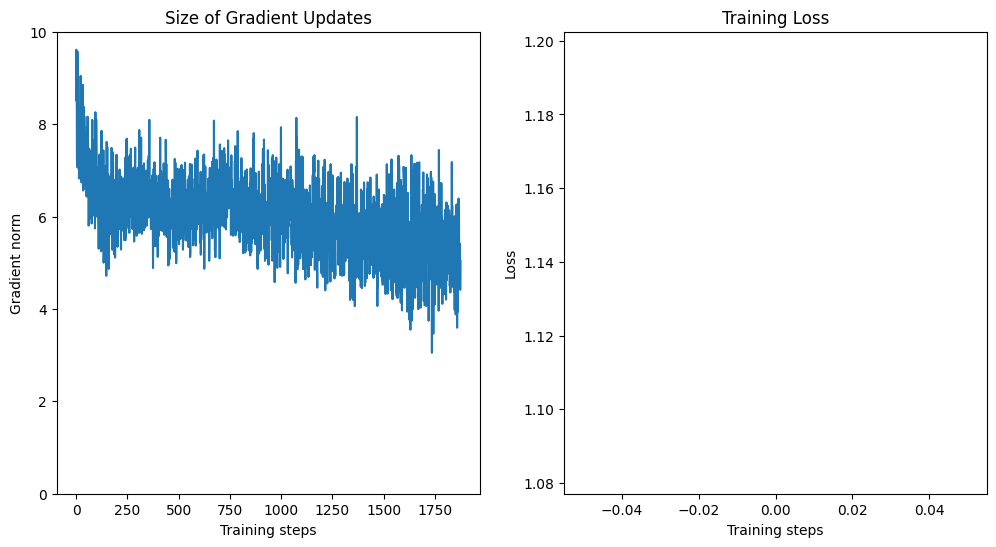

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 6/1875 [00:00<01:36, 19.46it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.687062


Epoch 1:  27%|██▋       | 506/1875 [00:10<00:28, 48.70it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.362425


Epoch 1:  54%|█████▍    | 1009/1875 [00:20<00:19, 44.79it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.818043


Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 48.55it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.523416


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.14it/s]


Train set: Avg. loss: 1.0743, Time: 38.2 secs 




Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.5 secs

Train loss: 1.0743262096563975, Test loss: 0.00029642157107591627, Test accuracy: 92.11, Train time: 38.16690158843994, Test time: 3.5170886516571045


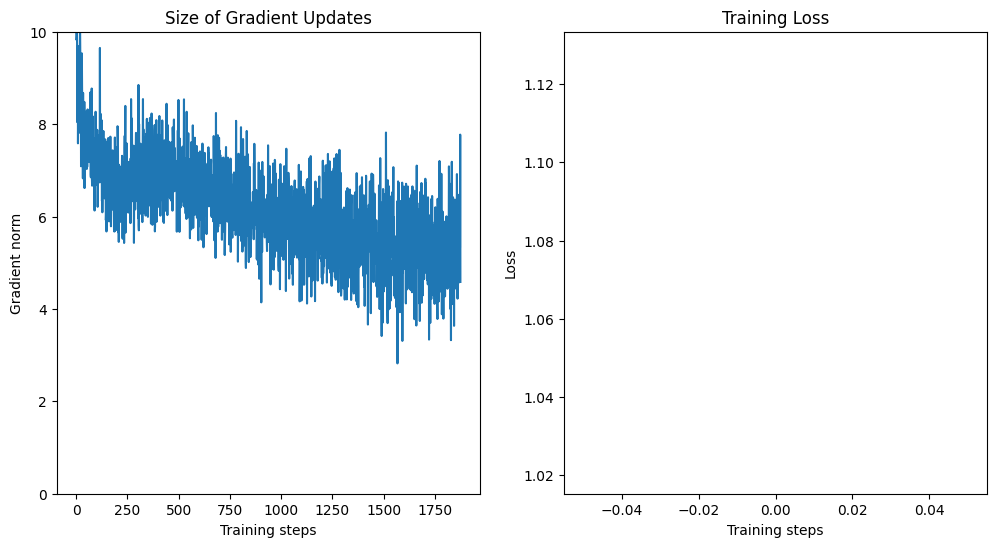

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 4/1875 [00:00<04:01,  7.73it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.496415


Epoch 1:  27%|██▋       | 510/1875 [00:11<00:24, 55.02it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.084418


Epoch 1:  54%|█████▎    | 1007/1875 [00:21<00:18, 47.26it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.012232


Epoch 1:  80%|████████  | 1507/1875 [00:31<00:07, 50.11it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.623512


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.20it/s]


Train set: Avg. loss: 1.0286, Time: 38.9 secs 




Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 4.0 secs

Train loss: 1.0285632347663243, Test loss: 0.0002811617001891136, Test accuracy: 92.45, Train time: 38.91163921356201, Test time: 3.976336717605591


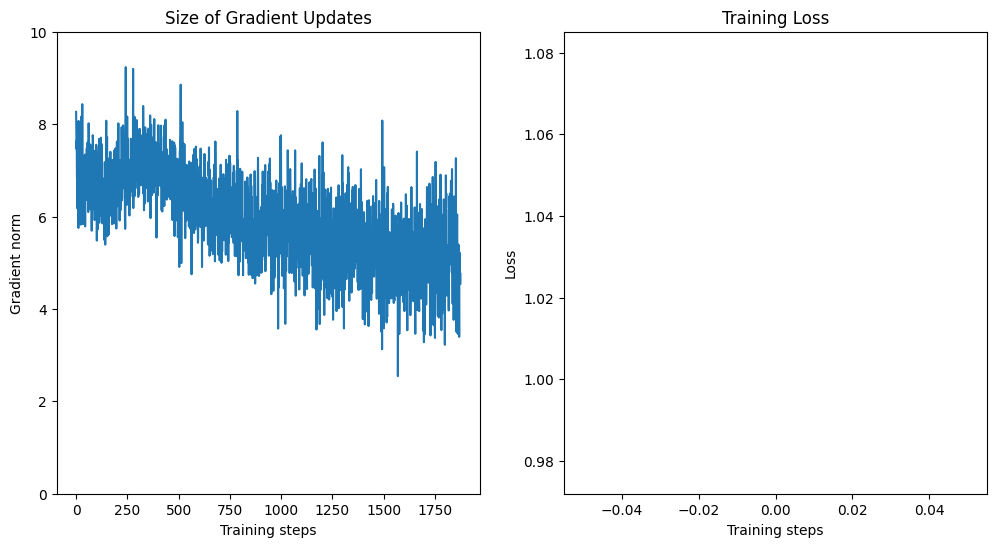

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:03,  6.18it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.570335


Epoch 1:   6%|▌         | 109/1875 [00:02<00:33, 52.88it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.422592


Epoch 1:  11%|█         | 205/1875 [00:04<00:31, 52.94it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.496288


Epoch 1:  16%|█▋        | 306/1875 [00:06<00:30, 52.16it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.391629


Epoch 1:  22%|██▏       | 408/1875 [00:08<00:30, 48.85it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.431475


Epoch 1:  27%|██▋       | 508/1875 [00:10<00:29, 47.08it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.307867


Epoch 1:  33%|███▎      | 611/1875 [00:12<00:24, 51.83it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.276024


Epoch 1:  38%|███▊      | 707/1875 [00:14<00:22, 52.65it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.190021


Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 52.19it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.124508


Epoch 1:  49%|████▊     | 910/1875 [00:18<00:18, 51.95it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.367512


Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:17, 50.00it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.003818


Epoch 1:  59%|█████▉    | 1108/1875 [00:22<00:14, 51.71it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.741352


Epoch 1:  65%|██████▍   | 1210/1875 [00:24<00:12, 51.84it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.192348


Epoch 1:  70%|██████▉   | 1310/1875 [00:26<00:11, 48.26it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.999332


Epoch 1:  75%|███████▌  | 1409/1875 [00:28<00:09, 50.19it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.996764


Epoch 1:  80%|████████  | 1506/1875 [00:30<00:07, 46.36it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.127004


Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 48.90it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.129357


Epoch 1:  91%|█████████ | 1706/1875 [00:34<00:03, 53.06it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 2.168458


Epoch 1:  96%|█████████▋| 1808/1875 [00:36<00:01, 54.21it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.875090


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.54it/s]


Train set: Avg. loss: 2.2071, Time: 37.9 secs 




Test set: Avg. loss: 0.0017, Accuracy: 44%, Time: 3.8 secs

Train loss: 2.207147299194336, Test loss: 0.0017428162693977356, Test accuracy: 43.86, Train time: 37.857176303863525, Test time: 3.8234260082244873


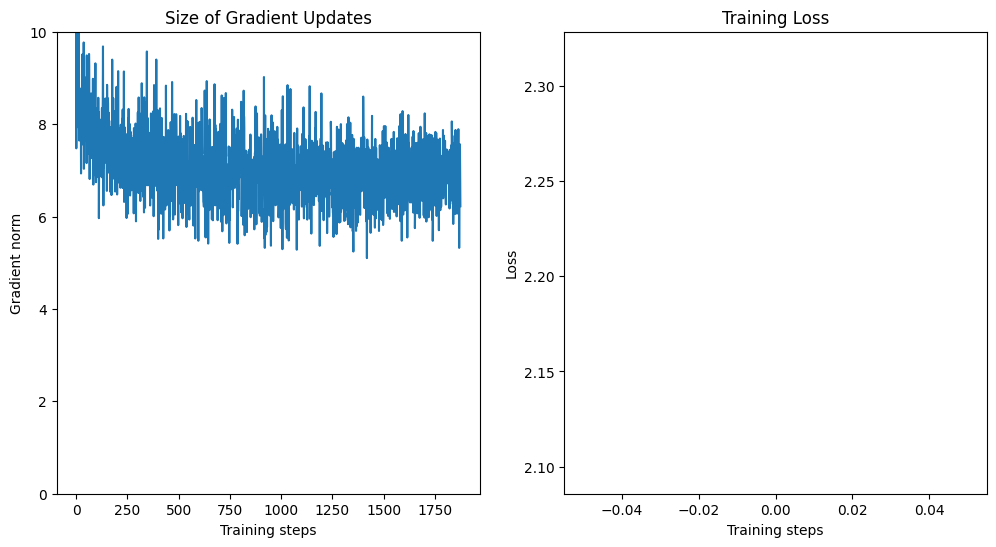

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 7/1875 [00:00<01:19, 23.56it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.616581


Epoch 1:   6%|▌         | 106/1875 [00:02<00:34, 52.00it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.540719


Epoch 1:  11%|█         | 207/1875 [00:04<00:34, 47.68it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.332429


Epoch 1:  16%|█▋        | 309/1875 [00:06<00:30, 52.01it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.173506


Epoch 1:  22%|██▏       | 406/1875 [00:08<00:30, 47.81it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.214360


Epoch 1:  27%|██▋       | 509/1875 [00:10<00:26, 51.68it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.107100


Epoch 1:  32%|███▏      | 608/1875 [00:12<00:24, 52.12it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.050347


Epoch 1:  38%|███▊      | 711/1875 [00:14<00:22, 51.22it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.173404


Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 51.24it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.906588


Epoch 1:  49%|████▊     | 910/1875 [00:18<00:18, 51.02it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.425436


Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:16, 51.73it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.063379


Epoch 1:  59%|█████▉    | 1110/1875 [00:22<00:16, 46.42it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.191520


Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:14, 44.62it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.060297


Epoch 1:  70%|██████▉   | 1309/1875 [00:26<00:12, 47.15it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.686114


Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:08, 52.89it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.702509


Epoch 1:  81%|████████  | 1511/1875 [00:30<00:06, 53.94it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.652764


Epoch 1:  86%|████████▌ | 1607/1875 [00:32<00:05, 49.93it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.779519


Epoch 1:  91%|█████████ | 1710/1875 [00:34<00:03, 53.42it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.845545


Epoch 1:  96%|█████████▋| 1808/1875 [00:35<00:01, 56.11it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.676616


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.95it/s]


Train set: Avg. loss: 2.0787, Time: 37.5 secs 




Test set: Avg. loss: 0.0015, Accuracy: 54%, Time: 3.7 secs

Train loss: 2.078717651875814, Test loss: 0.0014900024175643922, Test accuracy: 53.76, Train time: 37.544867515563965, Test time: 3.651293992996216


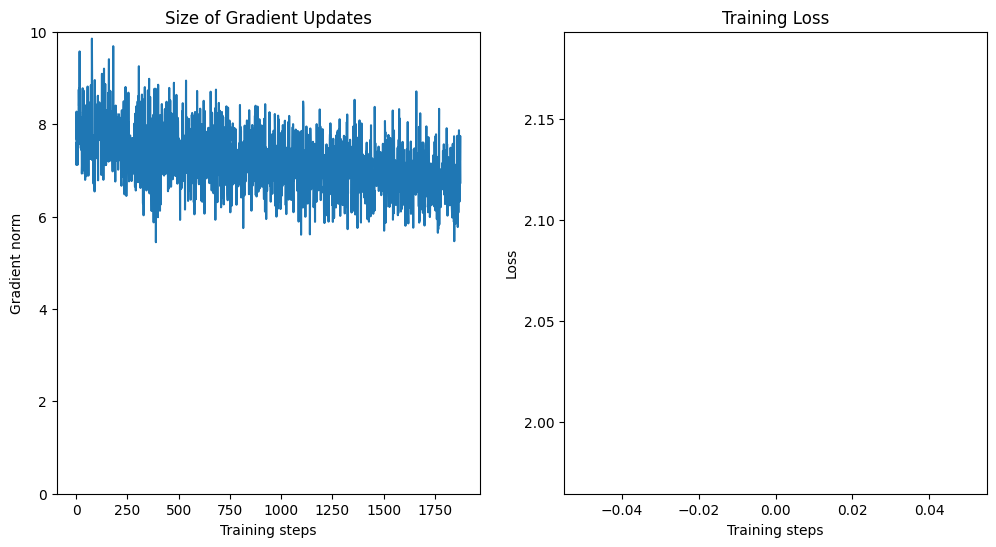

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 3/1875 [00:00<05:27,  5.71it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.550177


Epoch 1:   5%|▌         | 103/1875 [00:02<00:32, 55.32it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.696195


Epoch 1:  11%|█         | 207/1875 [00:04<00:33, 50.21it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.540369


Epoch 1:  17%|█▋        | 310/1875 [00:06<00:28, 54.46it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.407075


Epoch 1:  22%|██▏       | 409/1875 [00:08<00:31, 46.84it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.174618


Epoch 1:  27%|██▋       | 507/1875 [00:10<00:28, 47.21it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.425611


Epoch 1:  32%|███▏      | 603/1875 [00:12<00:28, 44.69it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.197956


Epoch 1:  38%|███▊      | 706/1875 [00:14<00:26, 44.44it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.189112


Epoch 1:  43%|████▎     | 806/1875 [00:17<00:22, 47.29it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.098639


Epoch 1:  49%|████▊     | 910/1875 [00:19<00:21, 45.60it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.124900


Epoch 1:  54%|█████▍    | 1009/1875 [00:21<00:16, 51.52it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.345791


Epoch 1:  59%|█████▉    | 1108/1875 [00:23<00:17, 44.91it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.077346


Epoch 1:  64%|██████▍   | 1207/1875 [00:25<00:13, 48.09it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.215373


Epoch 1:  70%|██████▉   | 1306/1875 [00:27<00:11, 50.59it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.234822


Epoch 1:  75%|███████▌  | 1409/1875 [00:29<00:08, 54.61it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.035124


Epoch 1:  80%|████████  | 1509/1875 [00:31<00:07, 45.96it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.982781


Epoch 1:  86%|████████▌ | 1608/1875 [00:33<00:05, 47.16it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.883004


Epoch 1:  91%|█████████ | 1707/1875 [00:35<00:03, 51.91it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.923434


Epoch 1:  96%|█████████▋| 1806/1875 [00:37<00:01, 47.34it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.896640


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.64it/s]


Train set: Avg. loss: 2.1967, Time: 39.4 secs 




Test set: Avg. loss: 0.0017, Accuracy: 46%, Time: 3.8 secs

Train loss: 2.1967382022857667, Test loss: 0.0017139843225479126, Test accuracy: 46.3, Train time: 39.362892389297485, Test time: 3.7741494178771973


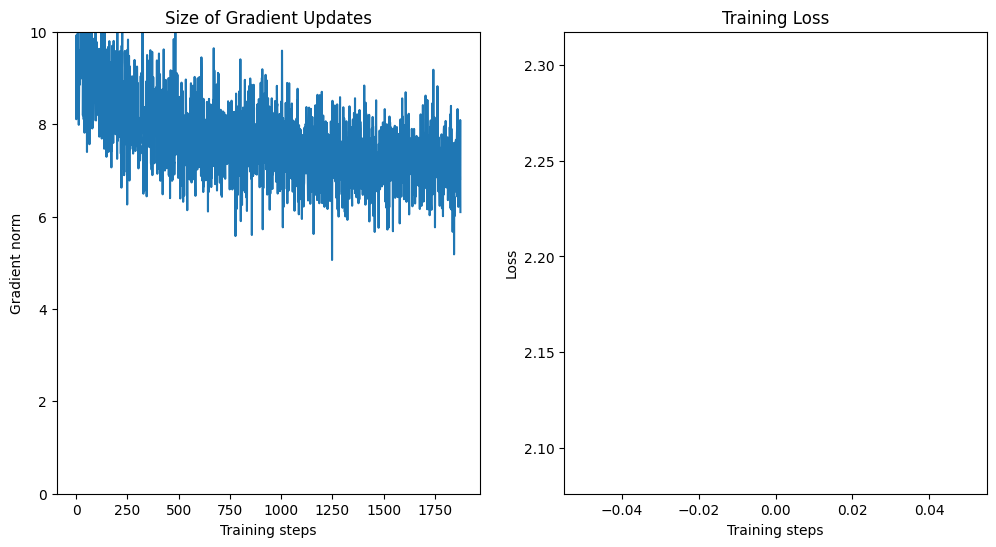

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:00,  6.24it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.640149


Epoch 1:  11%|█         | 210/1875 [00:04<00:31, 53.35it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.619493


Epoch 1:  22%|██▏       | 408/1875 [00:07<00:26, 54.63it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.379842


Epoch 1:  32%|███▏      | 606/1875 [00:11<00:24, 51.43it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.331383


Epoch 1:  43%|████▎     | 811/1875 [00:15<00:20, 51.29it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.210999


Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:15, 54.41it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.044374


Epoch 1:  64%|██████▍   | 1205/1875 [00:23<00:13, 49.98it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.097272


Epoch 1:  75%|███████▍  | 1406/1875 [00:27<00:09, 49.42it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.104017


Epoch 1:  86%|████████▌ | 1610/1875 [00:31<00:04, 54.95it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.155581


Epoch 1:  96%|█████████▋| 1807/1875 [00:35<00:01, 54.78it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.938813


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.53it/s]


Train set: Avg. loss: 2.2400, Time: 36.4 secs 




Test set: Avg. loss: 0.0018, Accuracy: 42%, Time: 3.2 secs

Train loss: 2.2399667132695518, Test loss: 0.001780933952331543, Test accuracy: 42.23, Train time: 36.392831802368164, Test time: 3.206570863723755


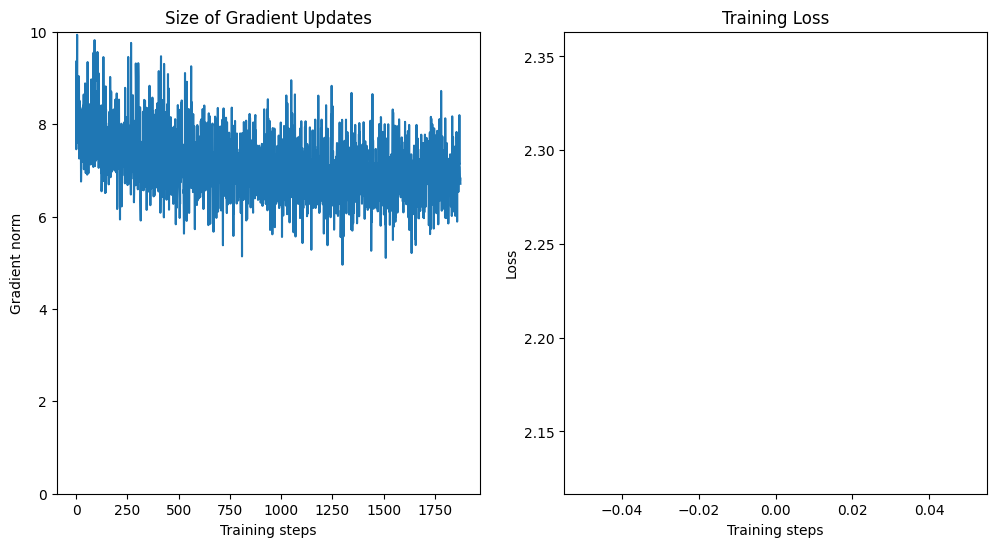

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 8/1875 [00:00<01:13, 25.38it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.385671


Epoch 1:  11%|█         | 206/1875 [00:04<00:34, 48.43it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.381481


Epoch 1:  22%|██▏       | 410/1875 [00:08<00:30, 48.04it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.226374


Epoch 1:  32%|███▏      | 605/1875 [00:12<00:30, 41.41it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.306321


Epoch 1:  43%|████▎     | 807/1875 [00:17<00:23, 46.02it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.219141


Epoch 1:  54%|█████▍    | 1010/1875 [00:22<00:17, 49.48it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.265237


Epoch 1:  65%|██████▍   | 1211/1875 [00:26<00:13, 48.58it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.256528


Epoch 1:  75%|███████▍  | 1406/1875 [00:30<00:08, 52.37it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.354051


Epoch 1:  86%|████████▌ | 1606/1875 [00:33<00:05, 49.40it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.035404


Epoch 1:  97%|█████████▋| 1810/1875 [00:37<00:01, 50.07it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.865825


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.57it/s]


Train set: Avg. loss: 2.2281, Time: 39.4 secs 




Test set: Avg. loss: 0.0019, Accuracy: 39%, Time: 3.6 secs

Train loss: 2.228130190149943, Test loss: 0.0018652293920516968, Test accuracy: 39.08, Train time: 39.41747760772705, Test time: 3.6390609741210938


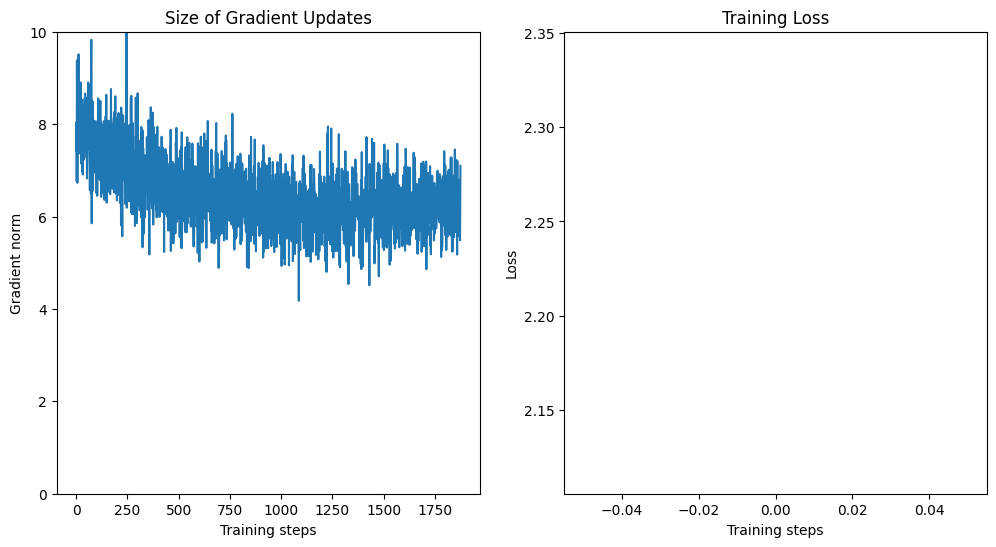

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 9/1875 [00:00<02:01, 15.41it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.547359


Epoch 1:  11%|█         | 208/1875 [00:04<00:35, 46.99it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.543540


Epoch 1:  22%|██▏       | 407/1875 [00:08<00:27, 52.96it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.447228


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:24, 50.84it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.306731


Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 51.79it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.212004


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:15, 54.92it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.081352


Epoch 1:  65%|██████▍   | 1211/1875 [00:24<00:12, 54.72it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.243246


Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:08, 53.41it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.024841


Epoch 1:  86%|████████▌ | 1609/1875 [00:32<00:05, 45.43it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.053451


Epoch 1:  96%|█████████▋| 1808/1875 [00:37<00:01, 45.19it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.200243


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.47it/s]


Train set: Avg. loss: 2.2624, Time: 38.7 secs 




Test set: Avg. loss: 0.0019, Accuracy: 37%, Time: 3.6 secs

Train loss: 2.2623899578094484, Test loss: 0.0019259811639785766, Test accuracy: 36.77, Train time: 38.68757438659668, Test time: 3.6170239448547363


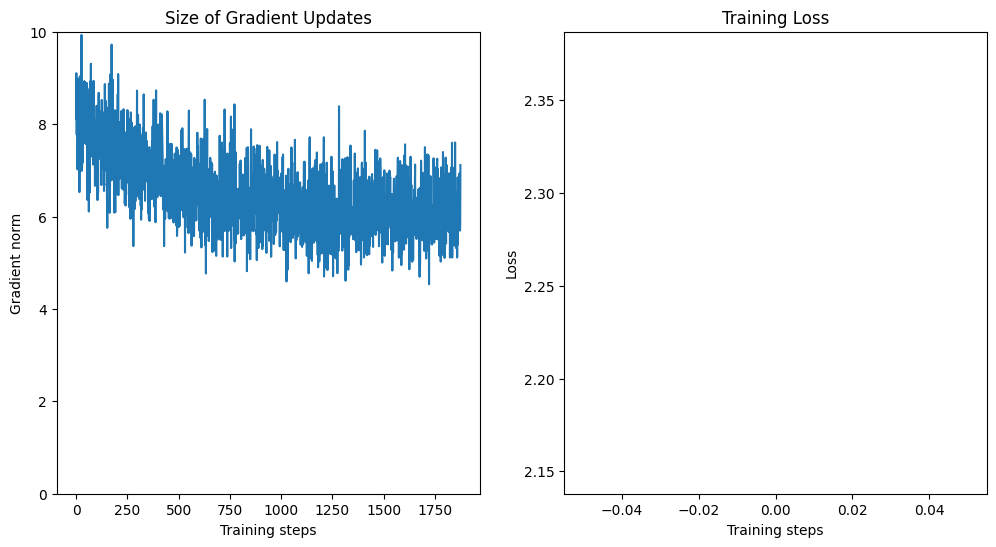

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:14,  5.96it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.381114


Epoch 1:  27%|██▋       | 510/1875 [00:10<00:24, 54.71it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.348997


Epoch 1:  54%|█████▎    | 1006/1875 [00:19<00:17, 50.70it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.919534


Epoch 1:  80%|████████  | 1508/1875 [00:29<00:07, 51.08it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.121056


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.16it/s]


Train set: Avg. loss: 2.1361, Time: 36.7 secs 




Test set: Avg. loss: 0.0017, Accuracy: 48%, Time: 3.2 secs

Train loss: 2.1361322154363, Test loss: 0.0016584627509117127, Test accuracy: 47.83, Train time: 36.664390325546265, Test time: 3.2440974712371826


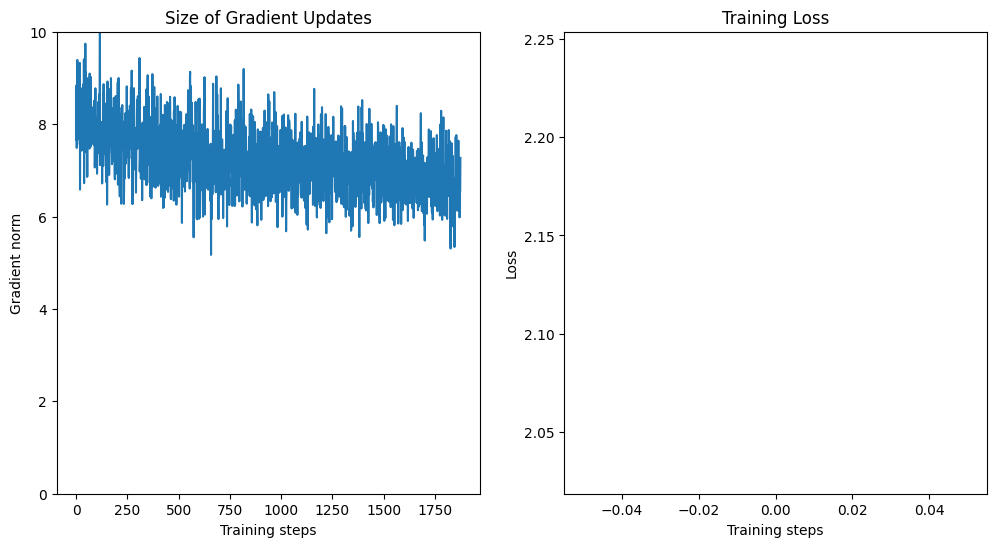

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 6/1875 [00:00<02:01, 15.33it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.532664


Epoch 1:  27%|██▋       | 511/1875 [00:10<00:27, 50.21it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.395469


Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:18, 47.56it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.989705


Epoch 1:  80%|████████  | 1509/1875 [00:30<00:07, 51.88it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.011966


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.01it/s]


Train set: Avg. loss: 2.1609, Time: 38.3 secs 




Test set: Avg. loss: 0.0016, Accuracy: 49%, Time: 3.5 secs

Train loss: 2.1609176553726197, Test loss: 0.0016382562637329101, Test accuracy: 48.85, Train time: 38.26665687561035, Test time: 3.470593214035034


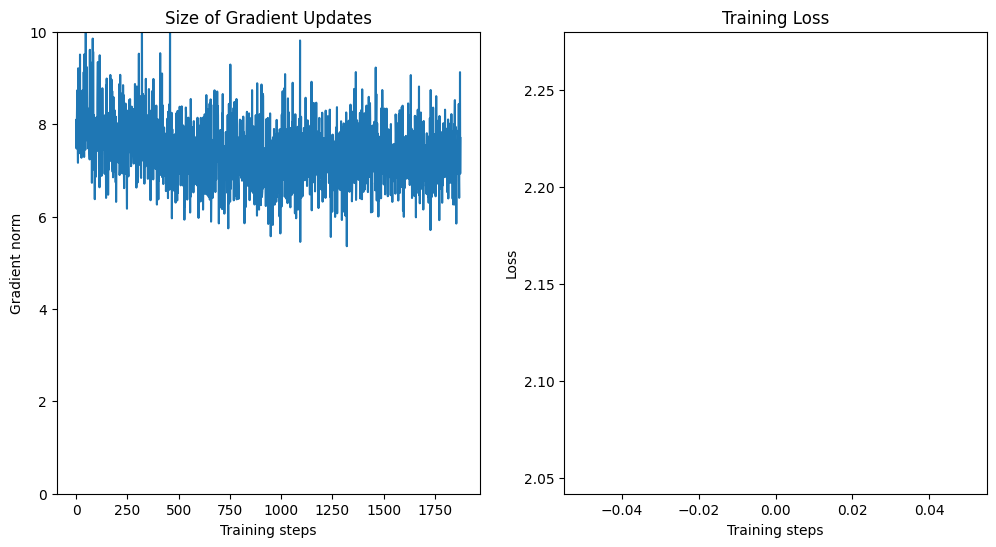

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 4/1875 [00:00<03:55,  7.96it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.752280


Epoch 1:  27%|██▋       | 509/1875 [00:10<00:28, 48.09it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.326222


Epoch 1:  54%|█████▍    | 1012/1875 [00:20<00:15, 56.87it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.052233


Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 58.52it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.942596


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.50it/s]


Train set: Avg. loss: 2.2140, Time: 38.7 secs 




Test set: Avg. loss: 0.0019, Accuracy: 37%, Time: 3.8 secs

Train loss: 2.213982726097107, Test loss: 0.0018696847438812256, Test accuracy: 37.1, Train time: 38.667999029159546, Test time: 3.8304190635681152


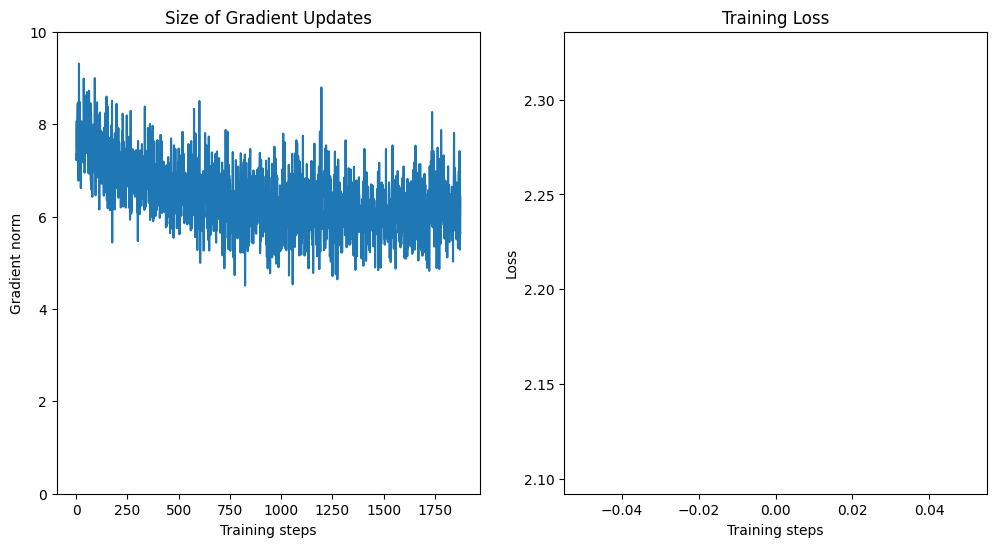

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<04:48,  6.50it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.753479


Epoch 1:   6%|▌         | 109/1875 [00:02<00:32, 54.09it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.114102


Epoch 1:  11%|█▏        | 211/1875 [00:04<00:32, 51.39it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.444292


Epoch 1:  16%|█▋        | 306/1875 [00:05<00:31, 49.08it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.548673


Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 50.48it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.693159


Epoch 1:  27%|██▋       | 506/1875 [00:10<00:27, 49.51it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.526403


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:24, 51.93it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.229909


Epoch 1:  38%|███▊      | 709/1875 [00:13<00:21, 53.64it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.212565


Epoch 1:  43%|████▎     | 811/1875 [00:15<00:19, 53.33it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.570243


Epoch 1:  48%|████▊     | 907/1875 [00:17<00:17, 55.47it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.310369


Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:16, 52.06it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.185246


Epoch 1:  59%|█████▉    | 1110/1875 [00:21<00:15, 48.25it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.333856


Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:13, 51.03it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.243277


Epoch 1:  70%|██████▉   | 1311/1875 [00:25<00:10, 51.48it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.323311


Epoch 1:  75%|███████▌  | 1407/1875 [00:27<00:08, 52.40it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.249007


Epoch 1:  80%|████████  | 1509/1875 [00:29<00:06, 52.61it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.381210


Epoch 1:  86%|████████▌ | 1611/1875 [00:31<00:05, 52.39it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.062918


Epoch 1:  91%|█████████ | 1707/1875 [00:32<00:03, 50.41it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.175718


Epoch 1:  96%|█████████▋| 1809/1875 [00:34<00:01, 53.38it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.673976


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.78it/s]


Train set: Avg. loss: 0.4196, Time: 36.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.4 secs

Train loss: 0.4195743732392788, Test loss: 6.252424269914628e-05, Test accuracy: 96.22, Train time: 36.21414518356323, Test time: 3.3726954460144043


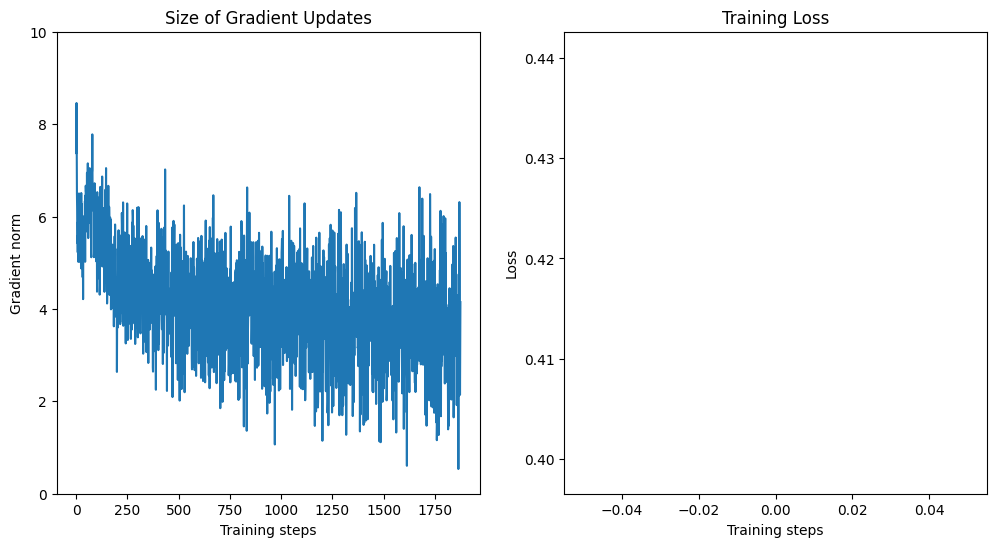

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=2


Epoch 1:   0%|          | 4/1875 [00:00<02:32, 12.30it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.801026


Epoch 1:   6%|▌         | 107/1875 [00:02<00:37, 47.07it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.124480


Epoch 1:  11%|█         | 207/1875 [00:04<00:33, 49.55it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.539621


Epoch 1:  16%|█▋        | 306/1875 [00:06<00:31, 49.84it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.013532


Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 49.95it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.221526


Epoch 1:  27%|██▋       | 511/1875 [00:10<00:26, 50.92it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.180568


Epoch 1:  32%|███▏      | 608/1875 [00:12<00:24, 52.55it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.323289


Epoch 1:  38%|███▊      | 710/1875 [00:14<00:22, 50.98it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.161453


Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 51.56it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.132346


Epoch 1:  48%|████▊     | 909/1875 [00:18<00:20, 46.80it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.183587


Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:16, 51.07it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.245336


Epoch 1:  59%|█████▉    | 1106/1875 [00:22<00:14, 54.10it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.674561


Epoch 1:  64%|██████▍   | 1209/1875 [00:24<00:13, 51.19it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.314453


Epoch 1:  70%|██████▉   | 1310/1875 [00:26<00:11, 48.08it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.671588


Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:08, 54.97it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.086578


Epoch 1:  80%|████████  | 1506/1875 [00:30<00:07, 51.56it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.148150


Epoch 1:  86%|████████▌ | 1608/1875 [00:32<00:05, 48.13it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.355802


Epoch 1:  91%|█████████ | 1710/1875 [00:34<00:03, 51.57it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.080797


Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 51.45it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.408543


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.15it/s]


Train set: Avg. loss: 0.4240, Time: 38.2 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.7 secs

Train loss: 0.42401922509471573, Test loss: 5.857510194182396e-05, Test accuracy: 96.54, Train time: 38.15918946266174, Test time: 3.6794676780700684


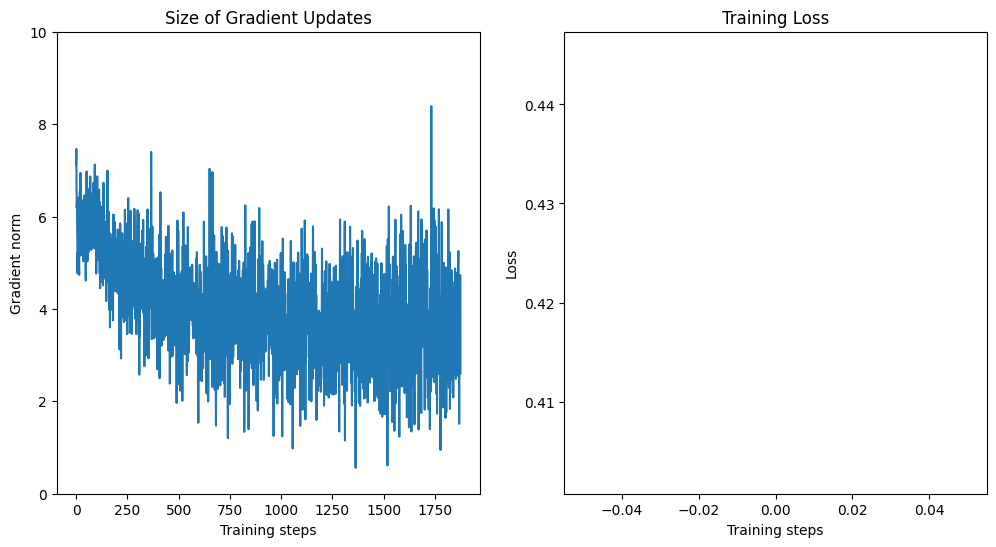

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=4


Epoch 1:   0%|          | 5/1875 [00:00<03:44,  8.32it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.628621


Epoch 1:   6%|▌         | 111/1875 [00:02<00:38, 45.28it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.298495


Epoch 1:  11%|█         | 205/1875 [00:04<00:35, 47.52it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.925585


Epoch 1:  16%|█▋        | 308/1875 [00:06<00:33, 46.24it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.850506


Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 49.93it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.703649


Epoch 1:  27%|██▋       | 507/1875 [00:10<00:27, 50.37it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.501431


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:29, 43.66it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.300898


Epoch 1:  38%|███▊      | 707/1875 [00:14<00:23, 48.90it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.439781


Epoch 1:  43%|████▎     | 807/1875 [00:17<00:23, 44.69it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.263191


Epoch 1:  48%|████▊     | 907/1875 [00:19<00:20, 46.98it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.288601


Epoch 1:  54%|█████▍    | 1008/1875 [00:21<00:15, 56.02it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.167414


Epoch 1:  59%|█████▉    | 1110/1875 [00:23<00:15, 47.87it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.106695


Epoch 1:  65%|██████▍   | 1211/1875 [00:25<00:11, 57.82it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.244782


Epoch 1:  70%|██████▉   | 1309/1875 [00:27<00:10, 52.00it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.189619


Epoch 1:  75%|███████▌  | 1413/1875 [00:29<00:08, 57.07it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.106434


Epoch 1:  80%|████████  | 1509/1875 [00:31<00:07, 47.72it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.537219


Epoch 1:  86%|████████▌ | 1610/1875 [00:33<00:05, 50.97it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.207740


Epoch 1:  91%|█████████ | 1706/1875 [00:35<00:03, 47.64it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.308930


Epoch 1:  96%|█████████▌| 1804/1875 [00:37<00:01, 42.35it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.335952


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.69it/s]


Train set: Avg. loss: 0.4328, Time: 39.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.9 secs

Train loss: 0.43275735719501973, Test loss: 5.7490529865026475e-05, Test accuracy: 96.59, Train time: 39.32333540916443, Test time: 3.888476848602295


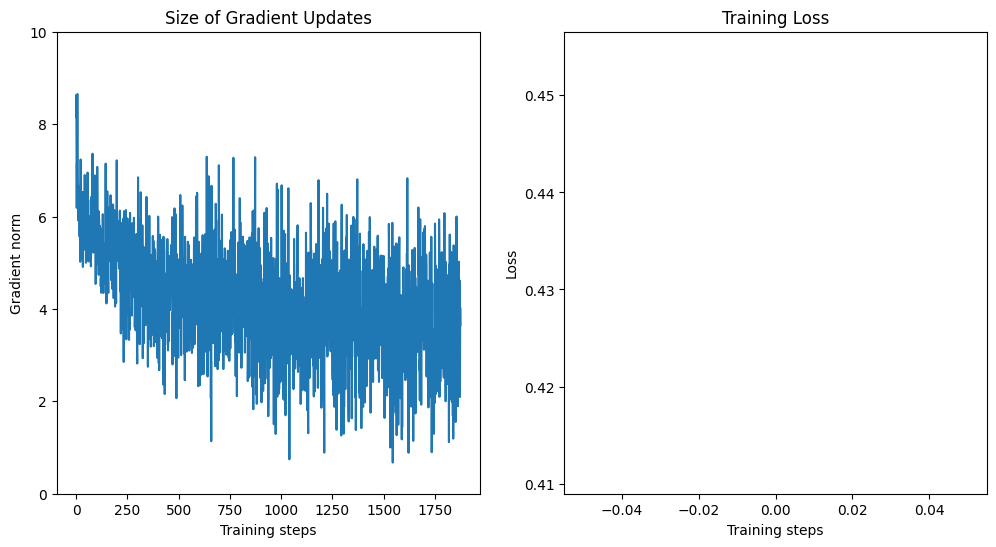

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:26,  5.73it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.523722


Epoch 1:  11%|█         | 209/1875 [00:04<00:31, 53.44it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.497988


Epoch 1:  22%|██▏       | 411/1875 [00:08<00:27, 52.56it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.501911


Epoch 1:  32%|███▏      | 606/1875 [00:12<00:24, 52.22it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.254864


Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 50.98it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.386483


Epoch 1:  54%|█████▍    | 1008/1875 [00:19<00:16, 52.97it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.286561


Epoch 1:  64%|██████▍   | 1206/1875 [00:23<00:12, 51.75it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.385984


Epoch 1:  75%|███████▌  | 1407/1875 [00:27<00:08, 52.09it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.249012


Epoch 1:  86%|████████▌ | 1611/1875 [00:31<00:05, 51.96it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.262338


Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 51.91it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.372932


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.54it/s]


Train set: Avg. loss: 0.4034, Time: 37.1 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.3 secs

Train loss: 0.4034317549884319, Test loss: 5.672369077801704e-05, Test accuracy: 96.53, Train time: 37.10568308830261, Test time: 3.3324193954467773


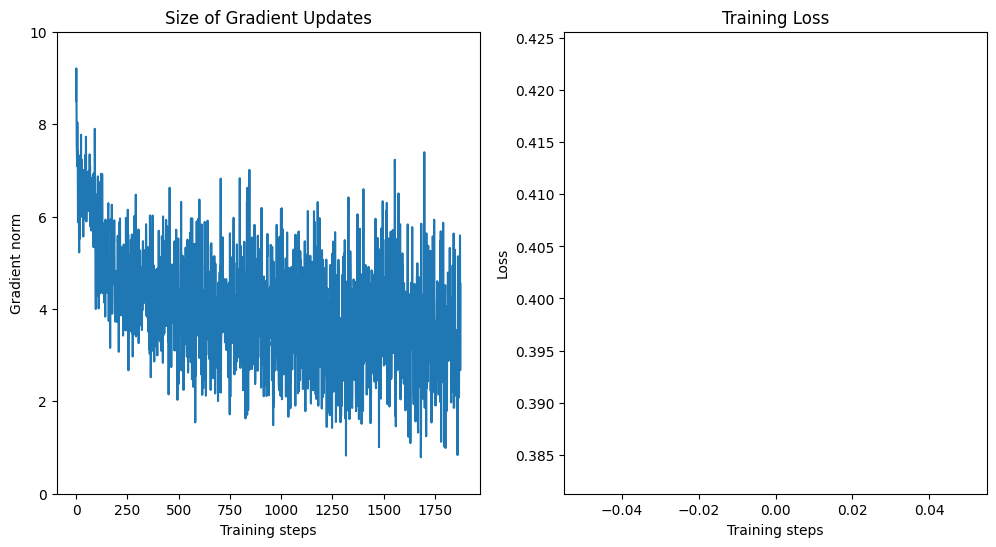

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=2


Epoch 1:   0%|          | 5/1875 [00:00<01:56, 15.99it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.614462


Epoch 1:  11%|█         | 205/1875 [00:04<00:35, 46.56it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.490294


Epoch 1:  22%|██▏       | 409/1875 [00:08<00:31, 46.97it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.685404


Epoch 1:  32%|███▏      | 609/1875 [00:12<00:24, 51.52it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.341765


Epoch 1:  43%|████▎     | 806/1875 [00:16<00:21, 48.85it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.401848


Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:17, 49.19it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.219735


Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:12, 51.52it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.232723


Epoch 1:  75%|███████▍  | 1406/1875 [00:28<00:09, 48.07it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.183553


Epoch 1:  86%|████████▌ | 1606/1875 [00:32<00:05, 51.69it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.203025


Epoch 1:  96%|█████████▋| 1809/1875 [00:36<00:01, 46.69it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.426016


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.97it/s]


Train set: Avg. loss: 0.4045, Time: 38.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.5 secs

Train loss: 0.40453185558617116, Test loss: 6.10957533121109e-05, Test accuracy: 96.3, Train time: 38.30560040473938, Test time: 3.5120115280151367


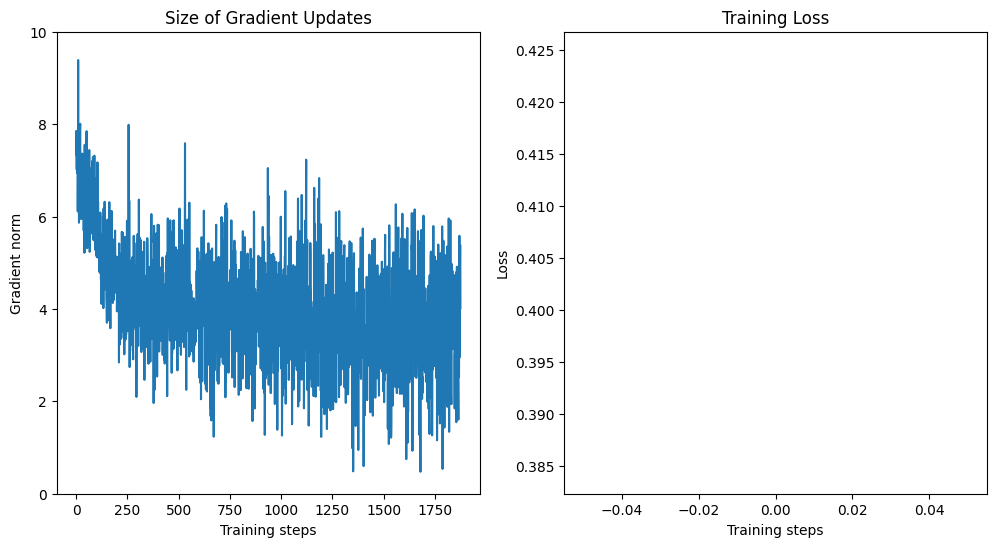

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=4


Epoch 1:   0%|          | 6/1875 [00:00<02:41, 11.58it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.623383


Epoch 1:  11%|█         | 205/1875 [00:04<00:38, 43.62it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.573363


Epoch 1:  22%|██▏       | 406/1875 [00:08<00:28, 51.26it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.544343


Epoch 1:  32%|███▏      | 606/1875 [00:12<00:30, 41.71it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.449054


Epoch 1:  43%|████▎     | 808/1875 [00:17<00:23, 46.14it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.193350


Epoch 1:  54%|█████▍    | 1008/1875 [00:21<00:16, 52.32it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.127735


Epoch 1:  64%|██████▍   | 1208/1875 [00:25<00:12, 55.32it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.399620


Epoch 1:  75%|███████▌  | 1409/1875 [00:29<00:09, 47.90it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.215855


Epoch 1:  86%|████████▌ | 1609/1875 [00:33<00:05, 48.43it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.395183


Epoch 1:  96%|█████████▋| 1807/1875 [00:37<00:01, 55.35it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.220276


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.51it/s]


Train set: Avg. loss: 0.4161, Time: 39.5 secs 




Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.8 secs

Train loss: 0.41611633139749366, Test loss: 5.7854804396629335e-05, Test accuracy: 96.72, Train time: 39.47815465927124, Test time: 3.753246545791626


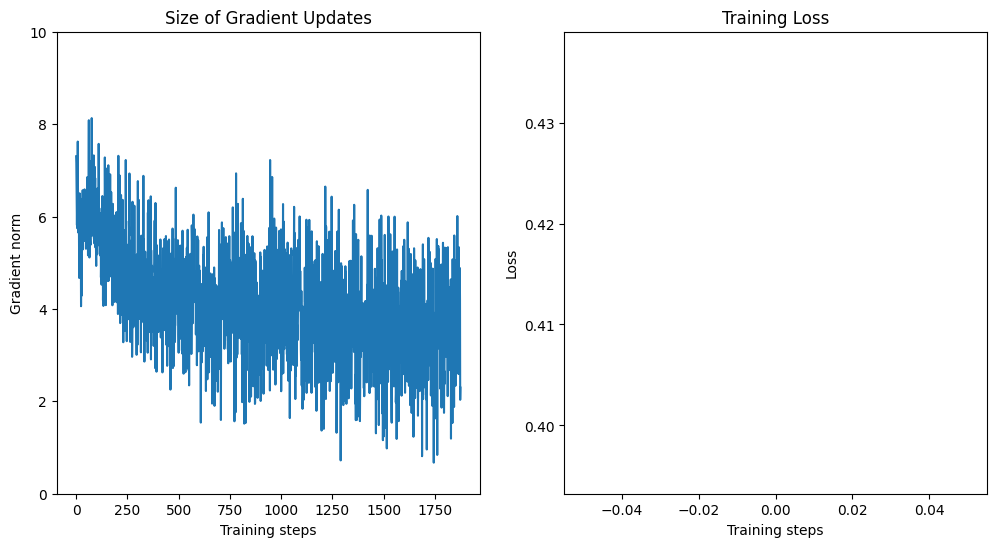

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:47,  5.39it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.287375


Epoch 1:  27%|██▋       | 510/1875 [00:10<00:26, 50.85it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.908271


Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:17, 50.92it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.299619


Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 52.18it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.142980


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.70it/s]



Train set: Avg. loss: 0.3698, Time: 37.7 secs 


Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.4 secs

Train loss: 0.369750959455967, Test loss: 5.7824989408254627e-05, Test accuracy: 96.63, Train time: 37.73331069946289, Test time: 3.35802960395813


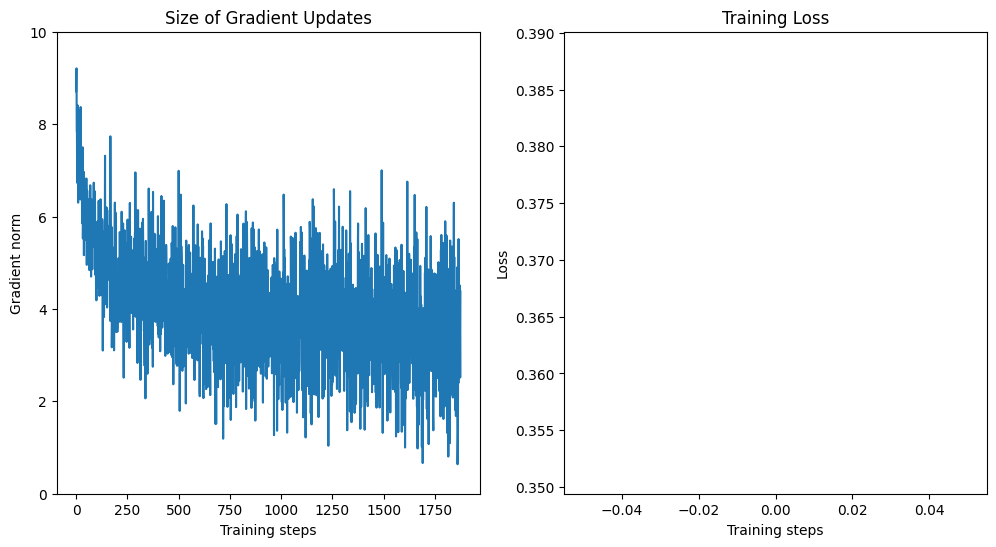

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=2


Epoch 1:   0%|          | 4/1875 [00:00<02:48, 11.10it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.542442


Epoch 1:  27%|██▋       | 507/1875 [00:10<00:26, 51.17it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.402195


Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:17, 50.81it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.485409


Epoch 1:  80%|████████  | 1507/1875 [00:29<00:07, 51.65it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.439675


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.75it/s]


Train set: Avg. loss: 0.4186, Time: 37.7 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.5 secs

Train loss: 0.41859013688166935, Test loss: 6.250390410423279e-05, Test accuracy: 96.16, Train time: 37.6955680847168, Test time: 3.4997589588165283


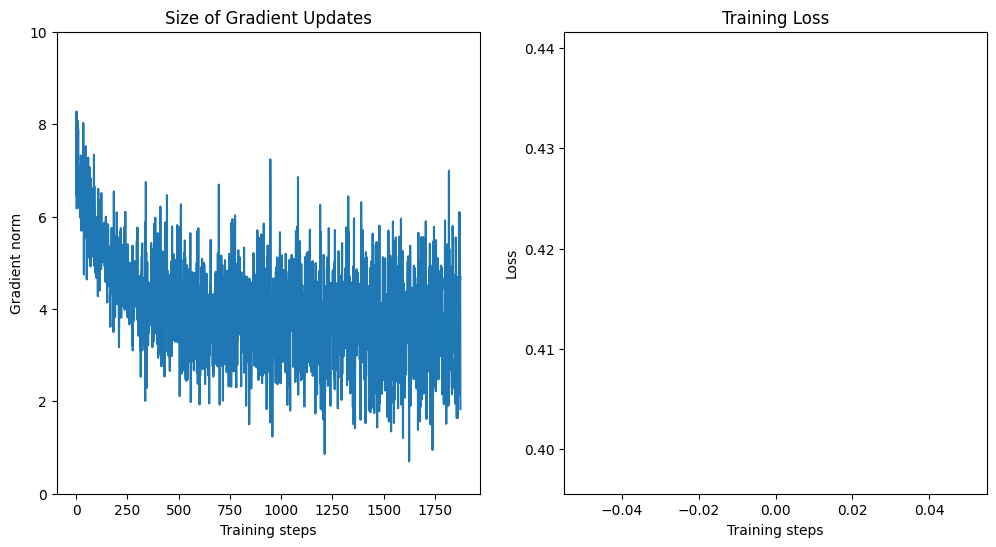

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=4


Epoch 1:   0%|          | 5/1875 [00:00<02:59, 10.41it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.733483


Epoch 1:  27%|██▋       | 507/1875 [00:11<00:30, 44.68it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.457671


Epoch 1:  54%|█████▍    | 1008/1875 [00:21<00:18, 47.75it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.518527


Epoch 1:  80%|████████  | 1508/1875 [00:31<00:08, 45.57it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.223362


Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.73it/s]


Train set: Avg. loss: 0.4242, Time: 39.3 secs 




Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.8 secs

Train loss: 0.42416764598588147, Test loss: 6.285417899489403e-05, Test accuracy: 96.23, Train time: 39.29191994667053, Test time: 3.8211638927459717


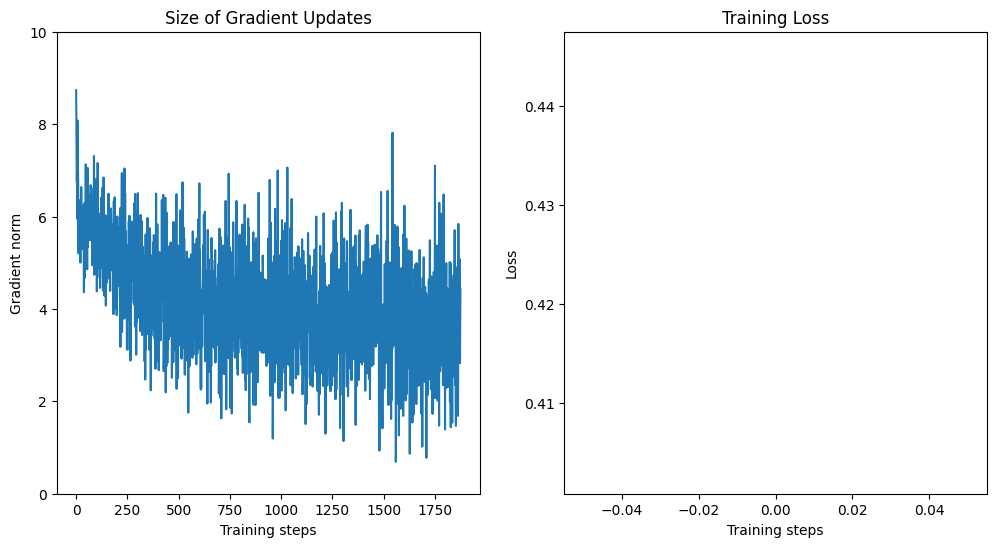

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:22,  5.80it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.557948


Epoch 1:   6%|▌         | 111/1875 [00:02<00:36, 48.50it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.130321


Epoch 1:  11%|█         | 206/1875 [00:04<00:31, 53.24it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.839481


Epoch 1:  16%|█▋        | 307/1875 [00:06<00:32, 48.92it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.003493


Epoch 1:  22%|██▏       | 408/1875 [00:08<00:27, 52.66it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.426540


Epoch 1:  27%|██▋       | 505/1875 [00:10<00:26, 52.44it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.097499


Epoch 1:  32%|███▏      | 607/1875 [00:12<00:23, 53.56it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.194330


Epoch 1:  38%|███▊      | 710/1875 [00:14<00:21, 53.58it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.897531


Epoch 1:  43%|████▎     | 806/1875 [00:15<00:20, 52.39it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.972421


Epoch 1:  49%|████▊     | 911/1875 [00:17<00:18, 51.46it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.960735


Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:17, 50.33it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.796288


Epoch 1:  59%|█████▉    | 1107/1875 [00:21<00:13, 56.62it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.786888


Epoch 1:  64%|██████▍   | 1207/1875 [00:23<00:13, 49.03it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.637064


Epoch 1:  70%|██████▉   | 1310/1875 [00:25<00:10, 51.68it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.490643


Epoch 1:  75%|███████▌  | 1412/1875 [00:27<00:08, 56.13it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.757711


Epoch 1:  80%|████████  | 1508/1875 [00:29<00:07, 51.60it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.734846


Epoch 1:  86%|████████▌ | 1610/1875 [00:31<00:05, 52.16it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.525457


Epoch 1:  91%|█████████ | 1707/1875 [00:33<00:03, 52.58it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.471333


Epoch 1:  96%|█████████▋| 1805/1875 [00:35<00:01, 47.62it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.641051


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.20it/s]


Train set: Avg. loss: 1.0308, Time: 36.6 secs 




Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.6 secs

Train loss: 1.0307910220066707, Test loss: 0.00015499271899461746, Test accuracy: 91.38, Train time: 36.63131093978882, Test time: 3.571439743041992


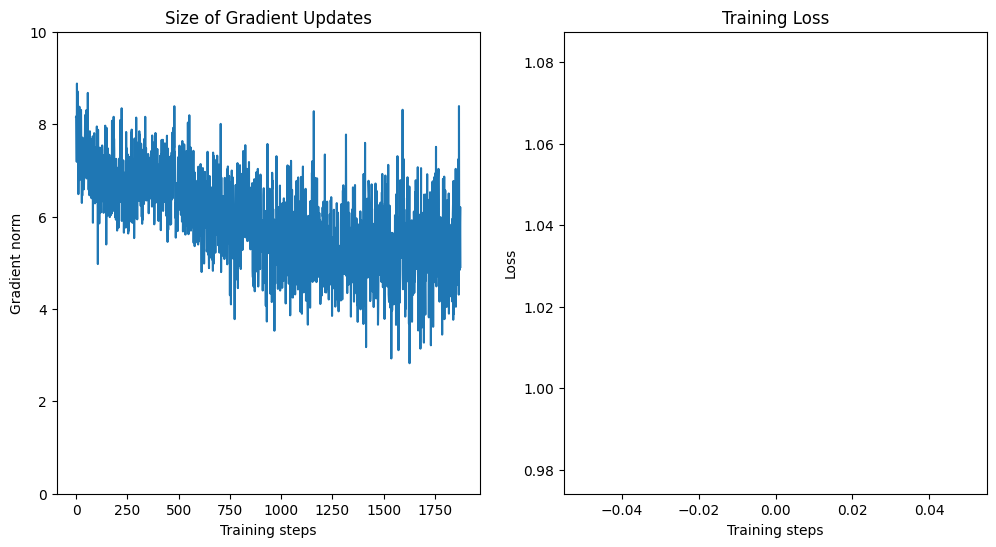

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 5/1875 [00:00<02:04, 14.98it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.533952


Epoch 1:   6%|▌         | 106/1875 [00:02<00:33, 52.59it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.417124


Epoch 1:  11%|█▏        | 211/1875 [00:04<00:31, 52.03it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.057787


Epoch 1:  16%|█▋        | 307/1875 [00:06<00:29, 53.17it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.827696


Epoch 1:  22%|██▏       | 410/1875 [00:08<00:28, 52.26it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.677438


Epoch 1:  27%|██▋       | 508/1875 [00:09<00:24, 54.93it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.807786


Epoch 1:  33%|███▎      | 610/1875 [00:11<00:24, 52.19it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.265858


Epoch 1:  38%|███▊      | 707/1875 [00:13<00:22, 52.14it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.158751


Epoch 1:  43%|████▎     | 812/1875 [00:15<00:20, 51.73it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.783539


Epoch 1:  49%|████▊     | 910/1875 [00:17<00:18, 51.35it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.931294


Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:16, 52.06it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.001549


Epoch 1:  59%|█████▉    | 1107/1875 [00:21<00:14, 54.38it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.846791


Epoch 1:  65%|██████▍   | 1211/1875 [00:23<00:12, 54.25it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.012419


Epoch 1:  70%|██████▉   | 1311/1875 [00:25<00:10, 56.21it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.857764


Epoch 1:  75%|███████▌  | 1408/1875 [00:26<00:08, 52.70it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.648736


Epoch 1:  80%|████████  | 1508/1875 [00:28<00:07, 49.90it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.620393


Epoch 1:  86%|████████▌ | 1610/1875 [00:30<00:05, 50.25it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.570427


Epoch 1:  91%|█████████▏| 1712/1875 [00:32<00:03, 53.38it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.567738


Epoch 1:  96%|█████████▋| 1807/1875 [00:34<00:01, 50.34it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.330303


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.75it/s]


Train set: Avg. loss: 1.1179, Time: 36.2 secs 




Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.3 secs

Train loss: 1.1179169077475866, Test loss: 0.00016051162779331208, Test accuracy: 91.38, Train time: 36.23852181434631, Test time: 3.2974064350128174


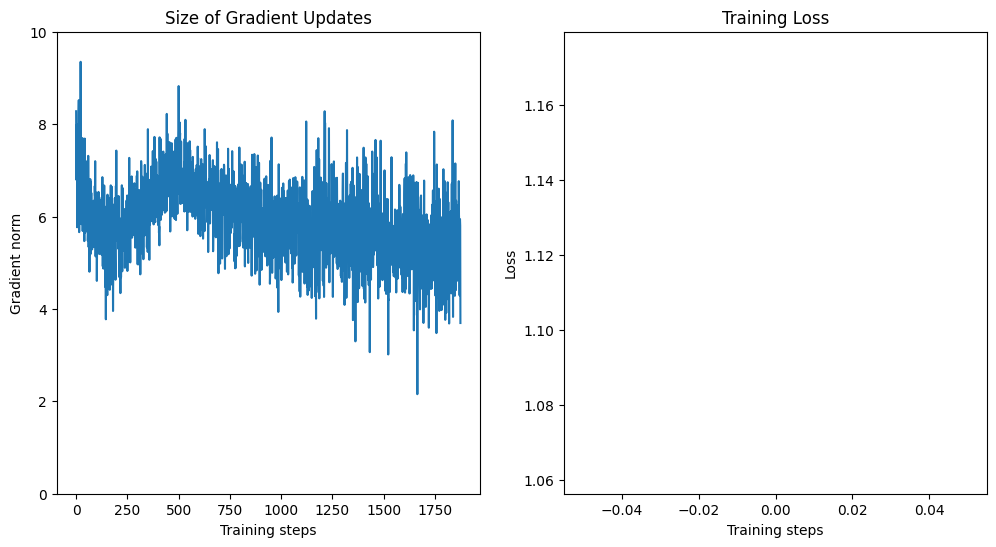

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 7/1875 [00:00<02:05, 14.91it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.695887


Epoch 1:   6%|▌         | 108/1875 [00:02<00:38, 46.31it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.800513


Epoch 1:  11%|█         | 206/1875 [00:04<00:39, 41.93it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.784680


Epoch 1:  17%|█▋        | 312/1875 [00:06<00:29, 52.99it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.399367


Epoch 1:  22%|██▏       | 405/1875 [00:08<00:33, 43.78it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.191871


Epoch 1:  27%|██▋       | 506/1875 [00:10<00:26, 51.28it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.310087


Epoch 1:  32%|███▏      | 603/1875 [00:12<00:28, 45.28it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.269506


Epoch 1:  38%|███▊      | 708/1875 [00:14<00:22, 52.75it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.050239


Epoch 1:  43%|████▎     | 811/1875 [00:16<00:19, 54.41it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.014831


Epoch 1:  49%|████▊     | 910/1875 [00:18<00:16, 57.77it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.839242


Epoch 1:  54%|█████▍    | 1009/1875 [00:20<00:16, 52.74it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.688465


Epoch 1:  59%|█████▉    | 1110/1875 [00:22<00:15, 49.98it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.628367


Epoch 1:  65%|██████▍   | 1212/1875 [00:24<00:11, 60.01it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.638868


Epoch 1:  70%|██████▉   | 1310/1875 [00:26<00:10, 54.84it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.698950


Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:10, 45.16it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.428959


Epoch 1:  80%|████████  | 1508/1875 [00:30<00:07, 46.56it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.492243


Epoch 1:  86%|████████▌ | 1611/1875 [00:32<00:05, 48.65it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.793446


Epoch 1:  91%|█████████ | 1706/1875 [00:34<00:02, 56.61it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.551595


Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 56.25it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.750290


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.83it/s]


Train set: Avg. loss: 1.0367, Time: 37.6 secs 




Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.7 secs

Train loss: 1.0367424610296885, Test loss: 0.00015852147489786147, Test accuracy: 91.43, Train time: 37.64000225067139, Test time: 3.7269322872161865


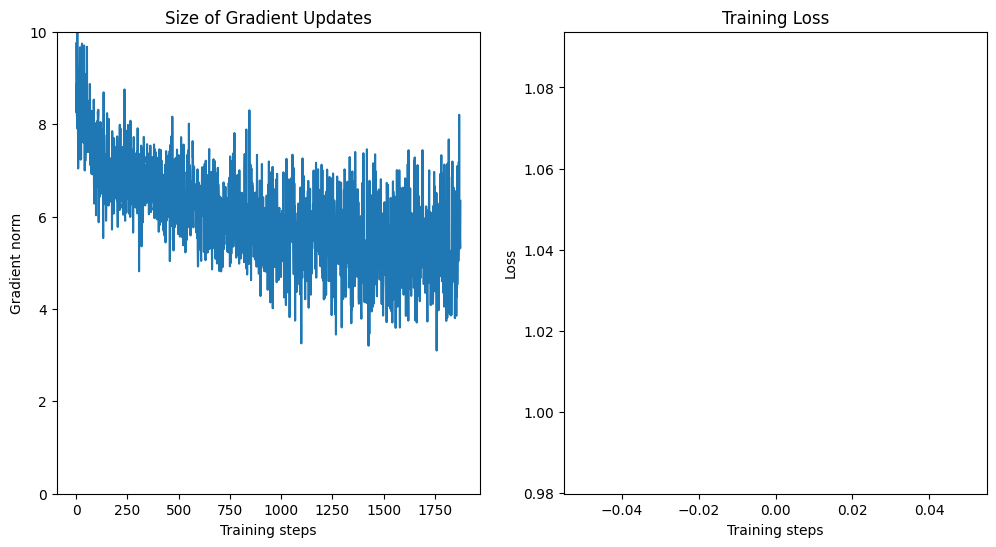

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:15,  5.95it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.495587


Epoch 1:  11%|█         | 206/1875 [00:04<00:32, 51.44it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.036433


Epoch 1:  22%|██▏       | 408/1875 [00:08<00:27, 53.14it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.439699


Epoch 1:  32%|███▏      | 606/1875 [00:12<00:22, 56.67it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.215324


Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 53.07it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.926207


Epoch 1:  54%|█████▎    | 1006/1875 [00:19<00:17, 49.06it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.055342


Epoch 1:  64%|██████▍   | 1206/1875 [00:24<00:14, 46.36it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.895329


Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:10, 43.28it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.765365


Epoch 1:  86%|████████▌ | 1608/1875 [00:32<00:05, 52.69it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.670598


Epoch 1:  97%|█████████▋| 1812/1875 [00:36<00:01, 56.53it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.333663


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.08it/s]


Train set: Avg. loss: 1.1296, Time: 37.4 secs 




Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.9 secs

Train loss: 1.129619046163559, Test loss: 0.00016840487718582152, Test accuracy: 90.83, Train time: 37.44738554954529, Test time: 3.911155939102173


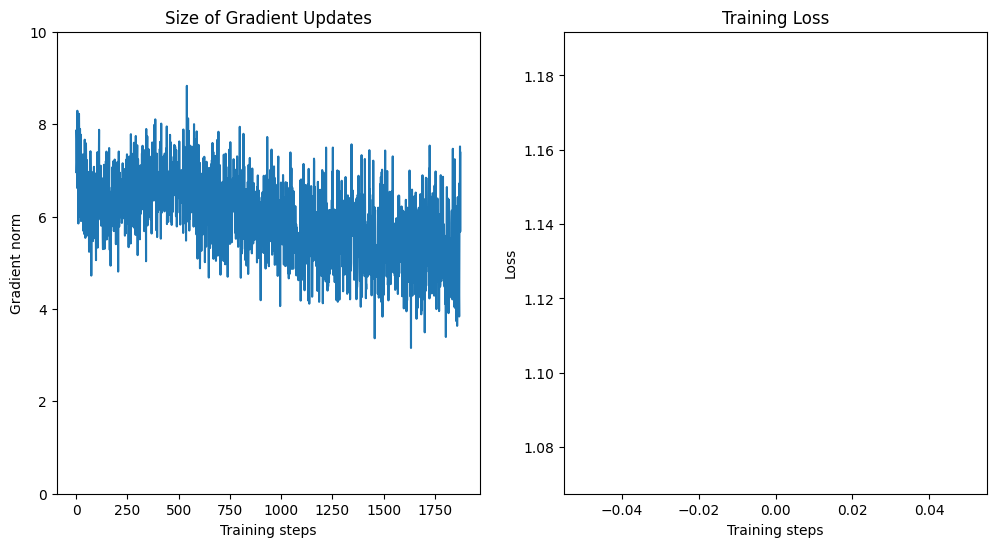

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 2/1875 [00:00<04:55,  6.34it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.529207


Epoch 1:  11%|█         | 208/1875 [00:05<00:30, 55.27it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.712784


Epoch 1:  22%|██▏       | 406/1875 [00:08<00:26, 55.19it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.539280


Epoch 1:  33%|███▎      | 611/1875 [00:12<00:24, 50.84it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.321356


Epoch 1:  43%|████▎     | 805/1875 [00:16<00:21, 50.94it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.962785


Epoch 1:  54%|█████▍    | 1009/1875 [00:20<00:15, 56.04it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.677017


Epoch 1:  64%|██████▍   | 1209/1875 [00:24<00:12, 54.91it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.585194


Epoch 1:  75%|███████▌  | 1412/1875 [00:28<00:08, 52.36it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.510730


Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 50.02it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.365174


Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 49.51it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.728724


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.43it/s]


Train set: Avg. loss: 1.0249, Time: 37.9 secs 




Test set: Avg. loss: 0.0001, Accuracy: 92%, Time: 4.6 secs

Train loss: 1.0249157732248306, Test loss: 0.00014974008053541182, Test accuracy: 91.84, Train time: 37.93877553939819, Test time: 4.61560583114624


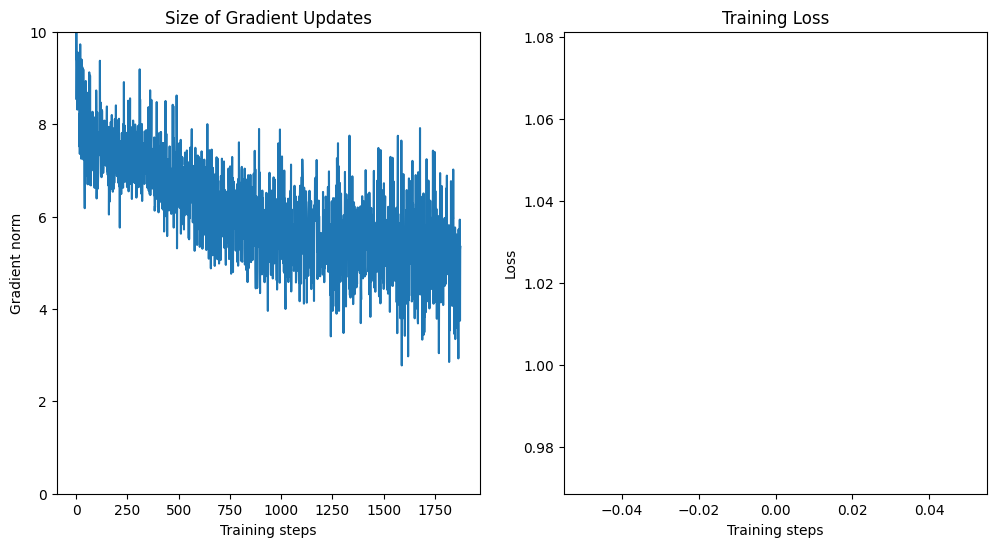

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 3/1875 [00:00<04:57,  6.29it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.490114


Epoch 1:  11%|█▏        | 211/1875 [00:04<00:30, 54.33it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.690578


Epoch 1:  22%|██▏       | 407/1875 [00:08<00:34, 42.65it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.761210


Epoch 1:  32%|███▏      | 608/1875 [00:13<00:26, 47.22it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.461192


Epoch 1:  43%|████▎     | 809/1875 [00:16<00:20, 51.01it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.947070


Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:15, 57.36it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.269509


Epoch 1:  64%|██████▍   | 1206/1875 [00:24<00:13, 50.16it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.683826


Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:09, 48.67it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.718193


Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 51.10it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.857768


Epoch 1:  96%|█████████▋| 1809/1875 [00:36<00:01, 49.86it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.539696


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.71it/s]


Train set: Avg. loss: 1.1997, Time: 37.7 secs 




Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.5 secs

Train loss: 1.1997077007611592, Test loss: 0.00018024837970733641, Test accuracy: 90.62, Train time: 37.72664976119995, Test time: 3.5449740886688232


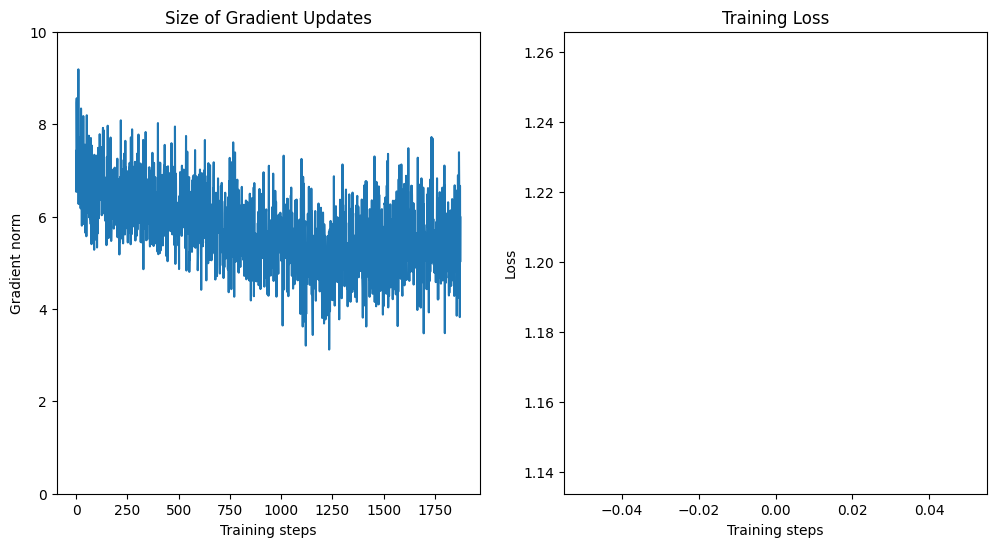

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 5/1875 [00:00<01:49, 17.12it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.636424


Epoch 1:  27%|██▋       | 509/1875 [00:10<00:25, 53.61it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.350684


Epoch 1:  54%|█████▎    | 1006/1875 [00:19<00:19, 44.04it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.919143


Epoch 1:  80%|████████  | 1507/1875 [00:29<00:06, 53.96it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.540607


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.44it/s]


Train set: Avg. loss: 1.0602, Time: 37.2 secs 




Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.6 secs

Train loss: 1.0601655301332473, Test loss: 0.00015323570668697358, Test accuracy: 91.32, Train time: 37.17943501472473, Test time: 3.575057029724121


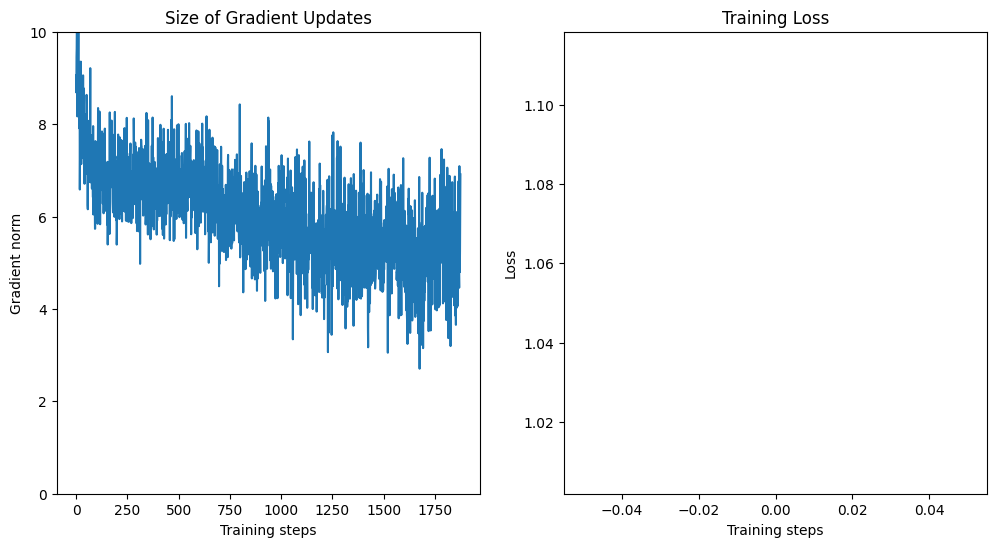

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 8/1875 [00:00<01:25, 21.85it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.472375


Epoch 1:  27%|██▋       | 506/1875 [00:09<00:26, 51.78it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.361204


Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:15, 55.67it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.556240


Epoch 1:  80%|████████  | 1509/1875 [00:29<00:07, 51.44it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.376356


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.49it/s]


Train set: Avg. loss: 1.0243, Time: 37.1 secs 




Test set: Avg. loss: 0.0001, Accuracy: 93%, Time: 3.1 secs

Train loss: 1.0243116161902746, Test loss: 0.00014006908684968949, Test accuracy: 92.52, Train time: 37.140177488327026, Test time: 3.131645441055298


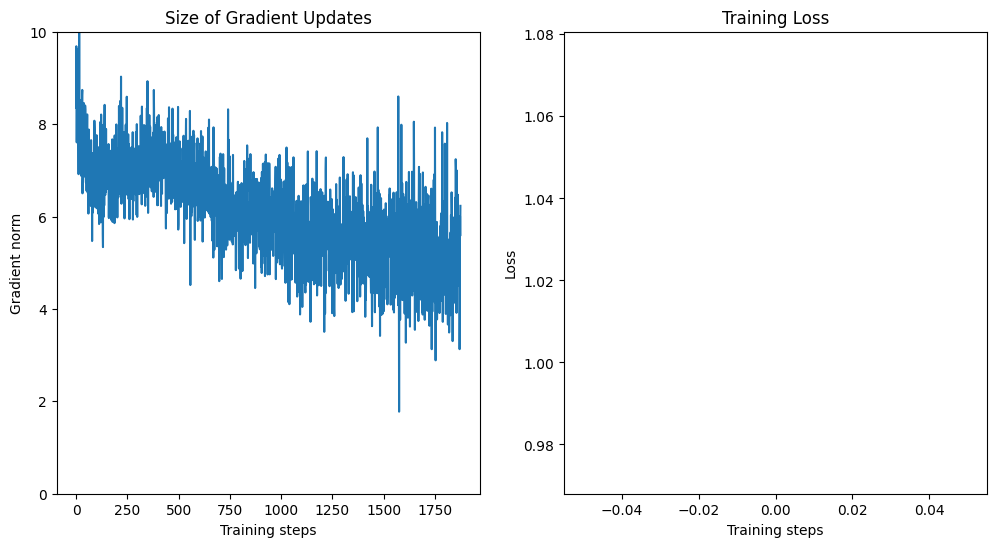

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 9/1875 [00:00<01:37, 19.11it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.362748


Epoch 1:  27%|██▋       | 506/1875 [00:10<00:26, 50.88it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.021765


Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:15, 55.57it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.768084


Epoch 1:  80%|████████  | 1509/1875 [00:31<00:07, 47.87it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.773510


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.80it/s]


Train set: Avg. loss: 1.0221, Time: 38.4 secs 




Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.9 secs

Train loss: 1.0221302590370178, Test loss: 0.0001647938698530197, Test accuracy: 90.8, Train time: 38.43129897117615, Test time: 3.8738362789154053


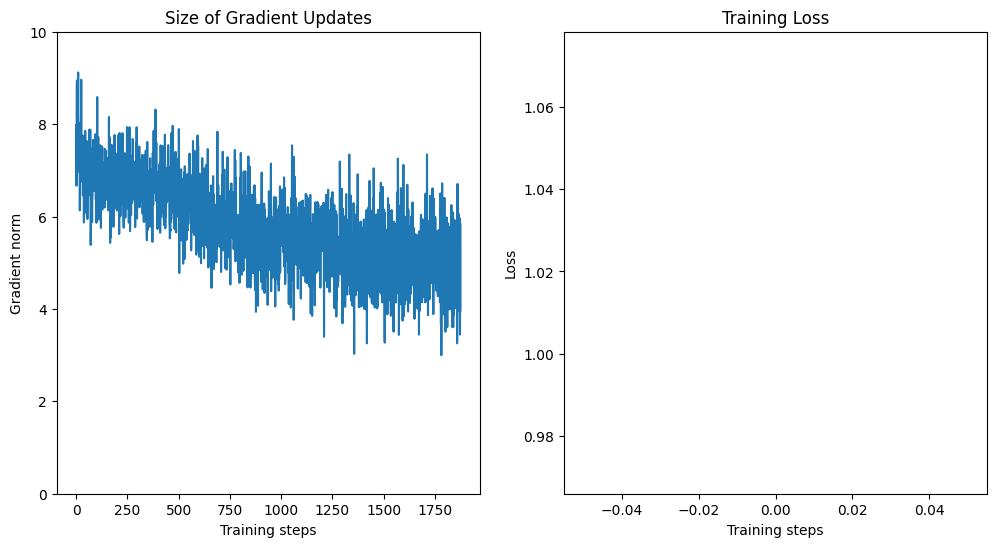

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:52,  5.32it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.885869


Epoch 1:   6%|▌         | 107/1875 [00:02<00:35, 49.87it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.458516


Epoch 1:  11%|█         | 205/1875 [00:04<00:38, 43.94it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.703229


Epoch 1:  17%|█▋        | 310/1875 [00:06<00:30, 50.60it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.437019


Epoch 1:  22%|██▏       | 406/1875 [00:08<00:27, 54.32it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.404524


Epoch 1:  27%|██▋       | 508/1875 [00:10<00:25, 52.89it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.335319


Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 51.27it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.184083


Epoch 1:  38%|███▊      | 707/1875 [00:14<00:22, 53.04it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.379059


Epoch 1:  43%|████▎     | 811/1875 [00:16<00:20, 51.96it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.262268


Epoch 1:  48%|████▊     | 909/1875 [00:18<00:20, 46.49it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.079075


Epoch 1:  54%|█████▎    | 1005/1875 [00:20<00:16, 51.55it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.343309


Epoch 1:  59%|█████▉    | 1107/1875 [00:22<00:17, 44.00it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.271476


Epoch 1:  64%|██████▍   | 1206/1875 [00:24<00:12, 54.03it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.045185


Epoch 1:  70%|██████▉   | 1308/1875 [00:26<00:10, 52.49it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.256810


Epoch 1:  75%|███████▌  | 1410/1875 [00:28<00:09, 51.11it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.118198


Epoch 1:  80%|████████  | 1506/1875 [00:29<00:07, 51.85it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.022240


Epoch 1:  86%|████████▌ | 1608/1875 [00:31<00:05, 51.56it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.066207


Epoch 1:  91%|█████████ | 1709/1875 [00:33<00:03, 52.81it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 2.121191


Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 51.61it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.011615


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.46it/s]


Train set: Avg. loss: 2.2397, Time: 37.2 secs 




Test set: Avg. loss: 0.0009, Accuracy: 39%, Time: 3.4 secs

Train loss: 2.2396767324447633, Test loss: 0.0009396588563919067, Test accuracy: 38.51, Train time: 37.162922620773315, Test time: 3.4140889644622803


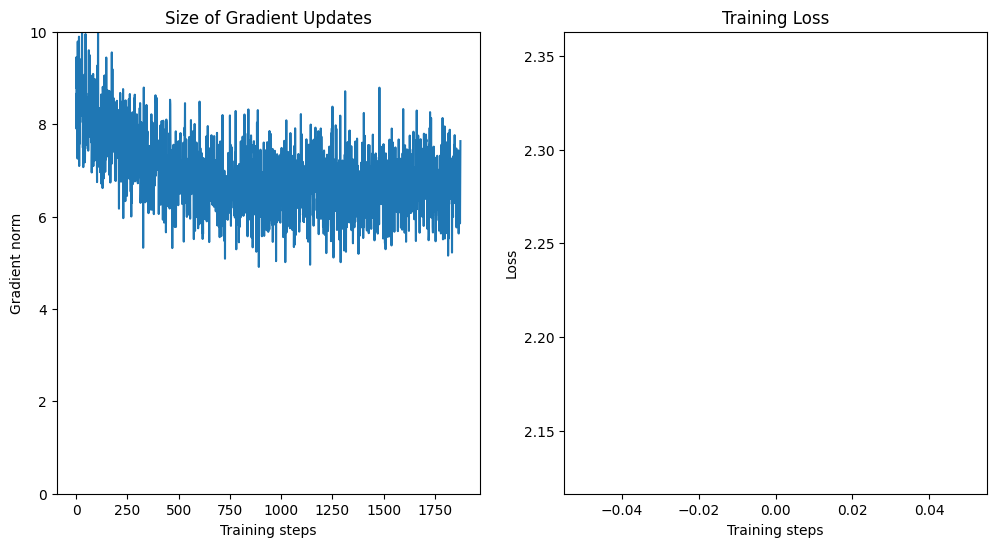

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 6/1875 [00:00<01:32, 20.23it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.525214


Epoch 1:   6%|▌         | 108/1875 [00:02<00:34, 51.32it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.776361


Epoch 1:  11%|█         | 207/1875 [00:04<00:30, 54.64it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.538509


Epoch 1:  17%|█▋        | 311/1875 [00:06<00:29, 53.46it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.516060


Epoch 1:  22%|██▏       | 407/1875 [00:07<00:28, 52.37it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.361171


Epoch 1:  27%|██▋       | 505/1875 [00:10<00:29, 46.29it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.242579


Epoch 1:  33%|███▎      | 610/1875 [00:12<00:27, 46.83it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.246448


Epoch 1:  38%|███▊      | 709/1875 [00:14<00:25, 46.43it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.163402


Epoch 1:  43%|████▎     | 808/1875 [00:16<00:22, 47.57it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.280789


Epoch 1:  49%|████▊     | 910/1875 [00:18<00:17, 53.95it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.199677


Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:16, 51.14it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.300892


Epoch 1:  59%|█████▉    | 1109/1875 [00:22<00:14, 51.98it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.174839


Epoch 1:  65%|██████▍   | 1211/1875 [00:24<00:12, 51.50it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.129744


Epoch 1:  70%|██████▉   | 1307/1875 [00:26<00:10, 51.89it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.180932


Epoch 1:  75%|███████▍  | 1405/1875 [00:28<00:10, 46.26it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.044594


Epoch 1:  80%|████████  | 1508/1875 [00:30<00:07, 49.37it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.307916


Epoch 1:  86%|████████▌ | 1609/1875 [00:32<00:05, 49.02it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.208177


Epoch 1:  91%|█████████ | 1707/1875 [00:34<00:03, 46.57it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.919337


Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 51.41it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.016057


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.56it/s]


Train set: Avg. loss: 2.2688, Time: 37.8 secs 




Test set: Avg. loss: 0.0010, Accuracy: 36%, Time: 3.6 secs

Train loss: 2.268752087275187, Test loss: 0.0009560593366622924, Test accuracy: 36.17, Train time: 37.84050941467285, Test time: 3.5724873542785645


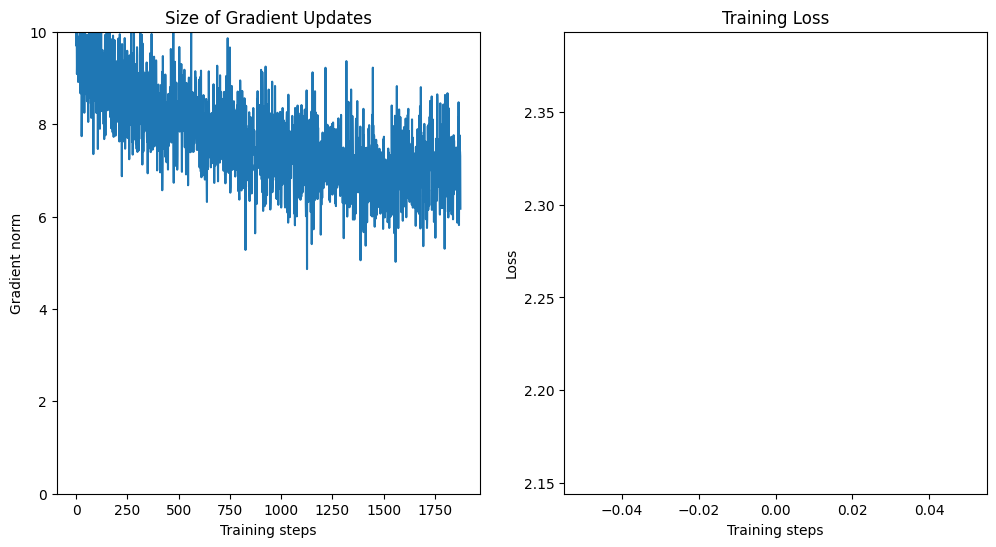

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 4/1875 [00:00<03:53,  8.00it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.596509


Epoch 1:   6%|▌         | 106/1875 [00:02<00:34, 51.76it/s]

Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.082254


Epoch 1:  11%|█         | 210/1875 [00:04<00:30, 54.20it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.399339


Epoch 1:  16%|█▋        | 307/1875 [00:06<00:31, 49.35it/s]

Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.392125


Epoch 1:  22%|██▏       | 408/1875 [00:09<00:33, 43.71it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.352026


Epoch 1:  27%|██▋       | 509/1875 [00:11<00:28, 48.64it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.275951


Epoch 1:  32%|███▏      | 608/1875 [00:13<00:21, 57.95it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.182141


Epoch 1:  38%|███▊      | 711/1875 [00:15<00:23, 49.12it/s]

Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.910848


Epoch 1:  43%|████▎     | 811/1875 [00:17<00:19, 55.68it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.084616


Epoch 1:  48%|████▊     | 908/1875 [00:19<00:18, 52.65it/s]

Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.239146


Epoch 1:  54%|█████▍    | 1010/1875 [00:21<00:18, 47.11it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.338884


Epoch 1:  59%|█████▉    | 1107/1875 [00:23<00:16, 47.62it/s]

Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.136820


Epoch 1:  64%|██████▍   | 1206/1875 [00:25<00:13, 47.87it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.017863


Epoch 1:  70%|██████▉   | 1307/1875 [00:27<00:11, 49.28it/s]

Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.181695


Epoch 1:  75%|███████▍  | 1405/1875 [00:29<00:11, 41.49it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.215782


Epoch 1:  81%|████████  | 1511/1875 [00:31<00:06, 52.12it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.092389


Epoch 1:  86%|████████▌ | 1607/1875 [00:33<00:05, 51.56it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.237260


Epoch 1:  91%|█████████ | 1709/1875 [00:35<00:03, 50.40it/s]

Train Epoch: 1 [54400/60000 (91%)]	Loss: 2.034795


Epoch 1:  96%|█████████▋| 1808/1875 [00:37<00:01, 55.95it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.008246


Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.69it/s]


Train set: Avg. loss: 2.2650, Time: 38.5 secs 




Test set: Avg. loss: 0.0009, Accuracy: 41%, Time: 4.0 secs

Train loss: 2.2649764183680214, Test loss: 0.0009265339493751526, Test accuracy: 40.64, Train time: 38.51813554763794, Test time: 4.003521680831909


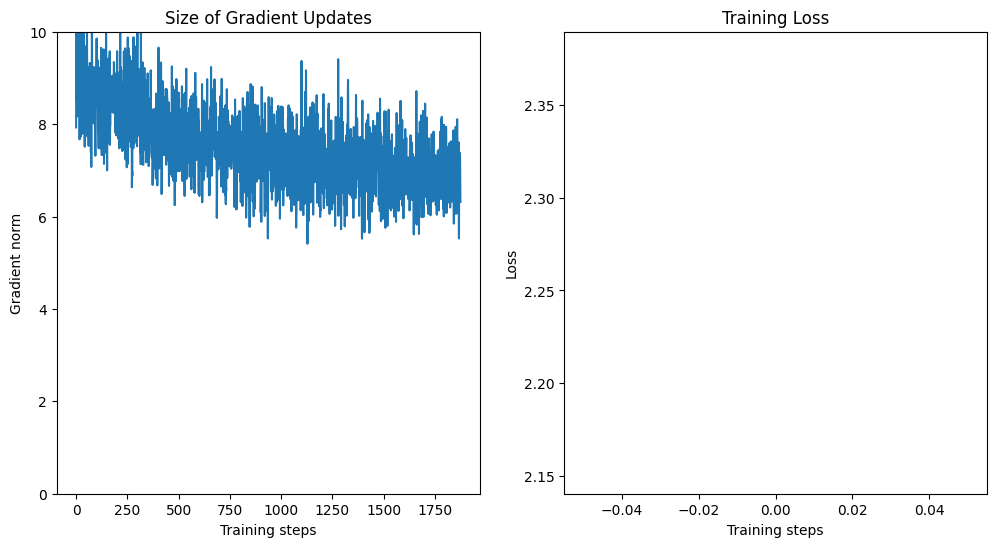

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<05:47,  5.39it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.575854


Epoch 1:  11%|█         | 209/1875 [00:04<00:32, 51.87it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.429392


Epoch 1:  22%|██▏       | 407/1875 [00:07<00:26, 55.30it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.483263


Epoch 1:  33%|███▎      | 611/1875 [00:11<00:23, 53.56it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.015725


Epoch 1:  43%|████▎     | 809/1875 [00:15<00:20, 52.60it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.204203


Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:18, 48.01it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.170647


Epoch 1:  64%|██████▍   | 1208/1875 [00:23<00:15, 44.13it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.225243


Epoch 1:  75%|███████▌  | 1407/1875 [00:27<00:08, 53.22it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.113752


Epoch 1:  86%|████████▌ | 1611/1875 [00:31<00:04, 53.49it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.151498


Epoch 1:  96%|█████████▋| 1808/1875 [00:35<00:01, 49.85it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.939862


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 50.94it/s]


Train set: Avg. loss: 2.2653, Time: 36.8 secs 




Test set: Avg. loss: 0.0010, Accuracy: 35%, Time: 3.4 secs

Train loss: 2.265298793411255, Test loss: 0.0009812750577926637, Test accuracy: 35.34, Train time: 36.820592641830444, Test time: 3.381802558898926


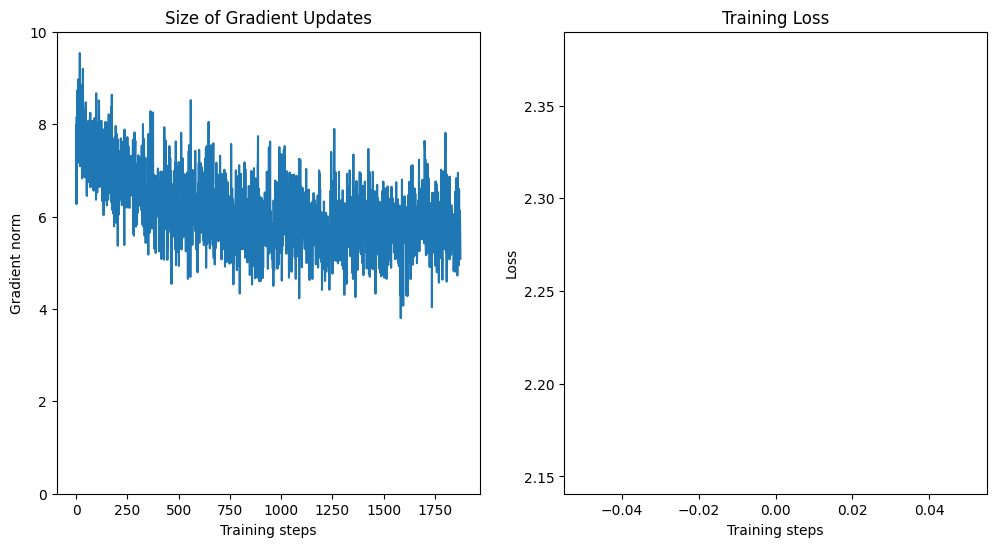

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 5/1875 [00:00<01:51, 16.77it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.890201


Epoch 1:  11%|█         | 209/1875 [00:04<00:30, 53.79it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.425488


Epoch 1:  22%|██▏       | 410/1875 [00:07<00:27, 53.71it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.220936


Epoch 1:  32%|███▏      | 605/1875 [00:11<00:26, 47.35it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.027205


Epoch 1:  43%|████▎     | 808/1875 [00:15<00:24, 43.54it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.113486


Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:15, 57.40it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.932290


Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:13, 51.22it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.130876


Epoch 1:  75%|███████▌  | 1410/1875 [00:27<00:09, 51.55it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.993346


Epoch 1:  86%|████████▌ | 1607/1875 [00:31<00:05, 49.98it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.113297


Epoch 1:  96%|█████████▋| 1808/1875 [00:35<00:01, 52.13it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.946847


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.00it/s]


Train set: Avg. loss: 2.2013, Time: 36.8 secs 




Test set: Avg. loss: 0.0009, Accuracy: 41%, Time: 3.4 secs

Train loss: 2.2012546453475954, Test loss: 0.000917712938785553, Test accuracy: 41.14, Train time: 36.7755286693573, Test time: 3.40053391456604


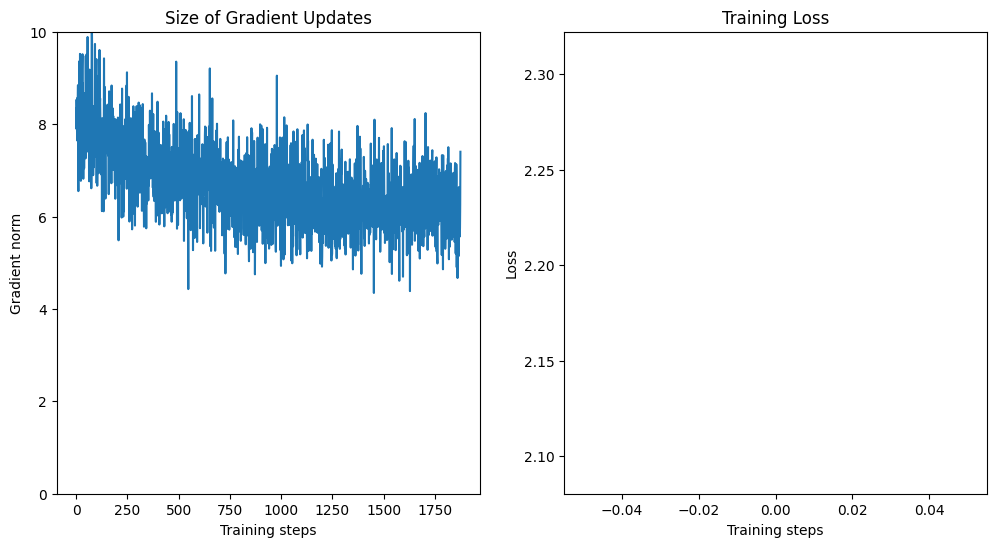

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 5/1875 [00:00<02:59, 10.42it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.445913


Epoch 1:  11%|█         | 205/1875 [00:04<00:35, 46.85it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.407937


Epoch 1:  22%|██▏       | 410/1875 [00:08<00:32, 44.61it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.387159


Epoch 1:  32%|███▏      | 609/1875 [00:12<00:22, 55.45it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.367668


Epoch 1:  43%|████▎     | 810/1875 [00:16<00:21, 49.12it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.296853


Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:16, 52.61it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.357069


Epoch 1:  64%|██████▍   | 1205/1875 [00:24<00:14, 44.87it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.196951


Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:10, 45.83it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.306487


Epoch 1:  86%|████████▌ | 1611/1875 [00:32<00:04, 59.14it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.283035


Epoch 1:  97%|█████████▋| 1812/1875 [00:35<00:01, 59.06it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.245117


Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.28it/s]


Train set: Avg. loss: 2.2485, Time: 37.3 secs 




Test set: Avg. loss: 0.0010, Accuracy: 38%, Time: 3.9 secs

Train loss: 2.248478942298889, Test loss: 0.0009529566764831542, Test accuracy: 38.08, Train time: 37.29855823516846, Test time: 3.943908214569092


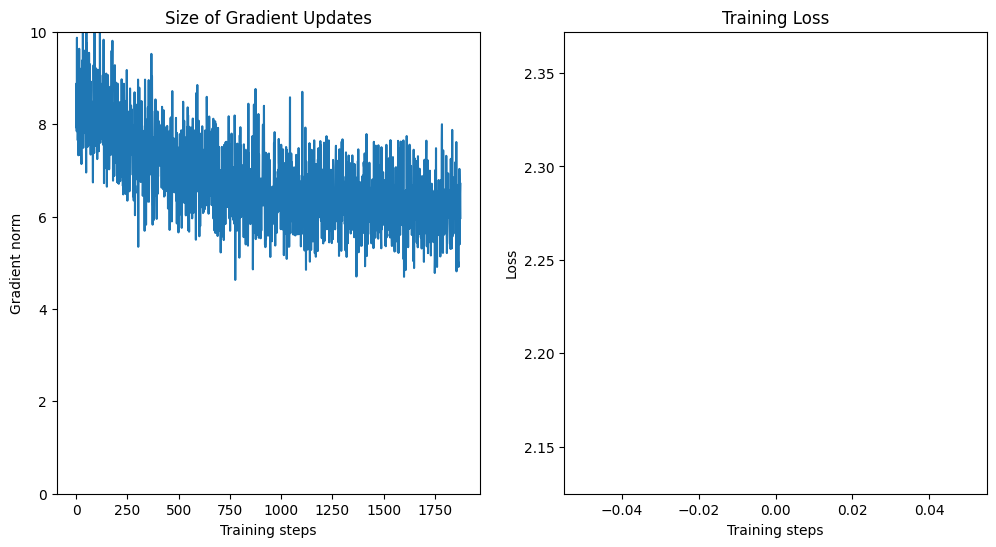

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/1875 [00:00<06:04,  5.15it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.737382


Epoch 1:  27%|██▋       | 507/1875 [00:09<00:25, 53.76it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.381341


Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:16, 52.65it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.237755


Epoch 1:  80%|████████  | 1506/1875 [00:28<00:06, 54.56it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.176224


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.59it/s]



Train set: Avg. loss: 2.2550, Time: 36.4 secs 


Test set: Avg. loss: 0.0009, Accuracy: 43%, Time: 3.3 secs

Train loss: 2.254951378059387, Test loss: 0.0008935648202896119, Test accuracy: 42.64, Train time: 36.3561909198761, Test time: 3.2757670879364014


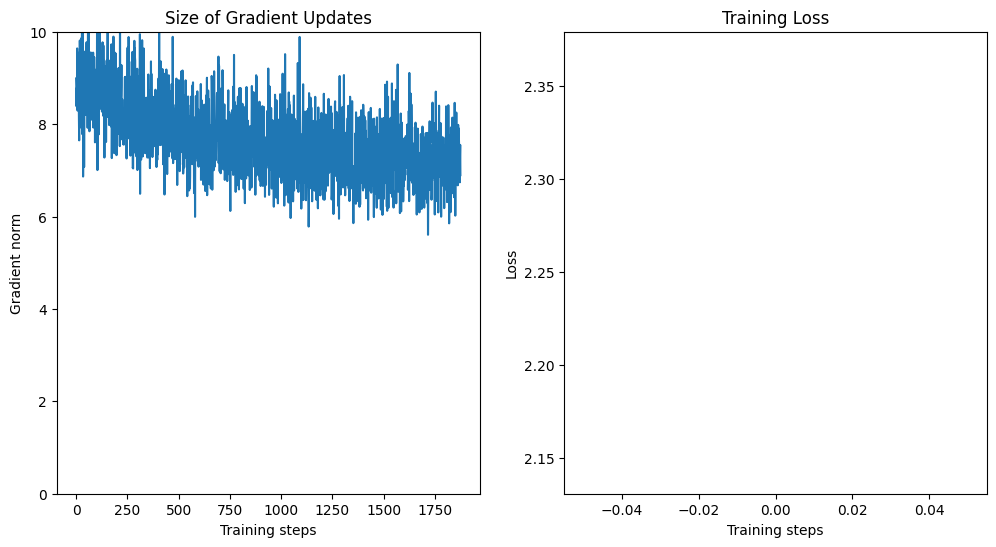

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 7/1875 [00:00<01:13, 25.24it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.468162


Epoch 1:  27%|██▋       | 511/1875 [00:09<00:24, 54.92it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.308120


Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:15, 55.84it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.110629


Epoch 1:  80%|████████  | 1507/1875 [00:28<00:07, 52.52it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.232764


Epoch 1: 100%|██████████| 1875/1875 [00:35<00:00, 52.25it/s]


Train set: Avg. loss: 2.2816, Time: 35.9 secs 




Test set: Avg. loss: 0.0010, Accuracy: 37%, Time: 3.3 secs

Train loss: 2.2815795710245768, Test loss: 0.00096217280626297, Test accuracy: 37.16, Train time: 35.890307903289795, Test time: 3.304565906524658


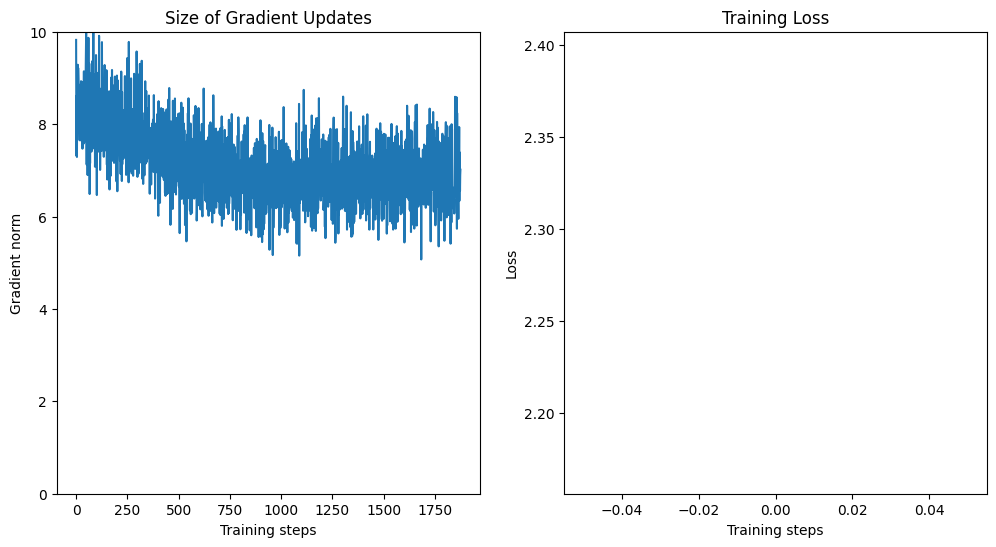

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=4


Epoch 1:   0%|          | 4/1875 [00:00<03:56,  7.92it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.329890


Epoch 1:  27%|██▋       | 511/1875 [00:10<00:25, 53.82it/s]

Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.144322


Epoch 1:  54%|█████▍    | 1011/1875 [00:19<00:15, 57.00it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.188719


Epoch 1:  80%|████████  | 1505/1875 [00:29<00:08, 41.96it/s]

Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.945959


Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 50.82it/s]


Train set: Avg. loss: 2.1266, Time: 36.9 secs 




Test set: Avg. loss: 0.0008, Accuracy: 49%, Time: 3.8 secs

Train loss: 2.126604205322266, Test loss: 0.0008227702498435974, Test accuracy: 49.26, Train time: 36.90616321563721, Test time: 3.843287944793701


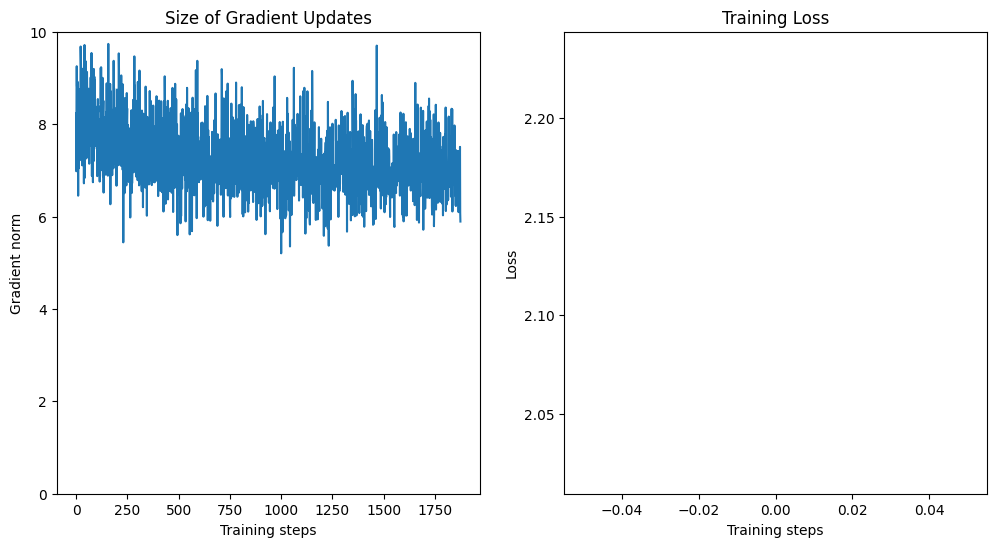

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=1


Epoch 1:   0%|          | 4/938 [00:00<01:11, 13.05it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.574556


Epoch 1:  11%|█         | 105/938 [00:03<00:27, 30.83it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.826096


Epoch 1:  22%|██▏       | 205/938 [00:07<00:24, 30.12it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.428042


Epoch 1:  33%|███▎      | 305/938 [00:10<00:19, 31.81it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.328676


Epoch 1:  43%|████▎     | 405/938 [00:13<00:17, 30.74it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.569241


Epoch 1:  54%|█████▎    | 504/938 [00:16<00:14, 29.69it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.278700


Epoch 1:  64%|██████▍   | 604/938 [00:20<00:11, 29.02it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.297004


Epoch 1:  75%|███████▌  | 704/938 [00:24<00:08, 26.14it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.347505


Epoch 1:  86%|████████▌ | 804/938 [00:27<00:04, 31.01it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.327606


Epoch 1:  96%|█████████▋| 904/938 [00:31<00:01, 31.61it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.141421


Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.12it/s]


Train set: Avg. loss: 0.5102, Time: 32.2 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.510231050156327, Test loss: 0.0002887530215084553, Test accuracy: 95.77, Train time: 32.22112774848938, Test time: 3.1645352840423584


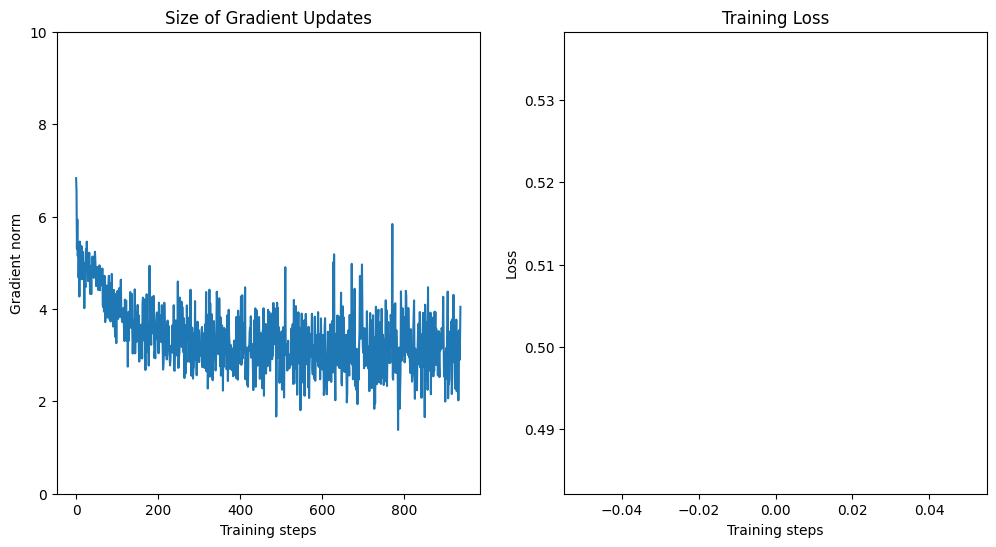

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=2


Epoch 1:   0%|          | 2/938 [00:00<02:27,  6.35it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.595360


Epoch 1:  11%|█         | 104/938 [00:03<00:28, 29.42it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.673403


Epoch 1:  22%|██▏       | 206/938 [00:07<00:24, 29.58it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.578047


Epoch 1:  32%|███▏      | 304/938 [00:10<00:19, 32.55it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.512601


Epoch 1:  43%|████▎     | 405/938 [00:13<00:16, 31.68it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.470557


Epoch 1:  54%|█████▍    | 505/938 [00:16<00:13, 31.13it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.225772


Epoch 1:  65%|██████▍   | 606/938 [00:20<00:11, 29.81it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.219169


Epoch 1:  75%|███████▌  | 704/938 [00:23<00:07, 29.71it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.327082


Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 30.60it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.384569


Epoch 1:  96%|█████████▋| 905/938 [00:30<00:01, 30.68it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.236515


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.87it/s]


Train set: Avg. loss: 0.4968, Time: 31.4 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.4968241079768011, Test loss: 0.0002574955727905035, Test accuracy: 96.21, Train time: 31.411614418029785, Test time: 3.319791316986084


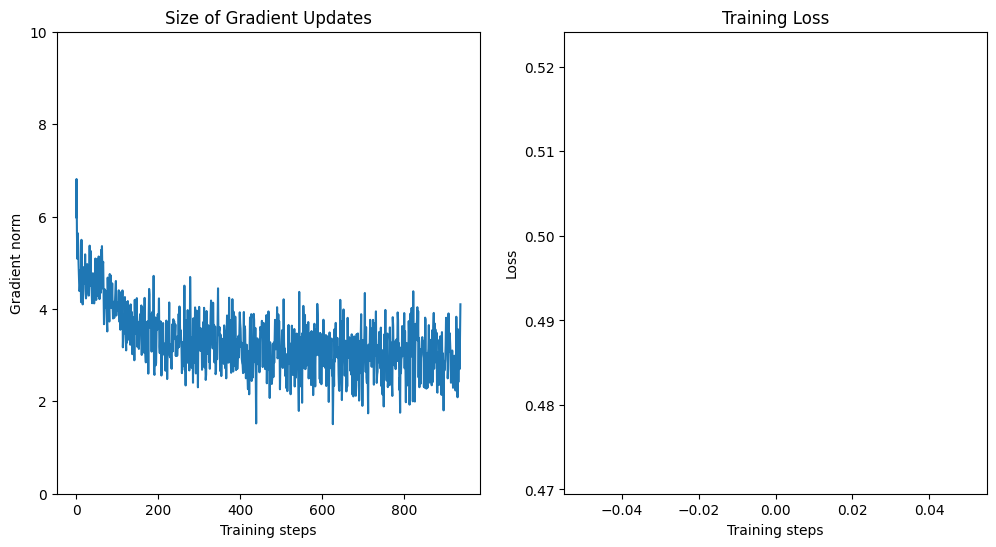

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=4


Epoch 1:   0%|          | 4/938 [00:00<02:02,  7.65it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.445846


Epoch 1:  11%|█         | 104/938 [00:04<00:27, 29.88it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.262060


Epoch 1:  22%|██▏       | 205/938 [00:07<00:25, 29.09it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.526588


Epoch 1:  33%|███▎      | 309/938 [00:10<00:16, 39.04it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.439001


Epoch 1:  43%|████▎     | 408/938 [00:14<00:17, 30.05it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.345955


Epoch 1:  54%|█████▍    | 506/938 [00:17<00:10, 40.92it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.350071


Epoch 1:  65%|██████▍   | 607/938 [00:20<00:10, 32.22it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.271095


Epoch 1:  75%|███████▌  | 706/938 [00:23<00:07, 30.59it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.382441


Epoch 1:  86%|████████▌ | 806/938 [00:27<00:04, 29.90it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.411564


Epoch 1:  96%|█████████▋| 903/938 [00:30<00:01, 31.07it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.276949


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.38it/s]


Train set: Avg. loss: 0.5545, Time: 31.9 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.6 secs

Train loss: 0.5545235487904503, Test loss: 0.0002888875350356102, Test accuracy: 95.87, Train time: 31.934454202651978, Test time: 3.628206491470337


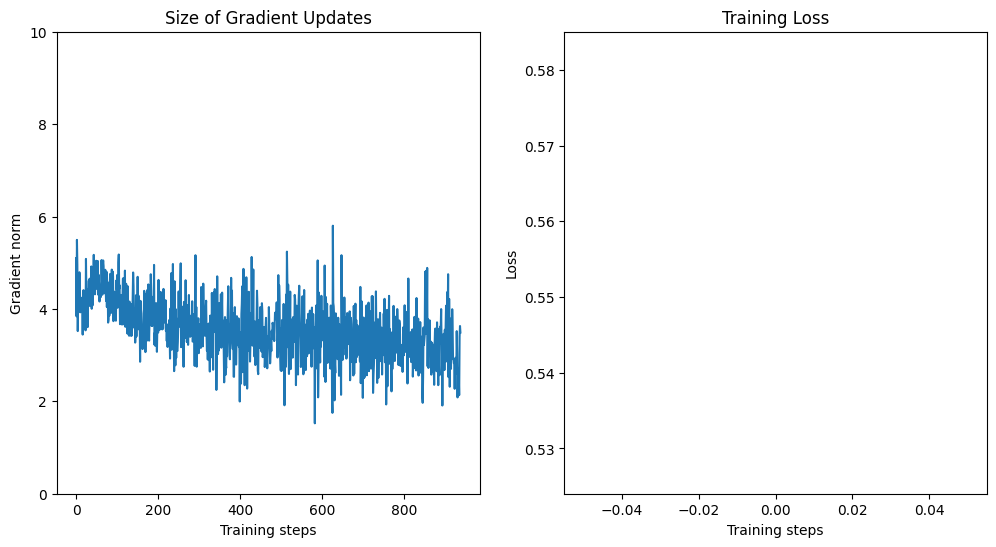

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/938 [00:00<02:49,  5.54it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.798030


Epoch 1:  22%|██▏       | 205/938 [00:07<00:28, 25.70it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.507592


Epoch 1:  43%|████▎     | 404/938 [00:13<00:17, 30.64it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.460362


Epoch 1:  65%|██████▍   | 606/938 [00:20<00:11, 29.62it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.256016


Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 30.36it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.316543


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.54it/s]


Train set: Avg. loss: 0.5758, Time: 31.8 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.5757714370801759, Test loss: 0.000278746647387743, Test accuracy: 95.82, Train time: 31.758671283721924, Test time: 3.206345558166504


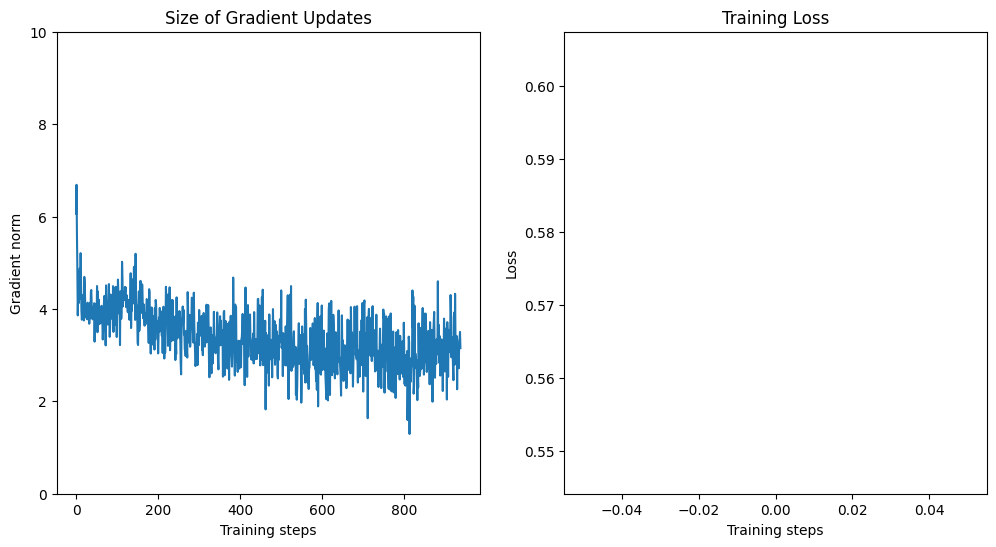

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=2


Epoch 1:   1%|          | 5/938 [00:00<01:13, 12.71it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.711823


Epoch 1:  22%|██▏       | 204/938 [00:07<00:26, 27.87it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.471224


Epoch 1:  43%|████▎     | 404/938 [00:13<00:17, 31.29it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.306892


Epoch 1:  64%|██████▍   | 605/938 [00:20<00:10, 30.65it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.246585


Epoch 1:  86%|████████▌ | 807/938 [00:26<00:04, 31.32it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.504024


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 30.06it/s]


Train set: Avg. loss: 0.5348, Time: 31.2 secs 




Test set: Avg. loss: 0.0003, Accuracy: 95%, Time: 3.3 secs

Train loss: 0.5348263231676016, Test loss: 0.0003003254856914282, Test accuracy: 95.48, Train time: 31.210291862487793, Test time: 3.287337303161621


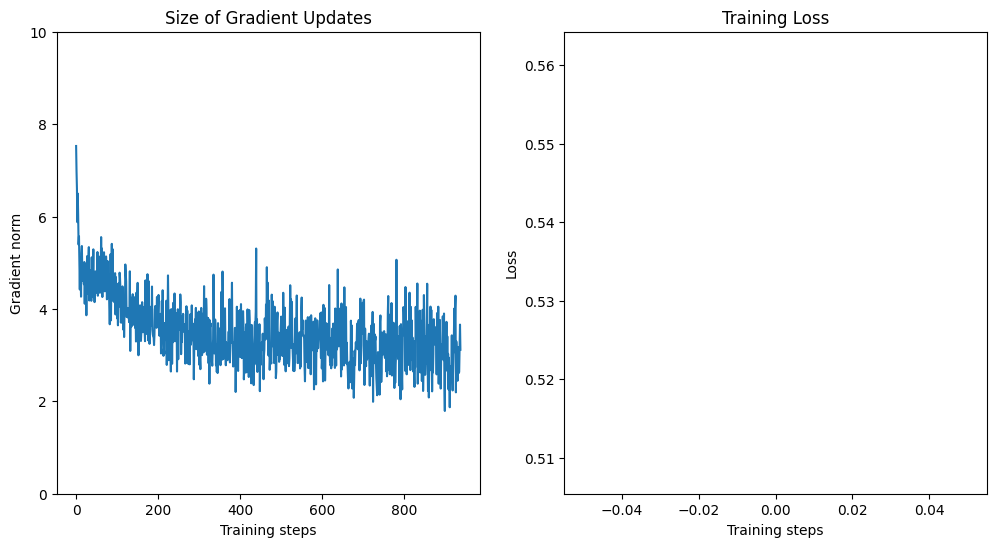

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=4


Epoch 1:   0%|          | 4/938 [00:00<01:56,  8.05it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.749695


Epoch 1:  22%|██▏       | 205/938 [00:07<00:20, 35.66it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.544284


Epoch 1:  43%|████▎     | 402/938 [00:14<00:17, 29.84it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.218168


Epoch 1:  64%|██████▍   | 603/938 [00:20<00:10, 30.76it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.340477


Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 31.90it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.311953


Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.21it/s]


Train set: Avg. loss: 0.4948, Time: 32.1 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.7 secs

Train loss: 0.49478828814873566, Test loss: 0.00027500777021050455, Test accuracy: 95.84, Train time: 32.12803268432617, Test time: 3.6533238887786865


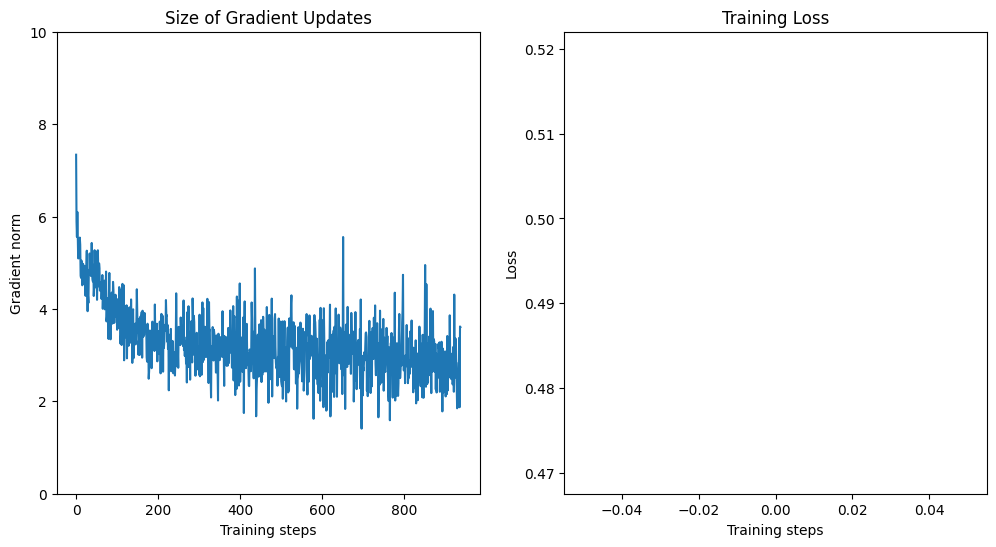

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/938 [00:00<02:55,  5.34it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.741514


Epoch 1:  54%|█████▍    | 505/938 [00:16<00:14, 29.47it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.337602


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.76it/s]


Train set: Avg. loss: 0.5212, Time: 31.5 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.5212074082924613, Test loss: 0.0002911341279745102, Test accuracy: 95.72, Train time: 31.527591943740845, Test time: 3.179607391357422


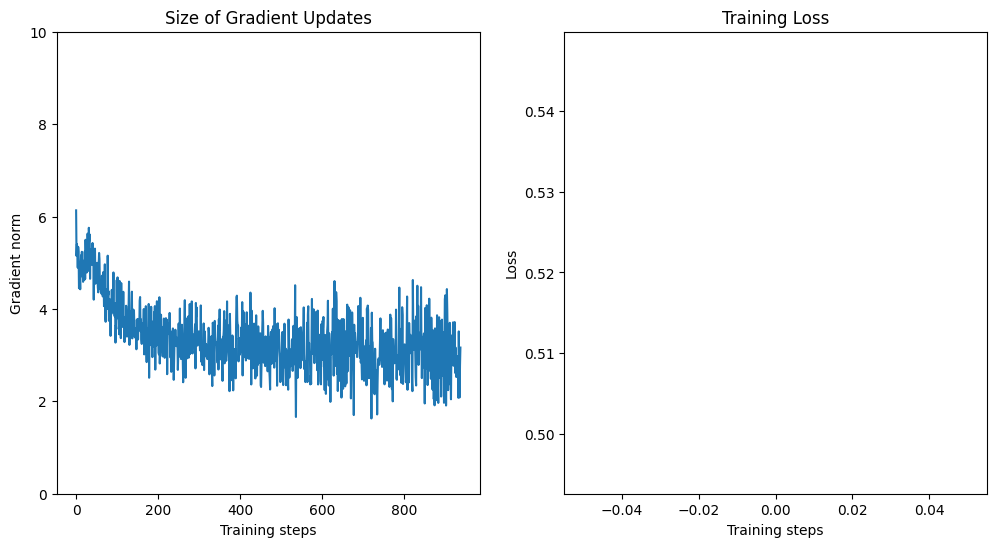

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=2


Epoch 1:   1%|          | 7/938 [00:00<00:47, 19.53it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.487710


Epoch 1:  54%|█████▍    | 505/938 [00:18<00:37, 11.46it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.405005


Epoch 1: 100%|██████████| 938/938 [00:33<00:00, 28.34it/s]


Train set: Avg. loss: 0.5170, Time: 33.1 secs 




Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.5169774273406468, Test loss: 0.0002733903288841248, Test accuracy: 96.03, Train time: 33.104676723480225, Test time: 3.348782777786255


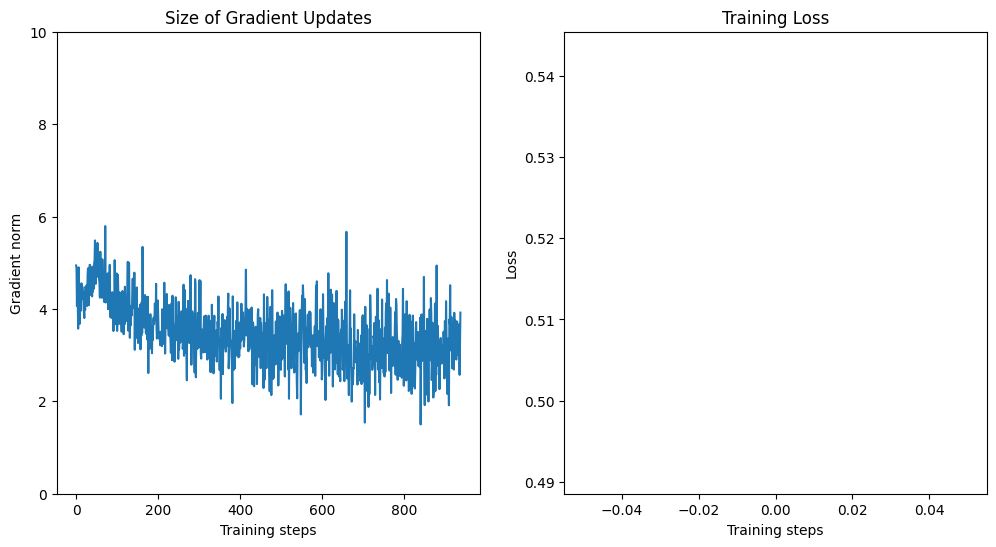

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=4


Epoch 1:   1%|          | 8/938 [00:00<01:17, 12.07it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.449752


Epoch 1:  54%|█████▎    | 502/938 [00:16<00:13, 31.19it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.564624


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.54it/s]


Train set: Avg. loss: 0.5366, Time: 31.8 secs 




Test set: Avg. loss: 0.0003, Accuracy: 95%, Time: 3.8 secs

Train loss: 0.5366039576926338, Test loss: 0.0003227405309677124, Test accuracy: 95.0, Train time: 31.76792287826538, Test time: 3.8394014835357666


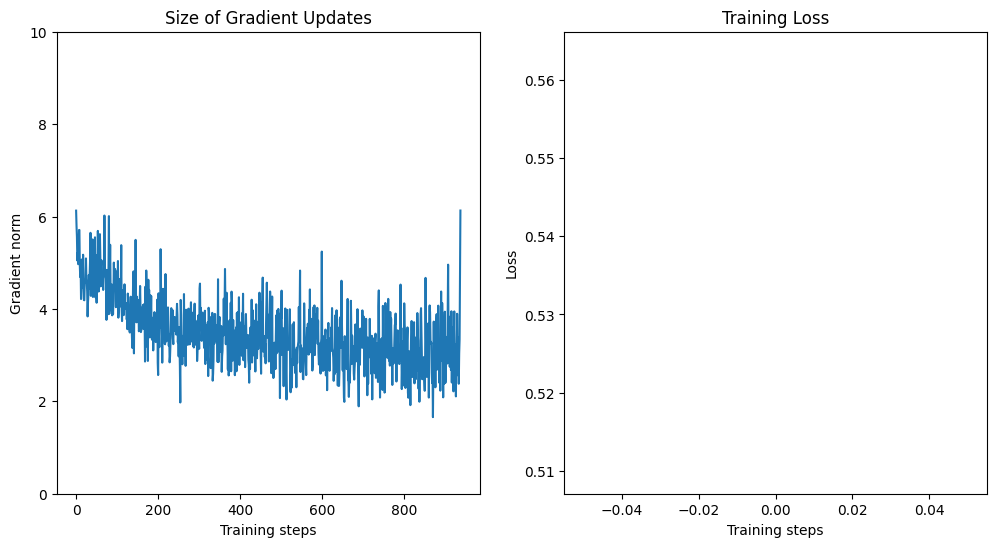

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 0/938 [00:00<?, ?it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.553129


Epoch 1:  11%|█▏        | 106/938 [00:03<00:27, 30.73it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.309168


Epoch 1:  22%|██▏       | 205/938 [00:07<00:23, 31.03it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.113011


Epoch 1:  33%|███▎      | 305/938 [00:10<00:20, 31.49it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.698392


Epoch 1:  43%|████▎     | 405/938 [00:13<00:16, 31.91it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.431399


Epoch 1:  54%|█████▍    | 506/938 [00:16<00:13, 31.42it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.943995


Epoch 1:  65%|██████▍   | 606/938 [00:20<00:11, 29.90it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.194647


Epoch 1:  75%|███████▌  | 707/938 [00:23<00:07, 31.56it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.901216


Epoch 1:  86%|████████▌ | 807/938 [00:26<00:04, 31.33it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.870951


Epoch 1:  97%|█████████▋| 907/938 [00:29<00:00, 31.21it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.008513


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 30.25it/s]


Train set: Avg. loss: 1.4312, Time: 31.0 secs 




Test set: Avg. loss: 0.0011, Accuracy: 85%, Time: 3.2 secs

Train loss: 1.4311830502456184, Test loss: 0.0010872855842113496, Test accuracy: 84.75, Train time: 31.013814449310303, Test time: 3.2476966381073


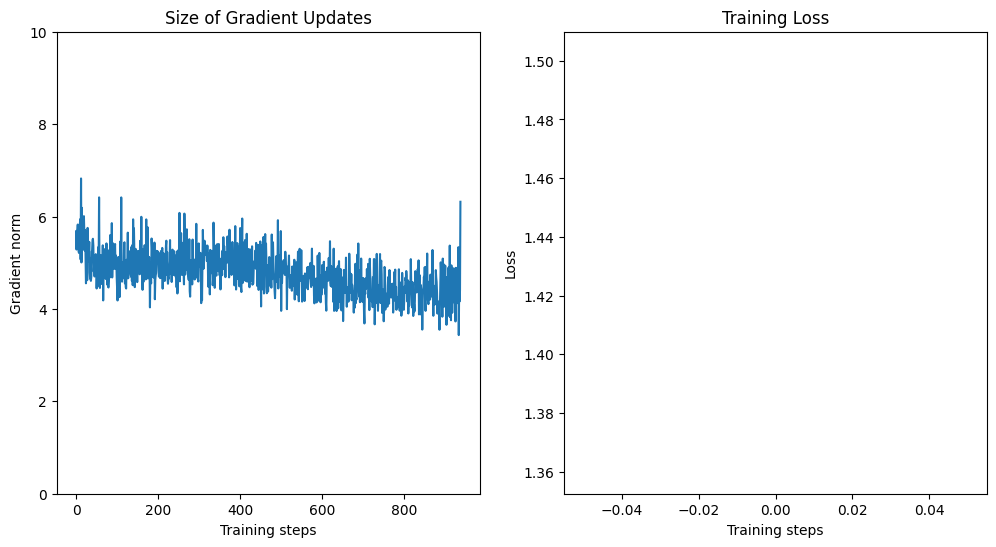

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=2


Epoch 1:   1%|          | 5/938 [00:00<01:10, 13.22it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.543602


Epoch 1:  11%|█         | 105/938 [00:03<00:29, 28.72it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.268844


Epoch 1:  22%|██▏       | 205/938 [00:07<00:24, 29.44it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.148539


Epoch 1:  33%|███▎      | 308/938 [00:10<00:19, 32.46it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.967475


Epoch 1:  43%|████▎     | 405/938 [00:13<00:16, 32.08it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.746647


Epoch 1:  54%|█████▎    | 502/938 [00:17<00:15, 28.97it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.405172


Epoch 1:  65%|██████▍   | 607/938 [00:20<00:10, 30.58it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.685635


Epoch 1:  75%|███████▌  | 708/938 [00:24<00:07, 31.53it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.508703


Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 33.22it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.264448


Epoch 1:  96%|█████████▋| 905/938 [00:30<00:01, 30.77it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.198063


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.61it/s]


Train set: Avg. loss: 1.7052, Time: 31.7 secs 




Test set: Avg. loss: 0.0015, Accuracy: 78%, Time: 3.3 secs

Train loss: 1.7052364673441662, Test loss: 0.0015317907482385634, Test accuracy: 78.41, Train time: 31.687419652938843, Test time: 3.3339335918426514


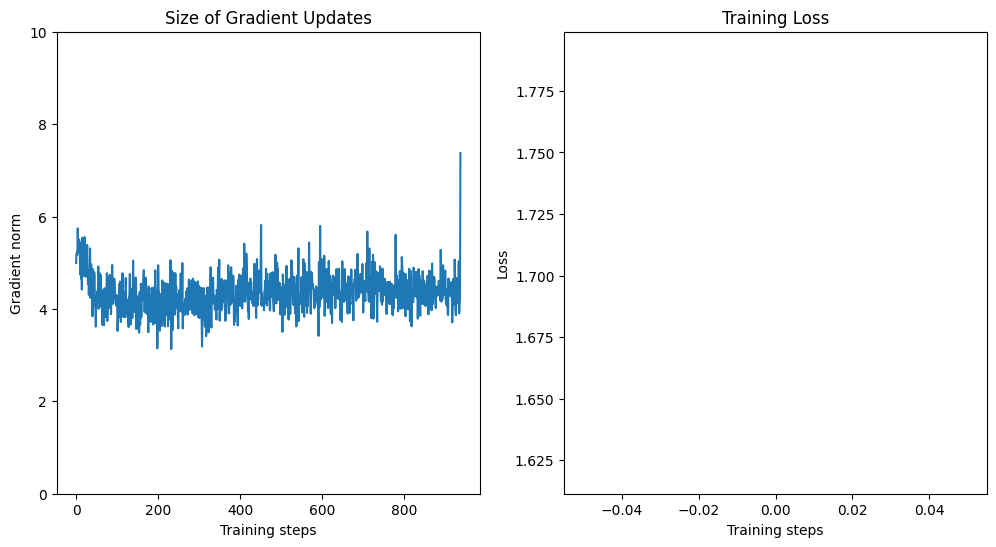

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=4


Epoch 1:   0%|          | 4/938 [00:00<02:11,  7.12it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.554958


Epoch 1:  11%|█▏        | 107/938 [00:04<00:26, 31.71it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.078971


Epoch 1:  22%|██▏       | 203/938 [00:07<00:25, 28.79it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.905091


Epoch 1:  32%|███▏      | 303/938 [00:10<00:17, 35.64it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.850586


Epoch 1:  43%|████▎     | 403/938 [00:13<00:15, 34.56it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.775033


Epoch 1:  54%|█████▎    | 504/938 [00:17<00:15, 28.68it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.479990


Epoch 1:  64%|██████▍   | 604/938 [00:20<00:12, 27.77it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.431959


Epoch 1:  75%|███████▌  | 706/938 [00:24<00:07, 30.41it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.926893


Epoch 1:  86%|████████▌ | 804/938 [00:27<00:04, 32.74it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.872188


Epoch 1:  97%|█████████▋| 906/938 [00:30<00:01, 30.47it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.829312


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.47it/s]


Train set: Avg. loss: 1.5192, Time: 31.8 secs 




Test set: Avg. loss: 0.0011, Accuracy: 84%, Time: 3.8 secs

Train loss: 1.519180509454406, Test loss: 0.0011372894942760468, Test accuracy: 84.16, Train time: 31.834757566452026, Test time: 3.782322645187378


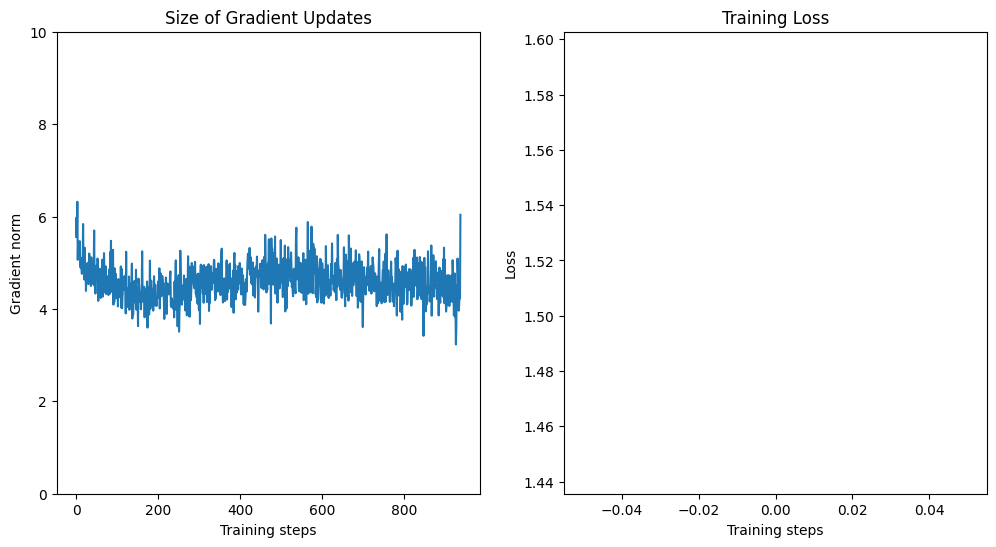

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 0/938 [00:00<?, ?it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.612273

Epoch 1:   1%|          | 5/938 [00:00<00:53, 17.40it/s]

Epoch 1:  22%|██▏       | 206/938 [00:07<00:23, 31.48it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.965294


Epoch 1:  43%|████▎     | 405/938 [00:13<00:18, 29.30it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.507997


Epoch 1:  64%|██████▍   | 605/938 [00:20<00:10, 30.35it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.980374


Epoch 1:  86%|████████▌ | 805/938 [00:26<00:04, 30.44it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.982839


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 30.04it/s]


Train set: Avg. loss: 1.4454, Time: 31.2 secs 




Test set: Avg. loss: 0.0011, Accuracy: 86%, Time: 3.3 secs

Train loss: 1.4453979728064303, Test loss: 0.0010571376353502274, Test accuracy: 85.9, Train time: 31.235986948013306, Test time: 3.2592382431030273


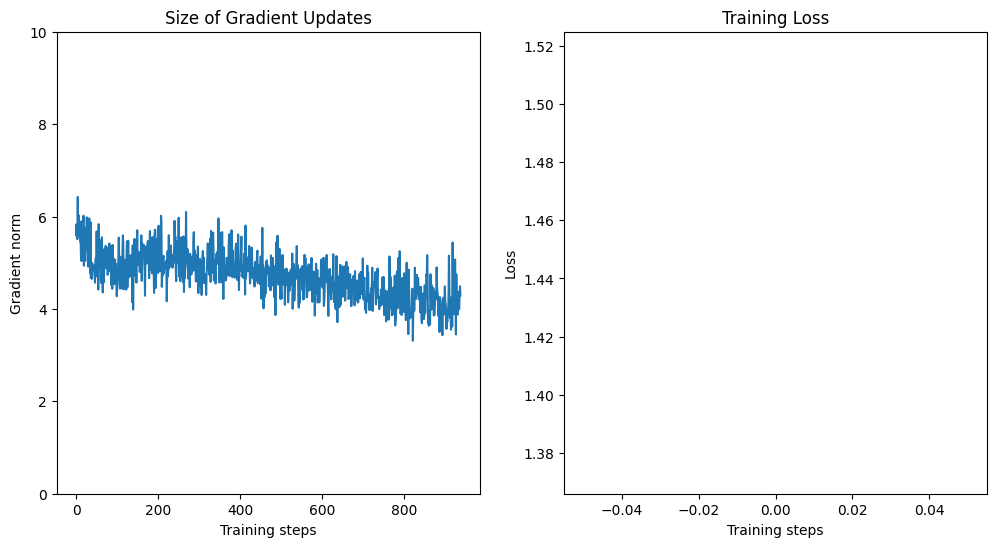

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=2


Epoch 1:   0%|          | 2/938 [00:00<02:48,  5.55it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.560881


Epoch 1:  22%|██▏       | 206/938 [00:07<00:21, 33.77it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.987437


Epoch 1:  43%|████▎     | 407/938 [00:13<00:15, 34.13it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.541131


Epoch 1:  64%|██████▍   | 602/938 [00:20<00:11, 30.42it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.957555


Epoch 1:  86%|████████▌ | 806/938 [00:26<00:04, 32.48it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.862347


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.88it/s]


Train set: Avg. loss: 1.4625, Time: 31.4 secs 




Test set: Avg. loss: 0.0011, Accuracy: 86%, Time: 3.5 secs

Train loss: 1.462520532643617, Test loss: 0.0010511797159910201, Test accuracy: 85.53, Train time: 31.399129629135132, Test time: 3.4987261295318604


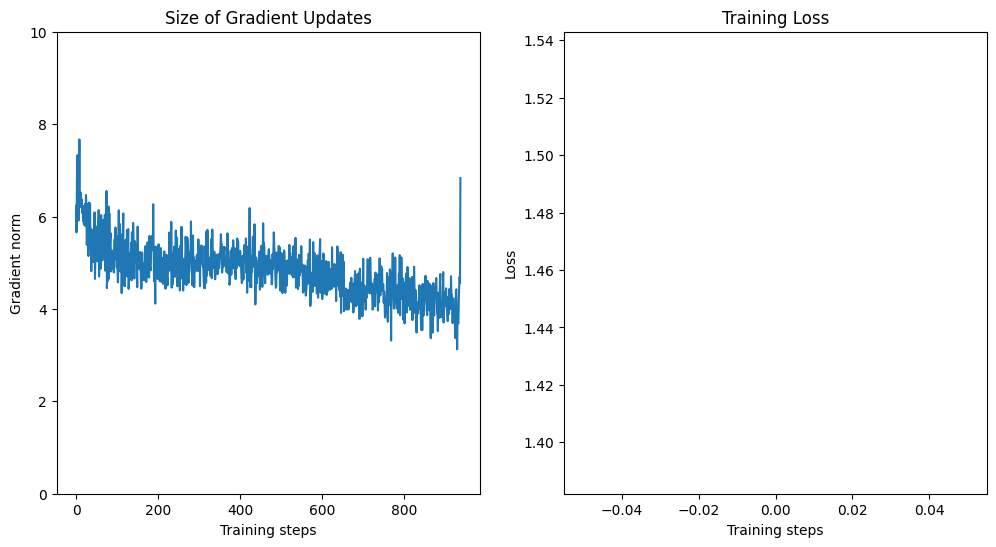

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 4/938 [00:00<02:17,  6.80it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.665875


Epoch 1:  22%|██▏       | 203/938 [00:07<00:26, 27.72it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.973159


Epoch 1:  43%|████▎     | 405/938 [00:14<00:16, 32.83it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.479222


Epoch 1:  64%|██████▍   | 602/938 [00:20<00:11, 30.10it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.076788


Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 29.10it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.008201


Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.04it/s]


Train set: Avg. loss: 1.4646, Time: 32.3 secs 




Test set: Avg. loss: 0.0010, Accuracy: 86%, Time: 3.6 secs

Train loss: 1.4645998537667524, Test loss: 0.0010400501549243928, Test accuracy: 86.18, Train time: 32.31570744514465, Test time: 3.615762948989868


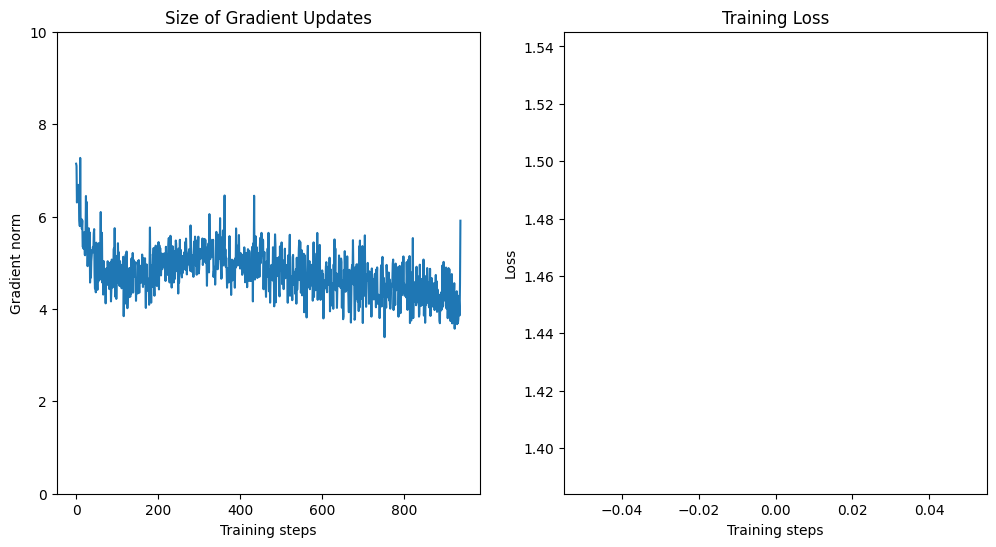

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=1


Epoch 1:   1%|          | 5/938 [00:00<00:54, 17.09it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.641663


Epoch 1:  54%|█████▎    | 502/938 [00:16<00:14, 30.37it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.335644


Epoch 1: 100%|██████████| 938/938 [00:30<00:00, 30.26it/s]


Train set: Avg. loss: 1.4217, Time: 31.0 secs 




Test set: Avg. loss: 0.0011, Accuracy: 85%, Time: 3.2 secs

Train loss: 1.421700591980013, Test loss: 0.001080046582221985, Test accuracy: 85.25, Train time: 31.009872913360596, Test time: 3.2130539417266846


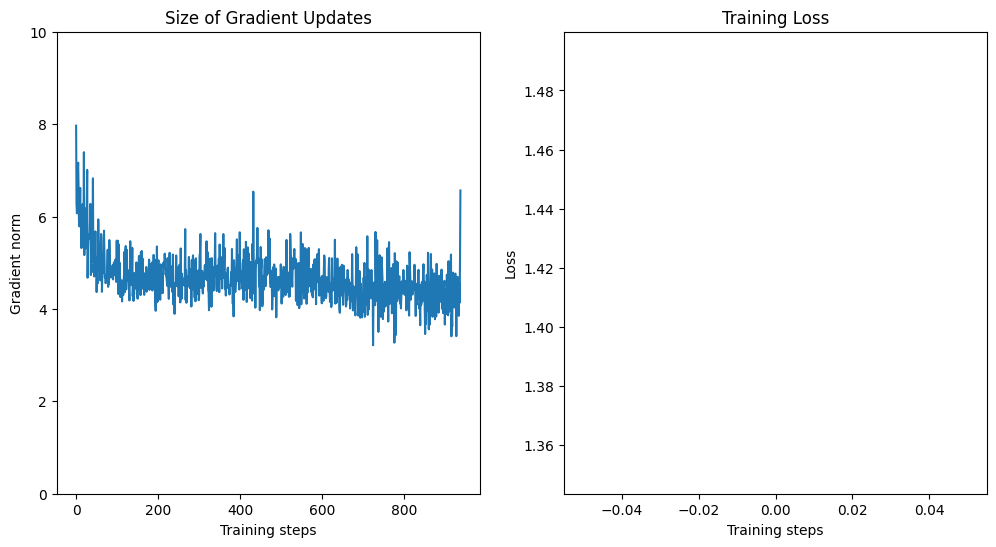

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 2/938 [00:00<02:53,  5.39it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.637837


Epoch 1:  54%|█████▍    | 506/938 [00:17<00:14, 30.05it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.657760


Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.31it/s]


Train set: Avg. loss: 1.6375, Time: 32.0 secs 




Test set: Avg. loss: 0.0015, Accuracy: 79%, Time: 3.5 secs

Train loss: 1.6374896617967691, Test loss: 0.0014562816470861436, Test accuracy: 78.9, Train time: 32.0109384059906, Test time: 3.493091583251953


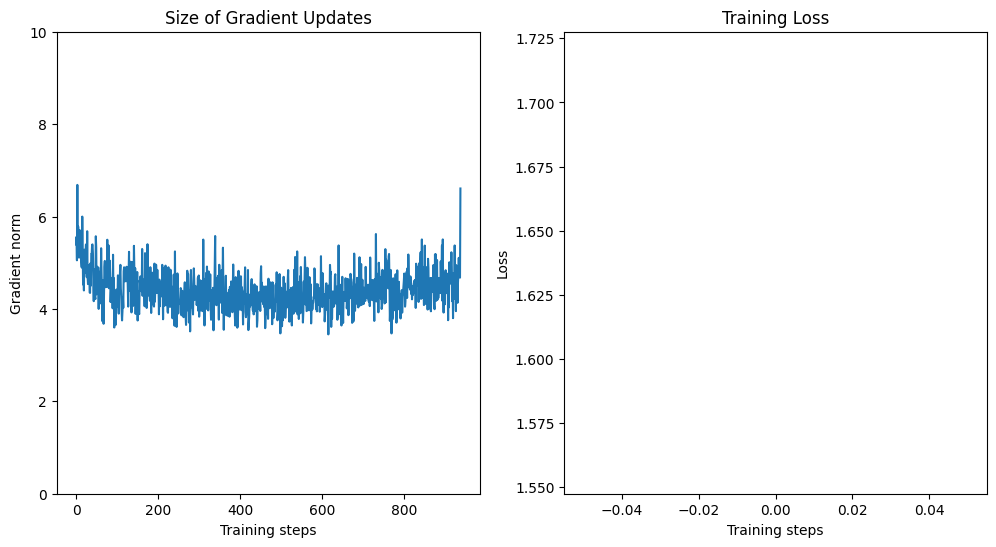

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=4


Epoch 1:   1%|          | 11/938 [00:00<00:52, 17.53it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.484895


Epoch 1:  54%|█████▍    | 505/938 [00:17<00:14, 29.49it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.356171


Epoch 1: 100%|██████████| 938/938 [00:33<00:00, 28.31it/s]


Train set: Avg. loss: 1.4694, Time: 33.1 secs 




Test set: Avg. loss: 0.0011, Accuracy: 86%, Time: 3.9 secs

Train loss: 1.4694195372590633, Test loss: 0.0010993375927209855, Test accuracy: 85.88, Train time: 33.14086842536926, Test time: 3.866856813430786


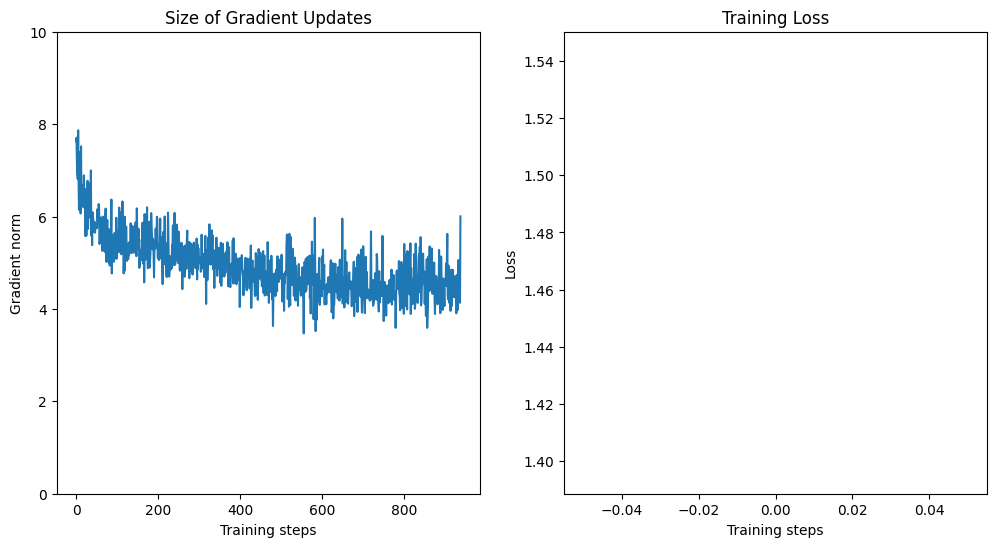

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=1


Epoch 1:   0%|          | 3/938 [00:00<01:38,  9.45it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.643720


Epoch 1:  11%|█         | 103/938 [00:03<00:32, 25.81it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.399372


Epoch 1:  22%|██▏       | 206/938 [00:07<00:23, 30.62it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.317051


Epoch 1:  33%|███▎      | 305/938 [00:10<00:21, 29.60it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.367990


Epoch 1:  43%|████▎     | 406/938 [00:14<00:17, 30.64it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.386734


Epoch 1:  54%|█████▎    | 504/938 [00:17<00:14, 29.23it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.268589


Epoch 1:  64%|██████▍   | 605/938 [00:21<00:11, 29.85it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.266676


Epoch 1:  75%|███████▌  | 705/938 [00:24<00:07, 30.75it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.154144


Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 29.09it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.127883


Epoch 1:  96%|█████████▋| 903/938 [00:31<00:01, 29.00it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.220376


Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 28.91it/s]


Train set: Avg. loss: 2.3557, Time: 32.5 secs 




Test set: Avg. loss: 0.0043, Accuracy: 25%, Time: 3.6 secs

Train loss: 2.3556854058938748, Test loss: 0.004252817225456238, Test accuracy: 25.35, Train time: 32.4521484375, Test time: 3.609266519546509


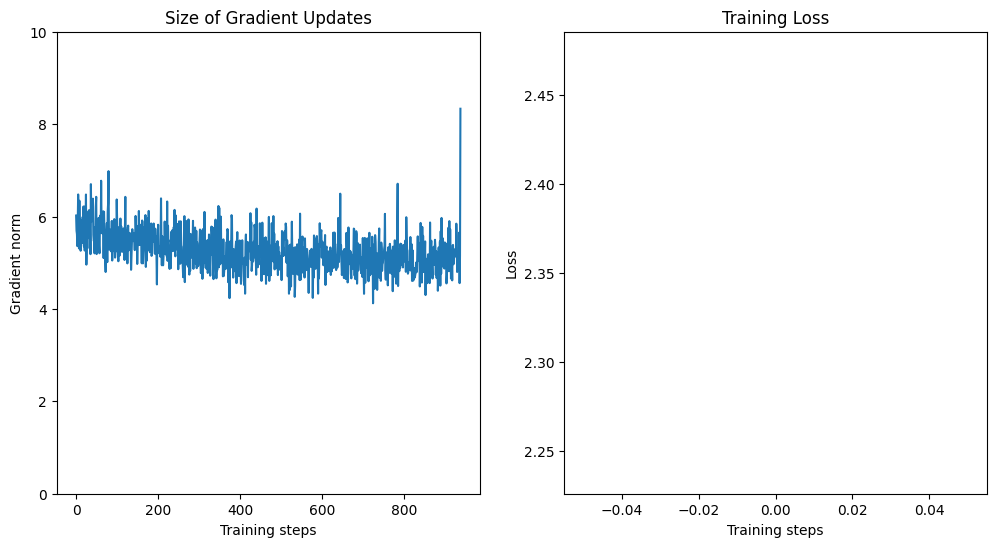

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=2


Epoch 1:   0%|          | 4/938 [00:00<01:23, 11.24it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.675500


Epoch 1:  11%|█▏        | 107/938 [00:04<00:27, 30.64it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.651288


Epoch 1:  22%|██▏       | 204/938 [00:07<00:25, 28.98it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.449873


Epoch 1:  32%|███▏      | 303/938 [00:10<00:22, 28.68it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.511978


Epoch 1:  43%|████▎     | 404/938 [00:14<00:19, 27.33it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.253100


Epoch 1:  54%|█████▍    | 505/938 [00:17<00:15, 27.64it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.168416


Epoch 1:  64%|██████▍   | 605/938 [00:21<00:11, 29.76it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.345312


Epoch 1:  75%|███████▌  | 705/938 [00:24<00:07, 29.91it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.216761


Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 30.31it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.304982


Epoch 1:  96%|█████████▋| 905/938 [00:31<00:01, 30.58it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.236800


Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 28.81it/s]


Train set: Avg. loss: 2.4147, Time: 32.6 secs 




Test set: Avg. loss: 0.0043, Accuracy: 27%, Time: 3.6 secs

Train loss: 2.414740402561261, Test loss: 0.004283634877204895, Test accuracy: 26.72, Train time: 32.5669219493866, Test time: 3.613513946533203


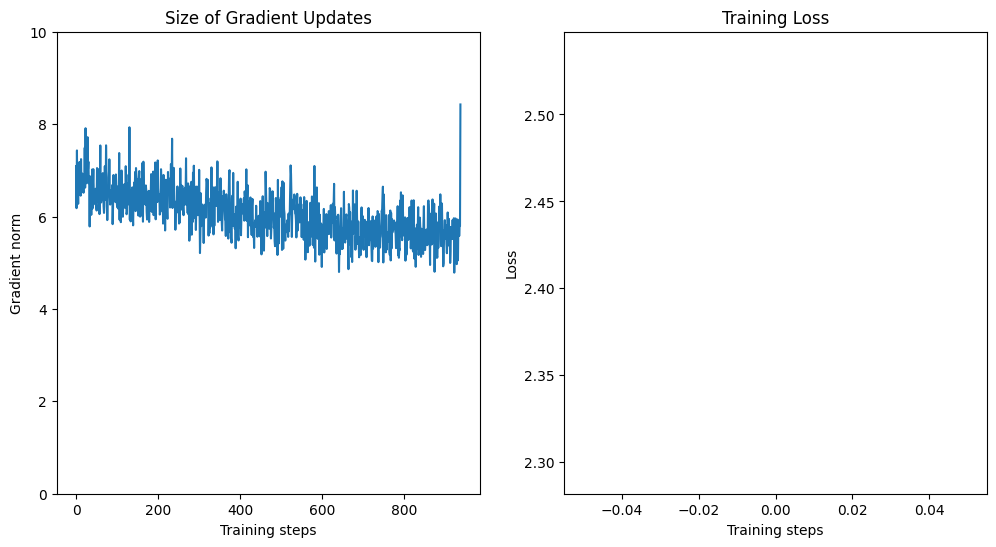

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=4


Epoch 1:   1%|          | 6/938 [00:00<01:24, 10.98it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.660987


Epoch 1:  11%|█         | 105/938 [00:03<00:26, 31.20it/s]

Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.527466


Epoch 1:  22%|██▏       | 204/938 [00:07<00:25, 28.69it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.386461


Epoch 1:  33%|███▎      | 307/938 [00:10<00:19, 32.38it/s]

Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.387213


Epoch 1:  43%|████▎     | 405/938 [00:13<00:18, 28.39it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.557756


Epoch 1:  54%|█████▍    | 505/938 [00:17<00:13, 31.05it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.242097


Epoch 1:  64%|██████▍   | 603/938 [00:20<00:10, 30.50it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.390836


Epoch 1:  75%|███████▍  | 702/938 [00:24<00:09, 24.45it/s]

Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.181809


Epoch 1:  86%|████████▌ | 808/938 [00:27<00:03, 34.37it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.247568


Epoch 1:  96%|█████████▌| 902/938 [00:30<00:01, 29.73it/s]

Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.174966


Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 28.99it/s]


Train set: Avg. loss: 2.3972, Time: 32.4 secs 




Test set: Avg. loss: 0.0043, Accuracy: 27%, Time: 3.8 secs

Train loss: 2.3971532987379063, Test loss: 0.00430118157863617, Test accuracy: 26.82, Train time: 32.35978364944458, Test time: 3.832364559173584


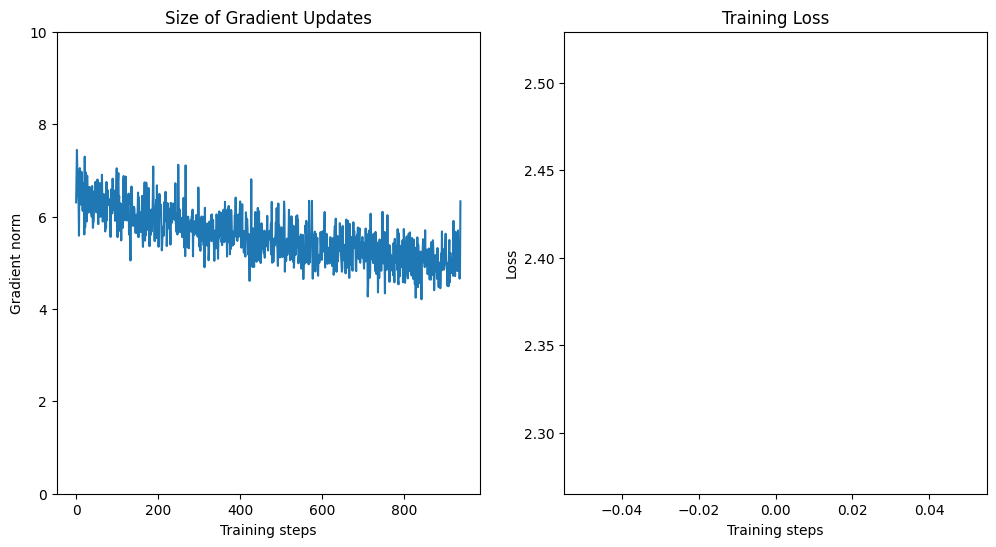

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=1


Epoch 1:   0%|          | 1/938 [00:00<02:56,  5.30it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.846937


Epoch 1:  22%|██▏       | 205/938 [00:06<00:22, 32.00it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.462500


Epoch 1:  43%|████▎     | 406/938 [00:13<00:17, 29.97it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.562965


Epoch 1:  64%|██████▍   | 605/938 [00:20<00:10, 31.13it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.333888


Epoch 1:  86%|████████▌ | 805/938 [00:26<00:04, 29.01it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.288334


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.50it/s]


Train set: Avg. loss: 2.4867, Time: 31.8 secs 




Test set: Avg. loss: 0.0044, Accuracy: 24%, Time: 3.4 secs

Train loss: 2.4866566787650592, Test loss: 0.00436144061088562, Test accuracy: 24.37, Train time: 31.801997900009155, Test time: 3.39839506149292


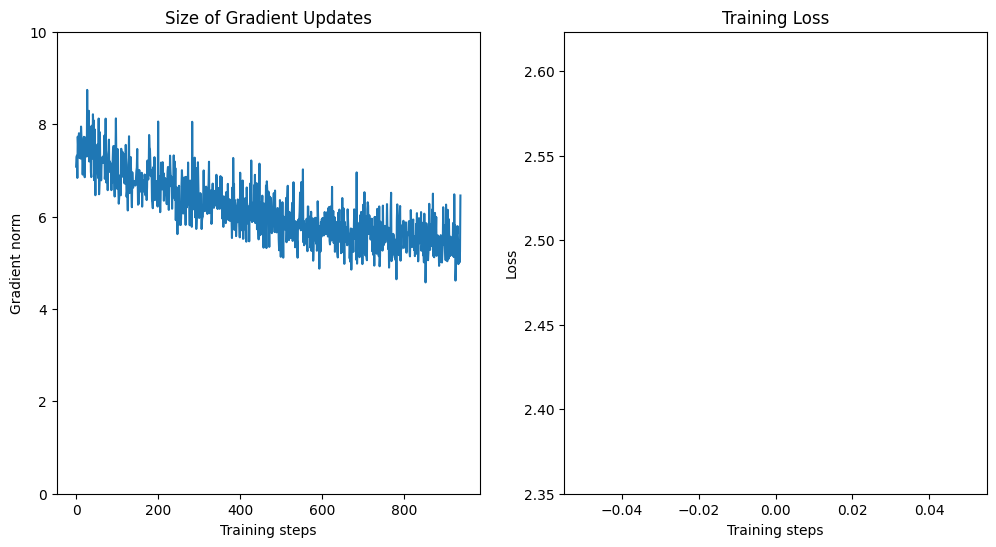

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=2


Epoch 1:   1%|          | 5/938 [00:00<00:59, 15.59it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.614329


Epoch 1:  22%|██▏       | 204/938 [00:07<00:24, 29.83it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.308915


Epoch 1:  43%|████▎     | 402/938 [00:13<00:18, 28.91it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.533096


Epoch 1:  64%|██████▍   | 604/938 [00:20<00:12, 27.49it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.317478


Epoch 1:  86%|████████▌ | 806/938 [00:27<00:04, 28.64it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.279678


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.40it/s]


Train set: Avg. loss: 2.4056, Time: 31.9 secs 




Test set: Avg. loss: 0.0044, Accuracy: 23%, Time: 3.4 secs

Train loss: 2.4055932879702113, Test loss: 0.004374384689331054, Test accuracy: 23.12, Train time: 31.91887331008911, Test time: 3.4471287727355957


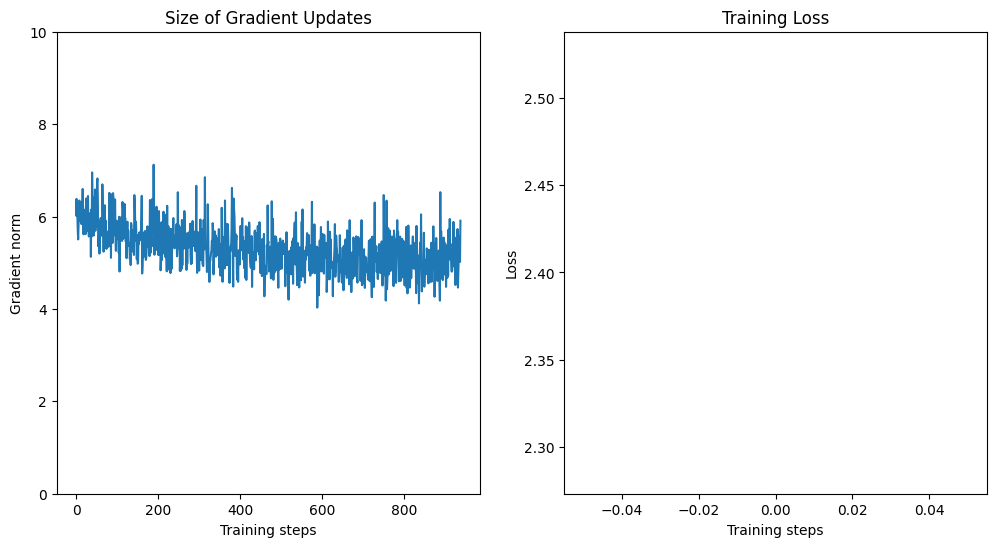

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=4


Epoch 1:   0%|          | 4/938 [00:00<02:12,  7.02it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.769133


Epoch 1:  22%|██▏       | 204/938 [00:07<00:25, 28.64it/s]

Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.499583


Epoch 1:  43%|████▎     | 406/938 [00:14<00:17, 30.04it/s]

Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.449355


Epoch 1:  64%|██████▍   | 604/938 [00:20<00:12, 27.15it/s]

Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.152094


Epoch 1:  86%|████████▌ | 804/938 [00:27<00:04, 30.30it/s]

Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.194568


Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.29it/s]


Train set: Avg. loss: 2.3799, Time: 32.0 secs 




Test set: Avg. loss: 0.0041, Accuracy: 30%, Time: 3.9 secs

Train loss: 2.3798989434994615, Test loss: 0.004136452567577362, Test accuracy: 29.86, Train time: 32.0346040725708, Test time: 3.915295362472534


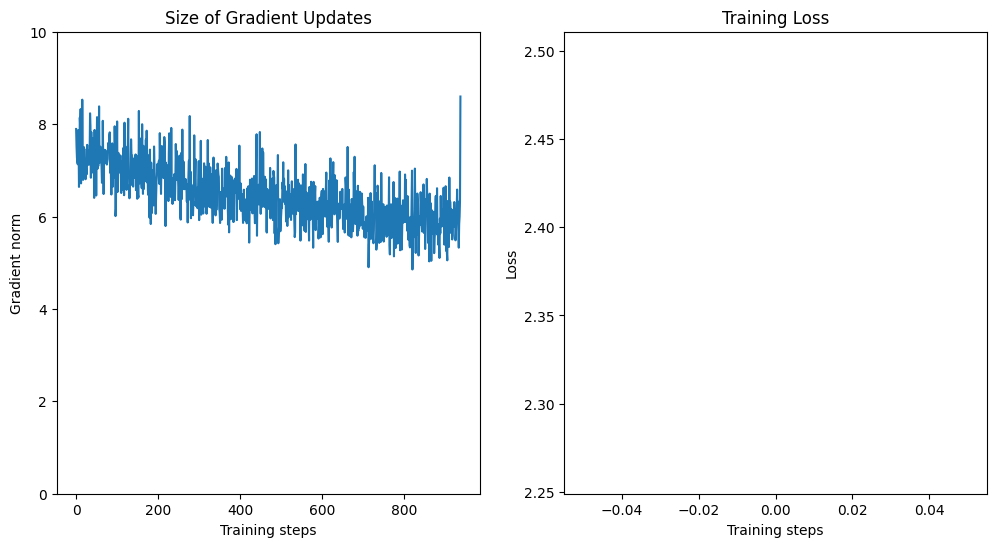

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=1


Epoch 1:   0%|          | 1/938 [00:00<02:46,  5.63it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.830267


Epoch 1:  54%|█████▍    | 506/938 [00:17<00:14, 30.85it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.381318


Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.37it/s]


Train set: Avg. loss: 2.4282, Time: 31.9 secs 




Test set: Avg. loss: 0.0043, Accuracy: 26%, Time: 3.2 secs

Train loss: 2.4281796440641, Test loss: 0.004303654813766479, Test accuracy: 25.67, Train time: 31.94351029396057, Test time: 3.1551506519317627


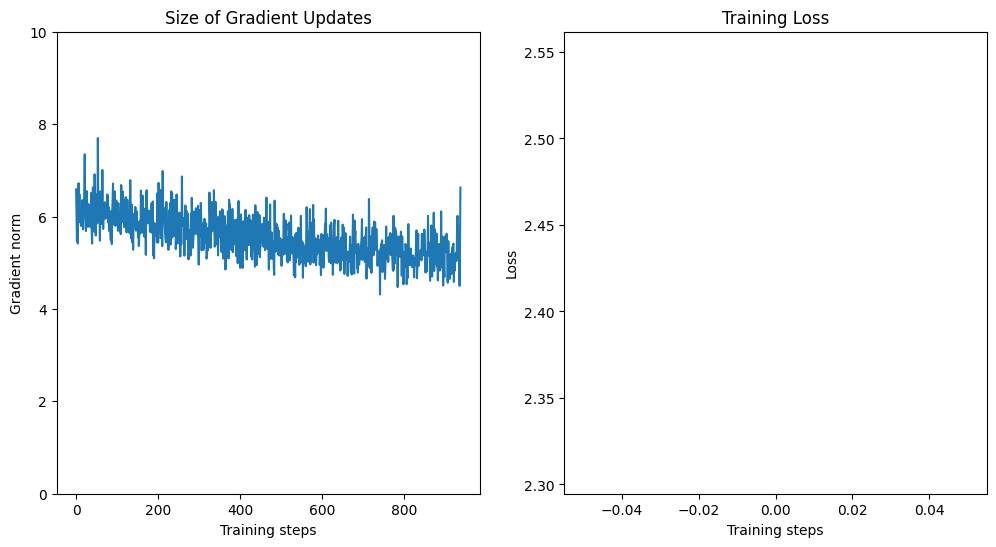

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=2


Epoch 1:   0%|          | 3/938 [00:00<01:48,  8.65it/s]

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.850132


Epoch 1:  54%|█████▍    | 505/938 [00:17<00:14, 30.88it/s]

Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.429618


Epoch 1:  69%|██████▊   | 644/938 [00:21<00:09, 30.95it/s]

In [ ]:
import itertools

# List of hyperparameters to tune
batch_sizes_train = [16, 32, 64, 128]
batch_sizes_test = [500, 1000, 2000]
learning_rates = [0.01, 0.001, 0.0001]
log_intervals = [100, 200, 500]
num_workers = [1, 2, 4]

# Get all combinations of hyperparameters
combinations = list(itertools.product(batch_sizes_train, batch_sizes_test, learning_rates, log_intervals, num_workers))

def train(epoch, model, optimizer, criterion, trainloader, device, log_interval):
    start = time.time()
    model.train()
    train_loss = []
    gradient_norms = []

    for i, (inputs, labels) in enumerate(tqdm(trainloader, desc=f"Epoch {epoch}")):
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        train_loss.append(loss.item())
        loss.backward()
        optimizer.step()

        # Compute the gradient norm and append to list
        total_norm = 0
        for p in model.parameters():
            param_norm = p.grad.data.norm(2)
            total_norm += param_norm.item() ** 2
        total_norm = total_norm ** (1. / 2)
        gradient_norms.append(total_norm)

        if i % log_interval == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, i * len(inputs), len(trainloader.dataset),
                100. * i / len(trainloader), loss.item()))

    avg_loss = np.mean(train_loss)
    tot_time = time.time()-start
    print('\nTrain set: Avg. loss: {:.4f}, Time: {:.1f} secs \n'.format(avg_loss, tot_time))
    writer.add_scalar('Training Loss', avg_loss, epoch)
    writer.add_scalar('Training Time', tot_time, epoch)

    return avg_loss, gradient_norms, tot_time

def test(model, criterion, testloader, device):
    start = time.time()
    model.eval()
    test_loss = 0
    correct = 0
    with torch.no_grad():
        for inputs, labels in testloader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            test_loss += criterion(outputs, labels).item()
            pred = outputs.data.max(1, keepdim=True)[1]
            correct += pred.eq(labels.data.view_as(pred)).sum().item()

    test_loss /= len(testloader.dataset)
    test_accuracy = 100. * correct / len(testloader.dataset)
    tot_time = time.time() - start
    print('\nTest set: Avg. loss: {:.4f}, Accuracy: {:.0f}%, Time: {:.1f} secs\n'.format(test_loss, test_accuracy, tot_time))
    writer.add_scalar('Test Loss', test_loss, epoch)
    writer.add_scalar('Test Accuracy', test_accuracy, epoch)
    writer.add_scalar('Test Time', tot_time, epoch)

    return test_loss, test_accuracy, tot_time

# Hyperparameter search
for combination in combinations:
    batch_size_train, batch_size_test, learning_rate, log_interval, n_workers = combination

    # Create data loaders with the new batch size and number of workers
    train_loader = torch.utils.data.DataLoader(
        training_data,
        batch_size=batch_size_train,
        num_workers=n_workers,
        shuffle=True)
    test_loader = torch.utils.data.DataLoader(
        test_data,
        batch_size=batch_size_test,
        num_workers=n_workers,
        shuffle=False)

    # Create a new model and optimizer with the new learning rate
    model = Net().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate)

    print(f'Training with: batch_size_train={batch_size_train}, batch_size_test={batch_size_test}, learning_rate={learning_rate}, log_interval={log_interval}, num_workers={n_workers}')

    # Train and test the model with the new hyperparameters
    train_loss, gradient_norms, train_time = train(1, model, optimizer, criterion, train_loader, device, log_interval)
    test_loss, test_accuracy, test_time = test(model, criterion, test_loader, device)
    print(f'Train loss: {train_loss}, Test loss: {test_loss}, Test accuracy: {test_accuracy}, Train time: {train_time}, Test time: {test_time}')

    # Plot training accuracy and size of gradient updates
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(gradient_norms)
    plt.title('Size of Gradient Updates')
    plt.xlabel('Training steps')
    plt.ylabel('Gradient norm')
    plt.ylim([0, 10]) # To ensure all plots have the same y scale

    plt.subplot(1, 2, 2)
    plt.plot(train_loss)
    plt.title('Training Loss')
    plt.xlabel('Training steps')
    plt.ylabel('Loss')
    plt.show()


Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=1
Epoch 1:   0%|          | 4/3750 [00:00<01:41, 37.06it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.663297
Epoch 1:   3%|▎         | 118/3750 [00:01<00:33, 107.95it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.229776
Epoch 1:   6%|▌         | 216/3750 [00:02<00:32, 109.68it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.884203
Epoch 1:   9%|▊         | 322/3750 [00:03<00:31, 109.80it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.824058
Epoch 1:  11%|█         | 414/3750 [00:03<00:30, 109.91it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.572772
Epoch 1:  14%|█▍        | 517/3750 [00:04<00:32, 100.68it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.575280
Epoch 1:  16%|█▋        | 611/3750 [00:06<00:36, 85.75it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.583363
Epoch 1:  19%|█▉        | 710/3750 [00:07<00:35, 85.56it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.315219
Epoch 1:  22%|██▏       | 809/3750 [00:08<00:36, 79.78it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.281344
Epoch 1:  24%|██▍       | 917/3750 [00:09<00:25, 110.70it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.161173
Epoch 1:  27%|██▋       | 1011/3750 [00:10<00:24, 111.19it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.417894
Epoch 1:  30%|██▉       | 1117/3750 [00:11<00:23, 109.93it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.471798
Epoch 1:  32%|███▏      | 1212/3750 [00:12<00:22, 110.57it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.321567
Epoch 1:  35%|███▌      | 1320/3750 [00:13<00:21, 113.32it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.161829
Epoch 1:  38%|███▊      | 1416/3750 [00:13<00:20, 112.91it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.156389
Epoch 1:  41%|████      | 1523/3750 [00:14<00:19, 112.73it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.329584
Epoch 1:  43%|████▎     | 1619/3750 [00:15<00:19, 110.66it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.641280
Epoch 1:  46%|████▌     | 1715/3750 [00:16<00:18, 107.75it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.789892
Epoch 1:  49%|████▊     | 1821/3750 [00:17<00:17, 107.62it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.326442
Epoch 1:  51%|█████     | 1914/3750 [00:18<00:16, 111.72it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.141117
Epoch 1:  54%|█████▎    | 2012/3750 [00:19<00:19, 90.09it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.371116
Epoch 1:  56%|█████▋    | 2117/3750 [00:20<00:19, 84.14it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.086154
Epoch 1:  59%|█████▉    | 2216/3750 [00:21<00:17, 85.52it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.212904
Epoch 1:  62%|██████▏   | 2308/3750 [00:23<00:25, 57.14it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.311517
Epoch 1:  64%|██████▍   | 2409/3750 [00:24<00:18, 71.64it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.256131
Epoch 1:  67%|██████▋   | 2507/3750 [00:26<00:22, 55.80it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.688481
Epoch 1:  70%|██████▉   | 2614/3750 [00:28<00:16, 67.48it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.409018
Epoch 1:  73%|███████▎  | 2719/3750 [00:29<00:10, 96.36it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.037072
Epoch 1:  75%|███████▌  | 2813/3750 [00:30<00:08, 110.83it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.103499
Epoch 1:  78%|███████▊  | 2920/3750 [00:31<00:07, 110.34it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.083000
Epoch 1:  80%|████████  | 3016/3750 [00:32<00:06, 108.89it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.239974
Epoch 1:  83%|████████▎ | 3117/3750 [00:33<00:07, 89.01it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.038434
Epoch 1:  86%|████████▌ | 3216/3750 [00:34<00:06, 84.38it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.257819
Epoch 1:  88%|████████▊ | 3315/3750 [00:36<00:05, 84.24it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.211531
Epoch 1:  91%|█████████ | 3419/3750 [00:37<00:03, 95.44it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.299194
Epoch 1:  94%|█████████▎| 3513/3750 [00:38<00:02, 110.48it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.355615
Epoch 1:  96%|█████████▋| 3618/3750 [00:39<00:01, 109.35it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.658061
Epoch 1:  99%|█████████▉| 3713/3750 [00:39<00:00, 112.88it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.035234
Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 93.05it/s]
Train set: Avg. loss: 0.3525, Time: 40.3 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.35245691250512995, Test loss: 0.00023829224165529013, Test accuracy: 96.07, Train time: 40.310102462768555, Test time: 2.1401467323303223

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<08:03,  7.76it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.485194
Epoch 1:   3%|▎         | 121/3750 [00:01<00:29, 123.72it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.326504
Epoch 1:   6%|▌         | 215/3750 [00:01<00:28, 123.67it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.498718
Epoch 1:   9%|▊         | 322/3750 [00:02<00:27, 123.54it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.284290
Epoch 1:  11%|█         | 416/3750 [00:03<00:26, 126.45it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.343381
Epoch 1:  14%|█▎        | 511/3750 [00:04<00:25, 125.24it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.295672
Epoch 1:  16%|█▋        | 618/3750 [00:05<00:35, 88.94it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.348833
Epoch 1:  19%|█▉        | 720/3750 [00:06<00:36, 82.76it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.429881
Epoch 1:  22%|██▏       | 814/3750 [00:07<00:34, 85.41it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.099774
Epoch 1:  25%|██▍       | 922/3750 [00:08<00:25, 112.77it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.394965
Epoch 1:  27%|██▋       | 1017/3750 [00:09<00:20, 130.22it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.086548
Epoch 1:  30%|██▉       | 1117/3750 [00:10<00:20, 130.31it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.657173
Epoch 1:  32%|███▏      | 1216/3750 [00:11<00:19, 128.57it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.102595
Epoch 1:  35%|███▌      | 1314/3750 [00:11<00:18, 131.80it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.074193
Epoch 1:  38%|███▊      | 1427/3750 [00:12<00:17, 132.28it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.336633
Epoch 1:  41%|████      | 1522/3750 [00:13<00:17, 124.94it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.137059
Epoch 1:  43%|████▎     | 1617/3750 [00:14<00:16, 128.11it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.193611
Epoch 1:  46%|████▌     | 1727/3750 [00:15<00:15, 129.65it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.500957
Epoch 1:  49%|████▊     | 1826/3750 [00:15<00:14, 130.06it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.104082
Epoch 1:  51%|█████     | 1921/3750 [00:16<00:14, 130.59it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.238708
Epoch 1:  54%|█████▎    | 2015/3750 [00:17<00:14, 123.46it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.322588
Epoch 1:  56%|█████▋    | 2113/3750 [00:18<00:13, 124.60it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.446140
Epoch 1:  59%|█████▉    | 2211/3750 [00:19<00:17, 89.57it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.285164
Epoch 1:  62%|██████▏   | 2317/3750 [00:20<00:17, 83.04it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.184347
Epoch 1:  64%|██████▍   | 2409/3750 [00:21<00:15, 84.86it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.031931
Epoch 1:  67%|██████▋   | 2515/3750 [00:22<00:14, 84.77it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.264535
Epoch 1:  70%|██████▉   | 2615/3750 [00:23<00:09, 120.55it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.541973
Epoch 1:  73%|███████▎  | 2723/3750 [00:24<00:08, 125.82it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.078655
Epoch 1:  75%|███████▌  | 2821/3750 [00:25<00:07, 127.20it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.104623
Epoch 1:  78%|███████▊  | 2914/3750 [00:26<00:06, 124.13it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.088354
Epoch 1:  80%|████████  | 3017/3750 [00:26<00:05, 123.31it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.454092
Epoch 1:  83%|████████▎ | 3122/3750 [00:27<00:05, 123.42it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.216436
Epoch 1:  86%|████████▌ | 3223/3750 [00:28<00:04, 114.04it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.326550
Epoch 1:  88%|████████▊ | 3316/3750 [00:29<00:03, 118.77it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.050998
Epoch 1:  91%|█████████ | 3419/3750 [00:30<00:02, 125.35it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.175686
Epoch 1:  94%|█████████▍| 3525/3750 [00:31<00:01, 126.83it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.016409
Epoch 1:  97%|█████████▋| 3620/3750 [00:31<00:01, 127.98it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.185463
Epoch 1:  99%|█████████▉| 3716/3750 [00:32<00:00, 129.12it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.325955
Epoch 1: 100%|██████████| 3750/3750 [00:32<00:00, 113.88it/s]
Train set: Avg. loss: 0.3513, Time: 32.9 secs



Test set: Avg. loss: 0.0002, Accuracy: 97%, Time: 3.2 secs

Train loss: 0.35133563535499074, Test loss: 0.00021273231208324432, Test accuracy: 96.7, Train time: 32.93422842025757, Test time: 3.181765556335449

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=4
Epoch 1:   0%|          | 13/3750 [00:00<01:17, 48.02it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.930998
Epoch 1:   3%|▎         | 122/3750 [00:01<00:28, 125.65it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.086111
Epoch 1:   6%|▌         | 217/3750 [00:01<00:26, 133.06it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.555082
Epoch 1:   9%|▊         | 327/3750 [00:02<00:26, 128.88it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.582427
Epoch 1:  11%|█         | 420/3750 [00:03<00:25, 129.34it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.642693
Epoch 1:  14%|█▎        | 513/3750 [00:04<00:26, 119.92it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.769379
Epoch 1:  16%|█▋        | 618/3750 [00:05<00:24, 126.82it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.283121
Epoch 1:  19%|█▉        | 726/3750 [00:05<00:23, 128.78it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.239306
Epoch 1:  22%|██▏       | 824/3750 [00:06<00:22, 131.17it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.299683
Epoch 1:  25%|██▍       | 921/3750 [00:07<00:22, 128.12it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.603046
Epoch 1:  27%|██▋       | 1016/3750 [00:08<00:20, 130.54it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.254187
Epoch 1:  30%|███       | 1126/3750 [00:09<00:20, 127.14it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.360010
Epoch 1:  33%|███▎      | 1221/3750 [00:09<00:19, 130.62it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.149561
Epoch 1:  35%|███▍      | 1310/3750 [00:10<00:27, 87.55it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.407120
Epoch 1:  38%|███▊      | 1412/3750 [00:12<00:29, 80.04it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.307273
Epoch 1:  40%|████      | 1513/3750 [00:13<00:28, 79.63it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.130208
Epoch 1:  43%|████▎     | 1617/3750 [00:14<00:21, 98.06it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.113483
Epoch 1:  46%|████▌     | 1722/3750 [00:15<00:16, 126.61it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.439350
Epoch 1:  48%|████▊     | 1814/3750 [00:16<00:15, 124.11it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.016940
Epoch 1:  51%|█████▏    | 1923/3750 [00:16<00:14, 125.51it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.275876
Epoch 1:  54%|█████▎    | 2015/3750 [00:17<00:13, 124.92it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.099437
Epoch 1:  57%|█████▋    | 2125/3750 [00:18<00:12, 131.56it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.312443
Epoch 1:  59%|█████▉    | 2219/3750 [00:19<00:11, 128.35it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.517869
Epoch 1:  62%|██████▏   | 2314/3750 [00:20<00:11, 126.33it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.199602
Epoch 1:  65%|██████▍   | 2425/3750 [00:20<00:10, 127.92it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.376478
Epoch 1:  67%|██████▋   | 2518/3750 [00:21<00:09, 129.07it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.214862
Epoch 1:  69%|██████▉   | 2604/3750 [00:22<00:16, 71.30it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.160197
Epoch 1:  72%|███████▏  | 2712/3750 [00:24<00:14, 70.06it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.306363
Epoch 1:  75%|███████▌  | 2817/3750 [00:25<00:11, 83.09it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.258430
Epoch 1:  78%|███████▊  | 2910/3750 [00:26<00:10, 82.57it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.080615
Epoch 1:  80%|████████  | 3010/3750 [00:27<00:08, 82.77it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.281340
Epoch 1:  83%|████████▎ | 3119/3750 [00:28<00:07, 88.12it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.699403
Epoch 1:  86%|████████▌ | 3227/3750 [00:29<00:04, 126.52it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.147184
Epoch 1:  89%|████████▊ | 3319/3750 [00:30<00:03, 125.87it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.171478
Epoch 1:  91%|█████████ | 3403/3750 [00:31<00:02, 126.25it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.067848
Epoch 1:  94%|█████████▍| 3525/3750 [00:32<00:01, 114.93it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.265608
Epoch 1:  97%|█████████▋| 3619/3750 [00:33<00:01, 127.71it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.129212
Epoch 1:  99%|█████████▉| 3727/3750 [00:34<00:00, 127.76it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.162458
Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 107.54it/s]
Train set: Avg. loss: 0.3453, Time: 34.9 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 2.0 secs

Train loss: 0.34534935572917264, Test loss: 0.00023856015391647816, Test accuracy: 96.3, Train time: 34.87727880477905, Test time: 2.0375726222991943

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=1
Epoch 1:   0%|          | 13/3750 [00:00<01:53, 32.98it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.601192
Epoch 1:   6%|▌         | 211/3750 [00:02<00:39, 89.69it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.813224
Epoch 1:  11%|█         | 410/3750 [00:04<00:40, 81.75it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.380963
Epoch 1:  16%|█▋        | 618/3750 [00:07<00:29, 107.70it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.802243
Epoch 1:  22%|██▏       | 821/3750 [00:08<00:25, 112.86it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.329311
Epoch 1:  27%|██▋       | 1021/3750 [00:10<00:24, 109.69it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.374072
Epoch 1:  33%|███▎      | 1223/3750 [00:12<00:22, 111.90it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.486268
Epoch 1:  38%|███▊      | 1415/3750 [00:14<00:20, 111.20it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.560830
Epoch 1:  43%|████▎     | 1616/3750 [00:16<00:23, 89.67it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.264642
Epoch 1:  48%|████▊     | 1816/3750 [00:18<00:23, 82.83it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.238619
Epoch 1:  54%|█████▍    | 2021/3750 [00:20<00:15, 110.62it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.043661
Epoch 1:  59%|█████▉    | 2224/3750 [00:22<00:13, 113.75it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.645139
Epoch 1:  64%|██████▍   | 2418/3750 [00:24<00:11, 114.41it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.163625
Epoch 1:  70%|██████▉   | 2613/3750 [00:26<00:09, 114.34it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.494470
Epoch 1:  75%|███████▌  | 2818/3750 [00:27<00:08, 112.51it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.092834
Epoch 1:  81%|████████  | 3022/3750 [00:29<00:06, 111.17it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.121685
Epoch 1:  86%|████████▌ | 3212/3750 [00:31<00:06, 87.93it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.124610
Epoch 1:  91%|█████████ | 3417/3750 [00:34<00:03, 93.73it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.049962
Epoch 1:  97%|█████████▋| 3619/3750 [00:36<00:01, 110.35it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.863370
Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 100.49it/s]
Train set: Avg. loss: 0.3490, Time: 37.3 secs



Test set: Avg. loss: 0.0003, Accuracy: 95%, Time: 2.4 secs

Train loss: 0.34901170864365993, Test loss: 0.00033714824728667736, Test accuracy: 94.78, Train time: 37.32538628578186, Test time: 2.393172025680542

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<08:16,  7.54it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.680074
Epoch 1:   6%|▌         | 220/3750 [00:01<00:29, 120.83it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.746389
Epoch 1:  11%|█▏        | 424/3750 [00:03<00:26, 127.73it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.339256
Epoch 1:  16%|█▋        | 612/3750 [00:05<00:39, 79.87it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.236100
Epoch 1:  22%|██▏       | 810/3750 [00:08<00:34, 85.54it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.739371
Epoch 1:  27%|██▋       | 1027/3750 [00:09<00:21, 128.16it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.205370
Epoch 1:  33%|███▎      | 1225/3750 [00:11<00:20, 122.69it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.040640
Epoch 1:  38%|███▊      | 1421/3750 [00:13<00:18, 123.53it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.156790
Epoch 1:  43%|████▎     | 1626/3750 [00:14<00:16, 125.44it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.119391
Epoch 1:  49%|████▊     | 1827/3750 [00:16<00:14, 129.59it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.396883
Epoch 1:  54%|█████▍    | 2023/3750 [00:17<00:13, 123.74it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.366044
Epoch 1:  59%|█████▉    | 2216/3750 [00:19<00:17, 85.69it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.286837
Epoch 1:  64%|██████▍   | 2414/3750 [00:22<00:15, 84.22it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.048051
Epoch 1:  70%|██████▉   | 2617/3750 [00:23<00:08, 126.30it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.040653
Epoch 1:  75%|███████▌  | 2815/3750 [00:25<00:07, 118.31it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.247248
Epoch 1:  81%|████████  | 3023/3750 [00:27<00:05, 129.56it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.142420
Epoch 1:  86%|████████▌ | 3226/3750 [00:28<00:04, 125.75it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.398617
Epoch 1:  91%|█████████ | 3415/3750 [00:30<00:02, 127.80it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.056610
Epoch 1:  96%|█████████▋| 3618/3750 [00:32<00:01, 126.04it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.195028
Epoch 1: 100%|██████████| 3750/3750 [00:33<00:00, 112.08it/s]
Train set: Avg. loss: 0.3546, Time: 33.5 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.1 secs

Train loss: 0.35463776119425894, Test loss: 0.0002537877522408962, Test accuracy: 95.73, Train time: 33.47204899787903, Test time: 3.0849902629852295

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=4
Epoch 1:   0%|          | 14/3750 [00:00<01:18, 47.69it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.884245
Epoch 1:   6%|▌         | 220/3750 [00:02<00:29, 120.15it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.768216
Epoch 1:  11%|█         | 415/3750 [00:03<00:27, 120.68it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.338532
Epoch 1:  17%|█▋        | 624/3750 [00:05<00:25, 122.18it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.222193
Epoch 1:  22%|██▏       | 826/3750 [00:07<00:23, 126.60it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.210270
Epoch 1:  27%|██▋       | 1021/3750 [00:08<00:20, 130.62it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.274239
Epoch 1:  32%|███▏      | 1213/3750 [00:10<00:30, 84.31it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.231914
Epoch 1:  38%|███▊      | 1413/3750 [00:12<00:28, 81.72it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.126739
Epoch 1:  43%|████▎     | 1624/3750 [00:14<00:16, 126.59it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.211047
Epoch 1:  49%|████▊     | 1824/3750 [00:16<00:15, 123.77it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.857940
Epoch 1:  54%|█████▍    | 2022/3750 [00:18<00:13, 124.78it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.271161
Epoch 1:  59%|█████▉    | 2226/3750 [00:19<00:11, 127.91it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.407075
Epoch 1:  64%|██████▍   | 2414/3750 [00:21<00:10, 123.59it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.404437
Epoch 1:  70%|██████▉   | 2624/3750 [00:22<00:09, 123.05it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.313986
Epoch 1:  75%|███████▍  | 2810/3750 [00:24<00:10, 86.14it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.081342
Epoch 1:  80%|████████  | 3011/3750 [00:27<00:09, 79.54it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.094597
Epoch 1:  86%|████████▌ | 3216/3750 [00:29<00:04, 119.81it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.343874
Epoch 1:  91%|█████████ | 3417/3750 [00:30<00:02, 123.83it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.421351
Epoch 1:  96%|█████████▋| 3615/3750 [00:32<00:01, 120.82it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.212260
Epoch 1: 100%|██████████| 3750/3750 [00:33<00:00, 111.34it/s]
Train set: Avg. loss: 0.3396, Time: 33.7 secs



Test set: Avg. loss: 0.0002, Accuracy: 97%, Time: 2.0 secs

Train loss: 0.3395860705428446, Test loss: 0.0002129124764353037, Test accuracy: 96.61, Train time: 33.6883704662323, Test time: 2.039828300476074

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=1
Epoch 1:   0%|          | 2/3750 [00:00<03:23, 18.42it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.619215
Epoch 1:  14%|█▍        | 518/3750 [00:05<00:38, 83.49it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.462769
Epoch 1:  27%|██▋       | 1019/3750 [00:10<00:25, 107.30it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.389089
Epoch 1:  40%|████      | 1517/3750 [00:15<00:20, 108.46it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.151781
Epoch 1:  54%|█████▎    | 2010/3750 [00:20<00:20, 83.11it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.317715
Epoch 1:  67%|██████▋   | 2517/3750 [00:25<00:11, 109.13it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.525969
Epoch 1:  80%|████████  | 3018/3750 [00:29<00:07, 103.72it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.028138
Epoch 1:  94%|█████████▎| 3513/3750 [00:35<00:02, 96.18it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.068084
Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 99.48it/s]
Train set: Avg. loss: 0.3812, Time: 37.7 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.3812130673758686, Test loss: 0.0002473746821284294, Test accuracy: 96.0, Train time: 37.711687088012695, Test time: 2.117577314376831

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<08:29,  7.35it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.512863
Epoch 1:  14%|█▍        | 525/3750 [00:04<00:26, 122.31it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.138058
Epoch 1:  27%|██▋       | 1016/3750 [00:09<00:27, 98.32it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.311171
Epoch 1:  41%|████      | 1520/3750 [00:14<00:18, 122.25it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.182024
Epoch 1:  54%|█████▎    | 2015/3750 [00:18<00:14, 122.76it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.202502
Epoch 1:  67%|██████▋   | 2516/3750 [00:23<00:14, 86.12it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.100050
Epoch 1:  81%|████████  | 3025/3750 [00:27<00:05, 125.85it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.105587
Epoch 1:  94%|█████████▎| 3513/3750 [00:31<00:01, 120.92it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.158718
Epoch 1: 100%|██████████| 3750/3750 [00:33<00:00, 111.21it/s]
Train set: Avg. loss: 0.3398, Time: 33.7 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 2.8 secs

Train loss: 0.3397995525198678, Test loss: 0.0002161876954138279, Test accuracy: 96.39, Train time: 33.737874031066895, Test time: 2.7568154335021973

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=4
Epoch 1:   0%|          | 8/3750 [00:00<02:50, 22.00it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.370220
Epoch 1:  14%|█▎        | 514/3750 [00:04<00:26, 121.08it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.236066
Epoch 1:  27%|██▋       | 1024/3750 [00:09<00:21, 126.73it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.338836
Epoch 1:  40%|████      | 1511/3750 [00:13<00:27, 81.86it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.064349
Epoch 1:  54%|█████▎    | 2013/3750 [00:18<00:13, 131.77it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.306605
Epoch 1:  67%|██████▋   | 2514/3750 [00:22<00:09, 127.26it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.129566
Epoch 1:  80%|████████  | 3013/3750 [00:27<00:08, 82.85it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.177062
Epoch 1:  94%|█████████▍| 3523/3750 [00:32<00:01, 120.84it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.264552
Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 108.68it/s]
Train set: Avg. loss: 0.3563, Time: 34.5 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.3562797672374795, Test loss: 0.0002552940722554922, Test accuracy: 95.71, Train time: 34.51377296447754, Test time: 2.0843470096588135

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 2/3750 [00:00<03:13, 19.33it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.483961
Epoch 1:   3%|▎         | 119/3750 [00:01<00:33, 110.02it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.114208
Epoch 1:   6%|▌         | 222/3750 [00:02<00:32, 108.81it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.082412
Epoch 1:   9%|▊         | 322/3750 [00:03<00:32, 104.76it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.618963
Epoch 1:  11%|█         | 411/3750 [00:03<00:34, 96.48it/s] Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.359521
Epoch 1:  14%|█▎        | 513/3750 [00:05<00:39, 82.34it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.341024
Epoch 1:  16%|█▋        | 612/3750 [00:06<00:38, 80.64it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.311580
Epoch 1:  19%|█▉        | 711/3750 [00:07<00:35, 85.22it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 1.404948
Epoch 1:  22%|██▏       | 819/3750 [00:08<00:26, 110.77it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.025524
Epoch 1:  24%|██▍       | 915/3750 [00:09<00:25, 109.83it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.143917
Epoch 1:  27%|██▋       | 1021/3750 [00:10<00:24, 111.66it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.805304
Epoch 1:  30%|██▉       | 1112/3750 [00:11<00:24, 106.35it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 1.343286
Epoch 1:  33%|███▎      | 1220/3750 [00:12<00:21, 117.35it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.134964
Epoch 1:  35%|███▌      | 1314/3750 [00:13<00:22, 108.71it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.753859
Epoch 1:  38%|███▊      | 1420/3750 [00:14<00:21, 108.42it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.289870
Epoch 1:  41%|████      | 1521/3750 [00:15<00:21, 105.77it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.721872
Epoch 1:  43%|████▎     | 1621/3750 [00:16<00:20, 103.01it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.860375
Epoch 1:  46%|████▌     | 1723/3750 [00:17<00:19, 105.55it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.753509
Epoch 1:  48%|████▊     | 1814/3750 [00:17<00:17, 108.23it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.609825
Epoch 1:  51%|█████     | 1913/3750 [00:19<00:22, 80.28it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.646569
Epoch 1:  54%|█████▎    | 2013/3750 [00:20<00:21, 80.48it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.737652
Epoch 1:  56%|█████▋    | 2116/3750 [00:21<00:18, 89.54it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.582892
Epoch 1:  59%|█████▉    | 2213/3750 [00:22<00:16, 91.47it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.546653
Epoch 1:  62%|██████▏   | 2315/3750 [00:23<00:13, 109.43it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.280394
Epoch 1:  65%|██████▍   | 2420/3750 [00:24<00:12, 105.78it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.743076
Epoch 1:  67%|██████▋   | 2522/3750 [00:25<00:11, 107.47it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.721470
Epoch 1:  70%|██████▉   | 2612/3750 [00:26<00:10, 108.49it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.602006
Epoch 1:  72%|███████▏  | 2718/3750 [00:27<00:09, 111.10it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.379717
Epoch 1:  75%|███████▌  | 2821/3750 [00:28<00:08, 112.92it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.418742
Epoch 1:  78%|███████▊  | 2912/3750 [00:29<00:07, 105.06it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.446321
Epoch 1:  80%|████████  | 3015/3750 [00:30<00:06, 107.81it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.328265
Epoch 1:  83%|████████▎ | 3118/3750 [00:31<00:05, 109.09it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.304679
Epoch 1:  86%|████████▌ | 3220/3750 [00:32<00:04, 107.40it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.653035
Epoch 1:  88%|████████▊ | 3315/3750 [00:33<00:04, 87.93it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.630781
Epoch 1:  91%|█████████ | 3418/3750 [00:34<00:03, 85.61it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.486985
Epoch 1:  94%|█████████▍| 3518/3750 [00:35<00:02, 85.10it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.734029
Epoch 1:  96%|█████████▋| 3616/3750 [00:36<00:01, 77.37it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.676040
Epoch 1:  99%|█████████▉| 3714/3750 [00:37<00:00, 101.53it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.617341
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 98.22it/s]
Train set: Avg. loss: 0.8436, Time: 38.2 secs



Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.8436357641319434, Test loss: 0.00042385098934173584, Test accuracy: 94.16, Train time: 38.186933279037476, Test time: 2.140373945236206

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<08:51,  7.06it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.870080
Epoch 1:   3%|▎         | 114/3750 [00:01<00:30, 119.65it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.183432
Epoch 1:   6%|▌         | 222/3750 [00:01<00:27, 127.61it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.298484
Epoch 1:   8%|▊         | 315/3750 [00:02<00:27, 126.34it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.343827
Epoch 1:  11%|█         | 420/3750 [00:03<00:27, 122.25it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.592534
Epoch 1:  14%|█▎        | 512/3750 [00:04<00:26, 120.20it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.326325
Epoch 1:  16%|█▋        | 616/3750 [00:05<00:25, 122.73it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.034423
Epoch 1:  19%|█▉        | 720/3750 [00:06<00:25, 120.17it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 1.284014
Epoch 1:  22%|██▏       | 818/3750 [00:07<00:31, 93.42it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.355978
Epoch 1:  24%|██▍       | 918/3750 [00:08<00:32, 86.38it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.022869
Epoch 1:  27%|██▋       | 1014/3750 [00:09<00:32, 84.72it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.640296
Epoch 1:  30%|██▉       | 1111/3750 [00:10<00:30, 85.53it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.697838
Epoch 1:  33%|███▎      | 1224/3750 [00:11<00:23, 106.54it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.464824
Epoch 1:  35%|███▌      | 1314/3750 [00:12<00:20, 118.90it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.778469
Epoch 1:  38%|███▊      | 1421/3750 [00:13<00:19, 122.24it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.082200
Epoch 1:  41%|████      | 1523/3750 [00:14<00:17, 123.78it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.747195
Epoch 1:  43%|████▎     | 1616/3750 [00:14<00:16, 126.47it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.920966
Epoch 1:  46%|████▌     | 1720/3750 [00:15<00:16, 119.63it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 1.234448
Epoch 1:  49%|████▊     | 1824/3750 [00:16<00:15, 123.46it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.388573
Epoch 1:  51%|█████     | 1913/3750 [00:17<00:15, 118.95it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.563016
Epoch 1:  54%|█████▎    | 2015/3750 [00:18<00:14, 117.73it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.382388
Epoch 1:  56%|█████▋    | 2117/3750 [00:19<00:13, 119.22it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.318984
Epoch 1:  59%|█████▉    | 2222/3750 [00:19<00:12, 122.97it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.245098
Epoch 1:  62%|██████▏   | 2327/3750 [00:20<00:11, 128.23it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.432124
Epoch 1:  64%|██████▍   | 2417/3750 [00:21<00:13, 102.29it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.314036
Epoch 1:  67%|██████▋   | 2515/3750 [00:22<00:14, 84.90it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.502020
Epoch 1:  70%|██████▉   | 2617/3750 [00:24<00:13, 82.83it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.587575
Epoch 1:  72%|███████▏  | 2715/3750 [00:25<00:12, 84.98it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.620953
Epoch 1:  75%|███████▌  | 2820/3750 [00:26<00:10, 91.75it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.389571
Epoch 1:  78%|███████▊  | 2922/3750 [00:27<00:06, 119.76it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.689102
Epoch 1:  80%|████████  | 3014/3750 [00:27<00:05, 123.39it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.459928
Epoch 1:  83%|████████▎ | 3119/3750 [00:28<00:05, 124.79it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.400400
Epoch 1:  86%|████████▌ | 3224/3750 [00:29<00:04, 123.53it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.578022
Epoch 1:  88%|████████▊ | 3315/3750 [00:30<00:03, 121.40it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.330190
Epoch 1:  91%|█████████ | 3415/3750 [00:31<00:02, 117.73it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.423990
Epoch 1:  94%|█████████▍| 3520/3750 [00:32<00:01, 119.43it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.398444
Epoch 1:  97%|█████████▋| 3622/3750 [00:33<00:01, 124.67it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.542533
Epoch 1:  99%|█████████▉| 3719/3750 [00:33<00:00, 125.99it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.627700
Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 109.96it/s]
Train set: Avg. loss: 0.8317, Time: 34.1 secs



Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 1.8 secs

Train loss: 0.8316761865536372, Test loss: 0.00040769455395638944, Test accuracy: 94.31, Train time: 34.10998034477234, Test time: 1.8465027809143066

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 9/3750 [00:00<02:46, 22.53it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.720917
Epoch 1:   3%|▎         | 114/3750 [00:01<00:48, 74.77it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.886253
Epoch 1:   6%|▌         | 213/3750 [00:03<00:46, 76.58it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.863443
Epoch 1:   8%|▊         | 315/3750 [00:04<00:35, 97.64it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.717459
Epoch 1:  11%|█         | 417/3750 [00:05<00:27, 121.94it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.629660
Epoch 1:  14%|█▍        | 523/3750 [00:06<00:26, 122.49it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.436257
Epoch 1:  16%|█▋        | 614/3750 [00:06<00:25, 121.98it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.121618
Epoch 1:  19%|█▉        | 718/3750 [00:07<00:24, 121.85it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.579863
Epoch 1:  22%|██▏       | 821/3750 [00:08<00:25, 114.78it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.974695
Epoch 1:  25%|██▍       | 920/3750 [00:09<00:24, 114.55it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.754270
Epoch 1:  27%|██▋       | 1021/3750 [00:10<00:22, 123.06it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.511251
Epoch 1:  30%|██▉       | 1124/3750 [00:11<00:21, 121.73it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.425189
Epoch 1:  33%|███▎      | 1226/3750 [00:12<00:21, 119.99it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.925156
Epoch 1:  35%|███▌      | 1319/3750 [00:12<00:19, 122.31it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.422004
Epoch 1:  38%|███▊      | 1413/3750 [00:13<00:19, 120.58it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.757598
Epoch 1:  40%|████      | 1512/3750 [00:14<00:25, 86.88it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.299963
Epoch 1:  43%|████▎     | 1609/3750 [00:15<00:26, 79.93it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.672191
Epoch 1:  46%|████▌     | 1711/3750 [00:17<00:25, 80.94it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.404939
Epoch 1:  48%|████▊     | 1809/3750 [00:18<00:23, 81.26it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.560557
Epoch 1:  51%|█████▏    | 1922/3750 [00:19<00:16, 112.45it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.818763
Epoch 1:  54%|█████▍    | 2018/3750 [00:20<00:15, 114.88it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.342099
Epoch 1:  57%|█████▋    | 2121/3750 [00:21<00:13, 122.15it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.365764
Epoch 1:  59%|█████▉    | 2213/3750 [00:22<00:12, 118.84it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.243215
Epoch 1:  62%|██████▏   | 2313/3750 [00:22<00:12, 116.99it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.273100
Epoch 1:  64%|██████▍   | 2415/3750 [00:23<00:11, 121.20it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.934987
Epoch 1:  67%|██████▋   | 2515/3750 [00:24<00:10, 118.39it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.346536
Epoch 1:  70%|██████▉   | 2622/3750 [00:25<00:09, 123.81it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.288122
Epoch 1:  72%|███████▏  | 2715/3750 [00:26<00:08, 122.86it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.344063
Epoch 1:  75%|███████▌  | 2822/3750 [00:27<00:07, 121.56it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.870879
Epoch 1:  78%|███████▊  | 2925/3750 [00:27<00:06, 123.52it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.414798
Epoch 1:  80%|████████  | 3017/3750 [00:28<00:06, 120.09it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.642304
Epoch 1:  83%|████████▎ | 3110/3750 [00:29<00:07, 86.54it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.278292
Epoch 1:  86%|████████▌ | 3211/3750 [00:30<00:06, 79.74it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.703769
Epoch 1:  88%|████████▊ | 3311/3750 [00:32<00:05, 74.20it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.262869
Epoch 1:  91%|█████████ | 3409/3750 [00:33<00:04, 78.95it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.135485
Epoch 1:  94%|█████████▍| 3516/3750 [00:34<00:02, 115.89it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.474330
Epoch 1:  97%|█████████▋| 3620/3750 [00:35<00:01, 124.21it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.686053
Epoch 1:  99%|█████████▉| 3714/3750 [00:36<00:00, 122.24it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.093480
Epoch 1: 100%|██████████| 3750/3750 [00:36<00:00, 102.42it/s]

Train set: Avg. loss: 0.7382, Time: 36.6 secs


Test set: Avg. loss: 0.0004, Accuracy: 95%, Time: 2.0 secs

Train loss: 0.7382244996349017, Test loss: 0.000387113980203867, Test accuracy: 94.66, Train time: 36.62178134918213, Test time: 2.0255985260009766

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 2/3750 [00:00<03:09, 19.82it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.500921
Epoch 1:   6%|▌         | 215/3750 [00:02<00:32, 108.16it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.198678
Epoch 1:  11%|█         | 417/3750 [00:04<00:32, 103.52it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.609672
Epoch 1:  16%|█▋        | 612/3750 [00:06<00:36, 85.84it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.018682
Epoch 1:  22%|██▏       | 811/3750 [00:08<00:36, 81.35it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.617899
Epoch 1:  27%|██▋       | 1016/3750 [00:10<00:25, 106.66it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.513768
Epoch 1:  33%|███▎      | 1219/3750 [00:12<00:24, 105.46it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.938875
Epoch 1:  38%|███▊      | 1422/3750 [00:14<00:21, 109.14it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.787253
Epoch 1:  43%|████▎     | 1613/3750 [00:16<00:20, 102.86it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.502760
Epoch 1:  48%|████▊     | 1817/3750 [00:18<00:18, 102.49it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.752652
Epoch 1:  54%|█████▎    | 2012/3750 [00:20<00:20, 84.29it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.366860
Epoch 1:  59%|█████▉    | 2214/3750 [00:22<00:18, 82.10it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.320614
Epoch 1:  65%|██████▍   | 2422/3750 [00:24<00:12, 103.75it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.785209
Epoch 1:  70%|██████▉   | 2621/3750 [00:26<00:10, 110.47it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.447504
Epoch 1:  75%|███████▍  | 2812/3750 [00:28<00:08, 104.55it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.315963
Epoch 1:  80%|████████  | 3017/3750 [00:30<00:06, 109.45it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.142511
Epoch 1:  86%|████████▌ | 3219/3750 [00:32<00:05, 101.87it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.654167
Epoch 1:  91%|█████████ | 3411/3750 [00:34<00:03, 100.86it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.208714
Epoch 1:  96%|█████████▋| 3617/3750 [00:36<00:01, 77.86it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.729013
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.64it/s]
Train set: Avg. loss: 0.7833, Time: 38.4 secs



Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.2 secs

Train loss: 0.7832699210782846, Test loss: 0.00043315651267766955, Test accuracy: 93.91, Train time: 38.41891932487488, Test time: 2.1739766597747803

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<08:43,  7.17it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.651886
Epoch 1:   6%|▌         | 215/3750 [00:01<00:28, 123.76it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.692690
Epoch 1:  11%|█         | 421/3750 [00:03<00:27, 121.70it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.966655
Epoch 1:  17%|█▋        | 620/3750 [00:05<00:27, 113.86it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.923589
Epoch 1:  22%|██▏       | 824/3750 [00:07<00:24, 120.46it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.233480
Epoch 1:  27%|██▋       | 1016/3750 [00:09<00:31, 85.73it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.883025
Epoch 1:  32%|███▏      | 1211/3750 [00:11<00:29, 86.93it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.346795
Epoch 1:  38%|███▊      | 1421/3750 [00:13<00:20, 115.13it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.703061
Epoch 1:  43%|████▎     | 1623/3750 [00:15<00:17, 118.89it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.512924
Epoch 1:  48%|████▊     | 1815/3750 [00:16<00:15, 122.97it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.454699
Epoch 1:  54%|█████▍    | 2019/3750 [00:18<00:14, 121.51it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.565649
Epoch 1:  59%|█████▉    | 2225/3750 [00:20<00:13, 116.81it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.612661
Epoch 1:  64%|██████▍   | 2418/3750 [00:21<00:12, 108.19it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.199050
Epoch 1:  70%|██████▉   | 2616/3750 [00:24<00:14, 80.54it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.381188
Epoch 1:  75%|███████▌  | 2814/3750 [00:26<00:10, 87.41it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.319889
Epoch 1:  81%|████████  | 3020/3750 [00:28<00:06, 120.87it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.134142
Epoch 1:  86%|████████▌ | 3215/3750 [00:30<00:04, 118.43it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.093504
Epoch 1:  91%|█████████ | 3419/3750 [00:31<00:02, 119.87it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.121420
Epoch 1:  96%|█████████▋| 3613/3750 [00:33<00:01, 121.89it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.634895
Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 108.01it/s]
Train set: Avg. loss: 0.7044, Time: 34.7 secs



Test set: Avg. loss: 0.0004, Accuracy: 95%, Time: 1.9 secs

Train loss: 0.7044472305665413, Test loss: 0.0003816934559494257, Test accuracy: 94.98, Train time: 34.728872299194336, Test time: 1.8575012683868408

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=4
Epoch 1:   1%|          | 23/3750 [00:00<00:55, 66.57it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.086923
Epoch 1:   6%|▌         | 211/3750 [00:02<00:46, 76.60it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.994663
Epoch 1:  11%|█         | 413/3750 [00:05<00:44, 75.80it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.204261
Epoch 1:  17%|█▋        | 622/3750 [00:07<00:26, 118.13it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.199444
Epoch 1:  22%|██▏       | 816/3750 [00:08<00:24, 120.93it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.866703
Epoch 1:  27%|██▋       | 1025/3750 [00:10<00:22, 120.79it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.352807
Epoch 1:  33%|███▎      | 1221/3750 [00:12<00:20, 122.60it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.071430
Epoch 1:  38%|███▊      | 1425/3750 [00:13<00:19, 117.65it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.455135
Epoch 1:  43%|████▎     | 1614/3750 [00:15<00:19, 111.82it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.815586
Epoch 1:  48%|████▊     | 1817/3750 [00:18<00:24, 80.14it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.610320
Epoch 1:  54%|█████▎    | 2014/3750 [00:20<00:22, 77.25it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.415050
Epoch 1:  59%|█████▉    | 2216/3750 [00:22<00:12, 119.82it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.505082
Epoch 1:  65%|██████▍   | 2421/3750 [00:23<00:10, 121.37it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.578468
Epoch 1:  70%|██████▉   | 2618/3750 [00:25<00:10, 109.87it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.302515
Epoch 1:  75%|███████▌  | 2820/3750 [00:27<00:07, 120.12it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.462386
Epoch 1:  81%|████████  | 3025/3750 [00:29<00:05, 121.59it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.335955
Epoch 1:  86%|████████▌ | 3216/3750 [00:30<00:05, 98.67it/s] Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.084743
Epoch 1:  91%|█████████ | 3412/3750 [00:33<00:04, 75.33it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.149485
Epoch 1:  96%|█████████▋| 3613/3750 [00:35<00:01, 97.72it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.540594
Epoch 1: 100%|██████████| 3750/3750 [00:36<00:00, 101.51it/s]
Train set: Avg. loss: 0.7199, Time: 37.0 secs



Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.7199366642951965, Test loss: 0.00039820634573698046, Test accuracy: 94.42, Train time: 36.96329069137573, Test time: 2.0542232990264893

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 2/3750 [00:00<03:09, 19.78it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.688381
Epoch 1:  14%|█▍        | 516/3750 [00:04<00:29, 109.33it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.367869
Epoch 1:  27%|██▋       | 1017/3750 [00:10<00:30, 91.09it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.799745
Epoch 1:  40%|████      | 1512/3750 [00:15<00:21, 105.14it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.409739
Epoch 1:  54%|█████▎    | 2011/3750 [00:20<00:16, 104.25it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.490953
Epoch 1:  67%|██████▋   | 2521/3750 [00:26<00:11, 103.17it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.723234
Epoch 1:  80%|████████  | 3013/3750 [00:30<00:07, 105.20it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.244235
Epoch 1:  94%|█████████▍| 3519/3750 [00:35<00:02, 103.78it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.495362
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.97it/s]
Train set: Avg. loss: 0.7440, Time: 38.3 secs



Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.6 secs

Train loss: 0.7440009018143018, Test loss: 0.0003912960834801197, Test accuracy: 94.4, Train time: 38.29272770881653, Test time: 2.584474563598633

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<09:45,  6.41it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.686370
Epoch 1:  14%|█▎        | 513/3750 [00:04<00:26, 121.32it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.564243
Epoch 1:  27%|██▋       | 1018/3750 [00:08<00:26, 103.01it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.906027
Epoch 1:  41%|████      | 1520/3750 [00:14<00:19, 115.58it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.113715
Epoch 1:  54%|█████▍    | 2022/3750 [00:18<00:14, 118.54it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.403066
Epoch 1:  67%|██████▋   | 2517/3750 [00:22<00:10, 118.92it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.398861
Epoch 1:  80%|████████  | 3017/3750 [00:28<00:08, 88.24it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.306951
Epoch 1:  94%|█████████▍| 3516/3750 [00:32<00:02, 114.45it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.145863
Epoch 1: 100%|██████████| 3750/3750 [00:34<00:00, 107.38it/s]
Train set: Avg. loss: 0.8854, Time: 34.9 secs



Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 1.9 secs

Train loss: 0.8853979244063298, Test loss: 0.0004226377539336681, Test accuracy: 93.96, Train time: 34.937774419784546, Test time: 1.894848346710205

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 11/3750 [00:00<01:38, 38.05it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.763473
Epoch 1:  14%|█▎        | 510/3750 [00:06<00:40, 79.49it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.484239
Epoch 1:  27%|██▋       | 1022/3750 [00:11<00:25, 106.83it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.275812
Epoch 1:  40%|████      | 1514/3750 [00:15<00:21, 102.44it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.771045
Epoch 1:  54%|█████▍    | 2016/3750 [00:21<00:22, 78.56it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.623970
Epoch 1:  67%|██████▋   | 2522/3750 [00:26<00:09, 123.52it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.661370
Epoch 1:  81%|████████  | 3020/3750 [00:30<00:05, 122.39it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.568435
Epoch 1:  94%|█████████▎| 3509/3750 [00:35<00:03, 79.61it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.306835
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.66it/s]
Train set: Avg. loss: 0.8944, Time: 38.4 secs



Test set: Avg. loss: 0.0004, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.8944009809573491, Test loss: 0.00039429943561553954, Test accuracy: 94.44, Train time: 38.41457986831665, Test time: 2.0524818897247314

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<06:49,  9.15it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.675458
Epoch 1:   3%|▎         | 113/3750 [00:01<00:33, 108.99it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.642499
Epoch 1:   6%|▌         | 214/3750 [00:02<00:32, 109.08it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.628704
Epoch 1:   8%|▊         | 316/3750 [00:03<00:31, 108.67it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.512603
Epoch 1:  11%|█         | 416/3750 [00:04<00:32, 102.48it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.345606
Epoch 1:  14%|█▎        | 515/3750 [00:05<00:31, 103.60it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.293892
Epoch 1:  16%|█▋        | 616/3750 [00:05<00:29, 106.65it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.336807
Epoch 1:  19%|█▉        | 714/3750 [00:06<00:33, 91.50it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.318760
Epoch 1:  22%|██▏       | 818/3750 [00:08<00:35, 82.55it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.383059
Epoch 1:  24%|██▍       | 911/3750 [00:09<00:33, 83.50it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.033560
Epoch 1:  27%|██▋       | 1011/3750 [00:10<00:33, 82.93it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.374469
Epoch 1:  30%|██▉       | 1110/3750 [00:11<00:32, 82.21it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.111354
Epoch 1:  33%|███▎      | 1220/3750 [00:12<00:24, 103.86it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.049674
Epoch 1:  35%|███▌      | 1320/3750 [00:13<00:22, 106.35it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.127389
Epoch 1:  38%|███▊      | 1419/3750 [00:14<00:22, 105.39it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.417903
Epoch 1:  41%|████      | 1521/3750 [00:15<00:20, 108.39it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.248004
Epoch 1:  43%|████▎     | 1613/3750 [00:16<00:19, 107.11it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.053552
Epoch 1:  46%|████▌     | 1713/3750 [00:17<00:19, 104.78it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.422484
Epoch 1:  48%|████▊     | 1813/3750 [00:18<00:18, 106.58it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.432045
Epoch 1:  51%|█████     | 1912/3750 [00:19<00:17, 104.79it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.774822
Epoch 1:  54%|█████▎    | 2012/3750 [00:20<00:16, 107.18it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.131714
Epoch 1:  56%|█████▋    | 2113/3750 [00:21<00:15, 105.31it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 2.093330
Epoch 1:  59%|█████▉    | 2213/3750 [00:22<00:18, 84.54it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.878351
Epoch 1:  62%|██████▏   | 2312/3750 [00:23<00:16, 85.41it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 2.068399
Epoch 1:  64%|██████▍   | 2411/3750 [00:24<00:16, 83.04it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.789053
Epoch 1:  67%|██████▋   | 2510/3750 [00:26<00:15, 81.62it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.821198
Epoch 1:  70%|██████▉   | 2614/3750 [00:27<00:10, 104.15it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.967295
Epoch 1:  72%|███████▏  | 2713/3750 [00:28<00:09, 105.34it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.517709
Epoch 1:  75%|███████▌  | 2813/3750 [00:28<00:08, 106.50it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.233362
Epoch 1:  78%|███████▊  | 2916/3750 [00:29<00:07, 109.09it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 2.154316
Epoch 1:  80%|████████  | 3017/3750 [00:30<00:06, 105.42it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.460912
Epoch 1:  83%|████████▎ | 3118/3750 [00:31<00:06, 103.53it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.838681
Epoch 1:  86%|████████▌ | 3220/3750 [00:32<00:04, 108.56it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.886343
Epoch 1:  89%|████████▊ | 3321/3750 [00:33<00:04, 106.52it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.593320
Epoch 1:  91%|█████████▏| 3422/3750 [00:34<00:03, 105.28it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.620054
Epoch 1:  94%|█████████▍| 3523/3750 [00:35<00:02, 107.67it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 2.000994
Epoch 1:  96%|█████████▋| 3612/3750 [00:36<00:01, 94.68it/s] Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.795788
Epoch 1:  99%|█████████▉| 3714/3750 [00:37<00:00, 86.65it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.525581
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.91it/s]
Train set: Avg. loss: 2.0857, Time: 38.3 secs



Test set: Avg. loss: 0.0032, Accuracy: 49%, Time: 2.8 secs

Train loss: 2.085664600499471, Test loss: 0.0032069629669189454, Test accuracy: 49.17, Train time: 38.31454873085022, Test time: 2.8222544193267822

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<10:48,  5.78it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.433814
Epoch 1:   3%|▎         | 113/3750 [00:01<00:30, 117.50it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.286956
Epoch 1:   6%|▌         | 214/3750 [00:01<00:29, 121.30it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.975263
Epoch 1:   8%|▊         | 315/3750 [00:02<00:29, 116.63it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.439688
Epoch 1:  11%|█▏        | 424/3750 [00:03<00:28, 115.94it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.233254
Epoch 1:  14%|█▍        | 522/3750 [00:04<00:28, 115.09it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.273465
Epoch 1:  17%|█▋        | 620/3750 [00:05<00:26, 117.19it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.182884
Epoch 1:  19%|█▉        | 720/3750 [00:06<00:27, 110.95it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.001975
Epoch 1:  22%|██▏       | 819/3750 [00:07<00:25, 115.57it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.178151
Epoch 1:  25%|██▍       | 920/3750 [00:08<00:24, 117.68it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.136504
Epoch 1:  27%|██▋       | 1019/3750 [00:08<00:23, 118.45it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.981422
Epoch 1:  30%|██▉       | 1118/3750 [00:10<00:31, 84.76it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 1.964936
Epoch 1:  32%|███▏      | 1213/3750 [00:11<00:29, 85.56it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.777993
Epoch 1:  35%|███▌      | 1316/3750 [00:12<00:29, 83.12it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 1.929559
Epoch 1:  38%|███▊      | 1411/3750 [00:13<00:28, 81.95it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.265078
Epoch 1:  41%|████      | 1520/3750 [00:14<00:20, 107.84it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.269439
Epoch 1:  43%|████▎     | 1616/3750 [00:15<00:19, 111.23it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.935899
Epoch 1:  46%|████▌     | 1717/3750 [00:16<00:17, 117.30it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.077252
Epoch 1:  48%|████▊     | 1814/3750 [00:17<00:16, 115.54it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.040560
Epoch 1:  51%|█████     | 1913/3750 [00:18<00:15, 118.43it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.544166
Epoch 1:  54%|█████▎    | 2015/3750 [00:19<00:14, 122.66it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.473890
Epoch 1:  56%|█████▋    | 2115/3750 [00:19<00:14, 116.13it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.709489
Epoch 1:  59%|█████▉    | 2214/3750 [00:20<00:13, 116.29it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.731608
Epoch 1:  62%|██████▏   | 2313/3750 [00:21<00:11, 120.40it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 2.081062
Epoch 1:  64%|██████▍   | 2417/3750 [00:22<00:11, 118.41it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.832727
Epoch 1:  67%|██████▋   | 2516/3750 [00:23<00:10, 116.78it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.581225
Epoch 1:  70%|██████▉   | 2615/3750 [00:24<00:09, 117.67it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.802730
Epoch 1:  72%|███████▏  | 2708/3750 [00:25<00:11, 87.28it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.949798
Epoch 1:  75%|███████▌  | 2816/3750 [00:26<00:11, 80.02it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.959409
Epoch 1:  78%|███████▊  | 2908/3750 [00:27<00:09, 85.16it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.886183
Epoch 1:  80%|████████  | 3009/3750 [00:29<00:09, 79.22it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.515922
Epoch 1:  83%|████████▎ | 3122/3750 [00:30<00:05, 109.32it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.794315
Epoch 1:  86%|████████▌ | 3223/3750 [00:31<00:04, 119.67it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.566014
Epoch 1:  88%|████████▊ | 3314/3750 [00:31<00:03, 120.21it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.898610
Epoch 1:  91%|█████████ | 3417/3750 [00:32<00:02, 120.68it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 2.086110
Epoch 1:  94%|█████████▍| 3520/3750 [00:33<00:01, 118.03it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.455205
Epoch 1:  97%|█████████▋| 3622/3750 [00:34<00:01, 119.88it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.681709
Epoch 1:  99%|█████████▉| 3712/3750 [00:35<00:00, 120.25it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.202868
Epoch 1: 100%|██████████| 3750/3750 [00:35<00:00, 105.07it/s]
Train set: Avg. loss: 1.9615, Time: 35.7 secs



Test set: Avg. loss: 0.0025, Accuracy: 63%, Time: 1.9 secs

Train loss: 1.9614789430618287, Test loss: 0.002507980650663376, Test accuracy: 63.41, Train time: 35.69862461090088, Test time: 1.8768446445465088

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 11/3750 [00:00<01:42, 36.65it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.677117
Epoch 1:   3%|▎         | 120/3750 [00:01<00:31, 116.50it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.590371
Epoch 1:   6%|▌         | 211/3750 [00:02<00:43, 81.05it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.341425
Epoch 1:   8%|▊         | 314/3750 [00:03<00:42, 80.29it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.342540
Epoch 1:  11%|█         | 413/3750 [00:04<00:43, 76.09it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.511870
Epoch 1:  14%|█▍        | 516/3750 [00:06<00:40, 79.89it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.322492
Epoch 1:  17%|█▋        | 619/3750 [00:07<00:30, 103.35it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.208078
Epoch 1:  19%|█▉        | 718/3750 [00:08<00:25, 118.28it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.297755
Epoch 1:  22%|██▏       | 816/3750 [00:09<00:25, 114.47it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.114735
Epoch 1:  24%|██▍       | 916/3750 [00:10<00:24, 116.27it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.321837
Epoch 1:  27%|██▋       | 1014/3750 [00:10<00:23, 117.21it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.341514
Epoch 1:  30%|██▉       | 1118/3750 [00:11<00:21, 122.45it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 1.988140
Epoch 1:  33%|███▎      | 1220/3750 [00:12<00:21, 117.95it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.025535
Epoch 1:  35%|███▌      | 1321/3750 [00:13<00:20, 118.23it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.140928
Epoch 1:  38%|███▊      | 1417/3750 [00:14<00:20, 113.59it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.214323
Epoch 1:  41%|████      | 1520/3750 [00:15<00:18, 121.51it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.858700
Epoch 1:  43%|████▎     | 1619/3750 [00:16<00:17, 119.85it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.016618
Epoch 1:  46%|████▌     | 1718/3750 [00:16<00:17, 117.19it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.339412
Epoch 1:  48%|████▊     | 1815/3750 [00:17<00:22, 85.14it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.006790
Epoch 1:  51%|█████     | 1910/3750 [00:19<00:24, 76.62it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.627588
Epoch 1:  54%|█████▎    | 2013/3750 [00:20<00:20, 82.92it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.754884
Epoch 1:  56%|█████▋    | 2115/3750 [00:21<00:19, 82.00it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 2.210288
Epoch 1:  59%|█████▉    | 2221/3750 [00:23<00:16, 91.60it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.924714
Epoch 1:  62%|██████▏   | 2322/3750 [00:23<00:11, 122.83it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.875803
Epoch 1:  65%|██████▍   | 2420/3750 [00:24<00:11, 116.05it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.907111
Epoch 1:  67%|██████▋   | 2520/3750 [00:25<00:10, 116.81it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.906828
Epoch 1:  70%|██████▉   | 2620/3750 [00:26<00:09, 118.04it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.988934
Epoch 1:  73%|███████▎  | 2724/3750 [00:27<00:08, 122.41it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.650066
Epoch 1:  75%|███████▌  | 2822/3750 [00:28<00:07, 117.94it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.012250
Epoch 1:  78%|███████▊  | 2923/3750 [00:29<00:06, 118.31it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.665841
Epoch 1:  81%|████████  | 3022/3750 [00:29<00:06, 116.91it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.797622
Epoch 1:  83%|████████▎ | 3122/3750 [00:30<00:05, 117.44it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.628120
Epoch 1:  86%|████████▌ | 3222/3750 [00:31<00:04, 117.78it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.709534
Epoch 1:  89%|████████▊ | 3320/3750 [00:32<00:03, 111.83it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.778840
Epoch 1:  91%|█████████ | 3408/3750 [00:33<00:04, 81.94it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.912508
Epoch 1:  94%|█████████▎| 3515/3750 [00:34<00:02, 80.66it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.790950
Epoch 1:  96%|█████████▋| 3613/3750 [00:36<00:01, 79.27it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.549199
Epoch 1:  99%|█████████▉| 3713/3750 [00:37<00:00, 74.53it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.555740
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 98.54it/s]
Train set: Avg. loss: 2.0126, Time: 38.1 secs



Test set: Avg. loss: 0.0028, Accuracy: 56%, Time: 2.1 secs

Train loss: 2.012558595784505, Test loss: 0.0028462942361831664, Test accuracy: 56.21, Train time: 38.0627076625824, Test time: 2.0836973190307617

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<07:04,  8.84it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.589436
Epoch 1:   6%|▌         | 213/3750 [00:02<00:34, 103.63it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.306976
Epoch 1:  11%|█         | 414/3750 [00:04<00:32, 104.14it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.491798
Epoch 1:  16%|█▋        | 617/3750 [00:05<00:29, 105.86it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.477562
Epoch 1:  22%|██▏       | 815/3750 [00:07<00:33, 88.40it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.206011
Epoch 1:  27%|██▋       | 1017/3750 [00:10<00:32, 84.77it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.083815
Epoch 1:  33%|███▎      | 1219/3750 [00:12<00:29, 86.90it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.244183
Epoch 1:  38%|███▊      | 1416/3750 [00:14<00:21, 108.21it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.056684
Epoch 1:  43%|████▎     | 1619/3750 [00:16<00:20, 104.08it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.882177
Epoch 1:  48%|████▊     | 1818/3750 [00:18<00:18, 103.44it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.262495
Epoch 1:  54%|█████▍    | 2017/3750 [00:20<00:16, 105.56it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.074967
Epoch 1:  59%|█████▉    | 2216/3750 [00:22<00:15, 99.58it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.837045
Epoch 1:  64%|██████▍   | 2410/3750 [00:24<00:16, 83.09it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.251903
Epoch 1:  70%|██████▉   | 2615/3750 [00:27<00:13, 81.30it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.447142
Epoch 1:  75%|███████▌  | 2815/3750 [00:29<00:08, 105.26it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.615319
Epoch 1:  80%|████████  | 3014/3750 [00:31<00:07, 101.78it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.834755
Epoch 1:  86%|████████▌ | 3213/3750 [00:33<00:05, 106.76it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.571623
Epoch 1:  91%|█████████ | 3415/3750 [00:35<00:03, 108.30it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.232848
Epoch 1:  96%|█████████▋| 3616/3750 [00:37<00:01, 105.51it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.334441
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 96.68it/s]
Train set: Avg. loss: 1.8794, Time: 38.8 secs



Test set: Avg. loss: 0.0021, Accuracy: 69%, Time: 3.1 secs

Train loss: 1.8793912090460458, Test loss: 0.002144369715452194, Test accuracy: 68.89, Train time: 38.79922127723694, Test time: 3.088597536087036

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<10:02,  6.22it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.614135
Epoch 1:   6%|▌         | 217/3750 [00:02<00:31, 112.29it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.172059
Epoch 1:  11%|█         | 419/3750 [00:03<00:27, 121.69it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.542915
Epoch 1:  17%|█▋        | 623/3750 [00:05<00:27, 115.53it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.189501
Epoch 1:  22%|██▏       | 820/3750 [00:07<00:25, 116.65it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.077659
Epoch 1:  27%|██▋       | 1016/3750 [00:08<00:23, 116.30it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.356355
Epoch 1:  32%|███▏      | 1215/3750 [00:12<00:31, 80.19it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.071936
Epoch 1:  38%|███▊      | 1414/3750 [00:14<00:23, 98.11it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.000852
Epoch 1:  43%|████▎     | 1623/3750 [00:16<00:18, 116.54it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.020199
Epoch 1:  48%|████▊     | 1813/3750 [00:18<00:17, 113.19it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.491632
Epoch 1:  54%|█████▎    | 2013/3750 [00:19<00:15, 114.58it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.833539
Epoch 1:  59%|█████▉    | 2216/3750 [00:21<00:12, 118.77it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.797083
Epoch 1:  65%|██████▍   | 2423/3750 [00:23<00:11, 114.78it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.657825
Epoch 1:  70%|██████▉   | 2614/3750 [00:25<00:13, 86.71it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.345663
Epoch 1:  75%|███████▌  | 2814/3750 [00:27<00:11, 80.07it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.650462
Epoch 1:  81%|████████  | 3022/3750 [00:30<00:07, 103.18it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.388025
Epoch 1:  86%|████████▌ | 3218/3750 [00:31<00:04, 114.32it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.560696
Epoch 1:  91%|█████████ | 3416/3750 [00:33<00:02, 114.00it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.457763
Epoch 1:  96%|█████████▋| 3614/3750 [00:35<00:01, 119.78it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.369540
Epoch 1: 100%|██████████| 3750/3750 [00:36<00:00, 102.45it/s]
Train set: Avg. loss: 1.8034, Time: 36.6 secs



Test set: Avg. loss: 0.0020, Accuracy: 72%, Time: 2.5 secs

Train loss: 1.8034327587604522, Test loss: 0.0019757813811302183, Test accuracy: 72.25, Train time: 36.61570930480957, Test time: 2.4675445556640625

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 6/3750 [00:00<04:14, 14.71it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.668626
Epoch 1:   6%|▌         | 211/3750 [00:03<00:48, 73.22it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.613402
Epoch 1:  11%|█         | 420/3750 [00:05<00:31, 106.35it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.335161
Epoch 1:  16%|█▋        | 615/3750 [00:07<00:27, 114.64it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.247816
Epoch 1:  22%|██▏       | 813/3750 [00:09<00:25, 114.47it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.095283
Epoch 1:  27%|██▋       | 1016/3750 [00:11<00:26, 105.14it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.061431
Epoch 1:  33%|███▎      | 1225/3750 [00:12<00:21, 119.27it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.877516
Epoch 1:  38%|███▊      | 1421/3750 [00:14<00:19, 117.60it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.689459
Epoch 1:  43%|████▎     | 1613/3750 [00:16<00:27, 78.81it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.014033
Epoch 1:  48%|████▊     | 1815/3750 [00:19<00:24, 78.28it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.881135
Epoch 1:  54%|█████▍    | 2017/3750 [00:21<00:15, 114.05it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.950317
Epoch 1:  59%|█████▉    | 2213/3750 [00:23<00:13, 114.02it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.442861
Epoch 1:  65%|██████▍   | 2422/3750 [00:25<00:11, 113.36it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.947204
Epoch 1:  70%|██████▉   | 2620/3750 [00:26<00:09, 117.74it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.529439
Epoch 1:  75%|███████▌  | 2818/3750 [00:28<00:08, 115.28it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.404885
Epoch 1:  80%|████████  | 3013/3750 [00:30<00:06, 114.21it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.667876
Epoch 1:  86%|████████▌ | 3213/3750 [00:32<00:07, 75.85it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.625595
Epoch 1:  91%|█████████ | 3413/3750 [00:35<00:04, 77.08it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.460589
Epoch 1:  96%|█████████▋| 3618/3750 [00:37<00:01, 118.99it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.529180
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 97.15it/s]

Train set: Avg. loss: 1.8574, Time: 38.6 secs


Test set: Avg. loss: 0.0024, Accuracy: 64%, Time: 2.1 secs

Train loss: 1.8574244635264079, Test loss: 0.0024084674894809723, Test accuracy: 64.22, Train time: 38.61165428161621, Test time: 2.0509033203125

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<06:51,  9.11it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.546412
Epoch 1:  14%|█▍        | 516/3750 [00:05<00:36, 88.29it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.473891
Epoch 1:  27%|██▋       | 1015/3750 [00:10<00:26, 103.46it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.466746
Epoch 1:  41%|████      | 1519/3750 [00:15<00:22, 99.65it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.194532
Epoch 1:  54%|█████▎    | 2009/3750 [00:20<00:20, 84.41it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.036049
Epoch 1:  67%|██████▋   | 2523/3750 [00:26<00:11, 105.51it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.178094
Epoch 1:  80%|████████  | 3014/3750 [00:31<00:06, 106.59it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.567942
Epoch 1:  94%|█████████▎| 3513/3750 [00:35<00:02, 89.86it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.304883
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 96.88it/s]
Train set: Avg. loss: 1.8617, Time: 38.7 secs



Test set: Avg. loss: 0.0023, Accuracy: 65%, Time: 2.6 secs

Train loss: 1.8616508987267812, Test loss: 0.0022749872267246248, Test accuracy: 64.93, Train time: 38.71527671813965, Test time: 2.586465835571289

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<10:25,  6.00it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.495291
Epoch 1:  14%|█▍        | 521/3750 [00:04<00:27, 117.21it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.030925
Epoch 1:  27%|██▋       | 1013/3750 [00:09<00:34, 79.02it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.100833
Epoch 1:  41%|████      | 1519/3750 [00:14<00:19, 116.42it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.754784
Epoch 1:  54%|█████▎    | 2013/3750 [00:19<00:15, 113.24it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.018741
Epoch 1:  67%|██████▋   | 2516/3750 [00:23<00:10, 113.57it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.803468
Epoch 1:  80%|████████  | 3017/3750 [00:29<00:08, 87.27it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.563979
Epoch 1:  94%|█████████▍| 3519/3750 [00:33<00:01, 116.32it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.621358
Epoch 1: 100%|██████████| 3750/3750 [00:35<00:00, 104.40it/s]
Train set: Avg. loss: 1.9149, Time: 35.9 secs



Test set: Avg. loss: 0.0023, Accuracy: 67%, Time: 1.9 secs

Train loss: 1.914864319594701, Test loss: 0.0022572863698005676, Test accuracy: 66.93, Train time: 35.927836179733276, Test time: 1.8830759525299072

Training with: batch_size_train=16, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 14/3750 [00:00<01:25, 43.44it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.565651
Epoch 1:  14%|█▎        | 510/3750 [00:06<00:44, 73.34it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.419044
Epoch 1:  27%|██▋       | 1014/3750 [00:10<00:22, 121.69it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.977902
Epoch 1:  41%|████      | 1520/3750 [00:15<00:19, 114.93it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.209162
Epoch 1:  54%|█████▎    | 2013/3750 [00:21<00:23, 73.49it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.679820
Epoch 1:  67%|██████▋   | 2523/3750 [00:26<00:10, 114.00it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.744591
Epoch 1:  80%|████████  | 3016/3750 [00:30<00:06, 115.84it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.744663
Epoch 1:  94%|█████████▎| 3513/3750 [00:36<00:03, 74.72it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.427461
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 96.52it/s]
Train set: Avg. loss: 2.0100, Time: 38.9 secs



Test set: Avg. loss: 0.0027, Accuracy: 58%, Time: 2.1 secs

Train loss: 2.0099859293778737, Test loss: 0.002733997106552124, Test accuracy: 57.5, Train time: 38.86090803146362, Test time: 2.0678043365478516

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<08:39,  7.22it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.557910
Epoch 1:   3%|▎         | 122/3750 [00:01<00:34, 103.72it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.687552
Epoch 1:   6%|▌         | 211/3750 [00:02<00:34, 101.41it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.575103
Epoch 1:   8%|▊         | 310/3750 [00:03<00:34, 100.13it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.434325
Epoch 1:  11%|█         | 418/3750 [00:04<00:32, 101.23it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.440458
Epoch 1:  14%|█▍        | 518/3750 [00:05<00:31, 101.12it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.235329
Epoch 1:  16%|█▌        | 608/3750 [00:06<00:29, 106.37it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.598811
Epoch 1:  19%|█▉        | 710/3750 [00:07<00:34, 88.82it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.160637
Epoch 1:  22%|██▏       | 812/3750 [00:08<00:33, 88.54it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.500831
Epoch 1:  24%|██▍       | 913/3750 [00:09<00:34, 83.09it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.185100
Epoch 1:  27%|██▋       | 1018/3750 [00:10<00:33, 81.81it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.433278
Epoch 1:  30%|██▉       | 1109/3750 [00:11<00:31, 83.34it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.453593
Epoch 1:  33%|███▎      | 1224/3750 [00:13<00:23, 106.71it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.129289
Epoch 1:  35%|███▍      | 1312/3750 [00:13<00:23, 102.02it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.214879
Epoch 1:  38%|███▊      | 1411/3750 [00:14<00:23, 98.57it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.241770
Epoch 1:  41%|████      | 1522/3750 [00:15<00:21, 104.30it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.052524
Epoch 1:  43%|████▎     | 1622/3750 [00:16<00:20, 102.87it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.225936
Epoch 1:  46%|████▌     | 1712/3750 [00:17<00:20, 99.67it/s] Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.429870
Epoch 1:  49%|████▊     | 1821/3750 [00:18<00:18, 102.44it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.213359
Epoch 1:  51%|█████▏    | 1922/3750 [00:19<00:17, 106.79it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.185503
Epoch 1:  54%|█████▎    | 2011/3750 [00:20<00:17, 100.05it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.135962
Epoch 1:  57%|█████▋    | 2122/3750 [00:21<00:15, 103.66it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.185249
Epoch 1:  59%|█████▉    | 2213/3750 [00:22<00:19, 79.06it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.057083
Epoch 1:  62%|██████▏   | 2311/3750 [00:24<00:17, 83.54it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.112571
Epoch 1:  64%|██████▍   | 2410/3750 [00:25<00:16, 82.33it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.099000
Epoch 1:  67%|██████▋   | 2509/3750 [00:26<00:15, 79.03it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.065561
Epoch 1:  70%|██████▉   | 2615/3750 [00:27<00:14, 77.65it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.150811
Epoch 1:  72%|███████▏  | 2713/3750 [00:28<00:09, 105.04it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.164426
Epoch 1:  75%|███████▌  | 2814/3750 [00:29<00:09, 102.95it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.079239
Epoch 1:  78%|███████▊  | 2914/3750 [00:30<00:08, 103.12it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.201761
Epoch 1:  80%|████████  | 3014/3750 [00:31<00:07, 101.41it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.183971
Epoch 1:  83%|████████▎ | 3113/3750 [00:32<00:06, 102.20it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.541320
Epoch 1:  86%|████████▌ | 3213/3750 [00:33<00:05, 103.17it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.079620
Epoch 1:  88%|████████▊ | 3313/3750 [00:34<00:04, 100.82it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.078867
Epoch 1:  91%|█████████ | 3412/3750 [00:35<00:03, 99.82it/s] Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.527735
Epoch 1:  94%|█████████▎| 3512/3750 [00:36<00:02, 100.43it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.379734
Epoch 1:  96%|█████████▋| 3612/3750 [00:37<00:01, 102.24it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.274976
Epoch 1:  99%|█████████▉| 3709/3750 [00:38<00:00, 83.91it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.046523
Epoch 1: 100%|██████████| 3750/3750 [00:39<00:00, 95.46it/s]
Train set: Avg. loss: 0.3435, Time: 39.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.9 secs

Train loss: 0.34354732110699016, Test loss: 0.00011565036401152611, Test accuracy: 96.65, Train time: 39.29342555999756, Test time: 2.880915880203247

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<10:26,  5.98it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.904395
Epoch 1:   3%|▎         | 118/3750 [00:01<00:34, 106.13it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 0.854215
Epoch 1:   6%|▌         | 214/3750 [00:02<00:31, 110.72it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.795952
Epoch 1:   9%|▊         | 325/3750 [00:03<00:29, 114.88it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.271239
Epoch 1:  11%|█▏        | 422/3750 [00:03<00:29, 111.27it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.235734
Epoch 1:  14%|█▍        | 519/3750 [00:04<00:28, 113.08it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.150178
Epoch 1:  16%|█▋        | 616/3750 [00:05<00:27, 113.86it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.346770
Epoch 1:  19%|█▉        | 724/3750 [00:06<00:27, 112.06it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.573314
Epoch 1:  22%|██▏       | 820/3750 [00:07<00:26, 109.80it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.395589
Epoch 1:  24%|██▍       | 918/3750 [00:08<00:23, 118.53it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.176315
Epoch 1:  27%|██▋       | 1012/3750 [00:09<00:28, 96.20it/s] Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.397976
Epoch 1:  30%|██▉       | 1118/3750 [00:10<00:30, 87.35it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.149170
Epoch 1:  32%|███▏      | 1214/3750 [00:11<00:32, 78.12it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.619735
Epoch 1:  35%|███▌      | 1316/3750 [00:12<00:29, 82.90it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.532648
Epoch 1:  38%|███▊      | 1410/3750 [00:14<00:28, 81.65it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.410664
Epoch 1:  40%|████      | 1510/3750 [00:15<00:27, 81.76it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.442462
Epoch 1:  43%|████▎     | 1621/3750 [00:16<00:18, 112.70it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.189049
Epoch 1:  46%|████▌     | 1719/3750 [00:17<00:17, 118.65it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.187773
Epoch 1:  48%|████▊     | 1815/3750 [00:18<00:17, 110.84it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.190924
Epoch 1:  51%|█████     | 1912/3750 [00:18<00:16, 113.73it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.226045
Epoch 1:  54%|█████▍    | 2023/3750 [00:19<00:15, 114.96it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.668995
Epoch 1:  57%|█████▋    | 2120/3750 [00:20<00:14, 114.90it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.096206
Epoch 1:  59%|█████▉    | 2219/3750 [00:21<00:13, 111.30it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.075593
Epoch 1:  62%|██████▏   | 2318/3750 [00:22<00:12, 117.01it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.044327
Epoch 1:  64%|██████▍   | 2415/3750 [00:23<00:11, 111.44it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.070744
Epoch 1:  67%|██████▋   | 2519/3750 [00:24<00:11, 108.55it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.246006
Epoch 1:  70%|██████▉   | 2615/3750 [00:25<00:10, 109.68it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.206553
Epoch 1:  72%|███████▏  | 2711/3750 [00:26<00:12, 84.78it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.141423
Epoch 1:  75%|███████▍  | 2812/3750 [00:27<00:12, 77.67it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.072324
Epoch 1:  78%|███████▊  | 2909/3750 [00:28<00:10, 83.00it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.144094
Epoch 1:  80%|████████  | 3017/3750 [00:30<00:08, 82.59it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.065529
Epoch 1:  83%|████████▎ | 3112/3750 [00:31<00:07, 82.38it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.439840
Epoch 1:  86%|████████▌ | 3218/3750 [00:32<00:04, 112.19it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.080565
Epoch 1:  88%|████████▊ | 3313/3750 [00:33<00:03, 111.24it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.252690
Epoch 1:  91%|█████████ | 3413/3750 [00:33<00:02, 115.86it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.240232
Epoch 1:  94%|█████████▍| 3523/3750 [00:34<00:01, 116.35it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.181415
Epoch 1:  97%|█████████▋| 3620/3750 [00:35<00:01, 112.83it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.938222
Epoch 1:  99%|█████████▉| 3718/3750 [00:36<00:00, 113.79it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.175542
Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 101.12it/s]
Train set: Avg. loss: 0.3474, Time: 37.1 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 1.9 secs

Train loss: 0.3473685530126095, Test loss: 0.00011788108721375466, Test accuracy: 96.35, Train time: 37.090497732162476, Test time: 1.9121248722076416

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=4
Epoch 1:   0%|          | 13/3750 [00:00<01:32, 40.44it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.580973
Epoch 1:   3%|▎         | 115/3750 [00:01<00:34, 106.61it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 0.813008
Epoch 1:   6%|▌         | 212/3750 [00:02<00:44, 79.73it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.723314
Epoch 1:   8%|▊         | 310/3750 [00:03<00:47, 72.18it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.504648
Epoch 1:  11%|█         | 417/3750 [00:05<00:43, 77.44it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.221226
Epoch 1:  14%|█▎        | 514/3750 [00:06<00:44, 73.37it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.116592
Epoch 1:  17%|█▋        | 621/3750 [00:07<00:31, 98.10it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.766559
Epoch 1:  19%|█▉        | 719/3750 [00:08<00:26, 113.49it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.285718
Epoch 1:  22%|██▏       | 817/3750 [00:09<00:25, 114.94it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.187042
Epoch 1:  24%|██▍       | 913/3750 [00:10<00:24, 114.10it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.297035
Epoch 1:  27%|██▋       | 1024/3750 [00:11<00:24, 112.64it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.244892
Epoch 1:  30%|██▉       | 1123/3750 [00:12<00:22, 117.00it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.081482
Epoch 1:  33%|███▎      | 1220/3750 [00:13<00:22, 111.94it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.278285
Epoch 1:  35%|███▌      | 1316/3750 [00:14<00:21, 113.09it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.053222
Epoch 1:  38%|███▊      | 1422/3750 [00:15<00:22, 105.55it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.473285
Epoch 1:  41%|████      | 1519/3750 [00:15<00:20, 111.36it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.155198
Epoch 1:  43%|████▎     | 1616/3750 [00:16<00:18, 114.34it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.505934
Epoch 1:  46%|████▌     | 1709/3750 [00:17<00:21, 96.17it/s] Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.313685
Epoch 1:  48%|████▊     | 1812/3750 [00:19<00:23, 81.10it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.326444
Epoch 1:  51%|█████     | 1910/3750 [00:20<00:24, 74.17it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.454312
Epoch 1:  54%|█████▎    | 2015/3750 [00:21<00:23, 74.35it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.514461
Epoch 1:  56%|█████▋    | 2116/3750 [00:23<00:20, 78.38it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.133097
Epoch 1:  59%|█████▉    | 2220/3750 [00:24<00:13, 110.06it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.277506
Epoch 1:  62%|██████▏   | 2314/3750 [00:25<00:12, 110.84it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.342785
Epoch 1:  65%|██████▍   | 2425/3750 [00:26<00:11, 117.39it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.100260
Epoch 1:  67%|██████▋   | 2521/3750 [00:26<00:11, 111.23it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.088045
Epoch 1:  70%|██████▉   | 2618/3750 [00:27<00:10, 107.91it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.116601
Epoch 1:  73%|███████▎  | 2722/3750 [00:28<00:09, 110.44it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.204918
Epoch 1:  75%|███████▌  | 2819/3750 [00:29<00:08, 110.85it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.112507
Epoch 1:  78%|███████▊  | 2916/3750 [00:30<00:07, 110.39it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.348581
Epoch 1:  80%|████████  | 3015/3750 [00:31<00:06, 113.26it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.116075
Epoch 1:  83%|████████▎ | 3113/3750 [00:32<00:05, 115.50it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.105046
Epoch 1:  86%|████████▌ | 3222/3750 [00:33<00:04, 110.11it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.352776
Epoch 1:  88%|████████▊ | 3312/3750 [00:34<00:05, 75.51it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.057949
Epoch 1:  91%|█████████ | 3413/3750 [00:35<00:04, 76.65it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.048895
Epoch 1:  94%|█████████▎| 3511/3750 [00:37<00:03, 77.96it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.023470
Epoch 1:  96%|█████████▋| 3612/3750 [00:38<00:01, 76.91it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.181061
Epoch 1:  99%|█████████▉| 3716/3750 [00:39<00:00, 101.05it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.279501
Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 93.66it/s]
Train set: Avg. loss: 0.3593, Time: 40.0 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.35931742232826847, Test loss: 0.00011833921149373055, Test accuracy: 96.21, Train time: 40.04896593093872, Test time: 2.0577824115753174

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<07:32,  8.29it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.687541
Epoch 1:   6%|▌         | 220/3750 [00:02<00:35, 100.38it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.684709
Epoch 1:  11%|█         | 418/3750 [00:04<00:32, 103.80it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.424305
Epoch 1:  16%|█▋        | 615/3750 [00:06<00:32, 96.90it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.185781
Epoch 1:  22%|██▏       | 812/3750 [00:08<00:35, 83.51it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.329428
Epoch 1:  27%|██▋       | 1019/3750 [00:11<00:31, 85.80it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.215882
Epoch 1:  32%|███▏      | 1214/3750 [00:13<00:25, 99.42it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.227360
Epoch 1:  38%|███▊      | 1412/3750 [00:15<00:23, 100.24it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.189718
Epoch 1:  43%|████▎     | 1613/3750 [00:17<00:21, 100.91it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.388324
Epoch 1:  48%|████▊     | 1811/3750 [00:19<00:18, 103.71it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.618149
Epoch 1:  54%|█████▍    | 2021/3750 [00:21<00:17, 101.70it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.561678
Epoch 1:  59%|█████▉    | 2212/3750 [00:23<00:18, 83.49it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.104700
Epoch 1:  64%|██████▍   | 2411/3750 [00:25<00:15, 84.85it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.149703
Epoch 1:  70%|██████▉   | 2618/3750 [00:28<00:13, 85.66it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.371836
Epoch 1:  75%|███████▌  | 2813/3750 [00:30<00:09, 104.03it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.056654
Epoch 1:  80%|████████  | 3012/3750 [00:31<00:07, 103.73it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.342783
Epoch 1:  86%|████████▌ | 3220/3750 [00:34<00:05, 101.19it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.387118
Epoch 1:  91%|█████████ | 3419/3750 [00:35<00:03, 102.01it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.190137
Epoch 1:  96%|█████████▋| 3618/3750 [00:37<00:01, 103.36it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.178253
Epoch 1: 100%|██████████| 3750/3750 [00:39<00:00, 94.74it/s]
Train set: Avg. loss: 0.3516, Time: 39.6 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.9 secs

Train loss: 0.351556941098844, Test loss: 0.00011350119113922119, Test accuracy: 96.24, Train time: 39.59481739997864, Test time: 2.944133758544922

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<11:32,  5.41it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.539336
Epoch 1:   6%|▌         | 219/3750 [00:02<00:31, 110.69it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.566463
Epoch 1:  11%|█         | 413/3750 [00:03<00:30, 109.23it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.253534
Epoch 1:  17%|█▋        | 624/3750 [00:05<00:27, 113.95it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.430486
Epoch 1:  22%|██▏       | 818/3750 [00:07<00:27, 107.95it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.221904
Epoch 1:  27%|██▋       | 1012/3750 [00:09<00:31, 87.17it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.169314
Epoch 1:  32%|███▏      | 1216/3750 [00:12<00:30, 82.42it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.215801
Epoch 1:  38%|███▊      | 1417/3750 [00:14<00:27, 84.64it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.747181
Epoch 1:  43%|████▎     | 1620/3750 [00:16<00:18, 114.15it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.212423
Epoch 1:  48%|████▊     | 1812/3750 [00:18<00:17, 111.12it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.133693
Epoch 1:  54%|█████▍    | 2021/3750 [00:20<00:16, 107.74it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.195561
Epoch 1:  59%|█████▉    | 2212/3750 [00:21<00:13, 112.41it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.109814
Epoch 1:  64%|██████▍   | 2418/3750 [00:23<00:11, 118.53it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.105303
Epoch 1:  70%|██████▉   | 2615/3750 [00:25<00:13, 85.96it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.416926
Epoch 1:  75%|███████▌  | 2816/3750 [00:28<00:10, 85.44it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.360532
Epoch 1:  80%|████████  | 3009/3750 [00:30<00:08, 83.10it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.191408
Epoch 1:  86%|████████▌ | 3216/3750 [00:32<00:04, 113.15it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.182683
Epoch 1:  91%|█████████▏| 3425/3750 [00:34<00:02, 114.86it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.098123
Epoch 1:  97%|█████████▋| 3620/3750 [00:36<00:01, 115.30it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.453278
Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 100.37it/s]
Train set: Avg. loss: 0.3441, Time: 37.4 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 1.9 secs

Train loss: 0.3440967279250423, Test loss: 0.00011052732095122337, Test accuracy: 96.64, Train time: 37.37169170379639, Test time: 1.9334368705749512

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=4
Epoch 1:   0%|          | 8/3750 [00:00<02:27, 25.32it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.608488
Epoch 1:   6%|▌         | 209/3750 [00:02<00:53, 66.77it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.080747
Epoch 1:  11%|█         | 414/3750 [00:05<00:45, 72.53it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.558243
Epoch 1:  16%|█▋        | 614/3750 [00:07<00:28, 108.75it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.189506
Epoch 1:  22%|██▏       | 814/3750 [00:09<00:26, 108.79it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.489966
Epoch 1:  27%|██▋       | 1023/3750 [00:11<00:24, 113.38it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.252705
Epoch 1:  32%|███▏      | 1217/3750 [00:13<00:22, 111.91it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.361052
Epoch 1:  38%|███▊      | 1424/3750 [00:15<00:20, 113.53it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.375382
Epoch 1:  43%|████▎     | 1614/3750 [00:17<00:19, 111.13it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.103480
Epoch 1:  48%|████▊     | 1809/3750 [00:19<00:25, 76.50it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.472761
Epoch 1:  54%|█████▎    | 2007/3750 [00:22<00:23, 73.77it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.060951
Epoch 1:  59%|█████▉    | 2215/3750 [00:24<00:14, 106.86it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.051367
Epoch 1:  64%|██████▍   | 2413/3750 [00:26<00:12, 111.25it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.299382
Epoch 1:  70%|██████▉   | 2617/3750 [00:28<00:10, 109.97it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.139493
Epoch 1:  75%|███████▌  | 2817/3750 [00:29<00:08, 111.29it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.049138
Epoch 1:  81%|████████  | 3020/3750 [00:31<00:06, 112.04it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.025169
Epoch 1:  86%|████████▌ | 3212/3750 [00:33<00:06, 86.77it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.096830
Epoch 1:  91%|█████████ | 3415/3750 [00:36<00:04, 74.21it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.329851
Epoch 1:  96%|█████████▋| 3614/3750 [00:39<00:01, 88.39it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.225392
Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 92.64it/s]
Train set: Avg. loss: 0.3771, Time: 40.5 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.0 secs

Train loss: 0.3771021220306555, Test loss: 0.00011798320189118385, Test accuracy: 96.36, Train time: 40.487550258636475, Test time: 2.047170877456665

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<07:30,  8.32it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.639452
Epoch 1:  14%|█▍        | 518/3750 [00:05<00:31, 102.40it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.261740
Epoch 1:  27%|██▋       | 1015/3750 [00:11<00:33, 82.50it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.352057
Epoch 1:  40%|████      | 1512/3750 [00:16<00:22, 98.99it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.060216
Epoch 1:  54%|█████▎    | 2015/3750 [00:21<00:17, 100.62it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.244848
Epoch 1:  67%|██████▋   | 2518/3750 [00:26<00:14, 85.98it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.098024
Epoch 1:  80%|████████  | 3013/3750 [00:32<00:07, 103.22it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.300112
Epoch 1:  94%|█████████▎| 3510/3750 [00:36<00:02, 100.52it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.212363
Epoch 1: 100%|██████████| 3750/3750 [00:39<00:00, 94.79it/s]
Train set: Avg. loss: 0.3562, Time: 39.6 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.0 secs

Train loss: 0.35623939424877366, Test loss: 0.00010066891945898533, Test accuracy: 97.01, Train time: 39.57828879356384, Test time: 3.0372068881988525

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<11:40,  5.35it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.650115
Epoch 1:  14%|█▍        | 519/3750 [00:04<00:28, 114.33it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.605192
Epoch 1:  27%|██▋       | 1018/3750 [00:09<00:23, 114.85it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.476239
Epoch 1:  40%|████      | 1514/3750 [00:15<00:27, 80.74it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.383321
Epoch 1:  54%|█████▍    | 2021/3750 [00:20<00:16, 106.00it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.675276
Epoch 1:  67%|██████▋   | 2514/3750 [00:24<00:11, 112.15it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.081841
Epoch 1:  80%|████████  | 3017/3750 [00:30<00:08, 83.88it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.387045
Epoch 1:  94%|█████████▎| 3513/3750 [00:35<00:02, 110.68it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.624157
Epoch 1: 100%|██████████| 3750/3750 [00:37<00:00, 99.78it/s]
Train set: Avg. loss: 0.3631, Time: 37.6 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 1.9 secs

Train loss: 0.36310083049262565, Test loss: 0.00011400108709931373, Test accuracy: 96.54, Train time: 37.59265661239624, Test time: 1.8638725280761719

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=4
Epoch 1:   0%|          | 13/3750 [00:00<01:34, 39.53it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.661048
Epoch 1:  14%|█▎        | 513/3750 [00:06<00:47, 67.59it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.358353
Epoch 1:  27%|██▋       | 1018/3750 [00:11<00:25, 106.75it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.145560
Epoch 1:  40%|████      | 1516/3750 [00:16<00:20, 106.67it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.284630
Epoch 1:  54%|█████▎    | 2010/3750 [00:22<00:23, 72.64it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.229255
Epoch 1:  67%|██████▋   | 2516/3750 [00:27<00:10, 112.58it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.337326
Epoch 1:  80%|████████  | 3017/3750 [00:32<00:06, 107.34it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.018522
Epoch 1:  94%|█████████▎| 3512/3750 [00:37<00:03, 70.70it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.073883
Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 91.69it/s]
Train set: Avg. loss: 0.3708, Time: 40.9 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.1 secs

Train loss: 0.3708047294069082, Test loss: 0.00012322799563407898, Test accuracy: 96.14, Train time: 40.902639389038086, Test time: 2.102748394012451

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<08:27,  7.38it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.394316
Epoch 1:   3%|▎         | 118/3750 [00:01<00:36, 100.27it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.088770
Epoch 1:   6%|▌         | 216/3750 [00:02<00:35, 99.98it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.884792
Epoch 1:   8%|▊         | 315/3750 [00:03<00:33, 102.72it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.730971
Epoch 1:  11%|█         | 415/3750 [00:04<00:32, 103.14it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.455644
Epoch 1:  14%|█▎        | 514/3750 [00:05<00:31, 101.82it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.342418
Epoch 1:  16%|█▋        | 611/3750 [00:06<00:31, 99.82it/s] Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.349854
Epoch 1:  19%|█▉        | 715/3750 [00:07<00:35, 84.64it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.785042
Epoch 1:  22%|██▏       | 817/3750 [00:08<00:33, 88.65it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.660094
Epoch 1:  25%|██▍       | 919/3750 [00:09<00:31, 89.41it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.866301
Epoch 1:  27%|██▋       | 1010/3750 [00:10<00:33, 81.49it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.734885
Epoch 1:  30%|██▉       | 1110/3750 [00:12<00:33, 79.76it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.731882
Epoch 1:  32%|███▏      | 1211/3750 [00:13<00:26, 94.85it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.751119
Epoch 1:  35%|███▌      | 1319/3750 [00:14<00:23, 104.38it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.936251
Epoch 1:  38%|███▊      | 1418/3750 [00:15<00:22, 102.76it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.727478
Epoch 1:  40%|████      | 1516/3750 [00:16<00:21, 104.57it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.033334
Epoch 1:  43%|████▎     | 1616/3750 [00:17<00:20, 102.16it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.218746
Epoch 1:  46%|████▌     | 1720/3750 [00:18<00:19, 101.98it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.195132
Epoch 1:  49%|████▊     | 1820/3750 [00:19<00:18, 102.58it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.487822
Epoch 1:  51%|█████     | 1919/3750 [00:20<00:17, 101.93it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.574766
Epoch 1:  54%|█████▍    | 2018/3750 [00:21<00:17, 101.12it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.673211
Epoch 1:  56%|█████▋    | 2116/3750 [00:22<00:16, 99.77it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.375382
Epoch 1:  59%|█████▉    | 2208/3750 [00:23<00:18, 84.02it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.568759
Epoch 1:  62%|██████▏   | 2317/3750 [00:24<00:16, 85.21it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.521621
Epoch 1:  64%|██████▍   | 2417/3750 [00:25<00:15, 84.38it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.301552
Epoch 1:  67%|██████▋   | 2516/3750 [00:27<00:15, 81.18it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.540867
Epoch 1:  70%|██████▉   | 2615/3750 [00:28<00:13, 82.65it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.507513
Epoch 1:  72%|███████▏  | 2715/3750 [00:29<00:10, 100.34it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.413972
Epoch 1:  75%|███████▌  | 2814/3750 [00:30<00:09, 100.96it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.424196
Epoch 1:  78%|███████▊  | 2914/3750 [00:31<00:08, 102.11it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.196447
Epoch 1:  80%|████████  | 3012/3750 [00:32<00:07, 100.50it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.389716
Epoch 1:  83%|████████▎ | 3119/3750 [00:33<00:06, 99.47it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.289402
Epoch 1:  86%|████████▌ | 3215/3750 [00:34<00:05, 99.04it/s] Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.547320
Epoch 1:  88%|████████▊ | 3312/3750 [00:35<00:04, 101.92it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.670250
Epoch 1:  91%|█████████ | 3411/3750 [00:36<00:03, 103.91it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.496708
Epoch 1:  94%|█████████▍| 3521/3750 [00:37<00:02, 100.37it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.182063
Epoch 1:  96%|█████████▋| 3618/3750 [00:38<00:01, 99.61it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.332542
Epoch 1:  99%|█████████▉| 3715/3750 [00:39<00:00, 85.15it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.054770
Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 93.68it/s]
Train set: Avg. loss: 0.7430, Time: 40.0 secs



Test set: Avg. loss: 0.0002, Accuracy: 95%, Time: 3.1 secs

Train loss: 0.743037388630708, Test loss: 0.00019456670805811883, Test accuracy: 94.52, Train time: 40.03794622421265, Test time: 3.0757243633270264

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<10:44,  5.82it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.664154
Epoch 1:   3%|▎         | 112/3750 [00:01<00:32, 110.30it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.206700
Epoch 1:   6%|▌         | 217/3750 [00:02<00:31, 110.79it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.572609
Epoch 1:   9%|▊         | 323/3750 [00:03<00:31, 107.85it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.091708
Epoch 1:  11%|█         | 415/3750 [00:04<00:30, 109.96it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.757510
Epoch 1:  14%|█▍        | 517/3750 [00:04<00:29, 107.99it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.337504
Epoch 1:  17%|█▋        | 619/3750 [00:05<00:28, 108.28it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.828209
Epoch 1:  19%|█▉        | 722/3750 [00:06<00:28, 107.03it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 1.250178
Epoch 1:  22%|██▏       | 813/3750 [00:07<00:27, 107.28it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.979398
Epoch 1:  24%|██▍       | 915/3750 [00:08<00:30, 93.97it/s] Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.024134
Epoch 1:  27%|██▋       | 1011/3750 [00:09<00:33, 82.76it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.956153
Epoch 1:  30%|██▉       | 1114/3750 [00:11<00:32, 80.86it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.690266
Epoch 1:  32%|███▏      | 1214/3750 [00:12<00:31, 80.49it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.797200
Epoch 1:  35%|███▌      | 1316/3750 [00:13<00:29, 82.47it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.839011
Epoch 1:  38%|███▊      | 1416/3750 [00:14<00:28, 82.62it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.632752
Epoch 1:  40%|████      | 1514/3750 [00:16<00:28, 78.14it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.780954
Epoch 1:  43%|████▎     | 1616/3750 [00:17<00:20, 103.43it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.663991
Epoch 1:  46%|████▌     | 1720/3750 [00:18<00:19, 106.23it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.421279
Epoch 1:  48%|████▊     | 1811/3750 [00:18<00:18, 102.57it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.475064
Epoch 1:  51%|█████     | 1915/3750 [00:19<00:16, 110.13it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.751914
Epoch 1:  54%|█████▍    | 2021/3750 [00:20<00:15, 109.97it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.780693
Epoch 1:  56%|█████▋    | 2113/3750 [00:21<00:15, 106.51it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.966483
Epoch 1:  59%|█████▉    | 2218/3750 [00:22<00:13, 114.40it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.719925
Epoch 1:  62%|██████▏   | 2314/3750 [00:23<00:13, 108.61it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.728723
Epoch 1:  65%|██████▍   | 2419/3750 [00:24<00:12, 107.23it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.261688
Epoch 1:  67%|██████▋   | 2514/3750 [00:25<00:11, 112.22it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.617189
Epoch 1:  70%|██████▉   | 2607/3750 [00:26<00:11, 102.37it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.302249
Epoch 1:  72%|███████▏  | 2716/3750 [00:27<00:12, 83.45it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.584806
Epoch 1:  75%|███████▍  | 2810/3750 [00:28<00:11, 80.90it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.520039
Epoch 1:  78%|███████▊  | 2918/3750 [00:30<00:10, 77.05it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.242580
Epoch 1:  80%|████████  | 3017/3750 [00:31<00:08, 83.50it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.357992
Epoch 1:  83%|████████▎ | 3111/3750 [00:32<00:08, 77.00it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.430750
Epoch 1:  86%|████████▌ | 3220/3750 [00:33<00:05, 100.84it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.364365
Epoch 1:  88%|████████▊ | 3317/3750 [00:34<00:03, 108.40it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.670816
Epoch 1:  91%|█████████ | 3412/3750 [00:35<00:03, 111.27it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.314773
Epoch 1:  94%|█████████▍| 3521/3750 [00:36<00:02, 109.67it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.644167
Epoch 1:  96%|█████████▋| 3617/3750 [00:37<00:01, 112.60it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.534933
Epoch 1:  99%|█████████▉| 3722/3750 [00:38<00:00, 108.14it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.478726
Epoch 1: 100%|██████████| 3750/3750 [00:38<00:00, 96.59it/s]
Train set: Avg. loss: 0.8096, Time: 38.8 secs



Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 2.0 secs

Train loss: 0.8095641559958457, Test loss: 0.00020123684257268906, Test accuracy: 94.42, Train time: 38.839056968688965, Test time: 1.9649009704589844

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 10/3750 [00:00<01:58, 31.56it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.856321
Epoch 1:   3%|▎         | 118/3750 [00:01<00:34, 103.98it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.735746
Epoch 1:   6%|▌         | 214/3750 [00:02<00:46, 76.42it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.438429
Epoch 1:   8%|▊         | 312/3750 [00:04<00:50, 68.01it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.428324
Epoch 1:  11%|█         | 414/3750 [00:05<00:45, 73.47it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.044404
Epoch 1:  14%|█▎        | 510/3750 [00:06<00:45, 71.79it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.931158
Epoch 1:  16%|█▌        | 609/3750 [00:08<00:48, 65.02it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.230373
Epoch 1:  19%|█▉        | 717/3750 [00:09<00:28, 106.74it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.856718
Epoch 1:  22%|██▏       | 812/3750 [00:10<00:27, 106.35it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.032690
Epoch 1:  24%|██▍       | 917/3750 [00:11<00:26, 107.51it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.797083
Epoch 1:  27%|██▋       | 1024/3750 [00:12<00:23, 113.83it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.621525
Epoch 1:  30%|██▉       | 1121/3750 [00:13<00:24, 109.47it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 1.138528
Epoch 1:  32%|███▏      | 1213/3750 [00:13<00:23, 108.17it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.614395
Epoch 1:  35%|███▌      | 1319/3750 [00:14<00:21, 110.70it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.508627
Epoch 1:  38%|███▊      | 1415/3750 [00:15<00:21, 108.54it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.210649
Epoch 1:  41%|████      | 1524/3750 [00:16<00:19, 113.32it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.517739
Epoch 1:  43%|████▎     | 1617/3750 [00:17<00:20, 102.15it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.041803
Epoch 1:  46%|████▌     | 1713/3750 [00:18<00:25, 80.26it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.564033
Epoch 1:  48%|████▊     | 1809/3750 [00:20<00:29, 65.81it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.392352
Epoch 1:  51%|█████     | 1910/3750 [00:21<00:21, 83.89it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.551783
Epoch 1:  54%|█████▎    | 2013/3750 [00:22<00:23, 73.80it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.373377
Epoch 1:  56%|█████▋    | 2112/3750 [00:24<00:21, 75.02it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.670684
Epoch 1:  59%|█████▉    | 2214/3750 [00:25<00:14, 104.13it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.482298
Epoch 1:  62%|██████▏   | 2318/3750 [00:26<00:13, 107.56it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.258450
Epoch 1:  64%|██████▍   | 2418/3750 [00:27<00:12, 106.75it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.630663
Epoch 1:  67%|██████▋   | 2510/3750 [00:28<00:13, 94.44it/s] Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.092434
Epoch 1:  70%|██████▉   | 2613/3750 [00:29<00:10, 108.43it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.262307
Epoch 1:  72%|███████▏  | 2717/3750 [00:30<00:09, 108.95it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.775013
Epoch 1:  75%|███████▌  | 2820/3750 [00:31<00:08, 104.82it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.511639
Epoch 1:  78%|███████▊  | 2922/3750 [00:32<00:07, 105.82it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.279734
Epoch 1:  80%|████████  | 3015/3750 [00:32<00:06, 112.50it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.633895
Epoch 1:  83%|████████▎ | 3117/3750 [00:33<00:06, 102.24it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.320164
Epoch 1:  86%|████████▌ | 3215/3750 [00:34<00:05, 92.86it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.240046
Epoch 1:  88%|████████▊ | 3313/3750 [00:36<00:06, 68.24it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.332075
Epoch 1:  91%|█████████ | 3408/3750 [00:37<00:04, 70.15it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.436696
Epoch 1:  94%|█████████▎| 3512/3750 [00:39<00:03, 72.00it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.439201
Epoch 1:  96%|█████████▋| 3611/3750 [00:40<00:01, 73.82it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.145646
Epoch 1:  99%|█████████▉| 3715/3750 [00:41<00:00, 105.95it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.227202
Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 89.12it/s]
Train set: Avg. loss: 0.7380, Time: 42.1 secs



Test set: Avg. loss: 0.0002, Accuracy: 95%, Time: 2.1 secs

Train loss: 0.738005565310518, Test loss: 0.00019332194104790688, Test accuracy: 94.95, Train time: 42.08278679847717, Test time: 2.0644052028656006

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<07:52,  7.94it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.515693
Epoch 1:   6%|▌         | 217/3750 [00:02<00:34, 101.40it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.911164
Epoch 1:  11%|█         | 415/3750 [00:04<00:33, 99.19it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.936871
Epoch 1:  17%|█▋        | 620/3750 [00:06<00:31, 100.92it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.010529
Epoch 1:  22%|██▏       | 814/3750 [00:08<00:34, 84.15it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.052253
Epoch 1:  27%|██▋       | 1013/3750 [00:11<00:31, 85.88it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.664491
Epoch 1:  32%|███▏      | 1217/3750 [00:13<00:26, 95.13it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.988168
Epoch 1:  38%|███▊      | 1420/3750 [00:15<00:23, 98.83it/s] Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.712015
Epoch 1:  43%|████▎     | 1616/3750 [00:17<00:21, 99.58it/s] Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.467448
Epoch 1:  49%|████▊     | 1819/3750 [00:19<00:19, 99.02it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.729880
Epoch 1:  54%|█████▍    | 2021/3750 [00:21<00:16, 102.58it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.487310
Epoch 1:  59%|█████▉    | 2214/3750 [00:23<00:17, 85.78it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.248784
Epoch 1:  64%|██████▍   | 2410/3750 [00:26<00:16, 81.52it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.614463
Epoch 1:  70%|██████▉   | 2617/3750 [00:28<00:14, 77.06it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.292800
Epoch 1:  75%|███████▌  | 2820/3750 [00:30<00:09, 100.60it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.897085
Epoch 1:  80%|████████  | 3016/3750 [00:32<00:07, 100.72it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.260355
Epoch 1:  86%|████████▌ | 3214/3750 [00:34<00:05, 98.19it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.803086
Epoch 1:  91%|█████████ | 3419/3750 [00:36<00:03, 99.78it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.458517
Epoch 1:  96%|█████████▋| 3615/3750 [00:38<00:01, 99.31it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.377774
Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 92.79it/s]
Train set: Avg. loss: 0.8186, Time: 40.4 secs



Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 3.1 secs

Train loss: 0.8186256546258927, Test loss: 0.00021563982218503953, Test accuracy: 93.98, Train time: 40.42097187042236, Test time: 3.090980052947998

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<11:57,  5.22it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.793684
Epoch 1:   6%|▌         | 218/3750 [00:02<00:32, 107.30it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.968898
Epoch 1:  11%|█         | 414/3750 [00:04<00:31, 105.79it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.260021
Epoch 1:  17%|█▋        | 620/3750 [00:05<00:28, 108.66it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.291557
Epoch 1:  22%|██▏       | 822/3750 [00:07<00:27, 106.08it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.348703
Epoch 1:  27%|██▋       | 1007/3750 [00:09<00:27, 100.86it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.658610
Epoch 1:  32%|███▏      | 1213/3750 [00:12<00:34, 73.22it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.224420
Epoch 1:  38%|███▊      | 1415/3750 [00:14<00:32, 72.67it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.845167
Epoch 1:  43%|████▎     | 1622/3750 [00:17<00:19, 108.03it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.448530
Epoch 1:  49%|████▊     | 1821/3750 [00:19<00:17, 110.69it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.395281
Epoch 1:  54%|█████▎    | 2013/3750 [00:20<00:16, 102.58it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.852612
Epoch 1:  59%|█████▉    | 2215/3750 [00:22<00:14, 106.92it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.455029
Epoch 1:  64%|██████▍   | 2415/3750 [00:24<00:12, 108.71it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.502540
Epoch 1:  70%|██████▉   | 2618/3750 [00:26<00:13, 85.82it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.534143
Epoch 1:  75%|███████▍  | 2810/3750 [00:29<00:12, 76.81it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.221076
Epoch 1:  80%|████████  | 3016/3750 [00:31<00:09, 80.94it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.186010
Epoch 1:  86%|████████▌ | 3225/3750 [00:34<00:04, 112.34it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.330323
Epoch 1:  91%|█████████ | 3415/3750 [00:35<00:03, 111.12it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.449366
Epoch 1:  96%|█████████▋| 3614/3750 [00:37<00:01, 106.46it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.499289
Epoch 1: 100%|██████████| 3750/3750 [00:39<00:00, 95.89it/s]
Train set: Avg. loss: 0.7895, Time: 39.1 secs



Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 1.9 secs

Train loss: 0.7895371802786986, Test loss: 0.00020774333477020264, Test accuracy: 94.23, Train time: 39.113221645355225, Test time: 1.9166548252105713

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 8/3750 [00:00<02:34, 24.17it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.745238
Epoch 1:   6%|▌         | 216/3750 [00:02<00:49, 71.89it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.934543
Epoch 1:  11%|█         | 413/3750 [00:05<00:48, 68.95it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.019525
Epoch 1:  16%|█▋        | 618/3750 [00:08<00:31, 98.45it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.074227
Epoch 1:  22%|██▏       | 820/3750 [00:10<00:28, 103.03it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.095336
Epoch 1:  27%|██▋       | 1020/3750 [00:12<00:24, 109.31it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.248920
Epoch 1:  32%|███▏      | 1216/3750 [00:14<00:22, 112.15it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.806550
Epoch 1:  38%|███▊      | 1420/3750 [00:16<00:21, 106.29it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.721156
Epoch 1:  43%|████▎     | 1610/3750 [00:17<00:21, 101.49it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.029579
Epoch 1:  48%|████▊     | 1816/3750 [00:20<00:27, 71.36it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.367317
Epoch 1:  54%|█████▎    | 2013/3750 [00:23<00:26, 66.58it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.446879
Epoch 1:  59%|█████▉    | 2215/3750 [00:25<00:14, 103.41it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.469223
Epoch 1:  64%|██████▍   | 2418/3750 [00:27<00:12, 105.23it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.576723
Epoch 1:  70%|██████▉   | 2612/3750 [00:29<00:11, 103.00it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.238233
Epoch 1:  75%|███████▌  | 2821/3750 [00:31<00:08, 108.30it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.642099
Epoch 1:  80%|████████  | 3013/3750 [00:33<00:07, 102.82it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.315174
Epoch 1:  86%|████████▌ | 3211/3750 [00:35<00:07, 73.70it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.384571
Epoch 1:  91%|█████████ | 3408/3750 [00:38<00:05, 65.59it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.339710
Epoch 1:  96%|█████████▋| 3616/3750 [00:41<00:01, 98.00it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.350155
Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 87.30it/s]

Train set: Avg. loss: 0.8037, Time: 43.0 secs


Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.8037262928247452, Test loss: 0.00021041148528456687, Test accuracy: 94.25, Train time: 42.9660325050354, Test time: 2.089329481124878

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<08:08,  7.68it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.638962
Epoch 1:  14%|█▎        | 514/3750 [00:05<00:37, 85.88it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.258761
Epoch 1:  27%|██▋       | 1015/3750 [00:11<00:30, 89.25it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.882979
Epoch 1:  41%|████      | 1519/3750 [00:17<00:22, 98.84it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.544358
Epoch 1:  54%|█████▍    | 2020/3750 [00:22<00:17, 97.56it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.510346
Epoch 1:  67%|██████▋   | 2516/3750 [00:28<00:15, 82.17it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.293497
Epoch 1:  81%|████████  | 3020/3750 [00:33<00:07, 94.54it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.274278
Epoch 1:  94%|█████████▍| 3517/3750 [00:39<00:02, 98.89it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.286363
Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 89.07it/s]

Train set: Avg. loss: 0.7451, Time: 42.1 secs


Test set: Avg. loss: 0.0002, Accuracy: 95%, Time: 3.1 secs

Train loss: 0.7451091031501691, Test loss: 0.00018977051302790642, Test accuracy: 94.67, Train time: 42.11035943031311, Test time: 3.1481173038482666

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<11:27,  5.45it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.492072
Epoch 1:  14%|█▍        | 521/3750 [00:05<00:31, 104.10it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.063431
Epoch 1:  27%|██▋       | 1014/3750 [00:10<00:33, 82.34it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.915193
Epoch 1:  41%|████      | 1520/3750 [00:16<00:21, 101.40it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.550308
Epoch 1:  54%|█████▍    | 2019/3750 [00:21<00:16, 102.08it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.241438
Epoch 1:  67%|██████▋   | 2517/3750 [00:26<00:15, 82.08it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.603026
Epoch 1:  81%|████████  | 3022/3750 [00:33<00:06, 106.91it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.722065
Epoch 1:  94%|█████████▎| 3512/3750 [00:38<00:02, 100.35it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.218706
Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 92.53it/s]
Train set: Avg. loss: 0.7197, Time: 40.5 secs



Test set: Avg. loss: 0.0002, Accuracy: 95%, Time: 2.1 secs

Train loss: 0.7196542503078779, Test loss: 0.00018875963911414145, Test accuracy: 94.78, Train time: 40.54085850715637, Test time: 2.142841339111328

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 8/3750 [00:00<03:40, 16.96it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.567152
Epoch 1:  14%|█▎        | 512/3750 [00:06<00:32, 99.88it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.321479
Epoch 1:  27%|██▋       | 1016/3750 [00:11<00:28, 97.60it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.917527
Epoch 1:  40%|████      | 1507/3750 [00:17<00:35, 62.54it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.540414
Epoch 1:  54%|█████▎    | 2014/3750 [00:24<00:17, 100.28it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.414472
Epoch 1:  67%|██████▋   | 2513/3750 [00:28<00:12, 100.20it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.278263
Epoch 1:  80%|████████  | 3008/3750 [00:35<00:11, 67.04it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.350011
Epoch 1:  94%|█████████▎| 3515/3750 [00:41<00:02, 99.86it/s] Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.439017
Epoch 1: 100%|██████████| 3750/3750 [00:43<00:00, 86.13it/s]
Train set: Avg. loss: 0.8502, Time: 43.5 secs



Test set: Avg. loss: 0.0002, Accuracy: 94%, Time: 2.1 secs

Train loss: 0.8502328088899453, Test loss: 0.00022772450894117355, Test accuracy: 93.73, Train time: 43.54993677139282, Test time: 2.1073222160339355

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<07:47,  8.02it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.312942
Epoch 1:   3%|▎         | 112/3750 [00:01<00:37, 96.55it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.608399
Epoch 1:   6%|▌         | 211/3750 [00:02<00:47, 74.65it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.597097
Epoch 1:   8%|▊         | 318/3750 [00:03<00:40, 84.41it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.995246
Epoch 1:  11%|█         | 410/3750 [00:04<00:40, 82.45it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.251654
Epoch 1:  14%|█▎        | 512/3750 [00:06<00:36, 88.14it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.277895
Epoch 1:  16%|█▋        | 612/3750 [00:07<00:36, 85.34it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.424325
Epoch 1:  19%|█▉        | 711/3750 [00:08<00:37, 81.76it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.328515
Epoch 1:  22%|██▏       | 812/3750 [00:09<00:35, 82.54it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.349002
Epoch 1:  25%|██▍       | 921/3750 [00:10<00:28, 97.61it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.221811
Epoch 1:  27%|██▋       | 1013/3750 [00:11<00:27, 99.07it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.084101
Epoch 1:  30%|██▉       | 1113/3750 [00:12<00:27, 95.18it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.385219
Epoch 1:  32%|███▏      | 1213/3750 [00:14<00:27, 93.40it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.032689
Epoch 1:  35%|███▌      | 1313/3750 [00:15<00:25, 94.28it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 1.940242
Epoch 1:  38%|███▊      | 1417/3750 [00:16<00:24, 94.96it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.254346
Epoch 1:  41%|████      | 1520/3750 [00:17<00:22, 98.08it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.083231
Epoch 1:  43%|████▎     | 1611/3750 [00:18<00:22, 94.01it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.087110
Epoch 1:  46%|████▌     | 1713/3750 [00:19<00:21, 95.04it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.095001
Epoch 1:  48%|████▊     | 1815/3750 [00:20<00:23, 82.19it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.038474
Epoch 1:  51%|█████     | 1914/3750 [00:21<00:21, 84.55it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 2.082758
Epoch 1:  54%|█████▎    | 2011/3750 [00:22<00:21, 79.07it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.550759
Epoch 1:  56%|█████▌    | 2109/3750 [00:24<00:19, 82.12it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.522938
Epoch 1:  59%|█████▉    | 2215/3750 [00:25<00:19, 79.87it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.928742
Epoch 1:  62%|██████▏   | 2315/3750 [00:26<00:16, 87.85it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.589397
Epoch 1:  64%|██████▍   | 2415/3750 [00:27<00:14, 95.23it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.790565
Epoch 1:  67%|██████▋   | 2509/3750 [00:28<00:13, 93.83it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.283740
Epoch 1:  70%|██████▉   | 2611/3750 [00:29<00:11, 95.74it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.836698
Epoch 1:  72%|███████▏  | 2713/3750 [00:30<00:10, 95.95it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.745455
Epoch 1:  75%|███████▌  | 2815/3750 [00:31<00:09, 95.99it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.910477
Epoch 1:  78%|███████▊  | 2920/3750 [00:33<00:08, 95.26it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 2.022380
Epoch 1:  80%|████████  | 3012/3750 [00:34<00:07, 94.83it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.647819
Epoch 1:  83%|████████▎ | 3115/3750 [00:35<00:06, 99.63it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.831784
Epoch 1:  86%|████████▌ | 3218/3750 [00:36<00:05, 97.18it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.489329
Epoch 1:  88%|████████▊ | 3312/3750 [00:37<00:05, 82.22it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.566768
Epoch 1:  91%|█████████ | 3413/3750 [00:38<00:03, 84.40it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.311510
Epoch 1:  94%|█████████▍| 3517/3750 [00:39<00:02, 84.57it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 2.202284
Epoch 1:  96%|█████████▋| 3612/3750 [00:40<00:01, 89.03it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.289764
Epoch 1:  99%|█████████▉| 3713/3750 [00:41<00:00, 85.23it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.589393
Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 88.46it/s]
Train set: Avg. loss: 1.9887, Time: 42.4 secs



Test set: Avg. loss: 0.0013, Accuracy: 63%, Time: 2.6 secs

Train loss: 1.9887210983435313, Test loss: 0.0012609117269515992, Test accuracy: 62.52, Train time: 42.402485609054565, Test time: 2.5695033073425293

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 11/3750 [00:00<01:26, 43.16it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.641403
Epoch 1:   3%|▎         | 119/3750 [00:01<00:36, 100.75it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.269247
Epoch 1:   6%|▌         | 218/3750 [00:02<00:34, 101.99it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.537497
Epoch 1:   8%|▊         | 318/3750 [00:03<00:33, 102.55it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.154986
Epoch 1:  11%|█         | 418/3750 [00:04<00:32, 102.42it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.094089
Epoch 1:  14%|█▍        | 517/3750 [00:05<00:32, 99.77it/s] Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.679410
Epoch 1:  17%|█▋        | 619/3750 [00:06<00:29, 106.18it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.320870
Epoch 1:  19%|█▉        | 718/3750 [00:07<00:29, 102.74it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.285990
Epoch 1:  22%|██▏       | 816/3750 [00:08<00:31, 93.01it/s] Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.273737
Epoch 1:  24%|██▍       | 917/3750 [00:09<00:37, 75.12it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.346677
Epoch 1:  27%|██▋       | 1016/3750 [00:11<00:34, 79.11it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.089499
Epoch 1:  30%|██▉       | 1115/3750 [00:12<00:32, 81.34it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.332573
Epoch 1:  32%|███▏      | 1214/3750 [00:13<00:32, 78.31it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.086253
Epoch 1:  35%|███▌      | 1317/3750 [00:14<00:32, 75.01it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.155304
Epoch 1:  38%|███▊      | 1412/3750 [00:15<00:24, 96.90it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.491691
Epoch 1:  40%|████      | 1513/3750 [00:16<00:22, 99.46it/s] Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.077202
Epoch 1:  43%|████▎     | 1620/3750 [00:18<00:21, 98.56it/s] Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.191460
Epoch 1:  46%|████▌     | 1720/3750 [00:19<00:20, 100.35it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.316999
Epoch 1:  48%|████▊     | 1818/3750 [00:20<00:20, 96.19it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.346002
Epoch 1:  51%|█████     | 1915/3750 [00:21<00:17, 103.26it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.824178
Epoch 1:  54%|█████▍    | 2019/3750 [00:22<00:15, 109.29it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.778944
Epoch 1:  57%|█████▋    | 2119/3750 [00:22<00:15, 104.04it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.829661
Epoch 1:  59%|█████▉    | 2219/3750 [00:23<00:14, 105.46it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.618520
Epoch 1:  62%|██████▏   | 2319/3750 [00:24<00:13, 103.91it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.953349
Epoch 1:  64%|██████▍   | 2412/3750 [00:25<00:15, 87.64it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.729252
Epoch 1:  67%|██████▋   | 2509/3750 [00:27<00:14, 85.63it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.034787
Epoch 1:  70%|██████▉   | 2610/3750 [00:28<00:13, 85.95it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.907859
Epoch 1:  72%|███████▏  | 2708/3750 [00:29<00:14, 71.27it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.585661
Epoch 1:  75%|███████▍  | 2810/3750 [00:31<00:11, 79.61it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.630769
Epoch 1:  78%|███████▊  | 2911/3750 [00:32<00:10, 81.96it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.597191
Epoch 1:  81%|████████  | 3020/3750 [00:33<00:07, 96.72it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.716771
Epoch 1:  83%|████████▎ | 3121/3750 [00:34<00:05, 111.38it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.832087
Epoch 1:  86%|████████▌ | 3213/3750 [00:35<00:04, 107.59it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.665239
Epoch 1:  88%|████████▊ | 3315/3750 [00:36<00:04, 104.03it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.316951
Epoch 1:  91%|█████████ | 3412/3750 [00:37<00:03, 102.95it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.322806
Epoch 1:  94%|█████████▍| 3516/3750 [00:38<00:02, 105.95it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.483437
Epoch 1:  96%|█████████▋| 3617/3750 [00:39<00:01, 107.15it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.372022
Epoch 1:  99%|█████████▉| 3717/3750 [00:40<00:00, 104.07it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.510610
Epoch 1: 100%|██████████| 3750/3750 [00:40<00:00, 91.85it/s]
Train set: Avg. loss: 2.0108, Time: 40.8 secs



Test set: Avg. loss: 0.0013, Accuracy: 64%, Time: 1.9 secs

Train loss: 2.010834616978963, Test loss: 0.0012516428589820863, Test accuracy: 64.36, Train time: 40.8402373790741, Test time: 1.9326999187469482

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 5/3750 [00:00<05:08, 12.15it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.899214
Epoch 1:   3%|▎         | 111/3750 [00:02<00:54, 66.49it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.709246
Epoch 1:   6%|▌         | 212/3750 [00:03<00:55, 63.94it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.332029
Epoch 1:   8%|▊         | 313/3750 [00:05<00:51, 66.54it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.609584
Epoch 1:  11%|█         | 408/3750 [00:06<00:52, 63.87it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.413885
Epoch 1:  14%|█▎        | 512/3750 [00:07<00:34, 94.29it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.151599
Epoch 1:  17%|█▋        | 621/3750 [00:08<00:30, 103.91it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.421604
Epoch 1:  19%|█▉        | 721/3750 [00:09<00:28, 106.34it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.213844
Epoch 1:  22%|██▏       | 824/3750 [00:10<00:26, 110.63it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.202529
Epoch 1:  24%|██▍       | 917/3750 [00:11<00:26, 107.89it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.266189
Epoch 1:  27%|██▋       | 1018/3750 [00:12<00:27, 101.00it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.583985
Epoch 1:  30%|██▉       | 1120/3750 [00:13<00:26, 99.47it/s] Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.090797
Epoch 1:  32%|███▏      | 1218/3750 [00:14<00:25, 99.59it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.299869
Epoch 1:  35%|███▌      | 1313/3750 [00:15<00:26, 93.22it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.369367
Epoch 1:  38%|███▊      | 1415/3750 [00:16<00:24, 94.13it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.131461
Epoch 1:  40%|████      | 1513/3750 [00:17<00:31, 69.98it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.795273
Epoch 1:  43%|████▎     | 1611/3750 [00:19<00:32, 66.80it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.850903
Epoch 1:  46%|████▌     | 1712/3750 [00:20<00:28, 70.65it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 1.957237
Epoch 1:  48%|████▊     | 1808/3750 [00:22<00:27, 70.72it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.152383
Epoch 1:  51%|█████     | 1913/3750 [00:23<00:25, 70.69it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 2.137399
Epoch 1:  54%|█████▎    | 2013/3750 [00:25<00:19, 86.89it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.576847
Epoch 1:  56%|█████▋    | 2112/3750 [00:26<00:15, 104.21it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 2.119138
Epoch 1:  59%|█████▉    | 2213/3750 [00:27<00:14, 102.97it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.869114
Epoch 1:  62%|██████▏   | 2313/3750 [00:28<00:13, 107.05it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.724031
Epoch 1:  64%|██████▍   | 2412/3750 [00:29<00:12, 105.35it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.911799
Epoch 1:  67%|██████▋   | 2511/3750 [00:30<00:12, 102.10it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.063066
Epoch 1:  70%|██████▉   | 2620/3750 [00:31<00:11, 100.99it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.956362
Epoch 1:  72%|███████▏  | 2717/3750 [00:32<00:09, 104.28it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.758368
Epoch 1:  75%|███████▌  | 2813/3750 [00:33<00:09, 99.03it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.701273
Epoch 1:  78%|███████▊  | 2922/3750 [00:34<00:08, 101.90it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 2.265881
Epoch 1:  80%|████████  | 3011/3750 [00:35<00:10, 71.20it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.017810
Epoch 1:  83%|████████▎ | 3110/3750 [00:36<00:10, 62.04it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.650469
Epoch 1:  86%|████████▌ | 3210/3750 [00:38<00:07, 68.89it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.853157
Epoch 1:  88%|████████▊ | 3309/3750 [00:39<00:06, 71.08it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.651989
Epoch 1:  91%|█████████ | 3412/3750 [00:41<00:05, 66.65it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.687406
Epoch 1:  94%|█████████▎| 3512/3750 [00:42<00:02, 100.18it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.514000
Epoch 1:  96%|█████████▋| 3614/3750 [00:43<00:01, 105.61it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.230953
Epoch 1:  99%|█████████▉| 3716/3750 [00:44<00:00, 104.32it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.361944
Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 83.88it/s]
Train set: Avg. loss: 2.0437, Time: 44.7 secs



Test set: Avg. loss: 0.0013, Accuracy: 60%, Time: 2.2 secs

Train loss: 2.043662423658371, Test loss: 0.0013122064828872682, Test accuracy: 59.97, Train time: 44.71365475654602, Test time: 2.169133424758911

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<07:53,  7.92it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.801111
Epoch 1:   6%|▌         | 219/3750 [00:02<00:36, 96.28it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.526746
Epoch 1:  11%|█         | 409/3750 [00:04<00:43, 76.07it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.397810
Epoch 1:  16%|█▋        | 616/3750 [00:07<00:40, 78.24it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.309990
Epoch 1:  22%|██▏       | 808/3750 [00:09<00:40, 73.45it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.455287
Epoch 1:  27%|██▋       | 1017/3750 [00:12<00:35, 76.66it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.196077
Epoch 1:  32%|███▏      | 1213/3750 [00:15<00:30, 82.28it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.263722
Epoch 1:  38%|███▊      | 1410/3750 [00:17<00:27, 83.63it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.238699
Epoch 1:  43%|████▎     | 1617/3750 [00:19<00:25, 83.23it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.655531
Epoch 1:  48%|████▊     | 1816/3750 [00:22<00:23, 80.82it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.690822
Epoch 1:  54%|█████▎    | 2011/3750 [00:24<00:18, 92.07it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.641694
Epoch 1:  59%|█████▉    | 2212/3750 [00:26<00:16, 92.69it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.653743
Epoch 1:  64%|██████▍   | 2415/3750 [00:29<00:16, 79.22it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.862688
Epoch 1:  70%|██████▉   | 2612/3750 [00:31<00:13, 82.57it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.959537
Epoch 1:  75%|███████▍  | 2807/3750 [00:34<00:13, 71.91it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.850838
Epoch 1:  80%|████████  | 3011/3750 [00:36<00:07, 94.65it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.771712
Epoch 1:  86%|████████▌ | 3211/3750 [00:38<00:05, 92.51it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.944906
Epoch 1:  91%|█████████ | 3415/3750 [00:40<00:03, 96.65it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.023970
Epoch 1:  96%|█████████▋| 3617/3750 [00:42<00:01, 96.13it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.792832
Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 84.58it/s]
Train set: Avg. loss: 2.0199, Time: 44.3 secs



Test set: Avg. loss: 0.0015, Accuracy: 54%, Time: 3.1 secs

Train loss: 2.019925307369232, Test loss: 0.0014863478183746337, Test accuracy: 53.65, Train time: 44.341269731521606, Test time: 3.109800338745117

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 9/3750 [00:00<02:08, 29.00it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.809660
Epoch 1:   6%|▌         | 209/3750 [00:02<00:35, 100.60it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.519078
Epoch 1:  11%|█         | 418/3750 [00:04<00:32, 103.46it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.427377
Epoch 1:  16%|█▋        | 613/3750 [00:06<00:31, 100.93it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.292321
Epoch 1:  22%|██▏       | 813/3750 [00:08<00:27, 105.57it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.122469
Epoch 1:  27%|██▋       | 1013/3750 [00:10<00:26, 103.39it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.883765
Epoch 1:  32%|███▏      | 1213/3750 [00:13<00:33, 75.50it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.079957
Epoch 1:  38%|███▊      | 1408/3750 [00:15<00:28, 81.41it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.897774
Epoch 1:  43%|████▎     | 1614/3750 [00:18<00:27, 76.34it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.838788
Epoch 1:  48%|████▊     | 1811/3750 [00:20<00:19, 98.81it/s] Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.459650
Epoch 1:  54%|█████▍    | 2016/3750 [00:22<00:17, 98.60it/s] Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.884206
Epoch 1:  59%|█████▉    | 2215/3750 [00:24<00:15, 97.89it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.875270
Epoch 1:  64%|██████▍   | 2413/3750 [00:26<00:13, 101.81it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.180164
Epoch 1:  70%|██████▉   | 2613/3750 [00:28<00:10, 103.50it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.726553
Epoch 1:  75%|███████▍  | 2808/3750 [00:30<00:12, 74.45it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.716548
Epoch 1:  80%|████████  | 3010/3750 [00:33<00:10, 72.99it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.912323
Epoch 1:  86%|████████▌ | 3217/3750 [00:36<00:05, 93.18it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.771610
Epoch 1:  91%|█████████ | 3418/3750 [00:38<00:03, 101.49it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.661495
Epoch 1:  96%|█████████▋| 3616/3750 [00:40<00:01, 97.65it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.761290
Epoch 1: 100%|██████████| 3750/3750 [00:41<00:00, 89.41it/s]
Train set: Avg. loss: 2.0081, Time: 41.9 secs



Test set: Avg. loss: 0.0014, Accuracy: 59%, Time: 2.0 secs

Train loss: 2.008146701447169, Test loss: 0.001364392077922821, Test accuracy: 58.74, Train time: 41.94680142402649, Test time: 1.979065179824829

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 9/3750 [00:00<02:24, 25.97it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.391233
Epoch 1:   6%|▌         | 212/3750 [00:03<00:53, 66.15it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.389787
Epoch 1:  11%|█         | 408/3750 [00:06<00:47, 69.65it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.417739
Epoch 1:  16%|█▋        | 613/3750 [00:09<00:36, 85.51it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.393810
Epoch 1:  22%|██▏       | 820/3750 [00:11<00:30, 97.30it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.346580
Epoch 1:  27%|██▋       | 1020/3750 [00:13<00:27, 98.68it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.269880
Epoch 1:  32%|███▏      | 1210/3750 [00:15<00:26, 95.85it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.485904
Epoch 1:  38%|███▊      | 1413/3750 [00:17<00:24, 94.33it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.191159
Epoch 1:  43%|████▎     | 1615/3750 [00:19<00:29, 73.14it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.858303
Epoch 1:  48%|████▊     | 1813/3750 [00:22<00:29, 65.93it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.831951
Epoch 1:  54%|█████▎    | 2013/3750 [00:26<00:27, 63.25it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.116533
Epoch 1:  59%|█████▉    | 2216/3750 [00:28<00:16, 92.95it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.615716
Epoch 1:  64%|██████▍   | 2417/3750 [00:30<00:13, 96.59it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.967334
Epoch 1:  70%|██████▉   | 2612/3750 [00:32<00:12, 94.32it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.668530
Epoch 1:  75%|███████▌  | 2817/3750 [00:34<00:10, 88.12it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.040820
Epoch 1:  80%|████████  | 3010/3750 [00:36<00:10, 70.11it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.809852
Epoch 1:  86%|████████▌ | 3207/3750 [00:39<00:08, 64.38it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.334708
Epoch 1:  91%|█████████ | 3408/3750 [00:43<00:05, 66.42it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.043965
Epoch 1:  96%|█████████▋| 3618/3750 [00:45<00:01, 95.29it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.673178
Epoch 1: 100%|██████████| 3750/3750 [00:46<00:00, 80.17it/s]
Train set: Avg. loss: 2.0006, Time: 46.8 secs



Test set: Avg. loss: 0.0012, Accuracy: 63%, Time: 2.2 secs

Train loss: 2.0005937994480134, Test loss: 0.001242785680294037, Test accuracy: 63.38, Train time: 46.785146951675415, Test time: 2.1912686824798584

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<08:14,  7.59it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.552683
Epoch 1:  14%|█▎        | 512/3750 [00:05<00:37, 85.23it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.302856
Epoch 1:  27%|██▋       | 1016/3750 [00:12<00:31, 86.23it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.296336
Epoch 1:  40%|████      | 1511/3750 [00:17<00:24, 92.10it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.913113
Epoch 1:  54%|█████▎    | 2009/3750 [00:23<00:24, 70.43it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.021716
Epoch 1:  67%|██████▋   | 2515/3750 [00:30<00:13, 91.77it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.114035
Epoch 1:  81%|████████  | 3019/3750 [00:35<00:07, 95.27it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.620985
Epoch 1:  94%|█████████▎| 3515/3750 [00:40<00:02, 78.82it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.265833
Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 84.99it/s]
Train set: Avg. loss: 1.9941, Time: 44.1 secs



Test set: Avg. loss: 0.0013, Accuracy: 62%, Time: 2.8 secs

Train loss: 1.9940990041097004, Test loss: 0.00129345782995224, Test accuracy: 62.18, Train time: 44.13057351112366, Test time: 2.7571396827697754

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 1/3750 [00:00<11:29,  5.44it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.539587
Epoch 1:  14%|█▎        | 512/3750 [00:05<00:33, 97.28it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.225381
Epoch 1:  27%|██▋       | 1008/3750 [00:11<00:39, 69.61it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.035467
Epoch 1:  40%|████      | 1515/3750 [00:17<00:23, 96.70it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.988549
Epoch 1:  54%|█████▎    | 2011/3750 [00:22<00:17, 97.84it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.758244
Epoch 1:  67%|██████▋   | 2510/3750 [00:28<00:16, 75.43it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.667342
Epoch 1:  80%|████████  | 3010/3750 [00:34<00:08, 86.69it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.420529
Epoch 1:  94%|█████████▍| 3519/3750 [00:40<00:02, 101.58it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.007387
Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 88.51it/s]
Train set: Avg. loss: 1.8446, Time: 42.4 secs



Test set: Avg. loss: 0.0010, Accuracy: 71%, Time: 2.0 secs

Train loss: 1.8446490888436635, Test loss: 0.000984362781047821, Test accuracy: 71.27, Train time: 42.38208198547363, Test time: 1.9524827003479004

Training with: batch_size_train=16, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 3/3750 [00:00<09:27,  6.61it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.933728
Epoch 1:  14%|█▍        | 516/3750 [00:07<00:32, 99.01it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.441582
Epoch 1:  27%|██▋       | 1019/3750 [00:12<00:28, 94.60it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.311564
Epoch 1:  40%|████      | 1508/3750 [00:18<00:32, 69.31it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.237568
Epoch 1:  54%|█████▎    | 2008/3750 [00:25<00:24, 69.98it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.266584
Epoch 1:  67%|██████▋   | 2514/3750 [00:31<00:14, 83.84it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.955193
Epoch 1:  80%|████████  | 3014/3750 [00:37<00:09, 79.49it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.743551
Epoch 1:  94%|█████████▍| 3517/3750 [00:44<00:02, 86.24it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.891076
Epoch 1: 100%|██████████| 3750/3750 [00:47<00:00, 79.46it/s]
Train set: Avg. loss: 2.0410, Time: 47.2 secs



Test set: Avg. loss: 0.0014, Accuracy: 56%, Time: 2.2 secs

Train loss: 2.0409845738093058, Test loss: 0.0014461090564727784, Test accuracy: 55.98, Train time: 47.204848527908325, Test time: 2.1674184799194336

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<07:52,  7.93it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.580969
Epoch 1:   3%|▎         | 116/3750 [00:01<00:40, 90.69it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.092896
Epoch 1:   6%|▌         | 216/3750 [00:02<00:37, 94.27it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.612000
Epoch 1:   8%|▊         | 318/3750 [00:03<00:36, 95.06it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.854154
Epoch 1:  11%|█         | 413/3750 [00:04<00:40, 82.97it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.252383
Epoch 1:  14%|█▎        | 512/3750 [00:05<00:38, 85.09it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.110084
Epoch 1:  16%|█▋        | 611/3750 [00:07<00:38, 81.37it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.560593
Epoch 1:  19%|█▉        | 716/3750 [00:08<00:36, 82.21it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.134966
Epoch 1:  22%|██▏       | 815/3750 [00:09<00:37, 78.68it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.579135
Epoch 1:  24%|██▍       | 909/3750 [00:11<00:40, 69.64it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.048279
Epoch 1:  27%|██▋       | 1018/3750 [00:12<00:33, 80.96it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.497838
Epoch 1:  30%|██▉       | 1113/3750 [00:13<00:30, 87.81it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.440197
Epoch 1:  32%|███▏      | 1210/3750 [00:14<00:27, 92.22it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.414474
Epoch 1:  35%|███▍      | 1311/3750 [00:15<00:25, 93.87it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.144835
Epoch 1:  38%|███▊      | 1411/3750 [00:16<00:25, 93.28it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.073777
Epoch 1:  40%|████      | 1512/3750 [00:17<00:24, 92.60it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.119573
Epoch 1:  43%|████▎     | 1610/3750 [00:18<00:24, 86.60it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.427016
Epoch 1:  46%|████▌     | 1712/3750 [00:20<00:22, 89.48it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.121656
Epoch 1:  48%|████▊     | 1810/3750 [00:21<00:21, 91.37it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.205884
Epoch 1:  51%|█████     | 1909/3750 [00:22<00:21, 85.41it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.504543
Epoch 1:  54%|█████▎    | 2011/3750 [00:23<00:24, 71.96it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.220912
Epoch 1:  56%|█████▋    | 2113/3750 [00:24<00:19, 82.25it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.148921
Epoch 1:  59%|█████▉    | 2212/3750 [00:26<00:19, 78.63it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.128848
Epoch 1:  62%|██████▏   | 2310/3750 [00:27<00:17, 80.67it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.409821
Epoch 1:  64%|██████▍   | 2408/3750 [00:28<00:18, 71.71it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.308841
Epoch 1:  67%|██████▋   | 2517/3750 [00:30<00:15, 79.35it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.633118
Epoch 1:  70%|██████▉   | 2613/3750 [00:31<00:13, 81.89it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.021903
Epoch 1:  72%|███████▏  | 2713/3750 [00:32<00:11, 87.06it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.352854
Epoch 1:  75%|███████▍  | 2812/3750 [00:33<00:10, 91.40it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.141081
Epoch 1:  78%|███████▊  | 2912/3750 [00:34<00:09, 91.75it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.039841
Epoch 1:  80%|████████  | 3013/3750 [00:35<00:07, 94.05it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.340413
Epoch 1:  83%|████████▎ | 3114/3750 [00:36<00:06, 94.17it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.038942
Epoch 1:  86%|████████▌ | 3215/3750 [00:37<00:05, 93.13it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.043601
Epoch 1:  88%|████████▊ | 3315/3750 [00:39<00:04, 94.04it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.217203
Epoch 1:  91%|█████████ | 3417/3750 [00:40<00:03, 94.97it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.053180
Epoch 1:  94%|█████████▎| 3511/3750 [00:41<00:02, 81.24it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.203235
Epoch 1:  96%|█████████▋| 3610/3750 [00:42<00:01, 82.79it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.469975
Epoch 1:  99%|█████████▉| 3709/3750 [00:43<00:00, 82.39it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.080458
Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 84.72it/s]
Train set: Avg. loss: 0.3456, Time: 44.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.8 secs

Train loss: 0.3455825866664449, Test loss: 5.408424027264118e-05, Test accuracy: 96.69, Train time: 44.27691602706909, Test time: 2.8241350650787354

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=2
Epoch 1:   0%|          | 10/3750 [00:00<01:31, 40.72it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.490667
Epoch 1:   3%|▎         | 111/3750 [00:01<00:38, 95.42it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 1.323822
Epoch 1:   6%|▌         | 214/3750 [00:02<00:35, 99.39it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.434144
Epoch 1:   8%|▊         | 318/3750 [00:03<00:34, 98.12it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.294492
Epoch 1:  11%|█         | 415/3750 [00:04<00:32, 102.95it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.228391
Epoch 1:  14%|█▍        | 521/3750 [00:05<00:33, 95.80it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.599811
Epoch 1:  16%|█▋        | 615/3750 [00:06<00:32, 96.71it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.664336
Epoch 1:  19%|█▉        | 716/3750 [00:07<00:31, 96.80it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.730161
Epoch 1:  22%|██▏       | 816/3750 [00:08<00:28, 101.20it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.331247
Epoch 1:  24%|██▍       | 914/3750 [00:10<00:40, 70.79it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.178933
Epoch 1:  27%|██▋       | 1013/3750 [00:11<00:35, 76.55it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.387231
Epoch 1:  30%|██▉       | 1109/3750 [00:12<00:39, 66.49it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.389843
Epoch 1:  32%|███▏      | 1212/3750 [00:14<00:33, 74.99it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.264225
Epoch 1:  35%|███▌      | 1313/3750 [00:15<00:36, 67.62it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.954014
Epoch 1:  38%|███▊      | 1412/3750 [00:16<00:28, 82.16it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.190586
Epoch 1:  40%|████      | 1511/3750 [00:18<00:24, 90.04it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.203055
Epoch 1:  43%|████▎     | 1612/3750 [00:19<00:22, 94.09it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.243704
Epoch 1:  46%|████▌     | 1721/3750 [00:20<00:19, 102.31it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.083010
Epoch 1:  48%|████▊     | 1816/3750 [00:21<00:19, 99.47it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.290520
Epoch 1:  51%|█████     | 1913/3750 [00:22<00:18, 99.81it/s] Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.113844
Epoch 1:  54%|█████▎    | 2011/3750 [00:23<00:17, 101.12it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.126607
Epoch 1:  56%|█████▋    | 2118/3750 [00:24<00:16, 101.66it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.151425
Epoch 1:  59%|█████▉    | 2215/3750 [00:25<00:15, 97.81it/s] Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.458277
Epoch 1:  62%|██████▏   | 2313/3750 [00:26<00:13, 103.85it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.220731
Epoch 1:  64%|██████▍   | 2413/3750 [00:27<00:19, 69.98it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.081575
Epoch 1:  67%|██████▋   | 2513/3750 [00:29<00:18, 65.70it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.115471
Epoch 1:  70%|██████▉   | 2618/3750 [00:30<00:13, 83.05it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.124643
Epoch 1:  72%|███████▏  | 2716/3750 [00:31<00:12, 80.21it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.419255
Epoch 1:  75%|███████▍  | 2811/3750 [00:32<00:11, 81.87it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.295127
Epoch 1:  78%|███████▊  | 2912/3750 [00:34<00:09, 86.50it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.319946
Epoch 1:  80%|████████  | 3013/3750 [00:35<00:08, 91.08it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.140011
Epoch 1:  83%|████████▎ | 3123/3750 [00:36<00:05, 107.01it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.343510
Epoch 1:  86%|████████▌ | 3217/3750 [00:37<00:05, 92.08it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.034276
Epoch 1:  89%|████████▊ | 3321/3750 [00:38<00:04, 100.65it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.668044
Epoch 1:  91%|█████████ | 3420/3750 [00:39<00:03, 106.89it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.051282
Epoch 1:  94%|█████████▍| 3519/3750 [00:40<00:02, 101.63it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.471048
Epoch 1:  96%|█████████▋| 3616/3750 [00:41<00:01, 102.75it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.523384
Epoch 1:  99%|█████████▉| 3714/3750 [00:42<00:00, 106.10it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.074502
Epoch 1: 100%|██████████| 3750/3750 [00:42<00:00, 87.67it/s]
Train set: Avg. loss: 0.3740, Time: 42.8 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.5 secs

Train loss: 0.37402050178522867, Test loss: 5.554632693529129e-05, Test accuracy: 96.69, Train time: 42.79004907608032, Test time: 2.457214117050171

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=4
Epoch 1:   0%|          | 8/3750 [00:00<03:17, 18.95it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.292674
Epoch 1:   3%|▎         | 111/3750 [00:02<00:53, 68.34it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 0.690573
Epoch 1:   6%|▌         | 213/3750 [00:03<00:47, 75.24it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.573176
Epoch 1:   9%|▊         | 322/3750 [00:04<00:33, 100.87it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 0.773387
Epoch 1:  11%|█         | 416/3750 [00:05<00:33, 99.01it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.685103
Epoch 1:  14%|█▍        | 519/3750 [00:06<00:33, 96.53it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.816626
Epoch 1:  16%|█▋        | 611/3750 [00:07<00:32, 97.15it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.453489
Epoch 1:  19%|█▉        | 711/3750 [00:08<00:32, 93.44it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.439088
Epoch 1:  22%|██▏       | 813/3750 [00:09<00:30, 96.50it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.259308
Epoch 1:  25%|██▍       | 920/3750 [00:10<00:27, 102.93it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.476234
Epoch 1:  27%|██▋       | 1017/3750 [00:11<00:27, 98.36it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.503627
Epoch 1:  30%|██▉       | 1119/3750 [00:13<00:27, 95.90it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.414388
Epoch 1:  32%|███▏      | 1210/3750 [00:14<00:38, 65.66it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.296092
Epoch 1:  35%|███▌      | 1314/3750 [00:16<00:37, 64.87it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.500404
Epoch 1:  38%|███▊      | 1410/3750 [00:17<00:32, 72.47it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.202420
Epoch 1:  40%|████      | 1506/3750 [00:18<00:34, 64.49it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.065468
Epoch 1:  43%|████▎     | 1607/3750 [00:20<00:30, 69.58it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.352643
Epoch 1:  46%|████▌     | 1715/3750 [00:21<00:26, 77.95it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.039033
Epoch 1:  48%|████▊     | 1811/3750 [00:22<00:20, 93.62it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.339446
Epoch 1:  51%|█████     | 1911/3750 [00:24<00:22, 82.14it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.289782
Epoch 1:  54%|█████▎    | 2013/3750 [00:25<00:18, 95.22it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.130662
Epoch 1:  57%|█████▋    | 2119/3750 [00:26<00:16, 97.86it/s] Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.190888
Epoch 1:  59%|█████▉    | 2220/3750 [00:27<00:16, 92.63it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.512447
Epoch 1:  62%|██████▏   | 2313/3750 [00:28<00:15, 93.02it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.173901
Epoch 1:  64%|██████▍   | 2414/3750 [00:29<00:13, 95.53it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.340742
Epoch 1:  67%|██████▋   | 2517/3750 [00:30<00:12, 99.44it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.189596
Epoch 1:  70%|██████▉   | 2612/3750 [00:31<00:17, 64.56it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.642860
Epoch 1:  72%|███████▏  | 2712/3750 [00:33<00:14, 71.37it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.115255
Epoch 1:  75%|███████▍  | 2809/3750 [00:34<00:14, 64.08it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.109544
Epoch 1:  78%|███████▊  | 2913/3750 [00:36<00:13, 64.26it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.473155
Epoch 1:  80%|████████  | 3013/3750 [00:37<00:11, 65.01it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.429985
Epoch 1:  83%|████████▎ | 3116/3750 [00:39<00:07, 81.66it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.723481
Epoch 1:  86%|████████▌ | 3220/3750 [00:40<00:05, 93.53it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.195522
Epoch 1:  89%|████████▊ | 3320/3750 [00:41<00:04, 95.50it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.214474
Epoch 1:  91%|█████████ | 3420/3750 [00:42<00:03, 95.16it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.032900
Epoch 1:  94%|█████████▎| 3512/3750 [00:43<00:02, 93.73it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.226183
Epoch 1:  96%|█████████▋| 3617/3750 [00:44<00:01, 104.55it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.285207
Epoch 1:  99%|█████████▉| 3711/3750 [00:45<00:00, 95.97it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.116448
Epoch 1: 100%|██████████| 3750/3750 [00:46<00:00, 81.13it/s]
Train set: Avg. loss: 0.3536, Time: 46.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.4 secs

Train loss: 0.35357487980177005, Test loss: 6.108258664608002e-05, Test accuracy: 96.24, Train time: 46.22881627082825, Test time: 2.3998260498046875

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<09:39,  6.47it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.695149
Epoch 1:   6%|▌         | 216/3750 [00:02<00:41, 85.89it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.235647
Epoch 1:  11%|█         | 417/3750 [00:05<00:42, 78.54it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.668793
Epoch 1:  16%|█▋        | 618/3750 [00:07<00:35, 89.22it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.128695
Epoch 1:  22%|██▏       | 817/3750 [00:09<00:31, 94.38it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.418643
Epoch 1:  27%|██▋       | 1011/3750 [00:11<00:28, 95.34it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.147567
Epoch 1:  32%|███▏      | 1211/3750 [00:14<00:27, 92.23it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.783064
Epoch 1:  38%|███▊      | 1410/3750 [00:16<00:27, 83.61it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.241851
Epoch 1:  43%|████▎     | 1612/3750 [00:18<00:28, 75.10it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.241759
Epoch 1:  48%|████▊     | 1812/3750 [00:21<00:21, 90.73it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.161263
Epoch 1:  54%|█████▎    | 2011/3750 [00:23<00:20, 83.41it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.057871
Epoch 1:  59%|█████▉    | 2218/3750 [00:26<00:17, 89.51it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.072497
Epoch 1:  64%|██████▍   | 2415/3750 [00:28<00:14, 94.40it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.139409
Epoch 1:  70%|██████▉   | 2616/3750 [00:30<00:12, 92.09it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.195511
Epoch 1:  75%|███████▌  | 2815/3750 [00:32<00:10, 92.49it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.159060
Epoch 1:  80%|████████  | 3010/3750 [00:34<00:09, 82.16it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.187745
Epoch 1:  86%|████████▌ | 3210/3750 [00:37<00:06, 87.01it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.416944
Epoch 1:  91%|█████████ | 3414/3750 [00:39<00:04, 74.98it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.118136
Epoch 1:  96%|█████████▋| 3613/3750 [00:42<00:01, 88.86it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.267688
Epoch 1: 100%|██████████| 3750/3750 [00:43<00:00, 85.27it/s]
Train set: Avg. loss: 0.3354, Time: 44.0 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.2 secs

Train loss: 0.3353965878687799, Test loss: 5.1325297355651855e-05, Test accuracy: 96.75, Train time: 43.98232078552246, Test time: 2.2065680027008057

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=2
Epoch 1:   0%|          | 12/3750 [00:00<01:20, 46.39it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.549190
Epoch 1:   6%|▌         | 218/3750 [00:02<00:34, 101.78it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.367920
Epoch 1:  11%|█         | 414/3750 [00:04<00:40, 82.39it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.403597
Epoch 1:  16%|█▋        | 612/3750 [00:07<00:45, 69.45it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.099988
Epoch 1:  22%|██▏       | 816/3750 [00:10<00:40, 72.69it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.538752
Epoch 1:  27%|██▋       | 1018/3750 [00:13<00:32, 85.13it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.786833
Epoch 1:  32%|███▏      | 1218/3750 [00:15<00:25, 97.97it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.246523
Epoch 1:  38%|███▊      | 1419/3750 [00:17<00:22, 104.52it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.732145
Epoch 1:  43%|████▎     | 1619/3750 [00:19<00:21, 101.25it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.121179
Epoch 1:  48%|████▊     | 1814/3750 [00:21<00:19, 100.39it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.098584
Epoch 1:  54%|█████▎    | 2011/3750 [00:23<00:23, 74.12it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.507512
Epoch 1:  59%|█████▉    | 2214/3750 [00:26<00:21, 72.02it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.465077
Epoch 1:  64%|██████▍   | 2411/3750 [00:29<00:20, 64.97it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.329394
Epoch 1:  70%|██████▉   | 2611/3750 [00:31<00:14, 77.43it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.016262
Epoch 1:  75%|███████▌  | 2815/3750 [00:34<00:13, 70.35it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.302550
Epoch 1:  80%|████████  | 3013/3750 [00:37<00:10, 67.75it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.028237
Epoch 1:  86%|████████▌ | 3211/3750 [00:39<00:06, 88.40it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.148734
Epoch 1:  91%|█████████ | 3413/3750 [00:42<00:04, 71.13it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.053500
Epoch 1:  96%|█████████▋| 3610/3750 [00:45<00:01, 73.29it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.395534
Epoch 1: 100%|██████████| 3750/3750 [00:47<00:00, 79.57it/s]
Train set: Avg. loss: 0.3591, Time: 47.1 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 2.9 secs

Train loss: 0.35909013024220865, Test loss: 5.194399654865265e-05, Test accuracy: 96.78, Train time: 47.1341187953949, Test time: 2.8577005863189697

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=4
Epoch 1:   0%|          | 11/3750 [00:00<02:01, 30.87it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.073269
Epoch 1:   6%|▌         | 212/3750 [00:02<00:36, 97.67it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.488700
Epoch 1:  11%|█         | 417/3750 [00:04<00:34, 97.96it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.278774
Epoch 1:  16%|█▋        | 617/3750 [00:06<00:31, 99.09it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.322369
Epoch 1:  22%|██▏       | 810/3750 [00:09<00:44, 66.62it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.604442
Epoch 1:  27%|██▋       | 1009/3750 [00:12<00:37, 72.61it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.169727
Epoch 1:  32%|███▏      | 1211/3750 [00:15<00:31, 80.57it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.162058
Epoch 1:  38%|███▊      | 1418/3750 [00:17<00:24, 95.02it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.289701
Epoch 1:  43%|████▎     | 1613/3750 [00:19<00:21, 100.46it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.098594
Epoch 1:  48%|████▊     | 1811/3750 [00:21<00:18, 102.48it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.840925
Epoch 1:  54%|█████▍    | 2019/3750 [00:23<00:17, 100.06it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.097215
Epoch 1:  59%|█████▉    | 2208/3750 [00:26<00:21, 70.33it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.167575
Epoch 1:  64%|██████▍   | 2409/3750 [00:29<00:19, 68.98it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.792523
Epoch 1:  70%|██████▉   | 2609/3750 [00:32<00:14, 80.06it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.145141
Epoch 1:  75%|███████▌  | 2820/3750 [00:34<00:10, 92.35it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.387815
Epoch 1:  80%|████████  | 3014/3750 [00:36<00:07, 95.05it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.332545
Epoch 1:  86%|████████▌ | 3220/3750 [00:38<00:05, 94.41it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.496724
Epoch 1:  91%|█████████ | 3419/3750 [00:40<00:03, 99.95it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.098204
Epoch 1:  96%|█████████▋| 3613/3750 [00:43<00:02, 63.70it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.378570
Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 81.80it/s]
Train set: Avg. loss: 0.3522, Time: 45.9 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.9 secs

Train loss: 0.35218355312819283, Test loss: 5.887151174247265e-05, Test accuracy: 96.22, Train time: 45.85080909729004, Test time: 2.906501293182373

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<09:11,  6.80it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.549166
Epoch 1:  14%|█▍        | 519/3750 [00:05<00:36, 89.65it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.919605
Epoch 1:  27%|██▋       | 1011/3750 [00:11<00:33, 80.82it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.353084
Epoch 1:  40%|████      | 1515/3750 [00:17<00:26, 85.69it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.143316
Epoch 1:  54%|█████▍    | 2019/3750 [00:22<00:18, 95.01it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.234418
Epoch 1:  67%|██████▋   | 2511/3750 [00:28<00:14, 87.04it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.341541
Epoch 1:  80%|████████  | 3011/3750 [00:35<00:08, 91.01it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.084459
Epoch 1:  94%|█████████▍| 3516/3750 [00:40<00:02, 93.10it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.138129
Epoch 1: 100%|██████████| 3750/3750 [00:43<00:00, 86.81it/s]
Train set: Avg. loss: 0.3564, Time: 43.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.6 secs

Train loss: 0.35641730435726543, Test loss: 5.392843633890152e-05, Test accuracy: 96.5, Train time: 43.20448184013367, Test time: 3.568516492843628

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=2
Epoch 1:   0%|          | 12/3750 [00:00<01:22, 45.49it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.913732
Epoch 1:  14%|█▎        | 513/3750 [00:05<00:32, 98.20it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.811339
Epoch 1:  27%|██▋       | 1012/3750 [00:10<00:36, 74.67it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.476747
Epoch 1:  40%|████      | 1516/3750 [00:17<00:30, 74.09it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.711612
Epoch 1:  54%|█████▎    | 2012/3750 [00:23<00:17, 97.44it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.772259
Epoch 1:  67%|██████▋   | 2513/3750 [00:29<00:16, 77.03it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.627531
Epoch 1:  80%|████████  | 3017/3750 [00:35<00:08, 90.93it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.380136
Epoch 1:  94%|█████████▎| 3515/3750 [00:41<00:02, 99.27it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.084228
Epoch 1: 100%|██████████| 3750/3750 [00:43<00:00, 85.96it/s]
Train set: Avg. loss: 0.3462, Time: 43.6 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.3461797965073337, Test loss: 6.47648587822914e-05, Test accuracy: 96.11, Train time: 43.634578227996826, Test time: 3.2107412815093994

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=4
Epoch 1:   0%|          | 7/3750 [00:00<04:15, 14.68it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.291275
Epoch 1:  14%|█▍        | 519/3750 [00:06<00:32, 98.03it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 0.947389
Epoch 1:  27%|██▋       | 1012/3750 [00:11<00:27, 99.43it/s] Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.534494
Epoch 1:  40%|████      | 1511/3750 [00:19<00:34, 64.80it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.042337
Epoch 1:  54%|█████▎    | 2013/3750 [00:24<00:18, 94.92it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.075322
Epoch 1:  67%|██████▋   | 2508/3750 [00:29<00:17, 71.36it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.234143
Epoch 1:  80%|████████  | 3014/3750 [00:37<00:08, 83.13it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.083851
Epoch 1:  94%|█████████▍| 3519/3750 [00:42<00:02, 96.89it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.127014
Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 82.84it/s]
Train set: Avg. loss: 0.3627, Time: 45.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 2.6 secs

Train loss: 0.36265091376006603, Test loss: 6.390104293823242e-05, Test accuracy: 96.01, Train time: 45.2783203125, Test time: 2.644317626953125

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<10:00,  6.24it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.640776
Epoch 1:   3%|▎         | 114/3750 [00:01<00:45, 79.39it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.056517
Epoch 1:   6%|▌         | 211/3750 [00:02<00:42, 83.98it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.172606
Epoch 1:   8%|▊         | 313/3750 [00:04<00:42, 81.10it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.921723
Epoch 1:  11%|█         | 412/3750 [00:05<00:38, 85.92it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.353752
Epoch 1:  14%|█▎        | 513/3750 [00:06<00:37, 85.63it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.588184
Epoch 1:  16%|█▋        | 611/3750 [00:07<00:34, 90.75it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.963807
Epoch 1:  19%|█▉        | 720/3750 [00:08<00:32, 92.53it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 1.149678
Epoch 1:  22%|██▏       | 820/3750 [00:09<00:31, 92.54it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.139826
Epoch 1:  24%|██▍       | 911/3750 [00:10<00:30, 91.92it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 0.530511
Epoch 1:  27%|██▋       | 1011/3750 [00:11<00:29, 91.51it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.723714
Epoch 1:  30%|██▉       | 1118/3750 [00:13<00:28, 92.73it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.529050
Epoch 1:  32%|███▏      | 1214/3750 [00:14<00:30, 82.65it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.684621
Epoch 1:  35%|███▌      | 1317/3750 [00:15<00:27, 89.59it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.569021
Epoch 1:  38%|███▊      | 1411/3750 [00:16<00:26, 87.41it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.409344
Epoch 1:  40%|████      | 1510/3750 [00:17<00:26, 85.06it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.794760
Epoch 1:  43%|████▎     | 1611/3750 [00:18<00:24, 85.77it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.858182
Epoch 1:  46%|████▌     | 1716/3750 [00:20<00:24, 81.72it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.743041
Epoch 1:  48%|████▊     | 1814/3750 [00:21<00:24, 79.24it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.372922
Epoch 1:  51%|█████     | 1913/3750 [00:22<00:21, 85.13it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.504156
Epoch 1:  54%|█████▎    | 2013/3750 [00:23<00:19, 86.88it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.464099
Epoch 1:  56%|█████▋    | 2114/3750 [00:24<00:19, 85.47it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.723096
Epoch 1:  59%|█████▉    | 2218/3750 [00:26<00:17, 88.88it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.288692
Epoch 1:  62%|██████▏   | 2317/3750 [00:27<00:16, 87.22it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.449540
Epoch 1:  65%|██████▍   | 2419/3750 [00:28<00:14, 91.46it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.337927
Epoch 1:  67%|██████▋   | 2509/3750 [00:29<00:13, 94.77it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.574790
Epoch 1:  70%|██████▉   | 2619/3750 [00:30<00:11, 95.16it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.573197
Epoch 1:  73%|███████▎  | 2719/3750 [00:31<00:11, 89.20it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.507530
Epoch 1:  75%|███████▌  | 2815/3750 [00:32<00:11, 78.92it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.302490
Epoch 1:  78%|███████▊  | 2917/3750 [00:34<00:10, 83.14it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.301706
Epoch 1:  80%|████████  | 3016/3750 [00:35<00:08, 83.32it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.593533
Epoch 1:  83%|████████▎ | 3115/3750 [00:36<00:08, 79.16it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.297281
Epoch 1:  86%|████████▌ | 3210/3750 [00:37<00:06, 80.43it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.425824
Epoch 1:  88%|████████▊ | 3307/3750 [00:39<00:05, 76.83it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.793546
Epoch 1:  91%|█████████ | 3417/3750 [00:40<00:04, 82.34it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.116353
Epoch 1:  94%|█████████▎| 3512/3750 [00:41<00:03, 75.73it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.341996
Epoch 1:  96%|█████████▋| 3618/3750 [00:42<00:01, 83.26it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.773157
Epoch 1:  99%|█████████▉| 3709/3750 [00:44<00:00, 86.34it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.379702
Epoch 1: 100%|██████████| 3750/3750 [00:44<00:00, 83.93it/s]
Train set: Avg. loss: 0.7843, Time: 44.7 secs



Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.784264899707834, Test loss: 0.00010663571357727051, Test accuracy: 94.04, Train time: 44.69112753868103, Test time: 3.184109926223755

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 9/3750 [00:00<01:45, 35.39it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.432774
Epoch 1:   3%|▎         | 117/3750 [00:01<00:39, 91.65it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.183745
Epoch 1:   6%|▌         | 212/3750 [00:02<00:51, 68.75it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.578558
Epoch 1:   8%|▊         | 312/3750 [00:04<00:48, 70.30it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.197096
Epoch 1:  11%|█         | 412/3750 [00:05<00:52, 64.01it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.532267
Epoch 1:  14%|█▎        | 511/3750 [00:07<00:45, 70.65it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.427748
Epoch 1:  16%|█▋        | 612/3750 [00:08<00:44, 70.48it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.953012
Epoch 1:  19%|█▉        | 715/3750 [00:09<00:34, 87.45it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.637203
Epoch 1:  22%|██▏       | 811/3750 [00:11<00:32, 91.78it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.999387
Epoch 1:  24%|██▍       | 914/3750 [00:12<00:33, 85.53it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.007046
Epoch 1:  27%|██▋       | 1015/3750 [00:13<00:33, 81.05it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.819233
Epoch 1:  30%|██▉       | 1111/3750 [00:14<00:29, 90.28it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.890872
Epoch 1:  32%|███▏      | 1209/3750 [00:15<00:27, 92.31it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.875967
Epoch 1:  35%|███▌      | 1314/3750 [00:16<00:24, 98.95it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.470225
Epoch 1:  38%|███▊      | 1420/3750 [00:17<00:24, 96.10it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.307284
Epoch 1:  40%|████      | 1514/3750 [00:18<00:23, 93.96it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.659799
Epoch 1:  43%|████▎     | 1613/3750 [00:20<00:32, 65.20it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.581932
Epoch 1:  46%|████▌     | 1712/3750 [00:21<00:28, 71.61it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.601648
Epoch 1:  48%|████▊     | 1809/3750 [00:23<00:28, 68.16it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.585193
Epoch 1:  51%|█████     | 1913/3750 [00:24<00:23, 78.23it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.487727
Epoch 1:  54%|█████▎    | 2008/3750 [00:25<00:24, 71.80it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.954236
Epoch 1:  56%|█████▋    | 2115/3750 [00:27<00:20, 80.11it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.304755
Epoch 1:  59%|█████▉    | 2217/3750 [00:28<00:18, 83.96it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.579814
Epoch 1:  62%|██████▏   | 2314/3750 [00:29<00:16, 88.32it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.414288
Epoch 1:  64%|██████▍   | 2415/3750 [00:30<00:15, 85.88it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.371157
Epoch 1:  67%|██████▋   | 2512/3750 [00:31<00:14, 83.51it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.544659
Epoch 1:  70%|██████▉   | 2616/3750 [00:33<00:12, 92.71it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.536527
Epoch 1:  73%|███████▎  | 2719/3750 [00:34<00:11, 91.89it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.432110
Epoch 1:  75%|███████▍  | 2811/3750 [00:35<00:09, 96.46it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.382395
Epoch 1:  78%|███████▊  | 2915/3750 [00:36<00:08, 94.12it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 0.160440
Epoch 1:  80%|████████  | 3013/3750 [00:37<00:09, 74.44it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.483033
Epoch 1:  83%|████████▎ | 3111/3750 [00:38<00:08, 76.14it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.345349
Epoch 1:  86%|████████▌ | 3214/3750 [00:40<00:07, 73.52it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.340120
Epoch 1:  88%|████████▊ | 3314/3750 [00:41<00:05, 77.21it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.496680
Epoch 1:  91%|█████████ | 3417/3750 [00:43<00:04, 76.88it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.600363
Epoch 1:  94%|█████████▎| 3508/3750 [00:44<00:02, 84.79it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.183133
Epoch 1:  96%|█████████▋| 3612/3750 [00:45<00:01, 90.00it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.661664
Epoch 1:  99%|█████████▉| 3715/3750 [00:46<00:00, 85.78it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.136887
Epoch 1: 100%|██████████| 3750/3750 [00:47<00:00, 79.56it/s]

Train set: Avg. loss: 0.7600, Time: 47.2 secs


Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 2.5 secs

Train loss: 0.7599857047587633, Test loss: 0.00010069326311349869, Test accuracy: 94.42, Train time: 47.153807640075684, Test time: 2.490145206451416

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 11/3750 [00:00<02:03, 30.25it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.862990
Epoch 1:   3%|▎         | 117/3750 [00:01<00:40, 90.40it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.282659
Epoch 1:   6%|▌         | 214/3750 [00:02<00:38, 92.28it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.843843
Epoch 1:   8%|▊         | 313/3750 [00:03<00:36, 92.99it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 1.815089
Epoch 1:  11%|█         | 410/3750 [00:04<00:39, 84.32it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.169375
Epoch 1:  14%|█▎        | 512/3750 [00:06<00:46, 69.47it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.159249
Epoch 1:  16%|█▋        | 611/3750 [00:08<00:51, 60.60it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.169823
Epoch 1:  19%|█▉        | 714/3750 [00:09<00:46, 65.52it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 0.708284
Epoch 1:  22%|██▏       | 809/3750 [00:11<00:42, 69.48it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.125588
Epoch 1:  24%|██▍       | 913/3750 [00:12<00:39, 71.45it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 1.152711
Epoch 1:  27%|██▋       | 1015/3750 [00:13<00:34, 80.05it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.509111
Epoch 1:  30%|██▉       | 1118/3750 [00:15<00:30, 86.67it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 0.824339
Epoch 1:  32%|███▏      | 1216/3750 [00:16<00:27, 92.31it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.912832
Epoch 1:  35%|███▌      | 1317/3750 [00:17<00:28, 84.25it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 0.836888
Epoch 1:  38%|███▊      | 1413/3750 [00:18<00:24, 95.59it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.769329
Epoch 1:  40%|████      | 1513/3750 [00:19<00:23, 94.14it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.057018
Epoch 1:  43%|████▎     | 1615/3750 [00:20<00:22, 92.95it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.280112
Epoch 1:  46%|████▌     | 1716/3750 [00:21<00:21, 92.94it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 0.799704
Epoch 1:  48%|████▊     | 1810/3750 [00:22<00:26, 72.26it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.667938
Epoch 1:  51%|█████     | 1915/3750 [00:24<00:25, 73.24it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 0.449708
Epoch 1:  54%|█████▎    | 2012/3750 [00:25<00:27, 63.15it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.531565
Epoch 1:  56%|█████▌    | 2107/3750 [00:27<00:27, 60.53it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 0.455596
Epoch 1:  59%|█████▉    | 2210/3750 [00:29<00:23, 65.42it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.313293
Epoch 1:  62%|██████▏   | 2314/3750 [00:30<00:17, 81.99it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 0.568231
Epoch 1:  64%|██████▍   | 2418/3750 [00:31<00:15, 87.00it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.371962
Epoch 1:  67%|██████▋   | 2511/3750 [00:32<00:15, 82.01it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.253523
Epoch 1:  70%|██████▉   | 2615/3750 [00:33<00:13, 86.78it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.258396
Epoch 1:  72%|███████▏  | 2717/3750 [00:35<00:12, 85.49it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 0.494877
Epoch 1:  75%|███████▌  | 2819/3750 [00:36<00:10, 86.97it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.262759
Epoch 1:  78%|███████▊  | 2909/3750 [00:37<00:09, 86.76it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.050084
Epoch 1:  80%|████████  | 3013/3750 [00:38<00:07, 95.08it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.252051
Epoch 1:  83%|████████▎ | 3114/3750 [00:39<00:06, 91.84it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 0.824525
Epoch 1:  86%|████████▌ | 3211/3750 [00:40<00:07, 72.29it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.636664
Epoch 1:  88%|████████▊ | 3311/3750 [00:42<00:06, 69.29it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 0.579431
Epoch 1:  91%|█████████ | 3412/3750 [00:43<00:05, 65.21it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.505654
Epoch 1:  94%|█████████▎| 3512/3750 [00:45<00:03, 62.88it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.260390
Epoch 1:  96%|█████████▋| 3613/3750 [00:47<00:02, 65.77it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.490673
Epoch 1:  99%|█████████▉| 3717/3750 [00:48<00:00, 82.15it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 0.316045
Epoch 1: 100%|██████████| 3750/3750 [00:48<00:00, 76.53it/s]
Train set: Avg. loss: 0.7799, Time: 49.0 secs



Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 2.6 secs

Train loss: 0.7798928762396177, Test loss: 0.00010920145213603974, Test accuracy: 93.98, Train time: 49.01453423500061, Test time: 2.6151010990142822

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<07:55,  7.88it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.183796
Epoch 1:   6%|▌         | 213/3750 [00:02<00:39, 89.20it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.913276
Epoch 1:  11%|█         | 418/3750 [00:04<00:36, 92.32it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.970195
Epoch 1:  16%|█▋        | 617/3750 [00:07<00:38, 82.27it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.144192
Epoch 1:  22%|██▏       | 814/3750 [00:09<00:40, 72.58it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.014026
Epoch 1:  27%|██▋       | 1010/3750 [00:12<00:37, 73.38it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.746681
Epoch 1:  32%|███▏      | 1211/3750 [00:14<00:29, 87.26it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.825022
Epoch 1:  38%|███▊      | 1420/3750 [00:17<00:25, 90.26it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.739389
Epoch 1:  43%|████▎     | 1614/3750 [00:19<00:23, 90.05it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.363297
Epoch 1:  48%|████▊     | 1818/3750 [00:21<00:21, 90.73it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.659362
Epoch 1:  54%|█████▎    | 2012/3750 [00:24<00:21, 80.61it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.527261
Epoch 1:  59%|█████▉    | 2216/3750 [00:26<00:18, 83.21it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.406409
Epoch 1:  64%|██████▍   | 2415/3750 [00:28<00:15, 85.48it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.483356
Epoch 1:  70%|██████▉   | 2611/3750 [00:31<00:14, 78.62it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.350223
Epoch 1:  75%|███████▌  | 2815/3750 [00:33<00:11, 84.15it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.244678
Epoch 1:  80%|████████  | 3015/3750 [00:36<00:08, 82.77it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.912992
Epoch 1:  86%|████████▌ | 3213/3750 [00:38<00:06, 81.43it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.703747
Epoch 1:  91%|█████████ | 3416/3750 [00:40<00:03, 89.24it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.434673
Epoch 1:  96%|█████████▋| 3616/3750 [00:43<00:01, 87.74it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.404514
Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 82.83it/s]
Train set: Avg. loss: 0.8341, Time: 45.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.8340550131519635, Test loss: 0.00010132695734500885, Test accuracy: 94.14, Train time: 45.28291416168213, Test time: 3.163618564605713

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 8/3750 [00:00<02:05, 29.83it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.211083
Epoch 1:   6%|▌         | 219/3750 [00:02<00:37, 95.06it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.849010
Epoch 1:  11%|█         | 412/3750 [00:04<00:34, 97.50it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.905103
Epoch 1:  16%|█▋        | 617/3750 [00:06<00:34, 91.78it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.209355
Epoch 1:  22%|██▏       | 811/3750 [00:09<00:31, 93.22it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.391353
Epoch 1:  27%|██▋       | 1013/3750 [00:11<00:36, 75.93it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.857492
Epoch 1:  32%|███▏      | 1211/3750 [00:14<00:37, 67.46it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.634832
Epoch 1:  38%|███▊      | 1413/3750 [00:17<00:30, 76.67it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.450087
Epoch 1:  43%|████▎     | 1609/3750 [00:19<00:24, 86.99it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.182250
Epoch 1:  48%|████▊     | 1810/3750 [00:21<00:22, 85.21it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.476741
Epoch 1:  54%|█████▎    | 2010/3750 [00:24<00:19, 87.59it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.672956
Epoch 1:  59%|█████▉    | 2212/3750 [00:26<00:16, 94.00it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.589193
Epoch 1:  64%|██████▍   | 2409/3750 [00:29<00:18, 71.64it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.432715
Epoch 1:  70%|██████▉   | 2610/3750 [00:32<00:16, 68.52it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.677497
Epoch 1:  75%|███████▌  | 2816/3750 [00:34<00:11, 80.58it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.563036
Epoch 1:  80%|████████  | 3012/3750 [00:37<00:08, 83.00it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.380621
Epoch 1:  86%|████████▌ | 3218/3750 [00:39<00:05, 88.71it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.448014
Epoch 1:  91%|█████████ | 3415/3750 [00:41<00:03, 93.03it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.610281
Epoch 1:  96%|█████████▋| 3617/3750 [00:44<00:01, 87.71it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.474971
Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 81.65it/s]
Train set: Avg. loss: 0.7832, Time: 45.9 secs



Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.7831777816454569, Test loss: 0.00010774737298488616, Test accuracy: 93.9, Train time: 45.939956188201904, Test time: 3.245856285095215

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 9/3750 [00:00<02:32, 24.52it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.575524
Epoch 1:   6%|▌         | 218/3750 [00:02<00:40, 87.33it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.929527
Epoch 1:  11%|█         | 417/3750 [00:05<00:37, 89.70it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.609307
Epoch 1:  16%|█▋        | 615/3750 [00:07<00:35, 89.08it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.529090
Epoch 1:  22%|██▏       | 811/3750 [00:09<00:36, 81.45it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.536270
Epoch 1:  27%|██▋       | 1010/3750 [00:12<00:41, 66.04it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.718903
Epoch 1:  32%|███▏      | 1211/3750 [00:15<00:40, 63.26it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.634858
Epoch 1:  38%|███▊      | 1410/3750 [00:18<00:29, 78.73it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.637441
Epoch 1:  43%|████▎     | 1610/3750 [00:21<00:25, 83.26it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.373184
Epoch 1:  48%|████▊     | 1813/3750 [00:23<00:22, 86.26it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.268348
Epoch 1:  54%|█████▍    | 2018/3750 [00:25<00:18, 92.46it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.240868
Epoch 1:  59%|█████▉    | 2208/3750 [00:28<00:18, 85.28it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.864483
Epoch 1:  64%|██████▍   | 2409/3750 [00:31<00:19, 67.47it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.515516
Epoch 1:  70%|██████▉   | 2609/3750 [00:34<00:17, 65.98it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.118182
Epoch 1:  75%|███████▍  | 2809/3750 [00:36<00:11, 82.06it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.963487
Epoch 1:  80%|████████  | 3006/3750 [00:39<00:11, 62.73it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.686568
Epoch 1:  85%|████████▌ | 3206/3750 [00:42<00:08, 65.35it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.239766
Epoch 1:  91%|█████████ | 3416/3750 [00:45<00:04, 75.74it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.132841
Epoch 1:  96%|█████████▋| 3612/3750 [00:48<00:02, 67.45it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.317390
Epoch 1: 100%|██████████| 3750/3750 [00:51<00:00, 73.09it/s]
Train set: Avg. loss: 0.7085, Time: 51.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 95%, Time: 3.8 secs

Train loss: 0.7085316610097885, Test loss: 9.415629953145981e-05, Test accuracy: 94.76, Train time: 51.31846880912781, Test time: 3.8067500591278076

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<09:24,  6.64it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.038565
Epoch 1:  14%|█▎        | 512/3750 [00:05<00:34, 92.77it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.359539
Epoch 1:  27%|██▋       | 1015/3750 [00:12<00:32, 83.65it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.608230
Epoch 1:  40%|████      | 1515/3750 [00:18<00:26, 85.41it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.695969
Epoch 1:  54%|█████▍    | 2018/3750 [00:24<00:18, 92.11it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.405255
Epoch 1:  67%|██████▋   | 2513/3750 [00:30<00:16, 73.46it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.623481
Epoch 1:  80%|████████  | 3014/3750 [00:36<00:08, 83.67it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.472364
Epoch 1:  94%|█████████▎| 3512/3750 [00:42<00:02, 91.60it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.406221
Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 83.08it/s]
Train set: Avg. loss: 0.7830, Time: 45.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.782998846206069, Test loss: 0.00010699976980686187, Test accuracy: 93.98, Train time: 45.150246381759644, Test time: 3.2099809646606445

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 17/3750 [00:00<01:11, 52.41it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.427909
Epoch 1:  14%|█▎        | 513/3750 [00:05<00:35, 92.44it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.323260
Epoch 1:  27%|██▋       | 1008/3750 [00:11<00:38, 70.81it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.294713
Epoch 1:  40%|████      | 1517/3750 [00:18<00:26, 82.78it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.410448
Epoch 1:  54%|█████▍    | 2018/3750 [00:24<00:19, 90.83it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.546784
Epoch 1:  67%|██████▋   | 2509/3750 [00:30<00:17, 72.90it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.407112
Epoch 1:  80%|████████  | 3017/3750 [00:37<00:08, 86.92it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.314467
Epoch 1:  94%|█████████▍| 3516/3750 [00:42<00:02, 84.30it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.069312
Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 82.18it/s]
Train set: Avg. loss: 0.7166, Time: 45.6 secs



Test set: Avg. loss: 0.0001, Accuracy: 95%, Time: 3.3 secs

Train loss: 0.7166032838026682, Test loss: 9.666913896799087e-05, Test accuracy: 94.57, Train time: 45.64493155479431, Test time: 3.302941083908081

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 11/3750 [00:00<02:08, 29.11it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.252754
Epoch 1:  14%|█▎        | 508/3750 [00:06<00:38, 84.55it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 1.566283
Epoch 1:  27%|██▋       | 1006/3750 [00:12<00:43, 62.54it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.944368
Epoch 1:  40%|████      | 1511/3750 [00:20<00:27, 81.16it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 0.465505
Epoch 1:  54%|█████▍    | 2016/3750 [00:25<00:18, 91.71it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.377839
Epoch 1:  67%|██████▋   | 2508/3750 [00:32<00:17, 69.40it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 0.333335
Epoch 1:  80%|████████  | 3010/3750 [00:39<00:09, 76.96it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.789217
Epoch 1:  94%|█████████▎| 3514/3750 [00:45<00:03, 72.56it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 0.283600
Epoch 1: 100%|██████████| 3750/3750 [00:49<00:00, 76.19it/s]
Train set: Avg. loss: 0.7965, Time: 49.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 94%, Time: 3.2 secs

Train loss: 0.7965280178894599, Test loss: 0.00010703759044408798, Test accuracy: 93.95, Train time: 49.228102684020996, Test time: 3.216836929321289

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<08:59,  6.95it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.632798
Epoch 1:   3%|▎         | 114/3750 [00:01<00:41, 86.65it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.654079
Epoch 1:   6%|▌         | 216/3750 [00:02<00:40, 88.16it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.635979
Epoch 1:   8%|▊         | 312/3750 [00:03<00:39, 86.40it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.539674
Epoch 1:  11%|█         | 413/3750 [00:04<00:39, 84.27it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.356336
Epoch 1:  14%|█▍        | 516/3750 [00:06<00:36, 89.12it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.130945
Epoch 1:  16%|█▋        | 618/3750 [00:07<00:36, 86.81it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.250979
Epoch 1:  19%|█▉        | 713/3750 [00:08<00:32, 92.75it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.151265
Epoch 1:  22%|██▏       | 813/3750 [00:09<00:36, 79.84it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.198962
Epoch 1:  24%|██▍       | 912/3750 [00:10<00:37, 75.15it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.421937
Epoch 1:  27%|██▋       | 1011/3750 [00:12<00:34, 78.99it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.353613
Epoch 1:  30%|██▉       | 1110/3750 [00:13<00:30, 85.37it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.044241
Epoch 1:  32%|███▏      | 1218/3750 [00:14<00:30, 83.01it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.736209
Epoch 1:  35%|███▍      | 1309/3750 [00:15<00:28, 84.31it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.043679
Epoch 1:  38%|███▊      | 1412/3750 [00:17<00:30, 77.20it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.059883
Epoch 1:  40%|████      | 1511/3750 [00:18<00:26, 83.43it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.021134
Epoch 1:  43%|████▎     | 1610/3750 [00:19<00:25, 84.76it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.812004
Epoch 1:  46%|████▌     | 1709/3750 [00:20<00:24, 83.89it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.131481
Epoch 1:  48%|████▊     | 1817/3750 [00:22<00:23, 83.87it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.126993
Epoch 1:  51%|█████     | 1916/3750 [00:23<00:22, 81.43it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.856941
Epoch 1:  54%|█████▎    | 2015/3750 [00:24<00:21, 81.49it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.958755
Epoch 1:  56%|█████▋    | 2114/3750 [00:25<00:20, 80.03it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.659798
Epoch 1:  59%|█████▉    | 2215/3750 [00:26<00:17, 86.02it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.717641
Epoch 1:  62%|██████▏   | 2310/3750 [00:28<00:17, 83.65it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 2.081288
Epoch 1:  64%|██████▍   | 2418/3750 [00:29<00:15, 85.74it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.615340
Epoch 1:  67%|██████▋   | 2508/3750 [00:30<00:16, 75.50it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.880656
Epoch 1:  70%|██████▉   | 2610/3750 [00:31<00:15, 72.98it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.579297
Epoch 1:  72%|███████▏  | 2716/3750 [00:33<00:11, 86.68it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.667525
Epoch 1:  75%|███████▍  | 2808/3750 [00:34<00:11, 80.76it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.855836
Epoch 1:  78%|███████▊  | 2914/3750 [00:35<00:10, 81.60it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.801315
Epoch 1:  80%|████████  | 3015/3750 [00:36<00:08, 86.54it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.497157
Epoch 1:  83%|████████▎ | 3115/3750 [00:37<00:07, 88.15it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.564851
Epoch 1:  86%|████████▌ | 3216/3750 [00:39<00:06, 82.36it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.583275
Epoch 1:  88%|████████▊ | 3316/3750 [00:40<00:05, 80.18it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 2.086020
Epoch 1:  91%|█████████ | 3415/3750 [00:41<00:04, 81.84it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.727050
Epoch 1:  94%|█████████▎| 3514/3750 [00:42<00:02, 84.51it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.314459
Epoch 1:  96%|█████████▋| 3613/3750 [00:43<00:01, 80.50it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.418481
Epoch 1:  99%|█████████▉| 3713/3750 [00:45<00:00, 84.87it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.765454
Epoch 1: 100%|██████████| 3750/3750 [00:45<00:00, 81.92it/s]
Train set: Avg. loss: 2.0111, Time: 45.8 secs



Test set: Avg. loss: 0.0007, Accuracy: 60%, Time: 3.6 secs

Train loss: 2.0110711855093637, Test loss: 0.0006501040458679199, Test accuracy: 60.31, Train time: 45.79369878768921, Test time: 3.582636594772339

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 6/3750 [00:00<02:52, 21.70it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.857183
Epoch 1:   3%|▎         | 109/3750 [00:01<00:52, 69.64it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.833416
Epoch 1:   6%|▌         | 214/3750 [00:03<00:40, 86.73it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.396137
Epoch 1:   8%|▊         | 313/3750 [00:04<00:42, 81.04it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.528658
Epoch 1:  11%|█         | 414/3750 [00:05<00:39, 83.55it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.316753
Epoch 1:  14%|█▎        | 510/3750 [00:06<00:36, 88.55it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.608676
Epoch 1:  16%|█▋        | 615/3750 [00:07<00:36, 85.18it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.302611
Epoch 1:  19%|█▉        | 717/3750 [00:09<00:35, 86.56it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.209777
Epoch 1:  22%|██▏       | 810/3750 [00:10<00:33, 87.90it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.294041
Epoch 1:  24%|██▍       | 909/3750 [00:11<00:42, 66.26it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.461550
Epoch 1:  27%|██▋       | 1011/3750 [00:12<00:36, 74.14it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.360221
Epoch 1:  30%|██▉       | 1108/3750 [00:14<00:35, 73.68it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.358776
Epoch 1:  32%|███▏      | 1213/3750 [00:15<00:34, 72.61it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.213245
Epoch 1:  35%|███▍      | 1309/3750 [00:17<00:34, 71.63it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.441953
Epoch 1:  38%|███▊      | 1416/3750 [00:18<00:29, 79.61it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.137712
Epoch 1:  40%|████      | 1512/3750 [00:19<00:32, 69.59it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.115382
Epoch 1:  43%|████▎     | 1612/3750 [00:21<00:29, 72.71it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.373067
Epoch 1:  46%|████▌     | 1712/3750 [00:22<00:29, 69.15it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.170192
Epoch 1:  48%|████▊     | 1814/3750 [00:24<00:23, 82.51it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.207439
Epoch 1:  51%|█████     | 1916/3750 [00:25<00:22, 82.73it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 1.744274
Epoch 1:  54%|█████▍    | 2016/3750 [00:26<00:21, 82.31it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.964412
Epoch 1:  56%|█████▋    | 2113/3750 [00:27<00:21, 77.15it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.853703
Epoch 1:  59%|█████▉    | 2212/3750 [00:28<00:18, 85.04it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.881709
Epoch 1:  62%|██████▏   | 2316/3750 [00:30<00:16, 84.85it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 2.060585
Epoch 1:  64%|██████▍   | 2417/3750 [00:31<00:15, 86.40it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.087327
Epoch 1:  67%|██████▋   | 2519/3750 [00:32<00:14, 86.86it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.549438
Epoch 1:  70%|██████▉   | 2609/3750 [00:33<00:14, 81.38it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.028100
Epoch 1:  72%|███████▏  | 2715/3750 [00:34<00:13, 78.36it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.446468
Epoch 1:  75%|███████▍  | 2810/3750 [00:36<00:14, 64.91it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.782155
Epoch 1:  78%|███████▊  | 2913/3750 [00:37<00:12, 69.58it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.760202
Epoch 1:  80%|████████  | 3011/3750 [00:39<00:10, 69.98it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.084657
Epoch 1:  83%|████████▎ | 3113/3750 [00:40<00:09, 65.62it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 2.163342
Epoch 1:  86%|████████▌ | 3215/3750 [00:42<00:06, 81.97it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.599063
Epoch 1:  88%|████████▊ | 3316/3750 [00:43<00:05, 81.58it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.418859
Epoch 1:  91%|█████████ | 3411/3750 [00:44<00:04, 80.07it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.237462
Epoch 1:  94%|█████████▍| 3516/3750 [00:45<00:02, 79.97it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.906545
Epoch 1:  96%|█████████▋| 3617/3750 [00:47<00:01, 81.98it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.377136
Epoch 1:  99%|█████████▉| 3711/3750 [00:48<00:00, 85.97it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.434677
Epoch 1: 100%|██████████| 3750/3750 [00:48<00:00, 76.88it/s]
Train set: Avg. loss: 2.0624, Time: 48.8 secs



Test set: Avg. loss: 0.0007, Accuracy: 61%, Time: 3.4 secs

Train loss: 2.062391135342916, Test loss: 0.0006646194338798523, Test accuracy: 61.28, Train time: 48.784661054611206, Test time: 3.355966329574585

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 4/3750 [00:00<08:16,  7.55it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.570218
Epoch 1:   3%|▎         | 114/3750 [00:02<00:51, 71.12it/s]Train Epoch: 1 [1600/60000 (3%)]	Loss: 2.516469
Epoch 1:   6%|▌         | 215/3750 [00:03<00:47, 74.35it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.427234
Epoch 1:   8%|▊         | 314/3750 [00:04<00:41, 82.31it/s]Train Epoch: 1 [4800/60000 (8%)]	Loss: 2.326654
Epoch 1:  11%|█         | 414/3750 [00:06<00:41, 79.75it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.112738
Epoch 1:  14%|█▍        | 516/3750 [00:07<00:40, 80.39it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.355648
Epoch 1:  16%|█▋        | 614/3750 [00:08<00:39, 79.03it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.427719
Epoch 1:  19%|█▉        | 711/3750 [00:09<00:38, 78.04it/s]Train Epoch: 1 [11200/60000 (19%)]	Loss: 2.483440
Epoch 1:  22%|██▏       | 817/3750 [00:11<00:35, 81.63it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.182439
Epoch 1:  24%|██▍       | 913/3750 [00:12<00:34, 82.31it/s]Train Epoch: 1 [14400/60000 (24%)]	Loss: 2.329429
Epoch 1:  27%|██▋       | 1009/3750 [00:13<00:35, 76.80it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.254363
Epoch 1:  30%|██▉       | 1108/3750 [00:14<00:31, 82.91it/s]Train Epoch: 1 [17600/60000 (29%)]	Loss: 2.321430
Epoch 1:  32%|███▏      | 1209/3750 [00:16<00:31, 79.95it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.309840
Epoch 1:  35%|███▍      | 1307/3750 [00:17<00:39, 61.51it/s]Train Epoch: 1 [20800/60000 (35%)]	Loss: 2.327812
Epoch 1:  38%|███▊      | 1411/3750 [00:19<00:36, 63.33it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.139713
Epoch 1:  40%|████      | 1511/3750 [00:20<00:35, 63.09it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 1.938682
Epoch 1:  43%|████▎     | 1613/3750 [00:22<00:32, 65.41it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.838564
Epoch 1:  46%|████▌     | 1712/3750 [00:23<00:32, 62.68it/s]Train Epoch: 1 [27200/60000 (45%)]	Loss: 2.010482
Epoch 1:  48%|████▊     | 1810/3750 [00:25<00:25, 77.30it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.837204
Epoch 1:  51%|█████     | 1914/3750 [00:26<00:23, 78.43it/s]Train Epoch: 1 [30400/60000 (51%)]	Loss: 2.010993
Epoch 1:  54%|█████▎    | 2012/3750 [00:27<00:21, 80.70it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.810502
Epoch 1:  56%|█████▋    | 2118/3750 [00:29<00:20, 80.49it/s]Train Epoch: 1 [33600/60000 (56%)]	Loss: 1.708382
Epoch 1:  59%|█████▉    | 2213/3750 [00:30<00:18, 84.24it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.780077
Epoch 1:  62%|██████▏   | 2313/3750 [00:31<00:18, 76.01it/s]Train Epoch: 1 [36800/60000 (61%)]	Loss: 1.864373
Epoch 1:  64%|██████▍   | 2415/3750 [00:32<00:16, 80.97it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.745163
Epoch 1:  67%|██████▋   | 2509/3750 [00:33<00:15, 78.46it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.953022
Epoch 1:  70%|██████▉   | 2610/3750 [00:35<00:15, 74.79it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.202265
Epoch 1:  72%|███████▏  | 2707/3750 [00:36<00:16, 64.21it/s]Train Epoch: 1 [43200/60000 (72%)]	Loss: 1.417981
Epoch 1:  75%|███████▍  | 2807/3750 [00:38<00:14, 63.65it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.921150
Epoch 1:  78%|███████▊  | 2907/3750 [00:39<00:12, 65.69it/s]Train Epoch: 1 [46400/60000 (77%)]	Loss: 1.812846
Epoch 1:  80%|████████  | 3014/3750 [00:41<00:10, 69.77it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.809840
Epoch 1:  83%|████████▎ | 3112/3750 [00:42<00:08, 72.41it/s]Train Epoch: 1 [49600/60000 (83%)]	Loss: 1.577679
Epoch 1:  86%|████████▌ | 3214/3750 [00:44<00:06, 79.82it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.886412
Epoch 1:  88%|████████▊ | 3312/3750 [00:45<00:05, 79.78it/s]Train Epoch: 1 [52800/60000 (88%)]	Loss: 1.353618
Epoch 1:  91%|█████████ | 3411/3750 [00:46<00:04, 83.73it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.533410
Epoch 1:  94%|█████████▎| 3510/3750 [00:47<00:02, 82.30it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.594112
Epoch 1:  96%|█████████▋| 3612/3750 [00:49<00:01, 80.93it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.186415
Epoch 1:  99%|█████████▉| 3715/3750 [00:50<00:00, 82.20it/s]Train Epoch: 1 [59200/60000 (99%)]	Loss: 1.379941
Epoch 1: 100%|██████████| 3750/3750 [00:50<00:00, 73.56it/s]
Train set: Avg. loss: 1.9809, Time: 51.0 secs



Test set: Avg. loss: 0.0006, Accuracy: 65%, Time: 3.9 secs

Train loss: 1.9809015777269998, Test loss: 0.0005943572521209717, Test accuracy: 64.8, Train time: 50.99139714241028, Test time: 3.9483754634857178

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<09:42,  6.44it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.258858
Epoch 1:   6%|▌         | 210/3750 [00:02<00:49, 70.86it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.436104
Epoch 1:  11%|█         | 417/3750 [00:05<00:39, 83.38it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.451537
Epoch 1:  16%|█▋        | 615/3750 [00:07<00:37, 83.18it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.304160
Epoch 1:  22%|██▏       | 813/3750 [00:10<00:35, 82.23it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.247191
Epoch 1:  27%|██▋       | 1012/3750 [00:12<00:33, 82.55it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.267472
Epoch 1:  32%|███▏      | 1214/3750 [00:15<00:29, 86.11it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.307743
Epoch 1:  38%|███▊      | 1412/3750 [00:17<00:29, 78.07it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.167434
Epoch 1:  43%|████▎     | 1611/3750 [00:20<00:29, 73.52it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.029506
Epoch 1:  48%|████▊     | 1812/3750 [00:22<00:24, 80.14it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.088098
Epoch 1:  54%|█████▎    | 2013/3750 [00:25<00:20, 83.48it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.928867
Epoch 1:  59%|█████▉    | 2212/3750 [00:27<00:18, 85.08it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.665787
Epoch 1:  64%|██████▍   | 2418/3750 [00:30<00:15, 88.23it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.004999
Epoch 1:  70%|██████▉   | 2616/3750 [00:32<00:12, 88.14it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.069331
Epoch 1:  75%|███████▌  | 2815/3750 [00:34<00:11, 80.06it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.796090
Epoch 1:  80%|████████  | 3009/3750 [00:37<00:08, 83.66it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.908131
Epoch 1:  86%|████████▌ | 3215/3750 [00:39<00:06, 81.86it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.711463
Epoch 1:  91%|█████████ | 3410/3750 [00:42<00:04, 81.86it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.688358
Epoch 1:  96%|█████████▋| 3617/3750 [00:44<00:01, 84.53it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.598944
Epoch 1: 100%|██████████| 3750/3750 [00:46<00:00, 80.62it/s]
Train set: Avg. loss: 2.0833, Time: 46.5 secs



Test set: Avg. loss: 0.0007, Accuracy: 59%, Time: 3.2 secs

Train loss: 2.0833222698529563, Test loss: 0.0007084234356880188, Test accuracy: 58.7, Train time: 46.52357888221741, Test time: 3.2307729721069336

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 17/3750 [00:00<01:12, 51.36it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.669881
Epoch 1:   6%|▌         | 215/3750 [00:02<00:45, 78.48it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.255208
Epoch 1:  11%|█         | 409/3750 [00:05<00:45, 74.08it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.520474
Epoch 1:  16%|█▋        | 616/3750 [00:08<00:42, 74.09it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.271068
Epoch 1:  22%|██▏       | 815/3750 [00:11<00:34, 84.60it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.975666
Epoch 1:  27%|██▋       | 1010/3750 [00:13<00:34, 78.89it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.202569
Epoch 1:  32%|███▏      | 1209/3750 [00:15<00:32, 78.61it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.983107
Epoch 1:  38%|███▊      | 1416/3750 [00:18<00:27, 86.22it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.070459
Epoch 1:  43%|████▎     | 1613/3750 [00:21<00:30, 69.03it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.844107
Epoch 1:  48%|████▊     | 1809/3750 [00:24<00:27, 69.53it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.764874
Epoch 1:  54%|█████▎    | 2011/3750 [00:26<00:20, 86.75it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.910275
Epoch 1:  59%|█████▉    | 2217/3750 [00:29<00:19, 80.14it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.669203
Epoch 1:  64%|██████▍   | 2410/3750 [00:31<00:16, 81.07it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.947721
Epoch 1:  70%|██████▉   | 2611/3750 [00:33<00:14, 79.66it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.825246
Epoch 1:  75%|███████▌  | 2815/3750 [00:36<00:11, 80.07it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.475335
Epoch 1:  80%|████████  | 3015/3750 [00:38<00:09, 80.71it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.338294
Epoch 1:  86%|████████▌ | 3214/3750 [00:41<00:07, 71.69it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.485158
Epoch 1:  91%|█████████ | 3410/3750 [00:44<00:03, 85.35it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.361232
Epoch 1:  96%|█████████▋| 3610/3750 [00:46<00:01, 79.52it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.642108
Epoch 1: 100%|██████████| 3750/3750 [00:48<00:00, 77.29it/s]
Train set: Avg. loss: 1.8394, Time: 48.5 secs



Test set: Avg. loss: 0.0005, Accuracy: 69%, Time: 3.2 secs

Train loss: 1.8394348449230193, Test loss: 0.0005358961641788483, Test accuracy: 68.56, Train time: 48.529751777648926, Test time: 3.2492573261260986

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 4/3750 [00:00<06:13, 10.04it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.772025
Epoch 1:   6%|▌         | 211/3750 [00:03<00:56, 62.38it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.608628
Epoch 1:  11%|█         | 411/3750 [00:06<00:53, 62.82it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.057133
Epoch 1:  16%|█▋        | 611/3750 [00:09<00:40, 76.80it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.104895
Epoch 1:  22%|██▏       | 811/3750 [00:12<00:37, 78.62it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.337275
Epoch 1:  27%|██▋       | 1014/3750 [00:14<00:34, 80.16it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.260940
Epoch 1:  32%|███▏      | 1208/3750 [00:17<00:31, 81.19it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.610988
Epoch 1:  38%|███▊      | 1412/3750 [00:19<00:33, 70.49it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.051309
Epoch 1:  43%|████▎     | 1607/3750 [00:22<00:31, 67.79it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.912406
Epoch 1:  48%|████▊     | 1807/3750 [00:25<00:27, 69.51it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 1.503421
Epoch 1:  54%|█████▎    | 2010/3750 [00:28<00:23, 74.94it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.055244
Epoch 1:  59%|█████▉    | 2210/3750 [00:31<00:19, 78.20it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.012113
Epoch 1:  64%|██████▍   | 2410/3750 [00:33<00:16, 82.46it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.458508
Epoch 1:  70%|██████▉   | 2612/3750 [00:36<00:13, 81.42it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.750134
Epoch 1:  75%|███████▍  | 2810/3750 [00:38<00:14, 64.22it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.692401
Epoch 1:  80%|████████  | 3010/3750 [00:42<00:11, 65.15it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.288639
Epoch 1:  86%|████████▌ | 3215/3750 [00:44<00:06, 81.60it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.314133
Epoch 1:  91%|█████████ | 3412/3750 [00:47<00:04, 82.18it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.752012
Epoch 1:  96%|█████████▋| 3611/3750 [00:49<00:01, 80.46it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.399932
Epoch 1: 100%|██████████| 3750/3750 [00:51<00:00, 72.58it/s]
Train set: Avg. loss: 1.9074, Time: 51.7 secs



Test set: Avg. loss: 0.0006, Accuracy: 66%, Time: 3.9 secs

Train loss: 1.907412148698171, Test loss: 0.0005684208035469055, Test accuracy: 65.83, Train time: 51.67690134048462, Test time: 3.9092516899108887

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/3750 [00:00<09:23,  6.65it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.554820
Epoch 1:  14%|█▍        | 516/3750 [00:06<00:36, 87.60it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.711498
Epoch 1:  27%|██▋       | 1018/3750 [00:12<00:30, 89.65it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.253139
Epoch 1:  40%|████      | 1513/3750 [00:18<00:32, 68.75it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.245847
Epoch 1:  54%|█████▍    | 2019/3750 [00:24<00:19, 90.39it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.314578
Epoch 1:  67%|██████▋   | 2508/3750 [00:30<00:15, 81.24it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 2.185926
Epoch 1:  80%|████████  | 3018/3750 [00:37<00:08, 84.71it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.847292
Epoch 1:  94%|█████████▎| 3511/3750 [00:43<00:02, 82.86it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.731570
Epoch 1: 100%|██████████| 3750/3750 [00:46<00:00, 80.42it/s]
Train set: Avg. loss: 2.1785, Time: 46.6 secs



Test set: Avg. loss: 0.0008, Accuracy: 54%, Time: 3.3 secs

Train loss: 2.1784972814559938, Test loss: 0.0007743918180465699, Test accuracy: 53.5, Train time: 46.63755702972412, Test time: 3.2516019344329834

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 8/3750 [00:00<02:50, 21.97it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.479359
Epoch 1:  14%|█▎        | 509/3750 [00:07<00:44, 72.70it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.211432
Epoch 1:  27%|██▋       | 1017/3750 [00:13<00:31, 86.40it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.866753
Epoch 1:  40%|████      | 1513/3750 [00:19<00:31, 71.57it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.182490
Epoch 1:  54%|█████▎    | 2013/3750 [00:26<00:23, 75.42it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.180582
Epoch 1:  67%|██████▋   | 2517/3750 [00:32<00:15, 81.55it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.994541
Epoch 1:  80%|████████  | 3013/3750 [00:38<00:08, 86.50it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.033851
Epoch 1:  94%|█████████▎| 3510/3750 [00:44<00:03, 73.55it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.973197
Epoch 1: 100%|██████████| 3750/3750 [00:47<00:00, 78.48it/s]
Train set: Avg. loss: 2.0829, Time: 47.8 secs



Test set: Avg. loss: 0.0007, Accuracy: 54%, Time: 3.4 secs

Train loss: 2.0829339347203573, Test loss: 0.000738734483718872, Test accuracy: 54.38, Train time: 47.793195962905884, Test time: 3.4259719848632812

Training with: batch_size_train=16, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 6/3750 [00:00<04:17, 14.55it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.583924
Epoch 1:  14%|█▎        | 508/3750 [00:07<00:49, 66.09it/s]Train Epoch: 1 [8000/60000 (13%)]	Loss: 2.268475
Epoch 1:  27%|██▋       | 1010/3750 [00:14<00:38, 71.76it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.188416
Epoch 1:  41%|████      | 1519/3750 [00:21<00:26, 85.53it/s]Train Epoch: 1 [24000/60000 (40%)]	Loss: 2.224654
Epoch 1:  54%|█████▎    | 2014/3750 [00:27<00:24, 69.79it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.000198
Epoch 1:  67%|██████▋   | 2508/3750 [00:34<00:15, 80.63it/s]Train Epoch: 1 [40000/60000 (67%)]	Loss: 1.503721
Epoch 1:  80%|████████  | 3009/3750 [00:40<00:08, 82.67it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.701803
Epoch 1:  94%|█████████▎| 3510/3750 [00:48<00:03, 65.11it/s]Train Epoch: 1 [56000/60000 (93%)]	Loss: 1.610604
Epoch 1: 100%|██████████| 3750/3750 [00:51<00:00, 72.60it/s]
Train set: Avg. loss: 1.9142, Time: 51.7 secs



Test set: Avg. loss: 0.0005, Accuracy: 67%, Time: 3.6 secs

Train loss: 1.9142236124992371, Test loss: 0.0005495180487632751, Test accuracy: 66.58, Train time: 51.658764600753784, Test time: 3.639688014984131

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:08,  6.07it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.539800
Epoch 1:   6%|▌         | 106/1875 [00:02<00:33, 52.30it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.939946
Epoch 1:  11%|█         | 208/1875 [00:04<00:32, 51.06it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.503870
Epoch 1:  17%|█▋        | 310/1875 [00:06<00:31, 49.40it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.540438
Epoch 1:  22%|██▏       | 405/1875 [00:08<00:28, 50.69it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.625703
Epoch 1:  27%|██▋       | 507/1875 [00:10<00:25, 54.35it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.357248
Epoch 1:  32%|███▏      | 606/1875 [00:12<00:27, 46.86it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.381884
Epoch 1:  38%|███▊      | 707/1875 [00:14<00:23, 50.27it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.161185
Epoch 1:  43%|████▎     | 809/1875 [00:16<00:19, 53.81it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.168239
Epoch 1:  48%|████▊     | 906/1875 [00:18<00:18, 52.77it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.187116
Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:16, 53.02it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.392612
Epoch 1:  59%|█████▉    | 1110/1875 [00:22<00:14, 52.57it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.374107
Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:14, 46.17it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.190807
Epoch 1:  70%|██████▉   | 1306/1875 [00:26<00:11, 51.44it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.101172
Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:09, 47.44it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.182578
Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 50.56it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.628316
Epoch 1:  86%|████████▌ | 1609/1875 [00:32<00:04, 53.34it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.208458
Epoch 1:  91%|█████████ | 1706/1875 [00:34<00:03, 53.21it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.293613
Epoch 1:  96%|█████████▋| 1808/1875 [00:36<00:01, 51.32it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.181830
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.94it/s]
Train set: Avg. loss: 0.3995, Time: 37.6 secs



Test set: Avg. loss: 0.0002, Accuracy: 97%, Time: 4.0 secs

Train loss: 0.3995446160872777, Test loss: 0.00023300204314291478, Test accuracy: 96.67, Train time: 37.5553023815155, Test time: 4.038725852966309

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=2
Epoch 1:   0%|          | 5/1875 [00:00<01:55, 16.15it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.829309
Epoch 1:   6%|▌         | 105/1875 [00:03<00:58, 30.45it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.627380
Epoch 1:  11%|█         | 206/1875 [00:05<00:32, 51.22it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.530484
Epoch 1:  16%|█▋        | 307/1875 [00:07<00:31, 49.84it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.559992
Epoch 1:  22%|██▏       | 409/1875 [00:09<00:29, 48.92it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.320250
Epoch 1:  27%|██▋       | 506/1875 [00:11<00:28, 47.61it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.379896
Epoch 1:  32%|███▏      | 606/1875 [00:13<00:24, 51.26it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.339243
Epoch 1:  38%|███▊      | 708/1875 [00:15<00:25, 46.49it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.308675
Epoch 1:  43%|████▎     | 811/1875 [00:17<00:21, 49.78it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.437777
Epoch 1:  48%|████▊     | 907/1875 [00:19<00:19, 48.65it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.332633
Epoch 1:  54%|█████▎    | 1007/1875 [00:22<00:18, 45.70it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.210510
Epoch 1:  59%|█████▉    | 1105/1875 [00:23<00:15, 50.54it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.126241
Epoch 1:  64%|██████▍   | 1207/1875 [00:25<00:12, 52.01it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.216397
Epoch 1:  70%|██████▉   | 1311/1875 [00:27<00:10, 54.67it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.095525
Epoch 1:  75%|███████▌  | 1407/1875 [00:29<00:09, 51.56it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.171265
Epoch 1:  81%|████████  | 1510/1875 [00:31<00:06, 52.90it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.471252
Epoch 1:  86%|████████▌ | 1607/1875 [00:33<00:05, 47.24it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.227116
Epoch 1:  91%|█████████ | 1706/1875 [00:35<00:03, 49.15it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.200587
Epoch 1:  96%|█████████▋| 1809/1875 [00:37<00:01, 46.87it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.358896
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.48it/s]
Train set: Avg. loss: 0.3946, Time: 39.5 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 4.6 secs

Train loss: 0.39459837884902954, Test loss: 0.00025295339412987234, Test accuracy: 95.96, Train time: 39.500487089157104, Test time: 4.6430535316467285

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=4
Epoch 1:   0%|          | 3/1875 [00:00<04:23,  7.12it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.588676
Epoch 1:   6%|▌         | 110/1875 [00:02<00:33, 52.72it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.945311
Epoch 1:  11%|█         | 209/1875 [00:04<00:31, 53.40it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.648163
Epoch 1:  16%|█▋        | 305/1875 [00:06<00:33, 46.79it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.232234
Epoch 1:  22%|██▏       | 412/1875 [00:08<00:28, 50.86it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.253645
Epoch 1:  27%|██▋       | 504/1875 [00:10<00:30, 45.25it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.266485
Epoch 1:  32%|███▏      | 608/1875 [00:12<00:28, 44.87it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.326419
Epoch 1:  38%|███▊      | 706/1875 [00:14<00:25, 46.00it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.278011
Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 52.40it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.366807
Epoch 1:  48%|████▊     | 907/1875 [00:18<00:19, 49.99it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.371958
Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:16, 51.62it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.233249
Epoch 1:  59%|█████▉    | 1113/1875 [00:22<00:14, 53.61it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.292534
Epoch 1:  65%|██████▍   | 1210/1875 [00:24<00:11, 55.45it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.428302
Epoch 1:  70%|██████▉   | 1308/1875 [00:26<00:11, 50.55it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.359206
Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:09, 47.26it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.065385
Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 49.23it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.192514
Epoch 1:  85%|████████▌ | 1602/1875 [00:32<00:05, 50.43it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.183577
Epoch 1:  91%|█████████ | 1705/1875 [00:34<00:03, 48.19it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.387573
Epoch 1:  97%|█████████▋| 1813/1875 [00:36<00:01, 53.63it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.108037
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.43it/s]
Train set: Avg. loss: 0.3988, Time: 37.9 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 3.8 secs

Train loss: 0.39876572716236114, Test loss: 0.00024011786356568338, Test accuracy: 96.44, Train time: 37.940125703811646, Test time: 3.7620632648468018

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<04:57,  6.30it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.346660
Epoch 1:  11%|█         | 206/1875 [00:04<00:39, 42.02it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.556969
Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 49.23it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.553696
Epoch 1:  32%|███▏      | 609/1875 [00:12<00:24, 52.07it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.552399
Epoch 1:  43%|████▎     | 807/1875 [00:15<00:20, 52.84it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.350918
Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:17, 48.30it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.252474
Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:12, 53.20it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.184976
Epoch 1:  75%|███████▌  | 1407/1875 [00:27<00:08, 52.10it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.216769
Epoch 1:  86%|████████▌ | 1606/1875 [00:31<00:05, 52.99it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.021982
Epoch 1:  97%|█████████▋| 1810/1875 [00:35<00:01, 52.53it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.263490
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.11it/s]
Train set: Avg. loss: 0.4273, Time: 36.7 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.4 secs

Train loss: 0.42734162061115105, Test loss: 0.00025110520962625744, Test accuracy: 96.16, Train time: 36.69316363334656, Test time: 3.3847780227661133

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=2
Epoch 1:   0%|          | 7/1875 [00:00<01:42, 18.20it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.653161
Epoch 1:  11%|█▏        | 211/1875 [00:04<00:29, 55.59it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.505836
Epoch 1:  22%|██▏       | 409/1875 [00:08<00:29, 50.44it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.501380
Epoch 1:  32%|███▏      | 606/1875 [00:12<00:23, 52.89it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.410862
Epoch 1:  43%|████▎     | 807/1875 [00:16<00:23, 44.87it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.144534
Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:17, 50.38it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.465053
Epoch 1:  64%|██████▍   | 1204/1875 [00:24<00:13, 50.42it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.219154
Epoch 1:  75%|███████▌  | 1412/1875 [00:28<00:08, 52.85it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.382699
Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 48.56it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.225812
Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 48.89it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.240088
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.16it/s]
Train set: Avg. loss: 0.4039, Time: 38.1 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 3.8 secs

Train loss: 0.40393245956699053, Test loss: 0.00024295001775026322, Test accuracy: 96.19, Train time: 38.14585590362549, Test time: 3.7678420543670654

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=4
Epoch 1:   0%|          | 6/1875 [00:00<02:38, 11.82it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.496067
Epoch 1:  11%|█         | 208/1875 [00:04<00:31, 53.08it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.515306
Epoch 1:  22%|██▏       | 406/1875 [00:08<00:30, 48.94it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.391782
Epoch 1:  33%|███▎      | 610/1875 [00:12<00:28, 44.39it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.281400
Epoch 1:  43%|████▎     | 808/1875 [00:16<00:22, 47.56it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.090514
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:16, 51.55it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.133909
Epoch 1:  65%|██████▍   | 1212/1875 [00:24<00:12, 53.56it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.277422
Epoch 1:  75%|███████▌  | 1411/1875 [00:28<00:08, 53.90it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.310035
Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 47.46it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.192894
Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 50.97it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.330281
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.80it/s]
Train set: Avg. loss: 0.4048, Time: 38.4 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 3.7 secs

Train loss: 0.40475000959237417, Test loss: 0.00021911344658583401, Test accuracy: 96.47, Train time: 38.43127727508545, Test time: 3.6602234840393066

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:04,  6.16it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.525356
Epoch 1:  27%|██▋       | 507/1875 [00:09<00:32, 42.41it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.296717
Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:15, 54.78it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.127503
Epoch 1:  80%|████████  | 1505/1875 [00:29<00:08, 43.22it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.422945
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.59it/s]
Train set: Avg. loss: 0.4169, Time: 36.4 secs



Test set: Avg. loss: 0.0002, Accuracy: 97%, Time: 3.3 secs

Train loss: 0.4168625992655754, Test loss: 0.000240361244417727, Test accuracy: 96.57, Train time: 36.35222506523132, Test time: 3.2856955528259277

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=2
Epoch 1:   0%|          | 6/1875 [00:00<01:35, 19.56it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.405684
Epoch 1:  27%|██▋       | 506/1875 [00:10<00:25, 53.75it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.347876
Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:16, 51.89it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.115492
Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 50.24it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.290171
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.46it/s]
Train set: Avg. loss: 0.4090, Time: 37.2 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 3.6 secs

Train loss: 0.40895083504716556, Test loss: 0.00024370133318006994, Test accuracy: 96.39, Train time: 37.16677641868591, Test time: 3.57633376121521

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=4
Epoch 1:   0%|          | 5/1875 [00:00<02:51, 10.89it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.536061
Epoch 1:  27%|██▋       | 509/1875 [00:10<00:25, 53.54it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.445036
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:18, 47.38it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.185804
Epoch 1:  80%|████████  | 1508/1875 [00:30<00:07, 51.98it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.440856
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.68it/s]
Train set: Avg. loss: 0.4107, Time: 37.8 secs



Test set: Avg. loss: 0.0002, Accuracy: 96%, Time: 4.0 secs

Train loss: 0.41068513338565826, Test loss: 0.00022888417094945907, Test accuracy: 96.47, Train time: 37.75347566604614, Test time: 3.964473009109497

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<04:37,  6.76it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.547868
Epoch 1:   6%|▌         | 109/1875 [00:02<00:31, 55.50it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.107063
Epoch 1:  11%|█▏        | 212/1875 [00:04<00:30, 55.09it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.293360
Epoch 1:  16%|█▋        | 308/1875 [00:05<00:30, 52.10it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.548458
Epoch 1:  22%|██▏       | 410/1875 [00:07<00:27, 53.65it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.300251
Epoch 1:  27%|██▋       | 505/1875 [00:09<00:25, 54.51it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.944851
Epoch 1:  32%|███▏      | 607/1875 [00:11<00:25, 50.31it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.050904
Epoch 1:  38%|███▊      | 709/1875 [00:13<00:27, 42.57it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.395431
Epoch 1:  43%|████▎     | 808/1875 [00:15<00:21, 49.09it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.757149
Epoch 1:  49%|████▊     | 910/1875 [00:17<00:18, 53.13it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.659262
Epoch 1:  54%|█████▍    | 1012/1875 [00:19<00:16, 53.47it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.745091
Epoch 1:  59%|█████▉    | 1108/1875 [00:21<00:13, 55.68it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.806393
Epoch 1:  65%|██████▍   | 1210/1875 [00:23<00:11, 55.56it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.495510
Epoch 1:  70%|██████▉   | 1306/1875 [00:25<00:10, 53.19it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.601409
Epoch 1:  75%|███████▌  | 1411/1875 [00:27<00:08, 53.11it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.421531
Epoch 1:  80%|████████  | 1507/1875 [00:29<00:08, 43.85it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.624593
Epoch 1:  86%|████████▌ | 1607/1875 [00:31<00:05, 50.41it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.492103
Epoch 1:  91%|█████████ | 1709/1875 [00:33<00:03, 46.80it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.396369
Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 53.26it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.414661
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.45it/s]
Train set: Avg. loss: 1.0653, Time: 36.5 secs



Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.0653160438696543, Test loss: 0.0006032624438405037, Test accuracy: 91.74, Train time: 36.455100774765015, Test time: 3.2013018131256104

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 6/1875 [00:00<01:24, 22.11it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.510115
Epoch 1:   6%|▌         | 112/1875 [00:02<00:33, 53.07it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.089067
Epoch 1:  11%|█         | 209/1875 [00:04<00:30, 54.25it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.926293
Epoch 1:  16%|█▋        | 305/1875 [00:06<00:32, 48.28it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.546141
Epoch 1:  22%|██▏       | 410/1875 [00:08<00:28, 51.61it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.499730
Epoch 1:  27%|██▋       | 505/1875 [00:10<00:28, 48.62it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.235332
Epoch 1:  33%|███▎      | 613/1875 [00:12<00:21, 58.57it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.097206
Epoch 1:  38%|███▊      | 708/1875 [00:13<00:20, 57.19it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.964650
Epoch 1:  43%|████▎     | 810/1875 [00:15<00:19, 54.68it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.892838
Epoch 1:  48%|████▊     | 908/1875 [00:17<00:16, 58.21it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.623193
Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:16, 53.69it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.894105
Epoch 1:  59%|█████▉    | 1107/1875 [00:21<00:15, 50.59it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.692593
Epoch 1:  65%|██████▍   | 1211/1875 [00:23<00:12, 52.56it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.618909
Epoch 1:  70%|██████▉   | 1307/1875 [00:25<00:11, 50.09it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.531018
Epoch 1:  75%|███████▌  | 1408/1875 [00:27<00:09, 49.50it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.418036
Epoch 1:  81%|████████  | 1510/1875 [00:29<00:07, 49.50it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.688169
Epoch 1:  86%|████████▌ | 1607/1875 [00:31<00:05, 46.54it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.526910
Epoch 1:  91%|█████████ | 1706/1875 [00:33<00:03, 48.13it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.601601
Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 50.64it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.675251
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.62it/s]
Train set: Avg. loss: 1.0598, Time: 37.0 secs



Test set: Avg. loss: 0.0006, Accuracy: 91%, Time: 3.4 secs

Train loss: 1.0597501487255097, Test loss: 0.0006436475768685341, Test accuracy: 91.17, Train time: 37.04481244087219, Test time: 3.4129905700683594

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 3/1875 [00:00<05:10,  6.03it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.692345
Epoch 1:   6%|▌         | 109/1875 [00:02<00:36, 48.65it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.034672
Epoch 1:  11%|█         | 207/1875 [00:04<00:34, 47.84it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.006224
Epoch 1:  17%|█▋        | 313/1875 [00:06<00:27, 56.63it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.756218
Epoch 1:  22%|██▏       | 410/1875 [00:08<00:25, 58.13it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.316827
Epoch 1:  27%|██▋       | 510/1875 [00:10<00:25, 52.75it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.063362
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:24, 51.43it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.603488
Epoch 1:  38%|███▊      | 712/1875 [00:14<00:21, 53.30it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.968850
Epoch 1:  43%|████▎     | 808/1875 [00:16<00:19, 54.02it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.915609
Epoch 1:  49%|████▊     | 910/1875 [00:18<00:19, 50.25it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.756593
Epoch 1:  54%|█████▍    | 1009/1875 [00:20<00:18, 46.64it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.907973
Epoch 1:  59%|█████▉    | 1107/1875 [00:22<00:15, 48.18it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.698911
Epoch 1:  64%|██████▍   | 1205/1875 [00:24<00:12, 51.96it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.758522
Epoch 1:  70%|██████▉   | 1309/1875 [00:26<00:10, 52.98it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.666400
Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:08, 54.74it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.618922
Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 57.24it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.693203
Epoch 1:  86%|████████▌ | 1610/1875 [00:31<00:04, 53.28it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.596930
Epoch 1:  91%|█████████ | 1708/1875 [00:33<00:03, 53.20it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.691291
Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 46.65it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.540052
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.24it/s]
Train set: Avg. loss: 1.0631, Time: 37.3 secs



Test set: Avg. loss: 0.0006, Accuracy: 91%, Time: 4.0 secs

Train loss: 1.063120254802704, Test loss: 0.0006360577091574669, Test accuracy: 91.36, Train time: 37.3268358707428, Test time: 3.976437568664551

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:10,  6.03it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.878389
Epoch 1:  11%|█         | 208/1875 [00:04<00:30, 54.37it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.683772
Epoch 1:  22%|██▏       | 412/1875 [00:07<00:26, 55.68it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.415937
Epoch 1:  33%|███▎      | 610/1875 [00:11<00:24, 51.53it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.425254
Epoch 1:  43%|████▎     | 808/1875 [00:15<00:20, 52.63it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.871665
Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:16, 52.76it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.581574
Epoch 1:  64%|██████▍   | 1207/1875 [00:22<00:12, 54.16it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.587407
Epoch 1:  75%|███████▌  | 1411/1875 [00:26<00:08, 54.26it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.531020
Epoch 1:  86%|████████▌ | 1605/1875 [00:30<00:05, 49.75it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.636057
Epoch 1:  97%|█████████▋| 1811/1875 [00:34<00:01, 53.49it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.521267
Epoch 1: 100%|██████████| 1875/1875 [00:35<00:00, 52.21it/s]
Train set: Avg. loss: 1.0201, Time: 35.9 secs



Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 3.3 secs

Train loss: 1.0200928649822871, Test loss: 0.0005682440109550953, Test accuracy: 92.5, Train time: 35.91869521141052, Test time: 3.256831645965576

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 8/1875 [00:00<01:09, 26.98it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.802254
Epoch 1:  11%|█         | 207/1875 [00:04<00:30, 53.96it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.815273
Epoch 1:  22%|██▏       | 404/1875 [00:08<00:30, 47.77it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.581615
Epoch 1:  32%|███▏      | 606/1875 [00:12<00:25, 50.36it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.371632
Epoch 1:  43%|████▎     | 809/1875 [00:16<00:19, 54.31it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.276506
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:16, 51.16it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.243109
Epoch 1:  64%|██████▍   | 1208/1875 [00:24<00:15, 44.21it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.749544
Epoch 1:  75%|███████▌  | 1410/1875 [00:28<00:09, 48.34it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.504816
Epoch 1:  86%|████████▌ | 1608/1875 [00:32<00:05, 51.56it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.541812
Epoch 1:  96%|█████████▋| 1809/1875 [00:36<00:01, 49.88it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.419966
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.99it/s]
Train set: Avg. loss: 1.1819, Time: 37.5 secs



Test set: Avg. loss: 0.0007, Accuracy: 90%, Time: 3.3 secs

Train loss: 1.1818528131484984, Test loss: 0.0007158809259533882, Test accuracy: 89.98, Train time: 37.51582193374634, Test time: 3.346426010131836

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 8/1875 [00:00<01:45, 17.62it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.703078
Epoch 1:  11%|█         | 207/1875 [00:04<00:33, 49.08it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.997273
Epoch 1:  22%|██▏       | 408/1875 [00:09<00:30, 47.95it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.374547
Epoch 1:  32%|███▏      | 608/1875 [00:12<00:25, 50.02it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.943304
Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 52.98it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.758428
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:18, 46.62it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.705786
Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:16, 41.73it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.871979
Epoch 1:  75%|███████▍  | 1405/1875 [00:28<00:09, 52.18it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.516315
Epoch 1:  86%|████████▌ | 1612/1875 [00:32<00:04, 53.73it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.592416
Epoch 1:  97%|█████████▋| 1811/1875 [00:36<00:01, 54.19it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.710104
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.44it/s]
Train set: Avg. loss: 1.0391, Time: 37.9 secs



Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 4.0 secs

Train loss: 1.0390705921411514, Test loss: 0.0005913753539323807, Test accuracy: 92.15, Train time: 37.93394327163696, Test time: 4.02655029296875

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:22,  5.81it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.527669
Epoch 1:  27%|██▋       | 506/1875 [00:09<00:26, 52.48it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.170750
Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:17, 50.12it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.698636
Epoch 1:  80%|████████  | 1507/1875 [00:29<00:07, 50.15it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.495577
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.74it/s]
Train set: Avg. loss: 1.0252, Time: 37.7 secs



Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 3.7 secs

Train loss: 1.025236055223147, Test loss: 0.0005904116690158844, Test accuracy: 91.55, Train time: 37.70728325843811, Test time: 3.7429428100585938

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 7/1875 [00:00<01:35, 19.55it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.852889
Epoch 1:  27%|██▋       | 508/1875 [00:10<00:25, 52.70it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.418549
Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:16, 52.27it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.028990
Epoch 1:  80%|████████  | 1507/1875 [00:29<00:07, 48.08it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.767550
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.97it/s]
Train set: Avg. loss: 1.0320, Time: 37.5 secs



Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.0320273080190023, Test loss: 0.0006291444301605224, Test accuracy: 91.61, Train time: 37.530022382736206, Test time: 3.164947032928467

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 4/1875 [00:00<03:57,  7.88it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.754634
Epoch 1:  27%|██▋       | 505/1875 [00:11<00:32, 41.84it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.497503
Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:17, 49.19it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.786586
Epoch 1:  80%|████████  | 1507/1875 [00:32<00:07, 51.95it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.612285
Epoch 1: 100%|██████████| 1875/1875 [00:40<00:00, 46.82it/s]
Train set: Avg. loss: 0.9844, Time: 40.1 secs



Test set: Avg. loss: 0.0006, Accuracy: 92%, Time: 4.0 secs

Train loss: 0.9843947212378183, Test loss: 0.0005937631279230118, Test accuracy: 91.8, Train time: 40.0522358417511, Test time: 3.9603538513183594

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<06:01,  5.18it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.652113
Epoch 1:   6%|▌         | 109/1875 [00:02<00:34, 50.89it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.420162
Epoch 1:  11%|█         | 210/1875 [00:04<00:32, 51.26it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.343449
Epoch 1:  16%|█▋        | 306/1875 [00:06<00:29, 52.52it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.425868
Epoch 1:  22%|██▏       | 408/1875 [00:08<00:29, 49.52it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.342305
Epoch 1:  27%|██▋       | 508/1875 [00:10<00:25, 53.23it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.219483
Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 51.86it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.193675
Epoch 1:  38%|███▊      | 706/1875 [00:14<00:24, 47.12it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.962922
Epoch 1:  43%|████▎     | 809/1875 [00:16<00:23, 44.53it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.093000
Epoch 1:  48%|████▊     | 906/1875 [00:18<00:19, 48.86it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.079286
Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:17, 49.80it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.219332
Epoch 1:  59%|█████▉    | 1107/1875 [00:22<00:13, 55.21it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.972764
Epoch 1:  64%|██████▍   | 1209/1875 [00:24<00:12, 52.91it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.003111
Epoch 1:  70%|██████▉   | 1311/1875 [00:26<00:10, 52.42it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.868857
Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:08, 52.49it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.264088
Epoch 1:  80%|████████  | 1508/1875 [00:30<00:06, 53.76it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.880906
Epoch 1:  86%|████████▌ | 1607/1875 [00:32<00:05, 52.95it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.835789
Epoch 1:  91%|█████████ | 1707/1875 [00:34<00:03, 51.13it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.942064
Epoch 1:  96%|█████████▋| 1809/1875 [00:36<00:01, 52.49it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.896179
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.82it/s]
Train set: Avg. loss: 2.1341, Time: 37.6 secs



Test set: Avg. loss: 0.0033, Accuracy: 47%, Time: 3.3 secs

Train loss: 2.134062907218933, Test loss: 0.0032960811972618104, Test accuracy: 47.07, Train time: 37.63819909095764, Test time: 3.3210813999176025

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 6/1875 [00:00<01:29, 20.83it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.558536
Epoch 1:   6%|▌         | 109/1875 [00:02<00:33, 52.12it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.489569
Epoch 1:  11%|█         | 206/1875 [00:04<00:32, 50.58it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.361669
Epoch 1:  16%|█▋        | 308/1875 [00:06<00:33, 47.37it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.373894
Epoch 1:  22%|██▏       | 408/1875 [00:08<00:31, 46.51it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.469313
Epoch 1:  27%|██▋       | 508/1875 [00:10<00:29, 46.78it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.215750
Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 51.37it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.204824
Epoch 1:  38%|███▊      | 706/1875 [00:14<00:21, 55.08it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.173918
Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 51.67it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.395472
Epoch 1:  49%|████▊     | 911/1875 [00:18<00:18, 51.29it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.189697
Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:15, 56.12it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.268512
Epoch 1:  59%|█████▉    | 1111/1875 [00:22<00:14, 51.60it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.009334
Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:13, 50.25it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.301685
Epoch 1:  70%|██████▉   | 1307/1875 [00:26<00:11, 48.68it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.306624
Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:09, 46.76it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.166478
Epoch 1:  81%|████████  | 1510/1875 [00:30<00:07, 47.80it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.178127
Epoch 1:  86%|████████▌ | 1607/1875 [00:32<00:05, 51.87it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.072289
Epoch 1:  91%|█████████▏| 1712/1875 [00:34<00:02, 58.37it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.898839
Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 51.45it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.035058
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.98it/s]
Train set: Avg. loss: 2.2282, Time: 37.5 secs



Test set: Avg. loss: 0.0037, Accuracy: 40%, Time: 3.4 secs

Train loss: 2.2282359133402507, Test loss: 0.003703423643112183, Test accuracy: 40.41, Train time: 37.52583718299866, Test time: 3.3728525638580322

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=4
Epoch 1:   1%|          | 10/1875 [00:00<01:34, 19.73it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.390389
Epoch 1:   6%|▌         | 109/1875 [00:02<00:39, 44.28it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.258376
Epoch 1:  11%|█         | 205/1875 [00:05<00:40, 41.39it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.338693
Epoch 1:  16%|█▋        | 307/1875 [00:07<00:36, 42.87it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.285201
Epoch 1:  22%|██▏       | 408/1875 [00:09<00:29, 49.75it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.187119
Epoch 1:  27%|██▋       | 506/1875 [00:11<00:25, 52.88it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.276348
Epoch 1:  32%|███▏      | 608/1875 [00:13<00:25, 49.47it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.210264
Epoch 1:  38%|███▊      | 705/1875 [00:15<00:23, 50.84it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.084478
Epoch 1:  43%|████▎     | 808/1875 [00:17<00:22, 47.91it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.318616
Epoch 1:  48%|████▊     | 903/1875 [00:19<00:18, 51.45it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.002923
Epoch 1:  54%|█████▍    | 1009/1875 [00:21<00:18, 47.73it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.081828
Epoch 1:  59%|█████▉    | 1107/1875 [00:24<00:18, 41.39it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.840446
Epoch 1:  64%|██████▍   | 1207/1875 [00:26<00:12, 51.62it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.793674
Epoch 1:  70%|██████▉   | 1306/1875 [00:28<00:11, 48.49it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.779726
Epoch 1:  75%|███████▌  | 1412/1875 [00:30<00:08, 52.93it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.809054
Epoch 1:  80%|████████  | 1508/1875 [00:32<00:07, 48.39it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.970083
Epoch 1:  86%|████████▌ | 1610/1875 [00:34<00:05, 47.04it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.854801
Epoch 1:  91%|█████████ | 1710/1875 [00:36<00:03, 49.57it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.910616
Epoch 1:  97%|█████████▋| 1810/1875 [00:38<00:01, 50.88it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.003675
Epoch 1: 100%|██████████| 1875/1875 [00:40<00:00, 46.86it/s]
Train set: Avg. loss: 2.0644, Time: 40.0 secs



Test set: Avg. loss: 0.0030, Accuracy: 53%, Time: 3.9 secs

Train loss: 2.0644123525619507, Test loss: 0.0030326696634292603, Test accuracy: 52.77, Train time: 40.015279054641724, Test time: 3.944563865661621

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:26,  5.74it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.420421
Epoch 1:  11%|█▏        | 211/1875 [00:04<00:33, 50.36it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.604576
Epoch 1:  22%|██▏       | 409/1875 [00:08<00:29, 49.60it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.385855
Epoch 1:  32%|███▏      | 609/1875 [00:12<00:25, 50.59it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.315995
Epoch 1:  43%|████▎     | 809/1875 [00:16<00:22, 48.37it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.286264
Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:16, 53.79it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.256309
Epoch 1:  64%|██████▍   | 1209/1875 [00:24<00:12, 52.40it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.037289
Epoch 1:  75%|███████▌  | 1410/1875 [00:28<00:09, 50.38it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.914854
Epoch 1:  86%|████████▌ | 1608/1875 [00:32<00:06, 43.52it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.152167
Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 46.70it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.066862
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.79it/s]
Train set: Avg. loss: 2.2045, Time: 37.7 secs



Test set: Avg. loss: 0.0036, Accuracy: 42%, Time: 3.2 secs

Train loss: 2.2044547841389974, Test loss: 0.0035921247363090514, Test accuracy: 42.11, Train time: 37.66627788543701, Test time: 3.231071949005127

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 5/1875 [00:00<01:40, 18.57it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.662353
Epoch 1:  11%|█         | 207/1875 [00:04<00:33, 50.10it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.411962
Epoch 1:  22%|██▏       | 409/1875 [00:08<00:33, 44.31it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.236971
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:26, 47.30it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.047578
Epoch 1:  43%|████▎     | 806/1875 [00:16<00:20, 51.93it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.953628
Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:16, 51.96it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.143386
Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:13, 50.16it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.340720
Epoch 1:  75%|███████▌  | 1411/1875 [00:28<00:09, 49.42it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.229958
Epoch 1:  86%|████████▌ | 1611/1875 [00:32<00:05, 51.66it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.192319
Epoch 1:  97%|█████████▋| 1811/1875 [00:35<00:01, 51.51it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.791213
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.24it/s]
Train set: Avg. loss: 2.2324, Time: 37.3 secs



Test set: Avg. loss: 0.0037, Accuracy: 40%, Time: 3.4 secs

Train loss: 2.2324405234654745, Test loss: 0.0036813396453857423, Test accuracy: 40.02, Train time: 37.331603050231934, Test time: 3.404789447784424

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 7/1875 [00:00<02:11, 14.21it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.610849
Epoch 1:  11%|█         | 208/1875 [00:04<00:36, 45.85it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.319841
Epoch 1:  22%|██▏       | 406/1875 [00:09<00:35, 41.25it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.355262
Epoch 1:  33%|███▎      | 610/1875 [00:13<00:24, 52.31it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.404060
Epoch 1:  43%|████▎     | 812/1875 [00:17<00:18, 58.04it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.355498
Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:20, 42.00it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.285634
Epoch 1:  64%|██████▍   | 1207/1875 [00:26<00:14, 46.35it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.283196
Epoch 1:  75%|███████▌  | 1409/1875 [00:29<00:08, 55.26it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.299311
Epoch 1:  86%|████████▌ | 1610/1875 [00:33<00:04, 53.55it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.139756
Epoch 1:  96%|█████████▋| 1807/1875 [00:37<00:01, 48.56it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.022864
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.75it/s]
Train set: Avg. loss: 2.2450, Time: 39.3 secs



Test set: Avg. loss: 0.0038, Accuracy: 39%, Time: 4.1 secs

Train loss: 2.2449693047205606, Test loss: 0.0037853186726570127, Test accuracy: 39.09, Train time: 39.27518916130066, Test time: 4.08769416809082

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<04:51,  6.43it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.616847
Epoch 1:  27%|██▋       | 506/1875 [00:10<00:26, 50.78it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.248332
Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:17, 50.93it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.251310
Epoch 1:  81%|████████  | 1511/1875 [00:31<00:06, 53.91it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.129451
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.80it/s]
Train set: Avg. loss: 2.2422, Time: 38.4 secs



Test set: Avg. loss: 0.0037, Accuracy: 41%, Time: 3.8 secs

Train loss: 2.2421854311625165, Test loss: 0.0036556283831596374, Test accuracy: 41.34, Train time: 38.43025588989258, Test time: 3.8407883644104004

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 8/1875 [00:00<01:15, 24.78it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.495523
Epoch 1:  27%|██▋       | 507/1875 [00:10<00:27, 49.29it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.436388
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:19, 44.96it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.274538
Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 52.88it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.891148
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.10it/s]
Train set: Avg. loss: 2.1655, Time: 37.4 secs



Test set: Avg. loss: 0.0034, Accuracy: 48%, Time: 3.4 secs

Train loss: 2.1655353494644167, Test loss: 0.0034040331959724426, Test accuracy: 48.29, Train time: 37.43558311462402, Test time: 3.3694801330566406

Training with: batch_size_train=32, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 4/1875 [00:00<03:42,  8.42it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.414424
Epoch 1:  27%|██▋       | 511/1875 [00:10<00:27, 49.00it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.279756
Epoch 1:  54%|█████▍    | 1008/1875 [00:21<00:18, 45.69it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.969673
Epoch 1:  81%|████████  | 1511/1875 [00:31<00:06, 52.85it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.148554
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.37it/s]
Train set: Avg. loss: 2.1668, Time: 38.8 secs



Test set: Avg. loss: 0.0033, Accuracy: 47%, Time: 3.9 secs

Train loss: 2.166819871711731, Test loss: 0.003336460256576538, Test accuracy: 47.02, Train time: 38.76820993423462, Test time: 3.9257700443267822

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<04:57,  6.29it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.727882
Epoch 1:   6%|▌         | 112/1875 [00:02<00:32, 54.82it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.352461
Epoch 1:  11%|█         | 208/1875 [00:04<00:31, 52.76it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.652748
Epoch 1:  17%|█▋        | 310/1875 [00:06<00:28, 54.47it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.414171
Epoch 1:  22%|██▏       | 406/1875 [00:07<00:27, 53.78it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.479473
Epoch 1:  27%|██▋       | 512/1875 [00:09<00:25, 54.44it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.254795
Epoch 1:  32%|███▏      | 608/1875 [00:11<00:23, 54.72it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.192118
Epoch 1:  38%|███▊      | 707/1875 [00:13<00:23, 48.97it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.545320
Epoch 1:  43%|████▎     | 807/1875 [00:15<00:19, 53.81it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.343864
Epoch 1:  49%|████▊     | 912/1875 [00:17<00:17, 55.17it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.210823
Epoch 1:  54%|█████▍    | 1008/1875 [00:19<00:16, 52.23it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.325623
Epoch 1:  59%|█████▉    | 1110/1875 [00:21<00:15, 50.18it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.237497
Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:12, 52.33it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.286860
Epoch 1:  70%|██████▉   | 1306/1875 [00:25<00:10, 52.82it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.109092
Epoch 1:  75%|███████▌  | 1410/1875 [00:27<00:08, 51.99it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.234272
Epoch 1:  80%|████████  | 1506/1875 [00:29<00:07, 52.09it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.101924
Epoch 1:  86%|████████▌ | 1605/1875 [00:31<00:06, 44.90it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.138426
Epoch 1:  91%|█████████ | 1709/1875 [00:33<00:03, 54.99it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.033528
Epoch 1:  97%|█████████▋| 1811/1875 [00:35<00:01, 54.40it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.182905
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.60it/s]
Train set: Avg. loss: 0.4243, Time: 36.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.42429641726613043, Test loss: 0.0001326009437441826, Test accuracy: 96.12, Train time: 36.34830021858215, Test time: 3.1730995178222656

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=2
Epoch 1:   0%|          | 8/1875 [00:00<01:10, 26.63it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.582607
Epoch 1:   6%|▌         | 107/1875 [00:02<00:31, 55.26it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 0.709939
Epoch 1:  11%|█         | 208/1875 [00:04<00:33, 49.21it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.475340
Epoch 1:  16%|█▋        | 306/1875 [00:06<00:32, 48.06it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.386183
Epoch 1:  22%|██▏       | 408/1875 [00:08<00:28, 51.96it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.355073
Epoch 1:  27%|██▋       | 511/1875 [00:10<00:26, 52.32it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.318647
Epoch 1:  32%|███▏      | 608/1875 [00:12<00:22, 56.67it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.290281
Epoch 1:  38%|███▊      | 710/1875 [00:14<00:22, 52.24it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.219432
Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 50.88it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.220579
Epoch 1:  48%|████▊     | 909/1875 [00:18<00:20, 47.73it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.217002
Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:16, 53.28it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.130478
Epoch 1:  59%|█████▉    | 1106/1875 [00:22<00:15, 48.17it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.160476
Epoch 1:  64%|██████▍   | 1206/1875 [00:24<00:13, 48.06it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.297311
Epoch 1:  70%|██████▉   | 1310/1875 [00:26<00:11, 49.27it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.214818
Epoch 1:  75%|███████▍  | 1405/1875 [00:28<00:09, 47.47it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.218962
Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 52.40it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.273717
Epoch 1:  86%|████████▌ | 1606/1875 [00:32<00:05, 52.39it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.123674
Epoch 1:  91%|█████████ | 1708/1875 [00:34<00:03, 50.55it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.294288
Epoch 1:  97%|█████████▋| 1810/1875 [00:36<00:01, 54.20it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.619960
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.70it/s]
Train set: Avg. loss: 0.4295, Time: 37.7 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.4294880783935388, Test loss: 0.0001283596407622099, Test accuracy: 96.44, Train time: 37.73851418495178, Test time: 3.2902753353118896

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=100, num_workers=4
Epoch 1:   0%|          | 4/1875 [00:00<04:02,  7.72it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.398927
Epoch 1:   6%|▌         | 106/1875 [00:02<00:40, 43.86it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.152591
Epoch 1:  11%|█         | 208/1875 [00:05<00:36, 46.10it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.508443
Epoch 1:  17%|█▋        | 310/1875 [00:06<00:27, 56.07it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.818758
Epoch 1:  22%|██▏       | 406/1875 [00:08<00:26, 56.38it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.504041
Epoch 1:  27%|██▋       | 511/1875 [00:10<00:25, 53.68it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.512611
Epoch 1:  32%|███▏      | 609/1875 [00:12<00:24, 52.26it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.176641
Epoch 1:  38%|███▊      | 708/1875 [00:14<00:24, 48.26it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.375442
Epoch 1:  43%|████▎     | 807/1875 [00:16<00:22, 48.30it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.260739
Epoch 1:  48%|████▊     | 906/1875 [00:18<00:19, 49.56it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.389134
Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:17, 49.19it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.281418
Epoch 1:  59%|█████▉    | 1105/1875 [00:22<00:17, 45.26it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.140225
Epoch 1:  65%|██████▍   | 1210/1875 [00:24<00:12, 55.42it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.035585
Epoch 1:  70%|██████▉   | 1311/1875 [00:26<00:10, 52.85it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.128754
Epoch 1:  75%|███████▌  | 1409/1875 [00:28<00:09, 50.67it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.274674
Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 53.44it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.230596
Epoch 1:  86%|████████▌ | 1606/1875 [00:32<00:05, 50.64it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.186626
Epoch 1:  91%|█████████ | 1707/1875 [00:34<00:03, 48.55it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.598338
Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 46.88it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.314527
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.15it/s]
Train set: Avg. loss: 0.3951, Time: 38.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.9 secs

Train loss: 0.395095934677124, Test loss: 0.00011829955391585826, Test accuracy: 96.27, Train time: 38.1589834690094, Test time: 3.9457309246063232

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:36,  5.57it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.317315
Epoch 1:  11%|█         | 209/1875 [00:04<00:30, 55.12it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.594372
Epoch 1:  22%|██▏       | 407/1875 [00:07<00:27, 52.78it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.328885
Epoch 1:  33%|███▎      | 612/1875 [00:11<00:23, 53.38it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.442438
Epoch 1:  43%|████▎     | 810/1875 [00:15<00:21, 50.24it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.365864
Epoch 1:  54%|█████▍    | 1011/1875 [00:19<00:16, 51.29it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.275402
Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:12, 54.02it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.215462
Epoch 1:  75%|███████▍  | 1406/1875 [00:27<00:09, 49.32it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.173673
Epoch 1:  86%|████████▌ | 1608/1875 [00:31<00:06, 41.27it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.028884
Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 49.08it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.428370
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.88it/s]
Train set: Avg. loss: 0.3882, Time: 37.6 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.38821861403783164, Test loss: 0.0001222544752061367, Test accuracy: 96.29, Train time: 37.60096096992493, Test time: 3.3324029445648193

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=2
Epoch 1:   0%|          | 8/1875 [00:00<01:22, 22.63it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.639757
Epoch 1:  11%|█         | 210/1875 [00:04<00:35, 46.46it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.543418
Epoch 1:  22%|██▏       | 408/1875 [00:08<00:29, 49.45it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.524499
Epoch 1:  33%|███▎      | 611/1875 [00:13<00:25, 49.07it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.232526
Epoch 1:  43%|████▎     | 808/1875 [00:17<00:21, 49.28it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.346762
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:16, 51.66it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.432322
Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:13, 50.46it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.294601
Epoch 1:  75%|███████▌  | 1411/1875 [00:29<00:09, 47.57it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.571584
Epoch 1:  86%|████████▌ | 1608/1875 [00:33<00:05, 49.89it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.148187
Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 52.60it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.316262
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.99it/s]
Train set: Avg. loss: 0.4188, Time: 38.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.7 secs

Train loss: 0.41879977658092976, Test loss: 0.0001225011583417654, Test accuracy: 96.41, Train time: 38.285935163497925, Test time: 3.661198616027832

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=200, num_workers=4
Epoch 1:   0%|          | 5/1875 [00:00<04:05,  7.62it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.819669
Epoch 1:  11%|█         | 208/1875 [00:05<00:34, 48.45it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.449809
Epoch 1:  22%|██▏       | 407/1875 [00:09<00:30, 48.52it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.274769
Epoch 1:  33%|███▎      | 611/1875 [00:13<00:23, 54.87it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.142197
Epoch 1:  43%|████▎     | 809/1875 [00:17<00:21, 50.11it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.127320
Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:18, 47.65it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.147269
Epoch 1:  64%|██████▍   | 1207/1875 [00:25<00:13, 50.45it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.132075
Epoch 1:  75%|███████▌  | 1411/1875 [00:29<00:09, 51.04it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.294538
Epoch 1:  86%|████████▌ | 1611/1875 [00:33<00:05, 51.52it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.285409
Epoch 1:  97%|█████████▋| 1810/1875 [00:37<00:01, 46.68it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.297154
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.82it/s]
Train set: Avg. loss: 0.3875, Time: 39.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.9 secs

Train loss: 0.3875239232301712, Test loss: 0.0001129004843533039, Test accuracy: 96.64, Train time: 39.22027564048767, Test time: 3.860179901123047

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<04:51,  6.42it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.822946
Epoch 1:  27%|██▋       | 509/1875 [00:09<00:27, 50.41it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.202709
Epoch 1:  54%|█████▍    | 1012/1875 [00:19<00:15, 54.77it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.124168
Epoch 1:  80%|████████  | 1505/1875 [00:29<00:07, 47.25it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.174144
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.14it/s]
Train set: Avg. loss: 0.3974, Time: 36.7 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.3 secs

Train loss: 0.39742201588948567, Test loss: 0.00011056481339037419, Test accuracy: 96.78, Train time: 36.6749804019928, Test time: 3.2787954807281494

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=2
Epoch 1:   0%|          | 8/1875 [00:00<01:12, 25.63it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.873040
Epoch 1:  27%|██▋       | 506/1875 [00:10<00:27, 49.23it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.459187
Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:15, 54.30it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.348110
Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 48.90it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.200088
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.40it/s]
Train set: Avg. loss: 0.3850, Time: 38.0 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.38497444530924163, Test loss: 0.0001204740684479475, Test accuracy: 96.41, Train time: 37.96099019050598, Test time: 3.314237594604492

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.01, log_interval=500, num_workers=4
Epoch 1:   0%|          | 6/1875 [00:00<02:28, 12.54it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.918131
Epoch 1:  27%|██▋       | 506/1875 [00:11<00:27, 49.02it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.302444
Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:19, 44.31it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.229052
Epoch 1:  80%|████████  | 1507/1875 [00:31<00:06, 55.01it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.177550
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.13it/s]
Train set: Avg. loss: 0.3977, Time: 38.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 4.0 secs

Train loss: 0.3976549435337385, Test loss: 0.00012208965606987475, Test accuracy: 96.38, Train time: 38.17484426498413, Test time: 4.049440383911133

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:03,  6.18it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.487091
Epoch 1:   6%|▌         | 107/1875 [00:02<00:35, 49.38it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.301792
Epoch 1:  11%|█         | 209/1875 [00:04<00:31, 53.74it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.930330
Epoch 1:  17%|█▋        | 311/1875 [00:06<00:30, 50.53it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.450806
Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 49.55it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.646527
Epoch 1:  27%|██▋       | 510/1875 [00:10<00:27, 50.01it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.343240
Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 50.99it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.372964
Epoch 1:  38%|███▊      | 707/1875 [00:14<00:22, 51.89it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.970338
Epoch 1:  43%|████▎     | 811/1875 [00:16<00:21, 50.35it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.030713
Epoch 1:  48%|████▊     | 906/1875 [00:18<00:18, 53.38it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.586101
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:17, 50.33it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.566271
Epoch 1:  59%|█████▉    | 1111/1875 [00:22<00:15, 49.95it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.863115
Epoch 1:  65%|██████▍   | 1211/1875 [00:24<00:12, 51.47it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.841911
Epoch 1:  70%|██████▉   | 1307/1875 [00:26<00:11, 49.10it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.698522
Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:09, 50.75it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.272237
Epoch 1:  80%|████████  | 1509/1875 [00:30<00:07, 49.98it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.636201
Epoch 1:  86%|████████▌ | 1604/1875 [00:31<00:05, 46.75it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.928196
Epoch 1:  91%|█████████ | 1709/1875 [00:34<00:03, 52.52it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.543249
Epoch 1:  97%|█████████▋| 1811/1875 [00:36<00:01, 52.88it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.335001
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.75it/s]
Train set: Avg. loss: 1.0144, Time: 37.7 secs



Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.0143692771673203, Test loss: 0.0002993794217705727, Test accuracy: 92.06, Train time: 37.69575119018555, Test time: 3.203197717666626

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 9/1875 [00:00<01:12, 25.69it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.527552
Epoch 1:   6%|▌         | 113/1875 [00:02<00:32, 53.43it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.365488
Epoch 1:  11%|█         | 210/1875 [00:04<00:31, 53.38it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.775885
Epoch 1:  16%|█▋        | 309/1875 [00:06<00:30, 50.75it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.629806
Epoch 1:  22%|██▏       | 411/1875 [00:08<00:28, 51.96it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.569783
Epoch 1:  27%|██▋       | 512/1875 [00:10<00:26, 51.04it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.396038
Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 51.07it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.216806
Epoch 1:  38%|███▊      | 706/1875 [00:14<00:22, 51.87it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.095078
Epoch 1:  43%|████▎     | 807/1875 [00:16<00:21, 49.28it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.239583
Epoch 1:  48%|████▊     | 909/1875 [00:18<00:19, 49.25it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.718891
Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:16, 52.55it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.434749
Epoch 1:  59%|█████▉    | 1112/1875 [00:22<00:14, 51.86it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.853759
Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:14, 45.18it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.622486
Epoch 1:  70%|██████▉   | 1308/1875 [00:26<00:11, 48.36it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.599603
Epoch 1:  75%|███████▍  | 1406/1875 [00:28<00:09, 46.92it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.608601
Epoch 1:  81%|████████  | 1510/1875 [00:30<00:07, 46.94it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.688576
Epoch 1:  86%|████████▌ | 1607/1875 [00:32<00:05, 47.23it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.472759
Epoch 1:  91%|█████████ | 1709/1875 [00:34<00:03, 52.03it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.753518
Epoch 1:  96%|█████████▌| 1804/1875 [00:36<00:01, 44.75it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.431474
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.72it/s]
Train set: Avg. loss: 1.0558, Time: 38.5 secs



Test set: Avg. loss: 0.0003, Accuracy: 91%, Time: 3.5 secs

Train loss: 1.0557822888374329, Test loss: 0.0003182966455817223, Test accuracy: 91.27, Train time: 38.49687480926514, Test time: 3.5028176307678223

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 7/1875 [00:00<02:26, 12.76it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.612395
Epoch 1:   6%|▌         | 108/1875 [00:02<00:40, 43.85it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.282203
Epoch 1:  11%|█         | 210/1875 [00:05<00:35, 47.20it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.681498
Epoch 1:  17%|█▋        | 311/1875 [00:07<00:30, 51.80it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.693819
Epoch 1:  22%|██▏       | 409/1875 [00:09<00:29, 50.38it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.452917
Epoch 1:  27%|██▋       | 506/1875 [00:11<00:26, 51.83it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.112108
Epoch 1:  32%|███▏      | 605/1875 [00:12<00:24, 51.86it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.551516
Epoch 1:  38%|███▊      | 705/1875 [00:14<00:23, 50.58it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.190288
Epoch 1:  43%|████▎     | 810/1875 [00:17<00:20, 51.99it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.112527
Epoch 1:  48%|████▊     | 908/1875 [00:19<00:18, 53.28it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.895159
Epoch 1:  54%|█████▎    | 1006/1875 [00:21<00:19, 45.55it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.556565
Epoch 1:  59%|█████▉    | 1108/1875 [00:23<00:18, 42.43it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.557293
Epoch 1:  65%|██████▍   | 1212/1875 [00:25<00:13, 50.01it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.655341
Epoch 1:  70%|██████▉   | 1308/1875 [00:27<00:11, 51.17it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.582976
Epoch 1:  75%|███████▌  | 1409/1875 [00:29<00:08, 52.53it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.496308
Epoch 1:  81%|████████  | 1511/1875 [00:31<00:06, 55.02it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.509857
Epoch 1:  86%|████████▌ | 1605/1875 [00:33<00:05, 51.07it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.586146
Epoch 1:  91%|█████████ | 1706/1875 [00:35<00:04, 39.51it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.590281
Epoch 1:  97%|█████████▋| 1810/1875 [00:38<00:01, 48.77it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.421985
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.14it/s]
Train set: Avg. loss: 1.1244, Time: 39.8 secs



Test set: Avg. loss: 0.0003, Accuracy: 91%, Time: 3.8 secs

Train loss: 1.1244468528827032, Test loss: 0.00033031054735183714, Test accuracy: 90.91, Train time: 39.78023552894592, Test time: 3.84381365776062

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<04:44,  6.58it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.654792
Epoch 1:  11%|█         | 206/1875 [00:04<00:34, 48.39it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.646814
Epoch 1:  22%|██▏       | 405/1875 [00:08<00:28, 50.84it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.529918
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:29, 42.94it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.300994
Epoch 1:  43%|████▎     | 810/1875 [00:16<00:21, 49.05it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.872366
Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:17, 50.78it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.817807
Epoch 1:  64%|██████▍   | 1208/1875 [00:24<00:13, 49.96it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.644659
Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:10, 42.95it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.715472
Epoch 1:  86%|████████▌ | 1610/1875 [00:33<00:05, 50.97it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.819908
Epoch 1:  96%|█████████▋| 1808/1875 [00:36<00:01, 53.76it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.487149
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.95it/s]
Train set: Avg. loss: 1.0513, Time: 38.3 secs



Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.0513298472563426, Test loss: 0.00029861156791448595, Test accuracy: 91.95, Train time: 38.31051421165466, Test time: 3.2429256439208984

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 8/1875 [00:00<01:11, 26.03it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.635837
Epoch 1:  11%|█         | 207/1875 [00:04<00:35, 46.43it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.545948
Epoch 1:  22%|██▏       | 408/1875 [00:08<00:28, 50.75it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.347969
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:24, 51.16it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.254055
Epoch 1:  43%|████▎     | 809/1875 [00:16<00:20, 51.80it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.949168
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:17, 50.96it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.611979
Epoch 1:  64%|██████▍   | 1204/1875 [00:24<00:15, 43.70it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.811999
Epoch 1:  75%|███████▌  | 1411/1875 [00:28<00:08, 54.00it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.700166
Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:04, 54.34it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.584124
Epoch 1:  96%|█████████▌| 1804/1875 [00:36<00:01, 49.38it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.620028
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.85it/s]
Train set: Avg. loss: 1.0101, Time: 37.6 secs



Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.7 secs

Train loss: 1.0100684847593306, Test loss: 0.00028820628374814987, Test accuracy: 92.02, Train time: 37.62492609024048, Test time: 3.666337251663208

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 5/1875 [00:00<03:07,  9.98it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.728462
Epoch 1:  11%|█         | 205/1875 [00:04<00:34, 48.97it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.808287
Epoch 1:  22%|██▏       | 407/1875 [00:08<00:30, 48.76it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.332868
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:25, 50.69it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.861939
Epoch 1:  43%|████▎     | 802/1875 [00:16<00:25, 41.80it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.753653
Epoch 1:  54%|█████▎    | 1005/1875 [00:21<00:19, 44.74it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.686246
Epoch 1:  64%|██████▍   | 1206/1875 [00:25<00:12, 51.51it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.610902
Epoch 1:  75%|███████▌  | 1407/1875 [00:29<00:08, 54.31it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.753407
Epoch 1:  86%|████████▌ | 1606/1875 [00:33<00:05, 45.31it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.611375
Epoch 1:  96%|█████████▋| 1805/1875 [00:37<00:01, 50.03it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.384793
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.70it/s]
Train set: Avg. loss: 0.9944, Time: 39.3 secs



Test set: Avg. loss: 0.0003, Accuracy: 93%, Time: 3.8 secs

Train loss: 0.9943850238084793, Test loss: 0.00027577724307775497, Test accuracy: 92.65, Train time: 39.31519651412964, Test time: 3.782594680786133

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<04:28,  6.97it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.496758
Epoch 1:  27%|██▋       | 507/1875 [00:09<00:26, 51.01it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.606407
Epoch 1:  54%|█████▎    | 1006/1875 [00:19<00:16, 51.24it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.808641
Epoch 1:  81%|████████  | 1511/1875 [00:29<00:07, 50.18it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.713960
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.70it/s]
Train set: Avg. loss: 1.1398, Time: 36.3 secs



Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.2 secs

Train loss: 1.1397505729198456, Test loss: 0.000311216039955616, Test accuracy: 91.82, Train time: 36.272754430770874, Test time: 3.1613354682922363

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 6/1875 [00:00<01:36, 19.46it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.687062
Epoch 1:  27%|██▋       | 506/1875 [00:10<00:28, 48.70it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.362425
Epoch 1:  54%|█████▍    | 1009/1875 [00:20<00:19, 44.79it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.818043
Epoch 1:  80%|████████  | 1507/1875 [00:30<00:07, 48.55it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.523416
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.14it/s]
Train set: Avg. loss: 1.0743, Time: 38.2 secs



Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 3.5 secs

Train loss: 1.0743262096563975, Test loss: 0.00029642157107591627, Test accuracy: 92.11, Train time: 38.16690158843994, Test time: 3.5170886516571045

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 4/1875 [00:00<04:01,  7.73it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.496415
Epoch 1:  27%|██▋       | 510/1875 [00:11<00:24, 55.02it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.084418
Epoch 1:  54%|█████▎    | 1007/1875 [00:21<00:18, 47.26it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.012232
Epoch 1:  80%|████████  | 1507/1875 [00:31<00:07, 50.11it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.623512
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.20it/s]
Train set: Avg. loss: 1.0286, Time: 38.9 secs



Test set: Avg. loss: 0.0003, Accuracy: 92%, Time: 4.0 secs

Train loss: 1.0285632347663243, Test loss: 0.0002811617001891136, Test accuracy: 92.45, Train time: 38.91163921356201, Test time: 3.976336717605591

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:03,  6.18it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.570335
Epoch 1:   6%|▌         | 109/1875 [00:02<00:33, 52.88it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.422592
Epoch 1:  11%|█         | 205/1875 [00:04<00:31, 52.94it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.496288
Epoch 1:  16%|█▋        | 306/1875 [00:06<00:30, 52.16it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.391629
Epoch 1:  22%|██▏       | 408/1875 [00:08<00:30, 48.85it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.431475
Epoch 1:  27%|██▋       | 508/1875 [00:10<00:29, 47.08it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.307867
Epoch 1:  33%|███▎      | 611/1875 [00:12<00:24, 51.83it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.276024
Epoch 1:  38%|███▊      | 707/1875 [00:14<00:22, 52.65it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.190021
Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 52.19it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.124508
Epoch 1:  49%|████▊     | 910/1875 [00:18<00:18, 51.95it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.367512
Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:17, 50.00it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.003818
Epoch 1:  59%|█████▉    | 1108/1875 [00:22<00:14, 51.71it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 1.741352
Epoch 1:  65%|██████▍   | 1210/1875 [00:24<00:12, 51.84it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.192348
Epoch 1:  70%|██████▉   | 1310/1875 [00:26<00:11, 48.26it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.999332
Epoch 1:  75%|███████▌  | 1409/1875 [00:28<00:09, 50.19it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.996764
Epoch 1:  80%|████████  | 1506/1875 [00:30<00:07, 46.36it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.127004
Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 48.90it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.129357
Epoch 1:  91%|█████████ | 1706/1875 [00:34<00:03, 53.06it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 2.168458
Epoch 1:  96%|█████████▋| 1808/1875 [00:36<00:01, 54.21it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.875090
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.54it/s]
Train set: Avg. loss: 2.2071, Time: 37.9 secs



Test set: Avg. loss: 0.0017, Accuracy: 44%, Time: 3.8 secs

Train loss: 2.207147299194336, Test loss: 0.0017428162693977356, Test accuracy: 43.86, Train time: 37.857176303863525, Test time: 3.8234260082244873

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 7/1875 [00:00<01:19, 23.56it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.616581
Epoch 1:   6%|▌         | 106/1875 [00:02<00:34, 52.00it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.540719
Epoch 1:  11%|█         | 207/1875 [00:04<00:34, 47.68it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.332429
Epoch 1:  16%|█▋        | 309/1875 [00:06<00:30, 52.01it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.173506
Epoch 1:  22%|██▏       | 406/1875 [00:08<00:30, 47.81it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.214360
Epoch 1:  27%|██▋       | 509/1875 [00:10<00:26, 51.68it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.107100
Epoch 1:  32%|███▏      | 608/1875 [00:12<00:24, 52.12it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.050347
Epoch 1:  38%|███▊      | 711/1875 [00:14<00:22, 51.22it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.173404
Epoch 1:  43%|████▎     | 808/1875 [00:16<00:20, 51.24it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.906588
Epoch 1:  49%|████▊     | 910/1875 [00:18<00:18, 51.02it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.425436
Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:16, 51.73it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.063379
Epoch 1:  59%|█████▉    | 1110/1875 [00:22<00:16, 46.42it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.191520
Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:14, 44.62it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.060297
Epoch 1:  70%|██████▉   | 1309/1875 [00:26<00:12, 47.15it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 1.686114
Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:08, 52.89it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.702509
Epoch 1:  81%|████████  | 1511/1875 [00:30<00:06, 53.94it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.652764
Epoch 1:  86%|████████▌ | 1607/1875 [00:32<00:05, 49.93it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.779519
Epoch 1:  91%|█████████ | 1710/1875 [00:34<00:03, 53.42it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.845545
Epoch 1:  96%|█████████▋| 1808/1875 [00:35<00:01, 56.11it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.676616
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.95it/s]
Train set: Avg. loss: 2.0787, Time: 37.5 secs



Test set: Avg. loss: 0.0015, Accuracy: 54%, Time: 3.7 secs

Train loss: 2.078717651875814, Test loss: 0.0014900024175643922, Test accuracy: 53.76, Train time: 37.544867515563965, Test time: 3.651293992996216

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 3/1875 [00:00<05:27,  5.71it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.550177
Epoch 1:   5%|▌         | 103/1875 [00:02<00:32, 55.32it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.696195
Epoch 1:  11%|█         | 207/1875 [00:04<00:33, 50.21it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.540369
Epoch 1:  17%|█▋        | 310/1875 [00:06<00:28, 54.46it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.407075
Epoch 1:  22%|██▏       | 409/1875 [00:08<00:31, 46.84it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.174618
Epoch 1:  27%|██▋       | 507/1875 [00:10<00:28, 47.21it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.425611
Epoch 1:  32%|███▏      | 603/1875 [00:12<00:28, 44.69it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.197956
Epoch 1:  38%|███▊      | 706/1875 [00:14<00:26, 44.44it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.189112
Epoch 1:  43%|████▎     | 806/1875 [00:17<00:22, 47.29it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.098639
Epoch 1:  49%|████▊     | 910/1875 [00:19<00:21, 45.60it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.124900
Epoch 1:  54%|█████▍    | 1009/1875 [00:21<00:16, 51.52it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.345791
Epoch 1:  59%|█████▉    | 1108/1875 [00:23<00:17, 44.91it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.077346
Epoch 1:  64%|██████▍   | 1207/1875 [00:25<00:13, 48.09it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.215373
Epoch 1:  70%|██████▉   | 1306/1875 [00:27<00:11, 50.59it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.234822
Epoch 1:  75%|███████▌  | 1409/1875 [00:29<00:08, 54.61it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.035124
Epoch 1:  80%|████████  | 1509/1875 [00:31<00:07, 45.96it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.982781
Epoch 1:  86%|████████▌ | 1608/1875 [00:33<00:05, 47.16it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.883004
Epoch 1:  91%|█████████ | 1707/1875 [00:35<00:03, 51.91it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.923434
Epoch 1:  96%|█████████▋| 1806/1875 [00:37<00:01, 47.34it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.896640
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.64it/s]
Train set: Avg. loss: 2.1967, Time: 39.4 secs



Test set: Avg. loss: 0.0017, Accuracy: 46%, Time: 3.8 secs

Train loss: 2.1967382022857667, Test loss: 0.0017139843225479126, Test accuracy: 46.3, Train time: 39.362892389297485, Test time: 3.7741494178771973

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:00,  6.24it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.640149
Epoch 1:  11%|█         | 210/1875 [00:04<00:31, 53.35it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.619493
Epoch 1:  22%|██▏       | 408/1875 [00:07<00:26, 54.63it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.379842
Epoch 1:  32%|███▏      | 606/1875 [00:11<00:24, 51.43it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.331383
Epoch 1:  43%|████▎     | 811/1875 [00:15<00:20, 51.29it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.210999
Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:15, 54.41it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.044374
Epoch 1:  64%|██████▍   | 1205/1875 [00:23<00:13, 49.98it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.097272
Epoch 1:  75%|███████▍  | 1406/1875 [00:27<00:09, 49.42it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.104017
Epoch 1:  86%|████████▌ | 1610/1875 [00:31<00:04, 54.95it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.155581
Epoch 1:  96%|█████████▋| 1807/1875 [00:35<00:01, 54.78it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.938813
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.53it/s]
Train set: Avg. loss: 2.2400, Time: 36.4 secs



Test set: Avg. loss: 0.0018, Accuracy: 42%, Time: 3.2 secs

Train loss: 2.2399667132695518, Test loss: 0.001780933952331543, Test accuracy: 42.23, Train time: 36.392831802368164, Test time: 3.206570863723755

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 8/1875 [00:00<01:13, 25.38it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.385671
Epoch 1:  11%|█         | 206/1875 [00:04<00:34, 48.43it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.381481
Epoch 1:  22%|██▏       | 410/1875 [00:08<00:30, 48.04it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.226374
Epoch 1:  32%|███▏      | 605/1875 [00:12<00:30, 41.41it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.306321
Epoch 1:  43%|████▎     | 807/1875 [00:17<00:23, 46.02it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.219141
Epoch 1:  54%|█████▍    | 1010/1875 [00:22<00:17, 49.48it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.265237
Epoch 1:  65%|██████▍   | 1211/1875 [00:26<00:13, 48.58it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.256528
Epoch 1:  75%|███████▍  | 1406/1875 [00:30<00:08, 52.37it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.354051
Epoch 1:  86%|████████▌ | 1606/1875 [00:33<00:05, 49.40it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.035404
Epoch 1:  97%|█████████▋| 1810/1875 [00:37<00:01, 50.07it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.865825
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.57it/s]
Train set: Avg. loss: 2.2281, Time: 39.4 secs



Test set: Avg. loss: 0.0019, Accuracy: 39%, Time: 3.6 secs

Train loss: 2.228130190149943, Test loss: 0.0018652293920516968, Test accuracy: 39.08, Train time: 39.41747760772705, Test time: 3.6390609741210938

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 9/1875 [00:00<02:01, 15.41it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.547359
Epoch 1:  11%|█         | 208/1875 [00:04<00:35, 46.99it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.543540
Epoch 1:  22%|██▏       | 407/1875 [00:08<00:27, 52.96it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.447228
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:24, 50.84it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.306731
Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 51.79it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.212004
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:15, 54.92it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.081352
Epoch 1:  65%|██████▍   | 1211/1875 [00:24<00:12, 54.72it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.243246
Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:08, 53.41it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.024841
Epoch 1:  86%|████████▌ | 1609/1875 [00:32<00:05, 45.43it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.053451
Epoch 1:  96%|█████████▋| 1808/1875 [00:37<00:01, 45.19it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.200243
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.47it/s]
Train set: Avg. loss: 2.2624, Time: 38.7 secs



Test set: Avg. loss: 0.0019, Accuracy: 37%, Time: 3.6 secs

Train loss: 2.2623899578094484, Test loss: 0.0019259811639785766, Test accuracy: 36.77, Train time: 38.68757438659668, Test time: 3.6170239448547363

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:14,  5.96it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.381114
Epoch 1:  27%|██▋       | 510/1875 [00:10<00:24, 54.71it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.348997
Epoch 1:  54%|█████▎    | 1006/1875 [00:19<00:17, 50.70it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.919534
Epoch 1:  80%|████████  | 1508/1875 [00:29<00:07, 51.08it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.121056
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.16it/s]
Train set: Avg. loss: 2.1361, Time: 36.7 secs



Test set: Avg. loss: 0.0017, Accuracy: 48%, Time: 3.2 secs

Train loss: 2.1361322154363, Test loss: 0.0016584627509117127, Test accuracy: 47.83, Train time: 36.664390325546265, Test time: 3.2440974712371826

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 6/1875 [00:00<02:01, 15.33it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.532664
Epoch 1:  27%|██▋       | 511/1875 [00:10<00:27, 50.21it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.395469
Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:18, 47.56it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.989705
Epoch 1:  80%|████████  | 1509/1875 [00:30<00:07, 51.88it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.011966
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.01it/s]
Train set: Avg. loss: 2.1609, Time: 38.3 secs



Test set: Avg. loss: 0.0016, Accuracy: 49%, Time: 3.5 secs

Train loss: 2.1609176553726197, Test loss: 0.0016382562637329101, Test accuracy: 48.85, Train time: 38.26665687561035, Test time: 3.470593214035034

Training with: batch_size_train=32, batch_size_test=1000, learning_rate=0.0001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 4/1875 [00:00<03:55,  7.96it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.752280
Epoch 1:  27%|██▋       | 509/1875 [00:10<00:28, 48.09it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.326222
Epoch 1:  54%|█████▍    | 1012/1875 [00:20<00:15, 56.87it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.052233
Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 58.52it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.942596
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.50it/s]
Train set: Avg. loss: 2.2140, Time: 38.7 secs



Test set: Avg. loss: 0.0019, Accuracy: 37%, Time: 3.8 secs

Train loss: 2.213982726097107, Test loss: 0.0018696847438812256, Test accuracy: 37.1, Train time: 38.667999029159546, Test time: 3.8304190635681152

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<04:48,  6.50it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.753479
Epoch 1:   6%|▌         | 109/1875 [00:02<00:32, 54.09it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.114102
Epoch 1:  11%|█▏        | 211/1875 [00:04<00:32, 51.39it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.444292
Epoch 1:  16%|█▋        | 306/1875 [00:05<00:31, 49.08it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.548673
Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 50.48it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.693159
Epoch 1:  27%|██▋       | 506/1875 [00:10<00:27, 49.51it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.526403
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:24, 51.93it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.229909
Epoch 1:  38%|███▊      | 709/1875 [00:13<00:21, 53.64it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.212565
Epoch 1:  43%|████▎     | 811/1875 [00:15<00:19, 53.33it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.570243
Epoch 1:  48%|████▊     | 907/1875 [00:17<00:17, 55.47it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.310369
Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:16, 52.06it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.185246
Epoch 1:  59%|█████▉    | 1110/1875 [00:21<00:15, 48.25it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.333856
Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:13, 51.03it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.243277
Epoch 1:  70%|██████▉   | 1311/1875 [00:25<00:10, 51.48it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.323311
Epoch 1:  75%|███████▌  | 1407/1875 [00:27<00:08, 52.40it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.249007
Epoch 1:  80%|████████  | 1509/1875 [00:29<00:06, 52.61it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.381210
Epoch 1:  86%|████████▌ | 1611/1875 [00:31<00:05, 52.39it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.062918
Epoch 1:  91%|█████████ | 1707/1875 [00:32<00:03, 50.41it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.175718
Epoch 1:  96%|█████████▋| 1809/1875 [00:34<00:01, 53.38it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.673976
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.78it/s]
Train set: Avg. loss: 0.4196, Time: 36.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.4 secs

Train loss: 0.4195743732392788, Test loss: 6.252424269914628e-05, Test accuracy: 96.22, Train time: 36.21414518356323, Test time: 3.3726954460144043

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=2
Epoch 1:   0%|          | 4/1875 [00:00<02:32, 12.30it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.801026
Epoch 1:   6%|▌         | 107/1875 [00:02<00:37, 47.07it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.124480
Epoch 1:  11%|█         | 207/1875 [00:04<00:33, 49.55it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.539621
Epoch 1:  16%|█▋        | 306/1875 [00:06<00:31, 49.84it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.013532
Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 49.95it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.221526
Epoch 1:  27%|██▋       | 511/1875 [00:10<00:26, 50.92it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.180568
Epoch 1:  32%|███▏      | 608/1875 [00:12<00:24, 52.55it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.323289
Epoch 1:  38%|███▊      | 710/1875 [00:14<00:22, 50.98it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.161453
Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 51.56it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.132346
Epoch 1:  48%|████▊     | 909/1875 [00:18<00:20, 46.80it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.183587
Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:16, 51.07it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.245336
Epoch 1:  59%|█████▉    | 1106/1875 [00:22<00:14, 54.10it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.674561
Epoch 1:  64%|██████▍   | 1209/1875 [00:24<00:13, 51.19it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.314453
Epoch 1:  70%|██████▉   | 1310/1875 [00:26<00:11, 48.08it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.671588
Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:08, 54.97it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.086578
Epoch 1:  80%|████████  | 1506/1875 [00:30<00:07, 51.56it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.148150
Epoch 1:  86%|████████▌ | 1608/1875 [00:32<00:05, 48.13it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.355802
Epoch 1:  91%|█████████ | 1710/1875 [00:34<00:03, 51.57it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.080797
Epoch 1:  96%|█████████▋| 1806/1875 [00:36<00:01, 51.45it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.408543
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 49.15it/s]
Train set: Avg. loss: 0.4240, Time: 38.2 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.7 secs

Train loss: 0.42401922509471573, Test loss: 5.857510194182396e-05, Test accuracy: 96.54, Train time: 38.15918946266174, Test time: 3.6794676780700684

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=100, num_workers=4
Epoch 1:   0%|          | 5/1875 [00:00<03:44,  8.32it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.628621
Epoch 1:   6%|▌         | 111/1875 [00:02<00:38, 45.28it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.298495
Epoch 1:  11%|█         | 205/1875 [00:04<00:35, 47.52it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.925585
Epoch 1:  16%|█▋        | 308/1875 [00:06<00:33, 46.24it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 0.850506
Epoch 1:  22%|██▏       | 407/1875 [00:08<00:29, 49.93it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.703649
Epoch 1:  27%|██▋       | 507/1875 [00:10<00:27, 50.37it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.501431
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:29, 43.66it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.300898
Epoch 1:  38%|███▊      | 707/1875 [00:14<00:23, 48.90it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.439781
Epoch 1:  43%|████▎     | 807/1875 [00:17<00:23, 44.69it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.263191
Epoch 1:  48%|████▊     | 907/1875 [00:19<00:20, 46.98it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.288601
Epoch 1:  54%|█████▍    | 1008/1875 [00:21<00:15, 56.02it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.167414
Epoch 1:  59%|█████▉    | 1110/1875 [00:23<00:15, 47.87it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.106695
Epoch 1:  65%|██████▍   | 1211/1875 [00:25<00:11, 57.82it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.244782
Epoch 1:  70%|██████▉   | 1309/1875 [00:27<00:10, 52.00it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.189619
Epoch 1:  75%|███████▌  | 1413/1875 [00:29<00:08, 57.07it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.106434
Epoch 1:  80%|████████  | 1509/1875 [00:31<00:07, 47.72it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.537219
Epoch 1:  86%|████████▌ | 1610/1875 [00:33<00:05, 50.97it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.207740
Epoch 1:  91%|█████████ | 1706/1875 [00:35<00:03, 47.64it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.308930
Epoch 1:  96%|█████████▌| 1804/1875 [00:37<00:01, 42.35it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.335952
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.69it/s]
Train set: Avg. loss: 0.4328, Time: 39.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.9 secs

Train loss: 0.43275735719501973, Test loss: 5.7490529865026475e-05, Test accuracy: 96.59, Train time: 39.32333540916443, Test time: 3.888476848602295

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:26,  5.73it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.523722
Epoch 1:  11%|█         | 209/1875 [00:04<00:31, 53.44it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.497988
Epoch 1:  22%|██▏       | 411/1875 [00:08<00:27, 52.56it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.501911
Epoch 1:  32%|███▏      | 606/1875 [00:12<00:24, 52.22it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.254864
Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 50.98it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.386483
Epoch 1:  54%|█████▍    | 1008/1875 [00:19<00:16, 52.97it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.286561
Epoch 1:  64%|██████▍   | 1206/1875 [00:23<00:12, 51.75it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.385984
Epoch 1:  75%|███████▌  | 1407/1875 [00:27<00:08, 52.09it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.249012
Epoch 1:  86%|████████▌ | 1611/1875 [00:31<00:05, 51.96it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.262338
Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 51.91it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.372932
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.54it/s]
Train set: Avg. loss: 0.4034, Time: 37.1 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.3 secs

Train loss: 0.4034317549884319, Test loss: 5.672369077801704e-05, Test accuracy: 96.53, Train time: 37.10568308830261, Test time: 3.3324193954467773

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=2
Epoch 1:   0%|          | 5/1875 [00:00<01:56, 15.99it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.614462
Epoch 1:  11%|█         | 205/1875 [00:04<00:35, 46.56it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.490294
Epoch 1:  22%|██▏       | 409/1875 [00:08<00:31, 46.97it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.685404
Epoch 1:  32%|███▏      | 609/1875 [00:12<00:24, 51.52it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.341765
Epoch 1:  43%|████▎     | 806/1875 [00:16<00:21, 48.85it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.401848
Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:17, 49.19it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.219735
Epoch 1:  64%|██████▍   | 1207/1875 [00:24<00:12, 51.52it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.232723
Epoch 1:  75%|███████▍  | 1406/1875 [00:28<00:09, 48.07it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.183553
Epoch 1:  86%|████████▌ | 1606/1875 [00:32<00:05, 51.69it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.203025
Epoch 1:  96%|█████████▋| 1809/1875 [00:36<00:01, 46.69it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.426016
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.97it/s]
Train set: Avg. loss: 0.4045, Time: 38.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.5 secs

Train loss: 0.40453185558617116, Test loss: 6.10957533121109e-05, Test accuracy: 96.3, Train time: 38.30560040473938, Test time: 3.5120115280151367

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=200, num_workers=4
Epoch 1:   0%|          | 6/1875 [00:00<02:41, 11.58it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.623383
Epoch 1:  11%|█         | 205/1875 [00:04<00:38, 43.62it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.573363
Epoch 1:  22%|██▏       | 406/1875 [00:08<00:28, 51.26it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.544343
Epoch 1:  32%|███▏      | 606/1875 [00:12<00:30, 41.71it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.449054
Epoch 1:  43%|████▎     | 808/1875 [00:17<00:23, 46.14it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.193350
Epoch 1:  54%|█████▍    | 1008/1875 [00:21<00:16, 52.32it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.127735
Epoch 1:  64%|██████▍   | 1208/1875 [00:25<00:12, 55.32it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.399620
Epoch 1:  75%|███████▌  | 1409/1875 [00:29<00:09, 47.90it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.215855
Epoch 1:  86%|████████▌ | 1609/1875 [00:33<00:05, 48.43it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.395183
Epoch 1:  96%|█████████▋| 1807/1875 [00:37<00:01, 55.35it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.220276
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.51it/s]
Train set: Avg. loss: 0.4161, Time: 39.5 secs



Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.8 secs

Train loss: 0.41611633139749366, Test loss: 5.7854804396629335e-05, Test accuracy: 96.72, Train time: 39.47815465927124, Test time: 3.753246545791626

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:47,  5.39it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.287375
Epoch 1:  27%|██▋       | 510/1875 [00:10<00:26, 50.85it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.908271
Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:17, 50.92it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.299619
Epoch 1:  81%|████████  | 1510/1875 [00:30<00:06, 52.18it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.142980
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.70it/s]

Train set: Avg. loss: 0.3698, Time: 37.7 secs


Test set: Avg. loss: 0.0001, Accuracy: 97%, Time: 3.4 secs

Train loss: 0.369750959455967, Test loss: 5.7824989408254627e-05, Test accuracy: 96.63, Train time: 37.73331069946289, Test time: 3.35802960395813

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=2
Epoch 1:   0%|          | 4/1875 [00:00<02:48, 11.10it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.542442
Epoch 1:  27%|██▋       | 507/1875 [00:10<00:26, 51.17it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.402195
Epoch 1:  54%|█████▎    | 1006/1875 [00:20<00:17, 50.81it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.485409
Epoch 1:  80%|████████  | 1507/1875 [00:29<00:07, 51.65it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.439675
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.75it/s]
Train set: Avg. loss: 0.4186, Time: 37.7 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.5 secs

Train loss: 0.41859013688166935, Test loss: 6.250390410423279e-05, Test accuracy: 96.16, Train time: 37.6955680847168, Test time: 3.4997589588165283

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.01, log_interval=500, num_workers=4
Epoch 1:   0%|          | 5/1875 [00:00<02:59, 10.41it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.733483
Epoch 1:  27%|██▋       | 507/1875 [00:11<00:30, 44.68it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 0.457671
Epoch 1:  54%|█████▍    | 1008/1875 [00:21<00:18, 47.75it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.518527
Epoch 1:  80%|████████  | 1508/1875 [00:31<00:08, 45.57it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.223362
Epoch 1: 100%|██████████| 1875/1875 [00:39<00:00, 47.73it/s]
Train set: Avg. loss: 0.4242, Time: 39.3 secs



Test set: Avg. loss: 0.0001, Accuracy: 96%, Time: 3.8 secs

Train loss: 0.42416764598588147, Test loss: 6.285417899489403e-05, Test accuracy: 96.23, Train time: 39.29191994667053, Test time: 3.8211638927459717

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:22,  5.80it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.557948
Epoch 1:   6%|▌         | 111/1875 [00:02<00:36, 48.50it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.130321
Epoch 1:  11%|█         | 206/1875 [00:04<00:31, 53.24it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.839481
Epoch 1:  16%|█▋        | 307/1875 [00:06<00:32, 48.92it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.003493
Epoch 1:  22%|██▏       | 408/1875 [00:08<00:27, 52.66it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.426540
Epoch 1:  27%|██▋       | 505/1875 [00:10<00:26, 52.44it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.097499
Epoch 1:  32%|███▏      | 607/1875 [00:12<00:23, 53.56it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.194330
Epoch 1:  38%|███▊      | 710/1875 [00:14<00:21, 53.58it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 0.897531
Epoch 1:  43%|████▎     | 806/1875 [00:15<00:20, 52.39it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.972421
Epoch 1:  49%|████▊     | 911/1875 [00:17<00:18, 51.46it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.960735
Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:17, 50.33it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.796288
Epoch 1:  59%|█████▉    | 1107/1875 [00:21<00:13, 56.62it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.786888
Epoch 1:  64%|██████▍   | 1207/1875 [00:23<00:13, 49.03it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.637064
Epoch 1:  70%|██████▉   | 1310/1875 [00:25<00:10, 51.68it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.490643
Epoch 1:  75%|███████▌  | 1412/1875 [00:27<00:08, 56.13it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.757711
Epoch 1:  80%|████████  | 1508/1875 [00:29<00:07, 51.60it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.734846
Epoch 1:  86%|████████▌ | 1610/1875 [00:31<00:05, 52.16it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.525457
Epoch 1:  91%|█████████ | 1707/1875 [00:33<00:03, 52.58it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.471333
Epoch 1:  96%|█████████▋| 1805/1875 [00:35<00:01, 47.62it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.641051
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.20it/s]
Train set: Avg. loss: 1.0308, Time: 36.6 secs



Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.6 secs

Train loss: 1.0307910220066707, Test loss: 0.00015499271899461746, Test accuracy: 91.38, Train time: 36.63131093978882, Test time: 3.571439743041992

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 5/1875 [00:00<02:04, 14.98it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.533952
Epoch 1:   6%|▌         | 106/1875 [00:02<00:33, 52.59it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.417124
Epoch 1:  11%|█▏        | 211/1875 [00:04<00:31, 52.03it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.057787
Epoch 1:  16%|█▋        | 307/1875 [00:06<00:29, 53.17it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.827696
Epoch 1:  22%|██▏       | 410/1875 [00:08<00:28, 52.26it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.677438
Epoch 1:  27%|██▋       | 508/1875 [00:09<00:24, 54.93it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.807786
Epoch 1:  33%|███▎      | 610/1875 [00:11<00:24, 52.19it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.265858
Epoch 1:  38%|███▊      | 707/1875 [00:13<00:22, 52.14it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.158751
Epoch 1:  43%|████▎     | 812/1875 [00:15<00:20, 51.73it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.783539
Epoch 1:  49%|████▊     | 910/1875 [00:17<00:18, 51.35it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.931294
Epoch 1:  54%|█████▎    | 1007/1875 [00:19<00:16, 52.06it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.001549
Epoch 1:  59%|█████▉    | 1107/1875 [00:21<00:14, 54.38it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.846791
Epoch 1:  65%|██████▍   | 1211/1875 [00:23<00:12, 54.25it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.012419
Epoch 1:  70%|██████▉   | 1311/1875 [00:25<00:10, 56.21it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.857764
Epoch 1:  75%|███████▌  | 1408/1875 [00:26<00:08, 52.70it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.648736
Epoch 1:  80%|████████  | 1508/1875 [00:28<00:07, 49.90it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.620393
Epoch 1:  86%|████████▌ | 1610/1875 [00:30<00:05, 50.25it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.570427
Epoch 1:  91%|█████████▏| 1712/1875 [00:32<00:03, 53.38it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.567738
Epoch 1:  96%|█████████▋| 1807/1875 [00:34<00:01, 50.34it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.330303
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.75it/s]
Train set: Avg. loss: 1.1179, Time: 36.2 secs



Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.3 secs

Train loss: 1.1179169077475866, Test loss: 0.00016051162779331208, Test accuracy: 91.38, Train time: 36.23852181434631, Test time: 3.2974064350128174

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 7/1875 [00:00<02:05, 14.91it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.695887
Epoch 1:   6%|▌         | 108/1875 [00:02<00:38, 46.31it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 1.800513
Epoch 1:  11%|█         | 206/1875 [00:04<00:39, 41.93it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.784680
Epoch 1:  17%|█▋        | 312/1875 [00:06<00:29, 52.99it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 1.399367
Epoch 1:  22%|██▏       | 405/1875 [00:08<00:33, 43.78it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.191871
Epoch 1:  27%|██▋       | 506/1875 [00:10<00:26, 51.28it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.310087
Epoch 1:  32%|███▏      | 603/1875 [00:12<00:28, 45.28it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.269506
Epoch 1:  38%|███▊      | 708/1875 [00:14<00:22, 52.75it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.050239
Epoch 1:  43%|████▎     | 811/1875 [00:16<00:19, 54.41it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.014831
Epoch 1:  49%|████▊     | 910/1875 [00:18<00:16, 57.77it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 0.839242
Epoch 1:  54%|█████▍    | 1009/1875 [00:20<00:16, 52.74it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.688465
Epoch 1:  59%|█████▉    | 1110/1875 [00:22<00:15, 49.98it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 0.628367
Epoch 1:  65%|██████▍   | 1212/1875 [00:24<00:11, 60.01it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.638868
Epoch 1:  70%|██████▉   | 1310/1875 [00:26<00:10, 54.84it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 0.698950
Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:10, 45.16it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.428959
Epoch 1:  80%|████████  | 1508/1875 [00:30<00:07, 46.56it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.492243
Epoch 1:  86%|████████▌ | 1611/1875 [00:32<00:05, 48.65it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.793446
Epoch 1:  91%|█████████ | 1706/1875 [00:34<00:02, 56.61it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 0.551595
Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 56.25it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.750290
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.83it/s]
Train set: Avg. loss: 1.0367, Time: 37.6 secs



Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.7 secs

Train loss: 1.0367424610296885, Test loss: 0.00015852147489786147, Test accuracy: 91.43, Train time: 37.64000225067139, Test time: 3.7269322872161865

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:15,  5.95it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.495587
Epoch 1:  11%|█         | 206/1875 [00:04<00:32, 51.44it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.036433
Epoch 1:  22%|██▏       | 408/1875 [00:08<00:27, 53.14it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.439699
Epoch 1:  32%|███▏      | 606/1875 [00:12<00:22, 56.67it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.215324
Epoch 1:  43%|████▎     | 810/1875 [00:16<00:20, 53.07it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.926207
Epoch 1:  54%|█████▎    | 1006/1875 [00:19<00:17, 49.06it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.055342
Epoch 1:  64%|██████▍   | 1206/1875 [00:24<00:14, 46.36it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.895329
Epoch 1:  75%|███████▌  | 1408/1875 [00:28<00:10, 43.28it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.765365
Epoch 1:  86%|████████▌ | 1608/1875 [00:32<00:05, 52.69it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.670598
Epoch 1:  97%|█████████▋| 1812/1875 [00:36<00:01, 56.53it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.333663
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.08it/s]
Train set: Avg. loss: 1.1296, Time: 37.4 secs



Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.9 secs

Train loss: 1.129619046163559, Test loss: 0.00016840487718582152, Test accuracy: 90.83, Train time: 37.44738554954529, Test time: 3.911155939102173

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 2/1875 [00:00<04:55,  6.34it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.529207
Epoch 1:  11%|█         | 208/1875 [00:05<00:30, 55.27it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.712784
Epoch 1:  22%|██▏       | 406/1875 [00:08<00:26, 55.19it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.539280
Epoch 1:  33%|███▎      | 611/1875 [00:12<00:24, 50.84it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.321356
Epoch 1:  43%|████▎     | 805/1875 [00:16<00:21, 50.94it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.962785
Epoch 1:  54%|█████▍    | 1009/1875 [00:20<00:15, 56.04it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.677017
Epoch 1:  64%|██████▍   | 1209/1875 [00:24<00:12, 54.91it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.585194
Epoch 1:  75%|███████▌  | 1412/1875 [00:28<00:08, 52.36it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.510730
Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 50.02it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.365174
Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 49.51it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.728724
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.43it/s]
Train set: Avg. loss: 1.0249, Time: 37.9 secs



Test set: Avg. loss: 0.0001, Accuracy: 92%, Time: 4.6 secs

Train loss: 1.0249157732248306, Test loss: 0.00014974008053541182, Test accuracy: 91.84, Train time: 37.93877553939819, Test time: 4.61560583114624

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 3/1875 [00:00<04:57,  6.29it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.490114
Epoch 1:  11%|█▏        | 211/1875 [00:04<00:30, 54.33it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.690578
Epoch 1:  22%|██▏       | 407/1875 [00:08<00:34, 42.65it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.761210
Epoch 1:  32%|███▏      | 608/1875 [00:13<00:26, 47.22it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.461192
Epoch 1:  43%|████▎     | 809/1875 [00:16<00:20, 51.01it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.947070
Epoch 1:  54%|█████▍    | 1008/1875 [00:20<00:15, 57.36it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.269509
Epoch 1:  64%|██████▍   | 1206/1875 [00:24<00:13, 50.16it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.683826
Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:09, 48.67it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.718193
Epoch 1:  86%|████████▌ | 1610/1875 [00:32<00:05, 51.10it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.857768
Epoch 1:  96%|█████████▋| 1809/1875 [00:36<00:01, 49.86it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.539696
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.71it/s]
Train set: Avg. loss: 1.1997, Time: 37.7 secs



Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.5 secs

Train loss: 1.1997077007611592, Test loss: 0.00018024837970733641, Test accuracy: 90.62, Train time: 37.72664976119995, Test time: 3.5449740886688232

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 5/1875 [00:00<01:49, 17.12it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.636424
Epoch 1:  27%|██▋       | 509/1875 [00:10<00:25, 53.61it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.350684
Epoch 1:  54%|█████▎    | 1006/1875 [00:19<00:19, 44.04it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.919143
Epoch 1:  80%|████████  | 1507/1875 [00:29<00:06, 53.96it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.540607
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.44it/s]
Train set: Avg. loss: 1.0602, Time: 37.2 secs



Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.6 secs

Train loss: 1.0601655301332473, Test loss: 0.00015323570668697358, Test accuracy: 91.32, Train time: 37.17943501472473, Test time: 3.575057029724121

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 8/1875 [00:00<01:25, 21.85it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.472375
Epoch 1:  27%|██▋       | 506/1875 [00:09<00:26, 51.78it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.361204
Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:15, 55.67it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.556240
Epoch 1:  80%|████████  | 1509/1875 [00:29<00:07, 51.44it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.376356
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.49it/s]
Train set: Avg. loss: 1.0243, Time: 37.1 secs



Test set: Avg. loss: 0.0001, Accuracy: 93%, Time: 3.1 secs

Train loss: 1.0243116161902746, Test loss: 0.00014006908684968949, Test accuracy: 92.52, Train time: 37.140177488327026, Test time: 3.131645441055298

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 9/1875 [00:00<01:37, 19.11it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.362748
Epoch 1:  27%|██▋       | 506/1875 [00:10<00:26, 50.88it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 1.021765
Epoch 1:  54%|█████▎    | 1007/1875 [00:20<00:15, 55.57it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.768084
Epoch 1:  80%|████████  | 1509/1875 [00:31<00:07, 47.87it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 0.773510
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.80it/s]
Train set: Avg. loss: 1.0221, Time: 38.4 secs



Test set: Avg. loss: 0.0002, Accuracy: 91%, Time: 3.9 secs

Train loss: 1.0221302590370178, Test loss: 0.0001647938698530197, Test accuracy: 90.8, Train time: 38.43129897117615, Test time: 3.8738362789154053

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:52,  5.32it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.885869
Epoch 1:   6%|▌         | 107/1875 [00:02<00:35, 49.87it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.458516
Epoch 1:  11%|█         | 205/1875 [00:04<00:38, 43.94it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.703229
Epoch 1:  17%|█▋        | 310/1875 [00:06<00:30, 50.60it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.437019
Epoch 1:  22%|██▏       | 406/1875 [00:08<00:27, 54.32it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.404524
Epoch 1:  27%|██▋       | 508/1875 [00:10<00:25, 52.89it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.335319
Epoch 1:  33%|███▎      | 610/1875 [00:12<00:24, 51.27it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.184083
Epoch 1:  38%|███▊      | 707/1875 [00:14<00:22, 53.04it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.379059
Epoch 1:  43%|████▎     | 811/1875 [00:16<00:20, 51.96it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.262268
Epoch 1:  48%|████▊     | 909/1875 [00:18<00:20, 46.49it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.079075
Epoch 1:  54%|█████▎    | 1005/1875 [00:20<00:16, 51.55it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.343309
Epoch 1:  59%|█████▉    | 1107/1875 [00:22<00:17, 44.00it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.271476
Epoch 1:  64%|██████▍   | 1206/1875 [00:24<00:12, 54.03it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.045185
Epoch 1:  70%|██████▉   | 1308/1875 [00:26<00:10, 52.49it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.256810
Epoch 1:  75%|███████▌  | 1410/1875 [00:28<00:09, 51.11it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.118198
Epoch 1:  80%|████████  | 1506/1875 [00:29<00:07, 51.85it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.022240
Epoch 1:  86%|████████▌ | 1608/1875 [00:31<00:05, 51.56it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.066207
Epoch 1:  91%|█████████ | 1709/1875 [00:33<00:03, 52.81it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 2.121191
Epoch 1:  96%|█████████▋| 1809/1875 [00:35<00:01, 51.61it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.011615
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.46it/s]
Train set: Avg. loss: 2.2397, Time: 37.2 secs



Test set: Avg. loss: 0.0009, Accuracy: 39%, Time: 3.4 secs

Train loss: 2.2396767324447633, Test loss: 0.0009396588563919067, Test accuracy: 38.51, Train time: 37.162922620773315, Test time: 3.4140889644622803

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 6/1875 [00:00<01:32, 20.23it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.525214
Epoch 1:   6%|▌         | 108/1875 [00:02<00:34, 51.32it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.776361
Epoch 1:  11%|█         | 207/1875 [00:04<00:30, 54.64it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.538509
Epoch 1:  17%|█▋        | 311/1875 [00:06<00:29, 53.46it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.516060
Epoch 1:  22%|██▏       | 407/1875 [00:07<00:28, 52.37it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.361171
Epoch 1:  27%|██▋       | 505/1875 [00:10<00:29, 46.29it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.242579
Epoch 1:  33%|███▎      | 610/1875 [00:12<00:27, 46.83it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.246448
Epoch 1:  38%|███▊      | 709/1875 [00:14<00:25, 46.43it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 2.163402
Epoch 1:  43%|████▎     | 808/1875 [00:16<00:22, 47.57it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.280789
Epoch 1:  49%|████▊     | 910/1875 [00:18<00:17, 53.95it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.199677
Epoch 1:  54%|█████▍    | 1011/1875 [00:20<00:16, 51.14it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.300892
Epoch 1:  59%|█████▉    | 1109/1875 [00:22<00:14, 51.98it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.174839
Epoch 1:  65%|██████▍   | 1211/1875 [00:24<00:12, 51.50it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.129744
Epoch 1:  70%|██████▉   | 1307/1875 [00:26<00:10, 51.89it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.180932
Epoch 1:  75%|███████▍  | 1405/1875 [00:28<00:10, 46.26it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.044594
Epoch 1:  80%|████████  | 1508/1875 [00:30<00:07, 49.37it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.307916
Epoch 1:  86%|████████▌ | 1609/1875 [00:32<00:05, 49.02it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.208177
Epoch 1:  91%|█████████ | 1707/1875 [00:34<00:03, 46.57it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 1.919337
Epoch 1:  96%|█████████▋| 1807/1875 [00:36<00:01, 51.41it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.016057
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 49.56it/s]
Train set: Avg. loss: 2.2688, Time: 37.8 secs



Test set: Avg. loss: 0.0010, Accuracy: 36%, Time: 3.6 secs

Train loss: 2.268752087275187, Test loss: 0.0009560593366622924, Test accuracy: 36.17, Train time: 37.84050941467285, Test time: 3.5724873542785645

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 4/1875 [00:00<03:53,  8.00it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.596509
Epoch 1:   6%|▌         | 106/1875 [00:02<00:34, 51.76it/s]Train Epoch: 1 [3200/60000 (5%)]	Loss: 2.082254
Epoch 1:  11%|█         | 210/1875 [00:04<00:30, 54.20it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.399339
Epoch 1:  16%|█▋        | 307/1875 [00:06<00:31, 49.35it/s]Train Epoch: 1 [9600/60000 (16%)]	Loss: 2.392125
Epoch 1:  22%|██▏       | 408/1875 [00:09<00:33, 43.71it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.352026
Epoch 1:  27%|██▋       | 509/1875 [00:11<00:28, 48.64it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.275951
Epoch 1:  32%|███▏      | 608/1875 [00:13<00:21, 57.95it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.182141
Epoch 1:  38%|███▊      | 711/1875 [00:15<00:23, 49.12it/s]Train Epoch: 1 [22400/60000 (37%)]	Loss: 1.910848
Epoch 1:  43%|████▎     | 811/1875 [00:17<00:19, 55.68it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.084616
Epoch 1:  48%|████▊     | 908/1875 [00:19<00:18, 52.65it/s]Train Epoch: 1 [28800/60000 (48%)]	Loss: 2.239146
Epoch 1:  54%|█████▍    | 1010/1875 [00:21<00:18, 47.11it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.338884
Epoch 1:  59%|█████▉    | 1107/1875 [00:23<00:16, 47.62it/s]Train Epoch: 1 [35200/60000 (59%)]	Loss: 2.136820
Epoch 1:  64%|██████▍   | 1206/1875 [00:25<00:13, 47.87it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.017863
Epoch 1:  70%|██████▉   | 1307/1875 [00:27<00:11, 49.28it/s]Train Epoch: 1 [41600/60000 (69%)]	Loss: 2.181695
Epoch 1:  75%|███████▍  | 1405/1875 [00:29<00:11, 41.49it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.215782
Epoch 1:  81%|████████  | 1511/1875 [00:31<00:06, 52.12it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.092389
Epoch 1:  86%|████████▌ | 1607/1875 [00:33<00:05, 51.56it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.237260
Epoch 1:  91%|█████████ | 1709/1875 [00:35<00:03, 50.40it/s]Train Epoch: 1 [54400/60000 (91%)]	Loss: 2.034795
Epoch 1:  96%|█████████▋| 1808/1875 [00:37<00:01, 55.95it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.008246
Epoch 1: 100%|██████████| 1875/1875 [00:38<00:00, 48.69it/s]
Train set: Avg. loss: 2.2650, Time: 38.5 secs



Test set: Avg. loss: 0.0009, Accuracy: 41%, Time: 4.0 secs

Train loss: 2.2649764183680214, Test loss: 0.0009265339493751526, Test accuracy: 40.64, Train time: 38.51813554763794, Test time: 4.003521680831909

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<05:47,  5.39it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.575854
Epoch 1:  11%|█         | 209/1875 [00:04<00:32, 51.87it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.429392
Epoch 1:  22%|██▏       | 407/1875 [00:07<00:26, 55.30it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.483263
Epoch 1:  33%|███▎      | 611/1875 [00:11<00:23, 53.56it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.015725
Epoch 1:  43%|████▎     | 809/1875 [00:15<00:20, 52.60it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.204203
Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:18, 48.01it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.170647
Epoch 1:  64%|██████▍   | 1208/1875 [00:23<00:15, 44.13it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.225243
Epoch 1:  75%|███████▌  | 1407/1875 [00:27<00:08, 53.22it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.113752
Epoch 1:  86%|████████▌ | 1611/1875 [00:31<00:04, 53.49it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.151498
Epoch 1:  96%|█████████▋| 1808/1875 [00:35<00:01, 49.85it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.939862
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 50.94it/s]
Train set: Avg. loss: 2.2653, Time: 36.8 secs



Test set: Avg. loss: 0.0010, Accuracy: 35%, Time: 3.4 secs

Train loss: 2.265298793411255, Test loss: 0.0009812750577926637, Test accuracy: 35.34, Train time: 36.820592641830444, Test time: 3.381802558898926

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 5/1875 [00:00<01:51, 16.77it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.890201
Epoch 1:  11%|█         | 209/1875 [00:04<00:30, 53.79it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.425488
Epoch 1:  22%|██▏       | 410/1875 [00:07<00:27, 53.71it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.220936
Epoch 1:  32%|███▏      | 605/1875 [00:11<00:26, 47.35it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.027205
Epoch 1:  43%|████▎     | 808/1875 [00:15<00:24, 43.54it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.113486
Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:15, 57.40it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.932290
Epoch 1:  64%|██████▍   | 1209/1875 [00:23<00:13, 51.22it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.130876
Epoch 1:  75%|███████▌  | 1410/1875 [00:27<00:09, 51.55it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.993346
Epoch 1:  86%|████████▌ | 1607/1875 [00:31<00:05, 49.98it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.113297
Epoch 1:  96%|█████████▋| 1808/1875 [00:35<00:01, 52.13it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.946847
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.00it/s]
Train set: Avg. loss: 2.2013, Time: 36.8 secs



Test set: Avg. loss: 0.0009, Accuracy: 41%, Time: 3.4 secs

Train loss: 2.2012546453475954, Test loss: 0.000917712938785553, Test accuracy: 41.14, Train time: 36.7755286693573, Test time: 3.40053391456604

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 5/1875 [00:00<02:59, 10.42it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.445913
Epoch 1:  11%|█         | 205/1875 [00:04<00:35, 46.85it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.407937
Epoch 1:  22%|██▏       | 410/1875 [00:08<00:32, 44.61it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.387159
Epoch 1:  32%|███▏      | 609/1875 [00:12<00:22, 55.45it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.367668
Epoch 1:  43%|████▎     | 810/1875 [00:16<00:21, 49.12it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.296853
Epoch 1:  54%|█████▍    | 1010/1875 [00:20<00:16, 52.61it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.357069
Epoch 1:  64%|██████▍   | 1205/1875 [00:24<00:14, 44.87it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.196951
Epoch 1:  75%|███████▌  | 1407/1875 [00:28<00:10, 45.83it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.306487
Epoch 1:  86%|████████▌ | 1611/1875 [00:32<00:04, 59.14it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.283035
Epoch 1:  97%|█████████▋| 1812/1875 [00:35<00:01, 59.06it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.245117
Epoch 1: 100%|██████████| 1875/1875 [00:37<00:00, 50.28it/s]
Train set: Avg. loss: 2.2485, Time: 37.3 secs



Test set: Avg. loss: 0.0010, Accuracy: 38%, Time: 3.9 secs

Train loss: 2.248478942298889, Test loss: 0.0009529566764831542, Test accuracy: 38.08, Train time: 37.29855823516846, Test time: 3.943908214569092

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/1875 [00:00<06:04,  5.15it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.737382
Epoch 1:  27%|██▋       | 507/1875 [00:09<00:25, 53.76it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.381341
Epoch 1:  54%|█████▍    | 1009/1875 [00:19<00:16, 52.65it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.237755
Epoch 1:  80%|████████  | 1506/1875 [00:28<00:06, 54.56it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.176224
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 51.59it/s]

Train set: Avg. loss: 2.2550, Time: 36.4 secs


Test set: Avg. loss: 0.0009, Accuracy: 43%, Time: 3.3 secs

Train loss: 2.254951378059387, Test loss: 0.0008935648202896119, Test accuracy: 42.64, Train time: 36.3561909198761, Test time: 3.2757670879364014

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 7/1875 [00:00<01:13, 25.24it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.468162
Epoch 1:  27%|██▋       | 511/1875 [00:09<00:24, 54.92it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.308120
Epoch 1:  54%|█████▍    | 1010/1875 [00:19<00:15, 55.84it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.110629
Epoch 1:  80%|████████  | 1507/1875 [00:28<00:07, 52.52it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 2.232764
Epoch 1: 100%|██████████| 1875/1875 [00:35<00:00, 52.25it/s]
Train set: Avg. loss: 2.2816, Time: 35.9 secs



Test set: Avg. loss: 0.0010, Accuracy: 37%, Time: 3.3 secs

Train loss: 2.2815795710245768, Test loss: 0.00096217280626297, Test accuracy: 37.16, Train time: 35.890307903289795, Test time: 3.304565906524658

Training with: batch_size_train=32, batch_size_test=2000, learning_rate=0.0001, log_interval=500, num_workers=4
Epoch 1:   0%|          | 4/1875 [00:00<03:56,  7.92it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.329890
Epoch 1:  27%|██▋       | 511/1875 [00:10<00:25, 53.82it/s]Train Epoch: 1 [16000/60000 (27%)]	Loss: 2.144322
Epoch 1:  54%|█████▍    | 1011/1875 [00:19<00:15, 57.00it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.188719
Epoch 1:  80%|████████  | 1505/1875 [00:29<00:08, 41.96it/s]Train Epoch: 1 [48000/60000 (80%)]	Loss: 1.945959
Epoch 1: 100%|██████████| 1875/1875 [00:36<00:00, 50.82it/s]
Train set: Avg. loss: 2.1266, Time: 36.9 secs



Test set: Avg. loss: 0.0008, Accuracy: 49%, Time: 3.8 secs

Train loss: 2.126604205322266, Test loss: 0.0008227702498435974, Test accuracy: 49.26, Train time: 36.90616321563721, Test time: 3.843287944793701

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=1
Epoch 1:   0%|          | 4/938 [00:00<01:11, 13.05it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.574556
Epoch 1:  11%|█         | 105/938 [00:03<00:27, 30.83it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.826096
Epoch 1:  22%|██▏       | 205/938 [00:07<00:24, 30.12it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.428042
Epoch 1:  33%|███▎      | 305/938 [00:10<00:19, 31.81it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.328676
Epoch 1:  43%|████▎     | 405/938 [00:13<00:17, 30.74it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.569241
Epoch 1:  54%|█████▎    | 504/938 [00:16<00:14, 29.69it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.278700
Epoch 1:  64%|██████▍   | 604/938 [00:20<00:11, 29.02it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.297004
Epoch 1:  75%|███████▌  | 704/938 [00:24<00:08, 26.14it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.347505
Epoch 1:  86%|████████▌ | 804/938 [00:27<00:04, 31.01it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.327606
Epoch 1:  96%|█████████▋| 904/938 [00:31<00:01, 31.61it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.141421
Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.12it/s]
Train set: Avg. loss: 0.5102, Time: 32.2 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.510231050156327, Test loss: 0.0002887530215084553, Test accuracy: 95.77, Train time: 32.22112774848938, Test time: 3.1645352840423584

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=2
Epoch 1:   0%|          | 2/938 [00:00<02:27,  6.35it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.595360
Epoch 1:  11%|█         | 104/938 [00:03<00:28, 29.42it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 0.673403
Epoch 1:  22%|██▏       | 206/938 [00:07<00:24, 29.58it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.578047
Epoch 1:  32%|███▏      | 304/938 [00:10<00:19, 32.55it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.512601
Epoch 1:  43%|████▎     | 405/938 [00:13<00:16, 31.68it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.470557
Epoch 1:  54%|█████▍    | 505/938 [00:16<00:13, 31.13it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.225772
Epoch 1:  65%|██████▍   | 606/938 [00:20<00:11, 29.81it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.219169
Epoch 1:  75%|███████▌  | 704/938 [00:23<00:07, 29.71it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.327082
Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 30.60it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.384569
Epoch 1:  96%|█████████▋| 905/938 [00:30<00:01, 30.68it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.236515
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.87it/s]
Train set: Avg. loss: 0.4968, Time: 31.4 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.4968241079768011, Test loss: 0.0002574955727905035, Test accuracy: 96.21, Train time: 31.411614418029785, Test time: 3.319791316986084

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=100, num_workers=4
Epoch 1:   0%|          | 4/938 [00:00<02:02,  7.65it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.445846
Epoch 1:  11%|█         | 104/938 [00:04<00:27, 29.88it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 1.262060
Epoch 1:  22%|██▏       | 205/938 [00:07<00:25, 29.09it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.526588
Epoch 1:  33%|███▎      | 309/938 [00:10<00:16, 39.04it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 0.439001
Epoch 1:  43%|████▎     | 408/938 [00:14<00:17, 30.05it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.345955
Epoch 1:  54%|█████▍    | 506/938 [00:17<00:10, 40.92it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.350071
Epoch 1:  65%|██████▍   | 607/938 [00:20<00:10, 32.22it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.271095
Epoch 1:  75%|███████▌  | 706/938 [00:23<00:07, 30.59it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.382441
Epoch 1:  86%|████████▌ | 806/938 [00:27<00:04, 29.90it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.411564
Epoch 1:  96%|█████████▋| 903/938 [00:30<00:01, 31.07it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.276949
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.38it/s]
Train set: Avg. loss: 0.5545, Time: 31.9 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.6 secs

Train loss: 0.5545235487904503, Test loss: 0.0002888875350356102, Test accuracy: 95.87, Train time: 31.934454202651978, Test time: 3.628206491470337

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/938 [00:00<02:49,  5.54it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.798030
Epoch 1:  22%|██▏       | 205/938 [00:07<00:28, 25.70it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.507592
Epoch 1:  43%|████▎     | 404/938 [00:13<00:17, 30.64it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.460362
Epoch 1:  65%|██████▍   | 606/938 [00:20<00:11, 29.62it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.256016
Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 30.36it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.316543
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.54it/s]
Train set: Avg. loss: 0.5758, Time: 31.8 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.5757714370801759, Test loss: 0.000278746647387743, Test accuracy: 95.82, Train time: 31.758671283721924, Test time: 3.206345558166504

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=2
Epoch 1:   1%|          | 5/938 [00:00<01:13, 12.71it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.711823
Epoch 1:  22%|██▏       | 204/938 [00:07<00:26, 27.87it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.471224
Epoch 1:  43%|████▎     | 404/938 [00:13<00:17, 31.29it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.306892
Epoch 1:  64%|██████▍   | 605/938 [00:20<00:10, 30.65it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.246585
Epoch 1:  86%|████████▌ | 807/938 [00:26<00:04, 31.32it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.504024
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 30.06it/s]
Train set: Avg. loss: 0.5348, Time: 31.2 secs



Test set: Avg. loss: 0.0003, Accuracy: 95%, Time: 3.3 secs

Train loss: 0.5348263231676016, Test loss: 0.0003003254856914282, Test accuracy: 95.48, Train time: 31.210291862487793, Test time: 3.287337303161621

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=200, num_workers=4
Epoch 1:   0%|          | 4/938 [00:00<01:56,  8.05it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.749695
Epoch 1:  22%|██▏       | 205/938 [00:07<00:20, 35.66it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 0.544284
Epoch 1:  43%|████▎     | 402/938 [00:14<00:17, 29.84it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 0.218168
Epoch 1:  64%|██████▍   | 603/938 [00:20<00:10, 30.76it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.340477
Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 31.90it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.311953
Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.21it/s]
Train set: Avg. loss: 0.4948, Time: 32.1 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.7 secs

Train loss: 0.49478828814873566, Test loss: 0.00027500777021050455, Test accuracy: 95.84, Train time: 32.12803268432617, Test time: 3.6533238887786865

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/938 [00:00<02:55,  5.34it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.741514
Epoch 1:  54%|█████▍    | 505/938 [00:16<00:14, 29.47it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.337602
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.76it/s]
Train set: Avg. loss: 0.5212, Time: 31.5 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.2 secs

Train loss: 0.5212074082924613, Test loss: 0.0002911341279745102, Test accuracy: 95.72, Train time: 31.527591943740845, Test time: 3.179607391357422

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=2
Epoch 1:   1%|          | 7/938 [00:00<00:47, 19.53it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.487710
Epoch 1:  54%|█████▍    | 505/938 [00:18<00:37, 11.46it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.405005
Epoch 1: 100%|██████████| 938/938 [00:33<00:00, 28.34it/s]
Train set: Avg. loss: 0.5170, Time: 33.1 secs



Test set: Avg. loss: 0.0003, Accuracy: 96%, Time: 3.3 secs

Train loss: 0.5169774273406468, Test loss: 0.0002733903288841248, Test accuracy: 96.03, Train time: 33.104676723480225, Test time: 3.348782777786255

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.01, log_interval=500, num_workers=4
Epoch 1:   1%|          | 8/938 [00:00<01:17, 12.07it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.449752
Epoch 1:  54%|█████▎    | 502/938 [00:16<00:13, 31.19it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.564624
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.54it/s]
Train set: Avg. loss: 0.5366, Time: 31.8 secs



Test set: Avg. loss: 0.0003, Accuracy: 95%, Time: 3.8 secs

Train loss: 0.5366039576926338, Test loss: 0.0003227405309677124, Test accuracy: 95.0, Train time: 31.76792287826538, Test time: 3.8394014835357666

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 0/938 [00:00<?, ?it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.553129
Epoch 1:  11%|█▏        | 106/938 [00:03<00:27, 30.73it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.309168
Epoch 1:  22%|██▏       | 205/938 [00:07<00:23, 31.03it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.113011
Epoch 1:  33%|███▎      | 305/938 [00:10<00:20, 31.49it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.698392
Epoch 1:  43%|████▎     | 405/938 [00:13<00:16, 31.91it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.431399
Epoch 1:  54%|█████▍    | 506/938 [00:16<00:13, 31.42it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 0.943995
Epoch 1:  65%|██████▍   | 606/938 [00:20<00:11, 29.90it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.194647
Epoch 1:  75%|███████▌  | 707/938 [00:23<00:07, 31.56it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.901216
Epoch 1:  86%|████████▌ | 807/938 [00:26<00:04, 31.33it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.870951
Epoch 1:  97%|█████████▋| 907/938 [00:29<00:00, 31.21it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.008513
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 30.25it/s]
Train set: Avg. loss: 1.4312, Time: 31.0 secs



Test set: Avg. loss: 0.0011, Accuracy: 85%, Time: 3.2 secs

Train loss: 1.4311830502456184, Test loss: 0.0010872855842113496, Test accuracy: 84.75, Train time: 31.013814449310303, Test time: 3.2476966381073

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=2
Epoch 1:   1%|          | 5/938 [00:00<01:10, 13.22it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.543602
Epoch 1:  11%|█         | 105/938 [00:03<00:29, 28.72it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.268844
Epoch 1:  22%|██▏       | 205/938 [00:07<00:24, 29.44it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.148539
Epoch 1:  33%|███▎      | 308/938 [00:10<00:19, 32.46it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.967475
Epoch 1:  43%|████▎     | 405/938 [00:13<00:16, 32.08it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.746647
Epoch 1:  54%|█████▎    | 502/938 [00:17<00:15, 28.97it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.405172
Epoch 1:  65%|██████▍   | 607/938 [00:20<00:10, 30.58it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.685635
Epoch 1:  75%|███████▌  | 708/938 [00:24<00:07, 31.53it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 1.508703
Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 33.22it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.264448
Epoch 1:  96%|█████████▋| 905/938 [00:30<00:01, 30.77it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 1.198063
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.61it/s]
Train set: Avg. loss: 1.7052, Time: 31.7 secs



Test set: Avg. loss: 0.0015, Accuracy: 78%, Time: 3.3 secs

Train loss: 1.7052364673441662, Test loss: 0.0015317907482385634, Test accuracy: 78.41, Train time: 31.687419652938843, Test time: 3.3339335918426514

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=100, num_workers=4
Epoch 1:   0%|          | 4/938 [00:00<02:11,  7.12it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.554958
Epoch 1:  11%|█▏        | 107/938 [00:04<00:26, 31.71it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.078971
Epoch 1:  22%|██▏       | 203/938 [00:07<00:25, 28.79it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.905091
Epoch 1:  32%|███▏      | 303/938 [00:10<00:17, 35.64it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 1.850586
Epoch 1:  43%|████▎     | 403/938 [00:13<00:15, 34.56it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.775033
Epoch 1:  54%|█████▎    | 504/938 [00:17<00:15, 28.68it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.479990
Epoch 1:  64%|██████▍   | 604/938 [00:20<00:12, 27.77it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.431959
Epoch 1:  75%|███████▌  | 706/938 [00:24<00:07, 30.41it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 0.926893
Epoch 1:  86%|████████▌ | 804/938 [00:27<00:04, 32.74it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.872188
Epoch 1:  97%|█████████▋| 906/938 [00:30<00:01, 30.47it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 0.829312
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.47it/s]
Train set: Avg. loss: 1.5192, Time: 31.8 secs



Test set: Avg. loss: 0.0011, Accuracy: 84%, Time: 3.8 secs

Train loss: 1.519180509454406, Test loss: 0.0011372894942760468, Test accuracy: 84.16, Train time: 31.834757566452026, Test time: 3.782322645187378

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 0/938 [00:00<?, ?it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.612273Epoch 1:   1%|          | 5/938 [00:00<00:53, 17.40it/s]
Epoch 1:  22%|██▏       | 206/938 [00:07<00:23, 31.48it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.965294
Epoch 1:  43%|████▎     | 405/938 [00:13<00:18, 29.30it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.507997
Epoch 1:  64%|██████▍   | 605/938 [00:20<00:10, 30.35it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.980374
Epoch 1:  86%|████████▌ | 805/938 [00:26<00:04, 30.44it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.982839
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 30.04it/s]
Train set: Avg. loss: 1.4454, Time: 31.2 secs



Test set: Avg. loss: 0.0011, Accuracy: 86%, Time: 3.3 secs

Train loss: 1.4453979728064303, Test loss: 0.0010571376353502274, Test accuracy: 85.9, Train time: 31.235986948013306, Test time: 3.2592382431030273

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=2
Epoch 1:   0%|          | 2/938 [00:00<02:48,  5.55it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.560881
Epoch 1:  22%|██▏       | 206/938 [00:07<00:21, 33.77it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.987437
Epoch 1:  43%|████▎     | 407/938 [00:13<00:15, 34.13it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.541131
Epoch 1:  64%|██████▍   | 602/938 [00:20<00:11, 30.42it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.957555
Epoch 1:  86%|████████▌ | 806/938 [00:26<00:04, 32.48it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.862347
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.88it/s]
Train set: Avg. loss: 1.4625, Time: 31.4 secs



Test set: Avg. loss: 0.0011, Accuracy: 86%, Time: 3.5 secs

Train loss: 1.462520532643617, Test loss: 0.0010511797159910201, Test accuracy: 85.53, Train time: 31.399129629135132, Test time: 3.4987261295318604

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 4/938 [00:00<02:17,  6.80it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.665875
Epoch 1:  22%|██▏       | 203/938 [00:07<00:26, 27.72it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 1.973159
Epoch 1:  43%|████▎     | 405/938 [00:14<00:16, 32.83it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.479222
Epoch 1:  64%|██████▍   | 602/938 [00:20<00:11, 30.10it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 1.076788
Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 29.10it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 1.008201
Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.04it/s]
Train set: Avg. loss: 1.4646, Time: 32.3 secs



Test set: Avg. loss: 0.0010, Accuracy: 86%, Time: 3.6 secs

Train loss: 1.4645998537667524, Test loss: 0.0010400501549243928, Test accuracy: 86.18, Train time: 32.31570744514465, Test time: 3.615762948989868

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=1
Epoch 1:   1%|          | 5/938 [00:00<00:54, 17.09it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.641663
Epoch 1:  54%|█████▎    | 502/938 [00:16<00:14, 30.37it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.335644
Epoch 1: 100%|██████████| 938/938 [00:30<00:00, 30.26it/s]
Train set: Avg. loss: 1.4217, Time: 31.0 secs



Test set: Avg. loss: 0.0011, Accuracy: 85%, Time: 3.2 secs

Train loss: 1.421700591980013, Test loss: 0.001080046582221985, Test accuracy: 85.25, Train time: 31.009872913360596, Test time: 3.2130539417266846

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 2/938 [00:00<02:53,  5.39it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.637837
Epoch 1:  54%|█████▍    | 506/938 [00:17<00:14, 30.05it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.657760
Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.31it/s]
Train set: Avg. loss: 1.6375, Time: 32.0 secs



Test set: Avg. loss: 0.0015, Accuracy: 79%, Time: 3.5 secs

Train loss: 1.6374896617967691, Test loss: 0.0014562816470861436, Test accuracy: 78.9, Train time: 32.0109384059906, Test time: 3.493091583251953

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.001, log_interval=500, num_workers=4
Epoch 1:   1%|          | 11/938 [00:00<00:52, 17.53it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.484895
Epoch 1:  54%|█████▍    | 505/938 [00:17<00:14, 29.49it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 1.356171
Epoch 1: 100%|██████████| 938/938 [00:33<00:00, 28.31it/s]
Train set: Avg. loss: 1.4694, Time: 33.1 secs



Test set: Avg. loss: 0.0011, Accuracy: 86%, Time: 3.9 secs

Train loss: 1.4694195372590633, Test loss: 0.0010993375927209855, Test accuracy: 85.88, Train time: 33.14086842536926, Test time: 3.866856813430786

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=1
Epoch 1:   0%|          | 3/938 [00:00<01:38,  9.45it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.643720
Epoch 1:  11%|█         | 103/938 [00:03<00:32, 25.81it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.399372
Epoch 1:  22%|██▏       | 206/938 [00:07<00:23, 30.62it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.317051
Epoch 1:  33%|███▎      | 305/938 [00:10<00:21, 29.60it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.367990
Epoch 1:  43%|████▎     | 406/938 [00:14<00:17, 30.64it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.386734
Epoch 1:  54%|█████▎    | 504/938 [00:17<00:14, 29.23it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.268589
Epoch 1:  64%|██████▍   | 605/938 [00:21<00:11, 29.85it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.266676
Epoch 1:  75%|███████▌  | 705/938 [00:24<00:07, 30.75it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.154144
Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 29.09it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.127883
Epoch 1:  96%|█████████▋| 903/938 [00:31<00:01, 29.00it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.220376
Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 28.91it/s]
Train set: Avg. loss: 2.3557, Time: 32.5 secs



Test set: Avg. loss: 0.0043, Accuracy: 25%, Time: 3.6 secs

Train loss: 2.3556854058938748, Test loss: 0.004252817225456238, Test accuracy: 25.35, Train time: 32.4521484375, Test time: 3.609266519546509

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=2
Epoch 1:   0%|          | 4/938 [00:00<01:23, 11.24it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.675500
Epoch 1:  11%|█▏        | 107/938 [00:04<00:27, 30.64it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.651288
Epoch 1:  22%|██▏       | 204/938 [00:07<00:25, 28.98it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.449873
Epoch 1:  32%|███▏      | 303/938 [00:10<00:22, 28.68it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.511978
Epoch 1:  43%|████▎     | 404/938 [00:14<00:19, 27.33it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.253100
Epoch 1:  54%|█████▍    | 505/938 [00:17<00:15, 27.64it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.168416
Epoch 1:  64%|██████▍   | 605/938 [00:21<00:11, 29.76it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.345312
Epoch 1:  75%|███████▌  | 705/938 [00:24<00:07, 29.91it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.216761
Epoch 1:  86%|████████▌ | 805/938 [00:27<00:04, 30.31it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.304982
Epoch 1:  96%|█████████▋| 905/938 [00:31<00:01, 30.58it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.236800
Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 28.81it/s]
Train set: Avg. loss: 2.4147, Time: 32.6 secs



Test set: Avg. loss: 0.0043, Accuracy: 27%, Time: 3.6 secs

Train loss: 2.414740402561261, Test loss: 0.004283634877204895, Test accuracy: 26.72, Train time: 32.5669219493866, Test time: 3.613513946533203

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=100, num_workers=4
Epoch 1:   1%|          | 6/938 [00:00<01:24, 10.98it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.660987
Epoch 1:  11%|█         | 105/938 [00:03<00:26, 31.20it/s]Train Epoch: 1 [6400/60000 (11%)]	Loss: 2.527466
Epoch 1:  22%|██▏       | 204/938 [00:07<00:25, 28.69it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.386461
Epoch 1:  33%|███▎      | 307/938 [00:10<00:19, 32.38it/s]Train Epoch: 1 [19200/60000 (32%)]	Loss: 2.387213
Epoch 1:  43%|████▎     | 405/938 [00:13<00:18, 28.39it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.557756
Epoch 1:  54%|█████▍    | 505/938 [00:17<00:13, 31.05it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.242097
Epoch 1:  64%|██████▍   | 603/938 [00:20<00:10, 30.50it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.390836
Epoch 1:  75%|███████▍  | 702/938 [00:24<00:09, 24.45it/s]Train Epoch: 1 [44800/60000 (75%)]	Loss: 2.181809
Epoch 1:  86%|████████▌ | 808/938 [00:27<00:03, 34.37it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.247568
Epoch 1:  96%|█████████▌| 902/938 [00:30<00:01, 29.73it/s]Train Epoch: 1 [57600/60000 (96%)]	Loss: 2.174966
Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 28.99it/s]
Train set: Avg. loss: 2.3972, Time: 32.4 secs



Test set: Avg. loss: 0.0043, Accuracy: 27%, Time: 3.8 secs

Train loss: 2.3971532987379063, Test loss: 0.00430118157863617, Test accuracy: 26.82, Train time: 32.35978364944458, Test time: 3.832364559173584

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=1
Epoch 1:   0%|          | 1/938 [00:00<02:56,  5.30it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.846937
Epoch 1:  22%|██▏       | 205/938 [00:06<00:22, 32.00it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.462500
Epoch 1:  43%|████▎     | 406/938 [00:13<00:17, 29.97it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.562965
Epoch 1:  64%|██████▍   | 605/938 [00:20<00:10, 31.13it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.333888
Epoch 1:  86%|████████▌ | 805/938 [00:26<00:04, 29.01it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.288334
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.50it/s]
Train set: Avg. loss: 2.4867, Time: 31.8 secs



Test set: Avg. loss: 0.0044, Accuracy: 24%, Time: 3.4 secs

Train loss: 2.4866566787650592, Test loss: 0.00436144061088562, Test accuracy: 24.37, Train time: 31.801997900009155, Test time: 3.39839506149292

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=2
Epoch 1:   1%|          | 5/938 [00:00<00:59, 15.59it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.614329
Epoch 1:  22%|██▏       | 204/938 [00:07<00:24, 29.83it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.308915
Epoch 1:  43%|████▎     | 402/938 [00:13<00:18, 28.91it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.533096
Epoch 1:  64%|██████▍   | 604/938 [00:20<00:12, 27.49it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.317478
Epoch 1:  86%|████████▌ | 806/938 [00:27<00:04, 28.64it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.279678
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.40it/s]
Train set: Avg. loss: 2.4056, Time: 31.9 secs



Test set: Avg. loss: 0.0044, Accuracy: 23%, Time: 3.4 secs

Train loss: 2.4055932879702113, Test loss: 0.004374384689331054, Test accuracy: 23.12, Train time: 31.91887331008911, Test time: 3.4471287727355957

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=200, num_workers=4
Epoch 1:   0%|          | 4/938 [00:00<02:12,  7.02it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.769133
Epoch 1:  22%|██▏       | 204/938 [00:07<00:25, 28.64it/s]Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.499583
Epoch 1:  43%|████▎     | 406/938 [00:14<00:17, 30.04it/s]Train Epoch: 1 [25600/60000 (43%)]	Loss: 2.449355
Epoch 1:  64%|██████▍   | 604/938 [00:20<00:12, 27.15it/s]Train Epoch: 1 [38400/60000 (64%)]	Loss: 2.152094
Epoch 1:  86%|████████▌ | 804/938 [00:27<00:04, 30.30it/s]Train Epoch: 1 [51200/60000 (85%)]	Loss: 2.194568
Epoch 1: 100%|██████████| 938/938 [00:32<00:00, 29.29it/s]
Train set: Avg. loss: 2.3799, Time: 32.0 secs



Test set: Avg. loss: 0.0041, Accuracy: 30%, Time: 3.9 secs

Train loss: 2.3798989434994615, Test loss: 0.004136452567577362, Test accuracy: 29.86, Train time: 32.0346040725708, Test time: 3.915295362472534

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=1
Epoch 1:   0%|          | 1/938 [00:00<02:46,  5.63it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.830267
Epoch 1:  54%|█████▍    | 506/938 [00:17<00:14, 30.85it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.381318
Epoch 1: 100%|██████████| 938/938 [00:31<00:00, 29.37it/s]
Train set: Avg. loss: 2.4282, Time: 31.9 secs



Test set: Avg. loss: 0.0043, Accuracy: 26%, Time: 3.2 secs

Train loss: 2.4281796440641, Test loss: 0.004303654813766479, Test accuracy: 25.67, Train time: 31.94351029396057, Test time: 3.1551506519317627

Training with: batch_size_train=64, batch_size_test=500, learning_rate=0.0001, log_interval=500, num_workers=2
Epoch 1:   0%|          | 3/938 [00:00<01:48,  8.65it/s]Train Epoch: 1 [0/60000 (0%)]	Loss: 2.850132
Epoch 1:  54%|█████▍    | 505/938 [00:17<00:14, 30.88it/s]Train Epoch: 1 [32000/60000 (53%)]	Loss: 2.429618
Epoch 1:  69%|██████▊   | 644/938 [00:21<00:09, 30.95it/s]

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>